---
title: "Prediction problems: Report"
format: 
  html:
    toc: true
    toc-title: Contents
    toc-depth: 4
    code-fold: show
    self-contained: true
    html-math-method: mathml 
jupyter: python3

In [214]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import VarianceThreshold
from sklearn.model_selection import cross_val_score, KFold, GridSearchCV, ParameterGrid, StratifiedKFold, RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import BaggingRegressor, VotingRegressor
from pyearth import Earth

## A.1) Data cleaning

We begin the project by loading in the training and testing sets, and converting them into X_train, X_test, and y_train without the id column.  The first observation is that the feature space is large with 765 columns and the number of observations are large enough (X_train: 5380 and X_test: 4403) if we can reduce the dimensionality.

We approached the high dimensionality by dropping near-constant features with less than 1% variation.  We initially had principal component analysis here too, but for reasons explained later, we opted to not use it and instead further reduced the feature space in the modeling section.

Another important preparation before going into EDA/modeling was to deal with missing values.  We used KNN imputer with n_neighbors of 10 to impute missing values.  This number of neighbors slows the imputing process, but we wanted to avoid overfitting here (the lower the number, the higher likelihood of overfitting).

In [11]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
X_train = train.drop(['y'],axis = 1)
y_train = train.y
X_test = test
X_train.head(2)

,id,x001,x002,x003,x004,x005,x006,x007,x008,x009,...,x756,x757,x758,x759,x760,x761,x762,x763,x764,x765
0,0,9.681860e+10,6991.15,7.76,0.00380,5.378811e+09,0.31,266117.20,934577.0,14539.0,...,1.5707,0.0007,297281012,0.13,5.0,5,2.0,8.5127,14.28,-0.75
1,1,3.304810e+09,13914.43,5.37,0.00015,1.652405e+09,0.00,11927742.92,1798051.0,1051272.0,...,0.1173,0.1136,3320000000000,0.08,661.0,0,350.0,1.5700,160.12,NaN


### Remove quasi-constant features

In [216]:
sel = VarianceThreshold(threshold=0.01)  # 0.1 indicates 99% of observations approximately
sel.fit(X_train)  # fit finds the features with low variance
sum(sel.get_support())

707

In [13]:
sel_idx = X_train.columns[sel.get_support()]

In [14]:
# we can then remove the features from training and test set
X_train = sel.transform(X_train)
X_test = sel.transform(X_test)
# check the shape of training and test set
X_train.shape, X_test.shape

((5380, 708), (4403, 708))

## A.2) Exploratory data analysis

As with any prediction problem, we first must understand the characteristics of the target variable.  We plotted the distribution of y_train using bins of 30.  Our first insight from this procedure is that there are outliers that make it difficult for models to predict the target effectively.  To deal with this problem, we logged y_train, which guided to our second insight that logging it makes the distribution more reasonable for predicting the target.

In [15]:
X_train = pd.DataFrame(X_train, columns=sel_idx)
X_test = pd.DataFrame(X_test, columns=sel_idx)
X_train.head(2)

,id,x001,x002,x003,x005,x006,x007,x008,x009,x010,...,x756,x757,x758,x759,x760,x761,x762,x763,x764,x765
0,0,96818602430.0,6991.15,7.76,5378811246.11,0.31,266117.2,934577.0,14539.0,26900000000000,...,1.5707,0.0007,297281012,0.13,5.0,5,2.0,8.5127,14.28,-0.75
1,1,3304810080.0,13914.43,5.37,1652405040.0,0.0,11927742.92,1798051.0,1051272.0,169000000000000000,...,0.1173,0.1136,3320000000000,0.08,661.0,0,350.0,1.57,160.12,NaN


### Insight 1: y_train has a long tail with outliers, making it difficult for models to predict  target

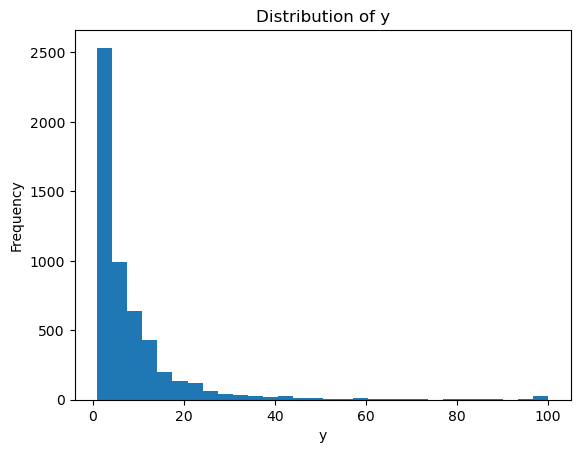

In [16]:
# distribution of y
plt.hist(y_train, bins=30)
plt.title('Distribution of y')
plt.xlabel('y')
plt.ylabel('Frequency')
plt.show()

In [17]:
#id is not relevant to prediction
X_train.drop('id', axis=1, inplace=True)  
#log transform y train since the distribution is skewed
y_train = np.log(y_train) 

### Insight 2:  Logged y_train's outliers are closer to other values, making it easier for models to predict target

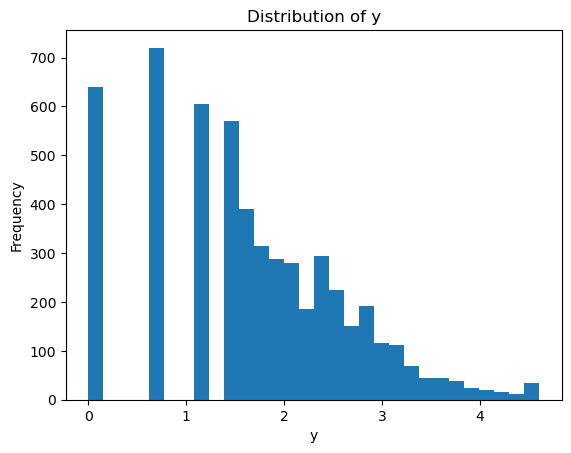

In [79]:
# distribution of logged_y
plt.hist(y_train, bins=30)
plt.title('Distribution of y')
plt.xlabel('y')
plt.ylabel('Frequency')
plt.show()

### Impute missing values

In [19]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=10) 
X_train = pd.DataFrame(imputer.fit_transform(X_train), columns=X_train.columns)
X_test = pd.DataFrame(imputer.fit_transform(X_test), columns=X_test.columns)

In [20]:
X_train.shape

(5380, 707)

## A.3) Feature selection/reduction

We used CatBoost to identify feature importance and reduce dimensionality.

In [21]:
cat_model1 = CatBoostRegressor()
cat_model1.fit(X_train, y_train)

y_pred = cat_model1.predict(X_train)
y_pred = np.exp(y_pred)  # Transform y_pred back to the original scale

rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred))
print("RMSE:", rmse)

Learning rate set to 0.053413
0:	learn: 0.9827844	total: 133ms	remaining: 2m 12s
1:	learn: 0.9690571	total: 156ms	remaining: 1m 17s
2:	learn: 0.9554104	total: 174ms	remaining: 57.9s
3:	learn: 0.9433267	total: 193ms	remaining: 48s
4:	learn: 0.9322509	total: 211ms	remaining: 42s
5:	learn: 0.9218336	total: 232ms	remaining: 38.4s
6:	learn: 0.9107634	total: 255ms	remaining: 36.2s
7:	learn: 0.9009643	total: 275ms	remaining: 34.1s
8:	learn: 0.8916967	total: 295ms	remaining: 32.4s
9:	learn: 0.8825115	total: 313ms	remaining: 31s
10:	learn: 0.8736837	total: 332ms	remaining: 29.8s
11:	learn: 0.8662923	total: 351ms	remaining: 28.9s
12:	learn: 0.8595034	total: 369ms	remaining: 28s
13:	learn: 0.8528686	total: 387ms	remaining: 27.2s
14:	learn: 0.8466134	total: 404ms	remaining: 26.5s
15:	learn: 0.8403392	total: 424ms	remaining: 26s
16:	learn: 0.8340569	total: 445ms	remaining: 25.7s
17:	learn: 0.8295946	total: 465ms	remaining: 25.4s
18:	learn: 0.8247573	total: 483ms	remaining: 25s
19:	learn: 0.8201382	

171:	learn: 0.6293327	total: 3.35s	remaining: 16.2s
172:	learn: 0.6283887	total: 3.37s	remaining: 16.1s
173:	learn: 0.6275909	total: 3.39s	remaining: 16.1s
174:	learn: 0.6269178	total: 3.41s	remaining: 16.1s
175:	learn: 0.6262131	total: 3.43s	remaining: 16.1s
176:	learn: 0.6257234	total: 3.45s	remaining: 16s
177:	learn: 0.6248262	total: 3.46s	remaining: 16s
178:	learn: 0.6241409	total: 3.48s	remaining: 16s
179:	learn: 0.6234463	total: 3.5s	remaining: 15.9s
180:	learn: 0.6229981	total: 3.52s	remaining: 15.9s
181:	learn: 0.6222777	total: 3.54s	remaining: 15.9s
182:	learn: 0.6215786	total: 3.56s	remaining: 15.9s
183:	learn: 0.6210878	total: 3.58s	remaining: 15.9s
184:	learn: 0.6204949	total: 3.59s	remaining: 15.8s
185:	learn: 0.6193842	total: 3.61s	remaining: 15.8s
186:	learn: 0.6188017	total: 3.63s	remaining: 15.8s
187:	learn: 0.6178658	total: 3.65s	remaining: 15.8s
188:	learn: 0.6169912	total: 3.67s	remaining: 15.7s
189:	learn: 0.6164234	total: 3.69s	remaining: 15.7s
190:	learn: 0.61548

340:	learn: 0.5242810	total: 6.43s	remaining: 12.4s
341:	learn: 0.5235396	total: 6.45s	remaining: 12.4s
342:	learn: 0.5228521	total: 6.47s	remaining: 12.4s
343:	learn: 0.5221938	total: 6.49s	remaining: 12.4s
344:	learn: 0.5217002	total: 6.51s	remaining: 12.4s
345:	learn: 0.5212391	total: 6.52s	remaining: 12.3s
346:	learn: 0.5207012	total: 6.54s	remaining: 12.3s
347:	learn: 0.5205990	total: 6.56s	remaining: 12.3s
348:	learn: 0.5199978	total: 6.58s	remaining: 12.3s
349:	learn: 0.5194409	total: 6.59s	remaining: 12.2s
350:	learn: 0.5191500	total: 6.61s	remaining: 12.2s
351:	learn: 0.5188050	total: 6.63s	remaining: 12.2s
352:	learn: 0.5185076	total: 6.65s	remaining: 12.2s
353:	learn: 0.5179405	total: 6.67s	remaining: 12.2s
354:	learn: 0.5174229	total: 6.69s	remaining: 12.1s
355:	learn: 0.5169196	total: 6.7s	remaining: 12.1s
356:	learn: 0.5165083	total: 6.72s	remaining: 12.1s
357:	learn: 0.5160658	total: 6.74s	remaining: 12.1s
358:	learn: 0.5155706	total: 6.76s	remaining: 12.1s
359:	learn: 0

505:	learn: 0.4518800	total: 9.55s	remaining: 9.33s
506:	learn: 0.4515921	total: 9.58s	remaining: 9.31s
507:	learn: 0.4510349	total: 9.59s	remaining: 9.29s
508:	learn: 0.4505883	total: 9.61s	remaining: 9.27s
509:	learn: 0.4500648	total: 9.63s	remaining: 9.25s
510:	learn: 0.4496118	total: 9.65s	remaining: 9.23s
511:	learn: 0.4492487	total: 9.67s	remaining: 9.21s
512:	learn: 0.4489392	total: 9.69s	remaining: 9.19s
513:	learn: 0.4485229	total: 9.7s	remaining: 9.17s
514:	learn: 0.4479987	total: 9.72s	remaining: 9.15s
515:	learn: 0.4478758	total: 9.74s	remaining: 9.13s
516:	learn: 0.4471849	total: 9.76s	remaining: 9.11s
517:	learn: 0.4466264	total: 9.78s	remaining: 9.1s
518:	learn: 0.4463585	total: 9.79s	remaining: 9.08s
519:	learn: 0.4459636	total: 9.81s	remaining: 9.06s
520:	learn: 0.4455250	total: 9.83s	remaining: 9.04s
521:	learn: 0.4452424	total: 9.85s	remaining: 9.02s
522:	learn: 0.4447714	total: 9.87s	remaining: 9s
523:	learn: 0.4442604	total: 9.88s	remaining: 8.98s
524:	learn: 0.444

667:	learn: 0.3913070	total: 12.5s	remaining: 6.21s
668:	learn: 0.3909294	total: 12.5s	remaining: 6.2s
669:	learn: 0.3905782	total: 12.5s	remaining: 6.18s
670:	learn: 0.3900886	total: 12.6s	remaining: 6.16s
671:	learn: 0.3896794	total: 12.6s	remaining: 6.14s
672:	learn: 0.3893261	total: 12.6s	remaining: 6.12s
673:	learn: 0.3890159	total: 12.6s	remaining: 6.1s
674:	learn: 0.3887447	total: 12.6s	remaining: 6.08s
675:	learn: 0.3884624	total: 12.6s	remaining: 6.06s
676:	learn: 0.3879240	total: 12.7s	remaining: 6.04s
677:	learn: 0.3874310	total: 12.7s	remaining: 6.02s
678:	learn: 0.3871255	total: 12.7s	remaining: 6s
679:	learn: 0.3867180	total: 12.7s	remaining: 5.99s
680:	learn: 0.3863531	total: 12.7s	remaining: 5.97s
681:	learn: 0.3861432	total: 12.8s	remaining: 5.95s
682:	learn: 0.3858467	total: 12.8s	remaining: 5.93s
683:	learn: 0.3854005	total: 12.8s	remaining: 5.91s
684:	learn: 0.3851346	total: 12.8s	remaining: 5.89s
685:	learn: 0.3847416	total: 12.8s	remaining: 5.87s
686:	learn: 0.384

827:	learn: 0.3384348	total: 15.4s	remaining: 3.2s
828:	learn: 0.3381609	total: 15.4s	remaining: 3.18s
829:	learn: 0.3379034	total: 15.5s	remaining: 3.16s
830:	learn: 0.3374838	total: 15.5s	remaining: 3.15s
831:	learn: 0.3372358	total: 15.5s	remaining: 3.13s
832:	learn: 0.3369284	total: 15.5s	remaining: 3.11s
833:	learn: 0.3364632	total: 15.5s	remaining: 3.09s
834:	learn: 0.3359647	total: 15.5s	remaining: 3.07s
835:	learn: 0.3356956	total: 15.6s	remaining: 3.05s
836:	learn: 0.3353505	total: 15.6s	remaining: 3.03s
837:	learn: 0.3350756	total: 15.6s	remaining: 3.01s
838:	learn: 0.3346585	total: 15.6s	remaining: 3s
839:	learn: 0.3344076	total: 15.6s	remaining: 2.98s
840:	learn: 0.3341786	total: 15.7s	remaining: 2.96s
841:	learn: 0.3337242	total: 15.7s	remaining: 2.94s
842:	learn: 0.3334361	total: 15.7s	remaining: 2.92s
843:	learn: 0.3331328	total: 15.7s	remaining: 2.9s
844:	learn: 0.3327707	total: 15.7s	remaining: 2.88s
845:	learn: 0.3325178	total: 15.7s	remaining: 2.87s
846:	learn: 0.332

991:	learn: 0.2919520	total: 18.6s	remaining: 150ms
992:	learn: 0.2916056	total: 18.6s	remaining: 131ms
993:	learn: 0.2913996	total: 18.6s	remaining: 112ms
994:	learn: 0.2910877	total: 18.7s	remaining: 93.8ms
995:	learn: 0.2907277	total: 18.7s	remaining: 75.1ms
996:	learn: 0.2904581	total: 18.7s	remaining: 56.4ms
997:	learn: 0.2902777	total: 18.8s	remaining: 37.6ms
998:	learn: 0.2900398	total: 18.8s	remaining: 18.8ms
999:	learn: 0.2897143	total: 18.8s	remaining: 0us
RMSE: 4.57293961802496


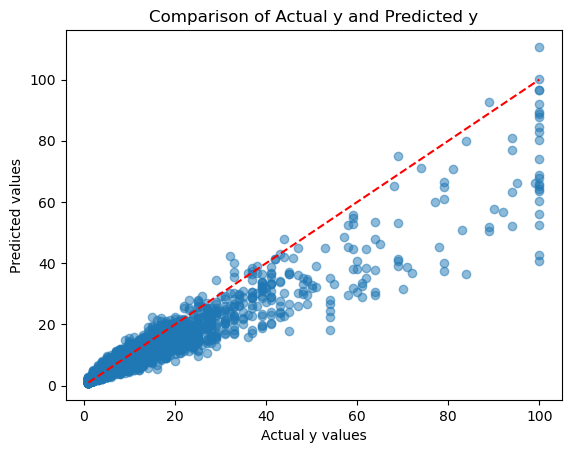

In [22]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

Before, we had about 700 features, which is not that great for computational cost

In [24]:
feature_importance = cat_model1.get_feature_importance()
feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importance})

In [25]:
# Drop features with importance less than 0.2
imp_features = feature_importance_df[feature_importance_df['Importance'] >= 0.15]['Feature']
X_train_filtered = X_train[imp_features]
X_train_filtered.shape

(5380, 155)

In [62]:
cat_model2 = CatBoostRegressor()
cat_model2.fit(X_train_filtered, y_train)

y_pred = cat_model2.predict(X_train_filtered)
y_pred = np.exp(y_pred)  # Transform y_pred back to the original scale

rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred))

Learning rate set to 0.053413
0:	learn: 0.9820409	total: 13ms	remaining: 13s
1:	learn: 0.9667420	total: 19.5ms	remaining: 9.75s
2:	learn: 0.9532215	total: 25.6ms	remaining: 8.52s
3:	learn: 0.9387539	total: 31.8ms	remaining: 7.93s
4:	learn: 0.9271897	total: 38ms	remaining: 7.57s
5:	learn: 0.9153879	total: 44.3ms	remaining: 7.34s
6:	learn: 0.9045132	total: 50.9ms	remaining: 7.22s
7:	learn: 0.8940071	total: 57ms	remaining: 7.06s
8:	learn: 0.8842068	total: 63.4ms	remaining: 6.99s
9:	learn: 0.8755379	total: 69.7ms	remaining: 6.9s
10:	learn: 0.8676020	total: 76.1ms	remaining: 6.84s
11:	learn: 0.8595944	total: 82.1ms	remaining: 6.76s
12:	learn: 0.8519956	total: 87.7ms	remaining: 6.66s
13:	learn: 0.8447170	total: 93.5ms	remaining: 6.58s
14:	learn: 0.8390308	total: 99.3ms	remaining: 6.52s
15:	learn: 0.8330145	total: 104ms	remaining: 6.4s
16:	learn: 0.8275985	total: 109ms	remaining: 6.32s
17:	learn: 0.8223391	total: 114ms	remaining: 6.21s
18:	learn: 0.8181522	total: 119ms	remaining: 6.13s
19:	le

176:	learn: 0.6220758	total: 988ms	remaining: 4.59s
177:	learn: 0.6215888	total: 993ms	remaining: 4.59s
178:	learn: 0.6210636	total: 999ms	remaining: 4.58s
179:	learn: 0.6204341	total: 1s	remaining: 4.58s
180:	learn: 0.6196226	total: 1.01s	remaining: 4.57s
181:	learn: 0.6190451	total: 1.01s	remaining: 4.56s
182:	learn: 0.6181340	total: 1.02s	remaining: 4.55s
183:	learn: 0.6175681	total: 1.02s	remaining: 4.55s
184:	learn: 0.6166894	total: 1.03s	remaining: 4.54s
185:	learn: 0.6162163	total: 1.03s	remaining: 4.53s
186:	learn: 0.6155870	total: 1.04s	remaining: 4.53s
187:	learn: 0.6151488	total: 1.05s	remaining: 4.52s
188:	learn: 0.6146435	total: 1.05s	remaining: 4.51s
189:	learn: 0.6141505	total: 1.06s	remaining: 4.5s
190:	learn: 0.6134692	total: 1.06s	remaining: 4.5s
191:	learn: 0.6128346	total: 1.07s	remaining: 4.49s
192:	learn: 0.6123325	total: 1.07s	remaining: 4.49s
193:	learn: 0.6116740	total: 1.08s	remaining: 4.48s
194:	learn: 0.6111122	total: 1.08s	remaining: 4.48s
195:	learn: 0.610

361:	learn: 0.5161204	total: 1.97s	remaining: 3.47s
362:	learn: 0.5157881	total: 1.98s	remaining: 3.47s
363:	learn: 0.5153699	total: 1.98s	remaining: 3.46s
364:	learn: 0.5149643	total: 1.99s	remaining: 3.46s
365:	learn: 0.5145801	total: 1.99s	remaining: 3.45s
366:	learn: 0.5139922	total: 2s	remaining: 3.45s
367:	learn: 0.5136337	total: 2s	remaining: 3.44s
368:	learn: 0.5130223	total: 2.01s	remaining: 3.44s
369:	learn: 0.5125531	total: 2.02s	remaining: 3.44s
370:	learn: 0.5121410	total: 2.02s	remaining: 3.43s
371:	learn: 0.5117027	total: 2.03s	remaining: 3.42s
372:	learn: 0.5109930	total: 2.03s	remaining: 3.42s
373:	learn: 0.5107347	total: 2.04s	remaining: 3.41s
374:	learn: 0.5103583	total: 2.04s	remaining: 3.41s
375:	learn: 0.5099652	total: 2.05s	remaining: 3.4s
376:	learn: 0.5096103	total: 2.05s	remaining: 3.4s
377:	learn: 0.5091033	total: 2.06s	remaining: 3.39s
378:	learn: 0.5085110	total: 2.06s	remaining: 3.38s
379:	learn: 0.5079931	total: 2.07s	remaining: 3.38s
380:	learn: 0.507435

528:	learn: 0.4452164	total: 3.2s	remaining: 2.85s
529:	learn: 0.4448944	total: 3.21s	remaining: 2.85s
530:	learn: 0.4444009	total: 3.22s	remaining: 2.84s
531:	learn: 0.4438549	total: 3.22s	remaining: 2.83s
532:	learn: 0.4432781	total: 3.23s	remaining: 2.83s
533:	learn: 0.4428201	total: 3.24s	remaining: 2.83s
534:	learn: 0.4424969	total: 3.25s	remaining: 2.82s
535:	learn: 0.4422117	total: 3.25s	remaining: 2.81s
536:	learn: 0.4418919	total: 3.26s	remaining: 2.81s
537:	learn: 0.4414089	total: 3.26s	remaining: 2.8s
538:	learn: 0.4410517	total: 3.27s	remaining: 2.79s
539:	learn: 0.4409046	total: 3.27s	remaining: 2.79s
540:	learn: 0.4404451	total: 3.28s	remaining: 2.78s
541:	learn: 0.4400209	total: 3.29s	remaining: 2.78s
542:	learn: 0.4395776	total: 3.29s	remaining: 2.77s
543:	learn: 0.4392194	total: 3.3s	remaining: 2.76s
544:	learn: 0.4388342	total: 3.3s	remaining: 2.76s
545:	learn: 0.4384337	total: 3.31s	remaining: 2.75s
546:	learn: 0.4379936	total: 3.31s	remaining: 2.75s
547:	learn: 0.43

705:	learn: 0.3839726	total: 4.2s	remaining: 1.75s
706:	learn: 0.3838016	total: 4.21s	remaining: 1.74s
707:	learn: 0.3834657	total: 4.21s	remaining: 1.74s
708:	learn: 0.3832744	total: 4.22s	remaining: 1.73s
709:	learn: 0.3828325	total: 4.22s	remaining: 1.73s
710:	learn: 0.3823075	total: 4.23s	remaining: 1.72s
711:	learn: 0.3820121	total: 4.24s	remaining: 1.71s
712:	learn: 0.3816773	total: 4.24s	remaining: 1.71s
713:	learn: 0.3814246	total: 4.25s	remaining: 1.7s
714:	learn: 0.3809840	total: 4.25s	remaining: 1.69s
715:	learn: 0.3807661	total: 4.25s	remaining: 1.69s
716:	learn: 0.3803928	total: 4.26s	remaining: 1.68s
717:	learn: 0.3799888	total: 4.26s	remaining: 1.68s
718:	learn: 0.3796010	total: 4.27s	remaining: 1.67s
719:	learn: 0.3792633	total: 4.28s	remaining: 1.66s
720:	learn: 0.3790199	total: 4.28s	remaining: 1.66s
721:	learn: 0.3784707	total: 4.29s	remaining: 1.65s
722:	learn: 0.3781589	total: 4.29s	remaining: 1.64s
723:	learn: 0.3777776	total: 4.3s	remaining: 1.64s
724:	learn: 0.3

886:	learn: 0.3312219	total: 5.19s	remaining: 662ms
887:	learn: 0.3309452	total: 5.2s	remaining: 656ms
888:	learn: 0.3306473	total: 5.2s	remaining: 650ms
889:	learn: 0.3302933	total: 5.21s	remaining: 644ms
890:	learn: 0.3299882	total: 5.21s	remaining: 638ms
891:	learn: 0.3297546	total: 5.22s	remaining: 632ms
892:	learn: 0.3294347	total: 5.22s	remaining: 626ms
893:	learn: 0.3291390	total: 5.23s	remaining: 620ms
894:	learn: 0.3288745	total: 5.24s	remaining: 614ms
895:	learn: 0.3287120	total: 5.24s	remaining: 608ms
896:	learn: 0.3285397	total: 5.25s	remaining: 603ms
897:	learn: 0.3283338	total: 5.25s	remaining: 597ms
898:	learn: 0.3280113	total: 5.26s	remaining: 591ms
899:	learn: 0.3276332	total: 5.26s	remaining: 585ms
900:	learn: 0.3273467	total: 5.27s	remaining: 579ms
901:	learn: 0.3270258	total: 5.27s	remaining: 573ms
902:	learn: 0.3268120	total: 5.28s	remaining: 567ms
903:	learn: 0.3266374	total: 5.28s	remaining: 561ms
904:	learn: 0.3263835	total: 5.29s	remaining: 555ms
905:	learn: 0.

In [70]:
rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred))
print(rmse)

13.45132049868189


In [63]:
from sklearn.linear_model import LinearRegression
# y_train is on log scale
x = np.array(np.exp(y_train)).reshape(-1, 1)
y = np.array(y_pred)
lin = LinearRegression()
lin.fit(x, y)


LinearRegression()

In [64]:
1/lin.coef_[0]


1.4167633472051393

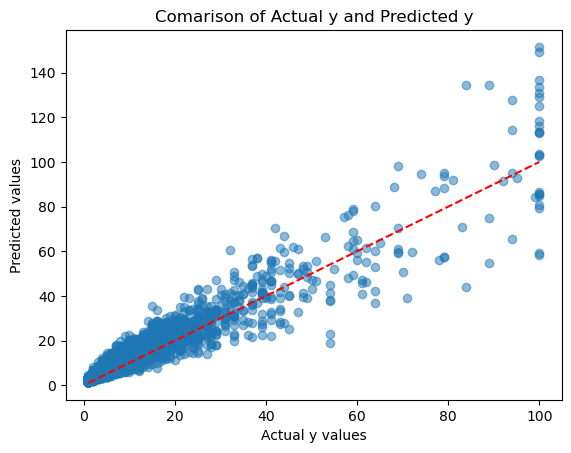

In [65]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred*1.42, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comarison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

In [67]:
X_test_filtered = X_test[imp_features]
pred = cat_model2.predict(X_test_filtered)
pred = np.exp(pred)
pred *= 1.27 #the model underestimates y
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": pred})
output.to_csv("submissions_cat_features_1.42.csv", index=False, header=True)


Now we've cut around 550 features, we have thus improved computational efficiency and performance.

## A.4) Developing the model

We have 2 base models, CatBoost and MARS, and tried out different linear combinations of the two, voting ensemble, and stacking ensemble.

## Model 1: CatBoost

In [33]:
# tuning hyperparameters 
param_grid = {
    'max_depth': [4, 6, 8],                              
    'learning_rate': [0.01, 0.05, 0.1],         
    'subsample': [0.5, 0.75, 1.0],              
    'reg_lambda': [0, 1, 5, 10]                    
}

cv = KFold(n_splits=10, shuffle=True, random_state=1)
optimal_params = RandomizedSearchCV(
    estimator=CatBoostRegressor(random_state=1, n_estimators=500),
    param_distributions=param_grid,
    n_iter=200,
    verbose=1,
    n_jobs=-1,
    cv=cv
)
optimal_params.fit(X_train_filtered,y_train)
print("Optimal parameter values =", optimal_params.best_params_)

Fitting 10 folds for each of 108 candidates, totalling 1080 fits


/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/model_selection/_search.py:305: UserWarning: The total space of parameters 108 is smaller than n_iter=200. Running 108 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


0:	learn: 0.9991539	total: 68.7ms	remaining: 34.3s
1:	learn: 0.9963668	total: 84.6ms	remaining: 21.1s
2:	learn: 0.9937323	total: 97.5ms	remaining: 16.2s
3:	learn: 0.9907721	total: 108ms	remaining: 13.4s
4:	learn: 0.9882377	total: 117ms	remaining: 11.6s
5:	learn: 0.9855541	total: 141ms	remaining: 11.6s
6:	learn: 0.9828068	total: 160ms	remaining: 11.3s
7:	learn: 0.9802209	total: 179ms	remaining: 11s
8:	learn: 0.9774208	total: 200ms	remaining: 10.9s
9:	learn: 0.9748720	total: 218ms	remaining: 10.7s
10:	learn: 0.9722770	total: 230ms	remaining: 10.2s
11:	learn: 0.9699022	total: 240ms	remaining: 9.77s
12:	learn: 0.9674339	total: 250ms	remaining: 9.38s
13:	learn: 0.9649391	total: 271ms	remaining: 9.41s
14:	learn: 0.9624105	total: 282ms	remaining: 9.13s
15:	learn: 0.9601319	total: 298ms	remaining: 9s
16:	learn: 0.9578361	total: 307ms	remaining: 8.71s
17:	learn: 0.9555747	total: 315ms	remaining: 8.45s
18:	learn: 0.9533224	total: 327ms	remaining: 8.28s
19:	learn: 0.9510548	total: 337ms	remaining

0:	learn: 0.9961880	total: 91.1ms	remaining: 45.4s
1:	learn: 0.9934663	total: 108ms	remaining: 26.9s
2:	learn: 0.9906979	total: 122ms	remaining: 20.1s
3:	learn: 0.9880642	total: 132ms	remaining: 16.4s
4:	learn: 0.9856584	total: 146ms	remaining: 14.4s
5:	learn: 0.9831721	total: 161ms	remaining: 13.2s
6:	learn: 0.9805689	total: 173ms	remaining: 12.2s
7:	learn: 0.9782510	total: 186ms	remaining: 11.4s
8:	learn: 0.9756999	total: 200ms	remaining: 10.9s
9:	learn: 0.9734443	total: 211ms	remaining: 10.3s
10:	learn: 0.9710200	total: 229ms	remaining: 10.2s
11:	learn: 0.9685551	total: 254ms	remaining: 10.3s
12:	learn: 0.9663903	total: 267ms	remaining: 10s
13:	learn: 0.9639651	total: 287ms	remaining: 9.95s
14:	learn: 0.9615151	total: 301ms	remaining: 9.73s
15:	learn: 0.9593811	total: 313ms	remaining: 9.47s
16:	learn: 0.9572350	total: 330ms	remaining: 9.37s
17:	learn: 0.9549980	total: 349ms	remaining: 9.34s
18:	learn: 0.9527594	total: 368ms	remaining: 9.31s
19:	learn: 0.9508732	total: 394ms	remainin

0:	learn: 1.0005306	total: 64.9ms	remaining: 32.4s
1:	learn: 0.9978460	total: 73ms	remaining: 18.2s
2:	learn: 0.9949228	total: 92.1ms	remaining: 15.3s
3:	learn: 0.9922434	total: 103ms	remaining: 12.8s
4:	learn: 0.9896179	total: 119ms	remaining: 11.8s
5:	learn: 0.9870668	total: 145ms	remaining: 11.9s
6:	learn: 0.9842974	total: 160ms	remaining: 11.3s
7:	learn: 0.9818516	total: 173ms	remaining: 10.7s
8:	learn: 0.9794683	total: 191ms	remaining: 10.4s
9:	learn: 0.9769602	total: 207ms	remaining: 10.1s
10:	learn: 0.9746196	total: 225ms	remaining: 10s
11:	learn: 0.9722628	total: 248ms	remaining: 10.1s
12:	learn: 0.9697903	total: 266ms	remaining: 9.96s
13:	learn: 0.9676711	total: 281ms	remaining: 9.74s
14:	learn: 0.9650220	total: 297ms	remaining: 9.61s
15:	learn: 0.9627960	total: 309ms	remaining: 9.35s
16:	learn: 0.9605309	total: 324ms	remaining: 9.21s
17:	learn: 0.9582189	total: 342ms	remaining: 9.16s
18:	learn: 0.9558805	total: 373ms	remaining: 9.44s
19:	learn: 0.9539585	total: 399ms	remainin

318:	learn: 0.7422545	total: 4.06s	remaining: 2.31s
319:	learn: 0.7420044	total: 4.09s	remaining: 2.3s
320:	learn: 0.7417917	total: 4.12s	remaining: 2.29s
321:	learn: 0.7415026	total: 4.12s	remaining: 2.28s
322:	learn: 0.7413216	total: 4.13s	remaining: 2.26s
323:	learn: 0.7411440	total: 4.14s	remaining: 2.25s
324:	learn: 0.7409335	total: 4.15s	remaining: 2.23s
325:	learn: 0.7406503	total: 4.16s	remaining: 2.22s
326:	learn: 0.7403955	total: 4.16s	remaining: 2.2s
327:	learn: 0.7401874	total: 4.17s	remaining: 2.19s
328:	learn: 0.7400428	total: 4.18s	remaining: 2.17s
329:	learn: 0.7398467	total: 4.21s	remaining: 2.17s
330:	learn: 0.7396009	total: 4.22s	remaining: 2.15s
331:	learn: 0.7393946	total: 4.23s	remaining: 2.14s
332:	learn: 0.7392519	total: 4.24s	remaining: 2.12s
333:	learn: 0.7390570	total: 4.24s	remaining: 2.11s
334:	learn: 0.7388984	total: 4.25s	remaining: 2.09s
335:	learn: 0.7387417	total: 4.27s	remaining: 2.08s
336:	learn: 0.7385574	total: 4.28s	remaining: 2.07s
337:	learn: 0.

318:	learn: 0.7377358	total: 4.15s	remaining: 2.35s
319:	learn: 0.7375484	total: 4.16s	remaining: 2.34s
320:	learn: 0.7373217	total: 4.17s	remaining: 2.32s
321:	learn: 0.7371814	total: 4.17s	remaining: 2.31s
322:	learn: 0.7369886	total: 4.18s	remaining: 2.29s
323:	learn: 0.7367674	total: 4.19s	remaining: 2.28s
324:	learn: 0.7365903	total: 4.2s	remaining: 2.26s
325:	learn: 0.7363059	total: 4.21s	remaining: 2.25s
326:	learn: 0.7360463	total: 4.22s	remaining: 2.23s
327:	learn: 0.7358820	total: 4.23s	remaining: 2.22s
328:	learn: 0.7357331	total: 4.24s	remaining: 2.2s
329:	learn: 0.7355640	total: 4.25s	remaining: 2.19s
330:	learn: 0.7353690	total: 4.26s	remaining: 2.17s
331:	learn: 0.7351553	total: 4.26s	remaining: 2.16s
332:	learn: 0.7350100	total: 4.27s	remaining: 2.14s
333:	learn: 0.7348697	total: 4.29s	remaining: 2.13s
334:	learn: 0.7347052	total: 4.31s	remaining: 2.12s
335:	learn: 0.7344997	total: 4.35s	remaining: 2.12s
336:	learn: 0.7343524	total: 4.37s	remaining: 2.11s
337:	learn: 0.

318:	learn: 0.7419926	total: 4.76s	remaining: 2.7s
319:	learn: 0.7417981	total: 4.77s	remaining: 2.69s
320:	learn: 0.7415752	total: 4.79s	remaining: 2.67s
321:	learn: 0.7414252	total: 4.8s	remaining: 2.65s
322:	learn: 0.7412670	total: 4.8s	remaining: 2.63s
323:	learn: 0.7410880	total: 4.82s	remaining: 2.62s
324:	learn: 0.7409299	total: 4.83s	remaining: 2.6s
325:	learn: 0.7406973	total: 4.84s	remaining: 2.58s
326:	learn: 0.7404492	total: 4.86s	remaining: 2.57s
327:	learn: 0.7402538	total: 4.86s	remaining: 2.55s
328:	learn: 0.7400820	total: 4.88s	remaining: 2.54s
329:	learn: 0.7398740	total: 4.89s	remaining: 2.52s
330:	learn: 0.7396534	total: 4.9s	remaining: 2.5s
331:	learn: 0.7394552	total: 4.91s	remaining: 2.48s
332:	learn: 0.7392498	total: 4.93s	remaining: 2.47s
333:	learn: 0.7390807	total: 4.94s	remaining: 2.46s
334:	learn: 0.7388703	total: 4.96s	remaining: 2.44s
335:	learn: 0.7387116	total: 4.97s	remaining: 2.42s
336:	learn: 0.7385173	total: 4.98s	remaining: 2.41s
337:	learn: 0.7383

318:	learn: 0.7456094	total: 5.32s	remaining: 3.02s
319:	learn: 0.7454045	total: 5.33s	remaining: 3s
320:	learn: 0.7451854	total: 5.34s	remaining: 2.98s
321:	learn: 0.7449997	total: 5.35s	remaining: 2.96s
322:	learn: 0.7448421	total: 5.36s	remaining: 2.94s
323:	learn: 0.7445770	total: 5.38s	remaining: 2.92s
324:	learn: 0.7443804	total: 5.39s	remaining: 2.9s
325:	learn: 0.7441745	total: 5.41s	remaining: 2.89s
326:	learn: 0.7440380	total: 5.42s	remaining: 2.87s
327:	learn: 0.7438825	total: 5.43s	remaining: 2.85s
328:	learn: 0.7437330	total: 5.44s	remaining: 2.83s
329:	learn: 0.7435318	total: 5.47s	remaining: 2.82s
330:	learn: 0.7433028	total: 5.49s	remaining: 2.8s
331:	learn: 0.7430819	total: 5.5s	remaining: 2.78s
332:	learn: 0.7429079	total: 5.52s	remaining: 2.77s
333:	learn: 0.7427241	total: 5.53s	remaining: 2.75s
334:	learn: 0.7424296	total: 5.55s	remaining: 2.73s
335:	learn: 0.7421772	total: 5.57s	remaining: 2.72s
336:	learn: 0.7420008	total: 5.58s	remaining: 2.7s
337:	learn: 0.74177

136:	learn: 0.8056569	total: 1.74s	remaining: 4.61s
137:	learn: 0.8050552	total: 1.75s	remaining: 4.6s
138:	learn: 0.8045184	total: 1.78s	remaining: 4.62s
139:	learn: 0.8038947	total: 1.79s	remaining: 4.62s
140:	learn: 0.8032244	total: 1.81s	remaining: 4.6s
141:	learn: 0.8025730	total: 1.81s	remaining: 4.58s
142:	learn: 0.8019618	total: 1.83s	remaining: 4.56s
143:	learn: 0.8014425	total: 1.84s	remaining: 4.54s
144:	learn: 0.8009039	total: 1.84s	remaining: 4.52s
145:	learn: 0.8003461	total: 1.86s	remaining: 4.5s
146:	learn: 0.7998241	total: 1.87s	remaining: 4.49s
147:	learn: 0.7992632	total: 1.88s	remaining: 4.46s
148:	learn: 0.7985984	total: 1.88s	remaining: 4.44s
149:	learn: 0.7980440	total: 1.89s	remaining: 4.41s
150:	learn: 0.7975412	total: 1.9s	remaining: 4.38s
151:	learn: 0.7969649	total: 1.93s	remaining: 4.41s
152:	learn: 0.7964460	total: 1.94s	remaining: 4.4s
153:	learn: 0.7958615	total: 1.95s	remaining: 4.38s
154:	learn: 0.7953311	total: 1.96s	remaining: 4.36s
155:	learn: 0.794

136:	learn: 0.8126830	total: 1.78s	remaining: 4.71s
137:	learn: 0.8120358	total: 1.79s	remaining: 4.69s
138:	learn: 0.8114282	total: 1.8s	remaining: 4.67s
139:	learn: 0.8108270	total: 1.81s	remaining: 4.65s
140:	learn: 0.8101684	total: 1.84s	remaining: 4.68s
141:	learn: 0.8095673	total: 1.84s	remaining: 4.65s
142:	learn: 0.8088956	total: 1.86s	remaining: 4.65s
143:	learn: 0.8083688	total: 1.88s	remaining: 4.65s
144:	learn: 0.8078062	total: 1.89s	remaining: 4.62s
145:	learn: 0.8071519	total: 1.9s	remaining: 4.61s
146:	learn: 0.8065975	total: 1.91s	remaining: 4.59s
147:	learn: 0.8059591	total: 1.92s	remaining: 4.57s
148:	learn: 0.8053324	total: 1.94s	remaining: 4.56s
149:	learn: 0.8047712	total: 1.95s	remaining: 4.56s
150:	learn: 0.8042427	total: 1.97s	remaining: 4.56s
151:	learn: 0.8036782	total: 1.98s	remaining: 4.53s
152:	learn: 0.8031413	total: 1.99s	remaining: 4.51s
153:	learn: 0.8026064	total: 2s	remaining: 4.49s
154:	learn: 0.8020596	total: 2.01s	remaining: 4.48s
155:	learn: 0.801

135:	learn: 0.8080753	total: 1.76s	remaining: 4.7s
136:	learn: 0.8073897	total: 1.77s	remaining: 4.69s
137:	learn: 0.8068079	total: 1.78s	remaining: 4.67s
138:	learn: 0.8061921	total: 1.79s	remaining: 4.64s
139:	learn: 0.8057053	total: 1.8s	remaining: 4.63s
140:	learn: 0.8050307	total: 1.82s	remaining: 4.63s
141:	learn: 0.8044983	total: 1.83s	remaining: 4.61s
142:	learn: 0.8038960	total: 1.85s	remaining: 4.61s
143:	learn: 0.8033123	total: 1.86s	remaining: 4.6s
144:	learn: 0.8027348	total: 1.87s	remaining: 4.58s
145:	learn: 0.8020526	total: 1.88s	remaining: 4.56s
146:	learn: 0.8015072	total: 1.89s	remaining: 4.54s
147:	learn: 0.8008649	total: 1.91s	remaining: 4.54s
148:	learn: 0.8002859	total: 1.92s	remaining: 4.51s
149:	learn: 0.7997296	total: 1.93s	remaining: 4.5s
150:	learn: 0.7992320	total: 1.94s	remaining: 4.47s
151:	learn: 0.7987082	total: 1.95s	remaining: 4.46s
152:	learn: 0.7981878	total: 1.96s	remaining: 4.43s
153:	learn: 0.7975951	total: 1.96s	remaining: 4.41s
154:	learn: 0.79

135:	learn: 0.8086445	total: 1.94s	remaining: 5.2s
136:	learn: 0.8080636	total: 1.96s	remaining: 5.2s
137:	learn: 0.8074824	total: 1.98s	remaining: 5.19s
138:	learn: 0.8068881	total: 1.99s	remaining: 5.17s
139:	learn: 0.8063139	total: 2s	remaining: 5.14s
140:	learn: 0.8057193	total: 2.01s	remaining: 5.12s
141:	learn: 0.8050347	total: 2.03s	remaining: 5.12s
142:	learn: 0.8044473	total: 2.05s	remaining: 5.11s
143:	learn: 0.8038947	total: 2.06s	remaining: 5.08s
144:	learn: 0.8033425	total: 2.07s	remaining: 5.07s
145:	learn: 0.8026736	total: 2.09s	remaining: 5.07s
146:	learn: 0.8021237	total: 2.11s	remaining: 5.07s
147:	learn: 0.8014831	total: 2.12s	remaining: 5.05s
148:	learn: 0.8008934	total: 2.13s	remaining: 5.02s
149:	learn: 0.8003490	total: 2.14s	remaining: 4.99s
150:	learn: 0.7998409	total: 2.15s	remaining: 4.98s
151:	learn: 0.7993026	total: 2.17s	remaining: 4.97s
152:	learn: 0.7987597	total: 2.19s	remaining: 4.96s
153:	learn: 0.7982361	total: 2.19s	remaining: 4.93s
154:	learn: 0.797

452:	learn: 0.7178805	total: 5.48s	remaining: 568ms
453:	learn: 0.7177293	total: 5.5s	remaining: 557ms
454:	learn: 0.7175467	total: 5.51s	remaining: 545ms
455:	learn: 0.7174025	total: 5.52s	remaining: 533ms
456:	learn: 0.7173055	total: 5.53s	remaining: 521ms
457:	learn: 0.7171782	total: 5.54s	remaining: 508ms
458:	learn: 0.7170327	total: 5.56s	remaining: 496ms
459:	learn: 0.7168568	total: 5.57s	remaining: 485ms
460:	learn: 0.7166712	total: 5.58s	remaining: 472ms
461:	learn: 0.7165524	total: 5.59s	remaining: 460ms
462:	learn: 0.7163967	total: 5.6s	remaining: 448ms
463:	learn: 0.7162611	total: 5.62s	remaining: 436ms
464:	learn: 0.7161368	total: 5.65s	remaining: 425ms
465:	learn: 0.7159730	total: 5.68s	remaining: 414ms
466:	learn: 0.7157998	total: 5.7s	remaining: 403ms
467:	learn: 0.7156665	total: 5.72s	remaining: 392ms
468:	learn: 0.7155590	total: 5.74s	remaining: 380ms
469:	learn: 0.7154776	total: 5.75s	remaining: 367ms
470:	learn: 0.7153543	total: 5.76s	remaining: 355ms
471:	learn: 0.7

204:	learn: 0.7737269	total: 2.67s	remaining: 3.85s
205:	learn: 0.7733153	total: 2.68s	remaining: 3.83s
206:	learn: 0.7729317	total: 2.69s	remaining: 3.81s
207:	learn: 0.7726049	total: 2.71s	remaining: 3.8s
208:	learn: 0.7722985	total: 2.71s	remaining: 3.78s
209:	learn: 0.7719440	total: 2.72s	remaining: 3.76s
210:	learn: 0.7716371	total: 2.74s	remaining: 3.75s
211:	learn: 0.7712208	total: 2.76s	remaining: 3.75s
212:	learn: 0.7709189	total: 2.77s	remaining: 3.74s
213:	learn: 0.7705429	total: 2.79s	remaining: 3.73s
214:	learn: 0.7701487	total: 2.81s	remaining: 3.73s
215:	learn: 0.7697515	total: 2.83s	remaining: 3.72s
216:	learn: 0.7694288	total: 2.83s	remaining: 3.69s
217:	learn: 0.7690434	total: 2.84s	remaining: 3.67s
218:	learn: 0.7686801	total: 2.86s	remaining: 3.67s
219:	learn: 0.7683239	total: 2.87s	remaining: 3.65s
220:	learn: 0.7680653	total: 2.88s	remaining: 3.63s
221:	learn: 0.7676678	total: 2.9s	remaining: 3.63s
222:	learn: 0.7673526	total: 2.91s	remaining: 3.61s
223:	learn: 0.

451:	learn: 0.7173586	total: 6.5s	remaining: 690ms
452:	learn: 0.7172123	total: 6.51s	remaining: 675ms
453:	learn: 0.7170679	total: 6.52s	remaining: 660ms
454:	learn: 0.7169509	total: 6.53s	remaining: 646ms
455:	learn: 0.7168081	total: 6.54s	remaining: 631ms
456:	learn: 0.7167191	total: 6.54s	remaining: 616ms
457:	learn: 0.7165966	total: 6.56s	remaining: 602ms
458:	learn: 0.7164462	total: 6.58s	remaining: 588ms
459:	learn: 0.7162773	total: 6.61s	remaining: 575ms
460:	learn: 0.7161196	total: 6.63s	remaining: 561ms
461:	learn: 0.7159871	total: 6.66s	remaining: 548ms
462:	learn: 0.7157806	total: 6.68s	remaining: 534ms
463:	learn: 0.7156440	total: 6.69s	remaining: 519ms
464:	learn: 0.7155146	total: 6.7s	remaining: 504ms
465:	learn: 0.7153907	total: 6.71s	remaining: 490ms
466:	learn: 0.7152015	total: 6.73s	remaining: 475ms
467:	learn: 0.7150217	total: 6.74s	remaining: 461ms
468:	learn: 0.7148712	total: 6.75s	remaining: 446ms
469:	learn: 0.7147170	total: 6.76s	remaining: 431ms
470:	learn: 0.

269:	learn: 0.7558888	total: 3.6s	remaining: 3.07s
270:	learn: 0.7556551	total: 3.61s	remaining: 3.05s
271:	learn: 0.7554249	total: 3.62s	remaining: 3.04s
272:	learn: 0.7552004	total: 3.63s	remaining: 3.02s
273:	learn: 0.7549576	total: 3.64s	remaining: 3s
274:	learn: 0.7547457	total: 3.65s	remaining: 2.98s
275:	learn: 0.7545359	total: 3.67s	remaining: 2.98s
276:	learn: 0.7542515	total: 3.67s	remaining: 2.96s
277:	learn: 0.7539527	total: 3.69s	remaining: 2.95s
278:	learn: 0.7537225	total: 3.7s	remaining: 2.93s
279:	learn: 0.7534636	total: 3.71s	remaining: 2.92s
280:	learn: 0.7532418	total: 3.72s	remaining: 2.9s
281:	learn: 0.7529857	total: 3.74s	remaining: 2.89s
282:	learn: 0.7527106	total: 3.76s	remaining: 2.88s
283:	learn: 0.7524779	total: 3.77s	remaining: 2.87s
284:	learn: 0.7522392	total: 3.78s	remaining: 2.85s
285:	learn: 0.7520618	total: 3.79s	remaining: 2.84s
286:	learn: 0.7518012	total: 3.81s	remaining: 2.83s
287:	learn: 0.7515546	total: 3.83s	remaining: 2.82s
288:	learn: 0.7513

269:	learn: 0.7528086	total: 3.52s	remaining: 3s
270:	learn: 0.7525024	total: 3.54s	remaining: 2.99s
271:	learn: 0.7522455	total: 3.56s	remaining: 2.98s
272:	learn: 0.7519655	total: 3.57s	remaining: 2.97s
273:	learn: 0.7516318	total: 3.59s	remaining: 2.96s
274:	learn: 0.7513294	total: 3.62s	remaining: 2.96s
275:	learn: 0.7510948	total: 3.63s	remaining: 2.94s
276:	learn: 0.7507939	total: 3.63s	remaining: 2.93s
277:	learn: 0.7505252	total: 3.65s	remaining: 2.91s
278:	learn: 0.7503031	total: 3.65s	remaining: 2.89s
279:	learn: 0.7500857	total: 3.66s	remaining: 2.88s
280:	learn: 0.7498585	total: 3.68s	remaining: 2.87s
281:	learn: 0.7496306	total: 3.7s	remaining: 2.86s
282:	learn: 0.7493273	total: 3.73s	remaining: 2.86s
283:	learn: 0.7490946	total: 3.75s	remaining: 2.86s
284:	learn: 0.7489206	total: 3.77s	remaining: 2.84s
285:	learn: 0.7487047	total: 3.77s	remaining: 2.83s
286:	learn: 0.7484588	total: 3.79s	remaining: 2.81s
287:	learn: 0.7482316	total: 3.8s	remaining: 2.79s
288:	learn: 0.747

269:	learn: 0.7491702	total: 3.69s	remaining: 3.14s
270:	learn: 0.7488568	total: 3.7s	remaining: 3.13s
271:	learn: 0.7486349	total: 3.71s	remaining: 3.11s
272:	learn: 0.7483614	total: 3.73s	remaining: 3.1s
273:	learn: 0.7481251	total: 3.74s	remaining: 3.08s
274:	learn: 0.7478174	total: 3.75s	remaining: 3.07s
275:	learn: 0.7475605	total: 3.76s	remaining: 3.05s
276:	learn: 0.7472815	total: 3.77s	remaining: 3.04s
277:	learn: 0.7469956	total: 3.79s	remaining: 3.02s
278:	learn: 0.7467503	total: 3.79s	remaining: 3.01s
279:	learn: 0.7465241	total: 3.8s	remaining: 2.99s
280:	learn: 0.7463087	total: 3.81s	remaining: 2.97s
281:	learn: 0.7460584	total: 3.82s	remaining: 2.96s
282:	learn: 0.7457771	total: 3.83s	remaining: 2.94s
283:	learn: 0.7456027	total: 3.84s	remaining: 2.92s
284:	learn: 0.7453362	total: 3.85s	remaining: 2.9s
285:	learn: 0.7450748	total: 3.86s	remaining: 2.89s
286:	learn: 0.7448046	total: 3.89s	remaining: 2.89s
287:	learn: 0.7445006	total: 3.9s	remaining: 2.87s
288:	learn: 0.744

452:	learn: 0.7174854	total: 7.24s	remaining: 751ms
453:	learn: 0.7173345	total: 7.25s	remaining: 735ms
454:	learn: 0.7171789	total: 7.28s	remaining: 720ms
455:	learn: 0.7170473	total: 7.29s	remaining: 704ms
456:	learn: 0.7169398	total: 7.31s	remaining: 688ms
457:	learn: 0.7168133	total: 7.33s	remaining: 672ms
458:	learn: 0.7166565	total: 7.34s	remaining: 656ms
459:	learn: 0.7164747	total: 7.35s	remaining: 640ms
460:	learn: 0.7163534	total: 7.37s	remaining: 623ms
461:	learn: 0.7161993	total: 7.38s	remaining: 607ms
462:	learn: 0.7160324	total: 7.39s	remaining: 591ms
463:	learn: 0.7159058	total: 7.4s	remaining: 574ms
464:	learn: 0.7158047	total: 7.41s	remaining: 558ms
465:	learn: 0.7156888	total: 7.44s	remaining: 543ms
466:	learn: 0.7155513	total: 7.46s	remaining: 527ms
467:	learn: 0.7154035	total: 7.47s	remaining: 511ms
468:	learn: 0.7152452	total: 7.49s	remaining: 495ms
469:	learn: 0.7151007	total: 7.51s	remaining: 479ms
470:	learn: 0.7149483	total: 7.52s	remaining: 463ms
471:	learn: 0

269:	learn: 0.7554529	total: 4.11s	remaining: 3.5s
270:	learn: 0.7551891	total: 4.12s	remaining: 3.48s
271:	learn: 0.7549372	total: 4.13s	remaining: 3.47s
272:	learn: 0.7546665	total: 4.14s	remaining: 3.45s
273:	learn: 0.7544020	total: 4.17s	remaining: 3.44s
274:	learn: 0.7541544	total: 4.18s	remaining: 3.42s
275:	learn: 0.7538701	total: 4.2s	remaining: 3.4s
276:	learn: 0.7536249	total: 4.21s	remaining: 3.39s
277:	learn: 0.7533506	total: 4.21s	remaining: 3.37s
278:	learn: 0.7531120	total: 4.24s	remaining: 3.36s
279:	learn: 0.7529172	total: 4.26s	remaining: 3.35s
280:	learn: 0.7527086	total: 4.29s	remaining: 3.34s
281:	learn: 0.7524186	total: 4.31s	remaining: 3.33s
282:	learn: 0.7521643	total: 4.32s	remaining: 3.31s
283:	learn: 0.7519659	total: 4.34s	remaining: 3.3s
284:	learn: 0.7517322	total: 4.35s	remaining: 3.28s
285:	learn: 0.7513639	total: 4.36s	remaining: 3.26s
286:	learn: 0.7511701	total: 4.37s	remaining: 3.24s
287:	learn: 0.7509027	total: 4.39s	remaining: 3.23s
288:	learn: 0.75

86:	learn: 0.8486788	total: 1.19s	remaining: 5.67s
87:	learn: 0.8476496	total: 1.2s	remaining: 5.63s
88:	learn: 0.8466839	total: 1.22s	remaining: 5.61s
89:	learn: 0.8456021	total: 1.24s	remaining: 5.66s
90:	learn: 0.8446757	total: 1.25s	remaining: 5.64s
91:	learn: 0.8438030	total: 1.26s	remaining: 5.6s
92:	learn: 0.8427254	total: 1.27s	remaining: 5.55s
93:	learn: 0.8418155	total: 1.27s	remaining: 5.5s
94:	learn: 0.8408118	total: 1.28s	remaining: 5.46s
95:	learn: 0.8398048	total: 1.29s	remaining: 5.43s
96:	learn: 0.8388745	total: 1.3s	remaining: 5.4s
97:	learn: 0.8380679	total: 1.31s	remaining: 5.37s
98:	learn: 0.8370295	total: 1.32s	remaining: 5.34s
99:	learn: 0.8360794	total: 1.33s	remaining: 5.31s
100:	learn: 0.8351763	total: 1.34s	remaining: 5.28s
101:	learn: 0.8341977	total: 1.34s	remaining: 5.25s
102:	learn: 0.8332331	total: 1.36s	remaining: 5.24s
103:	learn: 0.8323785	total: 1.38s	remaining: 5.25s
104:	learn: 0.8314784	total: 1.39s	remaining: 5.21s
105:	learn: 0.8307567	total: 1.

86:	learn: 0.8456354	total: 1.13s	remaining: 5.38s
87:	learn: 0.8445357	total: 1.14s	remaining: 5.36s
88:	learn: 0.8434485	total: 1.15s	remaining: 5.33s
89:	learn: 0.8423525	total: 1.16s	remaining: 5.3s
90:	learn: 0.8414801	total: 1.18s	remaining: 5.31s
91:	learn: 0.8404974	total: 1.19s	remaining: 5.28s
92:	learn: 0.8394948	total: 1.2s	remaining: 5.25s
93:	learn: 0.8384948	total: 1.21s	remaining: 5.24s
94:	learn: 0.8374962	total: 1.22s	remaining: 5.22s
95:	learn: 0.8366611	total: 1.24s	remaining: 5.22s
96:	learn: 0.8357871	total: 1.25s	remaining: 5.19s
97:	learn: 0.8350260	total: 1.25s	remaining: 5.15s
98:	learn: 0.8341151	total: 1.27s	remaining: 5.16s
99:	learn: 0.8331899	total: 1.3s	remaining: 5.2s
100:	learn: 0.8323951	total: 1.32s	remaining: 5.22s
101:	learn: 0.8314754	total: 1.34s	remaining: 5.22s
102:	learn: 0.8305020	total: 1.35s	remaining: 5.2s
103:	learn: 0.8296613	total: 1.38s	remaining: 5.24s
104:	learn: 0.8287879	total: 1.38s	remaining: 5.2s
105:	learn: 0.8280087	total: 1.4

85:	learn: 0.8478559	total: 1.15s	remaining: 5.53s
86:	learn: 0.8469585	total: 1.16s	remaining: 5.5s
87:	learn: 0.8459436	total: 1.17s	remaining: 5.47s
88:	learn: 0.8449029	total: 1.17s	remaining: 5.42s
89:	learn: 0.8439348	total: 1.21s	remaining: 5.53s
90:	learn: 0.8430604	total: 1.23s	remaining: 5.51s
91:	learn: 0.8422392	total: 1.24s	remaining: 5.52s
92:	learn: 0.8411705	total: 1.25s	remaining: 5.47s
93:	learn: 0.8401408	total: 1.27s	remaining: 5.47s
94:	learn: 0.8390939	total: 1.28s	remaining: 5.44s
95:	learn: 0.8382271	total: 1.28s	remaining: 5.41s
96:	learn: 0.8372848	total: 1.31s	remaining: 5.43s
97:	learn: 0.8363218	total: 1.31s	remaining: 5.39s
98:	learn: 0.8353887	total: 1.32s	remaining: 5.36s
99:	learn: 0.8345372	total: 1.33s	remaining: 5.33s
100:	learn: 0.8337485	total: 1.34s	remaining: 5.31s
101:	learn: 0.8328230	total: 1.36s	remaining: 5.32s
102:	learn: 0.8318779	total: 1.38s	remaining: 5.31s
103:	learn: 0.8310556	total: 1.39s	remaining: 5.29s
104:	learn: 0.8302336	total:

270:	learn: 0.7526805	total: 4.58s	remaining: 3.87s
271:	learn: 0.7524314	total: 4.6s	remaining: 3.85s
272:	learn: 0.7521157	total: 4.62s	remaining: 3.84s
273:	learn: 0.7518659	total: 4.64s	remaining: 3.83s
274:	learn: 0.7516306	total: 4.64s	remaining: 3.8s
275:	learn: 0.7513298	total: 4.66s	remaining: 3.78s
276:	learn: 0.7510723	total: 4.69s	remaining: 3.77s
277:	learn: 0.7507765	total: 4.7s	remaining: 3.75s
278:	learn: 0.7505096	total: 4.72s	remaining: 3.74s
279:	learn: 0.7502861	total: 4.74s	remaining: 3.72s
280:	learn: 0.7500352	total: 4.75s	remaining: 3.7s
281:	learn: 0.7498530	total: 4.76s	remaining: 3.68s
282:	learn: 0.7496119	total: 4.77s	remaining: 3.66s
283:	learn: 0.7493512	total: 4.79s	remaining: 3.64s
284:	learn: 0.7490652	total: 4.8s	remaining: 3.62s
285:	learn: 0.7487724	total: 4.82s	remaining: 3.6s
286:	learn: 0.7484929	total: 4.84s	remaining: 3.59s
287:	learn: 0.7482074	total: 4.85s	remaining: 3.57s
288:	learn: 0.7479307	total: 4.86s	remaining: 3.54s
289:	learn: 0.7477

86:	learn: 0.8420820	total: 1.17s	remaining: 5.54s
87:	learn: 0.8412018	total: 1.19s	remaining: 5.57s
88:	learn: 0.8402505	total: 1.2s	remaining: 5.54s
89:	learn: 0.8393457	total: 1.21s	remaining: 5.53s
90:	learn: 0.8383855	total: 1.22s	remaining: 5.48s
91:	learn: 0.8374844	total: 1.25s	remaining: 5.53s
92:	learn: 0.8365922	total: 1.27s	remaining: 5.54s
93:	learn: 0.8355813	total: 1.27s	remaining: 5.5s
94:	learn: 0.8346621	total: 1.29s	remaining: 5.49s
95:	learn: 0.8337340	total: 1.3s	remaining: 5.49s
96:	learn: 0.8329323	total: 1.32s	remaining: 5.48s
97:	learn: 0.8320601	total: 1.33s	remaining: 5.47s
98:	learn: 0.8311377	total: 1.34s	remaining: 5.45s
99:	learn: 0.8303276	total: 1.36s	remaining: 5.44s
100:	learn: 0.8294193	total: 1.38s	remaining: 5.45s
101:	learn: 0.8284602	total: 1.39s	remaining: 5.41s
102:	learn: 0.8275838	total: 1.41s	remaining: 5.43s
103:	learn: 0.8267211	total: 1.42s	remaining: 5.4s
104:	learn: 0.8258760	total: 1.42s	remaining: 5.36s
105:	learn: 0.8249843	total: 1

402:	learn: 0.7272574	total: 5.16s	remaining: 1.24s
403:	learn: 0.7271679	total: 5.17s	remaining: 1.23s
404:	learn: 0.7269961	total: 5.18s	remaining: 1.22s
405:	learn: 0.7268307	total: 5.2s	remaining: 1.2s
406:	learn: 0.7267033	total: 5.22s	remaining: 1.19s
407:	learn: 0.7264906	total: 5.22s	remaining: 1.18s
408:	learn: 0.7263014	total: 5.25s	remaining: 1.17s
409:	learn: 0.7261752	total: 5.26s	remaining: 1.15s
410:	learn: 0.7259710	total: 5.29s	remaining: 1.15s
411:	learn: 0.7258390	total: 5.3s	remaining: 1.13s
412:	learn: 0.7257035	total: 5.32s	remaining: 1.12s
413:	learn: 0.7255479	total: 5.33s	remaining: 1.11s
414:	learn: 0.7254008	total: 5.34s	remaining: 1.09s
415:	learn: 0.7252478	total: 5.37s	remaining: 1.08s
416:	learn: 0.7250617	total: 5.38s	remaining: 1.07s
417:	learn: 0.7248406	total: 5.39s	remaining: 1.06s
418:	learn: 0.7247032	total: 5.41s	remaining: 1.04s
419:	learn: 0.7245739	total: 5.42s	remaining: 1.03s
420:	learn: 0.7244362	total: 5.43s	remaining: 1.02s
421:	learn: 0.7

402:	learn: 0.7245149	total: 5.11s	remaining: 1.23s
403:	learn: 0.7243998	total: 5.12s	remaining: 1.22s
404:	learn: 0.7242375	total: 5.13s	remaining: 1.2s
405:	learn: 0.7240762	total: 5.14s	remaining: 1.19s
406:	learn: 0.7239521	total: 5.16s	remaining: 1.18s
407:	learn: 0.7237602	total: 5.17s	remaining: 1.17s
408:	learn: 0.7235689	total: 5.18s	remaining: 1.15s
409:	learn: 0.7233938	total: 5.2s	remaining: 1.14s
410:	learn: 0.7232121	total: 5.21s	remaining: 1.13s
411:	learn: 0.7230371	total: 5.22s	remaining: 1.11s
412:	learn: 0.7228235	total: 5.23s	remaining: 1.1s
413:	learn: 0.7226659	total: 5.25s	remaining: 1.09s
414:	learn: 0.7225117	total: 5.28s	remaining: 1.08s
415:	learn: 0.7223583	total: 5.29s	remaining: 1.07s
416:	learn: 0.7222148	total: 5.3s	remaining: 1.05s
417:	learn: 0.7220314	total: 5.31s	remaining: 1.04s
418:	learn: 0.7218887	total: 5.32s	remaining: 1.03s
419:	learn: 0.7216874	total: 5.33s	remaining: 1.01s
420:	learn: 0.7215387	total: 5.34s	remaining: 1s
421:	learn: 0.72139

402:	learn: 0.7275425	total: 5.46s	remaining: 1.31s
403:	learn: 0.7274134	total: 5.48s	remaining: 1.3s
404:	learn: 0.7272474	total: 5.5s	remaining: 1.29s
405:	learn: 0.7270587	total: 5.51s	remaining: 1.27s
406:	learn: 0.7268525	total: 5.52s	remaining: 1.26s
407:	learn: 0.7266586	total: 5.54s	remaining: 1.25s
408:	learn: 0.7264440	total: 5.55s	remaining: 1.23s
409:	learn: 0.7262854	total: 5.56s	remaining: 1.22s
410:	learn: 0.7260915	total: 5.58s	remaining: 1.21s
411:	learn: 0.7258959	total: 5.58s	remaining: 1.19s
412:	learn: 0.7257266	total: 5.59s	remaining: 1.18s
413:	learn: 0.7255702	total: 5.6s	remaining: 1.16s
414:	learn: 0.7254160	total: 5.61s	remaining: 1.15s
415:	learn: 0.7252864	total: 5.62s	remaining: 1.13s
416:	learn: 0.7250975	total: 5.63s	remaining: 1.12s
417:	learn: 0.7249067	total: 5.65s	remaining: 1.11s
418:	learn: 0.7247784	total: 5.67s	remaining: 1.09s
419:	learn: 0.7246421	total: 5.68s	remaining: 1.08s
420:	learn: 0.7244837	total: 5.71s	remaining: 1.07s
421:	learn: 0.7

87:	learn: 0.8523581	total: 1.36s	remaining: 6.38s
88:	learn: 0.8514009	total: 1.38s	remaining: 6.37s
89:	learn: 0.8504642	total: 1.39s	remaining: 6.32s
90:	learn: 0.8494732	total: 1.4s	remaining: 6.3s
91:	learn: 0.8485543	total: 1.42s	remaining: 6.28s
92:	learn: 0.8476165	total: 1.44s	remaining: 6.3s
93:	learn: 0.8467735	total: 1.46s	remaining: 6.3s
94:	learn: 0.8458634	total: 1.47s	remaining: 6.26s
95:	learn: 0.8449154	total: 1.49s	remaining: 6.26s
96:	learn: 0.8439816	total: 1.5s	remaining: 6.24s
97:	learn: 0.8429779	total: 1.52s	remaining: 6.23s
98:	learn: 0.8420115	total: 1.53s	remaining: 6.21s
99:	learn: 0.8410416	total: 1.55s	remaining: 6.18s
100:	learn: 0.8400752	total: 1.56s	remaining: 6.17s
101:	learn: 0.8392894	total: 1.58s	remaining: 6.15s
102:	learn: 0.8384821	total: 1.59s	remaining: 6.14s
103:	learn: 0.8376205	total: 1.61s	remaining: 6.14s
104:	learn: 0.8367941	total: 1.64s	remaining: 6.18s
105:	learn: 0.8360390	total: 1.65s	remaining: 6.14s
106:	learn: 0.8352663	total: 1

402:	learn: 0.7236529	total: 5.48s	remaining: 1.32s
403:	learn: 0.7235282	total: 5.49s	remaining: 1.3s
404:	learn: 0.7233693	total: 5.5s	remaining: 1.29s
405:	learn: 0.7232344	total: 5.51s	remaining: 1.27s
406:	learn: 0.7230754	total: 5.52s	remaining: 1.26s
407:	learn: 0.7229126	total: 5.53s	remaining: 1.25s
408:	learn: 0.7227973	total: 5.55s	remaining: 1.23s
409:	learn: 0.7225859	total: 5.56s	remaining: 1.22s
410:	learn: 0.7224260	total: 5.57s	remaining: 1.21s
411:	learn: 0.7221983	total: 5.58s	remaining: 1.19s
412:	learn: 0.7220335	total: 5.59s	remaining: 1.18s
413:	learn: 0.7218502	total: 5.61s	remaining: 1.16s
414:	learn: 0.7217443	total: 5.62s	remaining: 1.15s
415:	learn: 0.7215794	total: 5.63s	remaining: 1.14s
416:	learn: 0.7213929	total: 5.64s	remaining: 1.12s
417:	learn: 0.7212224	total: 5.65s	remaining: 1.11s
418:	learn: 0.7211340	total: 5.66s	remaining: 1.09s
419:	learn: 0.7210217	total: 5.68s	remaining: 1.08s
420:	learn: 0.7208581	total: 5.7s	remaining: 1.07s
421:	learn: 0.7

219:	learn: 0.7709287	total: 2.72s	remaining: 3.46s
220:	learn: 0.7706478	total: 2.73s	remaining: 3.44s
221:	learn: 0.7702382	total: 2.75s	remaining: 3.44s
222:	learn: 0.7699034	total: 2.76s	remaining: 3.43s
223:	learn: 0.7695578	total: 2.79s	remaining: 3.44s
224:	learn: 0.7691916	total: 2.8s	remaining: 3.43s
225:	learn: 0.7688483	total: 2.81s	remaining: 3.41s
226:	learn: 0.7684867	total: 2.84s	remaining: 3.41s
227:	learn: 0.7681774	total: 2.85s	remaining: 3.4s
228:	learn: 0.7678251	total: 2.87s	remaining: 3.39s
229:	learn: 0.7675085	total: 2.88s	remaining: 3.38s
230:	learn: 0.7672110	total: 2.88s	remaining: 3.36s
231:	learn: 0.7668268	total: 2.9s	remaining: 3.35s
232:	learn: 0.7665421	total: 2.91s	remaining: 3.34s
233:	learn: 0.7662001	total: 2.92s	remaining: 3.32s
234:	learn: 0.7659001	total: 2.93s	remaining: 3.3s
235:	learn: 0.7655282	total: 2.94s	remaining: 3.29s
236:	learn: 0.7651615	total: 2.96s	remaining: 3.28s
237:	learn: 0.7648186	total: 2.97s	remaining: 3.27s
238:	learn: 0.76

219:	learn: 0.7693327	total: 2.71s	remaining: 3.45s
220:	learn: 0.7689812	total: 2.72s	remaining: 3.43s
221:	learn: 0.7685739	total: 2.73s	remaining: 3.42s
222:	learn: 0.7682020	total: 2.74s	remaining: 3.4s
223:	learn: 0.7678810	total: 2.75s	remaining: 3.39s
224:	learn: 0.7674922	total: 2.76s	remaining: 3.38s
225:	learn: 0.7671581	total: 2.77s	remaining: 3.36s
226:	learn: 0.7668349	total: 2.78s	remaining: 3.35s
227:	learn: 0.7664768	total: 2.79s	remaining: 3.33s
228:	learn: 0.7660739	total: 2.81s	remaining: 3.33s
229:	learn: 0.7657517	total: 2.83s	remaining: 3.32s
230:	learn: 0.7654266	total: 2.83s	remaining: 3.3s
231:	learn: 0.7650837	total: 2.84s	remaining: 3.28s
232:	learn: 0.7647343	total: 2.86s	remaining: 3.28s
233:	learn: 0.7645134	total: 2.87s	remaining: 3.26s
234:	learn: 0.7642384	total: 2.89s	remaining: 3.26s
235:	learn: 0.7638420	total: 2.9s	remaining: 3.24s
236:	learn: 0.7635159	total: 2.91s	remaining: 3.23s
237:	learn: 0.7631226	total: 2.92s	remaining: 3.22s
238:	learn: 0.7

219:	learn: 0.7726835	total: 2.71s	remaining: 3.44s
220:	learn: 0.7723802	total: 2.71s	remaining: 3.43s
221:	learn: 0.7720226	total: 2.73s	remaining: 3.42s
222:	learn: 0.7716919	total: 2.74s	remaining: 3.41s
223:	learn: 0.7713526	total: 2.75s	remaining: 3.39s
224:	learn: 0.7709650	total: 2.77s	remaining: 3.38s
225:	learn: 0.7705836	total: 2.78s	remaining: 3.37s
226:	learn: 0.7702481	total: 2.79s	remaining: 3.35s
227:	learn: 0.7698889	total: 2.79s	remaining: 3.33s
228:	learn: 0.7695286	total: 2.81s	remaining: 3.32s
229:	learn: 0.7691880	total: 2.82s	remaining: 3.31s
230:	learn: 0.7689307	total: 2.84s	remaining: 3.3s
231:	learn: 0.7685348	total: 2.85s	remaining: 3.3s
232:	learn: 0.7682686	total: 2.86s	remaining: 3.28s
233:	learn: 0.7680322	total: 2.88s	remaining: 3.27s
234:	learn: 0.7677330	total: 2.89s	remaining: 3.26s
235:	learn: 0.7673768	total: 2.9s	remaining: 3.24s
236:	learn: 0.7669767	total: 2.91s	remaining: 3.23s
237:	learn: 0.7665619	total: 2.93s	remaining: 3.23s
238:	learn: 0.7

35:	learn: 0.9151682	total: 553ms	remaining: 7.12s
36:	learn: 0.9133758	total: 562ms	remaining: 7.04s
37:	learn: 0.9115657	total: 570ms	remaining: 6.93s
38:	learn: 0.9098678	total: 580ms	remaining: 6.86s
39:	learn: 0.9081632	total: 621ms	remaining: 7.14s
40:	learn: 0.9064537	total: 659ms	remaining: 7.38s
41:	learn: 0.9048387	total: 680ms	remaining: 7.42s
42:	learn: 0.9031946	total: 702ms	remaining: 7.46s
43:	learn: 0.9014311	total: 714ms	remaining: 7.4s
44:	learn: 0.8998149	total: 722ms	remaining: 7.3s
45:	learn: 0.8981929	total: 738ms	remaining: 7.28s
46:	learn: 0.8965177	total: 750ms	remaining: 7.23s
47:	learn: 0.8948221	total: 763ms	remaining: 7.18s
48:	learn: 0.8932427	total: 775ms	remaining: 7.13s
49:	learn: 0.8916901	total: 784ms	remaining: 7.05s
50:	learn: 0.8901879	total: 800ms	remaining: 7.04s
51:	learn: 0.8885806	total: 809ms	remaining: 6.97s
52:	learn: 0.8871246	total: 827ms	remaining: 6.97s
53:	learn: 0.8856749	total: 844ms	remaining: 6.97s
54:	learn: 0.8843073	total: 852ms

35:	learn: 0.9101027	total: 479ms	remaining: 6.17s
36:	learn: 0.9084094	total: 487ms	remaining: 6.1s
37:	learn: 0.9067309	total: 496ms	remaining: 6.04s
38:	learn: 0.9050310	total: 505ms	remaining: 5.97s
39:	learn: 0.9032740	total: 517ms	remaining: 5.95s
40:	learn: 0.9013575	total: 530ms	remaining: 5.93s
41:	learn: 0.8998163	total: 546ms	remaining: 5.95s
42:	learn: 0.8981664	total: 602ms	remaining: 6.4s
43:	learn: 0.8963830	total: 623ms	remaining: 6.46s
44:	learn: 0.8946587	total: 654ms	remaining: 6.61s
45:	learn: 0.8929648	total: 695ms	remaining: 6.86s
46:	learn: 0.8913008	total: 705ms	remaining: 6.79s
47:	learn: 0.8896058	total: 714ms	remaining: 6.72s
48:	learn: 0.8881591	total: 724ms	remaining: 6.67s
49:	learn: 0.8866287	total: 738ms	remaining: 6.64s
50:	learn: 0.8850476	total: 755ms	remaining: 6.65s
51:	learn: 0.8835586	total: 771ms	remaining: 6.64s
52:	learn: 0.8821979	total: 780ms	remaining: 6.58s
53:	learn: 0.8807251	total: 798ms	remaining: 6.59s
54:	learn: 0.8793541	total: 816ms

35:	learn: 0.9222565	total: 599ms	remaining: 7.72s
36:	learn: 0.9205193	total: 613ms	remaining: 7.67s
37:	learn: 0.9187242	total: 623ms	remaining: 7.57s
38:	learn: 0.9169393	total: 640ms	remaining: 7.56s
39:	learn: 0.9151602	total: 681ms	remaining: 7.83s
40:	learn: 0.9133215	total: 703ms	remaining: 7.87s
41:	learn: 0.9115721	total: 733ms	remaining: 8s
42:	learn: 0.9099636	total: 760ms	remaining: 8.07s
43:	learn: 0.9082008	total: 769ms	remaining: 7.97s
44:	learn: 0.9064853	total: 778ms	remaining: 7.87s
45:	learn: 0.9048055	total: 788ms	remaining: 7.78s
46:	learn: 0.9030448	total: 797ms	remaining: 7.68s
47:	learn: 0.9013187	total: 805ms	remaining: 7.58s
48:	learn: 0.8998834	total: 814ms	remaining: 7.49s
49:	learn: 0.8983853	total: 820ms	remaining: 7.38s
50:	learn: 0.8967498	total: 828ms	remaining: 7.29s
51:	learn: 0.8951583	total: 837ms	remaining: 7.21s
52:	learn: 0.8937132	total: 846ms	remaining: 7.14s
53:	learn: 0.8922074	total: 855ms	remaining: 7.06s
54:	learn: 0.8908277	total: 863ms	

35:	learn: 0.9180488	total: 614ms	remaining: 7.92s
36:	learn: 0.9162430	total: 631ms	remaining: 7.9s
37:	learn: 0.9145827	total: 642ms	remaining: 7.8s
38:	learn: 0.9128173	total: 649ms	remaining: 7.68s
39:	learn: 0.9110989	total: 665ms	remaining: 7.65s
40:	learn: 0.9092018	total: 676ms	remaining: 7.57s
41:	learn: 0.9074790	total: 696ms	remaining: 7.59s
42:	learn: 0.9056918	total: 705ms	remaining: 7.49s
43:	learn: 0.9040812	total: 713ms	remaining: 7.39s
44:	learn: 0.9023931	total: 726ms	remaining: 7.34s
45:	learn: 0.9007709	total: 736ms	remaining: 7.26s
46:	learn: 0.8990948	total: 747ms	remaining: 7.2s
47:	learn: 0.8975048	total: 765ms	remaining: 7.2s
48:	learn: 0.8960295	total: 774ms	remaining: 7.12s
49:	learn: 0.8945457	total: 783ms	remaining: 7.05s
50:	learn: 0.8931072	total: 795ms	remaining: 7s
51:	learn: 0.8917435	total: 807ms	remaining: 6.95s
52:	learn: 0.8903654	total: 816ms	remaining: 6.88s
53:	learn: 0.8889945	total: 836ms	remaining: 6.91s
54:	learn: 0.8875925	total: 848ms	rema

352:	learn: 0.7344729	total: 4.57s	remaining: 1.9s
353:	learn: 0.7342752	total: 4.58s	remaining: 1.89s
354:	learn: 0.7341308	total: 4.59s	remaining: 1.88s
355:	learn: 0.7339104	total: 4.6s	remaining: 1.86s
356:	learn: 0.7336918	total: 4.61s	remaining: 1.84s
357:	learn: 0.7335329	total: 4.62s	remaining: 1.83s
358:	learn: 0.7333788	total: 4.62s	remaining: 1.81s
359:	learn: 0.7332001	total: 4.63s	remaining: 1.8s
360:	learn: 0.7329871	total: 4.65s	remaining: 1.79s
361:	learn: 0.7328151	total: 4.66s	remaining: 1.77s
362:	learn: 0.7326201	total: 4.67s	remaining: 1.76s
363:	learn: 0.7323777	total: 4.68s	remaining: 1.75s
364:	learn: 0.7320852	total: 4.7s	remaining: 1.74s
365:	learn: 0.7319226	total: 4.73s	remaining: 1.73s
366:	learn: 0.7317369	total: 4.76s	remaining: 1.73s
367:	learn: 0.7315500	total: 4.77s	remaining: 1.71s
368:	learn: 0.7314135	total: 4.78s	remaining: 1.7s
369:	learn: 0.7312403	total: 4.78s	remaining: 1.68s
370:	learn: 0.7309830	total: 4.8s	remaining: 1.67s
371:	learn: 0.7308

352:	learn: 0.7314715	total: 4.77s	remaining: 1.99s
353:	learn: 0.7312740	total: 4.78s	remaining: 1.97s
354:	learn: 0.7310773	total: 4.79s	remaining: 1.96s
355:	learn: 0.7309328	total: 4.79s	remaining: 1.94s
356:	learn: 0.7307540	total: 4.81s	remaining: 1.93s
357:	learn: 0.7305672	total: 4.81s	remaining: 1.91s
358:	learn: 0.7303360	total: 4.82s	remaining: 1.89s
359:	learn: 0.7301524	total: 4.84s	remaining: 1.88s
360:	learn: 0.7299413	total: 4.84s	remaining: 1.86s
361:	learn: 0.7298439	total: 4.85s	remaining: 1.85s
362:	learn: 0.7297086	total: 4.86s	remaining: 1.83s
363:	learn: 0.7295063	total: 4.87s	remaining: 1.82s
364:	learn: 0.7293293	total: 4.88s	remaining: 1.8s
365:	learn: 0.7292163	total: 4.9s	remaining: 1.79s
366:	learn: 0.7290618	total: 4.91s	remaining: 1.78s
367:	learn: 0.7288226	total: 4.93s	remaining: 1.77s
368:	learn: 0.7287063	total: 4.95s	remaining: 1.76s
369:	learn: 0.7285290	total: 4.97s	remaining: 1.75s
370:	learn: 0.7282989	total: 4.97s	remaining: 1.73s
371:	learn: 0.

352:	learn: 0.7377728	total: 4.67s	remaining: 1.95s
353:	learn: 0.7376008	total: 4.67s	remaining: 1.93s
354:	learn: 0.7374621	total: 4.69s	remaining: 1.91s
355:	learn: 0.7373065	total: 4.69s	remaining: 1.9s
356:	learn: 0.7371096	total: 4.71s	remaining: 1.89s
357:	learn: 0.7368555	total: 4.72s	remaining: 1.87s
358:	learn: 0.7366995	total: 4.73s	remaining: 1.86s
359:	learn: 0.7365131	total: 4.74s	remaining: 1.84s
360:	learn: 0.7362663	total: 4.75s	remaining: 1.83s
361:	learn: 0.7361511	total: 4.77s	remaining: 1.82s
362:	learn: 0.7359899	total: 4.78s	remaining: 1.8s
363:	learn: 0.7358411	total: 4.79s	remaining: 1.79s
364:	learn: 0.7356293	total: 4.82s	remaining: 1.78s
365:	learn: 0.7354023	total: 4.84s	remaining: 1.77s
366:	learn: 0.7351896	total: 4.84s	remaining: 1.75s
367:	learn: 0.7349706	total: 4.85s	remaining: 1.74s
368:	learn: 0.7348164	total: 4.86s	remaining: 1.73s
369:	learn: 0.7346197	total: 4.87s	remaining: 1.71s
370:	learn: 0.7344467	total: 4.88s	remaining: 1.7s
371:	learn: 0.7

352:	learn: 0.7354928	total: 4.45s	remaining: 1.85s
353:	learn: 0.7352547	total: 4.46s	remaining: 1.84s
354:	learn: 0.7350828	total: 4.47s	remaining: 1.83s
355:	learn: 0.7349381	total: 4.48s	remaining: 1.81s
356:	learn: 0.7347607	total: 4.5s	remaining: 1.8s
357:	learn: 0.7344962	total: 4.51s	remaining: 1.79s
358:	learn: 0.7343452	total: 4.52s	remaining: 1.78s
359:	learn: 0.7341759	total: 4.54s	remaining: 1.76s
360:	learn: 0.7339945	total: 4.55s	remaining: 1.75s
361:	learn: 0.7338043	total: 4.57s	remaining: 1.74s
362:	learn: 0.7336543	total: 4.58s	remaining: 1.73s
363:	learn: 0.7334426	total: 4.59s	remaining: 1.71s
364:	learn: 0.7332627	total: 4.6s	remaining: 1.7s
365:	learn: 0.7330796	total: 4.61s	remaining: 1.69s
366:	learn: 0.7328956	total: 4.62s	remaining: 1.67s
367:	learn: 0.7327379	total: 4.63s	remaining: 1.66s
368:	learn: 0.7325750	total: 4.64s	remaining: 1.65s
369:	learn: 0.7323774	total: 4.66s	remaining: 1.64s
370:	learn: 0.7322238	total: 4.67s	remaining: 1.62s
371:	learn: 0.73

221:	learn: 0.7689732	total: 3.65s	remaining: 4.58s
222:	learn: 0.7686172	total: 3.68s	remaining: 4.57s
223:	learn: 0.7682936	total: 3.7s	remaining: 4.56s
224:	learn: 0.7679334	total: 3.71s	remaining: 4.54s
225:	learn: 0.7676289	total: 3.73s	remaining: 4.53s
226:	learn: 0.7672859	total: 3.75s	remaining: 4.51s
227:	learn: 0.7669537	total: 3.78s	remaining: 4.51s
228:	learn: 0.7665888	total: 3.79s	remaining: 4.49s
229:	learn: 0.7662332	total: 3.81s	remaining: 4.47s
230:	learn: 0.7659702	total: 3.83s	remaining: 4.46s
231:	learn: 0.7655618	total: 3.84s	remaining: 4.44s
232:	learn: 0.7653113	total: 3.86s	remaining: 4.42s
233:	learn: 0.7650391	total: 3.88s	remaining: 4.41s
234:	learn: 0.7647149	total: 3.89s	remaining: 4.38s
235:	learn: 0.7643301	total: 3.9s	remaining: 4.37s
236:	learn: 0.7640053	total: 3.92s	remaining: 4.34s
237:	learn: 0.7637195	total: 3.93s	remaining: 4.32s
238:	learn: 0.7634536	total: 3.94s	remaining: 4.31s
239:	learn: 0.7631750	total: 3.96s	remaining: 4.29s
240:	learn: 0.

170:	learn: 0.7929436	total: 2.28s	remaining: 4.39s
171:	learn: 0.7924261	total: 2.29s	remaining: 4.37s
172:	learn: 0.7918812	total: 2.31s	remaining: 4.37s
173:	learn: 0.7914130	total: 2.33s	remaining: 4.36s
174:	learn: 0.7908808	total: 2.34s	remaining: 4.35s
175:	learn: 0.7904434	total: 2.35s	remaining: 4.33s
176:	learn: 0.7899667	total: 2.37s	remaining: 4.32s
177:	learn: 0.7895438	total: 2.38s	remaining: 4.3s
178:	learn: 0.7890875	total: 2.4s	remaining: 4.31s
179:	learn: 0.7886029	total: 2.41s	remaining: 4.29s
180:	learn: 0.7881730	total: 2.44s	remaining: 4.3s
181:	learn: 0.7877210	total: 2.45s	remaining: 4.28s
182:	learn: 0.7873516	total: 2.46s	remaining: 4.27s
183:	learn: 0.7868600	total: 2.47s	remaining: 4.25s
184:	learn: 0.7864350	total: 2.48s	remaining: 4.23s
185:	learn: 0.7860380	total: 2.49s	remaining: 4.21s
186:	learn: 0.7856680	total: 2.51s	remaining: 4.2s
187:	learn: 0.7852762	total: 2.52s	remaining: 4.19s
188:	learn: 0.7848619	total: 2.53s	remaining: 4.16s
189:	learn: 0.78

169:	learn: 0.7887601	total: 2.26s	remaining: 4.38s
170:	learn: 0.7882847	total: 2.27s	remaining: 4.37s
171:	learn: 0.7877815	total: 2.29s	remaining: 4.36s
172:	learn: 0.7873037	total: 2.29s	remaining: 4.33s
173:	learn: 0.7868328	total: 2.3s	remaining: 4.31s
174:	learn: 0.7863011	total: 2.31s	remaining: 4.29s
175:	learn: 0.7858827	total: 2.32s	remaining: 4.27s
176:	learn: 0.7853966	total: 2.33s	remaining: 4.24s
177:	learn: 0.7849524	total: 2.35s	remaining: 4.25s
178:	learn: 0.7844884	total: 2.36s	remaining: 4.23s
179:	learn: 0.7840039	total: 2.37s	remaining: 4.21s
180:	learn: 0.7836169	total: 2.38s	remaining: 4.2s
181:	learn: 0.7831287	total: 2.4s	remaining: 4.19s
182:	learn: 0.7827092	total: 2.41s	remaining: 4.18s
183:	learn: 0.7822047	total: 2.42s	remaining: 4.17s
184:	learn: 0.7817805	total: 2.44s	remaining: 4.16s
185:	learn: 0.7813865	total: 2.45s	remaining: 4.14s
186:	learn: 0.7809734	total: 2.46s	remaining: 4.12s
187:	learn: 0.7806448	total: 2.47s	remaining: 4.1s
188:	learn: 0.78

171:	learn: 0.7941344	total: 2.19s	remaining: 4.17s
172:	learn: 0.7936224	total: 2.2s	remaining: 4.16s
173:	learn: 0.7931627	total: 2.21s	remaining: 4.14s
174:	learn: 0.7926108	total: 2.23s	remaining: 4.14s
175:	learn: 0.7921933	total: 2.24s	remaining: 4.12s
176:	learn: 0.7917083	total: 2.25s	remaining: 4.11s
177:	learn: 0.7912768	total: 2.26s	remaining: 4.09s
178:	learn: 0.7908951	total: 2.27s	remaining: 4.07s
179:	learn: 0.7904618	total: 2.28s	remaining: 4.05s
180:	learn: 0.7900532	total: 2.29s	remaining: 4.04s
181:	learn: 0.7896501	total: 2.31s	remaining: 4.04s
182:	learn: 0.7891971	total: 2.33s	remaining: 4.04s
183:	learn: 0.7887325	total: 2.34s	remaining: 4.02s
184:	learn: 0.7883568	total: 2.35s	remaining: 4.01s
185:	learn: 0.7879823	total: 2.37s	remaining: 4s
186:	learn: 0.7875477	total: 2.39s	remaining: 3.99s
187:	learn: 0.7871581	total: 2.4s	remaining: 3.98s
188:	learn: 0.7867313	total: 2.42s	remaining: 3.99s
189:	learn: 0.7863945	total: 2.43s	remaining: 3.97s
190:	learn: 0.785

169:	learn: 0.7917236	total: 2.27s	remaining: 4.41s
170:	learn: 0.7912255	total: 2.29s	remaining: 4.4s
171:	learn: 0.7907401	total: 2.3s	remaining: 4.39s
172:	learn: 0.7902302	total: 2.31s	remaining: 4.37s
173:	learn: 0.7897129	total: 2.32s	remaining: 4.35s
174:	learn: 0.7892001	total: 2.33s	remaining: 4.33s
175:	learn: 0.7887281	total: 2.34s	remaining: 4.31s
176:	learn: 0.7882214	total: 2.36s	remaining: 4.3s
177:	learn: 0.7877207	total: 2.38s	remaining: 4.31s
178:	learn: 0.7871797	total: 2.39s	remaining: 4.28s
179:	learn: 0.7867971	total: 2.4s	remaining: 4.26s
180:	learn: 0.7863624	total: 2.41s	remaining: 4.24s
181:	learn: 0.7859016	total: 2.42s	remaining: 4.22s
182:	learn: 0.7854058	total: 2.43s	remaining: 4.21s
183:	learn: 0.7849677	total: 2.44s	remaining: 4.19s
184:	learn: 0.7846062	total: 2.45s	remaining: 4.17s
185:	learn: 0.7842630	total: 2.47s	remaining: 4.16s
186:	learn: 0.7838084	total: 2.48s	remaining: 4.14s
187:	learn: 0.7834121	total: 2.48s	remaining: 4.13s
188:	learn: 0.78

352:	learn: 0.7386722	total: 5.13s	remaining: 2.13s
353:	learn: 0.7384307	total: 5.13s	remaining: 2.12s
354:	learn: 0.7382539	total: 5.15s	remaining: 2.1s
355:	learn: 0.7379987	total: 5.16s	remaining: 2.08s
356:	learn: 0.7377940	total: 5.17s	remaining: 2.07s
357:	learn: 0.7375748	total: 5.18s	remaining: 2.06s
358:	learn: 0.7373408	total: 5.2s	remaining: 2.04s
359:	learn: 0.7370938	total: 5.21s	remaining: 2.02s
360:	learn: 0.7368961	total: 5.22s	remaining: 2.01s
361:	learn: 0.7367614	total: 5.23s	remaining: 2s
362:	learn: 0.7365806	total: 5.25s	remaining: 1.98s
363:	learn: 0.7362661	total: 5.26s	remaining: 1.96s
364:	learn: 0.7360959	total: 5.27s	remaining: 1.95s
365:	learn: 0.7359619	total: 5.28s	remaining: 1.93s
366:	learn: 0.7357425	total: 5.28s	remaining: 1.91s
367:	learn: 0.7355130	total: 5.3s	remaining: 1.9s
368:	learn: 0.7353410	total: 5.31s	remaining: 1.89s
369:	learn: 0.7351855	total: 5.33s	remaining: 1.87s
370:	learn: 0.7349658	total: 5.34s	remaining: 1.86s
371:	learn: 0.73475

37:	learn: 0.9140716	total: 621ms	remaining: 7.55s
38:	learn: 0.9123638	total: 641ms	remaining: 7.57s
39:	learn: 0.9106863	total: 663ms	remaining: 7.62s
40:	learn: 0.9089910	total: 675ms	remaining: 7.55s
41:	learn: 0.9074282	total: 697ms	remaining: 7.6s
42:	learn: 0.9058635	total: 714ms	remaining: 7.58s
43:	learn: 0.9041285	total: 729ms	remaining: 7.56s
44:	learn: 0.9026168	total: 744ms	remaining: 7.52s
45:	learn: 0.9010762	total: 765ms	remaining: 7.54s
46:	learn: 0.8994731	total: 779ms	remaining: 7.5s
47:	learn: 0.8980254	total: 792ms	remaining: 7.46s
48:	learn: 0.8964501	total: 809ms	remaining: 7.45s
49:	learn: 0.8948180	total: 820ms	remaining: 7.38s
50:	learn: 0.8931232	total: 842ms	remaining: 7.42s
51:	learn: 0.8915991	total: 855ms	remaining: 7.37s
52:	learn: 0.8900203	total: 868ms	remaining: 7.32s
53:	learn: 0.8887013	total: 889ms	remaining: 7.34s
54:	learn: 0.8873213	total: 902ms	remaining: 7.3s
55:	learn: 0.8857504	total: 931ms	remaining: 7.38s
56:	learn: 0.8843488	total: 955ms	

486:	learn: 0.7169590	total: 6.11s	remaining: 163ms
487:	learn: 0.7167794	total: 6.15s	remaining: 151ms
488:	learn: 0.7166888	total: 6.16s	remaining: 139ms
489:	learn: 0.7165320	total: 6.17s	remaining: 126ms
490:	learn: 0.7164516	total: 6.18s	remaining: 113ms
491:	learn: 0.7162134	total: 6.19s	remaining: 101ms
492:	learn: 0.7160792	total: 6.21s	remaining: 88.2ms
493:	learn: 0.7159025	total: 6.22s	remaining: 75.6ms
494:	learn: 0.7157767	total: 6.23s	remaining: 63ms
495:	learn: 0.7156307	total: 6.24s	remaining: 50.3ms
496:	learn: 0.7155318	total: 6.25s	remaining: 37.7ms
497:	learn: 0.7153842	total: 6.26s	remaining: 25.1ms
498:	learn: 0.7152377	total: 6.27s	remaining: 12.6ms
499:	learn: 0.7150917	total: 6.29s	remaining: 0us
0:	learn: 0.9953738	total: 13ms	remaining: 6.5s
1:	learn: 0.9925697	total: 26.4ms	remaining: 6.57s
2:	learn: 0.9898866	total: 44.1ms	remaining: 7.31s
3:	learn: 0.9870219	total: 71.3ms	remaining: 8.84s
4:	learn: 0.9844414	total: 84.1ms	remaining: 8.33s
5:	learn: 0.98188

485:	learn: 0.7133537	total: 6.28s	remaining: 181ms
486:	learn: 0.7132368	total: 6.29s	remaining: 168ms
487:	learn: 0.7130528	total: 6.3s	remaining: 155ms
488:	learn: 0.7129480	total: 6.32s	remaining: 142ms
489:	learn: 0.7128058	total: 6.33s	remaining: 129ms
490:	learn: 0.7127341	total: 6.34s	remaining: 116ms
491:	learn: 0.7125615	total: 6.34s	remaining: 103ms
492:	learn: 0.7124321	total: 6.36s	remaining: 90.3ms
493:	learn: 0.7122762	total: 6.38s	remaining: 77.4ms
494:	learn: 0.7121313	total: 6.39s	remaining: 64.5ms
495:	learn: 0.7119587	total: 6.4s	remaining: 51.6ms
496:	learn: 0.7118559	total: 6.41s	remaining: 38.7ms
497:	learn: 0.7117032	total: 6.42s	remaining: 25.8ms
498:	learn: 0.7115454	total: 6.43s	remaining: 12.9ms
499:	learn: 0.7114644	total: 6.44s	remaining: 0us
0:	learn: 1.0005664	total: 12.3ms	remaining: 6.12s
1:	learn: 0.9978074	total: 26.8ms	remaining: 6.68s
2:	learn: 0.9952533	total: 39ms	remaining: 6.46s
3:	learn: 0.9924436	total: 48.7ms	remaining: 6.04s
4:	learn: 0.989

487:	learn: 0.7185600	total: 6.23s	remaining: 153ms
488:	learn: 0.7183822	total: 6.24s	remaining: 140ms
489:	learn: 0.7182384	total: 6.25s	remaining: 128ms
490:	learn: 0.7180960	total: 6.27s	remaining: 115ms
491:	learn: 0.7179747	total: 6.28s	remaining: 102ms
492:	learn: 0.7178652	total: 6.29s	remaining: 89.3ms
493:	learn: 0.7177014	total: 6.29s	remaining: 76.5ms
494:	learn: 0.7175570	total: 6.3s	remaining: 63.7ms
495:	learn: 0.7174326	total: 6.32s	remaining: 50.9ms
496:	learn: 0.7172245	total: 6.33s	remaining: 38.2ms
497:	learn: 0.7170537	total: 6.34s	remaining: 25.5ms
498:	learn: 0.7169308	total: 6.35s	remaining: 12.7ms
499:	learn: 0.7168310	total: 6.36s	remaining: 0us
0:	learn: 0.9904943	total: 13.4ms	remaining: 6.69s
1:	learn: 0.9877938	total: 26.5ms	remaining: 6.59s
2:	learn: 0.9851329	total: 37.4ms	remaining: 6.2s
3:	learn: 0.9823511	total: 47ms	remaining: 5.83s
4:	learn: 0.9797675	total: 62.5ms	remaining: 6.18s
5:	learn: 0.9774306	total: 72.3ms	remaining: 5.95s
6:	learn: 0.97498

169:	learn: 0.7901564	total: 2.61s	remaining: 5.06s
170:	learn: 0.7896953	total: 2.63s	remaining: 5.06s
171:	learn: 0.7892134	total: 2.64s	remaining: 5.03s
172:	learn: 0.7886979	total: 2.65s	remaining: 5s
173:	learn: 0.7882537	total: 2.67s	remaining: 5.01s
174:	learn: 0.7877731	total: 2.69s	remaining: 5s
175:	learn: 0.7873046	total: 2.7s	remaining: 4.98s
176:	learn: 0.7868391	total: 2.71s	remaining: 4.95s
177:	learn: 0.7863839	total: 2.73s	remaining: 4.93s
178:	learn: 0.7860313	total: 2.74s	remaining: 4.91s
179:	learn: 0.7856538	total: 2.75s	remaining: 4.89s
180:	learn: 0.7852277	total: 2.77s	remaining: 4.88s
181:	learn: 0.7846997	total: 2.78s	remaining: 4.85s
182:	learn: 0.7842203	total: 2.79s	remaining: 4.83s
183:	learn: 0.7837946	total: 2.8s	remaining: 4.81s
184:	learn: 0.7834153	total: 2.81s	remaining: 4.79s
185:	learn: 0.7830003	total: 2.83s	remaining: 4.78s
186:	learn: 0.7825425	total: 2.85s	remaining: 4.77s
187:	learn: 0.7821350	total: 2.86s	remaining: 4.74s
188:	learn: 0.781763

303:	learn: 0.7462369	total: 4.36s	remaining: 2.81s
304:	learn: 0.7459929	total: 4.37s	remaining: 2.79s
305:	learn: 0.7457689	total: 4.39s	remaining: 2.78s
306:	learn: 0.7455696	total: 4.4s	remaining: 2.77s
307:	learn: 0.7453565	total: 4.41s	remaining: 2.75s
308:	learn: 0.7451715	total: 4.42s	remaining: 2.73s
309:	learn: 0.7449275	total: 4.44s	remaining: 2.72s
310:	learn: 0.7447054	total: 4.45s	remaining: 2.7s
311:	learn: 0.7444893	total: 4.46s	remaining: 2.69s
312:	learn: 0.7442907	total: 4.47s	remaining: 2.67s
313:	learn: 0.7441433	total: 4.48s	remaining: 2.65s
314:	learn: 0.7439088	total: 4.49s	remaining: 2.64s
315:	learn: 0.7436207	total: 4.52s	remaining: 2.63s
316:	learn: 0.7434471	total: 4.54s	remaining: 2.62s
317:	learn: 0.7432542	total: 4.55s	remaining: 2.6s
318:	learn: 0.7430383	total: 4.55s	remaining: 2.58s
319:	learn: 0.7428351	total: 4.57s	remaining: 2.57s
320:	learn: 0.7426408	total: 4.59s	remaining: 2.56s
321:	learn: 0.7424852	total: 4.6s	remaining: 2.54s
322:	learn: 0.74

302:	learn: 0.7486040	total: 4.66s	remaining: 3.03s
303:	learn: 0.7484076	total: 4.7s	remaining: 3.03s
304:	learn: 0.7481889	total: 4.71s	remaining: 3.01s
305:	learn: 0.7480133	total: 4.73s	remaining: 3s
306:	learn: 0.7478217	total: 4.75s	remaining: 2.99s
307:	learn: 0.7475894	total: 4.76s	remaining: 2.97s
308:	learn: 0.7473927	total: 4.79s	remaining: 2.96s
309:	learn: 0.7472285	total: 4.81s	remaining: 2.95s
310:	learn: 0.7470141	total: 4.82s	remaining: 2.93s
311:	learn: 0.7468096	total: 4.84s	remaining: 2.92s
312:	learn: 0.7465741	total: 4.85s	remaining: 2.9s
313:	learn: 0.7464267	total: 4.87s	remaining: 2.88s
314:	learn: 0.7461616	total: 4.88s	remaining: 2.87s
315:	learn: 0.7458882	total: 4.89s	remaining: 2.85s
316:	learn: 0.7457103	total: 4.9s	remaining: 2.83s
317:	learn: 0.7454732	total: 4.91s	remaining: 2.81s
318:	learn: 0.7452657	total: 4.92s	remaining: 2.79s
319:	learn: 0.7450540	total: 4.93s	remaining: 2.77s
320:	learn: 0.7448493	total: 4.94s	remaining: 2.75s
321:	learn: 0.7446

303:	learn: 0.7492866	total: 4.61s	remaining: 2.97s
304:	learn: 0.7490092	total: 4.63s	remaining: 2.96s
305:	learn: 0.7488194	total: 4.67s	remaining: 2.96s
306:	learn: 0.7486270	total: 4.67s	remaining: 2.94s
307:	learn: 0.7484121	total: 4.68s	remaining: 2.92s
308:	learn: 0.7481382	total: 4.71s	remaining: 2.91s
309:	learn: 0.7479755	total: 4.72s	remaining: 2.89s
310:	learn: 0.7477682	total: 4.73s	remaining: 2.88s
311:	learn: 0.7475679	total: 4.75s	remaining: 2.86s
312:	learn: 0.7473573	total: 4.78s	remaining: 2.86s
313:	learn: 0.7471342	total: 4.79s	remaining: 2.84s
314:	learn: 0.7467826	total: 4.8s	remaining: 2.82s
315:	learn: 0.7464948	total: 4.82s	remaining: 2.81s
316:	learn: 0.7462537	total: 4.83s	remaining: 2.79s
317:	learn: 0.7460254	total: 4.84s	remaining: 2.77s
318:	learn: 0.7458015	total: 4.85s	remaining: 2.75s
319:	learn: 0.7456487	total: 4.86s	remaining: 2.73s
320:	learn: 0.7455240	total: 4.87s	remaining: 2.72s
321:	learn: 0.7452997	total: 4.89s	remaining: 2.7s
322:	learn: 0.

485:	learn: 0.7145270	total: 7.66s	remaining: 221ms
486:	learn: 0.7143702	total: 7.67s	remaining: 205ms
487:	learn: 0.7142307	total: 7.68s	remaining: 189ms
488:	learn: 0.7141183	total: 7.7s	remaining: 173ms
489:	learn: 0.7139730	total: 7.72s	remaining: 158ms
490:	learn: 0.7138401	total: 7.74s	remaining: 142ms
491:	learn: 0.7137204	total: 7.75s	remaining: 126ms
492:	learn: 0.7136078	total: 7.76s	remaining: 110ms
493:	learn: 0.7134843	total: 7.77s	remaining: 94.4ms
494:	learn: 0.7133441	total: 7.78s	remaining: 78.6ms
495:	learn: 0.7132267	total: 7.79s	remaining: 62.8ms
496:	learn: 0.7130556	total: 7.8s	remaining: 47.1ms
497:	learn: 0.7128797	total: 7.82s	remaining: 31.4ms
498:	learn: 0.7127478	total: 7.84s	remaining: 15.7ms
499:	learn: 0.7126478	total: 7.85s	remaining: 0us
0:	learn: 0.9950189	total: 10.6ms	remaining: 5.27s
1:	learn: 0.9924905	total: 26.2ms	remaining: 6.54s
2:	learn: 0.9897912	total: 41.5ms	remaining: 6.88s
3:	learn: 0.9871855	total: 51.4ms	remaining: 6.38s
4:	learn: 0.98

120:	learn: 0.8209891	total: 1.62s	remaining: 5.06s
121:	learn: 0.8201368	total: 1.62s	remaining: 5.03s
122:	learn: 0.8194532	total: 1.63s	remaining: 5s
123:	learn: 0.8185871	total: 1.64s	remaining: 4.98s
124:	learn: 0.8179933	total: 1.65s	remaining: 4.96s
125:	learn: 0.8171961	total: 1.66s	remaining: 4.93s
126:	learn: 0.8165233	total: 1.67s	remaining: 4.91s
127:	learn: 0.8158295	total: 1.68s	remaining: 4.88s
128:	learn: 0.8151883	total: 1.69s	remaining: 4.86s
129:	learn: 0.8145874	total: 1.7s	remaining: 4.83s
130:	learn: 0.8138736	total: 1.71s	remaining: 4.81s
131:	learn: 0.8131736	total: 1.72s	remaining: 4.78s
132:	learn: 0.8124890	total: 1.72s	remaining: 4.75s
133:	learn: 0.8118428	total: 1.73s	remaining: 4.73s
134:	learn: 0.8112271	total: 1.74s	remaining: 4.71s
135:	learn: 0.8105858	total: 1.75s	remaining: 4.69s
136:	learn: 0.8099754	total: 1.77s	remaining: 4.69s
137:	learn: 0.8092999	total: 1.78s	remaining: 4.66s
138:	learn: 0.8086413	total: 1.79s	remaining: 4.64s
139:	learn: 0.80

119:	learn: 0.8221061	total: 1.49s	remaining: 4.72s
120:	learn: 0.8214115	total: 1.5s	remaining: 4.69s
121:	learn: 0.8206460	total: 1.51s	remaining: 4.67s
122:	learn: 0.8199713	total: 1.52s	remaining: 4.65s
123:	learn: 0.8191702	total: 1.53s	remaining: 4.63s
124:	learn: 0.8184037	total: 1.53s	remaining: 4.61s
125:	learn: 0.8176826	total: 1.54s	remaining: 4.59s
126:	learn: 0.8170537	total: 1.56s	remaining: 4.59s
127:	learn: 0.8164117	total: 1.58s	remaining: 4.6s
128:	learn: 0.8157367	total: 1.59s	remaining: 4.58s
129:	learn: 0.8150814	total: 1.6s	remaining: 4.56s
130:	learn: 0.8143847	total: 1.61s	remaining: 4.53s
131:	learn: 0.8137043	total: 1.62s	remaining: 4.51s
132:	learn: 0.8130218	total: 1.63s	remaining: 4.49s
133:	learn: 0.8124000	total: 1.64s	remaining: 4.47s
134:	learn: 0.8117293	total: 1.65s	remaining: 4.45s
135:	learn: 0.8110772	total: 1.65s	remaining: 4.42s
136:	learn: 0.8105616	total: 1.66s	remaining: 4.4s
137:	learn: 0.8099501	total: 1.68s	remaining: 4.41s
138:	learn: 0.80

121:	learn: 0.8229556	total: 1.55s	remaining: 4.81s
122:	learn: 0.8222582	total: 1.56s	remaining: 4.8s
123:	learn: 0.8214248	total: 1.57s	remaining: 4.77s
124:	learn: 0.8207298	total: 1.58s	remaining: 4.75s
125:	learn: 0.8200258	total: 1.59s	remaining: 4.73s
126:	learn: 0.8193630	total: 1.6s	remaining: 4.71s
127:	learn: 0.8186779	total: 1.61s	remaining: 4.68s
128:	learn: 0.8181525	total: 1.62s	remaining: 4.66s
129:	learn: 0.8175437	total: 1.63s	remaining: 4.63s
130:	learn: 0.8167765	total: 1.64s	remaining: 4.62s
131:	learn: 0.8162020	total: 1.65s	remaining: 4.61s
132:	learn: 0.8155649	total: 1.66s	remaining: 4.59s
133:	learn: 0.8150244	total: 1.67s	remaining: 4.57s
134:	learn: 0.8143192	total: 1.69s	remaining: 4.57s
135:	learn: 0.8136771	total: 1.7s	remaining: 4.54s
136:	learn: 0.8130258	total: 1.71s	remaining: 4.54s
137:	learn: 0.8123563	total: 1.72s	remaining: 4.52s
138:	learn: 0.8117256	total: 1.74s	remaining: 4.51s
139:	learn: 0.8111802	total: 1.74s	remaining: 4.48s
140:	learn: 0.8

122:	learn: 0.8220295	total: 1.6s	remaining: 4.92s
123:	learn: 0.8213198	total: 1.61s	remaining: 4.89s
124:	learn: 0.8206498	total: 1.63s	remaining: 4.88s
125:	learn: 0.8200074	total: 1.64s	remaining: 4.85s
126:	learn: 0.8194334	total: 1.65s	remaining: 4.84s
127:	learn: 0.8188129	total: 1.66s	remaining: 4.82s
128:	learn: 0.8182851	total: 1.68s	remaining: 4.83s
129:	learn: 0.8176402	total: 1.71s	remaining: 4.87s
130:	learn: 0.8169566	total: 1.72s	remaining: 4.84s
131:	learn: 0.8162526	total: 1.73s	remaining: 4.82s
132:	learn: 0.8156394	total: 1.74s	remaining: 4.79s
133:	learn: 0.8150226	total: 1.75s	remaining: 4.77s
134:	learn: 0.8143695	total: 1.76s	remaining: 4.75s
135:	learn: 0.8137956	total: 1.77s	remaining: 4.75s
136:	learn: 0.8132601	total: 1.78s	remaining: 4.72s
137:	learn: 0.8125801	total: 1.79s	remaining: 4.7s
138:	learn: 0.8120246	total: 1.8s	remaining: 4.68s
139:	learn: 0.8114363	total: 1.81s	remaining: 4.67s
140:	learn: 0.8107859	total: 1.82s	remaining: 4.64s
141:	learn: 0.8

303:	learn: 0.7503433	total: 4.31s	remaining: 2.78s
304:	learn: 0.7501509	total: 4.32s	remaining: 2.76s
305:	learn: 0.7498917	total: 4.33s	remaining: 2.75s
306:	learn: 0.7496740	total: 4.34s	remaining: 2.73s
307:	learn: 0.7494939	total: 4.36s	remaining: 2.71s
308:	learn: 0.7493080	total: 4.37s	remaining: 2.7s
309:	learn: 0.7490787	total: 4.38s	remaining: 2.68s
310:	learn: 0.7488248	total: 4.39s	remaining: 2.67s
311:	learn: 0.7486161	total: 4.4s	remaining: 2.65s
312:	learn: 0.7483124	total: 4.41s	remaining: 2.64s
313:	learn: 0.7481464	total: 4.42s	remaining: 2.62s
314:	learn: 0.7479629	total: 4.43s	remaining: 2.6s
315:	learn: 0.7477595	total: 4.45s	remaining: 2.59s
316:	learn: 0.7475464	total: 4.46s	remaining: 2.58s
317:	learn: 0.7473519	total: 4.47s	remaining: 2.56s
318:	learn: 0.7472226	total: 4.49s	remaining: 2.55s
319:	learn: 0.7470228	total: 4.5s	remaining: 2.53s
320:	learn: 0.7468088	total: 4.51s	remaining: 2.52s
321:	learn: 0.7465714	total: 4.53s	remaining: 2.5s
322:	learn: 0.746

436:	learn: 0.7255319	total: 5.32s	remaining: 766ms
437:	learn: 0.7253758	total: 5.33s	remaining: 754ms
438:	learn: 0.7252134	total: 5.33s	remaining: 741ms
439:	learn: 0.7250418	total: 5.35s	remaining: 729ms
440:	learn: 0.7249327	total: 5.36s	remaining: 717ms
441:	learn: 0.7247449	total: 5.37s	remaining: 704ms
442:	learn: 0.7246473	total: 5.37s	remaining: 691ms
443:	learn: 0.7244586	total: 5.38s	remaining: 679ms
444:	learn: 0.7243238	total: 5.4s	remaining: 668ms
445:	learn: 0.7241744	total: 5.41s	remaining: 656ms
446:	learn: 0.7240266	total: 5.43s	remaining: 643ms
447:	learn: 0.7239189	total: 5.43s	remaining: 631ms
448:	learn: 0.7238047	total: 5.45s	remaining: 619ms
449:	learn: 0.7236733	total: 5.47s	remaining: 607ms
450:	learn: 0.7234651	total: 5.47s	remaining: 595ms
451:	learn: 0.7233531	total: 5.49s	remaining: 583ms
452:	learn: 0.7232429	total: 5.5s	remaining: 570ms
453:	learn: 0.7230677	total: 5.52s	remaining: 559ms
454:	learn: 0.7229073	total: 5.53s	remaining: 547ms
455:	learn: 0.

435:	learn: 0.7256170	total: 5.21s	remaining: 765ms
436:	learn: 0.7254529	total: 5.24s	remaining: 756ms
437:	learn: 0.7253073	total: 5.25s	remaining: 744ms
438:	learn: 0.7251937	total: 5.26s	remaining: 732ms
439:	learn: 0.7250824	total: 5.27s	remaining: 719ms
440:	learn: 0.7249471	total: 5.28s	remaining: 707ms
441:	learn: 0.7247891	total: 5.3s	remaining: 695ms
442:	learn: 0.7246740	total: 5.31s	remaining: 683ms
443:	learn: 0.7245151	total: 5.32s	remaining: 671ms
444:	learn: 0.7243869	total: 5.34s	remaining: 660ms
445:	learn: 0.7242544	total: 5.37s	remaining: 650ms
446:	learn: 0.7241116	total: 5.38s	remaining: 638ms
447:	learn: 0.7239146	total: 5.39s	remaining: 626ms
448:	learn: 0.7236807	total: 5.4s	remaining: 614ms
449:	learn: 0.7235911	total: 5.41s	remaining: 602ms
450:	learn: 0.7234406	total: 5.43s	remaining: 591ms
451:	learn: 0.7232083	total: 5.46s	remaining: 580ms
452:	learn: 0.7231139	total: 5.49s	remaining: 570ms
453:	learn: 0.7229774	total: 5.51s	remaining: 558ms
454:	learn: 0.

437:	learn: 0.7279640	total: 5.54s	remaining: 785ms
438:	learn: 0.7277791	total: 5.55s	remaining: 771ms
439:	learn: 0.7276659	total: 5.56s	remaining: 758ms
440:	learn: 0.7275247	total: 5.57s	remaining: 745ms
441:	learn: 0.7273530	total: 5.58s	remaining: 732ms
442:	learn: 0.7271874	total: 5.58s	remaining: 719ms
443:	learn: 0.7270153	total: 5.6s	remaining: 706ms
444:	learn: 0.7268573	total: 5.61s	remaining: 693ms
445:	learn: 0.7267499	total: 5.62s	remaining: 680ms
446:	learn: 0.7266701	total: 5.63s	remaining: 667ms
447:	learn: 0.7265394	total: 5.64s	remaining: 655ms
448:	learn: 0.7263549	total: 5.65s	remaining: 641ms
449:	learn: 0.7262215	total: 5.66s	remaining: 629ms
450:	learn: 0.7259692	total: 5.67s	remaining: 616ms
451:	learn: 0.7257862	total: 5.69s	remaining: 604ms
452:	learn: 0.7256765	total: 5.7s	remaining: 592ms
453:	learn: 0.7254891	total: 5.71s	remaining: 579ms
454:	learn: 0.7253493	total: 5.72s	remaining: 566ms
455:	learn: 0.7251515	total: 5.74s	remaining: 554ms
456:	learn: 0.

438:	learn: 0.7277399	total: 5.47s	remaining: 760ms
439:	learn: 0.7276175	total: 5.49s	remaining: 748ms
440:	learn: 0.7274151	total: 5.51s	remaining: 737ms
441:	learn: 0.7272372	total: 5.52s	remaining: 724ms
442:	learn: 0.7271229	total: 5.53s	remaining: 711ms
443:	learn: 0.7270238	total: 5.54s	remaining: 698ms
444:	learn: 0.7269051	total: 5.55s	remaining: 686ms
445:	learn: 0.7267126	total: 5.56s	remaining: 673ms
446:	learn: 0.7265984	total: 5.58s	remaining: 662ms
447:	learn: 0.7264928	total: 5.58s	remaining: 648ms
448:	learn: 0.7263616	total: 5.59s	remaining: 635ms
449:	learn: 0.7262645	total: 5.6s	remaining: 623ms
450:	learn: 0.7261127	total: 5.61s	remaining: 610ms
451:	learn: 0.7260080	total: 5.62s	remaining: 597ms
452:	learn: 0.7258908	total: 5.64s	remaining: 585ms
453:	learn: 0.7256856	total: 5.66s	remaining: 573ms
454:	learn: 0.7255697	total: 5.67s	remaining: 561ms
455:	learn: 0.7254238	total: 5.69s	remaining: 549ms
456:	learn: 0.7253014	total: 5.7s	remaining: 536ms
457:	learn: 0.

487:	learn: 0.7220284	total: 7.9s	remaining: 194ms
488:	learn: 0.7218909	total: 7.9s	remaining: 178ms
489:	learn: 0.7217434	total: 7.91s	remaining: 161ms
490:	learn: 0.7216270	total: 7.92s	remaining: 145ms
491:	learn: 0.7214913	total: 7.96s	remaining: 129ms
492:	learn: 0.7213730	total: 7.98s	remaining: 113ms
493:	learn: 0.7212573	total: 7.99s	remaining: 97.1ms
494:	learn: 0.7211411	total: 8.01s	remaining: 80.9ms
495:	learn: 0.7210369	total: 8.04s	remaining: 64.8ms
496:	learn: 0.7208827	total: 8.05s	remaining: 48.6ms
497:	learn: 0.7207733	total: 8.07s	remaining: 32.4ms
498:	learn: 0.7206271	total: 8.09s	remaining: 16.2ms
499:	learn: 0.7205511	total: 8.1s	remaining: 0us
0:	learn: 0.9874727	total: 23.8ms	remaining: 11.9s
1:	learn: 0.9848102	total: 33.2ms	remaining: 8.28s
2:	learn: 0.9821126	total: 40.9ms	remaining: 6.77s
3:	learn: 0.9794859	total: 52.4ms	remaining: 6.49s
4:	learn: 0.9768356	total: 74.6ms	remaining: 7.39s
5:	learn: 0.9743183	total: 103ms	remaining: 8.47s
6:	learn: 0.971868

253:	learn: 0.7594674	total: 3.18s	remaining: 3.08s
254:	learn: 0.7592532	total: 3.19s	remaining: 3.07s
255:	learn: 0.7589327	total: 3.2s	remaining: 3.05s
256:	learn: 0.7586398	total: 3.21s	remaining: 3.04s
257:	learn: 0.7583375	total: 3.22s	remaining: 3.02s
258:	learn: 0.7580638	total: 3.23s	remaining: 3.01s
259:	learn: 0.7578170	total: 3.24s	remaining: 2.99s
260:	learn: 0.7575684	total: 3.25s	remaining: 2.98s
261:	learn: 0.7573047	total: 3.26s	remaining: 2.96s
262:	learn: 0.7570555	total: 3.27s	remaining: 2.94s
263:	learn: 0.7567188	total: 3.27s	remaining: 2.93s
264:	learn: 0.7564807	total: 3.29s	remaining: 2.91s
265:	learn: 0.7562766	total: 3.3s	remaining: 2.9s
266:	learn: 0.7559653	total: 3.31s	remaining: 2.89s
267:	learn: 0.7556806	total: 3.33s	remaining: 2.88s
268:	learn: 0.7554032	total: 3.36s	remaining: 2.89s
269:	learn: 0.7551015	total: 3.38s	remaining: 2.88s
270:	learn: 0.7548768	total: 3.4s	remaining: 2.87s
271:	learn: 0.7545476	total: 3.4s	remaining: 2.85s
272:	learn: 0.754

252:	learn: 0.7634529	total: 3.28s	remaining: 3.2s
253:	learn: 0.7632073	total: 3.29s	remaining: 3.19s
254:	learn: 0.7629197	total: 3.3s	remaining: 3.17s
255:	learn: 0.7626224	total: 3.31s	remaining: 3.15s
256:	learn: 0.7623376	total: 3.32s	remaining: 3.14s
257:	learn: 0.7620677	total: 3.34s	remaining: 3.13s
258:	learn: 0.7617777	total: 3.34s	remaining: 3.11s
259:	learn: 0.7614832	total: 3.35s	remaining: 3.1s
260:	learn: 0.7611837	total: 3.36s	remaining: 3.08s
261:	learn: 0.7609459	total: 3.38s	remaining: 3.07s
262:	learn: 0.7607249	total: 3.39s	remaining: 3.05s
263:	learn: 0.7604808	total: 3.4s	remaining: 3.03s
264:	learn: 0.7602056	total: 3.41s	remaining: 3.02s
265:	learn: 0.7599910	total: 3.42s	remaining: 3.01s
266:	learn: 0.7597413	total: 3.44s	remaining: 3s
267:	learn: 0.7595417	total: 3.45s	remaining: 2.98s
268:	learn: 0.7591913	total: 3.46s	remaining: 2.97s
269:	learn: 0.7589160	total: 3.47s	remaining: 2.96s
270:	learn: 0.7586777	total: 3.48s	remaining: 2.94s
271:	learn: 0.75841

254:	learn: 0.7599317	total: 3.09s	remaining: 2.96s
255:	learn: 0.7596927	total: 3.1s	remaining: 2.95s
256:	learn: 0.7594080	total: 3.1s	remaining: 2.94s
257:	learn: 0.7591258	total: 3.12s	remaining: 2.92s
258:	learn: 0.7588369	total: 3.13s	remaining: 2.91s
259:	learn: 0.7585536	total: 3.13s	remaining: 2.89s
260:	learn: 0.7583212	total: 3.14s	remaining: 2.88s
261:	learn: 0.7580879	total: 3.15s	remaining: 2.86s
262:	learn: 0.7577811	total: 3.16s	remaining: 2.85s
263:	learn: 0.7575204	total: 3.18s	remaining: 2.84s
264:	learn: 0.7572828	total: 3.19s	remaining: 2.83s
265:	learn: 0.7570980	total: 3.2s	remaining: 2.81s
266:	learn: 0.7568678	total: 3.2s	remaining: 2.8s
267:	learn: 0.7566705	total: 3.21s	remaining: 2.78s
268:	learn: 0.7564104	total: 3.22s	remaining: 2.77s
269:	learn: 0.7561650	total: 3.24s	remaining: 2.76s
270:	learn: 0.7559401	total: 3.26s	remaining: 2.75s
271:	learn: 0.7556851	total: 3.28s	remaining: 2.75s
272:	learn: 0.7553984	total: 3.31s	remaining: 2.75s
273:	learn: 0.755

305:	learn: 0.7439993	total: 4.99s	remaining: 3.16s
306:	learn: 0.7437778	total: 5.01s	remaining: 3.15s
307:	learn: 0.7435440	total: 5.03s	remaining: 3.14s
308:	learn: 0.7433139	total: 5.04s	remaining: 3.12s
309:	learn: 0.7430684	total: 5.06s	remaining: 3.1s
310:	learn: 0.7428967	total: 5.08s	remaining: 3.09s
311:	learn: 0.7427105	total: 5.1s	remaining: 3.07s
312:	learn: 0.7424475	total: 5.11s	remaining: 3.05s
313:	learn: 0.7422381	total: 5.12s	remaining: 3.03s
314:	learn: 0.7419338	total: 5.14s	remaining: 3.02s
315:	learn: 0.7417785	total: 5.15s	remaining: 3s
316:	learn: 0.7415260	total: 5.17s	remaining: 2.98s
317:	learn: 0.7412915	total: 5.18s	remaining: 2.96s
318:	learn: 0.7410870	total: 5.2s	remaining: 2.95s
319:	learn: 0.7408280	total: 5.21s	remaining: 2.93s
320:	learn: 0.7406366	total: 5.23s	remaining: 2.91s
321:	learn: 0.7404448	total: 5.24s	remaining: 2.9s
322:	learn: 0.7402844	total: 5.26s	remaining: 2.88s
323:	learn: 0.7400908	total: 5.27s	remaining: 2.86s
324:	learn: 0.73993

437:	learn: 0.7286665	total: 6.54s	remaining: 926ms
438:	learn: 0.7285432	total: 6.55s	remaining: 910ms
439:	learn: 0.7284060	total: 6.57s	remaining: 896ms
440:	learn: 0.7282163	total: 6.59s	remaining: 882ms
441:	learn: 0.7280634	total: 6.62s	remaining: 869ms
442:	learn: 0.7279343	total: 6.64s	remaining: 854ms
443:	learn: 0.7277867	total: 6.65s	remaining: 839ms
444:	learn: 0.7276489	total: 6.66s	remaining: 823ms
445:	learn: 0.7275351	total: 6.68s	remaining: 808ms
446:	learn: 0.7273752	total: 6.69s	remaining: 793ms
447:	learn: 0.7272346	total: 6.7s	remaining: 778ms
448:	learn: 0.7271179	total: 6.71s	remaining: 763ms
449:	learn: 0.7270031	total: 6.73s	remaining: 747ms
450:	learn: 0.7268774	total: 6.74s	remaining: 732ms
451:	learn: 0.7267701	total: 6.76s	remaining: 718ms
452:	learn: 0.7266763	total: 6.77s	remaining: 702ms
453:	learn: 0.7265346	total: 6.8s	remaining: 689ms
454:	learn: 0.7264101	total: 6.82s	remaining: 674ms
455:	learn: 0.7262642	total: 6.83s	remaining: 659ms
456:	learn: 0.

69:	learn: 0.8648106	total: 916ms	remaining: 5.63s
70:	learn: 0.8636154	total: 930ms	remaining: 5.62s
71:	learn: 0.8625799	total: 944ms	remaining: 5.61s
72:	learn: 0.8614926	total: 958ms	remaining: 5.61s
73:	learn: 0.8603407	total: 970ms	remaining: 5.58s
74:	learn: 0.8591532	total: 976ms	remaining: 5.53s
75:	learn: 0.8580106	total: 985ms	remaining: 5.5s
76:	learn: 0.8569595	total: 997ms	remaining: 5.48s
77:	learn: 0.8557707	total: 1.01s	remaining: 5.46s
78:	learn: 0.8546870	total: 1.02s	remaining: 5.42s
79:	learn: 0.8536297	total: 1.03s	remaining: 5.39s
80:	learn: 0.8525584	total: 1.04s	remaining: 5.37s
81:	learn: 0.8516420	total: 1.05s	remaining: 5.34s
82:	learn: 0.8506507	total: 1.06s	remaining: 5.34s
83:	learn: 0.8495908	total: 1.07s	remaining: 5.31s
84:	learn: 0.8484933	total: 1.08s	remaining: 5.28s
85:	learn: 0.8475998	total: 1.09s	remaining: 5.24s
86:	learn: 0.8465854	total: 1.1s	remaining: 5.22s
87:	learn: 0.8456350	total: 1.11s	remaining: 5.19s
88:	learn: 0.8447053	total: 1.12s

129:	learn: 0.8078352	total: 1.86s	remaining: 5.3s
130:	learn: 0.8072410	total: 1.87s	remaining: 5.28s
131:	learn: 0.8065751	total: 1.88s	remaining: 5.25s
132:	learn: 0.8058962	total: 1.89s	remaining: 5.22s
133:	learn: 0.8052800	total: 1.9s	remaining: 5.19s
134:	learn: 0.8046452	total: 1.91s	remaining: 5.16s
135:	learn: 0.8040657	total: 1.93s	remaining: 5.15s
136:	learn: 0.8034977	total: 1.95s	remaining: 5.17s
137:	learn: 0.8028578	total: 1.97s	remaining: 5.18s
138:	learn: 0.8022603	total: 1.98s	remaining: 5.15s
139:	learn: 0.8016389	total: 2s	remaining: 5.14s
140:	learn: 0.8010423	total: 2.01s	remaining: 5.11s
141:	learn: 0.8004292	total: 2.02s	remaining: 5.08s
142:	learn: 0.7997694	total: 2.02s	remaining: 5.06s
143:	learn: 0.7992292	total: 2.04s	remaining: 5.04s
144:	learn: 0.7986996	total: 2.06s	remaining: 5.04s
145:	learn: 0.7980272	total: 2.08s	remaining: 5.04s
146:	learn: 0.7973929	total: 2.09s	remaining: 5.02s
147:	learn: 0.7968437	total: 2.1s	remaining: 5s
148:	learn: 0.7962921

111:	learn: 0.8323867	total: 1.57s	remaining: 5.42s
112:	learn: 0.8315939	total: 1.57s	remaining: 5.39s
113:	learn: 0.8307426	total: 1.59s	remaining: 5.38s
114:	learn: 0.8300723	total: 1.61s	remaining: 5.39s
115:	learn: 0.8292105	total: 1.62s	remaining: 5.36s
116:	learn: 0.8284320	total: 1.63s	remaining: 5.33s
117:	learn: 0.8276790	total: 1.64s	remaining: 5.3s
118:	learn: 0.8269169	total: 1.65s	remaining: 5.27s
119:	learn: 0.8261695	total: 1.65s	remaining: 5.24s
120:	learn: 0.8254724	total: 1.67s	remaining: 5.24s
121:	learn: 0.8247605	total: 1.68s	remaining: 5.2s
122:	learn: 0.8240746	total: 1.69s	remaining: 5.17s
123:	learn: 0.8234088	total: 1.7s	remaining: 5.16s
124:	learn: 0.8227229	total: 1.71s	remaining: 5.13s
125:	learn: 0.8220195	total: 1.73s	remaining: 5.13s
126:	learn: 0.8213908	total: 1.75s	remaining: 5.13s
127:	learn: 0.8206542	total: 1.76s	remaining: 5.12s
128:	learn: 0.8199659	total: 1.77s	remaining: 5.09s
129:	learn: 0.8193830	total: 1.79s	remaining: 5.09s
130:	learn: 0.8

386:	learn: 0.7356675	total: 5.18s	remaining: 1.51s
387:	learn: 0.7354729	total: 5.2s	remaining: 1.5s
388:	learn: 0.7353014	total: 5.21s	remaining: 1.49s
389:	learn: 0.7351059	total: 5.21s	remaining: 1.47s
390:	learn: 0.7349316	total: 5.22s	remaining: 1.46s
391:	learn: 0.7347990	total: 5.24s	remaining: 1.44s
392:	learn: 0.7346279	total: 5.25s	remaining: 1.43s
393:	learn: 0.7343981	total: 5.25s	remaining: 1.41s
394:	learn: 0.7341634	total: 5.27s	remaining: 1.4s
395:	learn: 0.7339602	total: 5.29s	remaining: 1.39s
396:	learn: 0.7337367	total: 5.3s	remaining: 1.37s
397:	learn: 0.7335278	total: 5.31s	remaining: 1.36s
398:	learn: 0.7333624	total: 5.33s	remaining: 1.35s
399:	learn: 0.7331239	total: 5.34s	remaining: 1.33s
400:	learn: 0.7329907	total: 5.36s	remaining: 1.32s
401:	learn: 0.7327611	total: 5.38s	remaining: 1.31s
402:	learn: 0.7325269	total: 5.39s	remaining: 1.3s
403:	learn: 0.7323685	total: 5.4s	remaining: 1.28s
404:	learn: 0.7322230	total: 5.41s	remaining: 1.27s
405:	learn: 0.7320

254:	learn: 0.7605639	total: 3.87s	remaining: 3.72s
255:	learn: 0.7602859	total: 3.88s	remaining: 3.7s
256:	learn: 0.7599598	total: 3.89s	remaining: 3.68s
257:	learn: 0.7596805	total: 3.91s	remaining: 3.66s
258:	learn: 0.7594649	total: 3.92s	remaining: 3.65s
259:	learn: 0.7592336	total: 3.93s	remaining: 3.63s
260:	learn: 0.7590000	total: 3.94s	remaining: 3.61s
261:	learn: 0.7587337	total: 3.95s	remaining: 3.59s
262:	learn: 0.7584278	total: 3.97s	remaining: 3.58s
263:	learn: 0.7581388	total: 3.98s	remaining: 3.56s
264:	learn: 0.7578388	total: 3.99s	remaining: 3.54s
265:	learn: 0.7575764	total: 4.02s	remaining: 3.53s
266:	learn: 0.7573649	total: 4.03s	remaining: 3.52s
267:	learn: 0.7570766	total: 4.04s	remaining: 3.5s
268:	learn: 0.7567609	total: 4.05s	remaining: 3.48s
269:	learn: 0.7564213	total: 4.07s	remaining: 3.46s
270:	learn: 0.7561363	total: 4.08s	remaining: 3.44s
271:	learn: 0.7559226	total: 4.09s	remaining: 3.43s
272:	learn: 0.7556186	total: 4.11s	remaining: 3.42s
273:	learn: 0.

387:	learn: 0.7274932	total: 5.2s	remaining: 1.5s
388:	learn: 0.7273318	total: 5.21s	remaining: 1.49s
389:	learn: 0.7272076	total: 5.22s	remaining: 1.47s
390:	learn: 0.7270693	total: 5.23s	remaining: 1.46s
391:	learn: 0.7268934	total: 5.24s	remaining: 1.44s
392:	learn: 0.7267923	total: 5.26s	remaining: 1.43s
393:	learn: 0.7266380	total: 5.26s	remaining: 1.42s
394:	learn: 0.7264812	total: 5.27s	remaining: 1.4s
395:	learn: 0.7263125	total: 5.28s	remaining: 1.39s
396:	learn: 0.7260957	total: 5.3s	remaining: 1.37s
397:	learn: 0.7259212	total: 5.32s	remaining: 1.36s
398:	learn: 0.7257677	total: 5.34s	remaining: 1.35s
399:	learn: 0.7256196	total: 5.35s	remaining: 1.34s
400:	learn: 0.7254740	total: 5.36s	remaining: 1.32s
401:	learn: 0.7253644	total: 5.37s	remaining: 1.31s
402:	learn: 0.7252258	total: 5.37s	remaining: 1.29s
403:	learn: 0.7251728	total: 5.39s	remaining: 1.28s
404:	learn: 0.7250102	total: 5.4s	remaining: 1.26s
405:	learn: 0.7248583	total: 5.41s	remaining: 1.25s
406:	learn: 0.724

387:	learn: 0.7347532	total: 5.13s	remaining: 1.48s
388:	learn: 0.7345989	total: 5.14s	remaining: 1.47s
389:	learn: 0.7344680	total: 5.16s	remaining: 1.45s
390:	learn: 0.7343297	total: 5.17s	remaining: 1.44s
391:	learn: 0.7341558	total: 5.18s	remaining: 1.43s
392:	learn: 0.7340414	total: 5.19s	remaining: 1.41s
393:	learn: 0.7338806	total: 5.2s	remaining: 1.4s
394:	learn: 0.7336992	total: 5.21s	remaining: 1.39s
395:	learn: 0.7335522	total: 5.22s	remaining: 1.37s
396:	learn: 0.7333420	total: 5.23s	remaining: 1.36s
397:	learn: 0.7332152	total: 5.24s	remaining: 1.34s
398:	learn: 0.7330548	total: 5.25s	remaining: 1.33s
399:	learn: 0.7328999	total: 5.27s	remaining: 1.32s
400:	learn: 0.7326485	total: 5.28s	remaining: 1.3s
401:	learn: 0.7325439	total: 5.31s	remaining: 1.29s
402:	learn: 0.7323869	total: 5.32s	remaining: 1.28s
403:	learn: 0.7322949	total: 5.33s	remaining: 1.27s
404:	learn: 0.7321246	total: 5.34s	remaining: 1.25s
405:	learn: 0.7319762	total: 5.36s	remaining: 1.24s
406:	learn: 0.7

203:	learn: 0.7764390	total: 2.67s	remaining: 3.87s
204:	learn: 0.7760370	total: 2.68s	remaining: 3.86s
205:	learn: 0.7755856	total: 2.69s	remaining: 3.85s
206:	learn: 0.7752417	total: 2.71s	remaining: 3.84s
207:	learn: 0.7748740	total: 2.72s	remaining: 3.82s
208:	learn: 0.7745372	total: 2.75s	remaining: 3.82s
209:	learn: 0.7741766	total: 2.75s	remaining: 3.8s
210:	learn: 0.7737571	total: 2.76s	remaining: 3.78s
211:	learn: 0.7734139	total: 2.77s	remaining: 3.77s
212:	learn: 0.7730491	total: 2.78s	remaining: 3.75s
213:	learn: 0.7727582	total: 2.79s	remaining: 3.73s
214:	learn: 0.7723240	total: 2.81s	remaining: 3.72s
215:	learn: 0.7719546	total: 2.81s	remaining: 3.7s
216:	learn: 0.7716418	total: 2.83s	remaining: 3.68s
217:	learn: 0.7713433	total: 2.84s	remaining: 3.67s
218:	learn: 0.7709906	total: 2.85s	remaining: 3.65s
219:	learn: 0.7706645	total: 2.85s	remaining: 3.63s
220:	learn: 0.7703450	total: 2.87s	remaining: 3.62s
221:	learn: 0.7700251	total: 2.91s	remaining: 3.64s
222:	learn: 0.

202:	learn: 0.7810124	total: 2.85s	remaining: 4.18s
203:	learn: 0.7805802	total: 2.86s	remaining: 4.16s
204:	learn: 0.7801407	total: 2.88s	remaining: 4.14s
205:	learn: 0.7796584	total: 2.88s	remaining: 4.11s
206:	learn: 0.7793214	total: 2.89s	remaining: 4.09s
207:	learn: 0.7789857	total: 2.91s	remaining: 4.09s
208:	learn: 0.7786405	total: 2.93s	remaining: 4.08s
209:	learn: 0.7782677	total: 2.94s	remaining: 4.06s
210:	learn: 0.7778722	total: 2.95s	remaining: 4.04s
211:	learn: 0.7775090	total: 2.96s	remaining: 4.01s
212:	learn: 0.7771474	total: 2.96s	remaining: 3.99s
213:	learn: 0.7768585	total: 2.97s	remaining: 3.97s
214:	learn: 0.7763990	total: 2.98s	remaining: 3.95s
215:	learn: 0.7760776	total: 2.99s	remaining: 3.93s
216:	learn: 0.7756834	total: 3s	remaining: 3.91s
217:	learn: 0.7753515	total: 3.01s	remaining: 3.89s
218:	learn: 0.7750340	total: 3.02s	remaining: 3.87s
219:	learn: 0.7747311	total: 3.02s	remaining: 3.85s
220:	learn: 0.7742640	total: 3.04s	remaining: 3.84s
221:	learn: 0.7

71:	learn: 0.8722262	total: 984ms	remaining: 5.85s
72:	learn: 0.8710110	total: 1.01s	remaining: 5.88s
73:	learn: 0.8699531	total: 1.02s	remaining: 5.86s
74:	learn: 0.8687265	total: 1.03s	remaining: 5.83s
75:	learn: 0.8675653	total: 1.05s	remaining: 5.85s
76:	learn: 0.8665093	total: 1.06s	remaining: 5.81s
77:	learn: 0.8654367	total: 1.07s	remaining: 5.77s
78:	learn: 0.8643610	total: 1.07s	remaining: 5.73s
79:	learn: 0.8632791	total: 1.09s	remaining: 5.7s
80:	learn: 0.8622245	total: 1.1s	remaining: 5.72s
81:	learn: 0.8612930	total: 1.11s	remaining: 5.69s
82:	learn: 0.8601769	total: 1.13s	remaining: 5.66s
83:	learn: 0.8590814	total: 1.14s	remaining: 5.63s
84:	learn: 0.8579555	total: 1.15s	remaining: 5.63s
85:	learn: 0.8570380	total: 1.17s	remaining: 5.62s
86:	learn: 0.8560429	total: 1.18s	remaining: 5.58s
87:	learn: 0.8551042	total: 1.19s	remaining: 5.56s
88:	learn: 0.8541434	total: 1.2s	remaining: 5.53s
89:	learn: 0.8531594	total: 1.21s	remaining: 5.49s
90:	learn: 0.8522280	total: 1.22s	

204:	learn: 0.7755237	total: 2.75s	remaining: 3.96s
205:	learn: 0.7751279	total: 2.76s	remaining: 3.94s
206:	learn: 0.7747736	total: 2.77s	remaining: 3.93s
207:	learn: 0.7744580	total: 2.79s	remaining: 3.91s
208:	learn: 0.7740895	total: 2.79s	remaining: 3.89s
209:	learn: 0.7737212	total: 2.81s	remaining: 3.87s
210:	learn: 0.7732423	total: 2.81s	remaining: 3.85s
211:	learn: 0.7728684	total: 2.83s	remaining: 3.84s
212:	learn: 0.7724984	total: 2.83s	remaining: 3.82s
213:	learn: 0.7722049	total: 2.84s	remaining: 3.8s
214:	learn: 0.7717756	total: 2.85s	remaining: 3.78s
215:	learn: 0.7714009	total: 2.86s	remaining: 3.76s
216:	learn: 0.7710561	total: 2.88s	remaining: 3.75s
217:	learn: 0.7707489	total: 2.89s	remaining: 3.74s
218:	learn: 0.7704387	total: 2.92s	remaining: 3.74s
219:	learn: 0.7701461	total: 2.94s	remaining: 3.74s
220:	learn: 0.7696728	total: 2.96s	remaining: 3.73s
221:	learn: 0.7693537	total: 2.97s	remaining: 3.72s
222:	learn: 0.7689515	total: 2.99s	remaining: 3.71s
223:	learn: 0

438:	learn: 0.7247733	total: 7.11s	remaining: 988ms
439:	learn: 0.7245600	total: 7.15s	remaining: 975ms
440:	learn: 0.7244216	total: 7.19s	remaining: 962ms
441:	learn: 0.7242202	total: 7.2s	remaining: 945ms
442:	learn: 0.7240303	total: 7.21s	remaining: 928ms
443:	learn: 0.7239009	total: 7.23s	remaining: 912ms
444:	learn: 0.7238130	total: 7.25s	remaining: 896ms
445:	learn: 0.7236703	total: 7.28s	remaining: 881ms
446:	learn: 0.7235741	total: 7.29s	remaining: 865ms
447:	learn: 0.7234204	total: 7.3s	remaining: 848ms
448:	learn: 0.7232402	total: 7.32s	remaining: 831ms
449:	learn: 0.7231247	total: 7.33s	remaining: 815ms
450:	learn: 0.7230093	total: 7.35s	remaining: 798ms
451:	learn: 0.7228703	total: 7.36s	remaining: 782ms
452:	learn: 0.7227291	total: 7.38s	remaining: 766ms
453:	learn: 0.7225290	total: 7.4s	remaining: 750ms
454:	learn: 0.7223711	total: 7.41s	remaining: 733ms
455:	learn: 0.7222166	total: 7.43s	remaining: 717ms
456:	learn: 0.7220826	total: 7.45s	remaining: 701ms
457:	learn: 0.7

19:	learn: 0.9515023	total: 231ms	remaining: 5.53s
20:	learn: 0.9492394	total: 239ms	remaining: 5.46s
21:	learn: 0.9471469	total: 248ms	remaining: 5.39s
22:	learn: 0.9452296	total: 269ms	remaining: 5.59s
23:	learn: 0.9430724	total: 280ms	remaining: 5.56s
24:	learn: 0.9410041	total: 293ms	remaining: 5.58s
25:	learn: 0.9389747	total: 322ms	remaining: 5.87s
26:	learn: 0.9371053	total: 347ms	remaining: 6.08s
27:	learn: 0.9350424	total: 358ms	remaining: 6.04s
28:	learn: 0.9330940	total: 385ms	remaining: 6.25s
29:	learn: 0.9312320	total: 401ms	remaining: 6.28s
30:	learn: 0.9292971	total: 431ms	remaining: 6.52s
31:	learn: 0.9275452	total: 457ms	remaining: 6.68s
32:	learn: 0.9256110	total: 476ms	remaining: 6.74s
33:	learn: 0.9237224	total: 491ms	remaining: 6.73s
34:	learn: 0.9218764	total: 500ms	remaining: 6.64s
35:	learn: 0.9202220	total: 509ms	remaining: 6.56s
36:	learn: 0.9184638	total: 518ms	remaining: 6.49s
37:	learn: 0.9168402	total: 525ms	remaining: 6.38s
38:	learn: 0.9150738	total: 546

18:	learn: 0.9519776	total: 233ms	remaining: 5.91s
19:	learn: 0.9500048	total: 242ms	remaining: 5.81s
20:	learn: 0.9477879	total: 253ms	remaining: 5.77s
21:	learn: 0.9456784	total: 281ms	remaining: 6.1s
22:	learn: 0.9435228	total: 295ms	remaining: 6.13s
23:	learn: 0.9413622	total: 304ms	remaining: 6.04s
24:	learn: 0.9394472	total: 313ms	remaining: 5.95s
25:	learn: 0.9374012	total: 325ms	remaining: 5.92s
26:	learn: 0.9355832	total: 342ms	remaining: 6s
27:	learn: 0.9335344	total: 351ms	remaining: 5.92s
28:	learn: 0.9316938	total: 371ms	remaining: 6.02s
29:	learn: 0.9298473	total: 380ms	remaining: 5.95s
30:	learn: 0.9279379	total: 393ms	remaining: 5.95s
31:	learn: 0.9261474	total: 413ms	remaining: 6.04s
32:	learn: 0.9242705	total: 435ms	remaining: 6.15s
33:	learn: 0.9223573	total: 444ms	remaining: 6.09s
34:	learn: 0.9204685	total: 452ms	remaining: 6.01s
35:	learn: 0.9186827	total: 465ms	remaining: 6s
36:	learn: 0.9168500	total: 473ms	remaining: 5.91s
37:	learn: 0.9150777	total: 482ms	rema

21:	learn: 0.9503462	total: 276ms	remaining: 6s
22:	learn: 0.9484845	total: 285ms	remaining: 5.92s
23:	learn: 0.9463721	total: 299ms	remaining: 5.92s
24:	learn: 0.9441274	total: 321ms	remaining: 6.09s
25:	learn: 0.9421395	total: 340ms	remaining: 6.19s
26:	learn: 0.9401700	total: 359ms	remaining: 6.3s
27:	learn: 0.9381728	total: 383ms	remaining: 6.46s
28:	learn: 0.9362764	total: 399ms	remaining: 6.48s
29:	learn: 0.9343224	total: 416ms	remaining: 6.52s
30:	learn: 0.9323552	total: 425ms	remaining: 6.43s
31:	learn: 0.9303642	total: 434ms	remaining: 6.35s
32:	learn: 0.9284772	total: 444ms	remaining: 6.29s
33:	learn: 0.9266023	total: 454ms	remaining: 6.22s
34:	learn: 0.9248583	total: 463ms	remaining: 6.14s
35:	learn: 0.9230255	total: 476ms	remaining: 6.14s
36:	learn: 0.9212826	total: 494ms	remaining: 6.18s
37:	learn: 0.9196055	total: 507ms	remaining: 6.17s
38:	learn: 0.9179421	total: 517ms	remaining: 6.11s
39:	learn: 0.9162516	total: 526ms	remaining: 6.05s
40:	learn: 0.9145222	total: 535ms	r

387:	learn: 0.7398979	total: 5.41s	remaining: 1.56s
388:	learn: 0.7397340	total: 5.42s	remaining: 1.54s
389:	learn: 0.7395897	total: 5.44s	remaining: 1.53s
390:	learn: 0.7394016	total: 5.46s	remaining: 1.52s
391:	learn: 0.7392369	total: 5.47s	remaining: 1.51s
392:	learn: 0.7390951	total: 5.48s	remaining: 1.49s
393:	learn: 0.7389548	total: 5.49s	remaining: 1.48s
394:	learn: 0.7387357	total: 5.5s	remaining: 1.46s
395:	learn: 0.7385363	total: 5.52s	remaining: 1.45s
396:	learn: 0.7383619	total: 5.53s	remaining: 1.43s
397:	learn: 0.7382524	total: 5.54s	remaining: 1.42s
398:	learn: 0.7380710	total: 5.56s	remaining: 1.41s
399:	learn: 0.7379013	total: 5.57s	remaining: 1.39s
400:	learn: 0.7377859	total: 5.58s	remaining: 1.38s
401:	learn: 0.7376019	total: 5.59s	remaining: 1.36s
402:	learn: 0.7373817	total: 5.6s	remaining: 1.35s
403:	learn: 0.7372744	total: 5.63s	remaining: 1.34s
404:	learn: 0.7371338	total: 5.64s	remaining: 1.32s
405:	learn: 0.7369681	total: 5.65s	remaining: 1.31s
406:	learn: 0.

255:	learn: 0.7641652	total: 4.18s	remaining: 3.98s
256:	learn: 0.7638868	total: 4.2s	remaining: 3.97s
257:	learn: 0.7636623	total: 4.21s	remaining: 3.94s
258:	learn: 0.7633963	total: 4.21s	remaining: 3.92s
259:	learn: 0.7630980	total: 4.23s	remaining: 3.9s
260:	learn: 0.7627941	total: 4.27s	remaining: 3.91s
261:	learn: 0.7625214	total: 4.28s	remaining: 3.89s
262:	learn: 0.7623360	total: 4.29s	remaining: 3.87s
263:	learn: 0.7620764	total: 4.31s	remaining: 3.85s
264:	learn: 0.7617942	total: 4.32s	remaining: 3.83s
265:	learn: 0.7616202	total: 4.33s	remaining: 3.81s
266:	learn: 0.7613418	total: 4.35s	remaining: 3.8s
267:	learn: 0.7610728	total: 4.37s	remaining: 3.78s
268:	learn: 0.7607628	total: 4.38s	remaining: 3.76s
269:	learn: 0.7604901	total: 4.41s	remaining: 3.75s
270:	learn: 0.7602380	total: 4.42s	remaining: 3.74s
271:	learn: 0.7600335	total: 4.43s	remaining: 3.72s
272:	learn: 0.7597803	total: 4.46s	remaining: 3.71s
273:	learn: 0.7595316	total: 4.49s	remaining: 3.7s
274:	learn: 0.75

336:	learn: 0.7442550	total: 4.4s	remaining: 2.13s
337:	learn: 0.7441381	total: 4.41s	remaining: 2.11s
338:	learn: 0.7438770	total: 4.42s	remaining: 2.1s
339:	learn: 0.7437107	total: 4.43s	remaining: 2.09s
340:	learn: 0.7435093	total: 4.44s	remaining: 2.07s
341:	learn: 0.7433060	total: 4.46s	remaining: 2.06s
342:	learn: 0.7431256	total: 4.46s	remaining: 2.04s
343:	learn: 0.7428910	total: 4.48s	remaining: 2.03s
344:	learn: 0.7426678	total: 4.49s	remaining: 2.02s
345:	learn: 0.7424710	total: 4.51s	remaining: 2.01s
346:	learn: 0.7423097	total: 4.53s	remaining: 2s
347:	learn: 0.7420661	total: 4.55s	remaining: 1.99s
348:	learn: 0.7419549	total: 4.56s	remaining: 1.97s
349:	learn: 0.7417496	total: 4.58s	remaining: 1.96s
350:	learn: 0.7414666	total: 4.59s	remaining: 1.95s
351:	learn: 0.7412965	total: 4.6s	remaining: 1.93s
352:	learn: 0.7410801	total: 4.61s	remaining: 1.92s
353:	learn: 0.7409653	total: 4.62s	remaining: 1.91s
354:	learn: 0.7407667	total: 4.64s	remaining: 1.9s
355:	learn: 0.74058

336:	learn: 0.7449043	total: 4.32s	remaining: 2.09s
337:	learn: 0.7447832	total: 4.36s	remaining: 2.09s
338:	learn: 0.7446003	total: 4.37s	remaining: 2.07s
339:	learn: 0.7444664	total: 4.38s	remaining: 2.06s
340:	learn: 0.7443152	total: 4.39s	remaining: 2.05s
341:	learn: 0.7441271	total: 4.4s	remaining: 2.03s
342:	learn: 0.7439683	total: 4.41s	remaining: 2.02s
343:	learn: 0.7437851	total: 4.42s	remaining: 2s
344:	learn: 0.7436660	total: 4.42s	remaining: 1.99s
345:	learn: 0.7434814	total: 4.45s	remaining: 1.98s
346:	learn: 0.7433235	total: 4.46s	remaining: 1.97s
347:	learn: 0.7430780	total: 4.47s	remaining: 1.95s
348:	learn: 0.7428934	total: 4.48s	remaining: 1.94s
349:	learn: 0.7427109	total: 4.49s	remaining: 1.92s
350:	learn: 0.7425074	total: 4.51s	remaining: 1.91s
351:	learn: 0.7423710	total: 4.51s	remaining: 1.9s
352:	learn: 0.7421571	total: 4.54s	remaining: 1.89s
353:	learn: 0.7420337	total: 4.55s	remaining: 1.88s
354:	learn: 0.7418395	total: 4.56s	remaining: 1.86s
355:	learn: 0.741

338:	learn: 0.7461753	total: 4.42s	remaining: 2.1s
339:	learn: 0.7460305	total: 4.43s	remaining: 2.08s
340:	learn: 0.7458400	total: 4.44s	remaining: 2.07s
341:	learn: 0.7455634	total: 4.45s	remaining: 2.06s
342:	learn: 0.7454219	total: 4.47s	remaining: 2.04s
343:	learn: 0.7452634	total: 4.47s	remaining: 2.03s
344:	learn: 0.7450594	total: 4.49s	remaining: 2.02s
345:	learn: 0.7448990	total: 4.49s	remaining: 2s
346:	learn: 0.7447831	total: 4.5s	remaining: 1.99s
347:	learn: 0.7445483	total: 4.51s	remaining: 1.97s
348:	learn: 0.7443776	total: 4.52s	remaining: 1.96s
349:	learn: 0.7441641	total: 4.53s	remaining: 1.94s
350:	learn: 0.7439997	total: 4.54s	remaining: 1.93s
351:	learn: 0.7438527	total: 4.57s	remaining: 1.92s
352:	learn: 0.7436005	total: 4.59s	remaining: 1.91s
353:	learn: 0.7434461	total: 4.6s	remaining: 1.9s
354:	learn: 0.7432700	total: 4.61s	remaining: 1.88s
355:	learn: 0.7430265	total: 4.62s	remaining: 1.87s
356:	learn: 0.7428323	total: 4.63s	remaining: 1.85s
357:	learn: 0.74271

337:	learn: 0.7437791	total: 4.56s	remaining: 2.19s
338:	learn: 0.7436467	total: 4.57s	remaining: 2.17s
339:	learn: 0.7434953	total: 4.58s	remaining: 2.15s
340:	learn: 0.7433076	total: 4.59s	remaining: 2.14s
341:	learn: 0.7430787	total: 4.61s	remaining: 2.13s
342:	learn: 0.7428430	total: 4.63s	remaining: 2.12s
343:	learn: 0.7425897	total: 4.65s	remaining: 2.11s
344:	learn: 0.7423867	total: 4.66s	remaining: 2.1s
345:	learn: 0.7421522	total: 4.67s	remaining: 2.08s
346:	learn: 0.7419768	total: 4.68s	remaining: 2.06s
347:	learn: 0.7418765	total: 4.68s	remaining: 2.05s
348:	learn: 0.7417576	total: 4.7s	remaining: 2.03s
349:	learn: 0.7415753	total: 4.72s	remaining: 2.02s
350:	learn: 0.7413966	total: 4.73s	remaining: 2.01s
351:	learn: 0.7412210	total: 4.74s	remaining: 1.99s
352:	learn: 0.7410422	total: 4.76s	remaining: 1.98s
353:	learn: 0.7408075	total: 4.77s	remaining: 1.97s
354:	learn: 0.7406696	total: 4.78s	remaining: 1.95s
355:	learn: 0.7404595	total: 4.78s	remaining: 1.93s
356:	learn: 0.

204:	learn: 0.7775669	total: 2.92s	remaining: 4.21s
205:	learn: 0.7771410	total: 2.94s	remaining: 4.2s
206:	learn: 0.7767914	total: 2.95s	remaining: 4.18s
207:	learn: 0.7764533	total: 2.96s	remaining: 4.16s
208:	learn: 0.7761880	total: 2.98s	remaining: 4.15s
209:	learn: 0.7758380	total: 2.99s	remaining: 4.13s
210:	learn: 0.7754825	total: 3s	remaining: 4.11s
211:	learn: 0.7751095	total: 3.02s	remaining: 4.1s
212:	learn: 0.7747561	total: 3.03s	remaining: 4.08s
213:	learn: 0.7744320	total: 3.04s	remaining: 4.06s
214:	learn: 0.7740765	total: 3.05s	remaining: 4.04s
215:	learn: 0.7737024	total: 3.06s	remaining: 4.03s
216:	learn: 0.7733922	total: 3.07s	remaining: 4s
217:	learn: 0.7730640	total: 3.08s	remaining: 3.98s
218:	learn: 0.7726850	total: 3.09s	remaining: 3.96s
219:	learn: 0.7723579	total: 3.1s	remaining: 3.94s
220:	learn: 0.7721390	total: 3.11s	remaining: 3.93s
221:	learn: 0.7717943	total: 3.13s	remaining: 3.92s
222:	learn: 0.7714883	total: 3.15s	remaining: 3.91s
223:	learn: 0.7712065

72:	learn: 0.8587455	total: 1.1s	remaining: 6.46s
73:	learn: 0.8576655	total: 1.13s	remaining: 6.49s
74:	learn: 0.8566170	total: 1.14s	remaining: 6.46s
75:	learn: 0.8554915	total: 1.15s	remaining: 6.42s
76:	learn: 0.8544294	total: 1.16s	remaining: 6.38s
77:	learn: 0.8533938	total: 1.17s	remaining: 6.34s
78:	learn: 0.8523502	total: 1.18s	remaining: 6.3s
79:	learn: 0.8512821	total: 1.2s	remaining: 6.3s
80:	learn: 0.8501695	total: 1.22s	remaining: 6.3s
81:	learn: 0.8492858	total: 1.23s	remaining: 6.27s
82:	learn: 0.8483348	total: 1.24s	remaining: 6.24s
83:	learn: 0.8472985	total: 1.25s	remaining: 6.2s
84:	learn: 0.8462046	total: 1.27s	remaining: 6.21s
85:	learn: 0.8453184	total: 1.3s	remaining: 6.24s
86:	learn: 0.8442398	total: 1.3s	remaining: 6.19s
87:	learn: 0.8433005	total: 1.31s	remaining: 6.15s
88:	learn: 0.8424482	total: 1.33s	remaining: 6.12s
89:	learn: 0.8415011	total: 1.35s	remaining: 6.15s
90:	learn: 0.8405442	total: 1.36s	remaining: 6.12s
91:	learn: 0.8397403	total: 1.38s	remai

154:	learn: 0.8059579	total: 2.01s	remaining: 4.47s
155:	learn: 0.8054674	total: 2.02s	remaining: 4.45s
156:	learn: 0.8049352	total: 2.02s	remaining: 4.42s
157:	learn: 0.8044634	total: 2.04s	remaining: 4.41s
158:	learn: 0.8039622	total: 2.05s	remaining: 4.41s
159:	learn: 0.8034659	total: 2.07s	remaining: 4.41s
160:	learn: 0.8029911	total: 2.09s	remaining: 4.4s
161:	learn: 0.8024877	total: 2.11s	remaining: 4.4s
162:	learn: 0.8020815	total: 2.13s	remaining: 4.4s
163:	learn: 0.8015913	total: 2.13s	remaining: 4.37s
164:	learn: 0.8011713	total: 2.15s	remaining: 4.36s
165:	learn: 0.8007401	total: 2.15s	remaining: 4.34s
166:	learn: 0.8003213	total: 2.17s	remaining: 4.32s
167:	learn: 0.7998262	total: 2.18s	remaining: 4.31s
168:	learn: 0.7993255	total: 2.19s	remaining: 4.29s
169:	learn: 0.7988529	total: 2.21s	remaining: 4.29s
170:	learn: 0.7983213	total: 2.22s	remaining: 4.27s
171:	learn: 0.7978627	total: 2.23s	remaining: 4.25s
172:	learn: 0.7974071	total: 2.24s	remaining: 4.23s
173:	learn: 0.7

153:	learn: 0.8030467	total: 1.93s	remaining: 4.34s
154:	learn: 0.8025570	total: 1.94s	remaining: 4.32s
155:	learn: 0.8019735	total: 1.95s	remaining: 4.3s
156:	learn: 0.8014535	total: 1.96s	remaining: 4.27s
157:	learn: 0.8008902	total: 1.96s	remaining: 4.25s
158:	learn: 0.8004510	total: 1.98s	remaining: 4.24s
159:	learn: 0.7998826	total: 1.99s	remaining: 4.23s
160:	learn: 0.7993432	total: 2s	remaining: 4.22s
161:	learn: 0.7987737	total: 2.02s	remaining: 4.21s
162:	learn: 0.7982486	total: 2.03s	remaining: 4.2s
163:	learn: 0.7977470	total: 2.04s	remaining: 4.18s
164:	learn: 0.7972829	total: 2.05s	remaining: 4.16s
165:	learn: 0.7968185	total: 2.06s	remaining: 4.15s
166:	learn: 0.7962717	total: 2.08s	remaining: 4.16s
167:	learn: 0.7957795	total: 2.12s	remaining: 4.19s
168:	learn: 0.7953097	total: 2.13s	remaining: 4.17s
169:	learn: 0.7947904	total: 2.14s	remaining: 4.16s
170:	learn: 0.7943194	total: 2.15s	remaining: 4.14s
171:	learn: 0.7937896	total: 2.17s	remaining: 4.14s
172:	learn: 0.793

156:	learn: 0.7988112	total: 2.05s	remaining: 4.49s
157:	learn: 0.7982937	total: 2.07s	remaining: 4.47s
158:	learn: 0.7977187	total: 2.08s	remaining: 4.46s
159:	learn: 0.7972034	total: 2.09s	remaining: 4.44s
160:	learn: 0.7966260	total: 2.1s	remaining: 4.42s
161:	learn: 0.7960979	total: 2.12s	remaining: 4.43s
162:	learn: 0.7955925	total: 2.13s	remaining: 4.41s
163:	learn: 0.7950514	total: 2.14s	remaining: 4.39s
164:	learn: 0.7945525	total: 2.15s	remaining: 4.36s
165:	learn: 0.7940718	total: 2.16s	remaining: 4.34s
166:	learn: 0.7936039	total: 2.18s	remaining: 4.35s
167:	learn: 0.7930872	total: 2.2s	remaining: 4.34s
168:	learn: 0.7926499	total: 2.21s	remaining: 4.32s
169:	learn: 0.7921628	total: 2.22s	remaining: 4.32s
170:	learn: 0.7917128	total: 2.25s	remaining: 4.33s
171:	learn: 0.7911871	total: 2.27s	remaining: 4.33s
172:	learn: 0.7907041	total: 2.29s	remaining: 4.34s
173:	learn: 0.7902619	total: 2.31s	remaining: 4.34s
174:	learn: 0.7897544	total: 2.32s	remaining: 4.31s
175:	learn: 0.

155:	learn: 0.8005532	total: 2.07s	remaining: 4.56s
156:	learn: 0.8000139	total: 2.09s	remaining: 4.57s
157:	learn: 0.7995818	total: 2.12s	remaining: 4.59s
158:	learn: 0.7990413	total: 2.13s	remaining: 4.57s
159:	learn: 0.7985191	total: 2.14s	remaining: 4.55s
160:	learn: 0.7980136	total: 2.17s	remaining: 4.57s
161:	learn: 0.7975060	total: 2.18s	remaining: 4.55s
162:	learn: 0.7970422	total: 2.19s	remaining: 4.53s
163:	learn: 0.7965993	total: 2.21s	remaining: 4.52s
164:	learn: 0.7961413	total: 2.21s	remaining: 4.5s
165:	learn: 0.7956309	total: 2.23s	remaining: 4.48s
166:	learn: 0.7950475	total: 2.24s	remaining: 4.46s
167:	learn: 0.7945670	total: 2.25s	remaining: 4.44s
168:	learn: 0.7939752	total: 2.27s	remaining: 4.44s
169:	learn: 0.7934790	total: 2.28s	remaining: 4.42s
170:	learn: 0.7929967	total: 2.29s	remaining: 4.42s
171:	learn: 0.7924889	total: 2.3s	remaining: 4.39s
172:	learn: 0.7920727	total: 2.31s	remaining: 4.38s
173:	learn: 0.7916458	total: 2.34s	remaining: 4.38s
174:	learn: 0.

174:	learn: 0.7937782	total: 2.35s	remaining: 4.36s
175:	learn: 0.7933461	total: 2.36s	remaining: 4.34s
176:	learn: 0.7928855	total: 2.37s	remaining: 4.32s
177:	learn: 0.7924520	total: 2.38s	remaining: 4.3s
178:	learn: 0.7920021	total: 2.38s	remaining: 4.28s
179:	learn: 0.7915260	total: 2.39s	remaining: 4.26s
180:	learn: 0.7911474	total: 2.4s	remaining: 4.24s
181:	learn: 0.7906324	total: 2.42s	remaining: 4.22s
182:	learn: 0.7901392	total: 2.43s	remaining: 4.21s
183:	learn: 0.7896849	total: 2.44s	remaining: 4.18s
184:	learn: 0.7892824	total: 2.44s	remaining: 4.16s
185:	learn: 0.7888858	total: 2.46s	remaining: 4.14s
186:	learn: 0.7884198	total: 2.47s	remaining: 4.13s
187:	learn: 0.7880786	total: 2.48s	remaining: 4.11s
188:	learn: 0.7877063	total: 2.49s	remaining: 4.09s
189:	learn: 0.7873097	total: 2.5s	remaining: 4.09s
190:	learn: 0.7868919	total: 2.52s	remaining: 4.07s
191:	learn: 0.7864774	total: 2.52s	remaining: 4.05s
192:	learn: 0.7861997	total: 2.55s	remaining: 4.06s
193:	learn: 0.7

20:	learn: 0.9485148	total: 303ms	remaining: 6.92s
21:	learn: 0.9463676	total: 312ms	remaining: 6.78s
22:	learn: 0.9444270	total: 325ms	remaining: 6.74s
23:	learn: 0.9423642	total: 339ms	remaining: 6.73s
24:	learn: 0.9404018	total: 350ms	remaining: 6.66s
25:	learn: 0.9383711	total: 360ms	remaining: 6.56s
26:	learn: 0.9364083	total: 373ms	remaining: 6.53s
27:	learn: 0.9343913	total: 393ms	remaining: 6.63s
28:	learn: 0.9325633	total: 425ms	remaining: 6.89s
29:	learn: 0.9307560	total: 445ms	remaining: 6.98s
30:	learn: 0.9288201	total: 458ms	remaining: 6.93s
31:	learn: 0.9270612	total: 470ms	remaining: 6.87s
32:	learn: 0.9252441	total: 481ms	remaining: 6.8s
33:	learn: 0.9234057	total: 500ms	remaining: 6.85s
34:	learn: 0.9215381	total: 506ms	remaining: 6.73s
35:	learn: 0.9198014	total: 531ms	remaining: 6.85s
36:	learn: 0.9180717	total: 546ms	remaining: 6.83s
37:	learn: 0.9164438	total: 563ms	remaining: 6.84s
38:	learn: 0.9148442	total: 572ms	remaining: 6.77s
39:	learn: 0.9131968	total: 585m

470:	learn: 0.7275906	total: 6.65s	remaining: 409ms
471:	learn: 0.7274621	total: 6.66s	remaining: 395ms
472:	learn: 0.7273303	total: 6.67s	remaining: 381ms
473:	learn: 0.7271868	total: 6.68s	remaining: 366ms
474:	learn: 0.7270111	total: 6.69s	remaining: 352ms
475:	learn: 0.7269124	total: 6.71s	remaining: 338ms
476:	learn: 0.7268364	total: 6.72s	remaining: 324ms
477:	learn: 0.7267107	total: 6.73s	remaining: 310ms
478:	learn: 0.7265746	total: 6.74s	remaining: 296ms
479:	learn: 0.7264183	total: 6.75s	remaining: 281ms
480:	learn: 0.7262666	total: 6.76s	remaining: 267ms
481:	learn: 0.7261639	total: 6.77s	remaining: 253ms
482:	learn: 0.7259805	total: 6.78s	remaining: 239ms
483:	learn: 0.7258266	total: 6.8s	remaining: 225ms
484:	learn: 0.7257295	total: 6.81s	remaining: 211ms
485:	learn: 0.7255828	total: 6.83s	remaining: 197ms
486:	learn: 0.7254873	total: 6.84s	remaining: 182ms
487:	learn: 0.7252973	total: 6.85s	remaining: 169ms
488:	learn: 0.7251716	total: 6.86s	remaining: 154ms
489:	learn: 0

388:	learn: 0.7307318	total: 6.53s	remaining: 1.86s
389:	learn: 0.7305368	total: 6.55s	remaining: 1.85s
390:	learn: 0.7303289	total: 6.56s	remaining: 1.83s
391:	learn: 0.7302218	total: 6.58s	remaining: 1.81s
392:	learn: 0.7301059	total: 6.59s	remaining: 1.79s
393:	learn: 0.7299204	total: 6.62s	remaining: 1.78s
394:	learn: 0.7297189	total: 6.64s	remaining: 1.76s
395:	learn: 0.7295207	total: 6.67s	remaining: 1.75s
396:	learn: 0.7294087	total: 6.68s	remaining: 1.73s
397:	learn: 0.7292114	total: 6.71s	remaining: 1.72s
398:	learn: 0.7290798	total: 6.72s	remaining: 1.7s
399:	learn: 0.7289073	total: 6.74s	remaining: 1.68s
400:	learn: 0.7288203	total: 6.75s	remaining: 1.67s
401:	learn: 0.7285785	total: 6.77s	remaining: 1.65s
402:	learn: 0.7283681	total: 6.79s	remaining: 1.63s
403:	learn: 0.7282606	total: 6.81s	remaining: 1.62s
404:	learn: 0.7281126	total: 6.82s	remaining: 1.6s
405:	learn: 0.7279836	total: 6.83s	remaining: 1.58s
406:	learn: 0.7278325	total: 6.85s	remaining: 1.56s
407:	learn: 0.

471:	learn: 0.7228679	total: 6.85s	remaining: 407ms
472:	learn: 0.7227613	total: 6.87s	remaining: 392ms
473:	learn: 0.7226207	total: 6.88s	remaining: 378ms
474:	learn: 0.7224379	total: 6.9s	remaining: 363ms
475:	learn: 0.7222449	total: 6.91s	remaining: 348ms
476:	learn: 0.7221014	total: 6.92s	remaining: 334ms
477:	learn: 0.7220149	total: 6.95s	remaining: 320ms
478:	learn: 0.7218872	total: 6.96s	remaining: 305ms
479:	learn: 0.7217157	total: 6.98s	remaining: 291ms
480:	learn: 0.7216102	total: 7.01s	remaining: 277ms
481:	learn: 0.7215019	total: 7.08s	remaining: 264ms
482:	learn: 0.7213767	total: 7.13s	remaining: 251ms
483:	learn: 0.7212150	total: 7.15s	remaining: 236ms
484:	learn: 0.7211219	total: 7.19s	remaining: 222ms
485:	learn: 0.7209882	total: 7.21s	remaining: 208ms
486:	learn: 0.7208893	total: 7.22s	remaining: 193ms
487:	learn: 0.7206985	total: 7.24s	remaining: 178ms
488:	learn: 0.7205595	total: 7.26s	remaining: 163ms
489:	learn: 0.7204605	total: 7.28s	remaining: 148ms
490:	learn: 0

471:	learn: 0.7234749	total: 6.85s	remaining: 406ms
472:	learn: 0.7233650	total: 6.87s	remaining: 392ms
473:	learn: 0.7232411	total: 6.88s	remaining: 377ms
474:	learn: 0.7231072	total: 6.89s	remaining: 363ms
475:	learn: 0.7230174	total: 6.9s	remaining: 348ms
476:	learn: 0.7228842	total: 6.91s	remaining: 333ms
477:	learn: 0.7227864	total: 6.93s	remaining: 319ms
478:	learn: 0.7226624	total: 6.95s	remaining: 304ms
479:	learn: 0.7225256	total: 6.95s	remaining: 290ms
480:	learn: 0.7223773	total: 6.96s	remaining: 275ms
481:	learn: 0.7222287	total: 6.97s	remaining: 260ms
482:	learn: 0.7220927	total: 6.99s	remaining: 246ms
483:	learn: 0.7219374	total: 7s	remaining: 231ms
484:	learn: 0.7218204	total: 7.02s	remaining: 217ms
485:	learn: 0.7216818	total: 7.03s	remaining: 202ms
486:	learn: 0.7215855	total: 7.04s	remaining: 188ms
487:	learn: 0.7214205	total: 7.05s	remaining: 173ms
488:	learn: 0.7213380	total: 7.08s	remaining: 159ms
489:	learn: 0.7211934	total: 7.09s	remaining: 145ms
490:	learn: 0.72

337:	learn: 0.7473115	total: 5.55s	remaining: 2.66s
338:	learn: 0.7470874	total: 5.56s	remaining: 2.64s
339:	learn: 0.7469110	total: 5.59s	remaining: 2.63s
340:	learn: 0.7466867	total: 5.62s	remaining: 2.62s
341:	learn: 0.7464418	total: 5.66s	remaining: 2.61s
342:	learn: 0.7462377	total: 5.67s	remaining: 2.6s
343:	learn: 0.7459884	total: 5.69s	remaining: 2.58s
344:	learn: 0.7457941	total: 5.7s	remaining: 2.56s
345:	learn: 0.7455951	total: 5.73s	remaining: 2.55s
346:	learn: 0.7454247	total: 5.73s	remaining: 2.53s
347:	learn: 0.7451469	total: 5.75s	remaining: 2.51s
348:	learn: 0.7449466	total: 5.76s	remaining: 2.49s
349:	learn: 0.7447805	total: 5.77s	remaining: 2.47s
350:	learn: 0.7446149	total: 5.78s	remaining: 2.46s
351:	learn: 0.7444885	total: 5.79s	remaining: 2.44s
352:	learn: 0.7442441	total: 5.81s	remaining: 2.42s
353:	learn: 0.7440342	total: 5.83s	remaining: 2.41s
354:	learn: 0.7438893	total: 5.85s	remaining: 2.39s
355:	learn: 0.7437508	total: 5.87s	remaining: 2.37s
356:	learn: 0.

288:	learn: 0.7531534	total: 3.97s	remaining: 2.9s
289:	learn: 0.7529141	total: 3.98s	remaining: 2.88s
290:	learn: 0.7526549	total: 3.99s	remaining: 2.87s
291:	learn: 0.7523518	total: 4.01s	remaining: 2.86s
292:	learn: 0.7521245	total: 4.02s	remaining: 2.84s
293:	learn: 0.7518794	total: 4.04s	remaining: 2.83s
294:	learn: 0.7516810	total: 4.06s	remaining: 2.82s
295:	learn: 0.7514230	total: 4.08s	remaining: 2.81s
296:	learn: 0.7512863	total: 4.09s	remaining: 2.8s
297:	learn: 0.7511427	total: 4.12s	remaining: 2.79s
298:	learn: 0.7509340	total: 4.14s	remaining: 2.78s
299:	learn: 0.7507166	total: 4.15s	remaining: 2.77s
300:	learn: 0.7505115	total: 4.16s	remaining: 2.75s
301:	learn: 0.7503133	total: 4.17s	remaining: 2.73s
302:	learn: 0.7500630	total: 4.19s	remaining: 2.72s
303:	learn: 0.7498044	total: 4.21s	remaining: 2.72s
304:	learn: 0.7496232	total: 4.22s	remaining: 2.7s
305:	learn: 0.7493326	total: 4.23s	remaining: 2.68s
306:	learn: 0.7490997	total: 4.24s	remaining: 2.67s
307:	learn: 0.7

286:	learn: 0.7596019	total: 4.06s	remaining: 3.01s
287:	learn: 0.7593671	total: 4.07s	remaining: 2.99s
288:	learn: 0.7590780	total: 4.08s	remaining: 2.98s
289:	learn: 0.7588452	total: 4.09s	remaining: 2.96s
290:	learn: 0.7585925	total: 4.1s	remaining: 2.94s
291:	learn: 0.7583524	total: 4.12s	remaining: 2.93s
292:	learn: 0.7581168	total: 4.13s	remaining: 2.91s
293:	learn: 0.7578463	total: 4.13s	remaining: 2.9s
294:	learn: 0.7576203	total: 4.15s	remaining: 2.88s
295:	learn: 0.7572968	total: 4.16s	remaining: 2.87s
296:	learn: 0.7571184	total: 4.17s	remaining: 2.85s
297:	learn: 0.7569245	total: 4.19s	remaining: 2.84s
298:	learn: 0.7567168	total: 4.2s	remaining: 2.82s
299:	learn: 0.7565392	total: 4.21s	remaining: 2.81s
300:	learn: 0.7562760	total: 4.22s	remaining: 2.79s
301:	learn: 0.7559819	total: 4.23s	remaining: 2.77s
302:	learn: 0.7557564	total: 4.24s	remaining: 2.75s
303:	learn: 0.7555601	total: 4.25s	remaining: 2.74s
304:	learn: 0.7553093	total: 4.26s	remaining: 2.72s
305:	learn: 0.7

289:	learn: 0.7540073	total: 4.04s	remaining: 2.92s
290:	learn: 0.7537317	total: 4.05s	remaining: 2.91s
291:	learn: 0.7535230	total: 4.06s	remaining: 2.89s
292:	learn: 0.7532869	total: 4.08s	remaining: 2.88s
293:	learn: 0.7531186	total: 4.08s	remaining: 2.86s
294:	learn: 0.7528871	total: 4.1s	remaining: 2.85s
295:	learn: 0.7525569	total: 4.11s	remaining: 2.83s
296:	learn: 0.7523686	total: 4.13s	remaining: 2.82s
297:	learn: 0.7522003	total: 4.14s	remaining: 2.81s
298:	learn: 0.7520157	total: 4.15s	remaining: 2.79s
299:	learn: 0.7518177	total: 4.16s	remaining: 2.77s
300:	learn: 0.7516031	total: 4.17s	remaining: 2.76s
301:	learn: 0.7512941	total: 4.18s	remaining: 2.74s
302:	learn: 0.7510776	total: 4.19s	remaining: 2.72s
303:	learn: 0.7508726	total: 4.2s	remaining: 2.71s
304:	learn: 0.7506343	total: 4.21s	remaining: 2.69s
305:	learn: 0.7504604	total: 4.21s	remaining: 2.67s
306:	learn: 0.7502562	total: 4.22s	remaining: 2.65s
307:	learn: 0.7500168	total: 4.23s	remaining: 2.64s
308:	learn: 0.

289:	learn: 0.7541527	total: 3.95s	remaining: 2.86s
290:	learn: 0.7538798	total: 3.96s	remaining: 2.85s
291:	learn: 0.7536782	total: 3.98s	remaining: 2.83s
292:	learn: 0.7534321	total: 3.99s	remaining: 2.82s
293:	learn: 0.7532748	total: 4.01s	remaining: 2.81s
294:	learn: 0.7530136	total: 4.02s	remaining: 2.79s
295:	learn: 0.7526885	total: 4.03s	remaining: 2.78s
296:	learn: 0.7524417	total: 4.04s	remaining: 2.76s
297:	learn: 0.7522594	total: 4.05s	remaining: 2.75s
298:	learn: 0.7520155	total: 4.07s	remaining: 2.73s
299:	learn: 0.7518145	total: 4.08s	remaining: 2.72s
300:	learn: 0.7516101	total: 4.08s	remaining: 2.7s
301:	learn: 0.7513814	total: 4.1s	remaining: 2.69s
302:	learn: 0.7511163	total: 4.11s	remaining: 2.67s
303:	learn: 0.7509271	total: 4.13s	remaining: 2.66s
304:	learn: 0.7507080	total: 4.14s	remaining: 2.65s
305:	learn: 0.7505441	total: 4.15s	remaining: 2.63s
306:	learn: 0.7503799	total: 4.16s	remaining: 2.61s
307:	learn: 0.7502174	total: 4.17s	remaining: 2.6s
308:	learn: 0.7

105:	learn: 0.8372862	total: 1.43s	remaining: 5.32s
106:	learn: 0.8365104	total: 1.44s	remaining: 5.3s
107:	learn: 0.8356147	total: 1.46s	remaining: 5.3s
108:	learn: 0.8348567	total: 1.47s	remaining: 5.28s
109:	learn: 0.8339671	total: 1.49s	remaining: 5.29s
110:	learn: 0.8331483	total: 1.51s	remaining: 5.31s
111:	learn: 0.8323620	total: 1.52s	remaining: 5.28s
112:	learn: 0.8315474	total: 1.53s	remaining: 5.25s
113:	learn: 0.8307977	total: 1.55s	remaining: 5.25s
114:	learn: 0.8301228	total: 1.56s	remaining: 5.23s
115:	learn: 0.8292644	total: 1.59s	remaining: 5.25s
116:	learn: 0.8284722	total: 1.61s	remaining: 5.27s
117:	learn: 0.8277490	total: 1.62s	remaining: 5.24s
118:	learn: 0.8269334	total: 1.64s	remaining: 5.25s
119:	learn: 0.8262081	total: 1.65s	remaining: 5.24s
120:	learn: 0.8255200	total: 1.66s	remaining: 5.2s
121:	learn: 0.8247939	total: 1.67s	remaining: 5.17s
122:	learn: 0.8241229	total: 1.7s	remaining: 5.22s
123:	learn: 0.8235701	total: 1.72s	remaining: 5.21s
124:	learn: 0.82

154:	learn: 0.7995398	total: 2.59s	remaining: 5.77s
155:	learn: 0.7991279	total: 2.6s	remaining: 5.73s
156:	learn: 0.7985173	total: 2.62s	remaining: 5.71s
157:	learn: 0.7980444	total: 2.65s	remaining: 5.73s
158:	learn: 0.7975103	total: 2.66s	remaining: 5.7s
159:	learn: 0.7970604	total: 2.68s	remaining: 5.7s
160:	learn: 0.7966520	total: 2.71s	remaining: 5.7s
161:	learn: 0.7961040	total: 2.74s	remaining: 5.71s
162:	learn: 0.7956396	total: 2.75s	remaining: 5.68s
163:	learn: 0.7951654	total: 2.77s	remaining: 5.67s
164:	learn: 0.7946801	total: 2.78s	remaining: 5.64s
165:	learn: 0.7942298	total: 2.78s	remaining: 5.6s
166:	learn: 0.7937764	total: 2.79s	remaining: 5.57s
167:	learn: 0.7932759	total: 2.81s	remaining: 5.56s
168:	learn: 0.7928146	total: 2.83s	remaining: 5.54s
169:	learn: 0.7922738	total: 2.83s	remaining: 5.5s
170:	learn: 0.7917867	total: 2.85s	remaining: 5.49s
171:	learn: 0.7913312	total: 2.87s	remaining: 5.48s
172:	learn: 0.7908194	total: 2.88s	remaining: 5.45s
173:	learn: 0.7903

103:	learn: 0.8376598	total: 1.42s	remaining: 5.39s
104:	learn: 0.8368708	total: 1.43s	remaining: 5.36s
105:	learn: 0.8360508	total: 1.44s	remaining: 5.35s
106:	learn: 0.8352887	total: 1.45s	remaining: 5.31s
107:	learn: 0.8344814	total: 1.47s	remaining: 5.34s
108:	learn: 0.8337313	total: 1.49s	remaining: 5.35s
109:	learn: 0.8328857	total: 1.52s	remaining: 5.38s
110:	learn: 0.8321205	total: 1.53s	remaining: 5.38s
111:	learn: 0.8313092	total: 1.55s	remaining: 5.37s
112:	learn: 0.8305498	total: 1.56s	remaining: 5.36s
113:	learn: 0.8296984	total: 1.57s	remaining: 5.33s
114:	learn: 0.8290254	total: 1.58s	remaining: 5.29s
115:	learn: 0.8281958	total: 1.59s	remaining: 5.25s
116:	learn: 0.8274376	total: 1.59s	remaining: 5.21s
117:	learn: 0.8267503	total: 1.6s	remaining: 5.17s
118:	learn: 0.8259883	total: 1.62s	remaining: 5.2s
119:	learn: 0.8252594	total: 1.63s	remaining: 5.17s
120:	learn: 0.8246426	total: 1.66s	remaining: 5.2s
121:	learn: 0.8239622	total: 1.69s	remaining: 5.25s
122:	learn: 0.8

107:	learn: 0.8009258	total: 3.36s	remaining: 12.2s
108:	learn: 0.8000401	total: 3.4s	remaining: 12.2s
109:	learn: 0.7991602	total: 3.44s	remaining: 12.2s
110:	learn: 0.7982049	total: 3.47s	remaining: 12.2s
111:	learn: 0.7972780	total: 3.49s	remaining: 12.1s
112:	learn: 0.7963507	total: 3.52s	remaining: 12.1s
113:	learn: 0.7955614	total: 3.56s	remaining: 12.1s
114:	learn: 0.7946963	total: 3.58s	remaining: 12s
115:	learn: 0.7938365	total: 3.61s	remaining: 11.9s
116:	learn: 0.7930980	total: 3.64s	remaining: 11.9s
117:	learn: 0.7922262	total: 3.66s	remaining: 11.8s
118:	learn: 0.7913247	total: 3.68s	remaining: 11.8s
119:	learn: 0.7904818	total: 3.71s	remaining: 11.8s
120:	learn: 0.7895279	total: 3.75s	remaining: 11.7s
121:	learn: 0.7887110	total: 3.76s	remaining: 11.7s
122:	learn: 0.7878794	total: 3.79s	remaining: 11.6s
123:	learn: 0.7871211	total: 3.8s	remaining: 11.5s
124:	learn: 0.7862652	total: 3.83s	remaining: 11.5s
125:	learn: 0.7855586	total: 3.85s	remaining: 11.4s
126:	learn: 0.78

107:	learn: 0.8119607	total: 3.22s	remaining: 11.7s
108:	learn: 0.8110660	total: 3.26s	remaining: 11.7s
109:	learn: 0.8102132	total: 3.29s	remaining: 11.7s
110:	learn: 0.8092291	total: 3.31s	remaining: 11.6s
111:	learn: 0.8083815	total: 3.34s	remaining: 11.6s
112:	learn: 0.8073502	total: 3.35s	remaining: 11.5s
113:	learn: 0.8064752	total: 3.39s	remaining: 11.5s
114:	learn: 0.8056896	total: 3.41s	remaining: 11.4s
115:	learn: 0.8047677	total: 3.43s	remaining: 11.4s
116:	learn: 0.8039525	total: 3.46s	remaining: 11.3s
117:	learn: 0.8030615	total: 3.48s	remaining: 11.3s
118:	learn: 0.8021650	total: 3.51s	remaining: 11.2s
119:	learn: 0.8012280	total: 3.54s	remaining: 11.2s
120:	learn: 0.8003032	total: 3.56s	remaining: 11.1s
121:	learn: 0.7995558	total: 3.58s	remaining: 11.1s
122:	learn: 0.7987220	total: 3.62s	remaining: 11.1s
123:	learn: 0.7979748	total: 3.67s	remaining: 11.1s
124:	learn: 0.7972860	total: 3.7s	remaining: 11.1s
125:	learn: 0.7964017	total: 3.74s	remaining: 11.1s
126:	learn: 0

421:	learn: 0.7317783	total: 6.13s	remaining: 1.13s
422:	learn: 0.7315972	total: 6.15s	remaining: 1.12s
423:	learn: 0.7314643	total: 6.17s	remaining: 1.1s
424:	learn: 0.7313578	total: 6.17s	remaining: 1.09s
425:	learn: 0.7312254	total: 6.19s	remaining: 1.07s
426:	learn: 0.7310778	total: 6.2s	remaining: 1.06s
427:	learn: 0.7309317	total: 6.21s	remaining: 1.04s
428:	learn: 0.7307940	total: 6.22s	remaining: 1.03s
429:	learn: 0.7306576	total: 6.23s	remaining: 1.01s
430:	learn: 0.7305175	total: 6.24s	remaining: 998ms
431:	learn: 0.7303204	total: 6.25s	remaining: 985ms
432:	learn: 0.7302113	total: 6.27s	remaining: 970ms
433:	learn: 0.7301150	total: 6.27s	remaining: 954ms
434:	learn: 0.7300113	total: 6.29s	remaining: 940ms
435:	learn: 0.7298614	total: 6.3s	remaining: 925ms
436:	learn: 0.7297052	total: 6.31s	remaining: 910ms
437:	learn: 0.7295578	total: 6.32s	remaining: 895ms
438:	learn: 0.7294700	total: 6.34s	remaining: 882ms
439:	learn: 0.7293558	total: 6.35s	remaining: 867ms
440:	learn: 0.7

419:	learn: 0.7319161	total: 6.33s	remaining: 1.21s
420:	learn: 0.7317863	total: 6.35s	remaining: 1.19s
421:	learn: 0.7316667	total: 6.37s	remaining: 1.18s
422:	learn: 0.7315572	total: 6.38s	remaining: 1.16s
423:	learn: 0.7314604	total: 6.39s	remaining: 1.15s
424:	learn: 0.7313422	total: 6.4s	remaining: 1.13s
425:	learn: 0.7311909	total: 6.41s	remaining: 1.11s
426:	learn: 0.7310220	total: 6.42s	remaining: 1.1s
427:	learn: 0.7308640	total: 6.43s	remaining: 1.08s
428:	learn: 0.7307005	total: 6.44s	remaining: 1.07s
429:	learn: 0.7305223	total: 6.45s	remaining: 1.05s
430:	learn: 0.7303708	total: 6.46s	remaining: 1.03s
431:	learn: 0.7301661	total: 6.48s	remaining: 1.02s
432:	learn: 0.7300187	total: 6.49s	remaining: 1s
433:	learn: 0.7298579	total: 6.51s	remaining: 990ms
434:	learn: 0.7296973	total: 6.51s	remaining: 973ms
435:	learn: 0.7295689	total: 6.54s	remaining: 959ms
436:	learn: 0.7293984	total: 6.54s	remaining: 944ms
437:	learn: 0.7291924	total: 6.55s	remaining: 928ms
438:	learn: 0.729

419:	learn: 0.7282902	total: 6.33s	remaining: 1.21s
420:	learn: 0.7281758	total: 6.34s	remaining: 1.19s
421:	learn: 0.7280809	total: 6.35s	remaining: 1.17s
422:	learn: 0.7279106	total: 6.37s	remaining: 1.16s
423:	learn: 0.7277904	total: 6.38s	remaining: 1.14s
424:	learn: 0.7276455	total: 6.39s	remaining: 1.13s
425:	learn: 0.7274976	total: 6.41s	remaining: 1.11s
426:	learn: 0.7273651	total: 6.43s	remaining: 1.1s
427:	learn: 0.7272042	total: 6.43s	remaining: 1.08s
428:	learn: 0.7270687	total: 6.45s	remaining: 1.07s
429:	learn: 0.7269053	total: 6.47s	remaining: 1.05s
430:	learn: 0.7267415	total: 6.47s	remaining: 1.04s
431:	learn: 0.7265842	total: 6.49s	remaining: 1.02s
432:	learn: 0.7264710	total: 6.51s	remaining: 1.01s
433:	learn: 0.7263015	total: 6.54s	remaining: 995ms
434:	learn: 0.7261881	total: 6.55s	remaining: 980ms
435:	learn: 0.7260487	total: 6.58s	remaining: 965ms
436:	learn: 0.7258891	total: 6.58s	remaining: 949ms
437:	learn: 0.7257669	total: 6.6s	remaining: 934ms
438:	learn: 0.

470:	learn: 0.7234321	total: 7.81s	remaining: 481ms
471:	learn: 0.7232788	total: 7.83s	remaining: 464ms
472:	learn: 0.7231375	total: 7.84s	remaining: 447ms
473:	learn: 0.7230199	total: 7.85s	remaining: 431ms
474:	learn: 0.7229030	total: 7.89s	remaining: 415ms
475:	learn: 0.7227818	total: 7.9s	remaining: 398ms
476:	learn: 0.7226831	total: 7.91s	remaining: 381ms
477:	learn: 0.7225731	total: 7.93s	remaining: 365ms
478:	learn: 0.7224566	total: 7.95s	remaining: 348ms
479:	learn: 0.7223659	total: 7.96s	remaining: 332ms
480:	learn: 0.7222519	total: 7.97s	remaining: 315ms
481:	learn: 0.7220702	total: 7.99s	remaining: 298ms
482:	learn: 0.7219453	total: 8s	remaining: 282ms
483:	learn: 0.7218151	total: 8.02s	remaining: 265ms
484:	learn: 0.7217148	total: 8.03s	remaining: 248ms
485:	learn: 0.7215695	total: 8.07s	remaining: 232ms
486:	learn: 0.7214324	total: 8.08s	remaining: 216ms
487:	learn: 0.7212968	total: 8.11s	remaining: 199ms
488:	learn: 0.7211353	total: 8.14s	remaining: 183ms
489:	learn: 0.72

22:	learn: 0.9360794	total: 855ms	remaining: 17.7s
23:	learn: 0.9338226	total: 889ms	remaining: 17.6s
24:	learn: 0.9314839	total: 920ms	remaining: 17.5s
25:	learn: 0.9291425	total: 974ms	remaining: 17.8s
26:	learn: 0.9267578	total: 1.03s	remaining: 18s
27:	learn: 0.9247138	total: 1.05s	remaining: 17.7s
28:	learn: 0.9223753	total: 1.08s	remaining: 17.5s
29:	learn: 0.9202298	total: 1.1s	remaining: 17.3s
30:	learn: 0.9180812	total: 1.13s	remaining: 17.2s
31:	learn: 0.9160521	total: 1.17s	remaining: 17.1s
32:	learn: 0.9140350	total: 1.21s	remaining: 17.1s
33:	learn: 0.9120171	total: 1.33s	remaining: 18.2s
34:	learn: 0.9099370	total: 1.36s	remaining: 18s
35:	learn: 0.9079824	total: 1.39s	remaining: 17.9s
36:	learn: 0.9059381	total: 1.42s	remaining: 17.8s
37:	learn: 0.9038564	total: 1.46s	remaining: 17.7s
38:	learn: 0.9017827	total: 1.51s	remaining: 17.8s
39:	learn: 0.8998192	total: 1.55s	remaining: 17.8s
40:	learn: 0.8978220	total: 1.57s	remaining: 17.6s
41:	learn: 0.8959087	total: 1.62s	re

423:	learn: 0.6763448	total: 13.1s	remaining: 2.35s
424:	learn: 0.6761183	total: 13.2s	remaining: 2.32s
425:	learn: 0.6758719	total: 13.2s	remaining: 2.29s
426:	learn: 0.6756861	total: 13.3s	remaining: 2.27s
427:	learn: 0.6755002	total: 13.3s	remaining: 2.24s
428:	learn: 0.6751693	total: 13.4s	remaining: 2.21s
429:	learn: 0.6748925	total: 13.4s	remaining: 2.18s
430:	learn: 0.6746645	total: 13.5s	remaining: 2.16s
431:	learn: 0.6744663	total: 13.5s	remaining: 2.13s
432:	learn: 0.6743179	total: 13.6s	remaining: 2.1s
433:	learn: 0.6741260	total: 13.7s	remaining: 2.08s
434:	learn: 0.6739028	total: 13.7s	remaining: 2.04s
435:	learn: 0.6736736	total: 13.7s	remaining: 2.01s
436:	learn: 0.6734753	total: 13.8s	remaining: 1.99s
437:	learn: 0.6732361	total: 13.8s	remaining: 1.96s
438:	learn: 0.6730004	total: 13.9s	remaining: 1.93s
439:	learn: 0.6728453	total: 13.9s	remaining: 1.9s
440:	learn: 0.6726547	total: 14s	remaining: 1.87s
441:	learn: 0.6723920	total: 14s	remaining: 1.84s
442:	learn: 0.6721

423:	learn: 0.6847502	total: 13.8s	remaining: 2.48s
424:	learn: 0.6845321	total: 13.9s	remaining: 2.44s
425:	learn: 0.6842770	total: 13.9s	remaining: 2.42s
426:	learn: 0.6840477	total: 14s	remaining: 2.39s
427:	learn: 0.6839217	total: 14s	remaining: 2.35s
428:	learn: 0.6836797	total: 14s	remaining: 2.32s
429:	learn: 0.6834637	total: 14.1s	remaining: 2.29s
430:	learn: 0.6832981	total: 14.1s	remaining: 2.26s
431:	learn: 0.6831379	total: 14.2s	remaining: 2.23s
432:	learn: 0.6829755	total: 14.2s	remaining: 2.2s
433:	learn: 0.6828274	total: 14.2s	remaining: 2.16s
434:	learn: 0.6826084	total: 14.3s	remaining: 2.13s
435:	learn: 0.6824338	total: 14.3s	remaining: 2.1s
436:	learn: 0.6822323	total: 14.3s	remaining: 2.06s
437:	learn: 0.6819552	total: 14.3s	remaining: 2.03s
438:	learn: 0.6816988	total: 14.4s	remaining: 2s
439:	learn: 0.6814710	total: 14.4s	remaining: 1.96s
440:	learn: 0.6811496	total: 14.4s	remaining: 1.93s
441:	learn: 0.6809659	total: 14.4s	remaining: 1.89s
442:	learn: 0.6808135	t

240:	learn: 0.7286899	total: 8.57s	remaining: 9.21s
241:	learn: 0.7283138	total: 8.61s	remaining: 9.18s
242:	learn: 0.7279448	total: 8.63s	remaining: 9.12s
243:	learn: 0.7275614	total: 8.66s	remaining: 9.09s
244:	learn: 0.7271660	total: 8.7s	remaining: 9.06s
245:	learn: 0.7269100	total: 8.72s	remaining: 9s
246:	learn: 0.7265656	total: 8.74s	remaining: 8.96s
247:	learn: 0.7262335	total: 8.78s	remaining: 8.92s
248:	learn: 0.7258458	total: 8.81s	remaining: 8.88s
249:	learn: 0.7254685	total: 8.83s	remaining: 8.83s
250:	learn: 0.7251316	total: 8.87s	remaining: 8.79s
251:	learn: 0.7248362	total: 8.91s	remaining: 8.77s
252:	learn: 0.7243876	total: 8.94s	remaining: 8.73s
253:	learn: 0.7241264	total: 8.98s	remaining: 8.7s
254:	learn: 0.7238050	total: 9.02s	remaining: 8.66s
255:	learn: 0.7234974	total: 9.05s	remaining: 8.63s
256:	learn: 0.7232729	total: 9.08s	remaining: 8.59s
257:	learn: 0.7229340	total: 9.13s	remaining: 8.57s
258:	learn: 0.7225910	total: 9.17s	remaining: 8.53s
259:	learn: 0.722

236:	learn: 0.7310191	total: 8.63s	remaining: 9.58s
237:	learn: 0.7306400	total: 8.66s	remaining: 9.54s
238:	learn: 0.7302396	total: 8.7s	remaining: 9.5s
239:	learn: 0.7299286	total: 8.72s	remaining: 9.44s
240:	learn: 0.7296195	total: 8.77s	remaining: 9.42s
241:	learn: 0.7292511	total: 8.79s	remaining: 9.37s
242:	learn: 0.7288135	total: 8.81s	remaining: 9.31s
243:	learn: 0.7284150	total: 8.84s	remaining: 9.28s
244:	learn: 0.7280769	total: 8.86s	remaining: 9.22s
245:	learn: 0.7277653	total: 8.89s	remaining: 9.18s
246:	learn: 0.7274565	total: 8.93s	remaining: 9.14s
247:	learn: 0.7271996	total: 8.97s	remaining: 9.12s
248:	learn: 0.7268115	total: 9.01s	remaining: 9.08s
249:	learn: 0.7264650	total: 9.05s	remaining: 9.05s
250:	learn: 0.7261734	total: 9.09s	remaining: 9.02s
251:	learn: 0.7258658	total: 9.12s	remaining: 8.97s
252:	learn: 0.7255355	total: 9.14s	remaining: 8.92s
253:	learn: 0.7252267	total: 9.18s	remaining: 8.89s
254:	learn: 0.7249191	total: 9.2s	remaining: 8.84s
255:	learn: 0.7

241:	learn: 0.7317401	total: 8.74s	remaining: 9.32s
242:	learn: 0.7314293	total: 8.78s	remaining: 9.28s
243:	learn: 0.7310246	total: 8.81s	remaining: 9.25s
244:	learn: 0.7306748	total: 8.85s	remaining: 9.21s
245:	learn: 0.7303646	total: 8.87s	remaining: 9.15s
246:	learn: 0.7300583	total: 8.89s	remaining: 9.1s
247:	learn: 0.7297280	total: 8.9s	remaining: 9.05s
248:	learn: 0.7292445	total: 8.93s	remaining: 9s
249:	learn: 0.7288363	total: 8.97s	remaining: 8.97s
250:	learn: 0.7284360	total: 9.04s	remaining: 8.96s
251:	learn: 0.7281376	total: 9.07s	remaining: 8.92s
252:	learn: 0.7277714	total: 9.09s	remaining: 8.87s
253:	learn: 0.7274171	total: 9.13s	remaining: 8.84s
254:	learn: 0.7271624	total: 9.16s	remaining: 8.8s
255:	learn: 0.7267517	total: 9.19s	remaining: 8.76s
256:	learn: 0.7264859	total: 9.23s	remaining: 8.72s
257:	learn: 0.7262238	total: 9.25s	remaining: 8.68s
258:	learn: 0.7259110	total: 9.28s	remaining: 8.63s
259:	learn: 0.7255976	total: 9.32s	remaining: 8.6s
260:	learn: 0.72524

288:	learn: 0.7126327	total: 11.2s	remaining: 8.18s
289:	learn: 0.7124123	total: 11.3s	remaining: 8.16s
290:	learn: 0.7121105	total: 11.3s	remaining: 8.13s
291:	learn: 0.7118259	total: 11.3s	remaining: 8.08s
292:	learn: 0.7115385	total: 11.4s	remaining: 8.04s
293:	learn: 0.7112109	total: 11.4s	remaining: 8s
294:	learn: 0.7109866	total: 11.5s	remaining: 7.96s
295:	learn: 0.7105839	total: 11.5s	remaining: 7.93s
296:	learn: 0.7103075	total: 11.6s	remaining: 7.89s
297:	learn: 0.7100096	total: 11.6s	remaining: 7.86s
298:	learn: 0.7096245	total: 11.6s	remaining: 7.81s
299:	learn: 0.7094117	total: 11.7s	remaining: 7.77s
300:	learn: 0.7090818	total: 11.7s	remaining: 7.74s
301:	learn: 0.7087045	total: 11.8s	remaining: 7.7s
302:	learn: 0.7083558	total: 11.8s	remaining: 7.66s
303:	learn: 0.7081070	total: 11.8s	remaining: 7.62s
304:	learn: 0.7077991	total: 11.9s	remaining: 7.61s
305:	learn: 0.7075764	total: 11.9s	remaining: 7.57s
306:	learn: 0.7073167	total: 12s	remaining: 7.52s
307:	learn: 0.7070

339:	learn: 0.7003989	total: 14.7s	remaining: 6.9s
340:	learn: 0.7001250	total: 14.7s	remaining: 6.85s
341:	learn: 0.6998558	total: 14.7s	remaining: 6.8s
342:	learn: 0.6995897	total: 14.8s	remaining: 6.78s
343:	learn: 0.6993358	total: 14.8s	remaining: 6.73s
344:	learn: 0.6991593	total: 14.9s	remaining: 6.69s
345:	learn: 0.6988930	total: 14.9s	remaining: 6.65s
346:	learn: 0.6987267	total: 15s	remaining: 6.6s
347:	learn: 0.6985223	total: 15s	remaining: 6.55s
348:	learn: 0.6982415	total: 15s	remaining: 6.5s
349:	learn: 0.6980501	total: 15.1s	remaining: 6.46s
350:	learn: 0.6977884	total: 15.1s	remaining: 6.43s
351:	learn: 0.6975750	total: 15.2s	remaining: 6.38s
352:	learn: 0.6972177	total: 15.2s	remaining: 6.34s
353:	learn: 0.6969049	total: 15.3s	remaining: 6.29s
354:	learn: 0.6966941	total: 15.3s	remaining: 6.25s
355:	learn: 0.6965053	total: 15.3s	remaining: 6.2s
356:	learn: 0.6962787	total: 15.4s	remaining: 6.16s
357:	learn: 0.6960728	total: 15.4s	remaining: 6.12s
358:	learn: 0.6958299	t

242:	learn: 0.7273535	total: 7.59s	remaining: 8.03s
243:	learn: 0.7269260	total: 7.62s	remaining: 7.99s
244:	learn: 0.7264978	total: 7.65s	remaining: 7.96s
245:	learn: 0.7260136	total: 7.68s	remaining: 7.93s
246:	learn: 0.7256666	total: 7.7s	remaining: 7.89s
247:	learn: 0.7253931	total: 7.73s	remaining: 7.85s
248:	learn: 0.7249837	total: 7.75s	remaining: 7.81s
249:	learn: 0.7246634	total: 7.77s	remaining: 7.77s
250:	learn: 0.7242839	total: 7.79s	remaining: 7.73s
251:	learn: 0.7239434	total: 7.83s	remaining: 7.7s
252:	learn: 0.7235609	total: 7.86s	remaining: 7.67s
253:	learn: 0.7233199	total: 7.89s	remaining: 7.65s
254:	learn: 0.7229322	total: 7.92s	remaining: 7.61s
255:	learn: 0.7225913	total: 7.96s	remaining: 7.58s
256:	learn: 0.7222471	total: 7.97s	remaining: 7.54s
257:	learn: 0.7219137	total: 8s	remaining: 7.5s
258:	learn: 0.7216621	total: 8.03s	remaining: 7.47s
259:	learn: 0.7213138	total: 8.05s	remaining: 7.43s
260:	learn: 0.7210144	total: 8.08s	remaining: 7.4s
261:	learn: 0.72054

57:	learn: 0.8723147	total: 1.84s	remaining: 14s
58:	learn: 0.8708455	total: 1.86s	remaining: 13.9s
59:	learn: 0.8692649	total: 1.88s	remaining: 13.8s
60:	learn: 0.8677590	total: 1.92s	remaining: 13.8s
61:	learn: 0.8661808	total: 1.98s	remaining: 14s
62:	learn: 0.8646923	total: 2.02s	remaining: 14s
63:	learn: 0.8632739	total: 2.05s	remaining: 13.9s
64:	learn: 0.8617812	total: 2.09s	remaining: 14s
65:	learn: 0.8601094	total: 2.14s	remaining: 14.1s
66:	learn: 0.8586108	total: 2.18s	remaining: 14.1s
67:	learn: 0.8572205	total: 2.21s	remaining: 14.1s
68:	learn: 0.8557951	total: 2.23s	remaining: 13.9s
69:	learn: 0.8543855	total: 2.25s	remaining: 13.8s
70:	learn: 0.8531374	total: 2.28s	remaining: 13.8s
71:	learn: 0.8516294	total: 2.31s	remaining: 13.7s
72:	learn: 0.8501999	total: 2.34s	remaining: 13.7s
73:	learn: 0.8489203	total: 2.39s	remaining: 13.7s
74:	learn: 0.8475120	total: 2.42s	remaining: 13.7s
75:	learn: 0.8462294	total: 2.46s	remaining: 13.7s
76:	learn: 0.8449501	total: 2.49s	remai

53:	learn: 0.8752418	total: 1.86s	remaining: 15.4s
54:	learn: 0.8735823	total: 1.9s	remaining: 15.4s
55:	learn: 0.8718865	total: 1.93s	remaining: 15.3s
56:	learn: 0.8702800	total: 1.96s	remaining: 15.2s
57:	learn: 0.8686724	total: 1.99s	remaining: 15.2s
58:	learn: 0.8669808	total: 2.04s	remaining: 15.2s
59:	learn: 0.8654285	total: 2.07s	remaining: 15.2s
60:	learn: 0.8638236	total: 2.1s	remaining: 15.1s
61:	learn: 0.8622922	total: 2.11s	remaining: 14.9s
62:	learn: 0.8607812	total: 2.15s	remaining: 14.9s
63:	learn: 0.8594479	total: 2.17s	remaining: 14.8s
64:	learn: 0.8579807	total: 2.2s	remaining: 14.7s
65:	learn: 0.8562631	total: 2.27s	remaining: 15s
66:	learn: 0.8548320	total: 2.29s	remaining: 14.8s
67:	learn: 0.8534858	total: 2.31s	remaining: 14.7s
68:	learn: 0.8519533	total: 2.33s	remaining: 14.6s
69:	learn: 0.8505516	total: 2.35s	remaining: 14.4s
70:	learn: 0.8492495	total: 2.38s	remaining: 14.4s
71:	learn: 0.8477801	total: 2.41s	remaining: 14.3s
72:	learn: 0.8464025	total: 2.44s	re

54:	learn: 0.8746340	total: 1.77s	remaining: 14.3s
55:	learn: 0.8730246	total: 1.81s	remaining: 14.4s
56:	learn: 0.8714324	total: 1.83s	remaining: 14.2s
57:	learn: 0.8699762	total: 1.88s	remaining: 14.3s
58:	learn: 0.8684145	total: 1.93s	remaining: 14.4s
59:	learn: 0.8668622	total: 1.95s	remaining: 14.3s
60:	learn: 0.8652604	total: 1.98s	remaining: 14.2s
61:	learn: 0.8636971	total: 2.02s	remaining: 14.2s
62:	learn: 0.8621513	total: 2.04s	remaining: 14.1s
63:	learn: 0.8604433	total: 2.07s	remaining: 14.1s
64:	learn: 0.8588401	total: 2.1s	remaining: 14.1s
65:	learn: 0.8571746	total: 2.12s	remaining: 13.9s
66:	learn: 0.8559123	total: 2.15s	remaining: 13.9s
67:	learn: 0.8545358	total: 2.17s	remaining: 13.8s
68:	learn: 0.8531565	total: 2.19s	remaining: 13.7s
69:	learn: 0.8516497	total: 2.22s	remaining: 13.6s
70:	learn: 0.8503407	total: 2.25s	remaining: 13.6s
71:	learn: 0.8488865	total: 2.27s	remaining: 13.5s
72:	learn: 0.8475764	total: 2.31s	remaining: 13.5s
73:	learn: 0.8461908	total: 2.35

58:	learn: 0.8658333	total: 1.95s	remaining: 14.6s
59:	learn: 0.8643090	total: 1.98s	remaining: 14.5s
60:	learn: 0.8627686	total: 2s	remaining: 14.4s
61:	learn: 0.8611871	total: 2.05s	remaining: 14.5s
62:	learn: 0.8596664	total: 2.08s	remaining: 14.4s
63:	learn: 0.8582400	total: 2.12s	remaining: 14.4s
64:	learn: 0.8567254	total: 2.13s	remaining: 14.3s
65:	learn: 0.8550506	total: 2.17s	remaining: 14.3s
66:	learn: 0.8535999	total: 2.2s	remaining: 14.2s
67:	learn: 0.8522803	total: 2.22s	remaining: 14.1s
68:	learn: 0.8509394	total: 2.24s	remaining: 14s
69:	learn: 0.8495152	total: 2.28s	remaining: 14s
70:	learn: 0.8482746	total: 2.32s	remaining: 14s
71:	learn: 0.8468147	total: 2.36s	remaining: 14s
72:	learn: 0.8455053	total: 2.39s	remaining: 14s
73:	learn: 0.8441796	total: 2.44s	remaining: 14s
74:	learn: 0.8428091	total: 2.47s	remaining: 14s
75:	learn: 0.8414026	total: 2.51s	remaining: 14s
76:	learn: 0.8402003	total: 2.56s	remaining: 14.1s
77:	learn: 0.8389553	total: 2.58s	remaining: 14s
78

106:	learn: 0.8084474	total: 4.14s	remaining: 15.2s
107:	learn: 0.8075304	total: 4.16s	remaining: 15.1s
108:	learn: 0.8067033	total: 4.19s	remaining: 15s
109:	learn: 0.8058070	total: 4.25s	remaining: 15.1s
110:	learn: 0.8049780	total: 4.29s	remaining: 15s
111:	learn: 0.8041274	total: 4.33s	remaining: 15s
112:	learn: 0.8031863	total: 4.37s	remaining: 15s
113:	learn: 0.8023025	total: 4.4s	remaining: 14.9s
114:	learn: 0.8013698	total: 4.45s	remaining: 14.9s
115:	learn: 0.8005558	total: 4.5s	remaining: 14.9s
116:	learn: 0.7997285	total: 4.55s	remaining: 14.9s
117:	learn: 0.7988617	total: 4.59s	remaining: 14.9s
118:	learn: 0.7979690	total: 4.63s	remaining: 14.8s
119:	learn: 0.7971612	total: 4.66s	remaining: 14.8s
120:	learn: 0.7963742	total: 4.69s	remaining: 14.7s
121:	learn: 0.7954962	total: 4.75s	remaining: 14.7s
122:	learn: 0.7945850	total: 4.78s	remaining: 14.7s
123:	learn: 0.7938244	total: 4.83s	remaining: 14.6s
124:	learn: 0.7930213	total: 4.86s	remaining: 14.6s
125:	learn: 0.7921522	

59:	learn: 0.8680489	total: 1.91s	remaining: 14s
60:	learn: 0.8664810	total: 1.93s	remaining: 13.9s
61:	learn: 0.8648678	total: 1.94s	remaining: 13.7s
62:	learn: 0.8633429	total: 1.97s	remaining: 13.6s
63:	learn: 0.8619344	total: 1.98s	remaining: 13.5s
64:	learn: 0.8604176	total: 2s	remaining: 13.4s
65:	learn: 0.8587323	total: 2.04s	remaining: 13.4s
66:	learn: 0.8573165	total: 2.08s	remaining: 13.4s
67:	learn: 0.8558753	total: 2.12s	remaining: 13.4s
68:	learn: 0.8544540	total: 2.15s	remaining: 13.5s
69:	learn: 0.8529961	total: 2.17s	remaining: 13.3s
70:	learn: 0.8516978	total: 2.21s	remaining: 13.3s
71:	learn: 0.8502205	total: 2.23s	remaining: 13.3s
72:	learn: 0.8489163	total: 2.29s	remaining: 13.4s
73:	learn: 0.8475459	total: 2.32s	remaining: 13.4s
74:	learn: 0.8462885	total: 2.34s	remaining: 13.3s
75:	learn: 0.8449484	total: 2.37s	remaining: 13.2s
76:	learn: 0.8437133	total: 2.41s	remaining: 13.2s
77:	learn: 0.8424932	total: 2.44s	remaining: 13.2s
78:	learn: 0.8411197	total: 2.46s	re

58:	learn: 0.8686609	total: 1.76s	remaining: 13.1s
59:	learn: 0.8672104	total: 1.77s	remaining: 13s
60:	learn: 0.8657609	total: 1.81s	remaining: 13s
61:	learn: 0.8640595	total: 1.84s	remaining: 13s
62:	learn: 0.8625726	total: 1.87s	remaining: 13s
63:	learn: 0.8611707	total: 1.89s	remaining: 12.9s
64:	learn: 0.8597908	total: 1.93s	remaining: 12.9s
65:	learn: 0.8582737	total: 1.94s	remaining: 12.8s
66:	learn: 0.8568805	total: 1.99s	remaining: 12.9s
67:	learn: 0.8556020	total: 2.03s	remaining: 12.9s
68:	learn: 0.8541471	total: 2.06s	remaining: 12.9s
69:	learn: 0.8528194	total: 2.1s	remaining: 12.9s
70:	learn: 0.8515842	total: 2.12s	remaining: 12.8s
71:	learn: 0.8501387	total: 2.15s	remaining: 12.8s
72:	learn: 0.8486834	total: 2.18s	remaining: 12.7s
73:	learn: 0.8475267	total: 2.24s	remaining: 12.9s
74:	learn: 0.8462534	total: 2.26s	remaining: 12.8s
75:	learn: 0.8450115	total: 2.29s	remaining: 12.8s
76:	learn: 0.8437262	total: 2.32s	remaining: 12.8s
77:	learn: 0.8424618	total: 2.35s	remain

157:	learn: 0.7632929	total: 6.45s	remaining: 14s
158:	learn: 0.7626902	total: 6.49s	remaining: 13.9s
159:	learn: 0.7621236	total: 6.53s	remaining: 13.9s
160:	learn: 0.7614512	total: 6.56s	remaining: 13.8s
161:	learn: 0.7607625	total: 6.59s	remaining: 13.7s
162:	learn: 0.7602474	total: 6.63s	remaining: 13.7s
163:	learn: 0.7596668	total: 6.67s	remaining: 13.7s
164:	learn: 0.7590620	total: 6.71s	remaining: 13.6s
165:	learn: 0.7583464	total: 6.75s	remaining: 13.6s
166:	learn: 0.7576969	total: 6.8s	remaining: 13.6s
167:	learn: 0.7571309	total: 6.83s	remaining: 13.5s
168:	learn: 0.7565456	total: 6.87s	remaining: 13.5s
169:	learn: 0.7559311	total: 6.92s	remaining: 13.4s
170:	learn: 0.7551934	total: 6.96s	remaining: 13.4s
171:	learn: 0.7546952	total: 6.99s	remaining: 13.3s
172:	learn: 0.7540944	total: 7.03s	remaining: 13.3s
173:	learn: 0.7534839	total: 7.09s	remaining: 13.3s
174:	learn: 0.7529489	total: 7.13s	remaining: 13.2s
175:	learn: 0.7523079	total: 7.16s	remaining: 13.2s
176:	learn: 0.7

374:	learn: 0.6941543	total: 11.6s	remaining: 3.87s
375:	learn: 0.6939217	total: 11.6s	remaining: 3.84s
376:	learn: 0.6936517	total: 11.7s	remaining: 3.81s
377:	learn: 0.6934164	total: 11.7s	remaining: 3.77s
378:	learn: 0.6931559	total: 11.7s	remaining: 3.74s
379:	learn: 0.6929051	total: 11.7s	remaining: 3.7s
380:	learn: 0.6926405	total: 11.8s	remaining: 3.67s
381:	learn: 0.6924065	total: 11.8s	remaining: 3.64s
382:	learn: 0.6921497	total: 11.8s	remaining: 3.62s
383:	learn: 0.6919632	total: 11.9s	remaining: 3.59s
384:	learn: 0.6917711	total: 11.9s	remaining: 3.56s
385:	learn: 0.6915657	total: 11.9s	remaining: 3.53s
386:	learn: 0.6913456	total: 12s	remaining: 3.49s
387:	learn: 0.6911437	total: 12s	remaining: 3.46s
388:	learn: 0.6908566	total: 12s	remaining: 3.43s
389:	learn: 0.6905299	total: 12s	remaining: 3.39s
390:	learn: 0.6902997	total: 12.1s	remaining: 3.37s
391:	learn: 0.6900537	total: 12.1s	remaining: 3.34s
392:	learn: 0.6897371	total: 12.2s	remaining: 3.31s
393:	learn: 0.6894823

370:	learn: 0.6902047	total: 11.6s	remaining: 4.02s
371:	learn: 0.6899759	total: 11.6s	remaining: 3.99s
372:	learn: 0.6897603	total: 11.6s	remaining: 3.96s
373:	learn: 0.6895437	total: 11.7s	remaining: 3.93s
374:	learn: 0.6892905	total: 11.7s	remaining: 3.91s
375:	learn: 0.6891103	total: 11.7s	remaining: 3.87s
376:	learn: 0.6888698	total: 11.8s	remaining: 3.84s
377:	learn: 0.6886264	total: 11.8s	remaining: 3.81s
378:	learn: 0.6883834	total: 11.8s	remaining: 3.78s
379:	learn: 0.6881655	total: 11.9s	remaining: 3.75s
380:	learn: 0.6879203	total: 11.9s	remaining: 3.71s
381:	learn: 0.6877054	total: 11.9s	remaining: 3.68s
382:	learn: 0.6874468	total: 11.9s	remaining: 3.65s
383:	learn: 0.6872136	total: 12s	remaining: 3.61s
384:	learn: 0.6870257	total: 12s	remaining: 3.58s
385:	learn: 0.6867636	total: 12s	remaining: 3.55s
386:	learn: 0.6865114	total: 12.1s	remaining: 3.52s
387:	learn: 0.6863501	total: 12.1s	remaining: 3.49s
388:	learn: 0.6860748	total: 12.1s	remaining: 3.46s
389:	learn: 0.6859

371:	learn: 0.6896463	total: 11.8s	remaining: 4.04s
372:	learn: 0.6894147	total: 11.8s	remaining: 4.01s
373:	learn: 0.6892018	total: 11.8s	remaining: 3.98s
374:	learn: 0.6890057	total: 11.9s	remaining: 3.95s
375:	learn: 0.6887273	total: 11.9s	remaining: 3.92s
376:	learn: 0.6885149	total: 11.9s	remaining: 3.88s
377:	learn: 0.6882097	total: 11.9s	remaining: 3.85s
378:	learn: 0.6879248	total: 11.9s	remaining: 3.81s
379:	learn: 0.6877242	total: 12s	remaining: 3.78s
380:	learn: 0.6874459	total: 12s	remaining: 3.75s
381:	learn: 0.6873126	total: 12s	remaining: 3.72s
382:	learn: 0.6869612	total: 12.1s	remaining: 3.68s
383:	learn: 0.6867673	total: 12.1s	remaining: 3.65s
384:	learn: 0.6865106	total: 12.2s	remaining: 3.63s
385:	learn: 0.6862964	total: 12.2s	remaining: 3.61s
386:	learn: 0.6861031	total: 12.2s	remaining: 3.57s
387:	learn: 0.6858565	total: 12.3s	remaining: 3.54s
388:	learn: 0.6854949	total: 12.3s	remaining: 3.51s
389:	learn: 0.6853432	total: 12.3s	remaining: 3.48s
390:	learn: 0.6851

375:	learn: 0.6899070	total: 11.9s	remaining: 3.93s
376:	learn: 0.6896997	total: 11.9s	remaining: 3.9s
377:	learn: 0.6894176	total: 12s	remaining: 3.87s
378:	learn: 0.6892165	total: 12s	remaining: 3.84s
379:	learn: 0.6890133	total: 12.1s	remaining: 3.81s
380:	learn: 0.6887632	total: 12.1s	remaining: 3.77s
381:	learn: 0.6885470	total: 12.1s	remaining: 3.74s
382:	learn: 0.6883228	total: 12.1s	remaining: 3.71s
383:	learn: 0.6880740	total: 12.2s	remaining: 3.67s
384:	learn: 0.6878994	total: 12.2s	remaining: 3.64s
385:	learn: 0.6877072	total: 12.2s	remaining: 3.6s
386:	learn: 0.6875209	total: 12.2s	remaining: 3.57s
387:	learn: 0.6872933	total: 12.3s	remaining: 3.54s
388:	learn: 0.6869647	total: 12.3s	remaining: 3.51s
389:	learn: 0.6867455	total: 12.3s	remaining: 3.48s
390:	learn: 0.6865581	total: 12.4s	remaining: 3.46s
391:	learn: 0.6863633	total: 12.4s	remaining: 3.42s
392:	learn: 0.6860122	total: 12.5s	remaining: 3.39s
393:	learn: 0.6857956	total: 12.5s	remaining: 3.36s
394:	learn: 0.6856

422:	learn: 0.6805253	total: 15.7s	remaining: 2.86s
423:	learn: 0.6803638	total: 15.7s	remaining: 2.82s
424:	learn: 0.6801731	total: 15.8s	remaining: 2.79s
425:	learn: 0.6799996	total: 15.8s	remaining: 2.75s
426:	learn: 0.6797956	total: 15.8s	remaining: 2.71s
427:	learn: 0.6796815	total: 15.9s	remaining: 2.67s
428:	learn: 0.6794055	total: 15.9s	remaining: 2.63s
429:	learn: 0.6792017	total: 16s	remaining: 2.6s
430:	learn: 0.6789530	total: 16s	remaining: 2.56s
431:	learn: 0.6787662	total: 16s	remaining: 2.52s
432:	learn: 0.6784904	total: 16s	remaining: 2.48s
433:	learn: 0.6783423	total: 16.1s	remaining: 2.44s
434:	learn: 0.6780813	total: 16.1s	remaining: 2.41s
435:	learn: 0.6778406	total: 16.1s	remaining: 2.37s
436:	learn: 0.6776654	total: 16.2s	remaining: 2.33s
437:	learn: 0.6774026	total: 16.2s	remaining: 2.29s
438:	learn: 0.6772139	total: 16.2s	remaining: 2.25s
439:	learn: 0.6770489	total: 16.3s	remaining: 2.22s
440:	learn: 0.6768809	total: 16.3s	remaining: 2.18s
441:	learn: 0.6766834

376:	learn: 0.6910012	total: 11.5s	remaining: 3.76s
377:	learn: 0.6907648	total: 11.6s	remaining: 3.73s
378:	learn: 0.6904655	total: 11.6s	remaining: 3.7s
379:	learn: 0.6902388	total: 11.6s	remaining: 3.68s
380:	learn: 0.6900221	total: 11.7s	remaining: 3.64s
381:	learn: 0.6898183	total: 11.7s	remaining: 3.62s
382:	learn: 0.6896249	total: 11.7s	remaining: 3.58s
383:	learn: 0.6893660	total: 11.8s	remaining: 3.55s
384:	learn: 0.6891280	total: 11.8s	remaining: 3.52s
385:	learn: 0.6889327	total: 11.8s	remaining: 3.48s
386:	learn: 0.6887382	total: 11.8s	remaining: 3.45s
387:	learn: 0.6885052	total: 11.8s	remaining: 3.42s
388:	learn: 0.6881605	total: 11.9s	remaining: 3.39s
389:	learn: 0.6878735	total: 11.9s	remaining: 3.36s
390:	learn: 0.6877318	total: 12s	remaining: 3.33s
391:	learn: 0.6874972	total: 12s	remaining: 3.3s
392:	learn: 0.6872961	total: 12s	remaining: 3.28s
393:	learn: 0.6870660	total: 12.1s	remaining: 3.24s
394:	learn: 0.6868242	total: 12.1s	remaining: 3.21s
395:	learn: 0.686550

192:	learn: 0.7480065	total: 6.27s	remaining: 9.97s
193:	learn: 0.7475319	total: 6.29s	remaining: 9.92s
194:	learn: 0.7470608	total: 6.33s	remaining: 9.91s
195:	learn: 0.7466080	total: 6.36s	remaining: 9.86s
196:	learn: 0.7462281	total: 6.38s	remaining: 9.82s
197:	learn: 0.7457408	total: 6.4s	remaining: 9.77s
198:	learn: 0.7453351	total: 6.44s	remaining: 9.74s
199:	learn: 0.7447539	total: 6.48s	remaining: 9.72s
200:	learn: 0.7443601	total: 6.5s	remaining: 9.67s
201:	learn: 0.7439022	total: 6.53s	remaining: 9.64s
202:	learn: 0.7434676	total: 6.58s	remaining: 9.62s
203:	learn: 0.7428977	total: 6.6s	remaining: 9.58s
204:	learn: 0.7424291	total: 6.63s	remaining: 9.54s
205:	learn: 0.7418653	total: 6.67s	remaining: 9.53s
206:	learn: 0.7413890	total: 6.72s	remaining: 9.51s
207:	learn: 0.7409634	total: 6.74s	remaining: 9.46s
208:	learn: 0.7404905	total: 6.77s	remaining: 9.42s
209:	learn: 0.7400594	total: 6.82s	remaining: 9.42s
210:	learn: 0.7396618	total: 6.85s	remaining: 9.38s
211:	learn: 0.7

187:	learn: 0.7498196	total: 5.98s	remaining: 9.92s
188:	learn: 0.7493972	total: 6s	remaining: 9.87s
189:	learn: 0.7489728	total: 6.02s	remaining: 9.82s
190:	learn: 0.7484461	total: 6.06s	remaining: 9.8s
191:	learn: 0.7478735	total: 6.08s	remaining: 9.76s
192:	learn: 0.7474201	total: 6.12s	remaining: 9.73s
193:	learn: 0.7469481	total: 6.15s	remaining: 9.71s
194:	learn: 0.7464468	total: 6.17s	remaining: 9.66s
195:	learn: 0.7459833	total: 6.2s	remaining: 9.61s
196:	learn: 0.7455846	total: 6.24s	remaining: 9.6s
197:	learn: 0.7451038	total: 6.26s	remaining: 9.55s
198:	learn: 0.7446053	total: 6.29s	remaining: 9.51s
199:	learn: 0.7441575	total: 6.34s	remaining: 9.5s
200:	learn: 0.7436089	total: 6.37s	remaining: 9.47s
201:	learn: 0.7431332	total: 6.39s	remaining: 9.42s
202:	learn: 0.7427215	total: 6.41s	remaining: 9.38s
203:	learn: 0.7423149	total: 6.45s	remaining: 9.35s
204:	learn: 0.7418843	total: 6.49s	remaining: 9.34s
205:	learn: 0.7413889	total: 6.53s	remaining: 9.31s
206:	learn: 0.74102

188:	learn: 0.7463042	total: 6.19s	remaining: 10.2s
189:	learn: 0.7458720	total: 6.23s	remaining: 10.2s
190:	learn: 0.7454085	total: 6.28s	remaining: 10.2s
191:	learn: 0.7448000	total: 6.3s	remaining: 10.1s
192:	learn: 0.7442913	total: 6.32s	remaining: 10s
193:	learn: 0.7438271	total: 6.36s	remaining: 10s
194:	learn: 0.7433911	total: 6.39s	remaining: 9.99s
195:	learn: 0.7429861	total: 6.41s	remaining: 9.95s
196:	learn: 0.7423284	total: 6.46s	remaining: 9.94s
197:	learn: 0.7419195	total: 6.48s	remaining: 9.88s
198:	learn: 0.7414380	total: 6.5s	remaining: 9.84s
199:	learn: 0.7410676	total: 6.55s	remaining: 9.83s
200:	learn: 0.7406582	total: 6.59s	remaining: 9.8s
201:	learn: 0.7402123	total: 6.62s	remaining: 9.76s
202:	learn: 0.7397699	total: 6.66s	remaining: 9.74s
203:	learn: 0.7393550	total: 6.68s	remaining: 9.69s
204:	learn: 0.7389204	total: 6.7s	remaining: 9.64s
205:	learn: 0.7383897	total: 6.74s	remaining: 9.61s
206:	learn: 0.7378939	total: 6.77s	remaining: 9.58s
207:	learn: 0.737394

206:	learn: 0.7427506	total: 8.87s	remaining: 12.6s
207:	learn: 0.7422285	total: 8.92s	remaining: 12.5s
208:	learn: 0.7417429	total: 8.95s	remaining: 12.5s
209:	learn: 0.7413265	total: 8.98s	remaining: 12.4s
210:	learn: 0.7409036	total: 9.04s	remaining: 12.4s
211:	learn: 0.7404080	total: 9.09s	remaining: 12.4s
212:	learn: 0.7399333	total: 9.15s	remaining: 12.3s
213:	learn: 0.7395339	total: 9.18s	remaining: 12.3s
214:	learn: 0.7391060	total: 9.22s	remaining: 12.2s
215:	learn: 0.7385659	total: 9.26s	remaining: 12.2s
216:	learn: 0.7381310	total: 9.3s	remaining: 12.1s
217:	learn: 0.7376625	total: 9.35s	remaining: 12.1s
218:	learn: 0.7372431	total: 9.39s	remaining: 12.1s
219:	learn: 0.7368822	total: 9.42s	remaining: 12s
220:	learn: 0.7365125	total: 9.47s	remaining: 12s
221:	learn: 0.7361258	total: 9.52s	remaining: 11.9s
222:	learn: 0.7356994	total: 9.55s	remaining: 11.9s
223:	learn: 0.7352276	total: 9.62s	remaining: 11.8s
224:	learn: 0.7348254	total: 9.66s	remaining: 11.8s
225:	learn: 0.734

195:	learn: 0.7475626	total: 6.32s	remaining: 9.8s
196:	learn: 0.7470072	total: 6.39s	remaining: 9.83s
197:	learn: 0.7465542	total: 6.43s	remaining: 9.8s
198:	learn: 0.7461180	total: 6.47s	remaining: 9.78s
199:	learn: 0.7457462	total: 6.49s	remaining: 9.74s
200:	learn: 0.7453040	total: 6.52s	remaining: 9.7s
201:	learn: 0.7449036	total: 6.55s	remaining: 9.66s
202:	learn: 0.7444334	total: 6.57s	remaining: 9.61s
203:	learn: 0.7439838	total: 6.6s	remaining: 9.58s
204:	learn: 0.7435113	total: 6.63s	remaining: 9.54s
205:	learn: 0.7428993	total: 6.67s	remaining: 9.52s
206:	learn: 0.7424328	total: 6.7s	remaining: 9.48s
207:	learn: 0.7418633	total: 6.72s	remaining: 9.44s
208:	learn: 0.7413297	total: 6.75s	remaining: 9.4s
209:	learn: 0.7408272	total: 6.78s	remaining: 9.37s
210:	learn: 0.7404475	total: 6.8s	remaining: 9.32s
211:	learn: 0.7399330	total: 6.84s	remaining: 9.29s
212:	learn: 0.7394659	total: 6.86s	remaining: 9.24s
213:	learn: 0.7390926	total: 6.9s	remaining: 9.22s
214:	learn: 0.738692

193:	learn: 0.7495736	total: 6.32s	remaining: 9.96s
194:	learn: 0.7491728	total: 6.37s	remaining: 9.96s
195:	learn: 0.7487072	total: 6.41s	remaining: 9.94s
196:	learn: 0.7482256	total: 6.44s	remaining: 9.91s
197:	learn: 0.7477750	total: 6.48s	remaining: 9.88s
198:	learn: 0.7472577	total: 6.52s	remaining: 9.86s
199:	learn: 0.7468757	total: 6.59s	remaining: 9.88s
200:	learn: 0.7464993	total: 6.62s	remaining: 9.84s
201:	learn: 0.7460632	total: 6.65s	remaining: 9.81s
202:	learn: 0.7456037	total: 6.69s	remaining: 9.79s
203:	learn: 0.7451121	total: 6.73s	remaining: 9.77s
204:	learn: 0.7446567	total: 6.77s	remaining: 9.75s
205:	learn: 0.7441089	total: 6.81s	remaining: 9.72s
206:	learn: 0.7436110	total: 6.84s	remaining: 9.68s
207:	learn: 0.7430206	total: 6.89s	remaining: 9.68s
208:	learn: 0.7424498	total: 6.91s	remaining: 9.62s
209:	learn: 0.7420277	total: 6.95s	remaining: 9.59s
210:	learn: 0.7415926	total: 6.97s	remaining: 9.55s
211:	learn: 0.7410782	total: 7s	remaining: 9.51s
212:	learn: 0.7

8:	learn: 0.9770171	total: 302ms	remaining: 16.5s
9:	learn: 0.9739617	total: 342ms	remaining: 16.7s
10:	learn: 0.9712123	total: 373ms	remaining: 16.6s
11:	learn: 0.9684785	total: 396ms	remaining: 16.1s
12:	learn: 0.9657152	total: 434ms	remaining: 16.2s
13:	learn: 0.9629830	total: 454ms	remaining: 15.8s
14:	learn: 0.9603264	total: 495ms	remaining: 16s
15:	learn: 0.9575022	total: 541ms	remaining: 16.4s
16:	learn: 0.9548187	total: 567ms	remaining: 16.1s
17:	learn: 0.9524051	total: 601ms	remaining: 16.1s
18:	learn: 0.9500284	total: 634ms	remaining: 16.1s
19:	learn: 0.9476692	total: 675ms	remaining: 16.2s
20:	learn: 0.9450212	total: 699ms	remaining: 15.9s
21:	learn: 0.9425952	total: 745ms	remaining: 16.2s
22:	learn: 0.9400009	total: 774ms	remaining: 16.1s
23:	learn: 0.9377387	total: 818ms	remaining: 16.2s
24:	learn: 0.9355596	total: 864ms	remaining: 16.4s
25:	learn: 0.9332924	total: 883ms	remaining: 16.1s
26:	learn: 0.9308376	total: 910ms	remaining: 15.9s
27:	learn: 0.9285029	total: 943ms	r

3:	learn: 0.9870293	total: 120ms	remaining: 14.9s
4:	learn: 0.9841554	total: 146ms	remaining: 14.5s
5:	learn: 0.9814758	total: 181ms	remaining: 14.9s
6:	learn: 0.9784100	total: 218ms	remaining: 15.4s
7:	learn: 0.9755061	total: 265ms	remaining: 16.3s
8:	learn: 0.9728902	total: 287ms	remaining: 15.7s
9:	learn: 0.9699807	total: 324ms	remaining: 15.9s
10:	learn: 0.9670644	total: 351ms	remaining: 15.6s
11:	learn: 0.9643508	total: 372ms	remaining: 15.1s
12:	learn: 0.9616144	total: 390ms	remaining: 14.6s
13:	learn: 0.9589148	total: 427ms	remaining: 14.8s
14:	learn: 0.9562725	total: 447ms	remaining: 14.5s
15:	learn: 0.9535985	total: 470ms	remaining: 14.2s
16:	learn: 0.9509919	total: 495ms	remaining: 14.1s
17:	learn: 0.9484268	total: 521ms	remaining: 13.9s
18:	learn: 0.9460416	total: 591ms	remaining: 14.9s
19:	learn: 0.9436700	total: 636ms	remaining: 15.3s
20:	learn: 0.9409842	total: 662ms	remaining: 15.1s
21:	learn: 0.9386024	total: 683ms	remaining: 14.8s
22:	learn: 0.9360731	total: 708ms	rema

10:	learn: 0.9617889	total: 366ms	remaining: 16.3s
11:	learn: 0.9591759	total: 403ms	remaining: 16.4s
12:	learn: 0.9564635	total: 454ms	remaining: 17s
13:	learn: 0.9537815	total: 490ms	remaining: 17s
14:	learn: 0.9511855	total: 504ms	remaining: 16.3s
15:	learn: 0.9485001	total: 526ms	remaining: 15.9s
16:	learn: 0.9458942	total: 542ms	remaining: 15.4s
17:	learn: 0.9435364	total: 566ms	remaining: 15.2s
18:	learn: 0.9411210	total: 591ms	remaining: 15s
19:	learn: 0.9388594	total: 619ms	remaining: 14.9s
20:	learn: 0.9362815	total: 673ms	remaining: 15.3s
21:	learn: 0.9339330	total: 700ms	remaining: 15.2s
22:	learn: 0.9313978	total: 729ms	remaining: 15.1s
23:	learn: 0.9291744	total: 761ms	remaining: 15.1s
24:	learn: 0.9270262	total: 794ms	remaining: 15.1s
25:	learn: 0.9248123	total: 828ms	remaining: 15.1s
26:	learn: 0.9225020	total: 869ms	remaining: 15.2s
27:	learn: 0.9201614	total: 917ms	remaining: 15.5s
28:	learn: 0.9179624	total: 947ms	remaining: 15.4s
29:	learn: 0.9160061	total: 974ms	rem

291:	learn: 0.7116023	total: 12.4s	remaining: 8.81s
292:	learn: 0.7112093	total: 12.4s	remaining: 8.76s
293:	learn: 0.7109156	total: 12.4s	remaining: 8.7s
294:	learn: 0.7105690	total: 12.4s	remaining: 8.65s
295:	learn: 0.7102981	total: 12.5s	remaining: 8.6s
296:	learn: 0.7100299	total: 12.5s	remaining: 8.56s
297:	learn: 0.7097826	total: 12.6s	remaining: 8.51s
298:	learn: 0.7094452	total: 12.6s	remaining: 8.48s
299:	learn: 0.7091196	total: 12.7s	remaining: 8.44s
300:	learn: 0.7087978	total: 12.7s	remaining: 8.4s
301:	learn: 0.7083874	total: 12.7s	remaining: 8.35s
302:	learn: 0.7081359	total: 12.8s	remaining: 8.3s
303:	learn: 0.7078124	total: 12.8s	remaining: 8.26s
304:	learn: 0.7074348	total: 12.8s	remaining: 8.2s
305:	learn: 0.7071944	total: 12.9s	remaining: 8.17s
306:	learn: 0.7069055	total: 12.9s	remaining: 8.13s
307:	learn: 0.7066344	total: 13s	remaining: 8.07s
308:	learn: 0.7063904	total: 13s	remaining: 8.03s
309:	learn: 0.7061995	total: 13s	remaining: 7.98s
310:	learn: 0.7059397	t

11:	learn: 0.9685137	total: 331ms	remaining: 13.5s
12:	learn: 0.9659511	total: 370ms	remaining: 13.8s
13:	learn: 0.9634200	total: 382ms	remaining: 13.3s
14:	learn: 0.9608993	total: 406ms	remaining: 13.1s
15:	learn: 0.9582283	total: 458ms	remaining: 13.8s
16:	learn: 0.9555904	total: 471ms	remaining: 13.4s
17:	learn: 0.9532569	total: 505ms	remaining: 13.5s
18:	learn: 0.9508505	total: 542ms	remaining: 13.7s
19:	learn: 0.9485881	total: 562ms	remaining: 13.5s
20:	learn: 0.9463940	total: 588ms	remaining: 13.4s
21:	learn: 0.9440646	total: 611ms	remaining: 13.3s
22:	learn: 0.9417191	total: 667ms	remaining: 13.8s
23:	learn: 0.9396303	total: 691ms	remaining: 13.7s
24:	learn: 0.9372430	total: 734ms	remaining: 13.9s
25:	learn: 0.9351226	total: 756ms	remaining: 13.8s
26:	learn: 0.9328437	total: 785ms	remaining: 13.8s
27:	learn: 0.9308250	total: 821ms	remaining: 13.8s
28:	learn: 0.9284207	total: 848ms	remaining: 13.8s
29:	learn: 0.9262839	total: 869ms	remaining: 13.6s
30:	learn: 0.9241429	total: 893

9:	learn: 0.9692253	total: 290ms	remaining: 14.2s
10:	learn: 0.9664670	total: 320ms	remaining: 14.2s
11:	learn: 0.9638885	total: 349ms	remaining: 14.2s
12:	learn: 0.9612625	total: 377ms	remaining: 14.1s
13:	learn: 0.9585344	total: 439ms	remaining: 15.2s
14:	learn: 0.9559759	total: 460ms	remaining: 14.9s
15:	learn: 0.9532239	total: 474ms	remaining: 14.3s
16:	learn: 0.9507490	total: 499ms	remaining: 14.2s
17:	learn: 0.9485433	total: 524ms	remaining: 14s
18:	learn: 0.9461285	total: 551ms	remaining: 13.9s
19:	learn: 0.9435790	total: 609ms	remaining: 14.6s
20:	learn: 0.9412630	total: 631ms	remaining: 14.4s
21:	learn: 0.9390117	total: 662ms	remaining: 14.4s
22:	learn: 0.9367273	total: 687ms	remaining: 14.2s
23:	learn: 0.9344885	total: 713ms	remaining: 14.1s
24:	learn: 0.9321657	total: 735ms	remaining: 14s
25:	learn: 0.9298398	total: 777ms	remaining: 14.2s
26:	learn: 0.9274792	total: 799ms	remaining: 14s
27:	learn: 0.9254655	total: 822ms	remaining: 13.9s
28:	learn: 0.9231650	total: 854ms	rema

57:	learn: 0.8625247	total: 2.02s	remaining: 15.4s
58:	learn: 0.8609467	total: 2.06s	remaining: 15.4s
59:	learn: 0.8593219	total: 2.08s	remaining: 15.3s
60:	learn: 0.8578645	total: 2.12s	remaining: 15.3s
61:	learn: 0.8563866	total: 2.16s	remaining: 15.3s
62:	learn: 0.8549449	total: 2.2s	remaining: 15.2s
63:	learn: 0.8536316	total: 2.23s	remaining: 15.2s
64:	learn: 0.8521609	total: 2.26s	remaining: 15.1s
65:	learn: 0.8505860	total: 2.29s	remaining: 15.1s
66:	learn: 0.8492228	total: 2.34s	remaining: 15.1s
67:	learn: 0.8478964	total: 2.37s	remaining: 15.1s
68:	learn: 0.8464827	total: 2.4s	remaining: 15s
69:	learn: 0.8452556	total: 2.42s	remaining: 14.9s
70:	learn: 0.8439094	total: 2.45s	remaining: 14.8s
71:	learn: 0.8425796	total: 2.49s	remaining: 14.8s
72:	learn: 0.8412867	total: 2.52s	remaining: 14.8s
73:	learn: 0.8400303	total: 2.59s	remaining: 14.9s
74:	learn: 0.8386426	total: 2.62s	remaining: 14.8s
75:	learn: 0.8372784	total: 2.64s	remaining: 14.7s
76:	learn: 0.8360339	total: 2.72s	r

321:	learn: 0.7046760	total: 10.4s	remaining: 5.74s
322:	learn: 0.7043844	total: 10.4s	remaining: 5.71s
323:	learn: 0.7040174	total: 10.4s	remaining: 5.67s
324:	learn: 0.7037150	total: 10.5s	remaining: 5.64s
325:	learn: 0.7034109	total: 10.5s	remaining: 5.62s
326:	learn: 0.7031607	total: 10.6s	remaining: 5.58s
327:	learn: 0.7028603	total: 10.6s	remaining: 5.56s
328:	learn: 0.7025411	total: 10.6s	remaining: 5.53s
329:	learn: 0.7022722	total: 10.7s	remaining: 5.49s
330:	learn: 0.7020452	total: 10.7s	remaining: 5.47s
331:	learn: 0.7017805	total: 10.7s	remaining: 5.44s
332:	learn: 0.7015190	total: 10.8s	remaining: 5.4s
333:	learn: 0.7012619	total: 10.8s	remaining: 5.37s
334:	learn: 0.7009388	total: 10.8s	remaining: 5.34s
335:	learn: 0.7006473	total: 10.9s	remaining: 5.3s
336:	learn: 0.7003894	total: 10.9s	remaining: 5.28s
337:	learn: 0.7000730	total: 11s	remaining: 5.25s
338:	learn: 0.6997485	total: 11s	remaining: 5.22s
339:	learn: 0.6994386	total: 11s	remaining: 5.18s
340:	learn: 0.699196

326:	learn: 0.7027721	total: 10.8s	remaining: 5.73s
327:	learn: 0.7023932	total: 10.9s	remaining: 5.69s
328:	learn: 0.7020998	total: 10.9s	remaining: 5.67s
329:	learn: 0.7018090	total: 10.9s	remaining: 5.63s
330:	learn: 0.7015898	total: 11s	remaining: 5.6s
331:	learn: 0.7013086	total: 11s	remaining: 5.56s
332:	learn: 0.7010763	total: 11s	remaining: 5.53s
333:	learn: 0.7008485	total: 11s	remaining: 5.49s
334:	learn: 0.7005368	total: 11.1s	remaining: 5.46s
335:	learn: 0.7002846	total: 11.1s	remaining: 5.42s
336:	learn: 0.7000032	total: 11.1s	remaining: 5.38s
337:	learn: 0.6997219	total: 11.2s	remaining: 5.34s
338:	learn: 0.6993591	total: 11.2s	remaining: 5.31s
339:	learn: 0.6991010	total: 11.2s	remaining: 5.27s
340:	learn: 0.6988858	total: 11.2s	remaining: 5.24s
341:	learn: 0.6986510	total: 11.3s	remaining: 5.21s
342:	learn: 0.6984453	total: 11.3s	remaining: 5.17s
343:	learn: 0.6981898	total: 11.3s	remaining: 5.13s
344:	learn: 0.6978804	total: 11.4s	remaining: 5.11s
345:	learn: 0.6975629

328:	learn: 0.6992749	total: 10.7s	remaining: 5.55s
329:	learn: 0.6990500	total: 10.7s	remaining: 5.52s
330:	learn: 0.6988137	total: 10.7s	remaining: 5.48s
331:	learn: 0.6985505	total: 10.8s	remaining: 5.45s
332:	learn: 0.6983255	total: 10.8s	remaining: 5.41s
333:	learn: 0.6981176	total: 10.8s	remaining: 5.38s
334:	learn: 0.6978742	total: 10.8s	remaining: 5.34s
335:	learn: 0.6976200	total: 10.9s	remaining: 5.32s
336:	learn: 0.6973007	total: 10.9s	remaining: 5.29s
337:	learn: 0.6970056	total: 11s	remaining: 5.25s
338:	learn: 0.6966674	total: 11s	remaining: 5.22s
339:	learn: 0.6964910	total: 11s	remaining: 5.2s
340:	learn: 0.6962500	total: 11.1s	remaining: 5.17s
341:	learn: 0.6960202	total: 11.1s	remaining: 5.13s
342:	learn: 0.6957424	total: 11.1s	remaining: 5.09s
343:	learn: 0.6955207	total: 11.1s	remaining: 5.05s
344:	learn: 0.6952067	total: 11.2s	remaining: 5.02s
345:	learn: 0.6949202	total: 11.2s	remaining: 5s
346:	learn: 0.6945738	total: 11.3s	remaining: 4.98s
347:	learn: 0.6942147	

329:	learn: 0.7116561	total: 10s	remaining: 5.17s
330:	learn: 0.7114509	total: 10.1s	remaining: 5.14s
331:	learn: 0.7111693	total: 10.1s	remaining: 5.11s
332:	learn: 0.7109407	total: 10.1s	remaining: 5.07s
333:	learn: 0.7106823	total: 10.1s	remaining: 5.04s
334:	learn: 0.7104057	total: 10.1s	remaining: 5s
335:	learn: 0.7101416	total: 10.2s	remaining: 4.96s
336:	learn: 0.7099326	total: 10.2s	remaining: 4.93s
337:	learn: 0.7096473	total: 10.2s	remaining: 4.9s
338:	learn: 0.7094329	total: 10.3s	remaining: 4.87s
339:	learn: 0.7091493	total: 10.3s	remaining: 4.84s
340:	learn: 0.7089659	total: 10.3s	remaining: 4.81s
341:	learn: 0.7086824	total: 10.3s	remaining: 4.77s
342:	learn: 0.7084196	total: 10.4s	remaining: 4.74s
343:	learn: 0.7082243	total: 10.4s	remaining: 4.71s
344:	learn: 0.7079858	total: 10.4s	remaining: 4.68s
345:	learn: 0.7076334	total: 10.5s	remaining: 4.66s
346:	learn: 0.7073983	total: 10.5s	remaining: 4.63s
347:	learn: 0.7072197	total: 10.5s	remaining: 4.6s
348:	learn: 0.70705

109:	learn: 0.8061630	total: 4.48s	remaining: 15.9s
110:	learn: 0.8053575	total: 4.51s	remaining: 15.8s
111:	learn: 0.8043474	total: 4.54s	remaining: 15.7s
112:	learn: 0.8035552	total: 4.56s	remaining: 15.6s
113:	learn: 0.8026736	total: 4.63s	remaining: 15.7s
114:	learn: 0.8017721	total: 4.68s	remaining: 15.7s
115:	learn: 0.8008376	total: 4.75s	remaining: 15.7s
116:	learn: 0.8000327	total: 4.77s	remaining: 15.6s
117:	learn: 0.7991170	total: 4.81s	remaining: 15.6s
118:	learn: 0.7982340	total: 4.85s	remaining: 15.5s
119:	learn: 0.7974615	total: 4.87s	remaining: 15.4s
120:	learn: 0.7966128	total: 4.9s	remaining: 15.4s
121:	learn: 0.7959203	total: 4.94s	remaining: 15.3s
122:	learn: 0.7950417	total: 4.97s	remaining: 15.2s
123:	learn: 0.7942415	total: 5.01s	remaining: 15.2s
124:	learn: 0.7933825	total: 5.06s	remaining: 15.2s
125:	learn: 0.7926819	total: 5.14s	remaining: 15.3s
126:	learn: 0.7919576	total: 5.18s	remaining: 15.2s
127:	learn: 0.7913240	total: 5.21s	remaining: 15.1s
128:	learn: 0

327:	learn: 0.7081934	total: 9.97s	remaining: 5.23s
328:	learn: 0.7079796	total: 10s	remaining: 5.2s
329:	learn: 0.7077269	total: 10s	remaining: 5.17s
330:	learn: 0.7075705	total: 10.1s	remaining: 5.13s
331:	learn: 0.7073052	total: 10.1s	remaining: 5.1s
332:	learn: 0.7071315	total: 10.1s	remaining: 5.08s
333:	learn: 0.7068705	total: 10.2s	remaining: 5.05s
334:	learn: 0.7066311	total: 10.2s	remaining: 5.02s
335:	learn: 0.7063992	total: 10.2s	remaining: 4.99s
336:	learn: 0.7061087	total: 10.3s	remaining: 4.96s
337:	learn: 0.7058122	total: 10.3s	remaining: 4.92s
338:	learn: 0.7055173	total: 10.3s	remaining: 4.9s
339:	learn: 0.7052908	total: 10.3s	remaining: 4.87s
340:	learn: 0.7050059	total: 10.4s	remaining: 4.83s
341:	learn: 0.7047685	total: 10.4s	remaining: 4.8s
342:	learn: 0.7045054	total: 10.4s	remaining: 4.77s
343:	learn: 0.7042711	total: 10.5s	remaining: 4.74s
344:	learn: 0.7041068	total: 10.5s	remaining: 4.71s
345:	learn: 0.7038793	total: 10.5s	remaining: 4.68s
346:	learn: 0.703690

374:	learn: 0.6922394	total: 12.9s	remaining: 4.3s
375:	learn: 0.6920829	total: 12.9s	remaining: 4.27s
376:	learn: 0.6918642	total: 13s	remaining: 4.23s
377:	learn: 0.6916072	total: 13s	remaining: 4.2s
378:	learn: 0.6914381	total: 13s	remaining: 4.16s
379:	learn: 0.6911827	total: 13.1s	remaining: 4.13s
380:	learn: 0.6909925	total: 13.1s	remaining: 4.1s
381:	learn: 0.6907887	total: 13.2s	remaining: 4.06s
382:	learn: 0.6906313	total: 13.2s	remaining: 4.03s
383:	learn: 0.6903513	total: 13.2s	remaining: 3.99s
384:	learn: 0.6901883	total: 13.2s	remaining: 3.96s
385:	learn: 0.6899727	total: 13.3s	remaining: 3.92s
386:	learn: 0.6898036	total: 13.3s	remaining: 3.89s
387:	learn: 0.6896466	total: 13.4s	remaining: 3.85s
388:	learn: 0.6893843	total: 13.4s	remaining: 3.82s
389:	learn: 0.6891417	total: 13.4s	remaining: 3.79s
390:	learn: 0.6889936	total: 13.4s	remaining: 3.75s
391:	learn: 0.6887129	total: 13.5s	remaining: 3.71s
392:	learn: 0.6885573	total: 13.5s	remaining: 3.68s
393:	learn: 0.6882831

139:	learn: 0.7833942	total: 4.54s	remaining: 11.7s
140:	learn: 0.7827498	total: 4.56s	remaining: 11.6s
141:	learn: 0.7821180	total: 4.6s	remaining: 11.6s
142:	learn: 0.7814262	total: 4.63s	remaining: 11.6s
143:	learn: 0.7807784	total: 4.65s	remaining: 11.5s
144:	learn: 0.7802018	total: 4.69s	remaining: 11.5s
145:	learn: 0.7795579	total: 4.7s	remaining: 11.4s
146:	learn: 0.7788692	total: 4.74s	remaining: 11.4s
147:	learn: 0.7782228	total: 4.79s	remaining: 11.4s
148:	learn: 0.7775267	total: 4.8s	remaining: 11.3s
149:	learn: 0.7767892	total: 4.82s	remaining: 11.3s
150:	learn: 0.7761763	total: 4.85s	remaining: 11.2s
151:	learn: 0.7754950	total: 4.92s	remaining: 11.3s
152:	learn: 0.7747959	total: 4.97s	remaining: 11.3s
153:	learn: 0.7742293	total: 4.99s	remaining: 11.2s
154:	learn: 0.7735600	total: 5.02s	remaining: 11.2s
155:	learn: 0.7729044	total: 5.04s	remaining: 11.1s
156:	learn: 0.7722304	total: 5.11s	remaining: 11.2s
157:	learn: 0.7716397	total: 5.14s	remaining: 11.1s
158:	learn: 0.7

144:	learn: 0.7802784	total: 4.78s	remaining: 11.7s
145:	learn: 0.7796124	total: 4.89s	remaining: 11.9s
146:	learn: 0.7789565	total: 4.96s	remaining: 11.9s
147:	learn: 0.7782826	total: 5s	remaining: 11.9s
148:	learn: 0.7775811	total: 5.05s	remaining: 11.9s
149:	learn: 0.7769075	total: 5.1s	remaining: 11.9s
150:	learn: 0.7762912	total: 5.14s	remaining: 11.9s
151:	learn: 0.7755378	total: 5.16s	remaining: 11.8s
152:	learn: 0.7749970	total: 5.18s	remaining: 11.7s
153:	learn: 0.7744718	total: 5.19s	remaining: 11.7s
154:	learn: 0.7738468	total: 5.25s	remaining: 11.7s
155:	learn: 0.7733239	total: 5.28s	remaining: 11.6s
156:	learn: 0.7726156	total: 5.32s	remaining: 11.6s
157:	learn: 0.7720570	total: 5.37s	remaining: 11.6s
158:	learn: 0.7713709	total: 5.41s	remaining: 11.6s
159:	learn: 0.7707998	total: 5.44s	remaining: 11.6s
160:	learn: 0.7702611	total: 5.47s	remaining: 11.5s
161:	learn: 0.7696050	total: 5.52s	remaining: 11.5s
162:	learn: 0.7688991	total: 5.54s	remaining: 11.5s
163:	learn: 0.76

146:	learn: 0.7813306	total: 4.74s	remaining: 11.4s
147:	learn: 0.7805792	total: 4.78s	remaining: 11.4s
148:	learn: 0.7800039	total: 4.8s	remaining: 11.3s
149:	learn: 0.7792599	total: 4.86s	remaining: 11.3s
150:	learn: 0.7786099	total: 4.9s	remaining: 11.3s
151:	learn: 0.7778968	total: 4.92s	remaining: 11.3s
152:	learn: 0.7773258	total: 4.96s	remaining: 11.3s
153:	learn: 0.7767769	total: 4.97s	remaining: 11.2s
154:	learn: 0.7761312	total: 4.99s	remaining: 11.1s
155:	learn: 0.7755714	total: 5.04s	remaining: 11.1s
156:	learn: 0.7748154	total: 5.08s	remaining: 11.1s
157:	learn: 0.7742125	total: 5.1s	remaining: 11s
158:	learn: 0.7736251	total: 5.13s	remaining: 11s
159:	learn: 0.7729863	total: 5.17s	remaining: 11s
160:	learn: 0.7725175	total: 5.2s	remaining: 11s
161:	learn: 0.7718432	total: 5.23s	remaining: 10.9s
162:	learn: 0.7713409	total: 5.3s	remaining: 11s
163:	learn: 0.7707362	total: 5.33s	remaining: 10.9s
164:	learn: 0.7701360	total: 5.36s	remaining: 10.9s
165:	learn: 0.7694655	total

140:	learn: 0.7849538	total: 4.69s	remaining: 11.9s
141:	learn: 0.7841676	total: 4.72s	remaining: 11.9s
142:	learn: 0.7834671	total: 4.73s	remaining: 11.8s
143:	learn: 0.7827694	total: 4.78s	remaining: 11.8s
144:	learn: 0.7821727	total: 4.83s	remaining: 11.8s
145:	learn: 0.7815981	total: 4.87s	remaining: 11.8s
146:	learn: 0.7808592	total: 4.88s	remaining: 11.7s
147:	learn: 0.7801798	total: 4.95s	remaining: 11.8s
148:	learn: 0.7794530	total: 4.98s	remaining: 11.7s
149:	learn: 0.7787770	total: 5.01s	remaining: 11.7s
150:	learn: 0.7782445	total: 5.03s	remaining: 11.6s
151:	learn: 0.7774350	total: 5.06s	remaining: 11.6s
152:	learn: 0.7768107	total: 5.09s	remaining: 11.5s
153:	learn: 0.7762886	total: 5.13s	remaining: 11.5s
154:	learn: 0.7756846	total: 5.14s	remaining: 11.4s
155:	learn: 0.7751547	total: 5.17s	remaining: 11.4s
156:	learn: 0.7745073	total: 5.19s	remaining: 11.3s
157:	learn: 0.7739100	total: 5.21s	remaining: 11.3s
158:	learn: 0.7731475	total: 5.25s	remaining: 11.3s
159:	learn: 

147:	learn: 0.7761482	total: 4.68s	remaining: 11.1s
148:	learn: 0.7755252	total: 4.71s	remaining: 11.1s
149:	learn: 0.7748102	total: 4.74s	remaining: 11.1s
150:	learn: 0.7740074	total: 4.8s	remaining: 11.1s
151:	learn: 0.7733944	total: 4.85s	remaining: 11.1s
152:	learn: 0.7728325	total: 4.89s	remaining: 11.1s
153:	learn: 0.7722824	total: 4.91s	remaining: 11s
154:	learn: 0.7717027	total: 4.95s	remaining: 11s
155:	learn: 0.7711658	total: 5.01s	remaining: 11.1s
156:	learn: 0.7705043	total: 5.03s	remaining: 11s
157:	learn: 0.7699368	total: 5.05s	remaining: 10.9s
158:	learn: 0.7693567	total: 5.1s	remaining: 10.9s
159:	learn: 0.7687956	total: 5.14s	remaining: 10.9s
160:	learn: 0.7683047	total: 5.15s	remaining: 10.8s
161:	learn: 0.7677018	total: 5.19s	remaining: 10.8s
162:	learn: 0.7671585	total: 5.21s	remaining: 10.8s
163:	learn: 0.7665619	total: 5.23s	remaining: 10.7s
164:	learn: 0.7660115	total: 5.27s	remaining: 10.7s
165:	learn: 0.7654142	total: 5.31s	remaining: 10.7s
166:	learn: 0.764925

145:	learn: 0.7734068	total: 4.82s	remaining: 11.7s
146:	learn: 0.7727886	total: 4.84s	remaining: 11.6s
147:	learn: 0.7721787	total: 4.87s	remaining: 11.6s
148:	learn: 0.7714984	total: 4.88s	remaining: 11.5s
149:	learn: 0.7707960	total: 4.89s	remaining: 11.4s
150:	learn: 0.7702358	total: 4.91s	remaining: 11.3s
151:	learn: 0.7695398	total: 4.94s	remaining: 11.3s
152:	learn: 0.7688586	total: 4.96s	remaining: 11.2s
153:	learn: 0.7682914	total: 4.99s	remaining: 11.2s
154:	learn: 0.7677147	total: 5.06s	remaining: 11.3s
155:	learn: 0.7671501	total: 5.08s	remaining: 11.2s
156:	learn: 0.7665205	total: 5.1s	remaining: 11.1s
157:	learn: 0.7659831	total: 5.12s	remaining: 11.1s
158:	learn: 0.7652992	total: 5.16s	remaining: 11.1s
159:	learn: 0.7647370	total: 5.2s	remaining: 11s
160:	learn: 0.7641719	total: 5.23s	remaining: 11s
161:	learn: 0.7634901	total: 5.24s	remaining: 10.9s
162:	learn: 0.7628406	total: 5.28s	remaining: 10.9s
163:	learn: 0.7622348	total: 5.31s	remaining: 10.9s
164:	learn: 0.7616

455:	learn: 0.6812533	total: 14.6s	remaining: 1.41s
456:	learn: 0.6810931	total: 14.6s	remaining: 1.37s
457:	learn: 0.6808114	total: 14.6s	remaining: 1.34s
458:	learn: 0.6806595	total: 14.7s	remaining: 1.31s
459:	learn: 0.6805239	total: 14.7s	remaining: 1.28s
460:	learn: 0.6803347	total: 14.8s	remaining: 1.25s
461:	learn: 0.6801548	total: 14.8s	remaining: 1.22s
462:	learn: 0.6800090	total: 14.8s	remaining: 1.18s
463:	learn: 0.6798654	total: 14.8s	remaining: 1.15s
464:	learn: 0.6796305	total: 14.9s	remaining: 1.12s
465:	learn: 0.6794943	total: 14.9s	remaining: 1.09s
466:	learn: 0.6793632	total: 15s	remaining: 1.06s
467:	learn: 0.6791318	total: 15s	remaining: 1.03s
468:	learn: 0.6789502	total: 15.1s	remaining: 996ms
469:	learn: 0.6788151	total: 15.1s	remaining: 965ms
470:	learn: 0.6786593	total: 15.1s	remaining: 932ms
471:	learn: 0.6784195	total: 15.2s	remaining: 900ms
472:	learn: 0.6782698	total: 15.2s	remaining: 868ms
473:	learn: 0.6779827	total: 15.2s	remaining: 836ms
474:	learn: 0.67

460:	learn: 0.6780430	total: 15.5s	remaining: 1.31s
461:	learn: 0.6778616	total: 15.5s	remaining: 1.28s
462:	learn: 0.6776937	total: 15.6s	remaining: 1.24s
463:	learn: 0.6774989	total: 15.6s	remaining: 1.21s
464:	learn: 0.6772666	total: 15.6s	remaining: 1.18s
465:	learn: 0.6771151	total: 15.7s	remaining: 1.14s
466:	learn: 0.6769547	total: 15.7s	remaining: 1.11s
467:	learn: 0.6768312	total: 15.8s	remaining: 1.08s
468:	learn: 0.6766094	total: 15.8s	remaining: 1.04s
469:	learn: 0.6764835	total: 15.8s	remaining: 1.01s
470:	learn: 0.6763147	total: 15.9s	remaining: 978ms
471:	learn: 0.6761194	total: 15.9s	remaining: 944ms
472:	learn: 0.6759910	total: 15.9s	remaining: 910ms
473:	learn: 0.6758265	total: 16s	remaining: 875ms
474:	learn: 0.6756397	total: 16s	remaining: 842ms
475:	learn: 0.6754450	total: 16s	remaining: 808ms
476:	learn: 0.6752706	total: 16s	remaining: 774ms
477:	learn: 0.6751273	total: 16.1s	remaining: 740ms
478:	learn: 0.6749000	total: 16.1s	remaining: 706ms
479:	learn: 0.674745

385:	learn: 0.6921543	total: 14.5s	remaining: 4.29s
386:	learn: 0.6920068	total: 14.6s	remaining: 4.25s
387:	learn: 0.6918926	total: 14.6s	remaining: 4.22s
388:	learn: 0.6915547	total: 14.6s	remaining: 4.18s
389:	learn: 0.6913431	total: 14.7s	remaining: 4.14s
390:	learn: 0.6911224	total: 14.7s	remaining: 4.1s
391:	learn: 0.6908905	total: 14.7s	remaining: 4.06s
392:	learn: 0.6907387	total: 14.8s	remaining: 4.03s
393:	learn: 0.6904818	total: 14.8s	remaining: 3.98s
394:	learn: 0.6902149	total: 14.8s	remaining: 3.95s
395:	learn: 0.6900480	total: 14.9s	remaining: 3.91s
396:	learn: 0.6898274	total: 14.9s	remaining: 3.88s
397:	learn: 0.6896589	total: 15s	remaining: 3.84s
398:	learn: 0.6893989	total: 15s	remaining: 3.8s
399:	learn: 0.6892429	total: 15s	remaining: 3.76s
400:	learn: 0.6890210	total: 15.1s	remaining: 3.72s
401:	learn: 0.6887315	total: 15.1s	remaining: 3.68s
402:	learn: 0.6885523	total: 15.1s	remaining: 3.64s
403:	learn: 0.6884162	total: 15.2s	remaining: 3.6s
404:	learn: 0.6882228

456:	learn: 0.6815663	total: 15.1s	remaining: 1.42s
457:	learn: 0.6812942	total: 15.1s	remaining: 1.39s
458:	learn: 0.6811563	total: 15.1s	remaining: 1.35s
459:	learn: 0.6809950	total: 15.2s	remaining: 1.32s
460:	learn: 0.6807997	total: 15.2s	remaining: 1.29s
461:	learn: 0.6806599	total: 15.3s	remaining: 1.25s
462:	learn: 0.6804758	total: 15.3s	remaining: 1.22s
463:	learn: 0.6802449	total: 15.3s	remaining: 1.19s
464:	learn: 0.6799806	total: 15.4s	remaining: 1.16s
465:	learn: 0.6798532	total: 15.4s	remaining: 1.13s
466:	learn: 0.6796079	total: 15.5s	remaining: 1.09s
467:	learn: 0.6794295	total: 15.5s	remaining: 1.06s
468:	learn: 0.6792580	total: 15.5s	remaining: 1.02s
469:	learn: 0.6791428	total: 15.5s	remaining: 993ms
470:	learn: 0.6790538	total: 15.6s	remaining: 958ms
471:	learn: 0.6788600	total: 15.6s	remaining: 924ms
472:	learn: 0.6786738	total: 15.6s	remaining: 892ms
473:	learn: 0.6784299	total: 15.6s	remaining: 858ms
474:	learn: 0.6782299	total: 15.7s	remaining: 825ms
475:	learn: 

463:	learn: 0.6773336	total: 15.5s	remaining: 1.2s
464:	learn: 0.6771682	total: 15.5s	remaining: 1.17s
465:	learn: 0.6770172	total: 15.5s	remaining: 1.13s
466:	learn: 0.6768618	total: 15.6s	remaining: 1.1s
467:	learn: 0.6766692	total: 15.6s	remaining: 1.06s
468:	learn: 0.6764962	total: 15.6s	remaining: 1.03s
469:	learn: 0.6763272	total: 15.6s	remaining: 998ms
470:	learn: 0.6761297	total: 15.7s	remaining: 964ms
471:	learn: 0.6759541	total: 15.7s	remaining: 931ms
472:	learn: 0.6757918	total: 15.7s	remaining: 898ms
473:	learn: 0.6755770	total: 15.8s	remaining: 865ms
474:	learn: 0.6753552	total: 15.8s	remaining: 831ms
475:	learn: 0.6751909	total: 15.8s	remaining: 797ms
476:	learn: 0.6750180	total: 15.9s	remaining: 765ms
477:	learn: 0.6748320	total: 15.9s	remaining: 732ms
478:	learn: 0.6746930	total: 15.9s	remaining: 698ms
479:	learn: 0.6744999	total: 16s	remaining: 666ms
480:	learn: 0.6742531	total: 16s	remaining: 632ms
481:	learn: 0.6740583	total: 16s	remaining: 599ms
482:	learn: 0.673878

461:	learn: 0.6734940	total: 15.7s	remaining: 1.29s
462:	learn: 0.6733060	total: 15.7s	remaining: 1.25s
463:	learn: 0.6730977	total: 15.7s	remaining: 1.22s
464:	learn: 0.6728876	total: 15.7s	remaining: 1.18s
465:	learn: 0.6727600	total: 15.8s	remaining: 1.15s
466:	learn: 0.6726394	total: 15.8s	remaining: 1.12s
467:	learn: 0.6724661	total: 15.9s	remaining: 1.08s
468:	learn: 0.6722795	total: 15.9s	remaining: 1.05s
469:	learn: 0.6720595	total: 15.9s	remaining: 1.02s
470:	learn: 0.6718752	total: 16s	remaining: 983ms
471:	learn: 0.6716465	total: 16s	remaining: 950ms
472:	learn: 0.6715189	total: 16.1s	remaining: 916ms
473:	learn: 0.6712937	total: 16.1s	remaining: 883ms
474:	learn: 0.6710279	total: 16.1s	remaining: 848ms
475:	learn: 0.6709013	total: 16.1s	remaining: 814ms
476:	learn: 0.6707223	total: 16.2s	remaining: 781ms
477:	learn: 0.6705897	total: 16.2s	remaining: 746ms
478:	learn: 0.6703309	total: 16.2s	remaining: 711ms
479:	learn: 0.6701826	total: 16.3s	remaining: 678ms
480:	learn: 0.67

273:	learn: 0.7237617	total: 9.32s	remaining: 7.69s
274:	learn: 0.7234101	total: 9.34s	remaining: 7.64s
275:	learn: 0.7231661	total: 9.37s	remaining: 7.61s
276:	learn: 0.7228796	total: 9.42s	remaining: 7.59s
277:	learn: 0.7225321	total: 9.45s	remaining: 7.55s
278:	learn: 0.7222717	total: 9.47s	remaining: 7.5s
279:	learn: 0.7219964	total: 9.5s	remaining: 7.46s
280:	learn: 0.7215782	total: 9.55s	remaining: 7.44s
281:	learn: 0.7212738	total: 9.58s	remaining: 7.41s
282:	learn: 0.7208864	total: 9.6s	remaining: 7.36s
283:	learn: 0.7205449	total: 9.61s	remaining: 7.31s
284:	learn: 0.7201126	total: 9.64s	remaining: 7.27s
285:	learn: 0.7198214	total: 9.68s	remaining: 7.24s
286:	learn: 0.7195196	total: 9.73s	remaining: 7.22s
287:	learn: 0.7192758	total: 9.76s	remaining: 7.18s
288:	learn: 0.7189681	total: 9.81s	remaining: 7.16s
289:	learn: 0.7187409	total: 9.85s	remaining: 7.13s
290:	learn: 0.7184663	total: 9.86s	remaining: 7.08s
291:	learn: 0.7181771	total: 9.9s	remaining: 7.05s
292:	learn: 0.71

278:	learn: 0.7196581	total: 9.56s	remaining: 7.57s
279:	learn: 0.7193141	total: 9.58s	remaining: 7.53s
280:	learn: 0.7189376	total: 9.62s	remaining: 7.5s
281:	learn: 0.7186139	total: 9.66s	remaining: 7.47s
282:	learn: 0.7182597	total: 9.68s	remaining: 7.42s
283:	learn: 0.7180446	total: 9.71s	remaining: 7.38s
284:	learn: 0.7176957	total: 9.73s	remaining: 7.34s
285:	learn: 0.7174368	total: 9.77s	remaining: 7.31s
286:	learn: 0.7171467	total: 9.8s	remaining: 7.28s
287:	learn: 0.7168729	total: 9.84s	remaining: 7.25s
288:	learn: 0.7166139	total: 9.87s	remaining: 7.21s
289:	learn: 0.7164193	total: 9.9s	remaining: 7.17s
290:	learn: 0.7162047	total: 9.94s	remaining: 7.13s
291:	learn: 0.7159051	total: 9.96s	remaining: 7.09s
292:	learn: 0.7155475	total: 9.98s	remaining: 7.05s
293:	learn: 0.7152428	total: 10s	remaining: 7.02s
294:	learn: 0.7149424	total: 10s	remaining: 6.98s
295:	learn: 0.7146041	total: 10.1s	remaining: 6.93s
296:	learn: 0.7142669	total: 10.1s	remaining: 6.89s
297:	learn: 0.71399

280:	learn: 0.7193005	total: 9.3s	remaining: 7.25s
281:	learn: 0.7189706	total: 9.33s	remaining: 7.21s
282:	learn: 0.7186676	total: 9.36s	remaining: 7.17s
283:	learn: 0.7183029	total: 9.38s	remaining: 7.13s
284:	learn: 0.7179810	total: 9.41s	remaining: 7.1s
285:	learn: 0.7177365	total: 9.43s	remaining: 7.05s
286:	learn: 0.7174264	total: 9.46s	remaining: 7.02s
287:	learn: 0.7171864	total: 9.48s	remaining: 6.98s
288:	learn: 0.7169209	total: 9.5s	remaining: 6.94s
289:	learn: 0.7166555	total: 9.53s	remaining: 6.9s
290:	learn: 0.7164391	total: 9.57s	remaining: 6.88s
291:	learn: 0.7161870	total: 9.64s	remaining: 6.87s
292:	learn: 0.7158820	total: 9.68s	remaining: 6.83s
293:	learn: 0.7155501	total: 9.7s	remaining: 6.8s
294:	learn: 0.7153286	total: 9.72s	remaining: 6.76s
295:	learn: 0.7149704	total: 9.75s	remaining: 6.72s
296:	learn: 0.7147495	total: 9.78s	remaining: 6.69s
297:	learn: 0.7144844	total: 9.81s	remaining: 6.65s
298:	learn: 0.7142250	total: 9.83s	remaining: 6.61s
299:	learn: 0.7139

274:	learn: 0.7213357	total: 9.54s	remaining: 7.81s
275:	learn: 0.7210061	total: 9.57s	remaining: 7.76s
276:	learn: 0.7207298	total: 9.6s	remaining: 7.72s
277:	learn: 0.7203900	total: 9.62s	remaining: 7.68s
278:	learn: 0.7200460	total: 9.7s	remaining: 7.68s
279:	learn: 0.7197365	total: 9.72s	remaining: 7.64s
280:	learn: 0.7194071	total: 9.75s	remaining: 7.6s
281:	learn: 0.7191088	total: 9.77s	remaining: 7.55s
282:	learn: 0.7188539	total: 9.79s	remaining: 7.51s
283:	learn: 0.7185748	total: 9.83s	remaining: 7.48s
284:	learn: 0.7183459	total: 9.88s	remaining: 7.45s
285:	learn: 0.7180832	total: 9.9s	remaining: 7.41s
286:	learn: 0.7177651	total: 9.92s	remaining: 7.36s
287:	learn: 0.7174608	total: 9.95s	remaining: 7.32s
288:	learn: 0.7172631	total: 9.97s	remaining: 7.28s
289:	learn: 0.7170292	total: 10s	remaining: 7.25s
290:	learn: 0.7167264	total: 10.1s	remaining: 7.22s
291:	learn: 0.7164283	total: 10.1s	remaining: 7.18s
292:	learn: 0.7161711	total: 10.1s	remaining: 7.14s
293:	learn: 0.7158

8:	learn: 0.9676406	total: 333ms	remaining: 18.2s
9:	learn: 0.9649051	total: 355ms	remaining: 17.4s
10:	learn: 0.9621655	total: 391ms	remaining: 17.4s
11:	learn: 0.9595584	total: 418ms	remaining: 17s
12:	learn: 0.9569746	total: 443ms	remaining: 16.6s
13:	learn: 0.9542781	total: 470ms	remaining: 16.3s
14:	learn: 0.9519043	total: 508ms	remaining: 16.4s
15:	learn: 0.9492852	total: 536ms	remaining: 16.2s
16:	learn: 0.9467007	total: 562ms	remaining: 16s
17:	learn: 0.9442187	total: 580ms	remaining: 15.5s
18:	learn: 0.9419057	total: 631ms	remaining: 16s
19:	learn: 0.9393844	total: 656ms	remaining: 15.7s
20:	learn: 0.9369505	total: 706ms	remaining: 16.1s
21:	learn: 0.9346122	total: 758ms	remaining: 16.5s
22:	learn: 0.9323669	total: 801ms	remaining: 16.6s
23:	learn: 0.9301345	total: 825ms	remaining: 16.4s
24:	learn: 0.9276395	total: 858ms	remaining: 16.3s
25:	learn: 0.9254769	total: 883ms	remaining: 16.1s
26:	learn: 0.9231132	total: 916ms	remaining: 16s
27:	learn: 0.9210232	total: 947ms	remaini

243:	learn: 0.7355840	total: 11.3s	remaining: 11.8s
244:	learn: 0.7351983	total: 11.3s	remaining: 11.7s
245:	learn: 0.7349156	total: 11.3s	remaining: 11.7s
246:	learn: 0.7346416	total: 11.4s	remaining: 11.6s
247:	learn: 0.7343456	total: 11.4s	remaining: 11.6s
248:	learn: 0.7340593	total: 11.5s	remaining: 11.6s
249:	learn: 0.7337653	total: 11.5s	remaining: 11.5s
250:	learn: 0.7334167	total: 11.6s	remaining: 11.5s
251:	learn: 0.7330760	total: 11.6s	remaining: 11.4s
252:	learn: 0.7326229	total: 11.7s	remaining: 11.4s
253:	learn: 0.7323636	total: 11.7s	remaining: 11.3s
254:	learn: 0.7320074	total: 11.7s	remaining: 11.3s
255:	learn: 0.7317273	total: 11.8s	remaining: 11.2s
256:	learn: 0.7314611	total: 11.8s	remaining: 11.2s
257:	learn: 0.7311472	total: 11.9s	remaining: 11.1s
258:	learn: 0.7308879	total: 11.9s	remaining: 11.1s
259:	learn: 0.7305674	total: 12s	remaining: 11s
260:	learn: 0.7302506	total: 12s	remaining: 11s
261:	learn: 0.7299209	total: 12.1s	remaining: 11s
262:	learn: 0.7295604	

281:	learn: 0.7212255	total: 9.39s	remaining: 7.26s
282:	learn: 0.7208869	total: 9.41s	remaining: 7.21s
283:	learn: 0.7206128	total: 9.43s	remaining: 7.17s
284:	learn: 0.7203796	total: 9.46s	remaining: 7.14s
285:	learn: 0.7200228	total: 9.49s	remaining: 7.1s
286:	learn: 0.7197634	total: 9.52s	remaining: 7.06s
287:	learn: 0.7195074	total: 9.54s	remaining: 7.03s
288:	learn: 0.7192171	total: 9.58s	remaining: 7s
289:	learn: 0.7189736	total: 9.61s	remaining: 6.96s
290:	learn: 0.7186720	total: 9.64s	remaining: 6.92s
291:	learn: 0.7183656	total: 9.68s	remaining: 6.9s
292:	learn: 0.7180560	total: 9.72s	remaining: 6.87s
293:	learn: 0.7176793	total: 9.75s	remaining: 6.83s
294:	learn: 0.7174388	total: 9.77s	remaining: 6.79s
295:	learn: 0.7171446	total: 9.81s	remaining: 6.76s
296:	learn: 0.7168343	total: 9.85s	remaining: 6.73s
297:	learn: 0.7166093	total: 9.87s	remaining: 6.69s
298:	learn: 0.7162822	total: 9.91s	remaining: 6.66s
299:	learn: 0.7160078	total: 9.93s	remaining: 6.62s
300:	learn: 0.715

279:	learn: 0.7213916	total: 8.98s	remaining: 7.05s
280:	learn: 0.7209857	total: 8.99s	remaining: 7.01s
281:	learn: 0.7206021	total: 9.02s	remaining: 6.97s
282:	learn: 0.7202751	total: 9.07s	remaining: 6.96s
283:	learn: 0.7199312	total: 9.1s	remaining: 6.92s
284:	learn: 0.7196419	total: 9.15s	remaining: 6.9s
285:	learn: 0.7194064	total: 9.18s	remaining: 6.87s
286:	learn: 0.7190689	total: 9.22s	remaining: 6.84s
287:	learn: 0.7188959	total: 9.24s	remaining: 6.8s
288:	learn: 0.7186071	total: 9.29s	remaining: 6.78s
289:	learn: 0.7183562	total: 9.31s	remaining: 6.74s
290:	learn: 0.7181545	total: 9.36s	remaining: 6.72s
291:	learn: 0.7178879	total: 9.37s	remaining: 6.68s
292:	learn: 0.7176219	total: 9.4s	remaining: 6.64s
293:	learn: 0.7172237	total: 9.42s	remaining: 6.6s
294:	learn: 0.7170112	total: 9.44s	remaining: 6.56s
295:	learn: 0.7167025	total: 9.46s	remaining: 6.52s
296:	learn: 0.7163194	total: 9.48s	remaining: 6.48s
297:	learn: 0.7160643	total: 9.52s	remaining: 6.45s
298:	learn: 0.715

91:	learn: 0.8232447	total: 3.26s	remaining: 14.5s
92:	learn: 0.8222319	total: 3.28s	remaining: 14.4s
93:	learn: 0.8210696	total: 3.3s	remaining: 14.3s
94:	learn: 0.8200186	total: 3.33s	remaining: 14.2s
95:	learn: 0.8189061	total: 3.36s	remaining: 14.2s
96:	learn: 0.8178557	total: 3.41s	remaining: 14.2s
97:	learn: 0.8167788	total: 3.45s	remaining: 14.2s
98:	learn: 0.8157144	total: 3.47s	remaining: 14.1s
99:	learn: 0.8147429	total: 3.53s	remaining: 14.1s
100:	learn: 0.8137327	total: 3.54s	remaining: 14s
101:	learn: 0.8127982	total: 3.61s	remaining: 14.1s
102:	learn: 0.8118927	total: 3.63s	remaining: 14s
103:	learn: 0.8108469	total: 3.66s	remaining: 14s
104:	learn: 0.8099848	total: 3.71s	remaining: 13.9s
105:	learn: 0.8091039	total: 3.74s	remaining: 13.9s
106:	learn: 0.8081305	total: 3.76s	remaining: 13.8s
107:	learn: 0.8071573	total: 3.8s	remaining: 13.8s
108:	learn: 0.8063134	total: 3.84s	remaining: 13.8s
109:	learn: 0.8054544	total: 3.87s	remaining: 13.7s
110:	learn: 0.8046192	total: 

96:	learn: 0.8126432	total: 3.29s	remaining: 13.7s
97:	learn: 0.8115891	total: 3.32s	remaining: 13.6s
98:	learn: 0.8106306	total: 3.34s	remaining: 13.5s
99:	learn: 0.8097552	total: 3.36s	remaining: 13.5s
100:	learn: 0.8088154	total: 3.4s	remaining: 13.4s
101:	learn: 0.8077402	total: 3.44s	remaining: 13.4s
102:	learn: 0.8068781	total: 3.48s	remaining: 13.4s
103:	learn: 0.8059598	total: 3.5s	remaining: 13.3s
104:	learn: 0.8051088	total: 3.52s	remaining: 13.3s
105:	learn: 0.8042650	total: 3.54s	remaining: 13.2s
106:	learn: 0.8032464	total: 3.58s	remaining: 13.2s
107:	learn: 0.8023645	total: 3.61s	remaining: 13.1s
108:	learn: 0.8014535	total: 3.63s	remaining: 13s
109:	learn: 0.8004902	total: 3.66s	remaining: 13s
110:	learn: 0.7996296	total: 3.69s	remaining: 12.9s
111:	learn: 0.7987046	total: 3.72s	remaining: 12.9s
112:	learn: 0.7979679	total: 3.73s	remaining: 12.8s
113:	learn: 0.7971120	total: 3.78s	remaining: 12.8s
114:	learn: 0.7963459	total: 3.8s	remaining: 12.7s
115:	learn: 0.7954896	t

98:	learn: 0.8220133	total: 3.55s	remaining: 14.4s
99:	learn: 0.8210889	total: 3.58s	remaining: 14.3s
100:	learn: 0.8201514	total: 3.63s	remaining: 14.3s
101:	learn: 0.8190671	total: 3.68s	remaining: 14.4s
102:	learn: 0.8181038	total: 3.71s	remaining: 14.3s
103:	learn: 0.8171497	total: 3.76s	remaining: 14.3s
104:	learn: 0.8162143	total: 3.79s	remaining: 14.3s
105:	learn: 0.8153421	total: 3.85s	remaining: 14.3s
106:	learn: 0.8143503	total: 3.88s	remaining: 14.3s
107:	learn: 0.8135031	total: 3.93s	remaining: 14.3s
108:	learn: 0.8125898	total: 3.98s	remaining: 14.3s
109:	learn: 0.8116498	total: 4.01s	remaining: 14.2s
110:	learn: 0.8108154	total: 4.04s	remaining: 14.2s
111:	learn: 0.8098618	total: 4.07s	remaining: 14.1s
112:	learn: 0.8089600	total: 4.13s	remaining: 14.1s
113:	learn: 0.8080851	total: 4.18s	remaining: 14.1s
114:	learn: 0.8073589	total: 4.22s	remaining: 14.1s
115:	learn: 0.8066126	total: 4.26s	remaining: 14.1s
116:	learn: 0.8057416	total: 4.29s	remaining: 14s
117:	learn: 0.80

326:	learn: 0.7051110	total: 11.8s	remaining: 6.25s
327:	learn: 0.7049245	total: 11.8s	remaining: 6.2s
328:	learn: 0.7047349	total: 11.9s	remaining: 6.17s
329:	learn: 0.7045937	total: 11.9s	remaining: 6.14s
330:	learn: 0.7044112	total: 12s	remaining: 6.12s
331:	learn: 0.7041700	total: 12s	remaining: 6.09s
332:	learn: 0.7038738	total: 12.1s	remaining: 6.06s
333:	learn: 0.7036651	total: 12.1s	remaining: 6.02s
334:	learn: 0.7034275	total: 12.2s	remaining: 5.99s
335:	learn: 0.7031542	total: 12.2s	remaining: 5.96s
336:	learn: 0.7029008	total: 12.3s	remaining: 5.94s
337:	learn: 0.7025601	total: 12.3s	remaining: 5.91s
338:	learn: 0.7023118	total: 12.4s	remaining: 5.87s
339:	learn: 0.7021537	total: 12.4s	remaining: 5.85s
340:	learn: 0.7018932	total: 12.5s	remaining: 5.82s
341:	learn: 0.7016460	total: 12.6s	remaining: 5.8s
342:	learn: 0.7013934	total: 12.6s	remaining: 5.76s
343:	learn: 0.7011986	total: 12.6s	remaining: 5.74s
344:	learn: 0.7009402	total: 12.7s	remaining: 5.7s
345:	learn: 0.70072

60:	learn: 0.8656224	total: 2.9s	remaining: 20.9s
61:	learn: 0.8641096	total: 2.95s	remaining: 20.8s
62:	learn: 0.8626737	total: 3s	remaining: 20.8s
63:	learn: 0.8611754	total: 3.05s	remaining: 20.8s
64:	learn: 0.8596731	total: 3.11s	remaining: 20.8s
65:	learn: 0.8580942	total: 3.17s	remaining: 20.8s
66:	learn: 0.8567888	total: 3.19s	remaining: 20.6s
67:	learn: 0.8551639	total: 3.21s	remaining: 20.4s
68:	learn: 0.8535837	total: 3.26s	remaining: 20.4s
69:	learn: 0.8521524	total: 3.31s	remaining: 20.3s
70:	learn: 0.8506925	total: 3.33s	remaining: 20.1s
71:	learn: 0.8493837	total: 3.36s	remaining: 20s
72:	learn: 0.8479667	total: 3.4s	remaining: 19.9s
73:	learn: 0.8465678	total: 3.43s	remaining: 19.7s
74:	learn: 0.8453065	total: 3.49s	remaining: 19.8s
75:	learn: 0.8439930	total: 3.53s	remaining: 19.7s
76:	learn: 0.8428420	total: 3.57s	remaining: 19.6s
77:	learn: 0.8416048	total: 3.61s	remaining: 19.5s
78:	learn: 0.8403744	total: 3.64s	remaining: 19.4s
79:	learn: 0.8391455	total: 3.67s	rema

99:	learn: 0.8169101	total: 3.42s	remaining: 13.7s
100:	learn: 0.8159064	total: 3.46s	remaining: 13.7s
101:	learn: 0.8148581	total: 3.5s	remaining: 13.7s
102:	learn: 0.8139528	total: 3.53s	remaining: 13.6s
103:	learn: 0.8130306	total: 3.56s	remaining: 13.5s
104:	learn: 0.8121598	total: 3.58s	remaining: 13.5s
105:	learn: 0.8112811	total: 3.62s	remaining: 13.5s
106:	learn: 0.8103023	total: 3.63s	remaining: 13.3s
107:	learn: 0.8094646	total: 3.66s	remaining: 13.3s
108:	learn: 0.8085249	total: 3.69s	remaining: 13.2s
109:	learn: 0.8075432	total: 3.73s	remaining: 13.2s
110:	learn: 0.8067639	total: 3.77s	remaining: 13.2s
111:	learn: 0.8059299	total: 3.79s	remaining: 13.1s
112:	learn: 0.8050069	total: 3.82s	remaining: 13.1s
113:	learn: 0.8041047	total: 3.87s	remaining: 13.1s
114:	learn: 0.8033848	total: 3.91s	remaining: 13.1s
115:	learn: 0.8024883	total: 3.94s	remaining: 13s
116:	learn: 0.8016552	total: 3.95s	remaining: 12.9s
117:	learn: 0.8008287	total: 3.98s	remaining: 12.9s
118:	learn: 0.79

407:	learn: 0.6876097	total: 13.7s	remaining: 3.1s
408:	learn: 0.6874166	total: 13.8s	remaining: 3.07s
409:	learn: 0.6871846	total: 13.8s	remaining: 3.03s
410:	learn: 0.6870235	total: 13.9s	remaining: 3s
411:	learn: 0.6867861	total: 13.9s	remaining: 2.96s
412:	learn: 0.6866421	total: 13.9s	remaining: 2.93s
413:	learn: 0.6864240	total: 14s	remaining: 2.9s
414:	learn: 0.6863173	total: 14s	remaining: 2.86s
415:	learn: 0.6861685	total: 14s	remaining: 2.83s
416:	learn: 0.6859273	total: 14s	remaining: 2.79s
417:	learn: 0.6857240	total: 14.1s	remaining: 2.76s
418:	learn: 0.6855097	total: 14.1s	remaining: 2.72s
419:	learn: 0.6853366	total: 14.1s	remaining: 2.68s
420:	learn: 0.6851219	total: 14.1s	remaining: 2.65s
421:	learn: 0.6848892	total: 14.1s	remaining: 2.61s
422:	learn: 0.6846717	total: 14.2s	remaining: 2.58s
423:	learn: 0.6844970	total: 14.2s	remaining: 2.54s
424:	learn: 0.6843767	total: 14.2s	remaining: 2.51s
425:	learn: 0.6842067	total: 14.3s	remaining: 2.48s
426:	learn: 0.6840076	tot

412:	learn: 0.6821336	total: 13.7s	remaining: 2.89s
413:	learn: 0.6819361	total: 13.8s	remaining: 2.86s
414:	learn: 0.6817213	total: 13.8s	remaining: 2.83s
415:	learn: 0.6815197	total: 13.8s	remaining: 2.79s
416:	learn: 0.6813728	total: 13.9s	remaining: 2.76s
417:	learn: 0.6811810	total: 13.9s	remaining: 2.73s
418:	learn: 0.6809918	total: 14s	remaining: 2.7s
419:	learn: 0.6808191	total: 14s	remaining: 2.66s
420:	learn: 0.6806229	total: 14s	remaining: 2.63s
421:	learn: 0.6804718	total: 14s	remaining: 2.59s
422:	learn: 0.6803226	total: 14.1s	remaining: 2.56s
423:	learn: 0.6801674	total: 14.1s	remaining: 2.52s
424:	learn: 0.6798984	total: 14.1s	remaining: 2.49s
425:	learn: 0.6797713	total: 14.1s	remaining: 2.45s
426:	learn: 0.6795730	total: 14.2s	remaining: 2.42s
427:	learn: 0.6794398	total: 14.2s	remaining: 2.39s
428:	learn: 0.6792617	total: 14.2s	remaining: 2.35s
429:	learn: 0.6791488	total: 14.3s	remaining: 2.32s
430:	learn: 0.6789544	total: 14.3s	remaining: 2.29s
431:	learn: 0.6787794

408:	learn: 0.6884919	total: 13.6s	remaining: 3.03s
409:	learn: 0.6882473	total: 13.6s	remaining: 2.99s
410:	learn: 0.6880212	total: 13.7s	remaining: 2.97s
411:	learn: 0.6877538	total: 13.7s	remaining: 2.93s
412:	learn: 0.6875070	total: 13.8s	remaining: 2.9s
413:	learn: 0.6873524	total: 13.8s	remaining: 2.87s
414:	learn: 0.6871522	total: 13.8s	remaining: 2.83s
415:	learn: 0.6869916	total: 13.9s	remaining: 2.8s
416:	learn: 0.6868686	total: 13.9s	remaining: 2.77s
417:	learn: 0.6866721	total: 13.9s	remaining: 2.73s
418:	learn: 0.6865517	total: 14s	remaining: 2.7s
419:	learn: 0.6863769	total: 14s	remaining: 2.66s
420:	learn: 0.6861639	total: 14s	remaining: 2.63s
421:	learn: 0.6859791	total: 14.1s	remaining: 2.6s
422:	learn: 0.6858249	total: 14.1s	remaining: 2.57s
423:	learn: 0.6856593	total: 14.1s	remaining: 2.54s
424:	learn: 0.6855240	total: 14.2s	remaining: 2.5s
425:	learn: 0.6853807	total: 14.2s	remaining: 2.47s
426:	learn: 0.6851512	total: 14.2s	remaining: 2.44s
427:	learn: 0.6849861	t

414:	learn: 0.6902682	total: 14s	remaining: 2.86s
415:	learn: 0.6900186	total: 14s	remaining: 2.83s
416:	learn: 0.6898366	total: 14.1s	remaining: 2.8s
417:	learn: 0.6896601	total: 14.1s	remaining: 2.76s
418:	learn: 0.6895157	total: 14.1s	remaining: 2.73s
419:	learn: 0.6892615	total: 14.2s	remaining: 2.7s
420:	learn: 0.6890270	total: 14.2s	remaining: 2.67s
421:	learn: 0.6887982	total: 14.2s	remaining: 2.63s
422:	learn: 0.6886203	total: 14.3s	remaining: 2.59s
423:	learn: 0.6884504	total: 14.3s	remaining: 2.56s
424:	learn: 0.6882173	total: 14.3s	remaining: 2.52s
425:	learn: 0.6881088	total: 14.3s	remaining: 2.49s
426:	learn: 0.6878247	total: 14.3s	remaining: 2.45s
427:	learn: 0.6876880	total: 14.4s	remaining: 2.42s
428:	learn: 0.6875218	total: 14.5s	remaining: 2.39s
429:	learn: 0.6873987	total: 14.5s	remaining: 2.36s
430:	learn: 0.6871435	total: 14.5s	remaining: 2.32s
431:	learn: 0.6868888	total: 14.5s	remaining: 2.29s
432:	learn: 0.6867055	total: 14.5s	remaining: 2.25s
433:	learn: 0.6865

144:	learn: 0.7829779	total: 5.38s	remaining: 13.2s
145:	learn: 0.7822870	total: 5.4s	remaining: 13.1s
146:	learn: 0.7815577	total: 5.43s	remaining: 13s
147:	learn: 0.7808123	total: 5.47s	remaining: 13s
148:	learn: 0.7801944	total: 5.5s	remaining: 13s
149:	learn: 0.7797155	total: 5.56s	remaining: 13s
150:	learn: 0.7790711	total: 5.59s	remaining: 12.9s
151:	learn: 0.7783293	total: 5.66s	remaining: 13s
152:	learn: 0.7776244	total: 5.7s	remaining: 12.9s
153:	learn: 0.7769815	total: 5.72s	remaining: 12.9s
154:	learn: 0.7763555	total: 5.74s	remaining: 12.8s
155:	learn: 0.7758056	total: 5.77s	remaining: 12.7s
156:	learn: 0.7751787	total: 5.8s	remaining: 12.7s
157:	learn: 0.7745522	total: 5.84s	remaining: 12.6s
158:	learn: 0.7738825	total: 5.87s	remaining: 12.6s
159:	learn: 0.7733204	total: 5.92s	remaining: 12.6s
160:	learn: 0.7726871	total: 5.97s	remaining: 12.6s
161:	learn: 0.7720598	total: 5.99s	remaining: 12.5s
162:	learn: 0.7715277	total: 6.02s	remaining: 12.5s
163:	learn: 0.7710043	tota

413:	learn: 0.6865202	total: 14.1s	remaining: 2.94s
414:	learn: 0.6862901	total: 14.2s	remaining: 2.9s
415:	learn: 0.6861114	total: 14.2s	remaining: 2.87s
416:	learn: 0.6859132	total: 14.3s	remaining: 2.84s
417:	learn: 0.6857240	total: 14.3s	remaining: 2.8s
418:	learn: 0.6855584	total: 14.3s	remaining: 2.76s
419:	learn: 0.6853161	total: 14.3s	remaining: 2.73s
420:	learn: 0.6851467	total: 14.4s	remaining: 2.7s
421:	learn: 0.6849631	total: 14.4s	remaining: 2.66s
422:	learn: 0.6847834	total: 14.4s	remaining: 2.63s
423:	learn: 0.6845977	total: 14.5s	remaining: 2.59s
424:	learn: 0.6843624	total: 14.5s	remaining: 2.56s
425:	learn: 0.6842145	total: 14.5s	remaining: 2.52s
426:	learn: 0.6840422	total: 14.6s	remaining: 2.49s
427:	learn: 0.6838988	total: 14.6s	remaining: 2.46s
428:	learn: 0.6837118	total: 14.6s	remaining: 2.42s
429:	learn: 0.6835788	total: 14.7s	remaining: 2.39s
430:	learn: 0.6833779	total: 14.7s	remaining: 2.35s
431:	learn: 0.6831248	total: 14.7s	remaining: 2.31s
432:	learn: 0.6

377:	learn: 0.6943452	total: 16.6s	remaining: 5.36s
378:	learn: 0.6941506	total: 16.7s	remaining: 5.32s
379:	learn: 0.6939414	total: 16.7s	remaining: 5.28s
380:	learn: 0.6937768	total: 16.8s	remaining: 5.24s
381:	learn: 0.6935642	total: 16.8s	remaining: 5.19s
382:	learn: 0.6933270	total: 16.8s	remaining: 5.14s
383:	learn: 0.6930507	total: 16.9s	remaining: 5.1s
384:	learn: 0.6928034	total: 16.9s	remaining: 5.05s
385:	learn: 0.6925851	total: 17s	remaining: 5.01s
386:	learn: 0.6923541	total: 17s	remaining: 4.97s
387:	learn: 0.6921582	total: 17.1s	remaining: 4.93s
388:	learn: 0.6919213	total: 17.1s	remaining: 4.88s
389:	learn: 0.6916823	total: 17.1s	remaining: 4.83s
390:	learn: 0.6914685	total: 17.2s	remaining: 4.79s
391:	learn: 0.6912595	total: 17.2s	remaining: 4.74s
392:	learn: 0.6910090	total: 17.3s	remaining: 4.7s
393:	learn: 0.6907329	total: 17.3s	remaining: 4.65s
394:	learn: 0.6905038	total: 17.3s	remaining: 4.61s
395:	learn: 0.6902317	total: 17.4s	remaining: 4.56s
396:	learn: 0.6899

226:	learn: 0.7402197	total: 7.47s	remaining: 8.99s
227:	learn: 0.7397887	total: 7.51s	remaining: 8.96s
228:	learn: 0.7394149	total: 7.53s	remaining: 8.91s
229:	learn: 0.7390549	total: 7.56s	remaining: 8.87s
230:	learn: 0.7386943	total: 7.6s	remaining: 8.85s
231:	learn: 0.7382691	total: 7.63s	remaining: 8.82s
232:	learn: 0.7378360	total: 7.66s	remaining: 8.78s
233:	learn: 0.7373964	total: 7.69s	remaining: 8.74s
234:	learn: 0.7369496	total: 7.72s	remaining: 8.71s
235:	learn: 0.7366428	total: 7.76s	remaining: 8.69s
236:	learn: 0.7362860	total: 7.79s	remaining: 8.64s
237:	learn: 0.7358428	total: 7.84s	remaining: 8.63s
238:	learn: 0.7354947	total: 7.86s	remaining: 8.58s
239:	learn: 0.7350600	total: 7.91s	remaining: 8.57s
240:	learn: 0.7347095	total: 7.94s	remaining: 8.53s
241:	learn: 0.7342555	total: 7.96s	remaining: 8.48s
242:	learn: 0.7339321	total: 7.98s	remaining: 8.44s
243:	learn: 0.7335047	total: 8.01s	remaining: 8.4s
244:	learn: 0.7332342	total: 8.04s	remaining: 8.36s
245:	learn: 0.

230:	learn: 0.7349813	total: 7.79s	remaining: 9.07s
231:	learn: 0.7346075	total: 7.81s	remaining: 9.02s
232:	learn: 0.7342234	total: 7.83s	remaining: 8.98s
233:	learn: 0.7338431	total: 7.85s	remaining: 8.93s
234:	learn: 0.7334722	total: 7.88s	remaining: 8.89s
235:	learn: 0.7331072	total: 7.9s	remaining: 8.84s
236:	learn: 0.7326988	total: 7.92s	remaining: 8.79s
237:	learn: 0.7322770	total: 7.94s	remaining: 8.74s
238:	learn: 0.7319191	total: 7.97s	remaining: 8.71s
239:	learn: 0.7315689	total: 8.02s	remaining: 8.69s
240:	learn: 0.7312534	total: 8.07s	remaining: 8.68s
241:	learn: 0.7307643	total: 8.1s	remaining: 8.63s
242:	learn: 0.7304481	total: 8.13s	remaining: 8.6s
243:	learn: 0.7300150	total: 8.15s	remaining: 8.55s
244:	learn: 0.7296797	total: 8.2s	remaining: 8.53s
245:	learn: 0.7293845	total: 8.23s	remaining: 8.49s
246:	learn: 0.7290080	total: 8.26s	remaining: 8.46s
247:	learn: 0.7286568	total: 8.29s	remaining: 8.43s
248:	learn: 0.7283020	total: 8.35s	remaining: 8.41s
249:	learn: 0.72

233:	learn: 0.7332561	total: 8.32s	remaining: 9.46s
234:	learn: 0.7328898	total: 8.35s	remaining: 9.42s
235:	learn: 0.7325483	total: 8.38s	remaining: 9.37s
236:	learn: 0.7321348	total: 8.41s	remaining: 9.34s
237:	learn: 0.7317020	total: 8.46s	remaining: 9.31s
238:	learn: 0.7312324	total: 8.5s	remaining: 9.28s
239:	learn: 0.7308488	total: 8.53s	remaining: 9.24s
240:	learn: 0.7304938	total: 8.57s	remaining: 9.21s
241:	learn: 0.7301370	total: 8.59s	remaining: 9.16s
242:	learn: 0.7297174	total: 8.63s	remaining: 9.13s
243:	learn: 0.7292605	total: 8.66s	remaining: 9.08s
244:	learn: 0.7289144	total: 8.7s	remaining: 9.05s
245:	learn: 0.7285772	total: 8.72s	remaining: 9.01s
246:	learn: 0.7281811	total: 8.77s	remaining: 8.99s
247:	learn: 0.7278719	total: 8.8s	remaining: 8.94s
248:	learn: 0.7275359	total: 8.84s	remaining: 8.91s
249:	learn: 0.7272406	total: 8.88s	remaining: 8.88s
250:	learn: 0.7269141	total: 8.9s	remaining: 8.83s
251:	learn: 0.7265889	total: 8.93s	remaining: 8.79s
252:	learn: 0.72

460:	learn: 0.6787541	total: 17.3s	remaining: 1.46s
461:	learn: 0.6785427	total: 17.3s	remaining: 1.42s
462:	learn: 0.6782776	total: 17.4s	remaining: 1.39s
463:	learn: 0.6780718	total: 17.4s	remaining: 1.35s
464:	learn: 0.6779411	total: 17.5s	remaining: 1.31s
465:	learn: 0.6777423	total: 17.5s	remaining: 1.28s
466:	learn: 0.6776054	total: 17.5s	remaining: 1.24s
467:	learn: 0.6773978	total: 17.6s	remaining: 1.2s
468:	learn: 0.6771577	total: 17.6s	remaining: 1.17s
469:	learn: 0.6769831	total: 17.7s	remaining: 1.13s
470:	learn: 0.6767693	total: 17.7s	remaining: 1.09s
471:	learn: 0.6765302	total: 17.8s	remaining: 1.05s
472:	learn: 0.6763339	total: 17.8s	remaining: 1.02s
473:	learn: 0.6760984	total: 17.8s	remaining: 978ms
474:	learn: 0.6758461	total: 17.9s	remaining: 940ms
475:	learn: 0.6756511	total: 17.9s	remaining: 902ms
476:	learn: 0.6754531	total: 17.9s	remaining: 865ms
477:	learn: 0.6751999	total: 18s	remaining: 827ms
478:	learn: 0.6749708	total: 18s	remaining: 790ms
479:	learn: 0.674

232:	learn: 0.7432626	total: 7.28s	remaining: 8.35s
233:	learn: 0.7428748	total: 7.32s	remaining: 8.32s
234:	learn: 0.7425376	total: 7.35s	remaining: 8.29s
235:	learn: 0.7421927	total: 7.37s	remaining: 8.24s
236:	learn: 0.7417970	total: 7.42s	remaining: 8.23s
237:	learn: 0.7414628	total: 7.43s	remaining: 8.18s
238:	learn: 0.7410859	total: 7.45s	remaining: 8.14s
239:	learn: 0.7408249	total: 7.49s	remaining: 8.12s
240:	learn: 0.7404717	total: 7.51s	remaining: 8.08s
241:	learn: 0.7400444	total: 7.56s	remaining: 8.06s
242:	learn: 0.7396779	total: 7.58s	remaining: 8.02s
243:	learn: 0.7392688	total: 7.61s	remaining: 7.99s
244:	learn: 0.7388880	total: 7.63s	remaining: 7.94s
245:	learn: 0.7385738	total: 7.65s	remaining: 7.9s
246:	learn: 0.7381758	total: 7.71s	remaining: 7.9s
247:	learn: 0.7378880	total: 7.74s	remaining: 7.86s
248:	learn: 0.7375516	total: 7.77s	remaining: 7.83s
249:	learn: 0.7372051	total: 7.79s	remaining: 7.79s
250:	learn: 0.7368656	total: 7.82s	remaining: 7.75s
251:	learn: 0.

232:	learn: 0.7443550	total: 7.63s	remaining: 8.75s
233:	learn: 0.7439665	total: 7.68s	remaining: 8.73s
234:	learn: 0.7436408	total: 7.7s	remaining: 8.68s
235:	learn: 0.7433292	total: 7.75s	remaining: 8.67s
236:	learn: 0.7429427	total: 7.77s	remaining: 8.62s
237:	learn: 0.7425851	total: 7.8s	remaining: 8.59s
238:	learn: 0.7421783	total: 7.82s	remaining: 8.54s
239:	learn: 0.7418716	total: 7.84s	remaining: 8.5s
240:	learn: 0.7415923	total: 7.86s	remaining: 8.45s
241:	learn: 0.7412902	total: 7.88s	remaining: 8.41s
242:	learn: 0.7408126	total: 7.9s	remaining: 8.36s
243:	learn: 0.7404884	total: 7.94s	remaining: 8.33s
244:	learn: 0.7401685	total: 7.96s	remaining: 8.28s
245:	learn: 0.7398289	total: 7.98s	remaining: 8.24s
246:	learn: 0.7395089	total: 8.01s	remaining: 8.2s
247:	learn: 0.7391651	total: 8.05s	remaining: 8.18s
248:	learn: 0.7387693	total: 8.07s	remaining: 8.14s
249:	learn: 0.7385135	total: 8.1s	remaining: 8.1s
250:	learn: 0.7382336	total: 8.13s	remaining: 8.06s
251:	learn: 0.73798

43:	learn: 0.8962844	total: 1.52s	remaining: 15.8s
44:	learn: 0.8944944	total: 1.55s	remaining: 15.7s
45:	learn: 0.8926936	total: 1.58s	remaining: 15.6s
46:	learn: 0.8909778	total: 1.62s	remaining: 15.6s
47:	learn: 0.8892471	total: 1.65s	remaining: 15.6s
48:	learn: 0.8874713	total: 1.73s	remaining: 15.9s
49:	learn: 0.8856407	total: 1.77s	remaining: 15.9s
50:	learn: 0.8837996	total: 1.8s	remaining: 15.9s
51:	learn: 0.8821581	total: 1.83s	remaining: 15.8s
52:	learn: 0.8805044	total: 1.86s	remaining: 15.7s
53:	learn: 0.8790249	total: 1.9s	remaining: 15.7s
54:	learn: 0.8774346	total: 1.93s	remaining: 15.6s
55:	learn: 0.8758963	total: 1.98s	remaining: 15.7s
56:	learn: 0.8743823	total: 2s	remaining: 15.6s
57:	learn: 0.8730087	total: 2.04s	remaining: 15.6s
58:	learn: 0.8713670	total: 2.06s	remaining: 15.4s
59:	learn: 0.8698919	total: 2.11s	remaining: 15.5s
60:	learn: 0.8683701	total: 2.16s	remaining: 15.5s
61:	learn: 0.8667922	total: 2.22s	remaining: 15.7s
62:	learn: 0.8653414	total: 2.26s	re

44:	learn: 0.8961361	total: 1.5s	remaining: 15.2s
45:	learn: 0.8943996	total: 1.52s	remaining: 15s
46:	learn: 0.8928192	total: 1.55s	remaining: 14.9s
47:	learn: 0.8911605	total: 1.59s	remaining: 15s
48:	learn: 0.8894057	total: 1.63s	remaining: 15s
49:	learn: 0.8876594	total: 1.68s	remaining: 15.1s
50:	learn: 0.8859904	total: 1.7s	remaining: 15s
51:	learn: 0.8843850	total: 1.77s	remaining: 15.3s
52:	learn: 0.8827971	total: 1.8s	remaining: 15.2s
53:	learn: 0.8811431	total: 1.83s	remaining: 15.1s
54:	learn: 0.8795085	total: 1.84s	remaining: 14.9s
55:	learn: 0.8779724	total: 1.88s	remaining: 14.9s
56:	learn: 0.8764723	total: 1.9s	remaining: 14.8s
57:	learn: 0.8749681	total: 1.95s	remaining: 14.9s
58:	learn: 0.8734439	total: 1.97s	remaining: 14.7s
59:	learn: 0.8719612	total: 2s	remaining: 14.7s
60:	learn: 0.8703961	total: 2.02s	remaining: 14.6s
61:	learn: 0.8689185	total: 2.05s	remaining: 14.5s
62:	learn: 0.8674683	total: 2.08s	remaining: 14.4s
63:	learn: 0.8660759	total: 2.11s	remaining: 1

47:	learn: 0.8936321	total: 1.97s	remaining: 18.5s
48:	learn: 0.8918536	total: 1.99s	remaining: 18.3s
49:	learn: 0.8901463	total: 2.05s	remaining: 18.4s
50:	learn: 0.8884827	total: 2.07s	remaining: 18.2s
51:	learn: 0.8868315	total: 2.11s	remaining: 18.1s
52:	learn: 0.8853129	total: 2.13s	remaining: 18s
53:	learn: 0.8836641	total: 2.16s	remaining: 17.8s
54:	learn: 0.8820973	total: 2.17s	remaining: 17.6s
55:	learn: 0.8804226	total: 2.21s	remaining: 17.5s
56:	learn: 0.8787125	total: 2.23s	remaining: 17.4s
57:	learn: 0.8773602	total: 2.27s	remaining: 17.3s
58:	learn: 0.8758022	total: 2.29s	remaining: 17.2s
59:	learn: 0.8743297	total: 2.33s	remaining: 17.1s
60:	learn: 0.8728313	total: 2.36s	remaining: 17s
61:	learn: 0.8712417	total: 2.39s	remaining: 16.9s
62:	learn: 0.8696930	total: 2.41s	remaining: 16.7s
63:	learn: 0.8682305	total: 2.43s	remaining: 16.5s
64:	learn: 0.8668087	total: 2.5s	remaining: 16.7s
65:	learn: 0.8651811	total: 2.53s	remaining: 16.6s
66:	learn: 0.8638117	total: 2.56s	re

50:	learn: 0.8809413	total: 1.75s	remaining: 15.4s
51:	learn: 0.8793438	total: 1.8s	remaining: 15.6s
52:	learn: 0.8776584	total: 1.83s	remaining: 15.5s
53:	learn: 0.8762022	total: 1.89s	remaining: 15.6s
54:	learn: 0.8747216	total: 1.91s	remaining: 15.4s
55:	learn: 0.8731292	total: 1.94s	remaining: 15.4s
56:	learn: 0.8715784	total: 1.97s	remaining: 15.3s
57:	learn: 0.8702038	total: 2s	remaining: 15.2s
58:	learn: 0.8686644	total: 2.04s	remaining: 15.2s
59:	learn: 0.8671402	total: 2.07s	remaining: 15.2s
60:	learn: 0.8656320	total: 2.12s	remaining: 15.2s
61:	learn: 0.8641750	total: 2.18s	remaining: 15.4s
62:	learn: 0.8627605	total: 2.21s	remaining: 15.4s
63:	learn: 0.8614799	total: 2.24s	remaining: 15.3s
64:	learn: 0.8600461	total: 2.28s	remaining: 15.3s
65:	learn: 0.8585204	total: 2.32s	remaining: 15.3s
66:	learn: 0.8571446	total: 2.35s	remaining: 15.2s
67:	learn: 0.8558128	total: 2.38s	remaining: 15.2s
68:	learn: 0.8544565	total: 2.43s	remaining: 15.2s
69:	learn: 0.8532262	total: 2.47s	r

195:	learn: 0.7635726	total: 8.13s	remaining: 12.6s
196:	learn: 0.7631899	total: 8.16s	remaining: 12.6s
197:	learn: 0.7627475	total: 8.19s	remaining: 12.5s
198:	learn: 0.7623223	total: 8.24s	remaining: 12.5s
199:	learn: 0.7619023	total: 8.29s	remaining: 12.4s
200:	learn: 0.7614589	total: 8.34s	remaining: 12.4s
201:	learn: 0.7610412	total: 8.39s	remaining: 12.4s
202:	learn: 0.7605921	total: 8.42s	remaining: 12.3s
203:	learn: 0.7601733	total: 8.47s	remaining: 12.3s
204:	learn: 0.7596610	total: 8.5s	remaining: 12.2s
205:	learn: 0.7593370	total: 8.54s	remaining: 12.2s
206:	learn: 0.7589820	total: 8.57s	remaining: 12.1s
207:	learn: 0.7585786	total: 8.6s	remaining: 12.1s
208:	learn: 0.7581766	total: 8.64s	remaining: 12s
209:	learn: 0.7577661	total: 8.67s	remaining: 12s
210:	learn: 0.7573710	total: 8.7s	remaining: 11.9s
211:	learn: 0.7569631	total: 8.74s	remaining: 11.9s
212:	learn: 0.7565588	total: 8.78s	remaining: 11.8s
213:	learn: 0.7562283	total: 8.81s	remaining: 11.8s
214:	learn: 0.75579

278:	learn: 0.7293171	total: 10.3s	remaining: 8.2s
279:	learn: 0.7290613	total: 10.4s	remaining: 8.16s
280:	learn: 0.7286711	total: 10.4s	remaining: 8.14s
281:	learn: 0.7283728	total: 10.5s	remaining: 8.1s
282:	learn: 0.7280592	total: 10.5s	remaining: 8.06s
283:	learn: 0.7278446	total: 10.5s	remaining: 8.02s
284:	learn: 0.7275439	total: 10.6s	remaining: 7.97s
285:	learn: 0.7272864	total: 10.6s	remaining: 7.94s
286:	learn: 0.7270782	total: 10.7s	remaining: 7.92s
287:	learn: 0.7267621	total: 10.7s	remaining: 7.87s
288:	learn: 0.7265362	total: 10.7s	remaining: 7.84s
289:	learn: 0.7263406	total: 10.8s	remaining: 7.8s
290:	learn: 0.7260863	total: 10.8s	remaining: 7.76s
291:	learn: 0.7258210	total: 10.9s	remaining: 7.73s
292:	learn: 0.7255462	total: 10.9s	remaining: 7.69s
293:	learn: 0.7252109	total: 11s	remaining: 7.67s
294:	learn: 0.7250056	total: 11s	remaining: 7.64s
295:	learn: 0.7247840	total: 11s	remaining: 7.61s
296:	learn: 0.7244990	total: 11.1s	remaining: 7.58s
297:	learn: 0.7241609

49:	learn: 0.8834675	total: 1.61s	remaining: 14.5s
50:	learn: 0.8816551	total: 1.63s	remaining: 14.3s
51:	learn: 0.8800453	total: 1.65s	remaining: 14.2s
52:	learn: 0.8785610	total: 1.68s	remaining: 14.2s
53:	learn: 0.8770288	total: 1.71s	remaining: 14.2s
54:	learn: 0.8755966	total: 1.74s	remaining: 14.1s
55:	learn: 0.8739595	total: 1.77s	remaining: 14s
56:	learn: 0.8723753	total: 1.81s	remaining: 14.1s
57:	learn: 0.8710143	total: 1.84s	remaining: 14s
58:	learn: 0.8694348	total: 1.86s	remaining: 13.9s
59:	learn: 0.8680361	total: 1.9s	remaining: 13.9s
60:	learn: 0.8666056	total: 1.92s	remaining: 13.8s
61:	learn: 0.8652096	total: 1.95s	remaining: 13.8s
62:	learn: 0.8637366	total: 1.98s	remaining: 13.7s
63:	learn: 0.8623594	total: 2s	remaining: 13.6s
64:	learn: 0.8610427	total: 2.04s	remaining: 13.7s
65:	learn: 0.8595744	total: 2.08s	remaining: 13.7s
66:	learn: 0.8583126	total: 2.12s	remaining: 13.7s
67:	learn: 0.8569682	total: 2.17s	remaining: 13.8s
68:	learn: 0.8554856	total: 2.2s	remain

49:	learn: 0.8784046	total: 1.58s	remaining: 14.2s
50:	learn: 0.8767587	total: 1.6s	remaining: 14.1s
51:	learn: 0.8750513	total: 1.63s	remaining: 14.1s
52:	learn: 0.8733551	total: 1.66s	remaining: 14s
53:	learn: 0.8716900	total: 1.69s	remaining: 13.9s
54:	learn: 0.8702397	total: 1.72s	remaining: 13.9s
55:	learn: 0.8687233	total: 1.76s	remaining: 14s
56:	learn: 0.8671739	total: 1.82s	remaining: 14.2s
57:	learn: 0.8657332	total: 1.86s	remaining: 14.2s
58:	learn: 0.8641913	total: 1.9s	remaining: 14.2s
59:	learn: 0.8626780	total: 1.92s	remaining: 14.1s
60:	learn: 0.8612271	total: 1.94s	remaining: 14s
61:	learn: 0.8597843	total: 1.96s	remaining: 13.8s
62:	learn: 0.8583825	total: 1.97s	remaining: 13.7s
63:	learn: 0.8570627	total: 2s	remaining: 13.6s
64:	learn: 0.8555943	total: 2.04s	remaining: 13.7s
65:	learn: 0.8539537	total: 2.08s	remaining: 13.7s
66:	learn: 0.8525850	total: 2.13s	remaining: 13.7s
67:	learn: 0.8512013	total: 2.15s	remaining: 13.7s
68:	learn: 0.8499562	total: 2.22s	remainin

360:	learn: 0.7102848	total: 12.1s	remaining: 4.65s
361:	learn: 0.7100394	total: 12.1s	remaining: 4.61s
362:	learn: 0.7097547	total: 12.1s	remaining: 4.58s
363:	learn: 0.7095901	total: 12.2s	remaining: 4.55s
364:	learn: 0.7093759	total: 12.2s	remaining: 4.51s
365:	learn: 0.7090702	total: 12.2s	remaining: 4.47s
366:	learn: 0.7087919	total: 12.2s	remaining: 4.43s
367:	learn: 0.7085245	total: 12.3s	remaining: 4.4s
368:	learn: 0.7083020	total: 12.3s	remaining: 4.36s
369:	learn: 0.7080708	total: 12.3s	remaining: 4.33s
370:	learn: 0.7078754	total: 12.4s	remaining: 4.3s
371:	learn: 0.7077152	total: 12.4s	remaining: 4.26s
372:	learn: 0.7074920	total: 12.4s	remaining: 4.22s
373:	learn: 0.7073206	total: 12.4s	remaining: 4.19s
374:	learn: 0.7071278	total: 12.5s	remaining: 4.16s
375:	learn: 0.7070005	total: 12.5s	remaining: 4.12s
376:	learn: 0.7068284	total: 12.5s	remaining: 4.09s
377:	learn: 0.7066669	total: 12.6s	remaining: 4.06s
378:	learn: 0.7065246	total: 12.6s	remaining: 4.02s
379:	learn: 0.

362:	learn: 0.7109883	total: 11.4s	remaining: 4.29s
363:	learn: 0.7107616	total: 11.4s	remaining: 4.26s
364:	learn: 0.7105979	total: 11.4s	remaining: 4.22s
365:	learn: 0.7102631	total: 11.4s	remaining: 4.19s
366:	learn: 0.7100190	total: 11.5s	remaining: 4.17s
367:	learn: 0.7098129	total: 11.5s	remaining: 4.13s
368:	learn: 0.7096407	total: 11.6s	remaining: 4.1s
369:	learn: 0.7093715	total: 11.6s	remaining: 4.07s
370:	learn: 0.7091673	total: 11.6s	remaining: 4.03s
371:	learn: 0.7089591	total: 11.6s	remaining: 4s
372:	learn: 0.7087437	total: 11.7s	remaining: 3.97s
373:	learn: 0.7085599	total: 11.7s	remaining: 3.94s
374:	learn: 0.7083504	total: 11.7s	remaining: 3.9s
375:	learn: 0.7082126	total: 11.8s	remaining: 3.88s
376:	learn: 0.7080341	total: 11.8s	remaining: 3.85s
377:	learn: 0.7078259	total: 11.8s	remaining: 3.82s
378:	learn: 0.7076526	total: 11.9s	remaining: 3.79s
379:	learn: 0.7073915	total: 11.9s	remaining: 3.76s
380:	learn: 0.7071887	total: 11.9s	remaining: 3.73s
381:	learn: 0.706

364:	learn: 0.7095958	total: 12.2s	remaining: 4.51s
365:	learn: 0.7093972	total: 12.2s	remaining: 4.47s
366:	learn: 0.7092123	total: 12.3s	remaining: 4.44s
367:	learn: 0.7090112	total: 12.3s	remaining: 4.41s
368:	learn: 0.7088291	total: 12.3s	remaining: 4.38s
369:	learn: 0.7085655	total: 12.4s	remaining: 4.35s
370:	learn: 0.7083761	total: 12.4s	remaining: 4.31s
371:	learn: 0.7082001	total: 12.4s	remaining: 4.28s
372:	learn: 0.7080254	total: 12.5s	remaining: 4.25s
373:	learn: 0.7077808	total: 12.5s	remaining: 4.21s
374:	learn: 0.7075685	total: 12.5s	remaining: 4.17s
375:	learn: 0.7073760	total: 12.6s	remaining: 4.14s
376:	learn: 0.7071203	total: 12.6s	remaining: 4.1s
377:	learn: 0.7068901	total: 12.6s	remaining: 4.07s
378:	learn: 0.7066793	total: 12.6s	remaining: 4.03s
379:	learn: 0.7063469	total: 12.7s	remaining: 4s
380:	learn: 0.7060288	total: 12.7s	remaining: 3.96s
381:	learn: 0.7058642	total: 12.7s	remaining: 3.92s
382:	learn: 0.7056705	total: 12.7s	remaining: 3.89s
383:	learn: 0.70

367:	learn: 0.7061398	total: 12.1s	remaining: 4.36s
368:	learn: 0.7059730	total: 12.2s	remaining: 4.32s
369:	learn: 0.7057475	total: 12.2s	remaining: 4.28s
370:	learn: 0.7055078	total: 12.2s	remaining: 4.25s
371:	learn: 0.7053815	total: 12.3s	remaining: 4.22s
372:	learn: 0.7051601	total: 12.3s	remaining: 4.19s
373:	learn: 0.7049388	total: 12.4s	remaining: 4.16s
374:	learn: 0.7047296	total: 12.4s	remaining: 4.13s
375:	learn: 0.7045314	total: 12.4s	remaining: 4.09s
376:	learn: 0.7043116	total: 12.5s	remaining: 4.07s
377:	learn: 0.7041071	total: 12.5s	remaining: 4.03s
378:	learn: 0.7038363	total: 12.5s	remaining: 4s
379:	learn: 0.7036448	total: 12.6s	remaining: 3.96s
380:	learn: 0.7034329	total: 12.6s	remaining: 3.93s
381:	learn: 0.7032791	total: 12.6s	remaining: 3.9s
382:	learn: 0.7029766	total: 12.7s	remaining: 3.87s
383:	learn: 0.7027348	total: 12.7s	remaining: 3.83s
384:	learn: 0.7025606	total: 12.7s	remaining: 3.8s
385:	learn: 0.7024224	total: 12.7s	remaining: 3.76s
386:	learn: 0.702

11:	learn: 0.9695314	total: 524ms	remaining: 21.3s
12:	learn: 0.9669688	total: 562ms	remaining: 21.1s
13:	learn: 0.9642924	total: 596ms	remaining: 20.7s
14:	learn: 0.9619080	total: 625ms	remaining: 20.2s
15:	learn: 0.9593789	total: 695ms	remaining: 21s
16:	learn: 0.9567569	total: 725ms	remaining: 20.6s
17:	learn: 0.9543986	total: 762ms	remaining: 20.4s
18:	learn: 0.9520674	total: 807ms	remaining: 20.4s
19:	learn: 0.9496589	total: 848ms	remaining: 20.4s
20:	learn: 0.9472676	total: 885ms	remaining: 20.2s
21:	learn: 0.9450230	total: 941ms	remaining: 20.4s
22:	learn: 0.9427357	total: 991ms	remaining: 20.6s
23:	learn: 0.9405888	total: 1.02s	remaining: 20.3s
24:	learn: 0.9383189	total: 1.11s	remaining: 21.1s
25:	learn: 0.9360649	total: 1.16s	remaining: 21.1s
26:	learn: 0.9337682	total: 1.21s	remaining: 21.1s
27:	learn: 0.9318113	total: 1.25s	remaining: 21s
28:	learn: 0.9294948	total: 1.28s	remaining: 20.9s
29:	learn: 0.9274138	total: 1.32s	remaining: 20.7s
30:	learn: 0.9254003	total: 1.37s	r

366:	learn: 0.7063320	total: 11.7s	remaining: 4.25s
367:	learn: 0.7061080	total: 11.8s	remaining: 4.22s
368:	learn: 0.7058604	total: 11.8s	remaining: 4.19s
369:	learn: 0.7057423	total: 11.8s	remaining: 4.16s
370:	learn: 0.7055672	total: 11.9s	remaining: 4.13s
371:	learn: 0.7053812	total: 11.9s	remaining: 4.11s
372:	learn: 0.7051453	total: 12s	remaining: 4.08s
373:	learn: 0.7049857	total: 12s	remaining: 4.04s
374:	learn: 0.7047671	total: 12s	remaining: 4.01s
375:	learn: 0.7046298	total: 12s	remaining: 3.97s
376:	learn: 0.7044458	total: 12.1s	remaining: 3.94s
377:	learn: 0.7042132	total: 12.1s	remaining: 3.9s
378:	learn: 0.7040013	total: 12.2s	remaining: 3.88s
379:	learn: 0.7038118	total: 12.2s	remaining: 3.84s
380:	learn: 0.7036024	total: 12.2s	remaining: 3.82s
381:	learn: 0.7034953	total: 12.2s	remaining: 3.78s
382:	learn: 0.7032376	total: 12.3s	remaining: 3.75s
383:	learn: 0.7030786	total: 12.3s	remaining: 3.72s
384:	learn: 0.7029491	total: 12.4s	remaining: 3.69s
385:	learn: 0.7027640

366:	learn: 0.7025193	total: 12.6s	remaining: 4.55s
367:	learn: 0.7022583	total: 12.6s	remaining: 4.51s
368:	learn: 0.7020743	total: 12.6s	remaining: 4.48s
369:	learn: 0.7018743	total: 12.6s	remaining: 4.44s
370:	learn: 0.7017041	total: 12.7s	remaining: 4.41s
371:	learn: 0.7015586	total: 12.7s	remaining: 4.37s
372:	learn: 0.7013704	total: 12.8s	remaining: 4.34s
373:	learn: 0.7012127	total: 12.8s	remaining: 4.3s
374:	learn: 0.7010436	total: 12.8s	remaining: 4.27s
375:	learn: 0.7008137	total: 12.8s	remaining: 4.24s
376:	learn: 0.7006264	total: 12.9s	remaining: 4.2s
377:	learn: 0.7003931	total: 12.9s	remaining: 4.16s
378:	learn: 0.7001924	total: 12.9s	remaining: 4.13s
379:	learn: 0.7000036	total: 13s	remaining: 4.09s
380:	learn: 0.6997813	total: 13s	remaining: 4.06s
381:	learn: 0.6996498	total: 13s	remaining: 4.02s
382:	learn: 0.6993786	total: 13s	remaining: 3.98s
383:	learn: 0.6991653	total: 13.1s	remaining: 3.95s
384:	learn: 0.6990060	total: 13.1s	remaining: 3.92s
385:	learn: 0.6987501	

178:	learn: 0.7646839	total: 6.02s	remaining: 10.8s
179:	learn: 0.7641393	total: 6.05s	remaining: 10.8s
180:	learn: 0.7636416	total: 6.07s	remaining: 10.7s
181:	learn: 0.7631285	total: 6.09s	remaining: 10.6s
182:	learn: 0.7626656	total: 6.13s	remaining: 10.6s
183:	learn: 0.7621654	total: 6.16s	remaining: 10.6s
184:	learn: 0.7616417	total: 6.19s	remaining: 10.5s
185:	learn: 0.7612663	total: 6.21s	remaining: 10.5s
186:	learn: 0.7607428	total: 6.24s	remaining: 10.4s
187:	learn: 0.7602562	total: 6.26s	remaining: 10.4s
188:	learn: 0.7598086	total: 6.29s	remaining: 10.4s
189:	learn: 0.7594489	total: 6.32s	remaining: 10.3s
190:	learn: 0.7590664	total: 6.37s	remaining: 10.3s
191:	learn: 0.7585290	total: 6.41s	remaining: 10.3s
192:	learn: 0.7581186	total: 6.44s	remaining: 10.2s
193:	learn: 0.7576353	total: 6.48s	remaining: 10.2s
194:	learn: 0.7572148	total: 6.51s	remaining: 10.2s
195:	learn: 0.7567530	total: 6.54s	remaining: 10.1s
196:	learn: 0.7563850	total: 6.57s	remaining: 10.1s
197:	learn: 

180:	learn: 0.7656667	total: 6.06s	remaining: 10.7s
181:	learn: 0.7651888	total: 6.09s	remaining: 10.6s
182:	learn: 0.7646480	total: 6.13s	remaining: 10.6s
183:	learn: 0.7640683	total: 6.15s	remaining: 10.6s
184:	learn: 0.7635782	total: 6.17s	remaining: 10.5s
185:	learn: 0.7630434	total: 6.21s	remaining: 10.5s
186:	learn: 0.7624994	total: 6.25s	remaining: 10.5s
187:	learn: 0.7621291	total: 6.29s	remaining: 10.4s
188:	learn: 0.7617121	total: 6.32s	remaining: 10.4s
189:	learn: 0.7611305	total: 6.34s	remaining: 10.3s
190:	learn: 0.7606717	total: 6.37s	remaining: 10.3s
191:	learn: 0.7601709	total: 6.39s	remaining: 10.2s
192:	learn: 0.7596616	total: 6.41s	remaining: 10.2s
193:	learn: 0.7591475	total: 6.43s	remaining: 10.1s
194:	learn: 0.7586818	total: 6.47s	remaining: 10.1s
195:	learn: 0.7582263	total: 6.5s	remaining: 10.1s
196:	learn: 0.7578424	total: 6.52s	remaining: 10s
197:	learn: 0.7573758	total: 6.56s	remaining: 10s
198:	learn: 0.7568506	total: 6.59s	remaining: 9.96s
199:	learn: 0.756

183:	learn: 0.7627260	total: 6.27s	remaining: 10.8s
184:	learn: 0.7622962	total: 6.32s	remaining: 10.8s
185:	learn: 0.7618590	total: 6.36s	remaining: 10.7s
186:	learn: 0.7613526	total: 6.38s	remaining: 10.7s
187:	learn: 0.7609190	total: 6.43s	remaining: 10.7s
188:	learn: 0.7605441	total: 6.49s	remaining: 10.7s
189:	learn: 0.7601141	total: 6.52s	remaining: 10.6s
190:	learn: 0.7596486	total: 6.55s	remaining: 10.6s
191:	learn: 0.7592100	total: 6.57s	remaining: 10.5s
192:	learn: 0.7586972	total: 6.6s	remaining: 10.5s
193:	learn: 0.7582604	total: 6.64s	remaining: 10.5s
194:	learn: 0.7577838	total: 6.67s	remaining: 10.4s
195:	learn: 0.7573855	total: 6.71s	remaining: 10.4s
196:	learn: 0.7570427	total: 6.75s	remaining: 10.4s
197:	learn: 0.7566056	total: 6.77s	remaining: 10.3s
198:	learn: 0.7560798	total: 6.81s	remaining: 10.3s
199:	learn: 0.7556877	total: 6.84s	remaining: 10.3s
200:	learn: 0.7552367	total: 6.9s	remaining: 10.3s
201:	learn: 0.7548935	total: 6.97s	remaining: 10.3s
202:	learn: 0.

185:	learn: 0.7643438	total: 6.02s	remaining: 10.2s
186:	learn: 0.7638436	total: 6.07s	remaining: 10.2s
187:	learn: 0.7633692	total: 6.11s	remaining: 10.1s
188:	learn: 0.7629428	total: 6.13s	remaining: 10.1s
189:	learn: 0.7625399	total: 6.16s	remaining: 10.1s
190:	learn: 0.7621015	total: 6.2s	remaining: 10s
191:	learn: 0.7615663	total: 6.22s	remaining: 9.98s
192:	learn: 0.7611145	total: 6.24s	remaining: 9.93s
193:	learn: 0.7606016	total: 6.26s	remaining: 9.87s
194:	learn: 0.7601446	total: 6.31s	remaining: 9.87s
195:	learn: 0.7596982	total: 6.33s	remaining: 9.82s
196:	learn: 0.7593391	total: 6.37s	remaining: 9.79s
197:	learn: 0.7588448	total: 6.41s	remaining: 9.78s
198:	learn: 0.7583351	total: 6.46s	remaining: 9.78s
199:	learn: 0.7579559	total: 6.5s	remaining: 9.74s
200:	learn: 0.7575619	total: 6.53s	remaining: 9.71s
201:	learn: 0.7571081	total: 6.57s	remaining: 9.69s
202:	learn: 0.7566342	total: 6.62s	remaining: 9.68s
203:	learn: 0.7562773	total: 6.64s	remaining: 9.63s
204:	learn: 0.75

184:	learn: 0.7651480	total: 5.93s	remaining: 10.1s
185:	learn: 0.7646890	total: 5.96s	remaining: 10.1s
186:	learn: 0.7641692	total: 5.99s	remaining: 10s
187:	learn: 0.7637085	total: 6s	remaining: 9.96s
188:	learn: 0.7633034	total: 6.04s	remaining: 9.93s
189:	learn: 0.7628839	total: 6.06s	remaining: 9.89s
190:	learn: 0.7624664	total: 6.08s	remaining: 9.84s
191:	learn: 0.7620019	total: 6.13s	remaining: 9.83s
192:	learn: 0.7615334	total: 6.19s	remaining: 9.85s
193:	learn: 0.7610083	total: 6.24s	remaining: 9.84s
194:	learn: 0.7605742	total: 6.28s	remaining: 9.82s
195:	learn: 0.7601501	total: 6.32s	remaining: 9.79s
196:	learn: 0.7598063	total: 6.34s	remaining: 9.76s
197:	learn: 0.7593302	total: 6.36s	remaining: 9.7s
198:	learn: 0.7587849	total: 6.38s	remaining: 9.65s
199:	learn: 0.7583661	total: 6.4s	remaining: 9.6s
200:	learn: 0.7578535	total: 6.45s	remaining: 9.59s
201:	learn: 0.7574467	total: 6.48s	remaining: 9.55s
202:	learn: 0.7570371	total: 6.51s	remaining: 9.53s
203:	learn: 0.756673

183:	learn: 0.7612137	total: 5.87s	remaining: 10.1s
184:	learn: 0.7607733	total: 5.9s	remaining: 10.1s
185:	learn: 0.7603517	total: 5.92s	remaining: 9.99s
186:	learn: 0.7599037	total: 5.95s	remaining: 9.96s
187:	learn: 0.7594842	total: 5.98s	remaining: 9.93s
188:	learn: 0.7590922	total: 6.01s	remaining: 9.89s
189:	learn: 0.7587101	total: 6.04s	remaining: 9.85s
190:	learn: 0.7582612	total: 6.06s	remaining: 9.8s
191:	learn: 0.7577937	total: 6.09s	remaining: 9.76s
192:	learn: 0.7573058	total: 6.13s	remaining: 9.74s
193:	learn: 0.7568761	total: 6.17s	remaining: 9.73s
194:	learn: 0.7563768	total: 6.2s	remaining: 9.7s
195:	learn: 0.7559486	total: 6.22s	remaining: 9.66s
196:	learn: 0.7555785	total: 6.26s	remaining: 9.63s
197:	learn: 0.7551840	total: 6.28s	remaining: 9.58s
198:	learn: 0.7547977	total: 6.3s	remaining: 9.52s
199:	learn: 0.7542978	total: 6.31s	remaining: 9.47s
200:	learn: 0.7538794	total: 6.38s	remaining: 9.49s
201:	learn: 0.7534263	total: 6.4s	remaining: 9.44s
202:	learn: 0.7530

329:	learn: 0.7199301	total: 14.5s	remaining: 7.46s
330:	learn: 0.7196785	total: 14.5s	remaining: 7.41s
331:	learn: 0.7194354	total: 14.5s	remaining: 7.35s
332:	learn: 0.7192124	total: 14.6s	remaining: 7.31s
333:	learn: 0.7189919	total: 14.6s	remaining: 7.27s
334:	learn: 0.7187117	total: 14.7s	remaining: 7.23s
335:	learn: 0.7184646	total: 14.7s	remaining: 7.19s
336:	learn: 0.7182349	total: 14.8s	remaining: 7.15s
337:	learn: 0.7179231	total: 14.8s	remaining: 7.1s
338:	learn: 0.7176668	total: 14.9s	remaining: 7.06s
339:	learn: 0.7174761	total: 14.9s	remaining: 7.01s
340:	learn: 0.7172634	total: 14.9s	remaining: 6.96s
341:	learn: 0.7170217	total: 15s	remaining: 6.92s
342:	learn: 0.7167539	total: 15s	remaining: 6.87s
343:	learn: 0.7164463	total: 15.1s	remaining: 6.83s
344:	learn: 0.7162060	total: 15.1s	remaining: 6.79s
345:	learn: 0.7159863	total: 15.2s	remaining: 6.75s
346:	learn: 0.7157819	total: 15.2s	remaining: 6.71s
347:	learn: 0.7156450	total: 15.3s	remaining: 6.67s
348:	learn: 0.715

494:	learn: 0.6843916	total: 16.2s	remaining: 164ms
495:	learn: 0.6842268	total: 16.3s	remaining: 131ms
496:	learn: 0.6839869	total: 16.3s	remaining: 98.4ms
497:	learn: 0.6838124	total: 16.3s	remaining: 65.6ms
498:	learn: 0.6836136	total: 16.4s	remaining: 32.8ms
499:	learn: 0.6834469	total: 16.4s	remaining: 0us
0:	learn: 0.9916839	total: 31.2ms	remaining: 15.6s
1:	learn: 0.9888489	total: 71.7ms	remaining: 17.8s
2:	learn: 0.9861699	total: 99ms	remaining: 16.4s
3:	learn: 0.9834013	total: 150ms	remaining: 18.6s
4:	learn: 0.9805210	total: 189ms	remaining: 18.7s
5:	learn: 0.9780061	total: 213ms	remaining: 17.5s
6:	learn: 0.9753334	total: 257ms	remaining: 18.1s
7:	learn: 0.9725222	total: 312ms	remaining: 19.2s
8:	learn: 0.9700276	total: 338ms	remaining: 18.4s
9:	learn: 0.9672342	total: 374ms	remaining: 18.3s
10:	learn: 0.9646503	total: 410ms	remaining: 18.2s
11:	learn: 0.9621111	total: 447ms	remaining: 18.2s
12:	learn: 0.9596106	total: 487ms	remaining: 18.3s
13:	learn: 0.9569943	total: 529ms

412:	learn: 0.7000198	total: 15.7s	remaining: 3.31s
413:	learn: 0.6997700	total: 15.8s	remaining: 3.27s
414:	learn: 0.6996289	total: 15.8s	remaining: 3.24s
415:	learn: 0.6994599	total: 15.8s	remaining: 3.2s
416:	learn: 0.6992981	total: 15.9s	remaining: 3.16s
417:	learn: 0.6991314	total: 15.9s	remaining: 3.13s
418:	learn: 0.6989760	total: 16s	remaining: 3.09s
419:	learn: 0.6987863	total: 16s	remaining: 3.05s
420:	learn: 0.6985957	total: 16s	remaining: 3.01s
421:	learn: 0.6984532	total: 16.1s	remaining: 2.97s
422:	learn: 0.6982824	total: 16.1s	remaining: 2.93s
423:	learn: 0.6981262	total: 16.2s	remaining: 2.9s
424:	learn: 0.6978850	total: 16.2s	remaining: 2.86s
425:	learn: 0.6977414	total: 16.2s	remaining: 2.82s
426:	learn: 0.6975489	total: 16.3s	remaining: 2.78s
427:	learn: 0.6974130	total: 16.3s	remaining: 2.74s
428:	learn: 0.6972438	total: 16.3s	remaining: 2.7s
429:	learn: 0.6970313	total: 16.4s	remaining: 2.66s
430:	learn: 0.6968146	total: 16.4s	remaining: 2.63s
431:	learn: 0.6966375

496:	learn: 0.6827576	total: 16.1s	remaining: 97.2ms
497:	learn: 0.6825220	total: 16.1s	remaining: 64.8ms
498:	learn: 0.6823970	total: 16.2s	remaining: 32.4ms
499:	learn: 0.6822969	total: 16.2s	remaining: 0us
0:	learn: 0.9874508	total: 52.1ms	remaining: 26s
1:	learn: 0.9846817	total: 123ms	remaining: 30.7s
2:	learn: 0.9818240	total: 164ms	remaining: 27.2s
3:	learn: 0.9791231	total: 195ms	remaining: 24.2s
4:	learn: 0.9762467	total: 243ms	remaining: 24.1s
5:	learn: 0.9736830	total: 285ms	remaining: 23.5s
6:	learn: 0.9709555	total: 334ms	remaining: 23.5s
7:	learn: 0.9681136	total: 367ms	remaining: 22.6s
8:	learn: 0.9654792	total: 414ms	remaining: 22.6s
9:	learn: 0.9628908	total: 461ms	remaining: 22.6s
10:	learn: 0.9601199	total: 481ms	remaining: 21.4s
11:	learn: 0.9575739	total: 513ms	remaining: 20.9s
12:	learn: 0.9549111	total: 553ms	remaining: 20.7s
13:	learn: 0.9523589	total: 583ms	remaining: 20.2s
14:	learn: 0.9497667	total: 601ms	remaining: 19.4s
15:	learn: 0.9473063	total: 632ms	rem

1:	learn: 0.9959444	total: 61.6ms	remaining: 15.3s
2:	learn: 0.9929077	total: 91.1ms	remaining: 15.1s
3:	learn: 0.9901914	total: 139ms	remaining: 17.3s
4:	learn: 0.9872500	total: 165ms	remaining: 16.4s
5:	learn: 0.9845621	total: 213ms	remaining: 17.5s
6:	learn: 0.9815015	total: 244ms	remaining: 17.2s
7:	learn: 0.9785224	total: 277ms	remaining: 17s
8:	learn: 0.9758382	total: 308ms	remaining: 16.8s
9:	learn: 0.9730082	total: 348ms	remaining: 17s
10:	learn: 0.9702427	total: 382ms	remaining: 17s
11:	learn: 0.9676573	total: 409ms	remaining: 16.6s
12:	learn: 0.9650680	total: 431ms	remaining: 16.1s
13:	learn: 0.9626795	total: 462ms	remaining: 16s
14:	learn: 0.9600491	total: 506ms	remaining: 16.4s
15:	learn: 0.9573406	total: 538ms	remaining: 16.3s
16:	learn: 0.9547469	total: 573ms	remaining: 16.3s
17:	learn: 0.9523616	total: 632ms	remaining: 16.9s
18:	learn: 0.9500612	total: 660ms	remaining: 16.7s
19:	learn: 0.9477750	total: 682ms	remaining: 16.4s
20:	learn: 0.9452039	total: 722ms	remaining: 1

499:	learn: 0.6841385	total: 17s	remaining: 0us
0:	learn: 0.9949851	total: 20.1ms	remaining: 10s
1:	learn: 0.9919978	total: 31.9ms	remaining: 7.94s
2:	learn: 0.9891803	total: 69.8ms	remaining: 11.6s
3:	learn: 0.9864696	total: 106ms	remaining: 13.1s
4:	learn: 0.9835787	total: 151ms	remaining: 14.9s
5:	learn: 0.9809661	total: 176ms	remaining: 14.5s
6:	learn: 0.9782109	total: 199ms	remaining: 14s
7:	learn: 0.9753639	total: 229ms	remaining: 14.1s
8:	learn: 0.9727089	total: 256ms	remaining: 14s
9:	learn: 0.9700177	total: 299ms	remaining: 14.7s
10:	learn: 0.9674185	total: 327ms	remaining: 14.5s
11:	learn: 0.9649579	total: 346ms	remaining: 14.1s
12:	learn: 0.9623421	total: 371ms	remaining: 13.9s
13:	learn: 0.9597837	total: 405ms	remaining: 14.1s
14:	learn: 0.9571322	total: 435ms	remaining: 14.1s
15:	learn: 0.9544894	total: 471ms	remaining: 14.3s
16:	learn: 0.9519924	total: 517ms	remaining: 14.7s
17:	learn: 0.9496679	total: 540ms	remaining: 14.5s
18:	learn: 0.9473716	total: 568ms	remaining: 14

0:	learn: 0.9953166	total: 44.2ms	remaining: 22.1s
1:	learn: 0.9923227	total: 68ms	remaining: 16.9s
2:	learn: 0.9894197	total: 87.6ms	remaining: 14.5s
3:	learn: 0.9866025	total: 110ms	remaining: 13.6s
4:	learn: 0.9837112	total: 138ms	remaining: 13.6s
5:	learn: 0.9809915	total: 154ms	remaining: 12.6s
6:	learn: 0.9781338	total: 178ms	remaining: 12.6s
7:	learn: 0.9751629	total: 207ms	remaining: 12.7s
8:	learn: 0.9724753	total: 237ms	remaining: 12.9s
9:	learn: 0.9696540	total: 259ms	remaining: 12.7s
10:	learn: 0.9669898	total: 308ms	remaining: 13.7s
11:	learn: 0.9644104	total: 328ms	remaining: 13.4s
12:	learn: 0.9617567	total: 357ms	remaining: 13.4s
13:	learn: 0.9593034	total: 386ms	remaining: 13.4s
14:	learn: 0.9566932	total: 443ms	remaining: 14.3s
15:	learn: 0.9540555	total: 496ms	remaining: 15s
16:	learn: 0.9515086	total: 542ms	remaining: 15.4s
17:	learn: 0.9490183	total: 578ms	remaining: 15.5s
18:	learn: 0.9465973	total: 616ms	remaining: 15.6s
19:	learn: 0.9443495	total: 667ms	remainin

499:	learn: 0.6814573	total: 16s	remaining: 0us
0:	learn: 1.0005028	total: 42.3ms	remaining: 21.1s
1:	learn: 0.9975688	total: 75.2ms	remaining: 18.7s
2:	learn: 0.9947183	total: 99.2ms	remaining: 16.4s
3:	learn: 0.9919805	total: 134ms	remaining: 16.7s
4:	learn: 0.9889878	total: 167ms	remaining: 16.6s
5:	learn: 0.9863557	total: 185ms	remaining: 15.3s
6:	learn: 0.9836456	total: 215ms	remaining: 15.2s
7:	learn: 0.9807363	total: 243ms	remaining: 14.9s
8:	learn: 0.9780074	total: 267ms	remaining: 14.6s
9:	learn: 0.9751698	total: 336ms	remaining: 16.5s
10:	learn: 0.9725114	total: 363ms	remaining: 16.1s
11:	learn: 0.9698428	total: 403ms	remaining: 16.4s
12:	learn: 0.9672036	total: 451ms	remaining: 16.9s
13:	learn: 0.9646134	total: 479ms	remaining: 16.6s
14:	learn: 0.9621236	total: 499ms	remaining: 16.1s
15:	learn: 0.9594168	total: 541ms	remaining: 16.4s
16:	learn: 0.9568223	total: 560ms	remaining: 15.9s
17:	learn: 0.9543092	total: 589ms	remaining: 15.8s
18:	learn: 0.9520122	total: 611ms	remaini

311:	learn: 0.7187913	total: 9.95s	remaining: 5.99s
312:	learn: 0.7185805	total: 9.97s	remaining: 5.96s
313:	learn: 0.7182979	total: 10s	remaining: 5.94s
314:	learn: 0.7180211	total: 10.1s	remaining: 5.91s
315:	learn: 0.7177875	total: 10.1s	remaining: 5.88s
316:	learn: 0.7175423	total: 10.1s	remaining: 5.84s
317:	learn: 0.7172827	total: 10.2s	remaining: 5.82s
318:	learn: 0.7169719	total: 10.2s	remaining: 5.78s
319:	learn: 0.7167495	total: 10.2s	remaining: 5.76s
320:	learn: 0.7164915	total: 10.3s	remaining: 5.73s
321:	learn: 0.7161831	total: 10.3s	remaining: 5.7s
322:	learn: 0.7160098	total: 10.3s	remaining: 5.67s
323:	learn: 0.7157552	total: 10.4s	remaining: 5.63s
324:	learn: 0.7155625	total: 10.4s	remaining: 5.59s
325:	learn: 0.7153012	total: 10.4s	remaining: 5.55s
326:	learn: 0.7150731	total: 10.4s	remaining: 5.53s
327:	learn: 0.7149212	total: 10.5s	remaining: 5.5s
328:	learn: 0.7146771	total: 10.5s	remaining: 5.46s
329:	learn: 0.7144467	total: 10.5s	remaining: 5.43s
330:	learn: 0.71

314:	learn: 0.7140899	total: 10.1s	remaining: 5.95s
315:	learn: 0.7138448	total: 10.2s	remaining: 5.92s
316:	learn: 0.7135279	total: 10.2s	remaining: 5.89s
317:	learn: 0.7133094	total: 10.2s	remaining: 5.85s
318:	learn: 0.7130392	total: 10.3s	remaining: 5.84s
319:	learn: 0.7127789	total: 10.3s	remaining: 5.8s
320:	learn: 0.7125443	total: 10.3s	remaining: 5.77s
321:	learn: 0.7123090	total: 10.4s	remaining: 5.73s
322:	learn: 0.7121061	total: 10.4s	remaining: 5.72s
323:	learn: 0.7118048	total: 10.5s	remaining: 5.68s
324:	learn: 0.7115776	total: 10.5s	remaining: 5.66s
325:	learn: 0.7114000	total: 10.6s	remaining: 5.63s
326:	learn: 0.7111344	total: 10.6s	remaining: 5.61s
327:	learn: 0.7108028	total: 10.6s	remaining: 5.57s
328:	learn: 0.7105978	total: 10.6s	remaining: 5.53s
329:	learn: 0.7102896	total: 10.7s	remaining: 5.5s
330:	learn: 0.7100695	total: 10.7s	remaining: 5.46s
331:	learn: 0.7098853	total: 10.7s	remaining: 5.42s
332:	learn: 0.7096537	total: 10.8s	remaining: 5.4s
333:	learn: 0.7

230:	learn: 0.7480520	total: 8.54s	remaining: 9.95s
231:	learn: 0.7476963	total: 8.58s	remaining: 9.91s
232:	learn: 0.7473522	total: 8.6s	remaining: 9.86s
233:	learn: 0.7469187	total: 8.66s	remaining: 9.84s
234:	learn: 0.7466063	total: 8.68s	remaining: 9.79s
235:	learn: 0.7462605	total: 8.71s	remaining: 9.74s
236:	learn: 0.7458766	total: 8.75s	remaining: 9.71s
237:	learn: 0.7454609	total: 8.77s	remaining: 9.66s
238:	learn: 0.7451449	total: 8.83s	remaining: 9.64s
239:	learn: 0.7447762	total: 8.9s	remaining: 9.64s
240:	learn: 0.7444621	total: 8.94s	remaining: 9.61s
241:	learn: 0.7439762	total: 8.97s	remaining: 9.57s
242:	learn: 0.7437172	total: 9.02s	remaining: 9.53s
243:	learn: 0.7433069	total: 9.05s	remaining: 9.5s
244:	learn: 0.7429955	total: 9.09s	remaining: 9.46s
245:	learn: 0.7426583	total: 9.13s	remaining: 9.43s
246:	learn: 0.7422719	total: 9.17s	remaining: 9.39s
247:	learn: 0.7419637	total: 9.23s	remaining: 9.38s
248:	learn: 0.7416462	total: 9.29s	remaining: 9.36s
249:	learn: 0.7

317:	learn: 0.7189354	total: 10.5s	remaining: 6.01s
318:	learn: 0.7186773	total: 10.5s	remaining: 5.97s
319:	learn: 0.7184668	total: 10.6s	remaining: 5.93s
320:	learn: 0.7182702	total: 10.6s	remaining: 5.9s
321:	learn: 0.7180291	total: 10.6s	remaining: 5.87s
322:	learn: 0.7178221	total: 10.7s	remaining: 5.84s
323:	learn: 0.7175453	total: 10.7s	remaining: 5.8s
324:	learn: 0.7173284	total: 10.7s	remaining: 5.77s
325:	learn: 0.7170409	total: 10.8s	remaining: 5.74s
326:	learn: 0.7167598	total: 10.8s	remaining: 5.71s
327:	learn: 0.7164632	total: 10.8s	remaining: 5.68s
328:	learn: 0.7161997	total: 10.9s	remaining: 5.65s
329:	learn: 0.7158698	total: 10.9s	remaining: 5.61s
330:	learn: 0.7156546	total: 10.9s	remaining: 5.57s
331:	learn: 0.7154439	total: 11s	remaining: 5.55s
332:	learn: 0.7152463	total: 11s	remaining: 5.52s
333:	learn: 0.7150681	total: 11.1s	remaining: 5.49s
334:	learn: 0.7148236	total: 11.1s	remaining: 5.46s
335:	learn: 0.7146368	total: 11.1s	remaining: 5.42s
336:	learn: 0.7144

319:	learn: 0.7175273	total: 10.1s	remaining: 5.7s
320:	learn: 0.7173092	total: 10.2s	remaining: 5.66s
321:	learn: 0.7170771	total: 10.2s	remaining: 5.63s
322:	learn: 0.7168165	total: 10.2s	remaining: 5.6s
323:	learn: 0.7165229	total: 10.2s	remaining: 5.56s
324:	learn: 0.7163085	total: 10.3s	remaining: 5.52s
325:	learn: 0.7160260	total: 10.3s	remaining: 5.51s
326:	learn: 0.7157942	total: 10.4s	remaining: 5.48s
327:	learn: 0.7154301	total: 10.4s	remaining: 5.44s
328:	learn: 0.7151911	total: 10.4s	remaining: 5.4s
329:	learn: 0.7149059	total: 10.4s	remaining: 5.38s
330:	learn: 0.7146910	total: 10.5s	remaining: 5.34s
331:	learn: 0.7144922	total: 10.5s	remaining: 5.3s
332:	learn: 0.7142453	total: 10.6s	remaining: 5.29s
333:	learn: 0.7140813	total: 10.6s	remaining: 5.26s
334:	learn: 0.7137795	total: 10.6s	remaining: 5.23s
335:	learn: 0.7135805	total: 10.6s	remaining: 5.19s
336:	learn: 0.7133065	total: 10.7s	remaining: 5.16s
337:	learn: 0.7130507	total: 10.7s	remaining: 5.12s
338:	learn: 0.71

318:	learn: 0.7179317	total: 11s	remaining: 6.25s
319:	learn: 0.7176990	total: 11.1s	remaining: 6.22s
320:	learn: 0.7174947	total: 11.1s	remaining: 6.19s
321:	learn: 0.7172642	total: 11.1s	remaining: 6.16s
322:	learn: 0.7170515	total: 11.2s	remaining: 6.13s
323:	learn: 0.7167883	total: 11.2s	remaining: 6.1s
324:	learn: 0.7165557	total: 11.2s	remaining: 6.06s
325:	learn: 0.7163113	total: 11.3s	remaining: 6.03s
326:	learn: 0.7161206	total: 11.3s	remaining: 5.99s
327:	learn: 0.7158351	total: 11.4s	remaining: 5.95s
328:	learn: 0.7156023	total: 11.4s	remaining: 5.91s
329:	learn: 0.7153435	total: 11.4s	remaining: 5.88s
330:	learn: 0.7151449	total: 11.4s	remaining: 5.84s
331:	learn: 0.7149128	total: 11.5s	remaining: 5.81s
332:	learn: 0.7147323	total: 11.5s	remaining: 5.78s
333:	learn: 0.7145529	total: 11.6s	remaining: 5.74s
334:	learn: 0.7142475	total: 11.6s	remaining: 5.72s
335:	learn: 0.7140140	total: 11.6s	remaining: 5.68s
336:	learn: 0.7137656	total: 11.7s	remaining: 5.64s
337:	learn: 0.7

317:	learn: 0.7196325	total: 11.1s	remaining: 6.35s
318:	learn: 0.7193712	total: 11.2s	remaining: 6.33s
319:	learn: 0.7190994	total: 11.2s	remaining: 6.3s
320:	learn: 0.7188379	total: 11.2s	remaining: 6.27s
321:	learn: 0.7185287	total: 11.3s	remaining: 6.22s
322:	learn: 0.7183097	total: 11.3s	remaining: 6.17s
323:	learn: 0.7180178	total: 11.3s	remaining: 6.14s
324:	learn: 0.7177755	total: 11.3s	remaining: 6.11s
325:	learn: 0.7174641	total: 11.4s	remaining: 6.06s
326:	learn: 0.7172120	total: 11.4s	remaining: 6.03s
327:	learn: 0.7168888	total: 11.4s	remaining: 6s
328:	learn: 0.7166992	total: 11.5s	remaining: 5.97s
329:	learn: 0.7164461	total: 11.5s	remaining: 5.94s
330:	learn: 0.7162299	total: 11.6s	remaining: 5.9s
331:	learn: 0.7160115	total: 11.6s	remaining: 5.86s
332:	learn: 0.7158057	total: 11.6s	remaining: 5.82s
333:	learn: 0.7156321	total: 11.6s	remaining: 5.79s
334:	learn: 0.7153589	total: 11.7s	remaining: 5.74s
335:	learn: 0.7151178	total: 11.7s	remaining: 5.72s
336:	learn: 0.714

129:	learn: 0.7985290	total: 4.73s	remaining: 13.5s
130:	learn: 0.7978803	total: 4.8s	remaining: 13.5s
131:	learn: 0.7970715	total: 4.83s	remaining: 13.5s
132:	learn: 0.7963611	total: 4.86s	remaining: 13.4s
133:	learn: 0.7957162	total: 4.89s	remaining: 13.4s
134:	learn: 0.7950131	total: 4.93s	remaining: 13.3s
135:	learn: 0.7942991	total: 4.96s	remaining: 13.3s
136:	learn: 0.7935775	total: 5s	remaining: 13.2s
137:	learn: 0.7928960	total: 5.03s	remaining: 13.2s
138:	learn: 0.7921450	total: 5.09s	remaining: 13.2s
139:	learn: 0.7914683	total: 5.15s	remaining: 13.2s
140:	learn: 0.7908657	total: 5.17s	remaining: 13.2s
141:	learn: 0.7901900	total: 5.21s	remaining: 13.1s
142:	learn: 0.7895080	total: 5.22s	remaining: 13s
143:	learn: 0.7888362	total: 5.25s	remaining: 13s
144:	learn: 0.7881162	total: 5.27s	remaining: 12.9s
145:	learn: 0.7874816	total: 5.3s	remaining: 12.8s
146:	learn: 0.7867713	total: 5.33s	remaining: 12.8s
147:	learn: 0.7860532	total: 5.41s	remaining: 12.9s
148:	learn: 0.7852780

132:	learn: 0.7922183	total: 4.77s	remaining: 13.2s
133:	learn: 0.7915811	total: 4.82s	remaining: 13.2s
134:	learn: 0.7908537	total: 4.84s	remaining: 13.1s
135:	learn: 0.7901065	total: 4.87s	remaining: 13s
136:	learn: 0.7894424	total: 4.92s	remaining: 13s
137:	learn: 0.7888390	total: 4.96s	remaining: 13s
138:	learn: 0.7881610	total: 4.98s	remaining: 12.9s
139:	learn: 0.7874774	total: 5.02s	remaining: 12.9s
140:	learn: 0.7868555	total: 5.06s	remaining: 12.9s
141:	learn: 0.7861628	total: 5.08s	remaining: 12.8s
142:	learn: 0.7854875	total: 5.12s	remaining: 12.8s
143:	learn: 0.7847518	total: 5.15s	remaining: 12.7s
144:	learn: 0.7841527	total: 5.17s	remaining: 12.6s
145:	learn: 0.7835236	total: 5.21s	remaining: 12.6s
146:	learn: 0.7827498	total: 5.25s	remaining: 12.6s
147:	learn: 0.7820871	total: 5.28s	remaining: 12.6s
148:	learn: 0.7813983	total: 5.31s	remaining: 12.5s
149:	learn: 0.7807860	total: 5.36s	remaining: 12.5s
150:	learn: 0.7801794	total: 5.4s	remaining: 12.5s
151:	learn: 0.77956

135:	learn: 0.7911554	total: 4.46s	remaining: 11.9s
136:	learn: 0.7904193	total: 4.49s	remaining: 11.9s
137:	learn: 0.7897332	total: 4.53s	remaining: 11.9s
138:	learn: 0.7890612	total: 4.55s	remaining: 11.8s
139:	learn: 0.7884852	total: 4.6s	remaining: 11.8s
140:	learn: 0.7877706	total: 4.63s	remaining: 11.8s
141:	learn: 0.7869908	total: 4.65s	remaining: 11.7s
142:	learn: 0.7862523	total: 4.67s	remaining: 11.7s
143:	learn: 0.7856740	total: 4.69s	remaining: 11.6s
144:	learn: 0.7848824	total: 4.7s	remaining: 11.5s
145:	learn: 0.7842475	total: 4.74s	remaining: 11.5s
146:	learn: 0.7836199	total: 4.76s	remaining: 11.4s
147:	learn: 0.7830276	total: 4.81s	remaining: 11.4s
148:	learn: 0.7825109	total: 4.85s	remaining: 11.4s
149:	learn: 0.7818332	total: 4.88s	remaining: 11.4s
150:	learn: 0.7812820	total: 4.89s	remaining: 11.3s
151:	learn: 0.7806766	total: 4.94s	remaining: 11.3s
152:	learn: 0.7799928	total: 4.98s	remaining: 11.3s
153:	learn: 0.7794300	total: 5.02s	remaining: 11.3s
154:	learn: 0.

47:	learn: 0.8976915	total: 1.78s	remaining: 16.8s
48:	learn: 0.8959437	total: 1.81s	remaining: 16.7s
49:	learn: 0.8941568	total: 1.85s	remaining: 16.7s
50:	learn: 0.8925586	total: 1.89s	remaining: 16.7s
51:	learn: 0.8910345	total: 1.94s	remaining: 16.7s
52:	learn: 0.8895088	total: 1.96s	remaining: 16.5s
53:	learn: 0.8879122	total: 1.98s	remaining: 16.3s
54:	learn: 0.8864287	total: 2.02s	remaining: 16.3s
55:	learn: 0.8849172	total: 2.03s	remaining: 16.1s
56:	learn: 0.8833235	total: 2.07s	remaining: 16.1s
57:	learn: 0.8819402	total: 2.12s	remaining: 16.1s
58:	learn: 0.8803519	total: 2.15s	remaining: 16.1s
59:	learn: 0.8788614	total: 2.19s	remaining: 16s
60:	learn: 0.8774158	total: 2.21s	remaining: 15.9s
61:	learn: 0.8758645	total: 2.26s	remaining: 16s
62:	learn: 0.8743579	total: 2.29s	remaining: 15.9s
63:	learn: 0.8728956	total: 2.32s	remaining: 15.8s
64:	learn: 0.8714752	total: 2.35s	remaining: 15.7s
65:	learn: 0.8699556	total: 2.38s	remaining: 15.6s
66:	learn: 0.8687119	total: 2.4s	re

463:	learn: 0.6891790	total: 20.6s	remaining: 1.59s
464:	learn: 0.6890562	total: 20.6s	remaining: 1.55s
465:	learn: 0.6888870	total: 20.7s	remaining: 1.51s
466:	learn: 0.6887561	total: 20.7s	remaining: 1.46s
467:	learn: 0.6886520	total: 20.8s	remaining: 1.42s
468:	learn: 0.6884172	total: 20.8s	remaining: 1.37s
469:	learn: 0.6882556	total: 20.8s	remaining: 1.33s
470:	learn: 0.6880760	total: 20.9s	remaining: 1.28s
471:	learn: 0.6878846	total: 20.9s	remaining: 1.24s
472:	learn: 0.6876820	total: 20.9s	remaining: 1.2s
473:	learn: 0.6875372	total: 21s	remaining: 1.15s
474:	learn: 0.6873572	total: 21s	remaining: 1.11s
475:	learn: 0.6871749	total: 21.1s	remaining: 1.06s
476:	learn: 0.6870036	total: 21.1s	remaining: 1.02s
477:	learn: 0.6868337	total: 21.1s	remaining: 973ms
478:	learn: 0.6866580	total: 21.2s	remaining: 929ms
479:	learn: 0.6864923	total: 21.2s	remaining: 884ms
480:	learn: 0.6863389	total: 21.3s	remaining: 840ms
481:	learn: 0.6862358	total: 21.3s	remaining: 796ms
482:	learn: 0.686

136:	learn: 0.7962312	total: 4.55s	remaining: 12s
137:	learn: 0.7956329	total: 4.6s	remaining: 12.1s
138:	learn: 0.7949802	total: 4.65s	remaining: 12.1s
139:	learn: 0.7943670	total: 4.71s	remaining: 12.1s
140:	learn: 0.7935979	total: 4.73s	remaining: 12s
141:	learn: 0.7929434	total: 4.78s	remaining: 12.1s
142:	learn: 0.7923051	total: 4.83s	remaining: 12.1s
143:	learn: 0.7916502	total: 4.86s	remaining: 12s
144:	learn: 0.7911006	total: 4.89s	remaining: 12s
145:	learn: 0.7904998	total: 4.92s	remaining: 11.9s
146:	learn: 0.7898707	total: 4.94s	remaining: 11.9s
147:	learn: 0.7892253	total: 4.96s	remaining: 11.8s
148:	learn: 0.7886626	total: 5.01s	remaining: 11.8s
149:	learn: 0.7880386	total: 5.04s	remaining: 11.8s
150:	learn: 0.7875818	total: 5.07s	remaining: 11.7s
151:	learn: 0.7868494	total: 5.11s	remaining: 11.7s
152:	learn: 0.7862343	total: 5.14s	remaining: 11.7s
153:	learn: 0.7856155	total: 5.17s	remaining: 11.6s
154:	learn: 0.7849280	total: 5.21s	remaining: 11.6s
155:	learn: 0.7843251

135:	learn: 0.7972973	total: 4.39s	remaining: 11.7s
136:	learn: 0.7965506	total: 4.42s	remaining: 11.7s
137:	learn: 0.7957357	total: 4.43s	remaining: 11.6s
138:	learn: 0.7951033	total: 4.46s	remaining: 11.6s
139:	learn: 0.7944612	total: 4.49s	remaining: 11.5s
140:	learn: 0.7937895	total: 4.51s	remaining: 11.5s
141:	learn: 0.7931847	total: 4.53s	remaining: 11.4s
142:	learn: 0.7924796	total: 4.58s	remaining: 11.4s
143:	learn: 0.7918027	total: 4.61s	remaining: 11.4s
144:	learn: 0.7911485	total: 4.67s	remaining: 11.4s
145:	learn: 0.7905712	total: 4.73s	remaining: 11.5s
146:	learn: 0.7898471	total: 4.8s	remaining: 11.5s
147:	learn: 0.7892225	total: 4.84s	remaining: 11.5s
148:	learn: 0.7885837	total: 4.87s	remaining: 11.5s
149:	learn: 0.7880091	total: 4.9s	remaining: 11.4s
150:	learn: 0.7875515	total: 4.92s	remaining: 11.4s
151:	learn: 0.7869360	total: 4.96s	remaining: 11.4s
152:	learn: 0.7863274	total: 5s	remaining: 11.3s
153:	learn: 0.7857622	total: 5.05s	remaining: 11.3s
154:	learn: 0.785

445:	learn: 0.6929284	total: 15.7s	remaining: 1.9s
446:	learn: 0.6927899	total: 15.8s	remaining: 1.87s
447:	learn: 0.6925665	total: 15.8s	remaining: 1.83s
448:	learn: 0.6923924	total: 15.8s	remaining: 1.79s
449:	learn: 0.6922322	total: 15.8s	remaining: 1.76s
450:	learn: 0.6920482	total: 15.9s	remaining: 1.72s
451:	learn: 0.6918406	total: 15.9s	remaining: 1.69s
452:	learn: 0.6917013	total: 15.9s	remaining: 1.65s
453:	learn: 0.6915805	total: 16s	remaining: 1.62s
454:	learn: 0.6913078	total: 16.1s	remaining: 1.59s
455:	learn: 0.6912086	total: 16.1s	remaining: 1.55s
456:	learn: 0.6910242	total: 16.1s	remaining: 1.52s
457:	learn: 0.6908605	total: 16.2s	remaining: 1.48s
458:	learn: 0.6906920	total: 16.2s	remaining: 1.45s
459:	learn: 0.6905144	total: 16.2s	remaining: 1.41s
460:	learn: 0.6903438	total: 16.3s	remaining: 1.38s
461:	learn: 0.6902190	total: 16.3s	remaining: 1.34s
462:	learn: 0.6900713	total: 16.3s	remaining: 1.3s
463:	learn: 0.6898846	total: 16.4s	remaining: 1.27s
464:	learn: 0.68

448:	learn: 0.6895191	total: 15.3s	remaining: 1.73s
449:	learn: 0.6893751	total: 15.3s	remaining: 1.7s
450:	learn: 0.6892743	total: 15.3s	remaining: 1.66s
451:	learn: 0.6890541	total: 15.4s	remaining: 1.63s
452:	learn: 0.6888747	total: 15.5s	remaining: 1.6s
453:	learn: 0.6888068	total: 15.5s	remaining: 1.57s
454:	learn: 0.6886204	total: 15.5s	remaining: 1.53s
455:	learn: 0.6885091	total: 15.6s	remaining: 1.5s
456:	learn: 0.6882488	total: 15.6s	remaining: 1.47s
457:	learn: 0.6880854	total: 15.6s	remaining: 1.43s
458:	learn: 0.6879520	total: 15.7s	remaining: 1.4s
459:	learn: 0.6877548	total: 15.7s	remaining: 1.36s
460:	learn: 0.6875255	total: 15.7s	remaining: 1.33s
461:	learn: 0.6873226	total: 15.7s	remaining: 1.29s
462:	learn: 0.6871274	total: 15.8s	remaining: 1.26s
463:	learn: 0.6869290	total: 15.8s	remaining: 1.23s
464:	learn: 0.6868000	total: 15.9s	remaining: 1.19s
465:	learn: 0.6866233	total: 15.9s	remaining: 1.16s
466:	learn: 0.6864630	total: 15.9s	remaining: 1.13s
467:	learn: 0.68

451:	learn: 0.6948279	total: 15s	remaining: 1.59s
452:	learn: 0.6946724	total: 15s	remaining: 1.56s
453:	learn: 0.6945503	total: 15s	remaining: 1.52s
454:	learn: 0.6943231	total: 15.1s	remaining: 1.49s
455:	learn: 0.6941943	total: 15.1s	remaining: 1.46s
456:	learn: 0.6939834	total: 15.1s	remaining: 1.43s
457:	learn: 0.6937709	total: 15.2s	remaining: 1.39s
458:	learn: 0.6936042	total: 15.2s	remaining: 1.36s
459:	learn: 0.6934630	total: 15.2s	remaining: 1.32s
460:	learn: 0.6932780	total: 15.2s	remaining: 1.29s
461:	learn: 0.6931564	total: 15.3s	remaining: 1.25s
462:	learn: 0.6930525	total: 15.3s	remaining: 1.22s
463:	learn: 0.6929540	total: 15.3s	remaining: 1.19s
464:	learn: 0.6928014	total: 15.3s	remaining: 1.16s
465:	learn: 0.6926771	total: 15.4s	remaining: 1.12s
466:	learn: 0.6925769	total: 15.4s	remaining: 1.09s
467:	learn: 0.6923943	total: 15.5s	remaining: 1.06s
468:	learn: 0.6923030	total: 15.5s	remaining: 1.02s
469:	learn: 0.6921619	total: 15.5s	remaining: 990ms
470:	learn: 0.6920

364:	learn: 0.7199542	total: 13.3s	remaining: 4.9s
365:	learn: 0.7196832	total: 13.3s	remaining: 4.87s
366:	learn: 0.7194429	total: 13.3s	remaining: 4.83s
367:	learn: 0.7192225	total: 13.4s	remaining: 4.79s
368:	learn: 0.7190327	total: 13.4s	remaining: 4.76s
369:	learn: 0.7188447	total: 13.4s	remaining: 4.72s
370:	learn: 0.7186767	total: 13.5s	remaining: 4.7s
371:	learn: 0.7185049	total: 13.5s	remaining: 4.66s
372:	learn: 0.7183157	total: 13.6s	remaining: 4.62s
373:	learn: 0.7180675	total: 13.6s	remaining: 4.58s
374:	learn: 0.7179101	total: 13.6s	remaining: 4.55s
375:	learn: 0.7176787	total: 13.7s	remaining: 4.51s
376:	learn: 0.7175012	total: 13.7s	remaining: 4.47s
377:	learn: 0.7173674	total: 13.7s	remaining: 4.43s
378:	learn: 0.7172402	total: 13.7s	remaining: 4.39s
379:	learn: 0.7170804	total: 13.8s	remaining: 4.35s
380:	learn: 0.7168517	total: 13.8s	remaining: 4.31s
381:	learn: 0.7167181	total: 13.8s	remaining: 4.28s
382:	learn: 0.7165586	total: 13.9s	remaining: 4.23s
383:	learn: 0.

452:	learn: 0.6992365	total: 14.4s	remaining: 1.5s
453:	learn: 0.6991294	total: 14.5s	remaining: 1.47s
454:	learn: 0.6988546	total: 14.5s	remaining: 1.43s
455:	learn: 0.6986629	total: 14.5s	remaining: 1.4s
456:	learn: 0.6984724	total: 14.6s	remaining: 1.37s
457:	learn: 0.6982454	total: 14.6s	remaining: 1.34s
458:	learn: 0.6981259	total: 14.6s	remaining: 1.31s
459:	learn: 0.6979605	total: 14.7s	remaining: 1.27s
460:	learn: 0.6977810	total: 14.7s	remaining: 1.24s
461:	learn: 0.6976167	total: 14.7s	remaining: 1.21s
462:	learn: 0.6974870	total: 14.7s	remaining: 1.18s
463:	learn: 0.6973908	total: 14.8s	remaining: 1.15s
464:	learn: 0.6972174	total: 14.8s	remaining: 1.11s
465:	learn: 0.6971499	total: 14.9s	remaining: 1.08s
466:	learn: 0.6969827	total: 14.9s	remaining: 1.05s
467:	learn: 0.6968025	total: 14.9s	remaining: 1.02s
468:	learn: 0.6965985	total: 14.9s	remaining: 988ms
469:	learn: 0.6964589	total: 15s	remaining: 955ms
470:	learn: 0.6962728	total: 15s	remaining: 924ms
471:	learn: 0.6961

451:	learn: 0.6994522	total: 14.2s	remaining: 1.51s
452:	learn: 0.6992125	total: 14.2s	remaining: 1.48s
453:	learn: 0.6990825	total: 14.3s	remaining: 1.44s
454:	learn: 0.6988948	total: 14.3s	remaining: 1.41s
455:	learn: 0.6986544	total: 14.3s	remaining: 1.38s
456:	learn: 0.6984851	total: 14.3s	remaining: 1.35s
457:	learn: 0.6982960	total: 14.4s	remaining: 1.32s
458:	learn: 0.6981127	total: 14.4s	remaining: 1.29s
459:	learn: 0.6979859	total: 14.5s	remaining: 1.26s
460:	learn: 0.6978027	total: 14.5s	remaining: 1.23s
461:	learn: 0.6976561	total: 14.5s	remaining: 1.2s
462:	learn: 0.6975134	total: 14.6s	remaining: 1.16s
463:	learn: 0.6973263	total: 14.6s	remaining: 1.13s
464:	learn: 0.6970939	total: 14.6s	remaining: 1.1s
465:	learn: 0.6969588	total: 14.7s	remaining: 1.07s
466:	learn: 0.6968191	total: 14.7s	remaining: 1.04s
467:	learn: 0.6967204	total: 14.7s	remaining: 1.01s
468:	learn: 0.6965951	total: 14.7s	remaining: 975ms
469:	learn: 0.6964341	total: 14.8s	remaining: 942ms
470:	learn: 0.

281:	learn: 0.7355267	total: 12s	remaining: 9.25s
282:	learn: 0.7352869	total: 12s	remaining: 9.21s
283:	learn: 0.7349839	total: 12.1s	remaining: 9.17s
284:	learn: 0.7346007	total: 12.1s	remaining: 9.13s
285:	learn: 0.7343461	total: 12.1s	remaining: 9.08s
286:	learn: 0.7340903	total: 12.2s	remaining: 9.03s
287:	learn: 0.7338219	total: 12.2s	remaining: 9s
288:	learn: 0.7335257	total: 12.3s	remaining: 8.95s
289:	learn: 0.7332568	total: 12.3s	remaining: 8.91s
290:	learn: 0.7330002	total: 12.4s	remaining: 8.88s
291:	learn: 0.7327570	total: 12.4s	remaining: 8.84s
292:	learn: 0.7324893	total: 12.5s	remaining: 8.8s
293:	learn: 0.7322313	total: 12.5s	remaining: 8.74s
294:	learn: 0.7320667	total: 12.5s	remaining: 8.69s
295:	learn: 0.7318294	total: 12.6s	remaining: 8.66s
296:	learn: 0.7315414	total: 12.6s	remaining: 8.62s
297:	learn: 0.7312955	total: 12.7s	remaining: 8.58s
298:	learn: 0.7310496	total: 12.7s	remaining: 8.54s
299:	learn: 0.7308149	total: 12.7s	remaining: 8.49s
300:	learn: 0.730500

263:	learn: 0.7399051	total: 8.02s	remaining: 7.17s
264:	learn: 0.7396463	total: 8.05s	remaining: 7.14s
265:	learn: 0.7393397	total: 8.1s	remaining: 7.12s
266:	learn: 0.7391093	total: 8.12s	remaining: 7.09s
267:	learn: 0.7388164	total: 8.18s	remaining: 7.08s
268:	learn: 0.7385026	total: 8.24s	remaining: 7.07s
269:	learn: 0.7381574	total: 8.27s	remaining: 7.05s
270:	learn: 0.7379102	total: 8.32s	remaining: 7.04s
271:	learn: 0.7375976	total: 8.34s	remaining: 6.99s
272:	learn: 0.7373420	total: 8.37s	remaining: 6.96s
273:	learn: 0.7370490	total: 8.4s	remaining: 6.93s
274:	learn: 0.7367782	total: 8.43s	remaining: 6.9s
275:	learn: 0.7365941	total: 8.46s	remaining: 6.86s
276:	learn: 0.7362946	total: 8.48s	remaining: 6.83s
277:	learn: 0.7360001	total: 8.52s	remaining: 6.81s
278:	learn: 0.7356838	total: 8.55s	remaining: 6.77s
279:	learn: 0.7353889	total: 8.58s	remaining: 6.74s
280:	learn: 0.7350952	total: 8.6s	remaining: 6.7s
281:	learn: 0.7348326	total: 8.63s	remaining: 6.67s
282:	learn: 0.734

266:	learn: 0.7402183	total: 8.08s	remaining: 7.05s
267:	learn: 0.7398921	total: 8.13s	remaining: 7.04s
268:	learn: 0.7395606	total: 8.18s	remaining: 7.02s
269:	learn: 0.7391838	total: 8.21s	remaining: 6.99s
270:	learn: 0.7388330	total: 8.23s	remaining: 6.96s
271:	learn: 0.7384855	total: 8.25s	remaining: 6.92s
272:	learn: 0.7381050	total: 8.3s	remaining: 6.9s
273:	learn: 0.7378503	total: 8.34s	remaining: 6.88s
274:	learn: 0.7375904	total: 8.38s	remaining: 6.86s
275:	learn: 0.7372670	total: 8.41s	remaining: 6.82s
276:	learn: 0.7370029	total: 8.44s	remaining: 6.79s
277:	learn: 0.7367190	total: 8.46s	remaining: 6.75s
278:	learn: 0.7364560	total: 8.48s	remaining: 6.72s
279:	learn: 0.7361745	total: 8.55s	remaining: 6.72s
280:	learn: 0.7358325	total: 8.6s	remaining: 6.7s
281:	learn: 0.7356143	total: 8.63s	remaining: 6.67s
282:	learn: 0.7353193	total: 8.65s	remaining: 6.63s
283:	learn: 0.7350864	total: 8.69s	remaining: 6.61s
284:	learn: 0.7348084	total: 8.74s	remaining: 6.59s
285:	learn: 0.73

271:	learn: 0.7352694	total: 8.42s	remaining: 7.06s
272:	learn: 0.7349741	total: 8.43s	remaining: 7.01s
273:	learn: 0.7347412	total: 8.46s	remaining: 6.98s
274:	learn: 0.7344565	total: 8.49s	remaining: 6.95s
275:	learn: 0.7341952	total: 8.52s	remaining: 6.91s
276:	learn: 0.7339121	total: 8.55s	remaining: 6.89s
277:	learn: 0.7336466	total: 8.58s	remaining: 6.85s
278:	learn: 0.7334395	total: 8.61s	remaining: 6.82s
279:	learn: 0.7331821	total: 8.64s	remaining: 6.79s
280:	learn: 0.7327889	total: 8.67s	remaining: 6.76s
281:	learn: 0.7326069	total: 8.69s	remaining: 6.71s
282:	learn: 0.7323321	total: 8.71s	remaining: 6.68s
283:	learn: 0.7320517	total: 8.74s	remaining: 6.65s
284:	learn: 0.7317747	total: 8.76s	remaining: 6.61s
285:	learn: 0.7315067	total: 8.79s	remaining: 6.58s
286:	learn: 0.7312053	total: 8.81s	remaining: 6.54s
287:	learn: 0.7309566	total: 8.83s	remaining: 6.5s
288:	learn: 0.7306982	total: 8.86s	remaining: 6.47s
289:	learn: 0.7304757	total: 8.89s	remaining: 6.44s
290:	learn: 0

269:	learn: 0.7395925	total: 8.5s	remaining: 7.24s
270:	learn: 0.7392239	total: 8.52s	remaining: 7.2s
271:	learn: 0.7389465	total: 8.57s	remaining: 7.18s
272:	learn: 0.7387071	total: 8.61s	remaining: 7.16s
273:	learn: 0.7384670	total: 8.65s	remaining: 7.14s
274:	learn: 0.7382004	total: 8.67s	remaining: 7.1s
275:	learn: 0.7379019	total: 8.71s	remaining: 7.07s
276:	learn: 0.7376012	total: 8.74s	remaining: 7.04s
277:	learn: 0.7373140	total: 8.77s	remaining: 7s
278:	learn: 0.7370484	total: 8.82s	remaining: 6.98s
279:	learn: 0.7367796	total: 8.85s	remaining: 6.95s
280:	learn: 0.7364562	total: 8.89s	remaining: 6.93s
281:	learn: 0.7362075	total: 8.93s	remaining: 6.9s
282:	learn: 0.7358994	total: 8.96s	remaining: 6.87s
283:	learn: 0.7355920	total: 8.99s	remaining: 6.84s
284:	learn: 0.7353146	total: 9.03s	remaining: 6.81s
285:	learn: 0.7349441	total: 9.06s	remaining: 6.78s
286:	learn: 0.7346978	total: 9.09s	remaining: 6.74s
287:	learn: 0.7344734	total: 9.1s	remaining: 6.7s
288:	learn: 0.7342114

181:	learn: 0.7675539	total: 6.44s	remaining: 11.3s
182:	learn: 0.7671118	total: 6.46s	remaining: 11.2s
183:	learn: 0.7666330	total: 6.5s	remaining: 11.2s
184:	learn: 0.7661316	total: 6.54s	remaining: 11.1s
185:	learn: 0.7657178	total: 6.56s	remaining: 11.1s
186:	learn: 0.7652307	total: 6.59s	remaining: 11s
187:	learn: 0.7647396	total: 6.61s	remaining: 11s
188:	learn: 0.7643321	total: 6.63s	remaining: 10.9s
189:	learn: 0.7639716	total: 6.65s	remaining: 10.9s
190:	learn: 0.7634670	total: 6.67s	remaining: 10.8s
191:	learn: 0.7630194	total: 6.71s	remaining: 10.8s
192:	learn: 0.7625698	total: 6.75s	remaining: 10.7s
193:	learn: 0.7621430	total: 6.8s	remaining: 10.7s
194:	learn: 0.7616524	total: 6.82s	remaining: 10.7s
195:	learn: 0.7611906	total: 6.85s	remaining: 10.6s
196:	learn: 0.7607711	total: 6.89s	remaining: 10.6s
197:	learn: 0.7603559	total: 6.97s	remaining: 10.6s
198:	learn: 0.7598672	total: 7.01s	remaining: 10.6s
199:	learn: 0.7595032	total: 7.05s	remaining: 10.6s
200:	learn: 0.7590

270:	learn: 0.7310334	total: 9s	remaining: 7.61s
271:	learn: 0.7307204	total: 9.04s	remaining: 7.57s
272:	learn: 0.7304549	total: 9.05s	remaining: 7.52s
273:	learn: 0.7301919	total: 9.09s	remaining: 7.5s
274:	learn: 0.7299587	total: 9.13s	remaining: 7.47s
275:	learn: 0.7297116	total: 9.16s	remaining: 7.43s
276:	learn: 0.7294588	total: 9.19s	remaining: 7.4s
277:	learn: 0.7291828	total: 9.21s	remaining: 7.35s
278:	learn: 0.7289148	total: 9.24s	remaining: 7.32s
279:	learn: 0.7286086	total: 9.29s	remaining: 7.3s
280:	learn: 0.7283539	total: 9.31s	remaining: 7.26s
281:	learn: 0.7280445	total: 9.34s	remaining: 7.22s
282:	learn: 0.7277767	total: 9.37s	remaining: 7.18s
283:	learn: 0.7275293	total: 9.39s	remaining: 7.14s
284:	learn: 0.7272005	total: 9.43s	remaining: 7.11s
285:	learn: 0.7269319	total: 9.45s	remaining: 7.07s
286:	learn: 0.7266698	total: 9.49s	remaining: 7.04s
287:	learn: 0.7263717	total: 9.52s	remaining: 7.01s
288:	learn: 0.7261286	total: 9.54s	remaining: 6.97s
289:	learn: 0.7259

269:	learn: 0.7409801	total: 8.77s	remaining: 7.47s
270:	learn: 0.7405901	total: 8.79s	remaining: 7.43s
271:	learn: 0.7403511	total: 8.85s	remaining: 7.42s
272:	learn: 0.7401026	total: 8.88s	remaining: 7.39s
273:	learn: 0.7398489	total: 8.9s	remaining: 7.34s
274:	learn: 0.7395047	total: 8.93s	remaining: 7.31s
275:	learn: 0.7392379	total: 8.96s	remaining: 7.27s
276:	learn: 0.7390124	total: 9s	remaining: 7.25s
277:	learn: 0.7387972	total: 9.02s	remaining: 7.2s
278:	learn: 0.7385446	total: 9.07s	remaining: 7.19s
279:	learn: 0.7382670	total: 9.1s	remaining: 7.15s
280:	learn: 0.7379114	total: 9.13s	remaining: 7.12s
281:	learn: 0.7376496	total: 9.15s	remaining: 7.08s
282:	learn: 0.7373564	total: 9.19s	remaining: 7.04s
283:	learn: 0.7371087	total: 9.22s	remaining: 7.02s
284:	learn: 0.7368608	total: 9.26s	remaining: 6.98s
285:	learn: 0.7366335	total: 9.3s	remaining: 6.96s
286:	learn: 0.7363986	total: 9.34s	remaining: 6.93s
287:	learn: 0.7361682	total: 9.37s	remaining: 6.89s
288:	learn: 0.73593

81:	learn: 0.8452692	total: 2.69s	remaining: 13.7s
82:	learn: 0.8442201	total: 2.72s	remaining: 13.7s
83:	learn: 0.8430496	total: 2.74s	remaining: 13.6s
84:	learn: 0.8418119	total: 2.77s	remaining: 13.5s
85:	learn: 0.8406422	total: 2.78s	remaining: 13.4s
86:	learn: 0.8395406	total: 2.8s	remaining: 13.3s
87:	learn: 0.8384522	total: 2.82s	remaining: 13.2s
88:	learn: 0.8373849	total: 2.84s	remaining: 13.1s
89:	learn: 0.8361123	total: 2.88s	remaining: 13.1s
90:	learn: 0.8350441	total: 2.91s	remaining: 13.1s
91:	learn: 0.8339506	total: 2.97s	remaining: 13.2s
92:	learn: 0.8328714	total: 2.99s	remaining: 13.1s
93:	learn: 0.8318408	total: 3.02s	remaining: 13s
94:	learn: 0.8308186	total: 3.05s	remaining: 13s
95:	learn: 0.8297220	total: 3.08s	remaining: 13s
96:	learn: 0.8286794	total: 3.14s	remaining: 13.1s
97:	learn: 0.8276574	total: 3.18s	remaining: 13s
98:	learn: 0.8266501	total: 3.21s	remaining: 13s
99:	learn: 0.8256413	total: 3.25s	remaining: 13s
100:	learn: 0.8245984	total: 3.27s	remaining

83:	learn: 0.8443071	total: 2.66s	remaining: 13.2s
84:	learn: 0.8431194	total: 2.68s	remaining: 13.1s
85:	learn: 0.8419051	total: 2.71s	remaining: 13.1s
86:	learn: 0.8408198	total: 2.73s	remaining: 13s
87:	learn: 0.8397661	total: 2.77s	remaining: 13s
88:	learn: 0.8387271	total: 2.81s	remaining: 13s
89:	learn: 0.8375978	total: 2.84s	remaining: 13s
90:	learn: 0.8365410	total: 2.91s	remaining: 13.1s
91:	learn: 0.8355586	total: 2.94s	remaining: 13s
92:	learn: 0.8345639	total: 2.97s	remaining: 13s
93:	learn: 0.8334912	total: 3s	remaining: 12.9s
94:	learn: 0.8324929	total: 3.06s	remaining: 13s
95:	learn: 0.8313819	total: 3.09s	remaining: 13s
96:	learn: 0.8303044	total: 3.12s	remaining: 12.9s
97:	learn: 0.8292266	total: 3.14s	remaining: 12.9s
98:	learn: 0.8281143	total: 3.17s	remaining: 12.8s
99:	learn: 0.8271668	total: 3.18s	remaining: 12.7s
100:	learn: 0.8261541	total: 3.21s	remaining: 12.7s
101:	learn: 0.8251340	total: 3.26s	remaining: 12.7s
102:	learn: 0.8242619	total: 3.3s	remaining: 12.

99:	learn: 0.8268812	total: 4.36s	remaining: 17.4s
100:	learn: 0.8258726	total: 4.39s	remaining: 17.4s
101:	learn: 0.8249782	total: 4.42s	remaining: 17.3s
102:	learn: 0.8240969	total: 4.5s	remaining: 17.3s
103:	learn: 0.8232261	total: 4.54s	remaining: 17.3s
104:	learn: 0.8223608	total: 4.58s	remaining: 17.2s
105:	learn: 0.8214224	total: 4.62s	remaining: 17.2s
106:	learn: 0.8204756	total: 4.65s	remaining: 17.1s
107:	learn: 0.8196909	total: 4.68s	remaining: 17s
108:	learn: 0.8188980	total: 4.71s	remaining: 16.9s
109:	learn: 0.8181143	total: 4.75s	remaining: 16.9s
110:	learn: 0.8172254	total: 4.8s	remaining: 16.8s
111:	learn: 0.8164375	total: 4.85s	remaining: 16.8s
112:	learn: 0.8155492	total: 4.9s	remaining: 16.8s
113:	learn: 0.8146735	total: 4.93s	remaining: 16.7s
114:	learn: 0.8138157	total: 4.97s	remaining: 16.6s
115:	learn: 0.8130149	total: 5.01s	remaining: 16.6s
116:	learn: 0.8121882	total: 5.05s	remaining: 16.5s
117:	learn: 0.8113701	total: 5.09s	remaining: 16.5s
118:	learn: 0.8105

89:	learn: 0.8402051	total: 2.88s	remaining: 13.1s
90:	learn: 0.8391135	total: 2.9s	remaining: 13s
91:	learn: 0.8379567	total: 2.92s	remaining: 13s
92:	learn: 0.8369541	total: 2.96s	remaining: 12.9s
93:	learn: 0.8358179	total: 3s	remaining: 13s
94:	learn: 0.8348710	total: 3.04s	remaining: 12.9s
95:	learn: 0.8338315	total: 3.07s	remaining: 12.9s
96:	learn: 0.8328137	total: 3.12s	remaining: 13s
97:	learn: 0.8317602	total: 3.16s	remaining: 13s
98:	learn: 0.8306916	total: 3.19s	remaining: 12.9s
99:	learn: 0.8296832	total: 3.23s	remaining: 12.9s
100:	learn: 0.8286766	total: 3.25s	remaining: 12.8s
101:	learn: 0.8277622	total: 3.29s	remaining: 12.8s
102:	learn: 0.8268469	total: 3.3s	remaining: 12.7s
103:	learn: 0.8258531	total: 3.33s	remaining: 12.7s
104:	learn: 0.8249052	total: 3.36s	remaining: 12.7s
105:	learn: 0.8240558	total: 3.38s	remaining: 12.6s
106:	learn: 0.8231121	total: 3.42s	remaining: 12.5s
107:	learn: 0.8222994	total: 3.44s	remaining: 12.5s
108:	learn: 0.8214058	total: 3.47s	rem

497:	learn: 0.6902040	total: 17.9s	remaining: 72ms
498:	learn: 0.6901038	total: 18s	remaining: 36ms
499:	learn: 0.6899687	total: 18s	remaining: 0us
0:	learn: 0.9961281	total: 38.6ms	remaining: 19.3s
1:	learn: 0.9931681	total: 69.8ms	remaining: 17.4s
2:	learn: 0.9905682	total: 92.4ms	remaining: 15.3s
3:	learn: 0.9878717	total: 140ms	remaining: 17.4s
4:	learn: 0.9851232	total: 189ms	remaining: 18.7s
5:	learn: 0.9825851	total: 223ms	remaining: 18.3s
6:	learn: 0.9799145	total: 263ms	remaining: 18.5s
7:	learn: 0.9773207	total: 299ms	remaining: 18.4s
8:	learn: 0.9746458	total: 327ms	remaining: 17.8s
9:	learn: 0.9721421	total: 354ms	remaining: 17.3s
10:	learn: 0.9693133	total: 389ms	remaining: 17.3s
11:	learn: 0.9669536	total: 433ms	remaining: 17.6s
12:	learn: 0.9644064	total: 476ms	remaining: 17.8s
13:	learn: 0.9618204	total: 521ms	remaining: 18.1s
14:	learn: 0.9593117	total: 577ms	remaining: 18.6s
15:	learn: 0.9568450	total: 593ms	remaining: 17.9s
16:	learn: 0.9544568	total: 637ms	remaining

88:	learn: 0.8353383	total: 2.71s	remaining: 12.5s
89:	learn: 0.8342365	total: 2.77s	remaining: 12.6s
90:	learn: 0.8331451	total: 2.79s	remaining: 12.5s
91:	learn: 0.8321982	total: 2.82s	remaining: 12.5s
92:	learn: 0.8312236	total: 2.86s	remaining: 12.5s
93:	learn: 0.8301297	total: 2.88s	remaining: 12.4s
94:	learn: 0.8291210	total: 2.92s	remaining: 12.4s
95:	learn: 0.8280747	total: 2.94s	remaining: 12.4s
96:	learn: 0.8270224	total: 2.96s	remaining: 12.3s
97:	learn: 0.8259541	total: 2.99s	remaining: 12.3s
98:	learn: 0.8249227	total: 3.02s	remaining: 12.2s
99:	learn: 0.8239748	total: 3.05s	remaining: 12.2s
100:	learn: 0.8230911	total: 3.12s	remaining: 12.3s
101:	learn: 0.8222210	total: 3.14s	remaining: 12.3s
102:	learn: 0.8214314	total: 3.17s	remaining: 12.2s
103:	learn: 0.8205374	total: 3.21s	remaining: 12.2s
104:	learn: 0.8196054	total: 3.25s	remaining: 12.2s
105:	learn: 0.8185922	total: 3.27s	remaining: 12.2s
106:	learn: 0.8176644	total: 3.31s	remaining: 12.2s
107:	learn: 0.8167413	to

397:	learn: 0.7085706	total: 12.4s	remaining: 3.18s
398:	learn: 0.7083119	total: 12.4s	remaining: 3.14s
399:	learn: 0.7081272	total: 12.4s	remaining: 3.11s
400:	learn: 0.7079543	total: 12.5s	remaining: 3.08s
401:	learn: 0.7077415	total: 12.5s	remaining: 3.04s
402:	learn: 0.7076032	total: 12.5s	remaining: 3.01s
403:	learn: 0.7074311	total: 12.5s	remaining: 2.98s
404:	learn: 0.7073092	total: 12.6s	remaining: 2.95s
405:	learn: 0.7071306	total: 12.7s	remaining: 2.93s
406:	learn: 0.7068793	total: 12.7s	remaining: 2.9s
407:	learn: 0.7066690	total: 12.7s	remaining: 2.87s
408:	learn: 0.7065226	total: 12.8s	remaining: 2.84s
409:	learn: 0.7063846	total: 12.8s	remaining: 2.81s
410:	learn: 0.7062324	total: 12.8s	remaining: 2.78s
411:	learn: 0.7060462	total: 12.9s	remaining: 2.75s
412:	learn: 0.7059203	total: 12.9s	remaining: 2.72s
413:	learn: 0.7056820	total: 12.9s	remaining: 2.69s
414:	learn: 0.7055685	total: 13s	remaining: 2.66s
415:	learn: 0.7053959	total: 13s	remaining: 2.63s
416:	learn: 0.705

399:	learn: 0.7083901	total: 12.8s	remaining: 3.19s
400:	learn: 0.7081046	total: 12.8s	remaining: 3.16s
401:	learn: 0.7078871	total: 12.8s	remaining: 3.13s
402:	learn: 0.7077489	total: 12.8s	remaining: 3.09s
403:	learn: 0.7075480	total: 12.9s	remaining: 3.06s
404:	learn: 0.7073984	total: 12.9s	remaining: 3.03s
405:	learn: 0.7071635	total: 12.9s	remaining: 3s
406:	learn: 0.7069288	total: 13s	remaining: 2.96s
407:	learn: 0.7066843	total: 13s	remaining: 2.93s
408:	learn: 0.7065202	total: 13s	remaining: 2.9s
409:	learn: 0.7063582	total: 13.1s	remaining: 2.87s
410:	learn: 0.7062011	total: 13.1s	remaining: 2.83s
411:	learn: 0.7059969	total: 13.1s	remaining: 2.81s
412:	learn: 0.7058846	total: 13.2s	remaining: 2.77s
413:	learn: 0.7056343	total: 13.2s	remaining: 2.74s
414:	learn: 0.7054735	total: 13.2s	remaining: 2.71s
415:	learn: 0.7053609	total: 13.3s	remaining: 2.68s
416:	learn: 0.7050794	total: 13.3s	remaining: 2.65s
417:	learn: 0.7049155	total: 13.3s	remaining: 2.62s
418:	learn: 0.7047767	

405:	learn: 0.7074324	total: 13.1s	remaining: 3.02s
406:	learn: 0.7071780	total: 13.1s	remaining: 2.99s
407:	learn: 0.7069644	total: 13.1s	remaining: 2.96s
408:	learn: 0.7067841	total: 13.1s	remaining: 2.92s
409:	learn: 0.7066519	total: 13.2s	remaining: 2.89s
410:	learn: 0.7064621	total: 13.2s	remaining: 2.86s
411:	learn: 0.7062659	total: 13.2s	remaining: 2.82s
412:	learn: 0.7061529	total: 13.2s	remaining: 2.79s
413:	learn: 0.7059697	total: 13.3s	remaining: 2.76s
414:	learn: 0.7057350	total: 13.3s	remaining: 2.73s
415:	learn: 0.7056150	total: 13.4s	remaining: 2.7s
416:	learn: 0.7055187	total: 13.4s	remaining: 2.67s
417:	learn: 0.7053504	total: 13.4s	remaining: 2.63s
418:	learn: 0.7051281	total: 13.4s	remaining: 2.6s
419:	learn: 0.7049610	total: 13.5s	remaining: 2.56s
420:	learn: 0.7048367	total: 13.5s	remaining: 2.53s
421:	learn: 0.7047395	total: 13.5s	remaining: 2.5s
422:	learn: 0.7045283	total: 13.6s	remaining: 2.47s
423:	learn: 0.7043886	total: 13.6s	remaining: 2.43s
424:	learn: 0.7

415:	learn: 0.7069426	total: 17.7s	remaining: 3.56s
416:	learn: 0.7068097	total: 17.7s	remaining: 3.52s
417:	learn: 0.7066230	total: 17.7s	remaining: 3.48s
418:	learn: 0.7063895	total: 17.7s	remaining: 3.43s
419:	learn: 0.7062048	total: 17.8s	remaining: 3.39s
420:	learn: 0.7060076	total: 17.9s	remaining: 3.35s
421:	learn: 0.7058952	total: 17.9s	remaining: 3.31s
422:	learn: 0.7057368	total: 18s	remaining: 3.27s
423:	learn: 0.7055709	total: 18s	remaining: 3.23s
424:	learn: 0.7054541	total: 18s	remaining: 3.18s
425:	learn: 0.7052939	total: 18.1s	remaining: 3.14s
426:	learn: 0.7051387	total: 18.1s	remaining: 3.1s
427:	learn: 0.7050326	total: 18.2s	remaining: 3.06s
428:	learn: 0.7048962	total: 18.2s	remaining: 3.01s
429:	learn: 0.7047318	total: 18.3s	remaining: 2.97s
430:	learn: 0.7045346	total: 18.3s	remaining: 2.93s
431:	learn: 0.7043813	total: 18.4s	remaining: 2.89s
432:	learn: 0.7042591	total: 18.4s	remaining: 2.85s
433:	learn: 0.7040960	total: 18.4s	remaining: 2.81s
434:	learn: 0.70390

403:	learn: 0.7062720	total: 12.8s	remaining: 3.04s
404:	learn: 0.7061002	total: 12.8s	remaining: 3.01s
405:	learn: 0.7059173	total: 12.9s	remaining: 2.98s
406:	learn: 0.7056612	total: 12.9s	remaining: 2.95s
407:	learn: 0.7054354	total: 12.9s	remaining: 2.92s
408:	learn: 0.7053053	total: 13s	remaining: 2.89s
409:	learn: 0.7051652	total: 13s	remaining: 2.86s
410:	learn: 0.7049672	total: 13s	remaining: 2.82s
411:	learn: 0.7047941	total: 13.1s	remaining: 2.79s
412:	learn: 0.7046891	total: 13.1s	remaining: 2.75s
413:	learn: 0.7045336	total: 13.1s	remaining: 2.72s
414:	learn: 0.7044184	total: 13.1s	remaining: 2.69s
415:	learn: 0.7043120	total: 13.2s	remaining: 2.66s
416:	learn: 0.7042153	total: 13.2s	remaining: 2.63s
417:	learn: 0.7040407	total: 13.2s	remaining: 2.6s
418:	learn: 0.7038366	total: 13.3s	remaining: 2.56s
419:	learn: 0.7036604	total: 13.3s	remaining: 2.53s
420:	learn: 0.7035290	total: 13.3s	remaining: 2.5s
421:	learn: 0.7033441	total: 13.3s	remaining: 2.47s
422:	learn: 0.703115

315:	learn: 0.7270469	total: 11.8s	remaining: 6.86s
316:	learn: 0.7268522	total: 11.8s	remaining: 6.83s
317:	learn: 0.7266428	total: 11.9s	remaining: 6.81s
318:	learn: 0.7263001	total: 11.9s	remaining: 6.77s
319:	learn: 0.7260122	total: 11.9s	remaining: 6.72s
320:	learn: 0.7257537	total: 12s	remaining: 6.69s
321:	learn: 0.7255488	total: 12s	remaining: 6.64s
322:	learn: 0.7252981	total: 12.1s	remaining: 6.62s
323:	learn: 0.7250531	total: 12.1s	remaining: 6.58s
324:	learn: 0.7248352	total: 12.1s	remaining: 6.54s
325:	learn: 0.7245830	total: 12.2s	remaining: 6.5s
326:	learn: 0.7243714	total: 12.2s	remaining: 6.45s
327:	learn: 0.7242345	total: 12.3s	remaining: 6.43s
328:	learn: 0.7240548	total: 12.3s	remaining: 6.39s
329:	learn: 0.7239254	total: 12.3s	remaining: 6.35s
330:	learn: 0.7236802	total: 12.4s	remaining: 6.31s
331:	learn: 0.7234654	total: 12.4s	remaining: 6.28s
332:	learn: 0.7232514	total: 12.5s	remaining: 6.25s
333:	learn: 0.7230101	total: 12.5s	remaining: 6.21s
334:	learn: 0.722

215:	learn: 0.7501844	total: 6.86s	remaining: 9.01s
216:	learn: 0.7498278	total: 6.89s	remaining: 8.98s
217:	learn: 0.7494609	total: 6.94s	remaining: 8.98s
218:	learn: 0.7490853	total: 6.96s	remaining: 8.94s
219:	learn: 0.7487359	total: 6.99s	remaining: 8.9s
220:	learn: 0.7483673	total: 7.02s	remaining: 8.86s
221:	learn: 0.7479193	total: 7.05s	remaining: 8.82s
222:	learn: 0.7474663	total: 7.07s	remaining: 8.78s
223:	learn: 0.7471974	total: 7.12s	remaining: 8.77s
224:	learn: 0.7468567	total: 7.14s	remaining: 8.73s
225:	learn: 0.7463962	total: 7.17s	remaining: 8.7s
226:	learn: 0.7460375	total: 7.19s	remaining: 8.65s
227:	learn: 0.7456277	total: 7.23s	remaining: 8.63s
228:	learn: 0.7452541	total: 7.27s	remaining: 8.61s
229:	learn: 0.7449084	total: 7.3s	remaining: 8.57s
230:	learn: 0.7446046	total: 7.34s	remaining: 8.54s
231:	learn: 0.7442802	total: 7.38s	remaining: 8.52s
232:	learn: 0.7438691	total: 7.42s	remaining: 8.5s
233:	learn: 0.7434628	total: 7.49s	remaining: 8.51s
234:	learn: 0.74

217:	learn: 0.7555654	total: 7.04s	remaining: 9.1s
218:	learn: 0.7551798	total: 7.07s	remaining: 9.07s
219:	learn: 0.7548559	total: 7.1s	remaining: 9.03s
220:	learn: 0.7544382	total: 7.13s	remaining: 9s
221:	learn: 0.7541321	total: 7.15s	remaining: 8.96s
222:	learn: 0.7537792	total: 7.21s	remaining: 8.96s
223:	learn: 0.7533991	total: 7.24s	remaining: 8.92s
224:	learn: 0.7530432	total: 7.26s	remaining: 8.87s
225:	learn: 0.7527370	total: 7.32s	remaining: 8.87s
226:	learn: 0.7522886	total: 7.38s	remaining: 8.87s
227:	learn: 0.7518968	total: 7.42s	remaining: 8.86s
228:	learn: 0.7515634	total: 7.47s	remaining: 8.85s
229:	learn: 0.7512591	total: 7.49s	remaining: 8.8s
230:	learn: 0.7508468	total: 7.52s	remaining: 8.76s
231:	learn: 0.7504823	total: 7.59s	remaining: 8.77s
232:	learn: 0.7500649	total: 7.62s	remaining: 8.74s
233:	learn: 0.7496268	total: 7.65s	remaining: 8.69s
234:	learn: 0.7492669	total: 7.67s	remaining: 8.65s
235:	learn: 0.7489313	total: 7.72s	remaining: 8.63s
236:	learn: 0.7485

222:	learn: 0.7526588	total: 7.21s	remaining: 8.95s
223:	learn: 0.7523336	total: 7.23s	remaining: 8.91s
224:	learn: 0.7519838	total: 7.27s	remaining: 8.88s
225:	learn: 0.7515214	total: 7.3s	remaining: 8.85s
226:	learn: 0.7511458	total: 7.34s	remaining: 8.82s
227:	learn: 0.7507512	total: 7.36s	remaining: 8.78s
228:	learn: 0.7503809	total: 7.38s	remaining: 8.73s
229:	learn: 0.7498939	total: 7.41s	remaining: 8.7s
230:	learn: 0.7495413	total: 7.43s	remaining: 8.65s
231:	learn: 0.7492252	total: 7.46s	remaining: 8.62s
232:	learn: 0.7489038	total: 7.49s	remaining: 8.58s
233:	learn: 0.7484590	total: 7.57s	remaining: 8.6s
234:	learn: 0.7479893	total: 7.61s	remaining: 8.58s
235:	learn: 0.7476421	total: 7.65s	remaining: 8.56s
236:	learn: 0.7473174	total: 7.69s	remaining: 8.53s
237:	learn: 0.7469236	total: 7.7s	remaining: 8.47s
238:	learn: 0.7465582	total: 7.75s	remaining: 8.46s
239:	learn: 0.7461649	total: 7.76s	remaining: 8.41s
240:	learn: 0.7458363	total: 7.82s	remaining: 8.4s
241:	learn: 0.745

261:	learn: 0.7389991	total: 8.36s	remaining: 7.6s
262:	learn: 0.7387036	total: 8.39s	remaining: 7.56s
263:	learn: 0.7384009	total: 8.44s	remaining: 7.54s
264:	learn: 0.7381355	total: 8.48s	remaining: 7.52s
265:	learn: 0.7378340	total: 8.52s	remaining: 7.49s
266:	learn: 0.7375290	total: 8.55s	remaining: 7.46s
267:	learn: 0.7372678	total: 8.57s	remaining: 7.42s
268:	learn: 0.7369879	total: 8.6s	remaining: 7.38s
269:	learn: 0.7367193	total: 8.63s	remaining: 7.35s
270:	learn: 0.7364485	total: 8.68s	remaining: 7.33s
271:	learn: 0.7362246	total: 8.7s	remaining: 7.29s
272:	learn: 0.7358854	total: 8.72s	remaining: 7.25s
273:	learn: 0.7355657	total: 8.75s	remaining: 7.22s
274:	learn: 0.7352817	total: 8.79s	remaining: 7.19s
275:	learn: 0.7350262	total: 8.82s	remaining: 7.16s
276:	learn: 0.7347908	total: 8.86s	remaining: 7.13s
277:	learn: 0.7345338	total: 8.88s	remaining: 7.09s
278:	learn: 0.7342754	total: 8.9s	remaining: 7.05s
279:	learn: 0.7339271	total: 8.92s	remaining: 7.01s
280:	learn: 0.73

31:	learn: 0.9168984	total: 972ms	remaining: 14.2s
32:	learn: 0.9150552	total: 1.01s	remaining: 14.3s
33:	learn: 0.9130002	total: 1.04s	remaining: 14.3s
34:	learn: 0.9111261	total: 1.07s	remaining: 14.2s
35:	learn: 0.9090942	total: 1.11s	remaining: 14.3s
36:	learn: 0.9072683	total: 1.15s	remaining: 14.4s
37:	learn: 0.9053717	total: 1.18s	remaining: 14.4s
38:	learn: 0.9034925	total: 1.21s	remaining: 14.4s
39:	learn: 0.9016308	total: 1.24s	remaining: 14.2s
40:	learn: 0.8998058	total: 1.26s	remaining: 14.2s
41:	learn: 0.8979100	total: 1.3s	remaining: 14.2s
42:	learn: 0.8962014	total: 1.32s	remaining: 14s
43:	learn: 0.8945249	total: 1.34s	remaining: 13.9s
44:	learn: 0.8929791	total: 1.36s	remaining: 13.8s
45:	learn: 0.8913244	total: 1.4s	remaining: 13.8s
46:	learn: 0.8895861	total: 1.42s	remaining: 13.7s
47:	learn: 0.8880524	total: 1.46s	remaining: 13.7s
48:	learn: 0.8865422	total: 1.48s	remaining: 13.6s
49:	learn: 0.8849847	total: 1.51s	remaining: 13.6s
50:	learn: 0.8834236	total: 1.53s	r

34:	learn: 0.9126295	total: 1.08s	remaining: 14.3s
35:	learn: 0.9106264	total: 1.12s	remaining: 14.4s
36:	learn: 0.9087188	total: 1.15s	remaining: 14.4s
37:	learn: 0.9068205	total: 1.18s	remaining: 14.4s
38:	learn: 0.9050614	total: 1.22s	remaining: 14.4s
39:	learn: 0.9031653	total: 1.25s	remaining: 14.4s
40:	learn: 0.9011650	total: 1.28s	remaining: 14.3s
41:	learn: 0.8992794	total: 1.33s	remaining: 14.5s
42:	learn: 0.8974707	total: 1.37s	remaining: 14.6s
43:	learn: 0.8958708	total: 1.42s	remaining: 14.8s
44:	learn: 0.8942819	total: 1.48s	remaining: 14.9s
45:	learn: 0.8926306	total: 1.51s	remaining: 14.9s
46:	learn: 0.8908962	total: 1.54s	remaining: 14.9s
47:	learn: 0.8893595	total: 1.6s	remaining: 15.1s
48:	learn: 0.8878785	total: 1.64s	remaining: 15.1s
49:	learn: 0.8862989	total: 1.66s	remaining: 15s
50:	learn: 0.8848046	total: 1.71s	remaining: 15.1s
51:	learn: 0.8833239	total: 1.75s	remaining: 15s
52:	learn: 0.8817641	total: 1.78s	remaining: 15s
53:	learn: 0.8802974	total: 1.8s	remai

221:	learn: 0.7529275	total: 7.45s	remaining: 9.33s
222:	learn: 0.7524728	total: 7.49s	remaining: 9.3s
223:	learn: 0.7521928	total: 7.53s	remaining: 9.27s
224:	learn: 0.7518648	total: 7.55s	remaining: 9.22s
225:	learn: 0.7515219	total: 7.57s	remaining: 9.18s
226:	learn: 0.7510882	total: 7.59s	remaining: 9.13s
227:	learn: 0.7506775	total: 7.61s	remaining: 9.08s
228:	learn: 0.7502980	total: 7.63s	remaining: 9.04s
229:	learn: 0.7499713	total: 7.66s	remaining: 8.99s
230:	learn: 0.7496634	total: 7.69s	remaining: 8.95s
231:	learn: 0.7492803	total: 7.73s	remaining: 8.93s
232:	learn: 0.7488903	total: 7.74s	remaining: 8.87s
233:	learn: 0.7484443	total: 7.78s	remaining: 8.84s
234:	learn: 0.7480523	total: 7.79s	remaining: 8.79s
235:	learn: 0.7477335	total: 7.83s	remaining: 8.76s
236:	learn: 0.7473931	total: 7.86s	remaining: 8.72s
237:	learn: 0.7470342	total: 7.89s	remaining: 8.69s
238:	learn: 0.7467005	total: 7.92s	remaining: 8.65s
239:	learn: 0.7462775	total: 7.95s	remaining: 8.61s
240:	learn: 0

222:	learn: 0.7550318	total: 7.29s	remaining: 9.06s
223:	learn: 0.7546350	total: 7.32s	remaining: 9.02s
224:	learn: 0.7543114	total: 7.35s	remaining: 8.98s
225:	learn: 0.7538724	total: 7.38s	remaining: 8.95s
226:	learn: 0.7534928	total: 7.4s	remaining: 8.9s
227:	learn: 0.7530839	total: 7.43s	remaining: 8.87s
228:	learn: 0.7527480	total: 7.47s	remaining: 8.84s
229:	learn: 0.7524039	total: 7.5s	remaining: 8.8s
230:	learn: 0.7519751	total: 7.52s	remaining: 8.76s
231:	learn: 0.7516368	total: 7.57s	remaining: 8.74s
232:	learn: 0.7511977	total: 7.59s	remaining: 8.7s
233:	learn: 0.7507580	total: 7.63s	remaining: 8.67s
234:	learn: 0.7503543	total: 7.66s	remaining: 8.63s
235:	learn: 0.7500295	total: 7.7s	remaining: 8.61s
236:	learn: 0.7496973	total: 7.71s	remaining: 8.56s
237:	learn: 0.7493261	total: 7.75s	remaining: 8.53s
238:	learn: 0.7490293	total: 7.78s	remaining: 8.5s
239:	learn: 0.7485690	total: 7.83s	remaining: 8.48s
240:	learn: 0.7482615	total: 7.85s	remaining: 8.44s
241:	learn: 0.74777

232:	learn: 0.7530877	total: 9.7s	remaining: 11.1s
233:	learn: 0.7526607	total: 9.73s	remaining: 11.1s
234:	learn: 0.7521992	total: 9.78s	remaining: 11s
235:	learn: 0.7518720	total: 9.82s	remaining: 11s
236:	learn: 0.7515188	total: 9.88s	remaining: 11s
237:	learn: 0.7511317	total: 9.91s	remaining: 10.9s
238:	learn: 0.7508276	total: 9.98s	remaining: 10.9s
239:	learn: 0.7504642	total: 10s	remaining: 10.9s
240:	learn: 0.7501305	total: 10.1s	remaining: 10.8s
241:	learn: 0.7496476	total: 10.1s	remaining: 10.8s
242:	learn: 0.7493913	total: 10.1s	remaining: 10.7s
243:	learn: 0.7489821	total: 10.2s	remaining: 10.7s
244:	learn: 0.7486816	total: 10.2s	remaining: 10.6s
245:	learn: 0.7483411	total: 10.3s	remaining: 10.6s
246:	learn: 0.7479739	total: 10.3s	remaining: 10.6s
247:	learn: 0.7476151	total: 10.3s	remaining: 10.5s
248:	learn: 0.7473023	total: 10.4s	remaining: 10.5s
249:	learn: 0.7470390	total: 10.4s	remaining: 10.4s
250:	learn: 0.7466626	total: 10.5s	remaining: 10.4s
251:	learn: 0.7463957

39:	learn: 0.8899270	total: 2.65s	remaining: 30.4s
40:	learn: 0.8876487	total: 2.73s	remaining: 30.5s
41:	learn: 0.8854506	total: 2.78s	remaining: 30.3s
42:	learn: 0.8833738	total: 2.84s	remaining: 30.2s
43:	learn: 0.8812024	total: 2.9s	remaining: 30.1s
44:	learn: 0.8788647	total: 2.94s	remaining: 29.8s
45:	learn: 0.8767066	total: 2.99s	remaining: 29.5s
46:	learn: 0.8745237	total: 3.07s	remaining: 29.6s
47:	learn: 0.8723166	total: 3.12s	remaining: 29.4s
48:	learn: 0.8704212	total: 3.17s	remaining: 29.2s
49:	learn: 0.8683800	total: 3.22s	remaining: 29s
50:	learn: 0.8662620	total: 3.29s	remaining: 29s
51:	learn: 0.8643803	total: 3.34s	remaining: 28.8s
52:	learn: 0.8627110	total: 3.39s	remaining: 28.6s
53:	learn: 0.8608863	total: 3.46s	remaining: 28.6s
54:	learn: 0.8588993	total: 3.51s	remaining: 28.4s
55:	learn: 0.8569162	total: 3.61s	remaining: 28.6s
56:	learn: 0.8550868	total: 3.68s	remaining: 28.6s
57:	learn: 0.8533078	total: 3.73s	remaining: 28.5s
58:	learn: 0.8515192	total: 3.8s	rem

40:	learn: 0.8771417	total: 2.71s	remaining: 30.4s
41:	learn: 0.8749351	total: 2.77s	remaining: 30.3s
42:	learn: 0.8728273	total: 2.84s	remaining: 30.2s
43:	learn: 0.8707800	total: 2.89s	remaining: 30s
44:	learn: 0.8684632	total: 2.96s	remaining: 29.9s
45:	learn: 0.8663725	total: 3.03s	remaining: 29.9s
46:	learn: 0.8642432	total: 3.08s	remaining: 29.7s
47:	learn: 0.8622397	total: 3.17s	remaining: 29.8s
48:	learn: 0.8603799	total: 3.24s	remaining: 29.8s
49:	learn: 0.8583275	total: 3.31s	remaining: 29.8s
50:	learn: 0.8562305	total: 3.37s	remaining: 29.7s
51:	learn: 0.8543861	total: 3.43s	remaining: 29.5s
52:	learn: 0.8524460	total: 3.52s	remaining: 29.7s
53:	learn: 0.8505856	total: 3.57s	remaining: 29.5s
54:	learn: 0.8486520	total: 3.65s	remaining: 29.5s
55:	learn: 0.8468483	total: 3.71s	remaining: 29.4s
56:	learn: 0.8449221	total: 3.81s	remaining: 29.6s
57:	learn: 0.8430240	total: 3.85s	remaining: 29.4s
58:	learn: 0.8412078	total: 3.93s	remaining: 29.4s
59:	learn: 0.8392820	total: 3.99s

348:	learn: 0.7161712	total: 13.5s	remaining: 5.83s
349:	learn: 0.7159641	total: 13.5s	remaining: 5.79s
350:	learn: 0.7157015	total: 13.6s	remaining: 5.76s
351:	learn: 0.7155301	total: 13.7s	remaining: 5.74s
352:	learn: 0.7152247	total: 13.7s	remaining: 5.71s
353:	learn: 0.7150055	total: 13.8s	remaining: 5.67s
354:	learn: 0.7147997	total: 13.8s	remaining: 5.64s
355:	learn: 0.7145985	total: 13.9s	remaining: 5.61s
356:	learn: 0.7143830	total: 13.9s	remaining: 5.57s
357:	learn: 0.7140996	total: 14s	remaining: 5.54s
358:	learn: 0.7139310	total: 14s	remaining: 5.51s
359:	learn: 0.7137196	total: 14.1s	remaining: 5.48s
360:	learn: 0.7135674	total: 14.1s	remaining: 5.43s
361:	learn: 0.7133363	total: 14.1s	remaining: 5.39s
362:	learn: 0.7131354	total: 14.2s	remaining: 5.35s
363:	learn: 0.7129151	total: 14.2s	remaining: 5.31s
364:	learn: 0.7127200	total: 14.3s	remaining: 5.27s
365:	learn: 0.7124833	total: 14.3s	remaining: 5.25s
366:	learn: 0.7122920	total: 14.4s	remaining: 5.21s
367:	learn: 0.71

351:	learn: 0.7153807	total: 14s	remaining: 5.9s
352:	learn: 0.7151624	total: 14.1s	remaining: 5.85s
353:	learn: 0.7149591	total: 14.1s	remaining: 5.82s
354:	learn: 0.7147576	total: 14.1s	remaining: 5.77s
355:	learn: 0.7145361	total: 14.2s	remaining: 5.73s
356:	learn: 0.7143286	total: 14.2s	remaining: 5.69s
357:	learn: 0.7141053	total: 14.2s	remaining: 5.65s
358:	learn: 0.7139396	total: 14.3s	remaining: 5.62s
359:	learn: 0.7137128	total: 14.3s	remaining: 5.57s
360:	learn: 0.7135275	total: 14.4s	remaining: 5.53s
361:	learn: 0.7133197	total: 14.4s	remaining: 5.49s
362:	learn: 0.7131148	total: 14.4s	remaining: 5.44s
363:	learn: 0.7129111	total: 14.4s	remaining: 5.4s
364:	learn: 0.7127045	total: 14.6s	remaining: 5.39s
365:	learn: 0.7125022	total: 14.6s	remaining: 5.35s
366:	learn: 0.7122509	total: 14.7s	remaining: 5.31s
367:	learn: 0.7120492	total: 14.7s	remaining: 5.28s
368:	learn: 0.7119023	total: 14.8s	remaining: 5.25s
369:	learn: 0.7117317	total: 14.8s	remaining: 5.2s
370:	learn: 0.711

38:	learn: 0.8882696	total: 2.99s	remaining: 35.4s
39:	learn: 0.8859303	total: 3.08s	remaining: 35.5s
40:	learn: 0.8837130	total: 3.14s	remaining: 35.1s
41:	learn: 0.8814444	total: 3.2s	remaining: 34.9s
42:	learn: 0.8793117	total: 3.27s	remaining: 34.7s
43:	learn: 0.8772408	total: 3.34s	remaining: 34.6s
44:	learn: 0.8750838	total: 3.4s	remaining: 34.3s
45:	learn: 0.8729061	total: 3.47s	remaining: 34.2s
46:	learn: 0.8708597	total: 3.55s	remaining: 34.2s
47:	learn: 0.8686946	total: 3.62s	remaining: 34.1s
48:	learn: 0.8665030	total: 3.7s	remaining: 34.1s
49:	learn: 0.8644981	total: 3.77s	remaining: 33.9s
50:	learn: 0.8623170	total: 3.84s	remaining: 33.8s
51:	learn: 0.8603923	total: 3.93s	remaining: 33.9s
52:	learn: 0.8584902	total: 4.03s	remaining: 34s
53:	learn: 0.8563204	total: 4.13s	remaining: 34.1s
54:	learn: 0.8542274	total: 4.21s	remaining: 34s
55:	learn: 0.8523948	total: 4.28s	remaining: 33.9s
56:	learn: 0.8505706	total: 4.37s	remaining: 34s
57:	learn: 0.8487708	total: 4.44s	remain

39:	learn: 0.8887185	total: 3.2s	remaining: 36.8s
40:	learn: 0.8864512	total: 3.29s	remaining: 36.8s
41:	learn: 0.8841390	total: 3.35s	remaining: 36.5s
42:	learn: 0.8819353	total: 3.46s	remaining: 36.8s
43:	learn: 0.8800081	total: 3.53s	remaining: 36.6s
44:	learn: 0.8777531	total: 3.6s	remaining: 36.4s
45:	learn: 0.8755703	total: 3.65s	remaining: 36s
46:	learn: 0.8734007	total: 3.73s	remaining: 35.9s
47:	learn: 0.8713166	total: 3.78s	remaining: 35.6s
48:	learn: 0.8694375	total: 3.85s	remaining: 35.4s
49:	learn: 0.8673710	total: 3.93s	remaining: 35.4s
50:	learn: 0.8653644	total: 4s	remaining: 35.3s
51:	learn: 0.8632803	total: 4.07s	remaining: 35.1s
52:	learn: 0.8614545	total: 4.18s	remaining: 35.3s
53:	learn: 0.8594645	total: 4.28s	remaining: 35.4s
54:	learn: 0.8574761	total: 4.37s	remaining: 35.4s
55:	learn: 0.8555835	total: 4.48s	remaining: 35.5s
56:	learn: 0.8536827	total: 4.52s	remaining: 35.2s
57:	learn: 0.8517598	total: 4.58s	remaining: 34.9s
58:	learn: 0.8499785	total: 4.65s	rema

449:	learn: 0.7000302	total: 18.9s	remaining: 2.1s
450:	learn: 0.6998621	total: 18.9s	remaining: 2.06s
451:	learn: 0.6996223	total: 19s	remaining: 2.02s
452:	learn: 0.6994943	total: 19s	remaining: 1.98s
453:	learn: 0.6993757	total: 19.2s	remaining: 1.94s
454:	learn: 0.6991635	total: 19.2s	remaining: 1.9s
455:	learn: 0.6990728	total: 19.3s	remaining: 1.86s
456:	learn: 0.6988986	total: 19.3s	remaining: 1.82s
457:	learn: 0.6987285	total: 19.3s	remaining: 1.77s
458:	learn: 0.6985682	total: 19.4s	remaining: 1.73s
459:	learn: 0.6983974	total: 19.5s	remaining: 1.69s
460:	learn: 0.6982368	total: 19.5s	remaining: 1.65s
461:	learn: 0.6981274	total: 19.5s	remaining: 1.61s
462:	learn: 0.6979876	total: 19.6s	remaining: 1.57s
463:	learn: 0.6978114	total: 19.7s	remaining: 1.53s
464:	learn: 0.6976888	total: 19.7s	remaining: 1.48s
465:	learn: 0.6975300	total: 19.7s	remaining: 1.44s
466:	learn: 0.6973728	total: 19.8s	remaining: 1.4s
467:	learn: 0.6971990	total: 19.8s	remaining: 1.35s
468:	learn: 0.69703

49:	learn: 0.8659195	total: 4.77s	remaining: 42.9s
50:	learn: 0.8638688	total: 4.87s	remaining: 42.9s
51:	learn: 0.8619273	total: 5.01s	remaining: 43.2s
52:	learn: 0.8600482	total: 5.12s	remaining: 43.2s
53:	learn: 0.8581859	total: 5.21s	remaining: 43.1s
54:	learn: 0.8562252	total: 5.35s	remaining: 43.3s
55:	learn: 0.8543242	total: 5.48s	remaining: 43.4s
56:	learn: 0.8525374	total: 5.55s	remaining: 43.1s
57:	learn: 0.8507926	total: 5.64s	remaining: 43s
58:	learn: 0.8489559	total: 5.75s	remaining: 42.9s
59:	learn: 0.8470564	total: 5.89s	remaining: 43.2s
60:	learn: 0.8453183	total: 6.02s	remaining: 43.3s
61:	learn: 0.8434645	total: 6.12s	remaining: 43.2s
62:	learn: 0.8417560	total: 6.23s	remaining: 43.2s
63:	learn: 0.8399799	total: 6.32s	remaining: 43.1s
64:	learn: 0.8384770	total: 6.4s	remaining: 42.8s
65:	learn: 0.8367590	total: 6.49s	remaining: 42.7s
66:	learn: 0.8350366	total: 6.59s	remaining: 42.6s
67:	learn: 0.8333181	total: 6.7s	remaining: 42.5s
68:	learn: 0.8315958	total: 6.8s	re

356:	learn: 0.6273753	total: 27.8s	remaining: 11.1s
357:	learn: 0.6270558	total: 27.9s	remaining: 11s
358:	learn: 0.6267608	total: 27.9s	remaining: 11s
359:	learn: 0.6263326	total: 28s	remaining: 10.9s
360:	learn: 0.6260178	total: 28.1s	remaining: 10.8s
361:	learn: 0.6256375	total: 28.2s	remaining: 10.8s
362:	learn: 0.6253170	total: 28.3s	remaining: 10.7s
363:	learn: 0.6249856	total: 28.4s	remaining: 10.6s
364:	learn: 0.6245322	total: 28.5s	remaining: 10.6s
365:	learn: 0.6243377	total: 28.7s	remaining: 10.5s
366:	learn: 0.6240000	total: 28.7s	remaining: 10.4s
367:	learn: 0.6237321	total: 28.8s	remaining: 10.3s
368:	learn: 0.6233471	total: 28.9s	remaining: 10.3s
369:	learn: 0.6230552	total: 29s	remaining: 10.2s
370:	learn: 0.6227064	total: 29.1s	remaining: 10.1s
371:	learn: 0.6221806	total: 29.2s	remaining: 10s
372:	learn: 0.6218377	total: 29.3s	remaining: 9.96s
373:	learn: 0.6215456	total: 29.4s	remaining: 9.89s
374:	learn: 0.6212782	total: 29.4s	remaining: 9.8s
375:	learn: 0.6209421	t

357:	learn: 0.6212211	total: 28.2s	remaining: 11.2s
358:	learn: 0.6209514	total: 28.3s	remaining: 11.1s
359:	learn: 0.6206455	total: 28.4s	remaining: 11s
360:	learn: 0.6202432	total: 28.5s	remaining: 11s
361:	learn: 0.6198457	total: 28.6s	remaining: 10.9s
362:	learn: 0.6194810	total: 28.6s	remaining: 10.8s
363:	learn: 0.6191032	total: 28.7s	remaining: 10.7s
364:	learn: 0.6188130	total: 28.8s	remaining: 10.7s
365:	learn: 0.6186774	total: 28.9s	remaining: 10.6s
366:	learn: 0.6183465	total: 29s	remaining: 10.5s
367:	learn: 0.6179385	total: 29.1s	remaining: 10.4s
368:	learn: 0.6176190	total: 29.2s	remaining: 10.4s
369:	learn: 0.6172286	total: 29.3s	remaining: 10.3s
370:	learn: 0.6169115	total: 29.4s	remaining: 10.2s
371:	learn: 0.6165254	total: 29.5s	remaining: 10.1s
372:	learn: 0.6163089	total: 29.6s	remaining: 10.1s
373:	learn: 0.6159369	total: 29.6s	remaining: 9.98s
374:	learn: 0.6155263	total: 29.7s	remaining: 9.9s
375:	learn: 0.6152774	total: 29.8s	remaining: 9.82s
376:	learn: 0.61490

166:	learn: 0.7211762	total: 14.4s	remaining: 28.8s
167:	learn: 0.7204128	total: 14.5s	remaining: 28.7s
168:	learn: 0.7197329	total: 14.6s	remaining: 28.6s
169:	learn: 0.7190573	total: 14.7s	remaining: 28.5s
170:	learn: 0.7182900	total: 14.8s	remaining: 28.4s
171:	learn: 0.7175661	total: 14.9s	remaining: 28.3s
172:	learn: 0.7169046	total: 14.9s	remaining: 28.2s
173:	learn: 0.7162231	total: 15s	remaining: 28.2s
174:	learn: 0.7155969	total: 15.1s	remaining: 28.1s
175:	learn: 0.7149291	total: 15.2s	remaining: 27.9s
176:	learn: 0.7143462	total: 15.3s	remaining: 27.8s
177:	learn: 0.7137874	total: 15.3s	remaining: 27.7s
178:	learn: 0.7131735	total: 15.4s	remaining: 27.6s
179:	learn: 0.7124451	total: 15.5s	remaining: 27.5s
180:	learn: 0.7117823	total: 15.6s	remaining: 27.5s
181:	learn: 0.7109836	total: 15.7s	remaining: 27.4s
182:	learn: 0.7103658	total: 15.8s	remaining: 27.3s
183:	learn: 0.7096613	total: 15.9s	remaining: 27.2s
184:	learn: 0.7091007	total: 16s	remaining: 27.2s
185:	learn: 0.70

169:	learn: 0.7192413	total: 15.3s	remaining: 29.7s
170:	learn: 0.7182762	total: 15.4s	remaining: 29.7s
171:	learn: 0.7175371	total: 15.5s	remaining: 29.6s
172:	learn: 0.7168874	total: 15.6s	remaining: 29.5s
173:	learn: 0.7162009	total: 15.7s	remaining: 29.5s
174:	learn: 0.7153571	total: 15.8s	remaining: 29.3s
175:	learn: 0.7147411	total: 15.9s	remaining: 29.3s
176:	learn: 0.7141449	total: 16s	remaining: 29.2s
177:	learn: 0.7135638	total: 16.1s	remaining: 29.1s
178:	learn: 0.7129116	total: 16.2s	remaining: 29.1s
179:	learn: 0.7122165	total: 16.3s	remaining: 28.9s
180:	learn: 0.7114891	total: 16.3s	remaining: 28.8s
181:	learn: 0.7107284	total: 16.4s	remaining: 28.7s
182:	learn: 0.7100051	total: 16.5s	remaining: 28.5s
183:	learn: 0.7093390	total: 16.5s	remaining: 28.4s
184:	learn: 0.7087900	total: 16.6s	remaining: 28.3s
185:	learn: 0.7080202	total: 16.7s	remaining: 28.2s
186:	learn: 0.7073578	total: 16.8s	remaining: 28.2s
187:	learn: 0.7065977	total: 16.9s	remaining: 28s
188:	learn: 0.70

355:	learn: 0.6245733	total: 30.2s	remaining: 12.2s
356:	learn: 0.6242572	total: 30.3s	remaining: 12.1s
357:	learn: 0.6239773	total: 30.4s	remaining: 12.1s
358:	learn: 0.6236516	total: 30.5s	remaining: 12s
359:	learn: 0.6231733	total: 30.6s	remaining: 11.9s
360:	learn: 0.6227263	total: 30.6s	remaining: 11.8s
361:	learn: 0.6224936	total: 30.7s	remaining: 11.7s
362:	learn: 0.6220999	total: 30.8s	remaining: 11.6s
363:	learn: 0.6217745	total: 30.9s	remaining: 11.5s
364:	learn: 0.6213591	total: 31s	remaining: 11.5s
365:	learn: 0.6210670	total: 31.1s	remaining: 11.4s
366:	learn: 0.6206514	total: 31.2s	remaining: 11.3s
367:	learn: 0.6203198	total: 31.2s	remaining: 11.2s
368:	learn: 0.6196937	total: 31.3s	remaining: 11.1s
369:	learn: 0.6193235	total: 31.4s	remaining: 11s
370:	learn: 0.6189977	total: 31.5s	remaining: 10.9s
371:	learn: 0.6186418	total: 31.6s	remaining: 10.9s
372:	learn: 0.6183842	total: 31.7s	remaining: 10.8s
373:	learn: 0.6180812	total: 31.7s	remaining: 10.7s
374:	learn: 0.6177

356:	learn: 0.6235299	total: 30.2s	remaining: 12.1s
357:	learn: 0.6231618	total: 30.3s	remaining: 12s
358:	learn: 0.6227347	total: 30.3s	remaining: 11.9s
359:	learn: 0.6223492	total: 30.4s	remaining: 11.8s
360:	learn: 0.6218726	total: 30.5s	remaining: 11.8s
361:	learn: 0.6215388	total: 30.6s	remaining: 11.7s
362:	learn: 0.6212393	total: 30.7s	remaining: 11.6s
363:	learn: 0.6208894	total: 30.8s	remaining: 11.5s
364:	learn: 0.6205657	total: 30.9s	remaining: 11.4s
365:	learn: 0.6203625	total: 31s	remaining: 11.3s
366:	learn: 0.6200705	total: 31.1s	remaining: 11.3s
367:	learn: 0.6198175	total: 31.2s	remaining: 11.2s
368:	learn: 0.6194853	total: 31.3s	remaining: 11.1s
369:	learn: 0.6190456	total: 31.3s	remaining: 11s
370:	learn: 0.6187144	total: 31.4s	remaining: 10.9s
371:	learn: 0.6183136	total: 31.5s	remaining: 10.8s
372:	learn: 0.6179232	total: 31.6s	remaining: 10.8s
373:	learn: 0.6175822	total: 31.7s	remaining: 10.7s
374:	learn: 0.6173031	total: 31.8s	remaining: 10.6s
375:	learn: 0.6170

267:	learn: 0.6626457	total: 26.5s	remaining: 22.9s
268:	learn: 0.6621907	total: 26.6s	remaining: 22.9s
269:	learn: 0.6617273	total: 26.7s	remaining: 22.8s
270:	learn: 0.6612031	total: 26.8s	remaining: 22.6s
271:	learn: 0.6607501	total: 26.9s	remaining: 22.5s
272:	learn: 0.6602433	total: 27s	remaining: 22.4s
273:	learn: 0.6595804	total: 27.1s	remaining: 22.4s
274:	learn: 0.6590635	total: 27.2s	remaining: 22.3s
275:	learn: 0.6586911	total: 27.3s	remaining: 22.2s
276:	learn: 0.6582389	total: 27.4s	remaining: 22.1s
277:	learn: 0.6576767	total: 27.5s	remaining: 22s
278:	learn: 0.6572606	total: 27.6s	remaining: 21.9s
279:	learn: 0.6568868	total: 27.7s	remaining: 21.7s
280:	learn: 0.6565414	total: 27.8s	remaining: 21.6s
281:	learn: 0.6561447	total: 27.9s	remaining: 21.5s
282:	learn: 0.6557540	total: 28s	remaining: 21.5s
283:	learn: 0.6552908	total: 28.1s	remaining: 21.4s
284:	learn: 0.6548169	total: 28.2s	remaining: 21.3s
285:	learn: 0.6540824	total: 28.3s	remaining: 21.2s
286:	learn: 0.6536

175:	learn: 0.7106245	total: 15.5s	remaining: 28.5s
176:	learn: 0.7099897	total: 15.6s	remaining: 28.4s
177:	learn: 0.7093886	total: 15.7s	remaining: 28.4s
178:	learn: 0.7085885	total: 15.8s	remaining: 28.3s
179:	learn: 0.7077811	total: 15.8s	remaining: 28.2s
180:	learn: 0.7070932	total: 15.9s	remaining: 28.1s
181:	learn: 0.7063041	total: 16s	remaining: 28s
182:	learn: 0.7056484	total: 16.1s	remaining: 28s
183:	learn: 0.7050106	total: 16.2s	remaining: 27.9s
184:	learn: 0.7044506	total: 16.3s	remaining: 27.8s
185:	learn: 0.7036500	total: 16.4s	remaining: 27.7s
186:	learn: 0.7029305	total: 16.5s	remaining: 27.6s
187:	learn: 0.7023137	total: 16.6s	remaining: 27.5s
188:	learn: 0.7017234	total: 16.7s	remaining: 27.4s
189:	learn: 0.7009736	total: 16.8s	remaining: 27.4s
190:	learn: 0.7004831	total: 16.9s	remaining: 27.3s
191:	learn: 0.6998026	total: 17s	remaining: 27.3s
192:	learn: 0.6991876	total: 17.1s	remaining: 27.1s
193:	learn: 0.6985438	total: 17.1s	remaining: 27s
194:	learn: 0.6979549	

176:	learn: 0.7121709	total: 15.3s	remaining: 28s
177:	learn: 0.7114829	total: 15.4s	remaining: 27.8s
178:	learn: 0.7108388	total: 15.5s	remaining: 27.8s
179:	learn: 0.7101782	total: 15.6s	remaining: 27.8s
180:	learn: 0.7094596	total: 15.7s	remaining: 27.7s
181:	learn: 0.7087103	total: 15.8s	remaining: 27.6s
182:	learn: 0.7080683	total: 15.9s	remaining: 27.5s
183:	learn: 0.7073185	total: 16s	remaining: 27.5s
184:	learn: 0.7067448	total: 16.1s	remaining: 27.5s
185:	learn: 0.7060269	total: 16.2s	remaining: 27.4s
186:	learn: 0.7054212	total: 16.3s	remaining: 27.3s
187:	learn: 0.7046527	total: 16.4s	remaining: 27.2s
188:	learn: 0.7040361	total: 16.5s	remaining: 27.1s
189:	learn: 0.7034037	total: 16.6s	remaining: 27s
190:	learn: 0.7028001	total: 16.7s	remaining: 27s
191:	learn: 0.7021611	total: 16.8s	remaining: 26.9s
192:	learn: 0.7014057	total: 16.9s	remaining: 26.8s
193:	learn: 0.7006839	total: 17s	remaining: 26.8s
194:	learn: 0.7000660	total: 17.1s	remaining: 26.7s
195:	learn: 0.6993374	

482:	learn: 0.5855679	total: 41.9s	remaining: 1.48s
483:	learn: 0.5852530	total: 42s	remaining: 1.39s
484:	learn: 0.5850099	total: 42.1s	remaining: 1.3s
485:	learn: 0.5847429	total: 42.1s	remaining: 1.21s
486:	learn: 0.5844750	total: 42.2s	remaining: 1.13s
487:	learn: 0.5842062	total: 42.3s	remaining: 1.04s
488:	learn: 0.5838659	total: 42.4s	remaining: 954ms
489:	learn: 0.5835546	total: 42.5s	remaining: 867ms
490:	learn: 0.5832252	total: 42.6s	remaining: 780ms
491:	learn: 0.5829989	total: 42.6s	remaining: 693ms
492:	learn: 0.5827622	total: 42.7s	remaining: 607ms
493:	learn: 0.5824881	total: 42.8s	remaining: 520ms
494:	learn: 0.5822620	total: 42.8s	remaining: 433ms
495:	learn: 0.5819284	total: 42.9s	remaining: 346ms
496:	learn: 0.5816639	total: 43s	remaining: 260ms
497:	learn: 0.5814431	total: 43.1s	remaining: 173ms
498:	learn: 0.5811883	total: 43.2s	remaining: 86.5ms
499:	learn: 0.5809154	total: 43.2s	remaining: 0us
0:	learn: 0.9955845	total: 109ms	remaining: 54.6s
1:	learn: 0.9920579	

366:	learn: 0.6225596	total: 41.7s	remaining: 15.1s
367:	learn: 0.6221180	total: 41.8s	remaining: 15s
368:	learn: 0.6217355	total: 41.9s	remaining: 14.9s
369:	learn: 0.6213234	total: 42.1s	remaining: 14.8s
370:	learn: 0.6210272	total: 42.2s	remaining: 14.7s
371:	learn: 0.6206478	total: 42.3s	remaining: 14.6s
372:	learn: 0.6204028	total: 42.4s	remaining: 14.4s
373:	learn: 0.6201603	total: 42.6s	remaining: 14.3s
374:	learn: 0.6197470	total: 42.7s	remaining: 14.2s
375:	learn: 0.6194109	total: 42.8s	remaining: 14.1s
376:	learn: 0.6189814	total: 43s	remaining: 14s
377:	learn: 0.6186223	total: 43.1s	remaining: 13.9s
378:	learn: 0.6182551	total: 43.3s	remaining: 13.8s
379:	learn: 0.6178962	total: 43.4s	remaining: 13.7s
380:	learn: 0.6175721	total: 43.5s	remaining: 13.6s
381:	learn: 0.6173305	total: 43.7s	remaining: 13.5s
382:	learn: 0.6170350	total: 43.8s	remaining: 13.4s
383:	learn: 0.6167960	total: 43.9s	remaining: 13.2s
384:	learn: 0.6164070	total: 44s	remaining: 13.1s
385:	learn: 0.616001

485:	learn: 0.5857032	total: 43.3s	remaining: 1.25s
486:	learn: 0.5853365	total: 43.3s	remaining: 1.16s
487:	learn: 0.5850146	total: 43.4s	remaining: 1.07s
488:	learn: 0.5846613	total: 43.5s	remaining: 979ms
489:	learn: 0.5843527	total: 43.6s	remaining: 890ms
490:	learn: 0.5840907	total: 43.7s	remaining: 801ms
491:	learn: 0.5838827	total: 43.8s	remaining: 712ms
492:	learn: 0.5835660	total: 43.8s	remaining: 622ms
493:	learn: 0.5831496	total: 43.9s	remaining: 533ms
494:	learn: 0.5828796	total: 44s	remaining: 444ms
495:	learn: 0.5825446	total: 44s	remaining: 355ms
496:	learn: 0.5822950	total: 44.1s	remaining: 266ms
497:	learn: 0.5821229	total: 44.2s	remaining: 177ms
498:	learn: 0.5819041	total: 44.3s	remaining: 88.7ms
499:	learn: 0.5816286	total: 44.3s	remaining: 0us
0:	learn: 0.9947550	total: 118ms	remaining: 59s
1:	learn: 0.9912416	total: 218ms	remaining: 54.4s
2:	learn: 0.9877551	total: 290ms	remaining: 48.1s
3:	learn: 0.9845329	total: 383ms	remaining: 47.5s
4:	learn: 0.9813004	total: 

174:	learn: 0.7088070	total: 16s	remaining: 29.6s
175:	learn: 0.7081870	total: 16.1s	remaining: 29.6s
176:	learn: 0.7076777	total: 16.2s	remaining: 29.5s
177:	learn: 0.7071200	total: 16.3s	remaining: 29.4s
178:	learn: 0.7065336	total: 16.3s	remaining: 29.3s
179:	learn: 0.7057592	total: 16.5s	remaining: 29.3s
180:	learn: 0.7050524	total: 16.5s	remaining: 29.1s
181:	learn: 0.7043753	total: 16.6s	remaining: 29s
182:	learn: 0.7036632	total: 16.7s	remaining: 28.9s
183:	learn: 0.7029837	total: 16.8s	remaining: 28.8s
184:	learn: 0.7023074	total: 16.9s	remaining: 28.7s
185:	learn: 0.7016060	total: 16.9s	remaining: 28.6s
186:	learn: 0.7009619	total: 17.1s	remaining: 28.5s
187:	learn: 0.7001116	total: 17.2s	remaining: 28.5s
188:	learn: 0.6994086	total: 17.2s	remaining: 28.3s
189:	learn: 0.6987217	total: 17.3s	remaining: 28.2s
190:	learn: 0.6980918	total: 17.4s	remaining: 28.2s
191:	learn: 0.6974750	total: 17.5s	remaining: 28.1s
192:	learn: 0.6967975	total: 17.7s	remaining: 28.1s
193:	learn: 0.69

175:	learn: 0.7187465	total: 16s	remaining: 29.5s
176:	learn: 0.7180940	total: 16.1s	remaining: 29.4s
177:	learn: 0.7175253	total: 16.2s	remaining: 29.3s
178:	learn: 0.7166877	total: 16.3s	remaining: 29.3s
179:	learn: 0.7159497	total: 16.4s	remaining: 29.2s
180:	learn: 0.7152827	total: 16.5s	remaining: 29.1s
181:	learn: 0.7145052	total: 16.6s	remaining: 29s
182:	learn: 0.7139229	total: 16.7s	remaining: 28.9s
183:	learn: 0.7131711	total: 16.8s	remaining: 28.8s
184:	learn: 0.7126759	total: 16.9s	remaining: 28.8s
185:	learn: 0.7119114	total: 17s	remaining: 28.6s
186:	learn: 0.7112210	total: 17s	remaining: 28.5s
187:	learn: 0.7105677	total: 17.1s	remaining: 28.4s
188:	learn: 0.7098410	total: 17.2s	remaining: 28.3s
189:	learn: 0.7090741	total: 17.3s	remaining: 28.2s
190:	learn: 0.7083581	total: 17.4s	remaining: 28.2s
191:	learn: 0.7076570	total: 17.5s	remaining: 28.1s
192:	learn: 0.7069710	total: 17.6s	remaining: 27.9s
193:	learn: 0.7064254	total: 17.7s	remaining: 27.9s
194:	learn: 0.705691

85:	learn: 0.8040644	total: 8.99s	remaining: 43.3s
86:	learn: 0.8026163	total: 9.1s	remaining: 43.2s
87:	learn: 0.8011505	total: 9.22s	remaining: 43.2s
88:	learn: 0.7996296	total: 9.33s	remaining: 43.1s
89:	learn: 0.7982722	total: 9.45s	remaining: 43.1s
90:	learn: 0.7968514	total: 9.55s	remaining: 42.9s
91:	learn: 0.7954827	total: 9.62s	remaining: 42.6s
92:	learn: 0.7940111	total: 9.73s	remaining: 42.6s
93:	learn: 0.7927493	total: 9.82s	remaining: 42.4s
94:	learn: 0.7915709	total: 9.92s	remaining: 42.3s
95:	learn: 0.7903567	total: 10s	remaining: 42.2s
96:	learn: 0.7890181	total: 10.1s	remaining: 41.9s
97:	learn: 0.7877077	total: 10.2s	remaining: 41.8s
98:	learn: 0.7864385	total: 10.3s	remaining: 41.6s
99:	learn: 0.7852492	total: 10.4s	remaining: 41.4s
100:	learn: 0.7841740	total: 10.5s	remaining: 41.3s
101:	learn: 0.7828465	total: 10.6s	remaining: 41.2s
102:	learn: 0.7816164	total: 10.7s	remaining: 41.1s
103:	learn: 0.7803320	total: 10.8s	remaining: 41s
104:	learn: 0.7793135	total: 10.

492:	learn: 0.5830573	total: 43s	remaining: 610ms
493:	learn: 0.5827890	total: 43.1s	remaining: 523ms
494:	learn: 0.5824891	total: 43.2s	remaining: 436ms
495:	learn: 0.5822225	total: 43.3s	remaining: 349ms
496:	learn: 0.5819525	total: 43.4s	remaining: 262ms
497:	learn: 0.5817766	total: 43.4s	remaining: 174ms
498:	learn: 0.5815262	total: 43.5s	remaining: 87.2ms
499:	learn: 0.5813947	total: 43.6s	remaining: 0us
0:	learn: 0.9954777	total: 121ms	remaining: 1m
1:	learn: 0.9919813	total: 181ms	remaining: 45s
2:	learn: 0.9884956	total: 284ms	remaining: 47s
3:	learn: 0.9852786	total: 384ms	remaining: 47.6s
4:	learn: 0.9819934	total: 509ms	remaining: 50.4s
5:	learn: 0.9789245	total: 605ms	remaining: 49.8s
6:	learn: 0.9756714	total: 709ms	remaining: 49.9s
7:	learn: 0.9724314	total: 782ms	remaining: 48.1s
8:	learn: 0.9693044	total: 845ms	remaining: 46.1s
9:	learn: 0.9662712	total: 929ms	remaining: 45.5s
10:	learn: 0.9631530	total: 1.01s	remaining: 45.1s
11:	learn: 0.9600041	total: 1.1s	remaining:

300:	learn: 0.6456618	total: 26.6s	remaining: 17.6s
301:	learn: 0.6453416	total: 26.7s	remaining: 17.5s
302:	learn: 0.6449755	total: 26.7s	remaining: 17.4s
303:	learn: 0.6446344	total: 26.8s	remaining: 17.3s
304:	learn: 0.6442307	total: 26.9s	remaining: 17.2s
305:	learn: 0.6438836	total: 27.1s	remaining: 17.2s
306:	learn: 0.6433876	total: 27.2s	remaining: 17.1s
307:	learn: 0.6428260	total: 27.3s	remaining: 17s
308:	learn: 0.6425184	total: 27.4s	remaining: 17s
309:	learn: 0.6421119	total: 27.6s	remaining: 16.9s
310:	learn: 0.6417934	total: 27.6s	remaining: 16.8s
311:	learn: 0.6412887	total: 27.7s	remaining: 16.7s
312:	learn: 0.6409773	total: 27.8s	remaining: 16.6s
313:	learn: 0.6406571	total: 27.9s	remaining: 16.5s
314:	learn: 0.6402686	total: 28s	remaining: 16.4s
315:	learn: 0.6397697	total: 28.1s	remaining: 16.3s
316:	learn: 0.6392788	total: 28.1s	remaining: 16.2s
317:	learn: 0.6388741	total: 28.2s	remaining: 16.1s
318:	learn: 0.6385414	total: 28.3s	remaining: 16.1s
319:	learn: 0.6381

303:	learn: 0.6474088	total: 27.1s	remaining: 17.5s
304:	learn: 0.6469844	total: 27.2s	remaining: 17.4s
305:	learn: 0.6464849	total: 27.3s	remaining: 17.3s
306:	learn: 0.6460181	total: 27.4s	remaining: 17.3s
307:	learn: 0.6455321	total: 27.5s	remaining: 17.1s
308:	learn: 0.6451614	total: 27.6s	remaining: 17.1s
309:	learn: 0.6446971	total: 27.8s	remaining: 17s
310:	learn: 0.6442256	total: 27.9s	remaining: 16.9s
311:	learn: 0.6438092	total: 28s	remaining: 16.9s
312:	learn: 0.6434008	total: 28.1s	remaining: 16.8s
313:	learn: 0.6429029	total: 28.2s	remaining: 16.7s
314:	learn: 0.6424604	total: 28.2s	remaining: 16.6s
315:	learn: 0.6421390	total: 28.3s	remaining: 16.5s
316:	learn: 0.6416729	total: 28.4s	remaining: 16.4s
317:	learn: 0.6412552	total: 28.5s	remaining: 16.3s
318:	learn: 0.6408907	total: 28.6s	remaining: 16.2s
319:	learn: 0.6405082	total: 28.7s	remaining: 16.1s
320:	learn: 0.6400160	total: 28.9s	remaining: 16.1s
321:	learn: 0.6395920	total: 28.9s	remaining: 16s
322:	learn: 0.6391

490:	learn: 0.5780406	total: 44.3s	remaining: 811ms
491:	learn: 0.5777690	total: 44.4s	remaining: 722ms
492:	learn: 0.5775183	total: 44.4s	remaining: 631ms
493:	learn: 0.5772495	total: 44.5s	remaining: 541ms
494:	learn: 0.5769615	total: 44.6s	remaining: 450ms
495:	learn: 0.5767583	total: 44.7s	remaining: 360ms
496:	learn: 0.5764314	total: 44.8s	remaining: 270ms
497:	learn: 0.5762351	total: 44.8s	remaining: 180ms
498:	learn: 0.5759711	total: 44.9s	remaining: 90ms
499:	learn: 0.5756446	total: 45s	remaining: 0us
0:	learn: 0.9897775	total: 121ms	remaining: 1m
1:	learn: 0.9864478	total: 228ms	remaining: 56.8s
2:	learn: 0.9832404	total: 291ms	remaining: 48.2s
3:	learn: 0.9798929	total: 378ms	remaining: 46.9s
4:	learn: 0.9766539	total: 457ms	remaining: 45.2s
5:	learn: 0.9734002	total: 545ms	remaining: 44.9s
6:	learn: 0.9700654	total: 601ms	remaining: 42.3s
7:	learn: 0.9666948	total: 705ms	remaining: 43.4s
8:	learn: 0.9634557	total: 776ms	remaining: 42.4s
9:	learn: 0.9603289	total: 857ms	remai

491:	learn: 0.5863457	total: 43.9s	remaining: 713ms
492:	learn: 0.5861117	total: 44s	remaining: 625ms
493:	learn: 0.5858446	total: 44.1s	remaining: 535ms
494:	learn: 0.5856310	total: 44.2s	remaining: 446ms
495:	learn: 0.5853558	total: 44.3s	remaining: 357ms
496:	learn: 0.5850132	total: 44.4s	remaining: 268ms
497:	learn: 0.5847828	total: 44.5s	remaining: 179ms
498:	learn: 0.5845128	total: 44.6s	remaining: 89.4ms
499:	learn: 0.5842407	total: 44.7s	remaining: 0us
0:	learn: 0.9911450	total: 95.9ms	remaining: 47.8s
1:	learn: 0.9877676	total: 186ms	remaining: 46.2s
2:	learn: 0.9845382	total: 249ms	remaining: 41.2s
3:	learn: 0.9813230	total: 348ms	remaining: 43.2s
4:	learn: 0.9780314	total: 466ms	remaining: 46.2s
5:	learn: 0.9747416	total: 522ms	remaining: 43s
6:	learn: 0.9716015	total: 601ms	remaining: 42.3s
7:	learn: 0.9683885	total: 723ms	remaining: 44.4s
8:	learn: 0.9651873	total: 858ms	remaining: 46.8s
9:	learn: 0.9622543	total: 951ms	remaining: 46.6s
10:	learn: 0.9592064	total: 1.01s	re

185:	learn: 0.7076519	total: 23s	remaining: 38.7s
186:	learn: 0.7069662	total: 23.1s	remaining: 38.6s
187:	learn: 0.7062149	total: 23.2s	remaining: 38.5s
188:	learn: 0.7054137	total: 23.3s	remaining: 38.4s
189:	learn: 0.7046447	total: 23.5s	remaining: 38.3s
190:	learn: 0.7040263	total: 23.6s	remaining: 38.2s
191:	learn: 0.7034647	total: 23.7s	remaining: 38s
192:	learn: 0.7026686	total: 23.8s	remaining: 37.8s
193:	learn: 0.7021160	total: 23.9s	remaining: 37.7s
194:	learn: 0.7015703	total: 24s	remaining: 37.5s
195:	learn: 0.7009014	total: 24.1s	remaining: 37.4s
196:	learn: 0.7003301	total: 24.2s	remaining: 37.2s
197:	learn: 0.6997807	total: 24.3s	remaining: 37.1s
198:	learn: 0.6992139	total: 24.4s	remaining: 36.9s
199:	learn: 0.6985255	total: 24.5s	remaining: 36.8s
200:	learn: 0.6978136	total: 24.6s	remaining: 36.6s
201:	learn: 0.6971723	total: 24.7s	remaining: 36.5s
202:	learn: 0.6965980	total: 24.8s	remaining: 36.3s
203:	learn: 0.6959407	total: 25s	remaining: 36.2s
204:	learn: 0.695365

310:	learn: 0.6424678	total: 27.9s	remaining: 16.9s
311:	learn: 0.6420553	total: 28s	remaining: 16.8s
312:	learn: 0.6416870	total: 28s	remaining: 16.7s
313:	learn: 0.6412619	total: 28.1s	remaining: 16.7s
314:	learn: 0.6409486	total: 28.2s	remaining: 16.6s
315:	learn: 0.6406812	total: 28.3s	remaining: 16.5s
316:	learn: 0.6402726	total: 28.4s	remaining: 16.4s
317:	learn: 0.6400055	total: 28.5s	remaining: 16.3s
318:	learn: 0.6396004	total: 28.5s	remaining: 16.2s
319:	learn: 0.6391593	total: 28.6s	remaining: 16.1s
320:	learn: 0.6387214	total: 28.7s	remaining: 16s
321:	learn: 0.6382851	total: 28.8s	remaining: 15.9s
322:	learn: 0.6378421	total: 28.9s	remaining: 15.8s
323:	learn: 0.6374825	total: 29s	remaining: 15.8s
324:	learn: 0.6369800	total: 29.1s	remaining: 15.7s
325:	learn: 0.6366071	total: 29.2s	remaining: 15.6s
326:	learn: 0.6361384	total: 29.3s	remaining: 15.5s
327:	learn: 0.6358816	total: 29.4s	remaining: 15.4s
328:	learn: 0.6355257	total: 29.5s	remaining: 15.3s
329:	learn: 0.635035

309:	learn: 0.6422825	total: 27.7s	remaining: 17s
310:	learn: 0.6420281	total: 27.8s	remaining: 16.9s
311:	learn: 0.6417377	total: 27.8s	remaining: 16.8s
312:	learn: 0.6413919	total: 27.9s	remaining: 16.7s
313:	learn: 0.6409781	total: 28s	remaining: 16.6s
314:	learn: 0.6406009	total: 28.1s	remaining: 16.5s
315:	learn: 0.6402762	total: 28.2s	remaining: 16.4s
316:	learn: 0.6398359	total: 28.2s	remaining: 16.3s
317:	learn: 0.6394240	total: 28.3s	remaining: 16.2s
318:	learn: 0.6390162	total: 28.4s	remaining: 16.1s
319:	learn: 0.6386216	total: 28.5s	remaining: 16s
320:	learn: 0.6381651	total: 28.6s	remaining: 15.9s
321:	learn: 0.6377640	total: 28.7s	remaining: 15.9s
322:	learn: 0.6372322	total: 28.8s	remaining: 15.8s
323:	learn: 0.6368317	total: 28.9s	remaining: 15.7s
324:	learn: 0.6363964	total: 28.9s	remaining: 15.6s
325:	learn: 0.6360079	total: 29s	remaining: 15.5s
326:	learn: 0.6356626	total: 29.1s	remaining: 15.4s
327:	learn: 0.6354120	total: 29.2s	remaining: 15.3s
328:	learn: 0.634997

118:	learn: 0.7585554	total: 11.2s	remaining: 35.7s
119:	learn: 0.7574366	total: 11.2s	remaining: 35.6s
120:	learn: 0.7562869	total: 11.3s	remaining: 35.4s
121:	learn: 0.7552836	total: 11.4s	remaining: 35.4s
122:	learn: 0.7542688	total: 11.5s	remaining: 35.2s
123:	learn: 0.7532000	total: 11.6s	remaining: 35.2s
124:	learn: 0.7522404	total: 11.8s	remaining: 35.4s
125:	learn: 0.7512567	total: 11.9s	remaining: 35.2s
126:	learn: 0.7503928	total: 11.9s	remaining: 35.1s
127:	learn: 0.7493893	total: 12s	remaining: 35s
128:	learn: 0.7480917	total: 12.1s	remaining: 34.9s
129:	learn: 0.7471357	total: 12.2s	remaining: 34.8s
130:	learn: 0.7461469	total: 12.3s	remaining: 34.8s
131:	learn: 0.7452033	total: 12.4s	remaining: 34.6s
132:	learn: 0.7442637	total: 12.5s	remaining: 34.4s
133:	learn: 0.7433904	total: 12.6s	remaining: 34.4s
134:	learn: 0.7424808	total: 12.7s	remaining: 34.3s
135:	learn: 0.7416428	total: 12.7s	remaining: 34.1s
136:	learn: 0.7407143	total: 12.8s	remaining: 34s
137:	learn: 0.7398

121:	learn: 0.7655073	total: 10.9s	remaining: 33.6s
122:	learn: 0.7646144	total: 10.9s	remaining: 33.4s
123:	learn: 0.7636430	total: 11s	remaining: 33.4s
124:	learn: 0.7625990	total: 11.1s	remaining: 33.3s
125:	learn: 0.7617095	total: 11.2s	remaining: 33.3s
126:	learn: 0.7608488	total: 11.3s	remaining: 33.2s
127:	learn: 0.7596845	total: 11.4s	remaining: 33.1s
128:	learn: 0.7586456	total: 11.5s	remaining: 33s
129:	learn: 0.7576203	total: 11.6s	remaining: 32.9s
130:	learn: 0.7566343	total: 11.7s	remaining: 32.9s
131:	learn: 0.7555322	total: 11.8s	remaining: 32.9s
132:	learn: 0.7545203	total: 11.9s	remaining: 32.9s
133:	learn: 0.7536588	total: 12s	remaining: 32.8s
134:	learn: 0.7527137	total: 12.1s	remaining: 32.7s
135:	learn: 0.7515828	total: 12.2s	remaining: 32.6s
136:	learn: 0.7505366	total: 12.2s	remaining: 32.4s
137:	learn: 0.7496969	total: 12.3s	remaining: 32.3s
138:	learn: 0.7487331	total: 12.4s	remaining: 32.3s
139:	learn: 0.7477206	total: 12.5s	remaining: 32.1s
140:	learn: 0.7467

309:	learn: 0.6418516	total: 27.5s	remaining: 16.9s
310:	learn: 0.6414346	total: 27.6s	remaining: 16.8s
311:	learn: 0.6408880	total: 27.7s	remaining: 16.7s
312:	learn: 0.6405223	total: 27.8s	remaining: 16.6s
313:	learn: 0.6400770	total: 27.9s	remaining: 16.5s
314:	learn: 0.6397105	total: 28s	remaining: 16.4s
315:	learn: 0.6393913	total: 28s	remaining: 16.3s
316:	learn: 0.6389140	total: 28.2s	remaining: 16.3s
317:	learn: 0.6385044	total: 28.3s	remaining: 16.2s
318:	learn: 0.6381529	total: 28.4s	remaining: 16.1s
319:	learn: 0.6377365	total: 28.4s	remaining: 16s
320:	learn: 0.6373421	total: 28.5s	remaining: 15.9s
321:	learn: 0.6368864	total: 28.6s	remaining: 15.8s
322:	learn: 0.6365158	total: 28.7s	remaining: 15.7s
323:	learn: 0.6360683	total: 28.9s	remaining: 15.7s
324:	learn: 0.6355606	total: 28.9s	remaining: 15.6s
325:	learn: 0.6352433	total: 29s	remaining: 15.5s
326:	learn: 0.6348502	total: 29.1s	remaining: 15.4s
327:	learn: 0.6345827	total: 29.3s	remaining: 15.3s
328:	learn: 0.634079

1:	learn: 0.9923154	total: 257ms	remaining: 1m 4s
2:	learn: 0.9889804	total: 393ms	remaining: 1m 5s
3:	learn: 0.9854714	total: 538ms	remaining: 1m 6s
4:	learn: 0.9819021	total: 676ms	remaining: 1m 6s
5:	learn: 0.9785005	total: 768ms	remaining: 1m 3s
6:	learn: 0.9753230	total: 883ms	remaining: 1m 2s
7:	learn: 0.9722453	total: 1.02s	remaining: 1m 2s
8:	learn: 0.9690750	total: 1.14s	remaining: 1m 2s
9:	learn: 0.9660420	total: 1.31s	remaining: 1m 4s
10:	learn: 0.9629954	total: 1.44s	remaining: 1m 3s
11:	learn: 0.9598537	total: 1.59s	remaining: 1m 4s
12:	learn: 0.9568404	total: 1.76s	remaining: 1m 5s
13:	learn: 0.9536071	total: 1.87s	remaining: 1m 5s
14:	learn: 0.9507075	total: 2s	remaining: 1m 4s
15:	learn: 0.9478804	total: 2.09s	remaining: 1m 3s
16:	learn: 0.9449246	total: 2.25s	remaining: 1m 4s
17:	learn: 0.9423972	total: 2.38s	remaining: 1m 3s
18:	learn: 0.9395310	total: 2.51s	remaining: 1m 3s
19:	learn: 0.9368801	total: 2.65s	remaining: 1m 3s
20:	learn: 0.9340748	total: 2.78s	remaining

128:	learn: 0.7540452	total: 11.4s	remaining: 32.8s
129:	learn: 0.7530916	total: 11.5s	remaining: 32.7s
130:	learn: 0.7521128	total: 11.6s	remaining: 32.5s
131:	learn: 0.7512066	total: 11.6s	remaining: 32.4s
132:	learn: 0.7502364	total: 11.7s	remaining: 32.3s
133:	learn: 0.7493801	total: 11.8s	remaining: 32.2s
134:	learn: 0.7483964	total: 11.9s	remaining: 32.1s
135:	learn: 0.7473873	total: 12s	remaining: 32s
136:	learn: 0.7463993	total: 12.1s	remaining: 32s
137:	learn: 0.7455382	total: 12.2s	remaining: 31.9s
138:	learn: 0.7445813	total: 12.3s	remaining: 31.8s
139:	learn: 0.7436080	total: 12.3s	remaining: 31.7s
140:	learn: 0.7426086	total: 12.4s	remaining: 31.7s
141:	learn: 0.7416088	total: 12.5s	remaining: 31.6s
142:	learn: 0.7409655	total: 12.6s	remaining: 31.5s
143:	learn: 0.7401156	total: 12.7s	remaining: 31.5s
144:	learn: 0.7392366	total: 12.8s	remaining: 31.4s
145:	learn: 0.7382643	total: 12.9s	remaining: 31.3s
146:	learn: 0.7374167	total: 13s	remaining: 31.2s
147:	learn: 0.736599

127:	learn: 0.7546961	total: 11.7s	remaining: 33.9s
128:	learn: 0.7535210	total: 11.8s	remaining: 33.8s
129:	learn: 0.7525729	total: 11.8s	remaining: 33.7s
130:	learn: 0.7515528	total: 12s	remaining: 33.7s
131:	learn: 0.7506752	total: 12.1s	remaining: 33.6s
132:	learn: 0.7497248	total: 12.1s	remaining: 33.5s
133:	learn: 0.7488675	total: 12.2s	remaining: 33.4s
134:	learn: 0.7480133	total: 12.3s	remaining: 33.3s
135:	learn: 0.7471286	total: 12.4s	remaining: 33.1s
136:	learn: 0.7461703	total: 12.5s	remaining: 33s
137:	learn: 0.7453498	total: 12.5s	remaining: 32.9s
138:	learn: 0.7444070	total: 12.6s	remaining: 32.7s
139:	learn: 0.7435203	total: 12.7s	remaining: 32.6s
140:	learn: 0.7424895	total: 12.8s	remaining: 32.5s
141:	learn: 0.7414296	total: 12.9s	remaining: 32.5s
142:	learn: 0.7407748	total: 13s	remaining: 32.5s
143:	learn: 0.7399001	total: 13.1s	remaining: 32.4s
144:	learn: 0.7392255	total: 13.2s	remaining: 32.3s
145:	learn: 0.7383957	total: 13.3s	remaining: 32.1s
146:	learn: 0.7376

220:	learn: 0.6877488	total: 22.9s	remaining: 28.9s
221:	learn: 0.6871633	total: 23s	remaining: 28.8s
222:	learn: 0.6866967	total: 23.1s	remaining: 28.7s
223:	learn: 0.6861681	total: 23.2s	remaining: 28.6s
224:	learn: 0.6856561	total: 23.3s	remaining: 28.5s
225:	learn: 0.6851760	total: 23.4s	remaining: 28.4s
226:	learn: 0.6846973	total: 23.6s	remaining: 28.3s
227:	learn: 0.6841737	total: 23.7s	remaining: 28.2s
228:	learn: 0.6835924	total: 23.8s	remaining: 28.1s
229:	learn: 0.6830020	total: 23.9s	remaining: 28s
230:	learn: 0.6822225	total: 24s	remaining: 27.9s
231:	learn: 0.6817475	total: 24.1s	remaining: 27.9s
232:	learn: 0.6811106	total: 24.2s	remaining: 27.7s
233:	learn: 0.6804772	total: 24.3s	remaining: 27.7s
234:	learn: 0.6799740	total: 24.4s	remaining: 27.6s
235:	learn: 0.6795369	total: 24.6s	remaining: 27.5s
236:	learn: 0.6788801	total: 24.7s	remaining: 27.4s
237:	learn: 0.6782462	total: 24.7s	remaining: 27.2s
238:	learn: 0.6776004	total: 24.9s	remaining: 27.2s
239:	learn: 0.6769

434:	learn: 0.5948993	total: 39.8s	remaining: 5.94s
435:	learn: 0.5945811	total: 39.9s	remaining: 5.85s
436:	learn: 0.5942597	total: 40s	remaining: 5.76s
437:	learn: 0.5940702	total: 40.1s	remaining: 5.67s
438:	learn: 0.5937031	total: 40.2s	remaining: 5.58s
439:	learn: 0.5933750	total: 40.3s	remaining: 5.49s
440:	learn: 0.5928992	total: 40.3s	remaining: 5.39s
441:	learn: 0.5925256	total: 40.4s	remaining: 5.3s
442:	learn: 0.5921483	total: 40.5s	remaining: 5.21s
443:	learn: 0.5918557	total: 40.6s	remaining: 5.12s
444:	learn: 0.5914341	total: 40.6s	remaining: 5.02s
445:	learn: 0.5911919	total: 40.8s	remaining: 4.95s
446:	learn: 0.5908912	total: 40.9s	remaining: 4.85s
447:	learn: 0.5905998	total: 41s	remaining: 4.76s
448:	learn: 0.5902798	total: 41.1s	remaining: 4.67s
449:	learn: 0.5898788	total: 41.2s	remaining: 4.58s
450:	learn: 0.5895575	total: 41.3s	remaining: 4.49s
451:	learn: 0.5891776	total: 41.4s	remaining: 4.39s
452:	learn: 0.5887354	total: 41.5s	remaining: 4.31s
453:	learn: 0.588

127:	learn: 0.7572452	total: 11.7s	remaining: 33.9s
128:	learn: 0.7560620	total: 11.8s	remaining: 33.8s
129:	learn: 0.7550332	total: 11.9s	remaining: 33.8s
130:	learn: 0.7540500	total: 11.9s	remaining: 33.6s
131:	learn: 0.7529901	total: 12s	remaining: 33.5s
132:	learn: 0.7519425	total: 12.1s	remaining: 33.4s
133:	learn: 0.7510259	total: 12.2s	remaining: 33.3s
134:	learn: 0.7501560	total: 12.3s	remaining: 33.2s
135:	learn: 0.7492630	total: 12.3s	remaining: 33s
136:	learn: 0.7483193	total: 12.4s	remaining: 33s
137:	learn: 0.7475897	total: 12.6s	remaining: 33s
138:	learn: 0.7466409	total: 12.6s	remaining: 32.8s
139:	learn: 0.7456280	total: 12.7s	remaining: 32.5s
140:	learn: 0.7446992	total: 12.7s	remaining: 32.4s
141:	learn: 0.7437973	total: 12.8s	remaining: 32.3s
142:	learn: 0.7429972	total: 12.9s	remaining: 32.3s
143:	learn: 0.7421780	total: 13s	remaining: 32.2s
144:	learn: 0.7414813	total: 13.1s	remaining: 32.1s
145:	learn: 0.7405888	total: 13.2s	remaining: 32s
146:	learn: 0.7398579	to

437:	learn: 0.6020082	total: 39.3s	remaining: 5.57s
438:	learn: 0.6016792	total: 39.4s	remaining: 5.48s
439:	learn: 0.6013213	total: 39.5s	remaining: 5.39s
440:	learn: 0.6009948	total: 39.6s	remaining: 5.29s
441:	learn: 0.6007522	total: 39.7s	remaining: 5.2s
442:	learn: 0.6003013	total: 39.8s	remaining: 5.12s
443:	learn: 0.6000455	total: 39.9s	remaining: 5.03s
444:	learn: 0.5997434	total: 39.9s	remaining: 4.94s
445:	learn: 0.5994576	total: 40.1s	remaining: 4.85s
446:	learn: 0.5992922	total: 40.2s	remaining: 4.76s
447:	learn: 0.5990368	total: 40.3s	remaining: 4.67s
448:	learn: 0.5986626	total: 40.4s	remaining: 4.58s
449:	learn: 0.5983958	total: 40.4s	remaining: 4.49s
450:	learn: 0.5980933	total: 40.5s	remaining: 4.4s
451:	learn: 0.5977902	total: 40.6s	remaining: 4.31s
452:	learn: 0.5975266	total: 40.7s	remaining: 4.22s
453:	learn: 0.5971968	total: 40.9s	remaining: 4.14s
454:	learn: 0.5967518	total: 40.9s	remaining: 4.05s
455:	learn: 0.5963821	total: 41s	remaining: 3.96s
456:	learn: 0.59

126:	learn: 0.7595838	total: 11.6s	remaining: 33.9s
127:	learn: 0.7585658	total: 11.6s	remaining: 33.8s
128:	learn: 0.7573666	total: 11.8s	remaining: 33.9s
129:	learn: 0.7562622	total: 11.9s	remaining: 33.8s
130:	learn: 0.7552698	total: 12s	remaining: 33.7s
131:	learn: 0.7542276	total: 12.1s	remaining: 33.7s
132:	learn: 0.7531481	total: 12.2s	remaining: 33.6s
133:	learn: 0.7522929	total: 12.3s	remaining: 33.5s
134:	learn: 0.7513454	total: 12.4s	remaining: 33.4s
135:	learn: 0.7504333	total: 12.4s	remaining: 33.2s
136:	learn: 0.7494873	total: 12.5s	remaining: 33.2s
137:	learn: 0.7486137	total: 12.6s	remaining: 33s
138:	learn: 0.7476938	total: 12.7s	remaining: 32.9s
139:	learn: 0.7466556	total: 12.8s	remaining: 32.8s
140:	learn: 0.7456582	total: 12.8s	remaining: 32.7s
141:	learn: 0.7447468	total: 12.9s	remaining: 32.6s
142:	learn: 0.7441189	total: 13.1s	remaining: 32.6s
143:	learn: 0.7433608	total: 13.1s	remaining: 32.4s
144:	learn: 0.7425591	total: 13.2s	remaining: 32.4s
145:	learn: 0.74

444:	learn: 0.5939722	total: 39.5s	remaining: 4.88s
445:	learn: 0.5937043	total: 39.5s	remaining: 4.79s
446:	learn: 0.5934123	total: 39.6s	remaining: 4.7s
447:	learn: 0.5931246	total: 39.7s	remaining: 4.61s
448:	learn: 0.5928833	total: 39.8s	remaining: 4.52s
449:	learn: 0.5926528	total: 39.9s	remaining: 4.43s
450:	learn: 0.5923475	total: 39.9s	remaining: 4.34s
451:	learn: 0.5920639	total: 40s	remaining: 4.25s
452:	learn: 0.5917779	total: 40.1s	remaining: 4.16s
453:	learn: 0.5914218	total: 40.2s	remaining: 4.07s
454:	learn: 0.5909366	total: 40.3s	remaining: 3.98s
455:	learn: 0.5906462	total: 40.4s	remaining: 3.9s
456:	learn: 0.5903241	total: 40.5s	remaining: 3.81s
457:	learn: 0.5899444	total: 40.6s	remaining: 3.72s
458:	learn: 0.5896512	total: 40.7s	remaining: 3.63s
459:	learn: 0.5892921	total: 40.8s	remaining: 3.54s
460:	learn: 0.5890105	total: 40.9s	remaining: 3.46s
461:	learn: 0.5887297	total: 40.9s	remaining: 3.37s
462:	learn: 0.5883488	total: 41.1s	remaining: 3.28s
463:	learn: 0.58

443:	learn: 0.5975741	total: 39.8s	remaining: 5.02s
444:	learn: 0.5972823	total: 39.9s	remaining: 4.93s
445:	learn: 0.5970012	total: 40s	remaining: 4.84s
446:	learn: 0.5966832	total: 40.1s	remaining: 4.75s
447:	learn: 0.5962943	total: 40.1s	remaining: 4.66s
448:	learn: 0.5960811	total: 40.2s	remaining: 4.56s
449:	learn: 0.5958313	total: 40.3s	remaining: 4.47s
450:	learn: 0.5956145	total: 40.4s	remaining: 4.38s
451:	learn: 0.5953494	total: 40.5s	remaining: 4.3s
452:	learn: 0.5948664	total: 40.5s	remaining: 4.2s
453:	learn: 0.5945188	total: 40.6s	remaining: 4.11s
454:	learn: 0.5940761	total: 40.7s	remaining: 4.03s
455:	learn: 0.5937621	total: 40.8s	remaining: 3.93s
456:	learn: 0.5933575	total: 40.9s	remaining: 3.85s
457:	learn: 0.5928482	total: 41s	remaining: 3.76s
458:	learn: 0.5925167	total: 41.1s	remaining: 3.67s
459:	learn: 0.5921399	total: 41.2s	remaining: 3.58s
460:	learn: 0.5918924	total: 41.2s	remaining: 3.49s
461:	learn: 0.5914942	total: 41.3s	remaining: 3.4s
462:	learn: 0.59103

252:	learn: 0.6660651	total: 23s	remaining: 22.5s
253:	learn: 0.6656857	total: 23.1s	remaining: 22.4s
254:	learn: 0.6651869	total: 23.2s	remaining: 22.2s
255:	learn: 0.6646198	total: 23.2s	remaining: 22.1s
256:	learn: 0.6640936	total: 23.3s	remaining: 22.1s
257:	learn: 0.6635128	total: 23.4s	remaining: 22s
258:	learn: 0.6630633	total: 23.5s	remaining: 21.8s
259:	learn: 0.6626038	total: 23.6s	remaining: 21.8s
260:	learn: 0.6621126	total: 23.7s	remaining: 21.7s
261:	learn: 0.6615963	total: 23.8s	remaining: 21.6s
262:	learn: 0.6611852	total: 23.9s	remaining: 21.5s
263:	learn: 0.6606303	total: 24s	remaining: 21.4s
264:	learn: 0.6600985	total: 24.1s	remaining: 21.3s
265:	learn: 0.6597092	total: 24.1s	remaining: 21.2s
266:	learn: 0.6592649	total: 24.2s	remaining: 21.1s
267:	learn: 0.6586601	total: 24.3s	remaining: 21s
268:	learn: 0.6582200	total: 24.4s	remaining: 20.9s
269:	learn: 0.6578798	total: 24.5s	remaining: 20.9s
270:	learn: 0.6574066	total: 24.6s	remaining: 20.8s
271:	learn: 0.656967

319:	learn: 0.6381326	total: 38.7s	remaining: 21.8s
320:	learn: 0.6377967	total: 38.8s	remaining: 21.7s
321:	learn: 0.6372997	total: 38.9s	remaining: 21.5s
322:	learn: 0.6369578	total: 39s	remaining: 21.4s
323:	learn: 0.6364438	total: 39.2s	remaining: 21.3s
324:	learn: 0.6361393	total: 39.3s	remaining: 21.2s
325:	learn: 0.6358236	total: 39.4s	remaining: 21.1s
326:	learn: 0.6353961	total: 39.5s	remaining: 20.9s
327:	learn: 0.6351053	total: 39.6s	remaining: 20.8s
328:	learn: 0.6346712	total: 39.8s	remaining: 20.7s
329:	learn: 0.6342564	total: 39.9s	remaining: 20.6s
330:	learn: 0.6338890	total: 40s	remaining: 20.4s
331:	learn: 0.6335350	total: 40.2s	remaining: 20.3s
332:	learn: 0.6331362	total: 40.3s	remaining: 20.2s
333:	learn: 0.6328146	total: 40.4s	remaining: 20.1s
334:	learn: 0.6324950	total: 40.5s	remaining: 20s
335:	learn: 0.6321837	total: 40.7s	remaining: 19.9s
336:	learn: 0.6317696	total: 40.8s	remaining: 19.7s
337:	learn: 0.6314713	total: 40.9s	remaining: 19.6s
338:	learn: 0.6310

37:	learn: 0.8874489	total: 4.11s	remaining: 50s
38:	learn: 0.8854732	total: 4.24s	remaining: 50.1s
39:	learn: 0.8832469	total: 4.4s	remaining: 50.6s
40:	learn: 0.8811641	total: 4.56s	remaining: 51s
41:	learn: 0.8791724	total: 4.67s	remaining: 50.9s
42:	learn: 0.8772977	total: 4.78s	remaining: 50.8s
43:	learn: 0.8752423	total: 4.89s	remaining: 50.7s
44:	learn: 0.8729911	total: 5.03s	remaining: 50.8s
45:	learn: 0.8707926	total: 5.12s	remaining: 50.5s
46:	learn: 0.8687271	total: 5.24s	remaining: 50.5s
47:	learn: 0.8667979	total: 5.34s	remaining: 50.3s
48:	learn: 0.8647829	total: 5.42s	remaining: 49.9s
49:	learn: 0.8627987	total: 5.51s	remaining: 49.6s
50:	learn: 0.8608615	total: 5.62s	remaining: 49.5s
51:	learn: 0.8590926	total: 5.7s	remaining: 49.1s
52:	learn: 0.8572479	total: 5.84s	remaining: 49.3s
53:	learn: 0.8553034	total: 5.96s	remaining: 49.2s
54:	learn: 0.8533084	total: 6.05s	remaining: 49s
55:	learn: 0.8515685	total: 6.13s	remaining: 48.6s
56:	learn: 0.8497344	total: 6.21s	remai

443:	learn: 0.5971415	total: 39.2s	remaining: 4.94s
444:	learn: 0.5968003	total: 39.3s	remaining: 4.85s
445:	learn: 0.5965928	total: 39.4s	remaining: 4.77s
446:	learn: 0.5963065	total: 39.5s	remaining: 4.68s
447:	learn: 0.5959770	total: 39.6s	remaining: 4.59s
448:	learn: 0.5957686	total: 39.7s	remaining: 4.51s
449:	learn: 0.5955195	total: 39.8s	remaining: 4.42s
450:	learn: 0.5952284	total: 39.8s	remaining: 4.33s
451:	learn: 0.5949586	total: 39.9s	remaining: 4.24s
452:	learn: 0.5947106	total: 40s	remaining: 4.15s
453:	learn: 0.5943741	total: 40.1s	remaining: 4.06s
454:	learn: 0.5939477	total: 40.2s	remaining: 3.97s
455:	learn: 0.5935675	total: 40.3s	remaining: 3.89s
456:	learn: 0.5932889	total: 40.4s	remaining: 3.8s
457:	learn: 0.5928183	total: 40.5s	remaining: 3.71s
458:	learn: 0.5924571	total: 40.6s	remaining: 3.62s
459:	learn: 0.5922679	total: 40.7s	remaining: 3.54s
460:	learn: 0.5920327	total: 40.7s	remaining: 3.45s
461:	learn: 0.5918265	total: 40.8s	remaining: 3.36s
462:	learn: 0.5

442:	learn: 0.5980490	total: 40s	remaining: 5.15s
443:	learn: 0.5977609	total: 40.1s	remaining: 5.05s
444:	learn: 0.5974368	total: 40.2s	remaining: 4.97s
445:	learn: 0.5971451	total: 40.3s	remaining: 4.88s
446:	learn: 0.5968136	total: 40.4s	remaining: 4.79s
447:	learn: 0.5965433	total: 40.4s	remaining: 4.69s
448:	learn: 0.5963497	total: 40.5s	remaining: 4.6s
449:	learn: 0.5960632	total: 40.6s	remaining: 4.51s
450:	learn: 0.5957408	total: 40.7s	remaining: 4.42s
451:	learn: 0.5954356	total: 40.8s	remaining: 4.33s
452:	learn: 0.5951475	total: 40.9s	remaining: 4.24s
453:	learn: 0.5948019	total: 41s	remaining: 4.15s
454:	learn: 0.5943607	total: 41.1s	remaining: 4.06s
455:	learn: 0.5940417	total: 41.2s	remaining: 3.97s
456:	learn: 0.5937026	total: 41.3s	remaining: 3.88s
457:	learn: 0.5932922	total: 41.4s	remaining: 3.8s
458:	learn: 0.5929126	total: 41.5s	remaining: 3.71s
459:	learn: 0.5926666	total: 41.6s	remaining: 3.62s
460:	learn: 0.5923395	total: 41.7s	remaining: 3.53s
461:	learn: 0.5920

255:	learn: 0.6660501	total: 23.5s	remaining: 22.4s
256:	learn: 0.6656562	total: 23.6s	remaining: 22.3s
257:	learn: 0.6650947	total: 23.7s	remaining: 22.3s
258:	learn: 0.6646124	total: 23.8s	remaining: 22.2s
259:	learn: 0.6640684	total: 23.9s	remaining: 22.1s
260:	learn: 0.6636760	total: 24s	remaining: 22s
261:	learn: 0.6631310	total: 24.1s	remaining: 21.9s
262:	learn: 0.6625739	total: 24.2s	remaining: 21.8s
263:	learn: 0.6622269	total: 24.3s	remaining: 21.7s
264:	learn: 0.6616957	total: 24.4s	remaining: 21.6s
265:	learn: 0.6611796	total: 24.5s	remaining: 21.5s
266:	learn: 0.6607353	total: 24.6s	remaining: 21.4s
267:	learn: 0.6601647	total: 24.7s	remaining: 21.4s
268:	learn: 0.6596872	total: 24.8s	remaining: 21.3s
269:	learn: 0.6593471	total: 24.9s	remaining: 21.2s
270:	learn: 0.6588937	total: 25s	remaining: 21.1s
271:	learn: 0.6584597	total: 25.2s	remaining: 21.1s
272:	learn: 0.6580335	total: 25.2s	remaining: 21s
273:	learn: 0.6575662	total: 25.3s	remaining: 20.9s
274:	learn: 0.657086

262:	learn: 0.6825550	total: 23.6s	remaining: 21.3s
263:	learn: 0.6821286	total: 23.7s	remaining: 21.2s
264:	learn: 0.6815783	total: 23.8s	remaining: 21.1s
265:	learn: 0.6812329	total: 23.9s	remaining: 21s
266:	learn: 0.6806245	total: 24s	remaining: 20.9s
267:	learn: 0.6802329	total: 24.1s	remaining: 20.8s
268:	learn: 0.6798007	total: 24.1s	remaining: 20.7s
269:	learn: 0.6793565	total: 24.2s	remaining: 20.6s
270:	learn: 0.6789678	total: 24.3s	remaining: 20.6s
271:	learn: 0.6785348	total: 24.4s	remaining: 20.4s
272:	learn: 0.6782380	total: 24.5s	remaining: 20.3s
273:	learn: 0.6778255	total: 24.6s	remaining: 20.3s
274:	learn: 0.6772326	total: 24.7s	remaining: 20.2s
275:	learn: 0.6768902	total: 24.7s	remaining: 20.1s
276:	learn: 0.6764969	total: 24.8s	remaining: 20s
277:	learn: 0.6759996	total: 24.9s	remaining: 19.9s
278:	learn: 0.6756808	total: 25s	remaining: 19.8s
279:	learn: 0.6751928	total: 25.1s	remaining: 19.7s
280:	learn: 0.6747924	total: 25.2s	remaining: 19.6s
281:	learn: 0.674368

261:	learn: 0.6810628	total: 23.8s	remaining: 21.6s
262:	learn: 0.6804898	total: 23.9s	remaining: 21.5s
263:	learn: 0.6800734	total: 24s	remaining: 21.4s
264:	learn: 0.6796032	total: 24.1s	remaining: 21.3s
265:	learn: 0.6790938	total: 24.2s	remaining: 21.3s
266:	learn: 0.6786123	total: 24.3s	remaining: 21.2s
267:	learn: 0.6780782	total: 24.4s	remaining: 21.1s
268:	learn: 0.6776678	total: 24.5s	remaining: 21s
269:	learn: 0.6772099	total: 24.6s	remaining: 21s
270:	learn: 0.6767813	total: 24.7s	remaining: 20.9s
271:	learn: 0.6763378	total: 24.8s	remaining: 20.8s
272:	learn: 0.6758803	total: 24.8s	remaining: 20.6s
273:	learn: 0.6754769	total: 24.9s	remaining: 20.6s
274:	learn: 0.6750488	total: 25s	remaining: 20.5s
275:	learn: 0.6746687	total: 25.1s	remaining: 20.4s
276:	learn: 0.6743054	total: 25.2s	remaining: 20.3s
277:	learn: 0.6738909	total: 25.3s	remaining: 20.2s
278:	learn: 0.6735025	total: 25.4s	remaining: 20.1s
279:	learn: 0.6730347	total: 25.5s	remaining: 20s
280:	learn: 0.6727009	

70:	learn: 0.8358776	total: 6.42s	remaining: 38.8s
71:	learn: 0.8342492	total: 6.5s	remaining: 38.6s
72:	learn: 0.8326279	total: 6.56s	remaining: 38.4s
73:	learn: 0.8309876	total: 6.64s	remaining: 38.2s
74:	learn: 0.8294974	total: 6.76s	remaining: 38.3s
75:	learn: 0.8280787	total: 6.85s	remaining: 38.2s
76:	learn: 0.8266459	total: 6.97s	remaining: 38.3s
77:	learn: 0.8251637	total: 7.06s	remaining: 38.2s
78:	learn: 0.8236536	total: 7.17s	remaining: 38.2s
79:	learn: 0.8221704	total: 7.25s	remaining: 38s
80:	learn: 0.8206738	total: 7.39s	remaining: 38.2s
81:	learn: 0.8192617	total: 7.46s	remaining: 38s
82:	learn: 0.8180858	total: 7.55s	remaining: 38s
83:	learn: 0.8166935	total: 7.62s	remaining: 37.7s
84:	learn: 0.8152809	total: 7.71s	remaining: 37.6s
85:	learn: 0.8136814	total: 7.8s	remaining: 37.6s
86:	learn: 0.8122558	total: 7.88s	remaining: 37.4s
87:	learn: 0.8108381	total: 7.98s	remaining: 37.4s
88:	learn: 0.8095334	total: 8.07s	remaining: 37.3s
89:	learn: 0.8083026	total: 8.18s	remai

261:	learn: 0.6802609	total: 23.1s	remaining: 21s
262:	learn: 0.6799170	total: 23.2s	remaining: 20.9s
263:	learn: 0.6795113	total: 23.3s	remaining: 20.8s
264:	learn: 0.6791022	total: 23.4s	remaining: 20.7s
265:	learn: 0.6785839	total: 23.5s	remaining: 20.6s
266:	learn: 0.6780987	total: 23.5s	remaining: 20.5s
267:	learn: 0.6776236	total: 23.6s	remaining: 20.4s
268:	learn: 0.6771187	total: 23.7s	remaining: 20.4s
269:	learn: 0.6767311	total: 23.8s	remaining: 20.3s
270:	learn: 0.6762940	total: 23.8s	remaining: 20.1s
271:	learn: 0.6756954	total: 23.9s	remaining: 20.1s
272:	learn: 0.6751118	total: 24s	remaining: 20s
273:	learn: 0.6746942	total: 24.1s	remaining: 19.9s
274:	learn: 0.6742596	total: 24.2s	remaining: 19.8s
275:	learn: 0.6737875	total: 24.3s	remaining: 19.7s
276:	learn: 0.6734383	total: 24.3s	remaining: 19.6s
277:	learn: 0.6729364	total: 24.4s	remaining: 19.5s
278:	learn: 0.6725213	total: 24.5s	remaining: 19.4s
279:	learn: 0.6721338	total: 24.6s	remaining: 19.3s
280:	learn: 0.6716

260:	learn: 0.6804883	total: 22.9s	remaining: 21s
261:	learn: 0.6800019	total: 23s	remaining: 20.9s
262:	learn: 0.6795673	total: 23.1s	remaining: 20.8s
263:	learn: 0.6792276	total: 23.2s	remaining: 20.7s
264:	learn: 0.6787753	total: 23.3s	remaining: 20.6s
265:	learn: 0.6783383	total: 23.4s	remaining: 20.6s
266:	learn: 0.6779611	total: 23.4s	remaining: 20.4s
267:	learn: 0.6774572	total: 23.5s	remaining: 20.4s
268:	learn: 0.6770534	total: 23.6s	remaining: 20.3s
269:	learn: 0.6765860	total: 23.7s	remaining: 20.2s
270:	learn: 0.6761678	total: 23.7s	remaining: 20.1s
271:	learn: 0.6757128	total: 23.8s	remaining: 20s
272:	learn: 0.6752707	total: 23.9s	remaining: 19.9s
273:	learn: 0.6747626	total: 24s	remaining: 19.8s
274:	learn: 0.6742641	total: 24.1s	remaining: 19.7s
275:	learn: 0.6739557	total: 24.2s	remaining: 19.7s
276:	learn: 0.6735634	total: 24.3s	remaining: 19.6s
277:	learn: 0.6730829	total: 24.4s	remaining: 19.5s
278:	learn: 0.6728089	total: 24.5s	remaining: 19.4s
279:	learn: 0.672482

72:	learn: 0.8313169	total: 6.6s	remaining: 38.6s
73:	learn: 0.8297349	total: 6.67s	remaining: 38.4s
74:	learn: 0.8281097	total: 6.78s	remaining: 38.4s
75:	learn: 0.8266581	total: 6.87s	remaining: 38.3s
76:	learn: 0.8252948	total: 6.99s	remaining: 38.4s
77:	learn: 0.8239211	total: 7.04s	remaining: 38.1s
78:	learn: 0.8225568	total: 7.15s	remaining: 38.1s
79:	learn: 0.8210272	total: 7.26s	remaining: 38.1s
80:	learn: 0.8196448	total: 7.34s	remaining: 38s
81:	learn: 0.8183075	total: 7.42s	remaining: 37.9s
82:	learn: 0.8171491	total: 7.52s	remaining: 37.8s
83:	learn: 0.8158182	total: 7.61s	remaining: 37.7s
84:	learn: 0.8144684	total: 7.71s	remaining: 37.7s
85:	learn: 0.8130104	total: 7.78s	remaining: 37.5s
86:	learn: 0.8118054	total: 7.84s	remaining: 37.2s
87:	learn: 0.8104657	total: 7.94s	remaining: 37.2s
88:	learn: 0.8092203	total: 8.01s	remaining: 37s
89:	learn: 0.8079729	total: 8.1s	remaining: 36.9s
90:	learn: 0.8067046	total: 8.16s	remaining: 36.7s
91:	learn: 0.8054308	total: 8.24s	rem

354:	learn: 0.6412229	total: 36.4s	remaining: 14.9s
355:	learn: 0.6409030	total: 36.5s	remaining: 14.8s
356:	learn: 0.6406364	total: 36.6s	remaining: 14.7s
357:	learn: 0.6401974	total: 36.7s	remaining: 14.6s
358:	learn: 0.6399332	total: 36.9s	remaining: 14.5s
359:	learn: 0.6396810	total: 37s	remaining: 14.4s
360:	learn: 0.6392801	total: 37.1s	remaining: 14.3s
361:	learn: 0.6389713	total: 37.2s	remaining: 14.2s
362:	learn: 0.6386287	total: 37.3s	remaining: 14.1s
363:	learn: 0.6383820	total: 37.4s	remaining: 14s
364:	learn: 0.6380803	total: 37.5s	remaining: 13.9s
365:	learn: 0.6378183	total: 37.6s	remaining: 13.8s
366:	learn: 0.6375058	total: 37.6s	remaining: 13.6s
367:	learn: 0.6372219	total: 37.7s	remaining: 13.5s
368:	learn: 0.6369481	total: 37.8s	remaining: 13.4s
369:	learn: 0.6366065	total: 37.9s	remaining: 13.3s
370:	learn: 0.6362732	total: 38s	remaining: 13.2s
371:	learn: 0.6359410	total: 38.1s	remaining: 13.1s
372:	learn: 0.6357000	total: 38.2s	remaining: 13s
373:	learn: 0.635287

138:	learn: 0.7523958	total: 16.6s	remaining: 43.2s
139:	learn: 0.7515240	total: 16.7s	remaining: 43.1s
140:	learn: 0.7507621	total: 16.9s	remaining: 42.9s
141:	learn: 0.7499156	total: 16.9s	remaining: 42.7s
142:	learn: 0.7490533	total: 17.1s	remaining: 42.6s
143:	learn: 0.7482028	total: 17.2s	remaining: 42.4s
144:	learn: 0.7473762	total: 17.3s	remaining: 42.3s
145:	learn: 0.7463814	total: 17.4s	remaining: 42.2s
146:	learn: 0.7455571	total: 17.5s	remaining: 42.1s
147:	learn: 0.7447201	total: 17.6s	remaining: 41.9s
148:	learn: 0.7439323	total: 17.8s	remaining: 41.8s
149:	learn: 0.7431728	total: 17.8s	remaining: 41.6s
150:	learn: 0.7424349	total: 17.9s	remaining: 41.5s
151:	learn: 0.7417691	total: 18.1s	remaining: 41.4s
152:	learn: 0.7410880	total: 18.2s	remaining: 41.4s
153:	learn: 0.7403767	total: 18.4s	remaining: 41.2s
154:	learn: 0.7396156	total: 18.5s	remaining: 41.1s
155:	learn: 0.7387449	total: 18.6s	remaining: 41.1s
156:	learn: 0.7379559	total: 18.7s	remaining: 40.9s
157:	learn: 

80:	learn: 0.8155050	total: 7.3s	remaining: 37.8s
81:	learn: 0.8141570	total: 7.39s	remaining: 37.7s
82:	learn: 0.8127924	total: 7.48s	remaining: 37.6s
83:	learn: 0.8113225	total: 7.57s	remaining: 37.5s
84:	learn: 0.8099165	total: 7.67s	remaining: 37.4s
85:	learn: 0.8086400	total: 7.72s	remaining: 37.1s
86:	learn: 0.8072879	total: 7.8s	remaining: 37.1s
87:	learn: 0.8057828	total: 7.92s	remaining: 37.1s
88:	learn: 0.8045166	total: 8.01s	remaining: 37s
89:	learn: 0.8033939	total: 8.09s	remaining: 36.8s
90:	learn: 0.8021825	total: 8.2s	remaining: 36.9s
91:	learn: 0.8009450	total: 8.27s	remaining: 36.7s
92:	learn: 0.7996102	total: 8.35s	remaining: 36.5s
93:	learn: 0.7983113	total: 8.41s	remaining: 36.3s
94:	learn: 0.7971133	total: 8.49s	remaining: 36.2s
95:	learn: 0.7958218	total: 8.58s	remaining: 36.1s
96:	learn: 0.7946060	total: 8.64s	remaining: 35.9s
97:	learn: 0.7934144	total: 8.7s	remaining: 35.7s
98:	learn: 0.7922778	total: 8.82s	remaining: 35.7s
99:	learn: 0.7910744	total: 8.92s	rem

79:	learn: 0.8133166	total: 7.06s	remaining: 37.1s
80:	learn: 0.8119711	total: 7.18s	remaining: 37.1s
81:	learn: 0.8106392	total: 7.26s	remaining: 37s
82:	learn: 0.8094452	total: 7.33s	remaining: 36.8s
83:	learn: 0.8079846	total: 7.4s	remaining: 36.6s
84:	learn: 0.8065307	total: 7.5s	remaining: 36.6s
85:	learn: 0.8051200	total: 7.57s	remaining: 36.4s
86:	learn: 0.8038229	total: 7.69s	remaining: 36.5s
87:	learn: 0.8024624	total: 7.77s	remaining: 36.4s
88:	learn: 0.8012860	total: 7.84s	remaining: 36.2s
89:	learn: 0.8000498	total: 7.92s	remaining: 36.1s
90:	learn: 0.7987131	total: 8s	remaining: 36s
91:	learn: 0.7974199	total: 8.07s	remaining: 35.8s
92:	learn: 0.7960462	total: 8.12s	remaining: 35.5s
93:	learn: 0.7949003	total: 8.23s	remaining: 35.5s
94:	learn: 0.7937383	total: 8.3s	remaining: 35.4s
95:	learn: 0.7926056	total: 8.4s	remaining: 35.4s
96:	learn: 0.7913182	total: 8.48s	remaining: 35.2s
97:	learn: 0.7900236	total: 8.56s	remaining: 35.1s
98:	learn: 0.7889397	total: 8.67s	remainin

387:	learn: 0.6350937	total: 34s	remaining: 9.82s
388:	learn: 0.6347534	total: 34.1s	remaining: 9.74s
389:	learn: 0.6343695	total: 34.2s	remaining: 9.65s
390:	learn: 0.6340746	total: 34.3s	remaining: 9.56s
391:	learn: 0.6338723	total: 34.4s	remaining: 9.47s
392:	learn: 0.6336200	total: 34.5s	remaining: 9.38s
393:	learn: 0.6333279	total: 34.5s	remaining: 9.29s
394:	learn: 0.6331009	total: 34.6s	remaining: 9.2s
395:	learn: 0.6328629	total: 34.7s	remaining: 9.12s
396:	learn: 0.6325030	total: 34.8s	remaining: 9.03s
397:	learn: 0.6322090	total: 34.9s	remaining: 8.94s
398:	learn: 0.6318468	total: 34.9s	remaining: 8.84s
399:	learn: 0.6315932	total: 35s	remaining: 8.75s
400:	learn: 0.6311939	total: 35.1s	remaining: 8.68s
401:	learn: 0.6308614	total: 35.2s	remaining: 8.58s
402:	learn: 0.6305440	total: 35.3s	remaining: 8.49s
403:	learn: 0.6302745	total: 35.3s	remaining: 8.4s
404:	learn: 0.6299415	total: 35.5s	remaining: 8.32s
405:	learn: 0.6296844	total: 35.5s	remaining: 8.23s
406:	learn: 0.6293

79:	learn: 0.8234266	total: 7.05s	remaining: 37s
80:	learn: 0.8217942	total: 7.15s	remaining: 37s
81:	learn: 0.8204533	total: 7.25s	remaining: 37s
82:	learn: 0.8192467	total: 7.32s	remaining: 36.8s
83:	learn: 0.8178999	total: 7.42s	remaining: 36.7s
84:	learn: 0.8166512	total: 7.47s	remaining: 36.5s
85:	learn: 0.8151967	total: 7.55s	remaining: 36.3s
86:	learn: 0.8138957	total: 7.65s	remaining: 36.3s
87:	learn: 0.8124439	total: 7.73s	remaining: 36.2s
88:	learn: 0.8112103	total: 7.82s	remaining: 36.1s
89:	learn: 0.8098371	total: 7.94s	remaining: 36.2s
90:	learn: 0.8085570	total: 8.03s	remaining: 36.1s
91:	learn: 0.8072162	total: 8.17s	remaining: 36.2s
92:	learn: 0.8058828	total: 8.26s	remaining: 36.1s
93:	learn: 0.8046019	total: 8.36s	remaining: 36.1s
94:	learn: 0.8033644	total: 8.45s	remaining: 36s
95:	learn: 0.8021536	total: 8.53s	remaining: 35.9s
96:	learn: 0.8008151	total: 8.66s	remaining: 36s
97:	learn: 0.7995631	total: 8.73s	remaining: 35.8s
98:	learn: 0.7984400	total: 8.83s	remaini

78:	learn: 0.8213967	total: 6.8s	remaining: 36.3s
79:	learn: 0.8199500	total: 6.9s	remaining: 36.2s
80:	learn: 0.8186102	total: 6.95s	remaining: 35.9s
81:	learn: 0.8172181	total: 7.02s	remaining: 35.8s
82:	learn: 0.8159245	total: 7.12s	remaining: 35.8s
83:	learn: 0.8145488	total: 7.25s	remaining: 35.9s
84:	learn: 0.8132821	total: 7.36s	remaining: 35.9s
85:	learn: 0.8118506	total: 7.48s	remaining: 36s
86:	learn: 0.8106121	total: 7.59s	remaining: 36s
87:	learn: 0.8092292	total: 7.66s	remaining: 35.9s
88:	learn: 0.8080132	total: 7.76s	remaining: 35.8s
89:	learn: 0.8067405	total: 7.84s	remaining: 35.7s
90:	learn: 0.8054592	total: 7.9s	remaining: 35.5s
91:	learn: 0.8042324	total: 8.06s	remaining: 35.8s
92:	learn: 0.8028667	total: 8.15s	remaining: 35.7s
93:	learn: 0.8015445	total: 8.22s	remaining: 35.5s
94:	learn: 0.8004099	total: 8.36s	remaining: 35.6s
95:	learn: 0.7992555	total: 8.46s	remaining: 35.6s
96:	learn: 0.7980147	total: 8.56s	remaining: 35.6s
97:	learn: 0.7966110	total: 8.67s	rema

389:	learn: 0.6352307	total: 34.3s	remaining: 9.68s
390:	learn: 0.6348853	total: 34.4s	remaining: 9.59s
391:	learn: 0.6345589	total: 34.5s	remaining: 9.51s
392:	learn: 0.6341434	total: 34.6s	remaining: 9.42s
393:	learn: 0.6339609	total: 34.7s	remaining: 9.33s
394:	learn: 0.6335609	total: 34.8s	remaining: 9.24s
395:	learn: 0.6331995	total: 34.9s	remaining: 9.16s
396:	learn: 0.6328625	total: 35s	remaining: 9.07s
397:	learn: 0.6325594	total: 35.1s	remaining: 8.99s
398:	learn: 0.6322133	total: 35.2s	remaining: 8.91s
399:	learn: 0.6319953	total: 35.3s	remaining: 8.83s
400:	learn: 0.6316474	total: 35.4s	remaining: 8.74s
401:	learn: 0.6312848	total: 35.5s	remaining: 8.66s
402:	learn: 0.6309306	total: 35.6s	remaining: 8.57s
403:	learn: 0.6306958	total: 35.7s	remaining: 8.47s
404:	learn: 0.6303495	total: 35.7s	remaining: 8.38s
405:	learn: 0.6301011	total: 35.8s	remaining: 8.29s
406:	learn: 0.6298322	total: 36s	remaining: 8.22s
407:	learn: 0.6296050	total: 36s	remaining: 8.13s
408:	learn: 0.6294

172:	learn: 0.7259933	total: 18s	remaining: 34s
173:	learn: 0.7254369	total: 18.1s	remaining: 33.9s
174:	learn: 0.7248426	total: 18.2s	remaining: 33.8s
175:	learn: 0.7241845	total: 18.3s	remaining: 33.6s
176:	learn: 0.7235986	total: 18.4s	remaining: 33.6s
177:	learn: 0.7229983	total: 18.5s	remaining: 33.5s
178:	learn: 0.7222963	total: 18.6s	remaining: 33.4s
179:	learn: 0.7216547	total: 18.7s	remaining: 33.3s
180:	learn: 0.7210175	total: 18.8s	remaining: 33.2s
181:	learn: 0.7202246	total: 18.9s	remaining: 33s
182:	learn: 0.7195292	total: 19s	remaining: 33s
183:	learn: 0.7189007	total: 19.1s	remaining: 32.9s
184:	learn: 0.7183229	total: 19.2s	remaining: 32.7s
185:	learn: 0.7176428	total: 19.4s	remaining: 32.7s
186:	learn: 0.7171217	total: 19.5s	remaining: 32.6s
187:	learn: 0.7164280	total: 19.6s	remaining: 32.5s
188:	learn: 0.7158951	total: 19.7s	remaining: 32.4s
189:	learn: 0.7153298	total: 19.8s	remaining: 32.2s
190:	learn: 0.7148111	total: 19.8s	remaining: 32.1s
191:	learn: 0.7143015	

454:	learn: 0.6154329	total: 54.9s	remaining: 5.43s
455:	learn: 0.6150957	total: 55s	remaining: 5.31s
456:	learn: 0.6148300	total: 55.1s	remaining: 5.19s
457:	learn: 0.6146380	total: 55.3s	remaining: 5.07s
458:	learn: 0.6143701	total: 55.4s	remaining: 4.95s
459:	learn: 0.6141499	total: 55.6s	remaining: 4.83s
460:	learn: 0.6138878	total: 55.6s	remaining: 4.71s
461:	learn: 0.6136203	total: 55.8s	remaining: 4.59s
462:	learn: 0.6133939	total: 55.9s	remaining: 4.46s
463:	learn: 0.6131937	total: 56s	remaining: 4.34s
464:	learn: 0.6129678	total: 56.1s	remaining: 4.22s
465:	learn: 0.6127514	total: 56.2s	remaining: 4.1s
466:	learn: 0.6125539	total: 56.3s	remaining: 3.98s
467:	learn: 0.6122164	total: 56.4s	remaining: 3.86s
468:	learn: 0.6120011	total: 56.6s	remaining: 3.74s
469:	learn: 0.6117573	total: 56.7s	remaining: 3.62s
470:	learn: 0.6113708	total: 56.8s	remaining: 3.5s
471:	learn: 0.6111226	total: 57s	remaining: 3.38s
472:	learn: 0.6107760	total: 57.1s	remaining: 3.26s
473:	learn: 0.610568

397:	learn: 0.6282710	total: 35.3s	remaining: 9.04s
398:	learn: 0.6280927	total: 35.4s	remaining: 8.95s
399:	learn: 0.6278386	total: 35.5s	remaining: 8.87s
400:	learn: 0.6275378	total: 35.6s	remaining: 8.79s
401:	learn: 0.6271940	total: 35.7s	remaining: 8.7s
402:	learn: 0.6268609	total: 35.8s	remaining: 8.61s
403:	learn: 0.6265874	total: 35.8s	remaining: 8.52s
404:	learn: 0.6262088	total: 36s	remaining: 8.44s
405:	learn: 0.6258691	total: 36s	remaining: 8.34s
406:	learn: 0.6255541	total: 36.1s	remaining: 8.26s
407:	learn: 0.6253881	total: 36.3s	remaining: 8.17s
408:	learn: 0.6250216	total: 36.3s	remaining: 8.08s
409:	learn: 0.6246709	total: 36.4s	remaining: 7.98s
410:	learn: 0.6244611	total: 36.5s	remaining: 7.9s
411:	learn: 0.6241706	total: 36.6s	remaining: 7.81s
412:	learn: 0.6238677	total: 36.7s	remaining: 7.72s
413:	learn: 0.6235073	total: 36.8s	remaining: 7.64s
414:	learn: 0.6233032	total: 36.8s	remaining: 7.54s
415:	learn: 0.6229482	total: 36.9s	remaining: 7.45s
416:	learn: 0.6226

396:	learn: 0.6259531	total: 35.1s	remaining: 9.11s
397:	learn: 0.6256523	total: 35.2s	remaining: 9.01s
398:	learn: 0.6253800	total: 35.3s	remaining: 8.92s
399:	learn: 0.6251226	total: 35.3s	remaining: 8.83s
400:	learn: 0.6247520	total: 35.4s	remaining: 8.74s
401:	learn: 0.6244280	total: 35.5s	remaining: 8.65s
402:	learn: 0.6241063	total: 35.6s	remaining: 8.56s
403:	learn: 0.6238014	total: 35.7s	remaining: 8.47s
404:	learn: 0.6235055	total: 35.7s	remaining: 8.38s
405:	learn: 0.6230316	total: 35.9s	remaining: 8.3s
406:	learn: 0.6227640	total: 36s	remaining: 8.22s
407:	learn: 0.6225172	total: 36.1s	remaining: 8.13s
408:	learn: 0.6221762	total: 36.1s	remaining: 8.04s
409:	learn: 0.6219540	total: 36.2s	remaining: 7.94s
410:	learn: 0.6215848	total: 36.3s	remaining: 7.85s
411:	learn: 0.6212817	total: 36.3s	remaining: 7.76s
412:	learn: 0.6210271	total: 36.4s	remaining: 7.67s
413:	learn: 0.6207589	total: 36.6s	remaining: 7.59s
414:	learn: 0.6204743	total: 36.6s	remaining: 7.5s
415:	learn: 0.62

205:	learn: 0.7055892	total: 18.4s	remaining: 26.2s
206:	learn: 0.7050678	total: 18.5s	remaining: 26.2s
207:	learn: 0.7044743	total: 18.6s	remaining: 26.1s
208:	learn: 0.7038683	total: 18.7s	remaining: 26s
209:	learn: 0.7032872	total: 18.8s	remaining: 25.9s
210:	learn: 0.7026459	total: 18.8s	remaining: 25.8s
211:	learn: 0.7019901	total: 18.9s	remaining: 25.7s
212:	learn: 0.7014132	total: 19s	remaining: 25.5s
213:	learn: 0.7008858	total: 19s	remaining: 25.4s
214:	learn: 0.7004378	total: 19.1s	remaining: 25.3s
215:	learn: 0.6998886	total: 19.2s	remaining: 25.2s
216:	learn: 0.6992920	total: 19.2s	remaining: 25.1s
217:	learn: 0.6987539	total: 19.3s	remaining: 25s
218:	learn: 0.6983213	total: 19.4s	remaining: 24.9s
219:	learn: 0.6979107	total: 19.5s	remaining: 24.8s
220:	learn: 0.6974075	total: 19.6s	remaining: 24.7s
221:	learn: 0.6967747	total: 19.7s	remaining: 24.6s
222:	learn: 0.6961706	total: 19.7s	remaining: 24.5s
223:	learn: 0.6956110	total: 19.8s	remaining: 24.4s
224:	learn: 0.695044

396:	learn: 0.6355827	total: 34.7s	remaining: 9s
397:	learn: 0.6351945	total: 34.8s	remaining: 8.91s
398:	learn: 0.6349602	total: 34.8s	remaining: 8.82s
399:	learn: 0.6346718	total: 34.9s	remaining: 8.73s
400:	learn: 0.6343919	total: 35s	remaining: 8.64s
401:	learn: 0.6340044	total: 35.1s	remaining: 8.55s
402:	learn: 0.6336999	total: 35.2s	remaining: 8.47s
403:	learn: 0.6333478	total: 35.2s	remaining: 8.37s
404:	learn: 0.6330017	total: 35.3s	remaining: 8.28s
405:	learn: 0.6326959	total: 35.4s	remaining: 8.2s
406:	learn: 0.6323834	total: 35.5s	remaining: 8.11s
407:	learn: 0.6321130	total: 35.6s	remaining: 8.03s
408:	learn: 0.6318775	total: 35.7s	remaining: 7.94s
409:	learn: 0.6314518	total: 35.8s	remaining: 7.85s
410:	learn: 0.6312077	total: 35.8s	remaining: 7.76s
411:	learn: 0.6309782	total: 36s	remaining: 7.68s
412:	learn: 0.6306916	total: 36s	remaining: 7.59s
413:	learn: 0.6303134	total: 36.1s	remaining: 7.5s
414:	learn: 0.6300870	total: 36.2s	remaining: 7.42s
415:	learn: 0.6298177	t

395:	learn: 0.6318863	total: 34.9s	remaining: 9.16s
396:	learn: 0.6314976	total: 35s	remaining: 9.07s
397:	learn: 0.6312365	total: 35s	remaining: 8.98s
398:	learn: 0.6309645	total: 35.2s	remaining: 8.9s
399:	learn: 0.6306680	total: 35.2s	remaining: 8.81s
400:	learn: 0.6303580	total: 35.3s	remaining: 8.71s
401:	learn: 0.6300105	total: 35.4s	remaining: 8.63s
402:	learn: 0.6297140	total: 35.5s	remaining: 8.54s
403:	learn: 0.6293394	total: 35.6s	remaining: 8.45s
404:	learn: 0.6290498	total: 35.6s	remaining: 8.36s
405:	learn: 0.6287488	total: 35.7s	remaining: 8.27s
406:	learn: 0.6284479	total: 35.8s	remaining: 8.18s
407:	learn: 0.6282186	total: 35.9s	remaining: 8.09s
408:	learn: 0.6279625	total: 35.9s	remaining: 8s
409:	learn: 0.6277409	total: 36s	remaining: 7.91s
410:	learn: 0.6273030	total: 36.1s	remaining: 7.83s
411:	learn: 0.6270345	total: 36.2s	remaining: 7.73s
412:	learn: 0.6267992	total: 36.3s	remaining: 7.64s
413:	learn: 0.6265200	total: 36.3s	remaining: 7.55s
414:	learn: 0.6262539	

207:	learn: 0.7065900	total: 19.1s	remaining: 26.8s
208:	learn: 0.7060390	total: 19.2s	remaining: 26.7s
209:	learn: 0.7054948	total: 19.3s	remaining: 26.6s
210:	learn: 0.7048082	total: 19.4s	remaining: 26.5s
211:	learn: 0.7041423	total: 19.4s	remaining: 26.4s
212:	learn: 0.7035633	total: 19.5s	remaining: 26.3s
213:	learn: 0.7030900	total: 19.6s	remaining: 26.2s
214:	learn: 0.7026482	total: 19.7s	remaining: 26.1s
215:	learn: 0.7021015	total: 19.7s	remaining: 25.9s
216:	learn: 0.7015140	total: 19.8s	remaining: 25.8s
217:	learn: 0.7010468	total: 19.9s	remaining: 25.8s
218:	learn: 0.7006319	total: 20s	remaining: 25.7s
219:	learn: 0.7001432	total: 20.1s	remaining: 25.5s
220:	learn: 0.6996123	total: 20.1s	remaining: 25.4s
221:	learn: 0.6990781	total: 20.3s	remaining: 25.4s
222:	learn: 0.6986437	total: 20.4s	remaining: 25.3s
223:	learn: 0.6979975	total: 20.4s	remaining: 25.2s
224:	learn: 0.6975171	total: 20.5s	remaining: 25.1s
225:	learn: 0.6970792	total: 20.6s	remaining: 25s
226:	learn: 0.69

488:	learn: 0.6067555	total: 49.6s	remaining: 1.11s
489:	learn: 0.6064785	total: 49.7s	remaining: 1.01s
490:	learn: 0.6063350	total: 49.8s	remaining: 912ms
491:	learn: 0.6060729	total: 49.9s	remaining: 811ms
492:	learn: 0.6057282	total: 50s	remaining: 710ms
493:	learn: 0.6055538	total: 50.1s	remaining: 608ms
494:	learn: 0.6053179	total: 50.2s	remaining: 507ms
495:	learn: 0.6051409	total: 50.3s	remaining: 405ms
496:	learn: 0.6049222	total: 50.4s	remaining: 304ms
497:	learn: 0.6047162	total: 50.5s	remaining: 203ms
498:	learn: 0.6045437	total: 50.6s	remaining: 101ms
499:	learn: 0.6044168	total: 50.7s	remaining: 0us
0:	learn: 0.9899104	total: 138ms	remaining: 1m 8s
1:	learn: 0.9867093	total: 213ms	remaining: 53s
2:	learn: 0.9834960	total: 319ms	remaining: 52.8s
3:	learn: 0.9802957	total: 459ms	remaining: 56.9s
4:	learn: 0.9771898	total: 568ms	remaining: 56.2s
5:	learn: 0.9739553	total: 706ms	remaining: 58.2s
6:	learn: 0.9707754	total: 824ms	remaining: 58s
7:	learn: 0.9675984	total: 898ms	r

215:	learn: 0.7019058	total: 19.6s	remaining: 25.7s
216:	learn: 0.7013185	total: 19.6s	remaining: 25.6s
217:	learn: 0.7007831	total: 19.7s	remaining: 25.5s
218:	learn: 0.7003461	total: 19.8s	remaining: 25.3s
219:	learn: 0.6999362	total: 19.9s	remaining: 25.3s
220:	learn: 0.6994091	total: 20s	remaining: 25.2s
221:	learn: 0.6989215	total: 20s	remaining: 25.1s
222:	learn: 0.6983514	total: 20.1s	remaining: 25s
223:	learn: 0.6978279	total: 20.3s	remaining: 25s
224:	learn: 0.6973307	total: 20.4s	remaining: 24.9s
225:	learn: 0.6968976	total: 20.5s	remaining: 24.9s
226:	learn: 0.6963702	total: 20.6s	remaining: 24.8s
227:	learn: 0.6958685	total: 20.7s	remaining: 24.7s
228:	learn: 0.6953636	total: 20.8s	remaining: 24.6s
229:	learn: 0.6947883	total: 20.9s	remaining: 24.5s
230:	learn: 0.6943376	total: 21s	remaining: 24.4s
231:	learn: 0.6938385	total: 21.1s	remaining: 24.3s
232:	learn: 0.6932749	total: 21.2s	remaining: 24.3s
233:	learn: 0.6927825	total: 21.2s	remaining: 24.1s
234:	learn: 0.6922984	

214:	learn: 0.7039201	total: 19.4s	remaining: 25.7s
215:	learn: 0.7034047	total: 19.5s	remaining: 25.6s
216:	learn: 0.7029191	total: 19.6s	remaining: 25.6s
217:	learn: 0.7023385	total: 19.7s	remaining: 25.5s
218:	learn: 0.7018305	total: 19.8s	remaining: 25.4s
219:	learn: 0.7014109	total: 19.9s	remaining: 25.3s
220:	learn: 0.7008986	total: 19.9s	remaining: 25.2s
221:	learn: 0.7003641	total: 20s	remaining: 25.1s
222:	learn: 0.6998470	total: 20.1s	remaining: 25s
223:	learn: 0.6993155	total: 20.2s	remaining: 24.9s
224:	learn: 0.6986646	total: 20.3s	remaining: 24.8s
225:	learn: 0.6981405	total: 20.4s	remaining: 24.7s
226:	learn: 0.6975447	total: 20.5s	remaining: 24.6s
227:	learn: 0.6969980	total: 20.6s	remaining: 24.6s
228:	learn: 0.6964926	total: 20.7s	remaining: 24.5s
229:	learn: 0.6959432	total: 20.8s	remaining: 24.4s
230:	learn: 0.6955373	total: 20.9s	remaining: 24.3s
231:	learn: 0.6950251	total: 20.9s	remaining: 24.2s
232:	learn: 0.6945347	total: 21s	remaining: 24.1s
233:	learn: 0.6940

22:	learn: 0.9348305	total: 1.99s	remaining: 41.2s
23:	learn: 0.9321611	total: 2.08s	remaining: 41.3s
24:	learn: 0.9298529	total: 2.19s	remaining: 41.6s
25:	learn: 0.9273671	total: 2.25s	remaining: 41s
26:	learn: 0.9249172	total: 2.31s	remaining: 40.5s
27:	learn: 0.9225826	total: 2.42s	remaining: 40.7s
28:	learn: 0.9201971	total: 2.5s	remaining: 40.6s
29:	learn: 0.9176862	total: 2.61s	remaining: 40.8s
30:	learn: 0.9150756	total: 2.7s	remaining: 40.9s
31:	learn: 0.9127527	total: 2.81s	remaining: 41.1s
32:	learn: 0.9103625	total: 2.92s	remaining: 41.4s
33:	learn: 0.9079895	total: 3.01s	remaining: 41.3s
34:	learn: 0.9057526	total: 3.12s	remaining: 41.5s
35:	learn: 0.9034489	total: 3.19s	remaining: 41.2s
36:	learn: 0.9012109	total: 3.26s	remaining: 40.8s
37:	learn: 0.8989674	total: 3.32s	remaining: 40.4s
38:	learn: 0.8967945	total: 3.44s	remaining: 40.7s
39:	learn: 0.8944813	total: 3.51s	remaining: 40.4s
40:	learn: 0.8922150	total: 3.57s	remaining: 40s
41:	learn: 0.8900133	total: 3.64s	rem

214:	learn: 0.7007834	total: 19.7s	remaining: 26.1s
215:	learn: 0.7002062	total: 19.8s	remaining: 26s
216:	learn: 0.6996279	total: 19.9s	remaining: 25.9s
217:	learn: 0.6991797	total: 20s	remaining: 25.8s
218:	learn: 0.6986207	total: 20.1s	remaining: 25.7s
219:	learn: 0.6980585	total: 20.2s	remaining: 25.7s
220:	learn: 0.6973919	total: 20.2s	remaining: 25.5s
221:	learn: 0.6968333	total: 20.3s	remaining: 25.5s
222:	learn: 0.6963900	total: 20.4s	remaining: 25.4s
223:	learn: 0.6957748	total: 20.5s	remaining: 25.3s
224:	learn: 0.6952369	total: 20.6s	remaining: 25.1s
225:	learn: 0.6946788	total: 20.6s	remaining: 25s
226:	learn: 0.6941973	total: 20.7s	remaining: 24.9s
227:	learn: 0.6936683	total: 20.8s	remaining: 24.8s
228:	learn: 0.6931011	total: 20.9s	remaining: 24.7s
229:	learn: 0.6924369	total: 21s	remaining: 24.6s
230:	learn: 0.6920448	total: 21s	remaining: 24.5s
231:	learn: 0.6915588	total: 21.1s	remaining: 24.4s
232:	learn: 0.6911098	total: 21.2s	remaining: 24.3s
233:	learn: 0.6907356	

213:	learn: 0.6975991	total: 19.5s	remaining: 26.1s
214:	learn: 0.6970432	total: 19.6s	remaining: 26s
215:	learn: 0.6965265	total: 19.7s	remaining: 25.9s
216:	learn: 0.6959039	total: 19.8s	remaining: 25.8s
217:	learn: 0.6954236	total: 19.9s	remaining: 25.7s
218:	learn: 0.6947493	total: 20s	remaining: 25.7s
219:	learn: 0.6943108	total: 20.1s	remaining: 25.6s
220:	learn: 0.6937384	total: 20.2s	remaining: 25.5s
221:	learn: 0.6932062	total: 20.3s	remaining: 25.4s
222:	learn: 0.6926676	total: 20.4s	remaining: 25.3s
223:	learn: 0.6920484	total: 20.4s	remaining: 25.2s
224:	learn: 0.6915494	total: 20.5s	remaining: 25.1s
225:	learn: 0.6911229	total: 20.6s	remaining: 25s
226:	learn: 0.6906759	total: 20.7s	remaining: 24.8s
227:	learn: 0.6902061	total: 20.7s	remaining: 24.7s
228:	learn: 0.6896609	total: 20.8s	remaining: 24.7s
229:	learn: 0.6890821	total: 20.9s	remaining: 24.5s
230:	learn: 0.6885241	total: 21s	remaining: 24.5s
231:	learn: 0.6880901	total: 21.1s	remaining: 24.3s
232:	learn: 0.687618

273:	learn: 0.6730673	total: 32.7s	remaining: 27s
274:	learn: 0.6725804	total: 32.9s	remaining: 26.9s
275:	learn: 0.6721480	total: 33s	remaining: 26.8s
276:	learn: 0.6718067	total: 33.2s	remaining: 26.7s
277:	learn: 0.6714628	total: 33.3s	remaining: 26.6s
278:	learn: 0.6711167	total: 33.4s	remaining: 26.4s
279:	learn: 0.6708057	total: 33.5s	remaining: 26.3s
280:	learn: 0.6703805	total: 33.7s	remaining: 26.2s
281:	learn: 0.6699671	total: 33.8s	remaining: 26.1s
282:	learn: 0.6696738	total: 33.9s	remaining: 26s
283:	learn: 0.6692835	total: 34.1s	remaining: 25.9s
284:	learn: 0.6689011	total: 34.2s	remaining: 25.8s
285:	learn: 0.6683790	total: 34.3s	remaining: 25.7s
286:	learn: 0.6680441	total: 34.4s	remaining: 25.5s
287:	learn: 0.6676294	total: 34.6s	remaining: 25.4s
288:	learn: 0.6673160	total: 34.7s	remaining: 25.3s
289:	learn: 0.6668039	total: 34.8s	remaining: 25.2s
290:	learn: 0.6664040	total: 34.9s	remaining: 25s
291:	learn: 0.6659942	total: 35s	remaining: 24.9s
292:	learn: 0.6656836	

24:	learn: 0.9252408	total: 2.33s	remaining: 44.3s
25:	learn: 0.9227245	total: 2.43s	remaining: 44.3s
26:	learn: 0.9202909	total: 2.52s	remaining: 44.1s
27:	learn: 0.9180312	total: 2.6s	remaining: 43.8s
28:	learn: 0.9156870	total: 2.69s	remaining: 43.6s
29:	learn: 0.9131958	total: 2.8s	remaining: 43.8s
30:	learn: 0.9107996	total: 2.9s	remaining: 43.9s
31:	learn: 0.9083716	total: 3s	remaining: 43.9s
32:	learn: 0.9060082	total: 3.12s	remaining: 44.2s
33:	learn: 0.9037245	total: 3.22s	remaining: 44.2s
34:	learn: 0.9014636	total: 3.31s	remaining: 43.9s
35:	learn: 0.8993393	total: 3.34s	remaining: 43s
36:	learn: 0.8969582	total: 3.44s	remaining: 43s
37:	learn: 0.8947211	total: 3.52s	remaining: 42.8s
38:	learn: 0.8924820	total: 3.66s	remaining: 43.3s
39:	learn: 0.8903630	total: 3.73s	remaining: 42.9s
40:	learn: 0.8882326	total: 3.81s	remaining: 42.7s
41:	learn: 0.8860312	total: 3.9s	remaining: 42.5s
42:	learn: 0.8838977	total: 4.04s	remaining: 42.9s
43:	learn: 0.8819507	total: 4.14s	remainin

306:	learn: 0.6579938	total: 32s	remaining: 20.1s
307:	learn: 0.6575332	total: 32.2s	remaining: 20.1s
308:	learn: 0.6571958	total: 32.2s	remaining: 19.9s
309:	learn: 0.6568037	total: 32.3s	remaining: 19.8s
310:	learn: 0.6564578	total: 32.5s	remaining: 19.7s
311:	learn: 0.6561586	total: 32.6s	remaining: 19.6s
312:	learn: 0.6559148	total: 32.7s	remaining: 19.5s
313:	learn: 0.6555100	total: 32.8s	remaining: 19.4s
314:	learn: 0.6552006	total: 32.9s	remaining: 19.3s
315:	learn: 0.6547842	total: 33s	remaining: 19.2s
316:	learn: 0.6544064	total: 33.1s	remaining: 19.1s
317:	learn: 0.6540902	total: 33.2s	remaining: 19s
318:	learn: 0.6537560	total: 33.3s	remaining: 18.9s
319:	learn: 0.6533608	total: 33.4s	remaining: 18.8s
320:	learn: 0.6530152	total: 33.5s	remaining: 18.7s
321:	learn: 0.6526048	total: 33.6s	remaining: 18.6s
322:	learn: 0.6521243	total: 33.6s	remaining: 18.4s
323:	learn: 0.6516825	total: 33.7s	remaining: 18.3s
324:	learn: 0.6512700	total: 33.8s	remaining: 18.2s
325:	learn: 0.6509

32:	learn: 0.9077580	total: 3.15s	remaining: 44.7s
33:	learn: 0.9054291	total: 3.22s	remaining: 44.2s
34:	learn: 0.9031754	total: 3.31s	remaining: 43.9s
35:	learn: 0.9009419	total: 3.39s	remaining: 43.7s
36:	learn: 0.8986491	total: 3.46s	remaining: 43.3s
37:	learn: 0.8963341	total: 3.56s	remaining: 43.2s
38:	learn: 0.8940912	total: 3.67s	remaining: 43.4s
39:	learn: 0.8918674	total: 3.75s	remaining: 43.2s
40:	learn: 0.8896028	total: 3.86s	remaining: 43.2s
41:	learn: 0.8874847	total: 3.91s	remaining: 42.7s
42:	learn: 0.8853630	total: 4.03s	remaining: 42.8s
43:	learn: 0.8833656	total: 4.09s	remaining: 42.4s
44:	learn: 0.8812244	total: 4.18s	remaining: 42.2s
45:	learn: 0.8792711	total: 4.29s	remaining: 42.3s
46:	learn: 0.8773089	total: 4.38s	remaining: 42.2s
47:	learn: 0.8754418	total: 4.48s	remaining: 42.2s
48:	learn: 0.8735662	total: 4.54s	remaining: 41.8s
49:	learn: 0.8714807	total: 4.63s	remaining: 41.7s
50:	learn: 0.8696278	total: 4.71s	remaining: 41.5s
51:	learn: 0.8676777	total: 4.8

31:	learn: 0.9081854	total: 2.91s	remaining: 42.6s
32:	learn: 0.9057373	total: 3.02s	remaining: 42.7s
33:	learn: 0.9034175	total: 3.12s	remaining: 42.7s
34:	learn: 0.9010947	total: 3.23s	remaining: 42.9s
35:	learn: 0.8989968	total: 3.28s	remaining: 42.2s
36:	learn: 0.8966428	total: 3.37s	remaining: 42.2s
37:	learn: 0.8944095	total: 3.45s	remaining: 42s
38:	learn: 0.8921387	total: 3.6s	remaining: 42.5s
39:	learn: 0.8899420	total: 3.71s	remaining: 42.6s
40:	learn: 0.8877886	total: 3.78s	remaining: 42.3s
41:	learn: 0.8856040	total: 3.87s	remaining: 42.2s
42:	learn: 0.8835553	total: 3.94s	remaining: 41.9s
43:	learn: 0.8815899	total: 4.04s	remaining: 41.8s
44:	learn: 0.8794572	total: 4.13s	remaining: 41.8s
45:	learn: 0.8774424	total: 4.26s	remaining: 42s
46:	learn: 0.8754987	total: 4.35s	remaining: 42s
47:	learn: 0.8735737	total: 4.46s	remaining: 42s
48:	learn: 0.8715562	total: 4.57s	remaining: 42.1s
49:	learn: 0.8695331	total: 4.64s	remaining: 41.7s
50:	learn: 0.8676770	total: 4.71s	remain

340:	learn: 0.6524549	total: 30.8s	remaining: 14.3s
341:	learn: 0.6521899	total: 30.9s	remaining: 14.3s
342:	learn: 0.6519113	total: 30.9s	remaining: 14.2s
343:	learn: 0.6515499	total: 31s	remaining: 14.1s
344:	learn: 0.6512164	total: 31.1s	remaining: 14s
345:	learn: 0.6508011	total: 31.2s	remaining: 13.9s
346:	learn: 0.6503720	total: 31.3s	remaining: 13.8s
347:	learn: 0.6500143	total: 31.3s	remaining: 13.7s
348:	learn: 0.6497791	total: 31.5s	remaining: 13.6s
349:	learn: 0.6493948	total: 31.6s	remaining: 13.5s
350:	learn: 0.6489440	total: 31.6s	remaining: 13.4s
351:	learn: 0.6485727	total: 31.7s	remaining: 13.3s
352:	learn: 0.6482553	total: 31.8s	remaining: 13.3s
353:	learn: 0.6478764	total: 32s	remaining: 13.2s
354:	learn: 0.6476795	total: 32s	remaining: 13.1s
355:	learn: 0.6474209	total: 32.1s	remaining: 13s
356:	learn: 0.6470080	total: 32.2s	remaining: 12.9s
357:	learn: 0.6467374	total: 32.3s	remaining: 12.8s
358:	learn: 0.6464844	total: 32.4s	remaining: 12.7s
359:	learn: 0.6461930	

31:	learn: 0.9124289	total: 2.96s	remaining: 43.3s
32:	learn: 0.9099042	total: 3.04s	remaining: 43.1s
33:	learn: 0.9075604	total: 3.1s	remaining: 42.5s
34:	learn: 0.9052725	total: 3.17s	remaining: 42.2s
35:	learn: 0.9031584	total: 3.27s	remaining: 42.2s
36:	learn: 0.9009607	total: 3.39s	remaining: 42.4s
37:	learn: 0.8986282	total: 3.47s	remaining: 42.2s
38:	learn: 0.8963396	total: 3.57s	remaining: 42.2s
39:	learn: 0.8940861	total: 3.68s	remaining: 42.3s
40:	learn: 0.8918369	total: 3.77s	remaining: 42.2s
41:	learn: 0.8896665	total: 3.86s	remaining: 42.1s
42:	learn: 0.8876273	total: 3.93s	remaining: 41.8s
43:	learn: 0.8856106	total: 4s	remaining: 41.4s
44:	learn: 0.8834866	total: 4.06s	remaining: 41.1s
45:	learn: 0.8813595	total: 4.15s	remaining: 41s
46:	learn: 0.8794567	total: 4.22s	remaining: 40.7s
47:	learn: 0.8775376	total: 4.29s	remaining: 40.4s
48:	learn: 0.8755823	total: 4.36s	remaining: 40.1s
49:	learn: 0.8735368	total: 4.41s	remaining: 39.7s
50:	learn: 0.8716346	total: 4.49s	rem

342:	learn: 0.6496130	total: 30.9s	remaining: 14.1s
343:	learn: 0.6491983	total: 31s	remaining: 14s
344:	learn: 0.6488228	total: 31.1s	remaining: 14s
345:	learn: 0.6483873	total: 31.2s	remaining: 13.9s
346:	learn: 0.6479823	total: 31.3s	remaining: 13.8s
347:	learn: 0.6476551	total: 31.4s	remaining: 13.7s
348:	learn: 0.6471916	total: 31.5s	remaining: 13.6s
349:	learn: 0.6468714	total: 31.6s	remaining: 13.5s
350:	learn: 0.6464748	total: 31.7s	remaining: 13.4s
351:	learn: 0.6462169	total: 31.8s	remaining: 13.4s
352:	learn: 0.6458918	total: 31.9s	remaining: 13.3s
353:	learn: 0.6454294	total: 31.9s	remaining: 13.2s
354:	learn: 0.6452257	total: 32s	remaining: 13.1s
355:	learn: 0.6449909	total: 32.1s	remaining: 13s
356:	learn: 0.6446648	total: 32.2s	remaining: 12.9s
357:	learn: 0.6444135	total: 32.3s	remaining: 12.8s
358:	learn: 0.6441047	total: 32.4s	remaining: 12.7s
359:	learn: 0.6438227	total: 32.5s	remaining: 12.6s
360:	learn: 0.6434701	total: 32.6s	remaining: 12.6s
361:	learn: 0.6432179	

30:	learn: 0.9117570	total: 2.87s	remaining: 43.4s
31:	learn: 0.9093663	total: 2.95s	remaining: 43.2s
32:	learn: 0.9069929	total: 3.03s	remaining: 42.9s
33:	learn: 0.9046477	total: 3.14s	remaining: 43.1s
34:	learn: 0.9023777	total: 3.25s	remaining: 43.1s
35:	learn: 0.9002940	total: 3.33s	remaining: 42.9s
36:	learn: 0.8979912	total: 3.43s	remaining: 42.9s
37:	learn: 0.8957492	total: 3.54s	remaining: 43s
38:	learn: 0.8935438	total: 3.6s	remaining: 42.6s
39:	learn: 0.8914390	total: 3.73s	remaining: 42.8s
40:	learn: 0.8892736	total: 3.81s	remaining: 42.7s
41:	learn: 0.8871062	total: 3.88s	remaining: 42.3s
42:	learn: 0.8849660	total: 3.97s	remaining: 42.2s
43:	learn: 0.8829783	total: 4.05s	remaining: 42s
44:	learn: 0.8809177	total: 4.17s	remaining: 42.2s
45:	learn: 0.8787731	total: 4.27s	remaining: 42.2s
46:	learn: 0.8770264	total: 4.35s	remaining: 41.9s
47:	learn: 0.8750240	total: 4.43s	remaining: 41.7s
48:	learn: 0.8731774	total: 4.53s	remaining: 41.7s
49:	learn: 0.8712497	total: 4.59s	re

91:	learn: 0.8030645	total: 11.5s	remaining: 51.1s
92:	learn: 0.8018094	total: 11.7s	remaining: 51.1s
93:	learn: 0.8006205	total: 11.9s	remaining: 51.2s
94:	learn: 0.7994031	total: 12s	remaining: 51.2s
95:	learn: 0.7981711	total: 12.1s	remaining: 51s
96:	learn: 0.7969821	total: 12.2s	remaining: 50.8s
97:	learn: 0.7957412	total: 12.3s	remaining: 50.6s
98:	learn: 0.7944644	total: 12.4s	remaining: 50.4s
99:	learn: 0.7932944	total: 12.5s	remaining: 50.2s
100:	learn: 0.7920692	total: 12.7s	remaining: 50.1s
101:	learn: 0.7908574	total: 12.9s	remaining: 50.2s
102:	learn: 0.7899589	total: 13s	remaining: 50s
103:	learn: 0.7887952	total: 13.1s	remaining: 49.9s
104:	learn: 0.7874995	total: 13.2s	remaining: 49.7s
105:	learn: 0.7864152	total: 13.3s	remaining: 49.6s
106:	learn: 0.7852703	total: 13.5s	remaining: 49.5s
107:	learn: 0.7841044	total: 13.6s	remaining: 49.3s
108:	learn: 0.7829571	total: 13.8s	remaining: 49.3s
109:	learn: 0.7818967	total: 13.8s	remaining: 49.1s
110:	learn: 0.7808370	total: 

349:	learn: 0.6458235	total: 31.8s	remaining: 13.6s
350:	learn: 0.6454389	total: 31.9s	remaining: 13.5s
351:	learn: 0.6450509	total: 32s	remaining: 13.4s
352:	learn: 0.6446837	total: 32.1s	remaining: 13.4s
353:	learn: 0.6442872	total: 32.1s	remaining: 13.3s
354:	learn: 0.6440555	total: 32.2s	remaining: 13.2s
355:	learn: 0.6437888	total: 32.3s	remaining: 13.1s
356:	learn: 0.6435339	total: 32.4s	remaining: 13s
357:	learn: 0.6432020	total: 32.5s	remaining: 12.9s
358:	learn: 0.6429357	total: 32.5s	remaining: 12.8s
359:	learn: 0.6426688	total: 32.6s	remaining: 12.7s
360:	learn: 0.6423217	total: 32.7s	remaining: 12.6s
361:	learn: 0.6420111	total: 32.9s	remaining: 12.5s
362:	learn: 0.6415687	total: 33s	remaining: 12.4s
363:	learn: 0.6412972	total: 33.1s	remaining: 12.4s
364:	learn: 0.6409361	total: 33.1s	remaining: 12.3s
365:	learn: 0.6406756	total: 33.3s	remaining: 12.2s
366:	learn: 0.6403791	total: 33.4s	remaining: 12.1s
367:	learn: 0.6400452	total: 33.5s	remaining: 12s
368:	learn: 0.639702

349:	learn: 0.6479461	total: 31.9s	remaining: 13.7s
350:	learn: 0.6475902	total: 32s	remaining: 13.6s
351:	learn: 0.6472211	total: 32.1s	remaining: 13.5s
352:	learn: 0.6469021	total: 32.2s	remaining: 13.4s
353:	learn: 0.6465962	total: 32.2s	remaining: 13.3s
354:	learn: 0.6464078	total: 32.3s	remaining: 13.2s
355:	learn: 0.6461241	total: 32.4s	remaining: 13.1s
356:	learn: 0.6458069	total: 32.6s	remaining: 13s
357:	learn: 0.6455342	total: 32.6s	remaining: 12.9s
358:	learn: 0.6452808	total: 32.8s	remaining: 12.9s
359:	learn: 0.6449868	total: 32.8s	remaining: 12.8s
360:	learn: 0.6447268	total: 32.9s	remaining: 12.7s
361:	learn: 0.6442559	total: 33s	remaining: 12.6s
362:	learn: 0.6438927	total: 33.1s	remaining: 12.5s
363:	learn: 0.6436305	total: 33.2s	remaining: 12.4s
364:	learn: 0.6433885	total: 33.3s	remaining: 12.3s
365:	learn: 0.6431161	total: 33.4s	remaining: 12.2s
366:	learn: 0.6428237	total: 33.4s	remaining: 12.1s
367:	learn: 0.6424409	total: 33.6s	remaining: 12s
368:	learn: 0.642150

124:	learn: 0.7638363	total: 13.1s	remaining: 39.3s
125:	learn: 0.7629354	total: 13.2s	remaining: 39.2s
126:	learn: 0.7621292	total: 13.3s	remaining: 39.1s
127:	learn: 0.7611408	total: 13.4s	remaining: 39s
128:	learn: 0.7600351	total: 13.6s	remaining: 39s
129:	learn: 0.7590724	total: 13.6s	remaining: 38.8s
130:	learn: 0.7581053	total: 13.7s	remaining: 38.7s
131:	learn: 0.7570986	total: 13.8s	remaining: 38.5s
132:	learn: 0.7561651	total: 13.9s	remaining: 38.5s
133:	learn: 0.7553100	total: 14s	remaining: 38.3s
134:	learn: 0.7544161	total: 14.1s	remaining: 38.2s
135:	learn: 0.7535634	total: 14.2s	remaining: 38.1s
136:	learn: 0.7526782	total: 14.3s	remaining: 38s
137:	learn: 0.7518635	total: 14.4s	remaining: 37.9s
138:	learn: 0.7509626	total: 14.5s	remaining: 37.7s
139:	learn: 0.7501792	total: 14.6s	remaining: 37.6s
140:	learn: 0.7492491	total: 14.7s	remaining: 37.5s
141:	learn: 0.7482887	total: 14.8s	remaining: 37.3s
142:	learn: 0.7476362	total: 14.9s	remaining: 37.3s
143:	learn: 0.746949

158:	learn: 0.7362322	total: 14.5s	remaining: 31.1s
159:	learn: 0.7354872	total: 14.6s	remaining: 31.1s
160:	learn: 0.7347276	total: 14.7s	remaining: 30.9s
161:	learn: 0.7340096	total: 14.8s	remaining: 30.8s
162:	learn: 0.7332268	total: 14.9s	remaining: 30.8s
163:	learn: 0.7326651	total: 15s	remaining: 30.7s
164:	learn: 0.7319977	total: 15.1s	remaining: 30.6s
165:	learn: 0.7312079	total: 15.1s	remaining: 30.5s
166:	learn: 0.7304028	total: 15.3s	remaining: 30.4s
167:	learn: 0.7296335	total: 15.3s	remaining: 30.3s
168:	learn: 0.7290034	total: 15.4s	remaining: 30.2s
169:	learn: 0.7284282	total: 15.5s	remaining: 30.2s
170:	learn: 0.7277544	total: 15.6s	remaining: 30.1s
171:	learn: 0.7270481	total: 15.7s	remaining: 30s
172:	learn: 0.7264156	total: 15.8s	remaining: 29.9s
173:	learn: 0.7256981	total: 15.9s	remaining: 29.9s
174:	learn: 0.7250405	total: 16s	remaining: 29.8s
175:	learn: 0.7242458	total: 16.1s	remaining: 29.6s
176:	learn: 0.7236303	total: 16.2s	remaining: 29.6s
177:	learn: 0.7229

348:	learn: 0.6477399	total: 30.7s	remaining: 13.3s
349:	learn: 0.6473833	total: 30.8s	remaining: 13.2s
350:	learn: 0.6470980	total: 30.9s	remaining: 13.1s
351:	learn: 0.6468163	total: 31s	remaining: 13s
352:	learn: 0.6464827	total: 31.1s	remaining: 13s
353:	learn: 0.6461012	total: 31.2s	remaining: 12.9s
354:	learn: 0.6459096	total: 31.3s	remaining: 12.8s
355:	learn: 0.6455568	total: 31.4s	remaining: 12.7s
356:	learn: 0.6452525	total: 31.5s	remaining: 12.6s
357:	learn: 0.6449199	total: 31.6s	remaining: 12.5s
358:	learn: 0.6445790	total: 31.7s	remaining: 12.4s
359:	learn: 0.6443117	total: 31.7s	remaining: 12.3s
360:	learn: 0.6439277	total: 31.8s	remaining: 12.3s
361:	learn: 0.6435556	total: 31.9s	remaining: 12.2s
362:	learn: 0.6432218	total: 32s	remaining: 12.1s
363:	learn: 0.6429475	total: 32s	remaining: 12s
364:	learn: 0.6426431	total: 32.1s	remaining: 11.9s
365:	learn: 0.6423994	total: 32.1s	remaining: 11.8s
366:	learn: 0.6421572	total: 32.2s	remaining: 11.7s
367:	learn: 0.6418153	to

347:	learn: 0.6483767	total: 31.5s	remaining: 13.8s
348:	learn: 0.6478741	total: 31.6s	remaining: 13.7s
349:	learn: 0.6475113	total: 31.7s	remaining: 13.6s
350:	learn: 0.6471018	total: 31.8s	remaining: 13.5s
351:	learn: 0.6467700	total: 31.9s	remaining: 13.4s
352:	learn: 0.6464011	total: 32s	remaining: 13.3s
353:	learn: 0.6460994	total: 32.1s	remaining: 13.2s
354:	learn: 0.6458851	total: 32.2s	remaining: 13.1s
355:	learn: 0.6455423	total: 32.3s	remaining: 13.1s
356:	learn: 0.6452267	total: 32.4s	remaining: 13s
357:	learn: 0.6449041	total: 32.5s	remaining: 12.9s
358:	learn: 0.6446163	total: 32.6s	remaining: 12.8s
359:	learn: 0.6443482	total: 32.6s	remaining: 12.7s
360:	learn: 0.6440121	total: 32.7s	remaining: 12.6s
361:	learn: 0.6436599	total: 32.8s	remaining: 12.5s
362:	learn: 0.6433190	total: 32.9s	remaining: 12.4s
363:	learn: 0.6430238	total: 33s	remaining: 12.3s
364:	learn: 0.6427352	total: 33.1s	remaining: 12.2s
365:	learn: 0.6424637	total: 33.1s	remaining: 12.1s
366:	learn: 0.6421

160:	learn: 0.7499063	total: 14s	remaining: 29.5s
161:	learn: 0.7492070	total: 14.1s	remaining: 29.3s
162:	learn: 0.7485682	total: 14.2s	remaining: 29.3s
163:	learn: 0.7479398	total: 14.3s	remaining: 29.2s
164:	learn: 0.7472331	total: 14.3s	remaining: 29.1s
165:	learn: 0.7464798	total: 14.4s	remaining: 29.1s
166:	learn: 0.7458393	total: 14.6s	remaining: 29s
167:	learn: 0.7450339	total: 14.7s	remaining: 29s
168:	learn: 0.7444026	total: 14.7s	remaining: 28.9s
169:	learn: 0.7438515	total: 14.8s	remaining: 28.7s
170:	learn: 0.7432474	total: 14.8s	remaining: 28.6s
171:	learn: 0.7426521	total: 15s	remaining: 28.5s
172:	learn: 0.7420300	total: 15.1s	remaining: 28.5s
173:	learn: 0.7413984	total: 15.2s	remaining: 28.4s
174:	learn: 0.7408136	total: 15.2s	remaining: 28.3s
175:	learn: 0.7401479	total: 15.4s	remaining: 28.3s
176:	learn: 0.7395858	total: 15.4s	remaining: 28.2s
177:	learn: 0.7390389	total: 15.5s	remaining: 28.1s
178:	learn: 0.7384118	total: 15.6s	remaining: 28s
179:	learn: 0.7377214	

167:	learn: 0.7540253	total: 14.8s	remaining: 29.3s
168:	learn: 0.7533577	total: 14.9s	remaining: 29.2s
169:	learn: 0.7527032	total: 15s	remaining: 29.1s
170:	learn: 0.7519617	total: 15.1s	remaining: 29s
171:	learn: 0.7512736	total: 15.2s	remaining: 29s
172:	learn: 0.7505279	total: 15.3s	remaining: 28.9s
173:	learn: 0.7498590	total: 15.4s	remaining: 28.8s
174:	learn: 0.7492770	total: 15.5s	remaining: 28.7s
175:	learn: 0.7486983	total: 15.5s	remaining: 28.5s
176:	learn: 0.7481356	total: 15.6s	remaining: 28.5s
177:	learn: 0.7476379	total: 15.7s	remaining: 28.4s
178:	learn: 0.7470759	total: 15.8s	remaining: 28.4s
179:	learn: 0.7464657	total: 15.9s	remaining: 28.3s
180:	learn: 0.7458005	total: 16s	remaining: 28.2s
181:	learn: 0.7452515	total: 16.1s	remaining: 28.1s
182:	learn: 0.7446267	total: 16.1s	remaining: 28s
183:	learn: 0.7439371	total: 16.2s	remaining: 27.9s
184:	learn: 0.7434311	total: 16.3s	remaining: 27.8s
185:	learn: 0.7427897	total: 16.4s	remaining: 27.7s
186:	learn: 0.7422558	

407:	learn: 0.6282144	total: 49.8s	remaining: 11.2s
408:	learn: 0.6279333	total: 49.9s	remaining: 11.1s
409:	learn: 0.6276742	total: 50.1s	remaining: 11s
410:	learn: 0.6273918	total: 50.2s	remaining: 10.9s
411:	learn: 0.6270812	total: 50.4s	remaining: 10.8s
412:	learn: 0.6267642	total: 50.5s	remaining: 10.6s
413:	learn: 0.6264810	total: 50.6s	remaining: 10.5s
414:	learn: 0.6261480	total: 50.7s	remaining: 10.4s
415:	learn: 0.6258987	total: 50.9s	remaining: 10.3s
416:	learn: 0.6255390	total: 51s	remaining: 10.2s
417:	learn: 0.6251600	total: 51.1s	remaining: 10s
418:	learn: 0.6248947	total: 51.3s	remaining: 9.91s
419:	learn: 0.6246038	total: 51.4s	remaining: 9.79s
420:	learn: 0.6243916	total: 51.5s	remaining: 9.67s
421:	learn: 0.6241427	total: 51.6s	remaining: 9.55s
422:	learn: 0.6239094	total: 51.8s	remaining: 9.43s
423:	learn: 0.6236959	total: 51.9s	remaining: 9.3s
424:	learn: 0.6233550	total: 52s	remaining: 9.17s
425:	learn: 0.6231227	total: 52.1s	remaining: 9.05s
426:	learn: 0.6229983

167:	learn: 0.7515126	total: 14.8s	remaining: 29.1s
168:	learn: 0.7508565	total: 14.8s	remaining: 29s
169:	learn: 0.7502270	total: 14.9s	remaining: 28.9s
170:	learn: 0.7496240	total: 15s	remaining: 28.8s
171:	learn: 0.7490651	total: 15.1s	remaining: 28.7s
172:	learn: 0.7483393	total: 15.1s	remaining: 28.6s
173:	learn: 0.7477405	total: 15.3s	remaining: 28.6s
174:	learn: 0.7470861	total: 15.3s	remaining: 28.5s
175:	learn: 0.7464554	total: 15.5s	remaining: 28.5s
176:	learn: 0.7458417	total: 15.6s	remaining: 28.4s
177:	learn: 0.7452634	total: 15.6s	remaining: 28.3s
178:	learn: 0.7447051	total: 15.7s	remaining: 28.2s
179:	learn: 0.7440468	total: 15.7s	remaining: 28s
180:	learn: 0.7434971	total: 15.8s	remaining: 27.9s
181:	learn: 0.7428751	total: 15.9s	remaining: 27.8s
182:	learn: 0.7423211	total: 16s	remaining: 27.7s
183:	learn: 0.7418121	total: 16.1s	remaining: 27.6s
184:	learn: 0.7413385	total: 16.2s	remaining: 27.6s
185:	learn: 0.7406983	total: 16.3s	remaining: 27.5s
186:	learn: 0.740089

440:	learn: 0.6159353	total: 45.8s	remaining: 6.13s
441:	learn: 0.6156953	total: 45.9s	remaining: 6.03s
442:	learn: 0.6152943	total: 46s	remaining: 5.92s
443:	learn: 0.6150857	total: 46.1s	remaining: 5.82s
444:	learn: 0.6147629	total: 46.3s	remaining: 5.72s
445:	learn: 0.6144667	total: 46.3s	remaining: 5.61s
446:	learn: 0.6142762	total: 46.4s	remaining: 5.5s
447:	learn: 0.6140293	total: 46.6s	remaining: 5.4s
448:	learn: 0.6138281	total: 46.7s	remaining: 5.3s
449:	learn: 0.6135846	total: 46.7s	remaining: 5.19s
450:	learn: 0.6132924	total: 46.8s	remaining: 5.09s
451:	learn: 0.6130461	total: 46.9s	remaining: 4.98s
452:	learn: 0.6127134	total: 47s	remaining: 4.88s
453:	learn: 0.6123942	total: 47.1s	remaining: 4.77s
454:	learn: 0.6120198	total: 47.2s	remaining: 4.67s
455:	learn: 0.6116377	total: 47.3s	remaining: 4.57s
456:	learn: 0.6113143	total: 47.4s	remaining: 4.46s
457:	learn: 0.6110485	total: 47.5s	remaining: 4.36s
458:	learn: 0.6107436	total: 47.6s	remaining: 4.25s
459:	learn: 0.61051

474:	learn: 0.6083667	total: 42.6s	remaining: 2.24s
475:	learn: 0.6081743	total: 42.7s	remaining: 2.15s
476:	learn: 0.6079084	total: 42.7s	remaining: 2.06s
477:	learn: 0.6077459	total: 42.8s	remaining: 1.97s
478:	learn: 0.6075384	total: 42.9s	remaining: 1.88s
479:	learn: 0.6072776	total: 42.9s	remaining: 1.79s
480:	learn: 0.6069301	total: 43s	remaining: 1.7s
481:	learn: 0.6067438	total: 43.1s	remaining: 1.61s
482:	learn: 0.6064107	total: 43.3s	remaining: 1.52s
483:	learn: 0.6061897	total: 43.3s	remaining: 1.43s
484:	learn: 0.6058836	total: 43.4s	remaining: 1.34s
485:	learn: 0.6056064	total: 43.5s	remaining: 1.25s
486:	learn: 0.6054104	total: 43.6s	remaining: 1.16s
487:	learn: 0.6050929	total: 43.7s	remaining: 1.07s
488:	learn: 0.6049414	total: 43.7s	remaining: 984ms
489:	learn: 0.6046851	total: 43.8s	remaining: 895ms
490:	learn: 0.6044009	total: 43.9s	remaining: 805ms
491:	learn: 0.6041527	total: 44s	remaining: 715ms
492:	learn: 0.6038972	total: 44s	remaining: 625ms
493:	learn: 0.60360

166:	learn: 0.7499813	total: 14.8s	remaining: 29.6s
167:	learn: 0.7492958	total: 14.9s	remaining: 29.5s
168:	learn: 0.7486919	total: 15s	remaining: 29.4s
169:	learn: 0.7481051	total: 15.1s	remaining: 29.3s
170:	learn: 0.7474480	total: 15.2s	remaining: 29.2s
171:	learn: 0.7468756	total: 15.3s	remaining: 29.1s
172:	learn: 0.7462501	total: 15.4s	remaining: 29s
173:	learn: 0.7456536	total: 15.4s	remaining: 28.9s
174:	learn: 0.7450787	total: 15.5s	remaining: 28.8s
175:	learn: 0.7444848	total: 15.6s	remaining: 28.8s
176:	learn: 0.7439630	total: 15.7s	remaining: 28.6s
177:	learn: 0.7434438	total: 15.8s	remaining: 28.6s
178:	learn: 0.7428518	total: 15.9s	remaining: 28.5s
179:	learn: 0.7421691	total: 16s	remaining: 28.4s
180:	learn: 0.7415811	total: 16s	remaining: 28.3s
181:	learn: 0.7410462	total: 16.1s	remaining: 28.2s
182:	learn: 0.7404847	total: 16.2s	remaining: 28.1s
183:	learn: 0.7399540	total: 16.3s	remaining: 28s
184:	learn: 0.7394525	total: 16.4s	remaining: 27.9s
185:	learn: 0.7388320	

476:	learn: 0.6408006	total: 41.3s	remaining: 1.99s
477:	learn: 0.6405367	total: 41.4s	remaining: 1.9s
478:	learn: 0.6403726	total: 41.5s	remaining: 1.82s
479:	learn: 0.6401079	total: 41.6s	remaining: 1.73s
480:	learn: 0.6399839	total: 41.6s	remaining: 1.65s
481:	learn: 0.6396863	total: 41.8s	remaining: 1.56s
482:	learn: 0.6394738	total: 41.8s	remaining: 1.47s
483:	learn: 0.6392118	total: 41.9s	remaining: 1.39s
484:	learn: 0.6390609	total: 42s	remaining: 1.3s
485:	learn: 0.6388495	total: 42.1s	remaining: 1.21s
486:	learn: 0.6386564	total: 42.2s	remaining: 1.13s
487:	learn: 0.6384607	total: 42.3s	remaining: 1.04s
488:	learn: 0.6383625	total: 42.4s	remaining: 953ms
489:	learn: 0.6381999	total: 42.4s	remaining: 866ms
490:	learn: 0.6379512	total: 42.5s	remaining: 779ms
491:	learn: 0.6377730	total: 42.6s	remaining: 693ms
492:	learn: 0.6375416	total: 42.7s	remaining: 606ms
493:	learn: 0.6373013	total: 42.8s	remaining: 520ms
494:	learn: 0.6370978	total: 42.9s	remaining: 433ms
495:	learn: 0.63

165:	learn: 0.7518583	total: 14.7s	remaining: 29.6s
166:	learn: 0.7511884	total: 14.8s	remaining: 29.6s
167:	learn: 0.7505578	total: 14.9s	remaining: 29.5s
168:	learn: 0.7499626	total: 15s	remaining: 29.4s
169:	learn: 0.7493445	total: 15.1s	remaining: 29.3s
170:	learn: 0.7486997	total: 15.2s	remaining: 29.2s
171:	learn: 0.7480249	total: 15.2s	remaining: 29.1s
172:	learn: 0.7474418	total: 15.3s	remaining: 29s
173:	learn: 0.7468932	total: 15.4s	remaining: 28.8s
174:	learn: 0.7463328	total: 15.5s	remaining: 28.8s
175:	learn: 0.7457896	total: 15.6s	remaining: 28.6s
176:	learn: 0.7452487	total: 15.6s	remaining: 28.5s
177:	learn: 0.7447119	total: 15.7s	remaining: 28.4s
178:	learn: 0.7441728	total: 15.8s	remaining: 28.4s
179:	learn: 0.7435131	total: 15.9s	remaining: 28.2s
180:	learn: 0.7428073	total: 16s	remaining: 28.2s
181:	learn: 0.7422302	total: 16.1s	remaining: 28.1s
182:	learn: 0.7416532	total: 16.1s	remaining: 27.9s
183:	learn: 0.7410947	total: 16.3s	remaining: 28s
184:	learn: 0.740553

483:	learn: 0.6451268	total: 42.5s	remaining: 1.4s
484:	learn: 0.6448900	total: 42.5s	remaining: 1.31s
485:	learn: 0.6447376	total: 42.6s	remaining: 1.23s
486:	learn: 0.6445275	total: 42.7s	remaining: 1.14s
487:	learn: 0.6442123	total: 42.8s	remaining: 1.05s
488:	learn: 0.6439699	total: 42.8s	remaining: 964ms
489:	learn: 0.6436795	total: 42.9s	remaining: 876ms
490:	learn: 0.6434877	total: 43s	remaining: 788ms
491:	learn: 0.6432925	total: 43.1s	remaining: 701ms
492:	learn: 0.6431831	total: 43.2s	remaining: 613ms
493:	learn: 0.6430378	total: 43.3s	remaining: 526ms
494:	learn: 0.6428434	total: 43.4s	remaining: 438ms
495:	learn: 0.6426912	total: 43.5s	remaining: 351ms
496:	learn: 0.6424478	total: 43.6s	remaining: 263ms
497:	learn: 0.6422714	total: 43.6s	remaining: 175ms
498:	learn: 0.6420379	total: 43.7s	remaining: 87.6ms
499:	learn: 0.6418155	total: 43.8s	remaining: 0us
0:	learn: 0.9915914	total: 120ms	remaining: 59.9s
1:	learn: 0.9885874	total: 210ms	remaining: 52.2s
2:	learn: 0.9856829	

483:	learn: 0.6438397	total: 42.8s	remaining: 1.42s
484:	learn: 0.6436867	total: 42.9s	remaining: 1.33s
485:	learn: 0.6433858	total: 43s	remaining: 1.24s
486:	learn: 0.6431065	total: 43.1s	remaining: 1.15s
487:	learn: 0.6429444	total: 43.1s	remaining: 1.06s
488:	learn: 0.6427145	total: 43.2s	remaining: 972ms
489:	learn: 0.6424988	total: 43.3s	remaining: 884ms
490:	learn: 0.6422374	total: 43.4s	remaining: 796ms
491:	learn: 0.6420922	total: 43.5s	remaining: 708ms
492:	learn: 0.6418871	total: 43.6s	remaining: 619ms
493:	learn: 0.6417112	total: 43.7s	remaining: 531ms
494:	learn: 0.6415019	total: 43.8s	remaining: 442ms
495:	learn: 0.6412426	total: 43.9s	remaining: 354ms
496:	learn: 0.6410590	total: 43.9s	remaining: 265ms
497:	learn: 0.6409017	total: 44s	remaining: 177ms
498:	learn: 0.6407406	total: 44.1s	remaining: 88.4ms
499:	learn: 0.6405655	total: 44.2s	remaining: 0us
0:	learn: 0.9872932	total: 80.4ms	remaining: 40.1s
1:	learn: 0.9842045	total: 159ms	remaining: 39.7s
2:	learn: 0.9812537	

292:	learn: 0.6944127	total: 26.2s	remaining: 18.5s
293:	learn: 0.6940848	total: 26.3s	remaining: 18.4s
294:	learn: 0.6937803	total: 26.4s	remaining: 18.3s
295:	learn: 0.6934282	total: 26.5s	remaining: 18.2s
296:	learn: 0.6931496	total: 26.6s	remaining: 18.1s
297:	learn: 0.6927330	total: 26.6s	remaining: 18s
298:	learn: 0.6923984	total: 26.7s	remaining: 18s
299:	learn: 0.6920970	total: 26.8s	remaining: 17.9s
300:	learn: 0.6917610	total: 26.9s	remaining: 17.8s
301:	learn: 0.6914613	total: 27s	remaining: 17.7s
302:	learn: 0.6911720	total: 27.1s	remaining: 17.6s
303:	learn: 0.6908526	total: 27.2s	remaining: 17.5s
304:	learn: 0.6904570	total: 27.3s	remaining: 17.4s
305:	learn: 0.6901071	total: 27.3s	remaining: 17.3s
306:	learn: 0.6896987	total: 27.4s	remaining: 17.2s
307:	learn: 0.6892996	total: 27.5s	remaining: 17.1s
308:	learn: 0.6889901	total: 27.6s	remaining: 17.1s
309:	learn: 0.6886443	total: 27.7s	remaining: 17s
310:	learn: 0.6881993	total: 27.8s	remaining: 16.9s
311:	learn: 0.687951

481:	learn: 0.6432615	total: 42.2s	remaining: 1.58s
482:	learn: 0.6431048	total: 42.3s	remaining: 1.49s
483:	learn: 0.6428214	total: 42.4s	remaining: 1.4s
484:	learn: 0.6425866	total: 42.5s	remaining: 1.31s
485:	learn: 0.6424196	total: 42.6s	remaining: 1.23s
486:	learn: 0.6422803	total: 42.7s	remaining: 1.14s
487:	learn: 0.6421032	total: 42.8s	remaining: 1.05s
488:	learn: 0.6419214	total: 42.9s	remaining: 965ms
489:	learn: 0.6416702	total: 43s	remaining: 878ms
490:	learn: 0.6414969	total: 43.1s	remaining: 790ms
491:	learn: 0.6413271	total: 43.2s	remaining: 702ms
492:	learn: 0.6411682	total: 43.3s	remaining: 615ms
493:	learn: 0.6409580	total: 43.4s	remaining: 527ms
494:	learn: 0.6407544	total: 43.5s	remaining: 439ms
495:	learn: 0.6405678	total: 43.6s	remaining: 352ms
496:	learn: 0.6403151	total: 43.7s	remaining: 264ms
497:	learn: 0.6401624	total: 43.8s	remaining: 176ms
498:	learn: 0.6399790	total: 43.9s	remaining: 87.9ms
499:	learn: 0.6397538	total: 44s	remaining: 0us
0:	learn: 0.994720

332:	learn: 0.6773213	total: 29.6s	remaining: 14.8s
333:	learn: 0.6770342	total: 29.7s	remaining: 14.8s
334:	learn: 0.6767027	total: 29.8s	remaining: 14.7s
335:	learn: 0.6764541	total: 29.9s	remaining: 14.6s
336:	learn: 0.6762115	total: 29.9s	remaining: 14.5s
337:	learn: 0.6760025	total: 30s	remaining: 14.4s
338:	learn: 0.6757669	total: 30.1s	remaining: 14.3s
339:	learn: 0.6754597	total: 30.2s	remaining: 14.2s
340:	learn: 0.6751966	total: 30.3s	remaining: 14.1s
341:	learn: 0.6749183	total: 30.4s	remaining: 14s
342:	learn: 0.6745771	total: 30.5s	remaining: 13.9s
343:	learn: 0.6743441	total: 30.5s	remaining: 13.9s
344:	learn: 0.6739694	total: 30.7s	remaining: 13.8s
345:	learn: 0.6736619	total: 30.7s	remaining: 13.7s
346:	learn: 0.6733733	total: 30.8s	remaining: 13.6s
347:	learn: 0.6730489	total: 30.9s	remaining: 13.5s
348:	learn: 0.6727594	total: 31s	remaining: 13.4s
349:	learn: 0.6723451	total: 31.1s	remaining: 13.3s
350:	learn: 0.6721067	total: 31.2s	remaining: 13.2s
351:	learn: 0.6717

258:	learn: 0.7051759	total: 26.6s	remaining: 24.7s
259:	learn: 0.7047108	total: 26.6s	remaining: 24.6s
260:	learn: 0.7042729	total: 26.7s	remaining: 24.5s
261:	learn: 0.7038175	total: 27s	remaining: 24.5s
262:	learn: 0.7035072	total: 27.1s	remaining: 24.4s
263:	learn: 0.7031384	total: 27.2s	remaining: 24.3s
264:	learn: 0.7027426	total: 27.3s	remaining: 24.2s
265:	learn: 0.7023493	total: 27.4s	remaining: 24.1s
266:	learn: 0.7019413	total: 27.5s	remaining: 24s
267:	learn: 0.7015805	total: 27.5s	remaining: 23.8s
268:	learn: 0.7012803	total: 27.6s	remaining: 23.7s
269:	learn: 0.7009120	total: 27.7s	remaining: 23.6s
270:	learn: 0.7006189	total: 27.8s	remaining: 23.5s
271:	learn: 0.7003234	total: 27.9s	remaining: 23.4s
272:	learn: 0.6999485	total: 28s	remaining: 23.3s
273:	learn: 0.6995254	total: 28.1s	remaining: 23.1s
274:	learn: 0.6990857	total: 28.2s	remaining: 23s
275:	learn: 0.6987629	total: 28.3s	remaining: 23s
276:	learn: 0.6984719	total: 28.4s	remaining: 22.8s
277:	learn: 0.6981626	

226:	learn: 0.7188812	total: 27.1s	remaining: 32.6s
227:	learn: 0.7184839	total: 27.2s	remaining: 32.5s
228:	learn: 0.7180368	total: 27.3s	remaining: 32.3s
229:	learn: 0.7174984	total: 27.4s	remaining: 32.2s
230:	learn: 0.7170617	total: 27.6s	remaining: 32.1s
231:	learn: 0.7166622	total: 27.7s	remaining: 32s
232:	learn: 0.7162094	total: 27.8s	remaining: 31.9s
233:	learn: 0.7158818	total: 28s	remaining: 31.8s
234:	learn: 0.7155468	total: 28.1s	remaining: 31.7s
235:	learn: 0.7150777	total: 28.2s	remaining: 31.6s
236:	learn: 0.7146956	total: 28.3s	remaining: 31.4s
237:	learn: 0.7141469	total: 28.4s	remaining: 31.3s
238:	learn: 0.7137314	total: 28.6s	remaining: 31.2s
239:	learn: 0.7132822	total: 28.7s	remaining: 31.1s
240:	learn: 0.7128704	total: 28.8s	remaining: 30.9s
241:	learn: 0.7124207	total: 28.9s	remaining: 30.8s
242:	learn: 0.7120412	total: 29s	remaining: 30.7s
243:	learn: 0.7116218	total: 29.1s	remaining: 30.6s
244:	learn: 0.7112408	total: 29.2s	remaining: 30.4s
245:	learn: 0.7107

301:	learn: 0.6892348	total: 26.3s	remaining: 17.2s
302:	learn: 0.6889154	total: 26.4s	remaining: 17.2s
303:	learn: 0.6886254	total: 26.5s	remaining: 17.1s
304:	learn: 0.6882721	total: 26.6s	remaining: 17s
305:	learn: 0.6879751	total: 26.7s	remaining: 16.9s
306:	learn: 0.6876076	total: 26.9s	remaining: 16.9s
307:	learn: 0.6872465	total: 26.9s	remaining: 16.8s
308:	learn: 0.6870051	total: 27s	remaining: 16.7s
309:	learn: 0.6867240	total: 27.1s	remaining: 16.6s
310:	learn: 0.6863580	total: 27.2s	remaining: 16.5s
311:	learn: 0.6860907	total: 27.2s	remaining: 16.4s
312:	learn: 0.6857918	total: 27.3s	remaining: 16.3s
313:	learn: 0.6855324	total: 27.4s	remaining: 16.2s
314:	learn: 0.6851920	total: 27.5s	remaining: 16.2s
315:	learn: 0.6848231	total: 27.6s	remaining: 16.1s
316:	learn: 0.6844793	total: 27.7s	remaining: 16s
317:	learn: 0.6842859	total: 27.8s	remaining: 15.9s
318:	learn: 0.6840461	total: 27.8s	remaining: 15.8s
319:	learn: 0.6837109	total: 27.9s	remaining: 15.7s
320:	learn: 0.6833

301:	learn: 0.6853792	total: 27.3s	remaining: 17.9s
302:	learn: 0.6850979	total: 27.4s	remaining: 17.8s
303:	learn: 0.6847202	total: 27.5s	remaining: 17.7s
304:	learn: 0.6843941	total: 27.6s	remaining: 17.6s
305:	learn: 0.6839253	total: 27.7s	remaining: 17.5s
306:	learn: 0.6835118	total: 27.8s	remaining: 17.5s
307:	learn: 0.6830493	total: 27.9s	remaining: 17.4s
308:	learn: 0.6828652	total: 28s	remaining: 17.3s
309:	learn: 0.6825604	total: 28.1s	remaining: 17.2s
310:	learn: 0.6822662	total: 28.2s	remaining: 17.1s
311:	learn: 0.6819041	total: 28.3s	remaining: 17s
312:	learn: 0.6816408	total: 28.4s	remaining: 17s
313:	learn: 0.6813097	total: 28.5s	remaining: 16.9s
314:	learn: 0.6809810	total: 28.6s	remaining: 16.8s
315:	learn: 0.6805944	total: 28.6s	remaining: 16.7s
316:	learn: 0.6803347	total: 28.7s	remaining: 16.6s
317:	learn: 0.6799956	total: 28.9s	remaining: 16.5s
318:	learn: 0.6797336	total: 29s	remaining: 16.4s
319:	learn: 0.6794232	total: 29s	remaining: 16.3s
320:	learn: 0.6791376	

110:	learn: 0.7956136	total: 10.4s	remaining: 36.5s
111:	learn: 0.7946068	total: 10.5s	remaining: 36.4s
112:	learn: 0.7935332	total: 10.6s	remaining: 36.3s
113:	learn: 0.7924523	total: 10.7s	remaining: 36.2s
114:	learn: 0.7913958	total: 10.8s	remaining: 36.3s
115:	learn: 0.7905300	total: 10.9s	remaining: 36.2s
116:	learn: 0.7895740	total: 11s	remaining: 36.1s
117:	learn: 0.7885629	total: 11.1s	remaining: 35.9s
118:	learn: 0.7875530	total: 11.2s	remaining: 35.9s
119:	learn: 0.7865537	total: 11.3s	remaining: 35.8s
120:	learn: 0.7855370	total: 11.4s	remaining: 35.8s
121:	learn: 0.7845500	total: 11.5s	remaining: 35.6s
122:	learn: 0.7836714	total: 11.6s	remaining: 35.6s
123:	learn: 0.7827801	total: 11.7s	remaining: 35.5s
124:	learn: 0.7818566	total: 11.8s	remaining: 35.3s
125:	learn: 0.7810366	total: 11.9s	remaining: 35.2s
126:	learn: 0.7801691	total: 12s	remaining: 35.1s
127:	learn: 0.7793077	total: 12.1s	remaining: 35.2s
128:	learn: 0.7784512	total: 12.2s	remaining: 35s
129:	learn: 0.7777

300:	learn: 0.6932612	total: 27.1s	remaining: 17.9s
301:	learn: 0.6930330	total: 27.1s	remaining: 17.8s
302:	learn: 0.6926921	total: 27.3s	remaining: 17.7s
303:	learn: 0.6923440	total: 27.4s	remaining: 17.6s
304:	learn: 0.6920031	total: 27.5s	remaining: 17.6s
305:	learn: 0.6916372	total: 27.6s	remaining: 17.5s
306:	learn: 0.6912818	total: 27.6s	remaining: 17.4s
307:	learn: 0.6908312	total: 27.7s	remaining: 17.3s
308:	learn: 0.6905459	total: 27.8s	remaining: 17.2s
309:	learn: 0.6902763	total: 27.9s	remaining: 17.1s
310:	learn: 0.6899576	total: 28s	remaining: 17s
311:	learn: 0.6896854	total: 28.1s	remaining: 16.9s
312:	learn: 0.6894403	total: 28.1s	remaining: 16.8s
313:	learn: 0.6890574	total: 28.2s	remaining: 16.7s
314:	learn: 0.6887600	total: 28.3s	remaining: 16.6s
315:	learn: 0.6884125	total: 28.4s	remaining: 16.5s
316:	learn: 0.6879933	total: 28.5s	remaining: 16.5s
317:	learn: 0.6875993	total: 28.6s	remaining: 16.4s
318:	learn: 0.6872887	total: 28.7s	remaining: 16.3s
319:	learn: 0.68

112:	learn: 0.7954796	total: 10.2s	remaining: 34.9s
113:	learn: 0.7944228	total: 10.3s	remaining: 34.8s
114:	learn: 0.7933764	total: 10.4s	remaining: 34.7s
115:	learn: 0.7924815	total: 10.4s	remaining: 34.6s
116:	learn: 0.7914546	total: 10.5s	remaining: 34.5s
117:	learn: 0.7904810	total: 10.7s	remaining: 34.5s
118:	learn: 0.7895221	total: 10.8s	remaining: 34.5s
119:	learn: 0.7885230	total: 10.9s	remaining: 34.6s
120:	learn: 0.7874841	total: 11s	remaining: 34.4s
121:	learn: 0.7864177	total: 11.1s	remaining: 34.3s
122:	learn: 0.7855165	total: 11.2s	remaining: 34.2s
123:	learn: 0.7846745	total: 11.2s	remaining: 34s
124:	learn: 0.7837176	total: 11.3s	remaining: 33.8s
125:	learn: 0.7829178	total: 11.4s	remaining: 33.8s
126:	learn: 0.7819854	total: 11.5s	remaining: 33.6s
127:	learn: 0.7809045	total: 11.5s	remaining: 33.5s
128:	learn: 0.7799617	total: 11.6s	remaining: 33.3s
129:	learn: 0.7791823	total: 11.7s	remaining: 33.4s
130:	learn: 0.7784266	total: 11.8s	remaining: 33.2s
131:	learn: 0.77

76:	learn: 0.8363837	total: 8.32s	remaining: 45.7s
77:	learn: 0.8349757	total: 8.42s	remaining: 45.6s
78:	learn: 0.8336427	total: 8.5s	remaining: 45.3s
79:	learn: 0.8322784	total: 8.61s	remaining: 45.2s
80:	learn: 0.8310162	total: 8.7s	remaining: 45s
81:	learn: 0.8296959	total: 8.79s	remaining: 44.8s
82:	learn: 0.8285576	total: 8.96s	remaining: 45s
83:	learn: 0.8272430	total: 9.12s	remaining: 45.2s
84:	learn: 0.8259158	total: 9.21s	remaining: 45s
85:	learn: 0.8246184	total: 9.32s	remaining: 44.9s
86:	learn: 0.8233756	total: 9.39s	remaining: 44.6s
87:	learn: 0.8220636	total: 9.47s	remaining: 44.3s
88:	learn: 0.8207834	total: 9.57s	remaining: 44.2s
89:	learn: 0.8196508	total: 9.66s	remaining: 44s
90:	learn: 0.8184297	total: 9.79s	remaining: 44s
91:	learn: 0.8170821	total: 9.89s	remaining: 43.8s
92:	learn: 0.8159175	total: 9.97s	remaining: 43.6s
93:	learn: 0.8147769	total: 10.1s	remaining: 43.7s
94:	learn: 0.8136325	total: 10.2s	remaining: 43.6s
95:	learn: 0.8125514	total: 10.3s	remaining

43:	learn: 0.8948912	total: 5.79s	remaining: 1m
44:	learn: 0.8929842	total: 5.92s	remaining: 59.8s
45:	learn: 0.8910104	total: 6.02s	remaining: 59.4s
46:	learn: 0.8890596	total: 6.2s	remaining: 59.8s
47:	learn: 0.8869952	total: 6.33s	remaining: 59.6s
48:	learn: 0.8851552	total: 6.43s	remaining: 59.2s
49:	learn: 0.8831945	total: 6.49s	remaining: 58.5s
50:	learn: 0.8813593	total: 6.62s	remaining: 58.3s
51:	learn: 0.8795911	total: 6.72s	remaining: 57.9s
52:	learn: 0.8778650	total: 6.86s	remaining: 57.9s
53:	learn: 0.8760844	total: 6.94s	remaining: 57.3s
54:	learn: 0.8743083	total: 7.04s	remaining: 56.9s
55:	learn: 0.8725883	total: 7.16s	remaining: 56.7s
56:	learn: 0.8709111	total: 7.27s	remaining: 56.5s
57:	learn: 0.8691831	total: 7.37s	remaining: 56.2s
58:	learn: 0.8676687	total: 7.52s	remaining: 56.2s
59:	learn: 0.8660771	total: 7.65s	remaining: 56.1s
60:	learn: 0.8645392	total: 7.77s	remaining: 55.9s
61:	learn: 0.8629492	total: 7.87s	remaining: 55.6s
62:	learn: 0.8613594	total: 8s	rema

119:	learn: 0.7894559	total: 11s	remaining: 34.7s
120:	learn: 0.7884391	total: 11s	remaining: 34.5s
121:	learn: 0.7874231	total: 11.1s	remaining: 34.5s
122:	learn: 0.7865379	total: 11.2s	remaining: 34.3s
123:	learn: 0.7857293	total: 11.3s	remaining: 34.2s
124:	learn: 0.7848178	total: 11.3s	remaining: 34s
125:	learn: 0.7839213	total: 11.4s	remaining: 33.9s
126:	learn: 0.7829877	total: 11.5s	remaining: 33.7s
127:	learn: 0.7819711	total: 11.6s	remaining: 33.6s
128:	learn: 0.7810951	total: 11.7s	remaining: 33.6s
129:	learn: 0.7803432	total: 11.7s	remaining: 33.4s
130:	learn: 0.7794043	total: 11.8s	remaining: 33.4s
131:	learn: 0.7785241	total: 11.9s	remaining: 33.2s
132:	learn: 0.7775548	total: 12s	remaining: 33.1s
133:	learn: 0.7766681	total: 12.1s	remaining: 33s
134:	learn: 0.7758540	total: 12.2s	remaining: 33s
135:	learn: 0.7751233	total: 12.3s	remaining: 32.9s
136:	learn: 0.7743692	total: 12.4s	remaining: 32.8s
137:	learn: 0.7734193	total: 12.4s	remaining: 32.7s
138:	learn: 0.7726364	to

119:	learn: 0.7850900	total: 10.4s	remaining: 33.1s
120:	learn: 0.7840152	total: 10.5s	remaining: 33s
121:	learn: 0.7829601	total: 10.7s	remaining: 33.1s
122:	learn: 0.7820684	total: 10.7s	remaining: 32.9s
123:	learn: 0.7812095	total: 10.8s	remaining: 32.8s
124:	learn: 0.7803933	total: 10.9s	remaining: 32.7s
125:	learn: 0.7795823	total: 11s	remaining: 32.7s
126:	learn: 0.7787397	total: 11.1s	remaining: 32.6s
127:	learn: 0.7778510	total: 11.1s	remaining: 32.4s
128:	learn: 0.7769086	total: 11.3s	remaining: 32.5s
129:	learn: 0.7761336	total: 11.4s	remaining: 32.4s
130:	learn: 0.7753242	total: 11.5s	remaining: 32.3s
131:	learn: 0.7743999	total: 11.5s	remaining: 32.1s
132:	learn: 0.7734577	total: 11.6s	remaining: 32s
133:	learn: 0.7726697	total: 11.7s	remaining: 31.8s
134:	learn: 0.7718469	total: 11.8s	remaining: 31.8s
135:	learn: 0.7710754	total: 11.9s	remaining: 31.8s
136:	learn: 0.7703095	total: 12s	remaining: 31.7s
137:	learn: 0.7694127	total: 12s	remaining: 31.6s
138:	learn: 0.7685397	

426:	learn: 0.6544449	total: 38.7s	remaining: 6.62s
427:	learn: 0.6541968	total: 38.8s	remaining: 6.53s
428:	learn: 0.6539670	total: 38.9s	remaining: 6.43s
429:	learn: 0.6537172	total: 38.9s	remaining: 6.34s
430:	learn: 0.6534759	total: 39s	remaining: 6.25s
431:	learn: 0.6532334	total: 39.1s	remaining: 6.16s
432:	learn: 0.6530814	total: 39.2s	remaining: 6.07s
433:	learn: 0.6528227	total: 39.3s	remaining: 5.98s
434:	learn: 0.6526016	total: 39.4s	remaining: 5.88s
435:	learn: 0.6522979	total: 39.4s	remaining: 5.79s
436:	learn: 0.6520849	total: 39.5s	remaining: 5.69s
437:	learn: 0.6518371	total: 39.6s	remaining: 5.61s
438:	learn: 0.6515523	total: 39.7s	remaining: 5.51s
439:	learn: 0.6513688	total: 39.8s	remaining: 5.42s
440:	learn: 0.6511134	total: 39.9s	remaining: 5.34s
441:	learn: 0.6508285	total: 40s	remaining: 5.25s
442:	learn: 0.6505912	total: 40s	remaining: 5.15s
443:	learn: 0.6504084	total: 40.1s	remaining: 5.06s
444:	learn: 0.6502172	total: 40.2s	remaining: 4.97s
445:	learn: 0.6499

118:	learn: 0.7869321	total: 10.7s	remaining: 34.3s
119:	learn: 0.7859939	total: 10.8s	remaining: 34.3s
120:	learn: 0.7850304	total: 10.9s	remaining: 34.2s
121:	learn: 0.7842102	total: 11s	remaining: 34s
122:	learn: 0.7833812	total: 11.1s	remaining: 33.9s
123:	learn: 0.7824796	total: 11.2s	remaining: 33.8s
124:	learn: 0.7815062	total: 11.2s	remaining: 33.7s
125:	learn: 0.7806135	total: 11.3s	remaining: 33.6s
126:	learn: 0.7796687	total: 11.4s	remaining: 33.6s
127:	learn: 0.7787884	total: 11.5s	remaining: 33.4s
128:	learn: 0.7778461	total: 11.5s	remaining: 33.2s
129:	learn: 0.7771352	total: 11.7s	remaining: 33.2s
130:	learn: 0.7762648	total: 11.8s	remaining: 33.2s
131:	learn: 0.7753687	total: 11.9s	remaining: 33s
132:	learn: 0.7745089	total: 11.9s	remaining: 32.9s
133:	learn: 0.7737554	total: 12s	remaining: 32.8s
134:	learn: 0.7729487	total: 12.1s	remaining: 32.7s
135:	learn: 0.7722165	total: 12.2s	remaining: 32.7s
136:	learn: 0.7714335	total: 12.3s	remaining: 32.6s
137:	learn: 0.770644

428:	learn: 0.6537923	total: 38.5s	remaining: 6.38s
429:	learn: 0.6535521	total: 38.6s	remaining: 6.29s
430:	learn: 0.6532586	total: 38.7s	remaining: 6.2s
431:	learn: 0.6529622	total: 38.8s	remaining: 6.11s
432:	learn: 0.6527244	total: 38.9s	remaining: 6.03s
433:	learn: 0.6525356	total: 39s	remaining: 5.93s
434:	learn: 0.6523202	total: 39.1s	remaining: 5.84s
435:	learn: 0.6521361	total: 39.2s	remaining: 5.75s
436:	learn: 0.6519949	total: 39.3s	remaining: 5.66s
437:	learn: 0.6516817	total: 39.4s	remaining: 5.58s
438:	learn: 0.6513967	total: 39.5s	remaining: 5.49s
439:	learn: 0.6511799	total: 39.6s	remaining: 5.4s
440:	learn: 0.6508876	total: 39.7s	remaining: 5.3s
441:	learn: 0.6506600	total: 39.7s	remaining: 5.21s
442:	learn: 0.6504678	total: 39.9s	remaining: 5.13s
443:	learn: 0.6502197	total: 39.9s	remaining: 5.03s
444:	learn: 0.6500707	total: 40s	remaining: 4.94s
445:	learn: 0.6498030	total: 40s	remaining: 4.85s
446:	learn: 0.6495365	total: 40.1s	remaining: 4.75s
447:	learn: 0.6493602

117:	learn: 0.7832929	total: 10.6s	remaining: 34.5s
118:	learn: 0.7823611	total: 10.7s	remaining: 34.3s
119:	learn: 0.7813796	total: 10.8s	remaining: 34.3s
120:	learn: 0.7803629	total: 10.9s	remaining: 34.1s
121:	learn: 0.7795412	total: 11s	remaining: 34.1s
122:	learn: 0.7786449	total: 11.1s	remaining: 33.9s
123:	learn: 0.7777924	total: 11.1s	remaining: 33.7s
124:	learn: 0.7768609	total: 11.2s	remaining: 33.7s
125:	learn: 0.7759236	total: 11.3s	remaining: 33.5s
126:	learn: 0.7751420	total: 11.4s	remaining: 33.4s
127:	learn: 0.7743038	total: 11.5s	remaining: 33.4s
128:	learn: 0.7734636	total: 11.6s	remaining: 33.3s
129:	learn: 0.7726363	total: 11.7s	remaining: 33.2s
130:	learn: 0.7717064	total: 11.7s	remaining: 33s
131:	learn: 0.7706881	total: 11.8s	remaining: 32.9s
132:	learn: 0.7698655	total: 11.9s	remaining: 32.9s
133:	learn: 0.7690811	total: 12s	remaining: 32.8s
134:	learn: 0.7683396	total: 12.1s	remaining: 32.7s
135:	learn: 0.7674906	total: 12.2s	remaining: 32.6s
136:	learn: 0.7666

393:	learn: 0.6637741	total: 41.4s	remaining: 11.1s
394:	learn: 0.6634938	total: 41.5s	remaining: 11s
395:	learn: 0.6632194	total: 41.6s	remaining: 10.9s
396:	learn: 0.6628307	total: 41.8s	remaining: 10.8s
397:	learn: 0.6626391	total: 42s	remaining: 10.8s
398:	learn: 0.6625051	total: 42s	remaining: 10.6s
399:	learn: 0.6622479	total: 42.1s	remaining: 10.5s
400:	learn: 0.6618885	total: 42.2s	remaining: 10.4s
401:	learn: 0.6615224	total: 42.3s	remaining: 10.3s
402:	learn: 0.6612243	total: 42.4s	remaining: 10.2s
403:	learn: 0.6609840	total: 42.5s	remaining: 10.1s
404:	learn: 0.6607830	total: 42.6s	remaining: 9.99s
405:	learn: 0.6605557	total: 42.7s	remaining: 9.88s
406:	learn: 0.6603783	total: 42.8s	remaining: 9.77s
407:	learn: 0.6601530	total: 42.9s	remaining: 9.68s
408:	learn: 0.6598026	total: 43.2s	remaining: 9.6s
409:	learn: 0.6594835	total: 43.3s	remaining: 9.5s
410:	learn: 0.6592991	total: 43.4s	remaining: 9.4s
411:	learn: 0.6590331	total: 43.5s	remaining: 9.29s
412:	learn: 0.6588017

435:	learn: 0.6524902	total: 40.2s	remaining: 5.91s
436:	learn: 0.6523256	total: 40.3s	remaining: 5.81s
437:	learn: 0.6519602	total: 40.4s	remaining: 5.71s
438:	learn: 0.6517319	total: 40.5s	remaining: 5.62s
439:	learn: 0.6515279	total: 40.5s	remaining: 5.53s
440:	learn: 0.6512515	total: 40.6s	remaining: 5.43s
441:	learn: 0.6509698	total: 40.7s	remaining: 5.34s
442:	learn: 0.6507421	total: 40.8s	remaining: 5.25s
443:	learn: 0.6505975	total: 40.9s	remaining: 5.16s
444:	learn: 0.6503905	total: 41s	remaining: 5.06s
445:	learn: 0.6501445	total: 41.1s	remaining: 4.97s
446:	learn: 0.6499110	total: 41.1s	remaining: 4.88s
447:	learn: 0.6496760	total: 41.2s	remaining: 4.78s
448:	learn: 0.6493868	total: 41.3s	remaining: 4.69s
449:	learn: 0.6491329	total: 41.4s	remaining: 4.6s
450:	learn: 0.6489001	total: 41.5s	remaining: 4.5s
451:	learn: 0.6486516	total: 41.6s	remaining: 4.41s
452:	learn: 0.6484186	total: 41.6s	remaining: 4.32s
453:	learn: 0.6482391	total: 41.7s	remaining: 4.22s
454:	learn: 0.64

435:	learn: 0.6495251	total: 39.5s	remaining: 5.8s
436:	learn: 0.6493587	total: 39.6s	remaining: 5.71s
437:	learn: 0.6491425	total: 39.7s	remaining: 5.63s
438:	learn: 0.6488349	total: 39.8s	remaining: 5.53s
439:	learn: 0.6485659	total: 39.9s	remaining: 5.44s
440:	learn: 0.6483044	total: 40s	remaining: 5.35s
441:	learn: 0.6480636	total: 40.1s	remaining: 5.26s
442:	learn: 0.6478563	total: 40.2s	remaining: 5.17s
443:	learn: 0.6476373	total: 40.3s	remaining: 5.08s
444:	learn: 0.6474360	total: 40.4s	remaining: 4.99s
445:	learn: 0.6471873	total: 40.5s	remaining: 4.9s
446:	learn: 0.6469215	total: 40.6s	remaining: 4.81s
447:	learn: 0.6467297	total: 40.6s	remaining: 4.72s
448:	learn: 0.6464015	total: 40.7s	remaining: 4.62s
449:	learn: 0.6461026	total: 40.8s	remaining: 4.53s
450:	learn: 0.6458136	total: 40.9s	remaining: 4.44s
451:	learn: 0.6456197	total: 41s	remaining: 4.35s
452:	learn: 0.6454006	total: 41.1s	remaining: 4.26s
453:	learn: 0.6452436	total: 41.2s	remaining: 4.17s
454:	learn: 0.6450

361:	learn: 0.6715372	total: 44.6s	remaining: 17s
362:	learn: 0.6712584	total: 44.8s	remaining: 16.9s
363:	learn: 0.6709705	total: 45s	remaining: 16.8s
364:	learn: 0.6706817	total: 45.1s	remaining: 16.7s
365:	learn: 0.6704488	total: 45.3s	remaining: 16.6s
366:	learn: 0.6701796	total: 45.5s	remaining: 16.5s
367:	learn: 0.6699410	total: 45.6s	remaining: 16.4s
368:	learn: 0.6696687	total: 45.7s	remaining: 16.2s
369:	learn: 0.6694133	total: 45.9s	remaining: 16.1s
370:	learn: 0.6690144	total: 46s	remaining: 16s
371:	learn: 0.6687728	total: 46.1s	remaining: 15.9s
372:	learn: 0.6686110	total: 46.3s	remaining: 15.8s
373:	learn: 0.6682748	total: 46.4s	remaining: 15.6s
374:	learn: 0.6680145	total: 46.5s	remaining: 15.5s
375:	learn: 0.6676818	total: 46.6s	remaining: 15.4s
376:	learn: 0.6673017	total: 46.8s	remaining: 15.3s
377:	learn: 0.6669455	total: 46.9s	remaining: 15.1s
378:	learn: 0.6666414	total: 47s	remaining: 15s
379:	learn: 0.6664394	total: 47.1s	remaining: 14.9s
380:	learn: 0.6661782	to

434:	learn: 0.6530126	total: 39.5s	remaining: 5.91s
435:	learn: 0.6528310	total: 39.6s	remaining: 5.81s
436:	learn: 0.6525973	total: 39.7s	remaining: 5.72s
437:	learn: 0.6524000	total: 39.8s	remaining: 5.63s
438:	learn: 0.6521579	total: 39.9s	remaining: 5.54s
439:	learn: 0.6519314	total: 40s	remaining: 5.46s
440:	learn: 0.6517245	total: 40.1s	remaining: 5.36s
441:	learn: 0.6514482	total: 40.2s	remaining: 5.27s
442:	learn: 0.6512469	total: 40.3s	remaining: 5.18s
443:	learn: 0.6510046	total: 40.4s	remaining: 5.09s
444:	learn: 0.6508455	total: 40.4s	remaining: 4.99s
445:	learn: 0.6505784	total: 40.5s	remaining: 4.91s
446:	learn: 0.6503430	total: 40.6s	remaining: 4.82s
447:	learn: 0.6500820	total: 40.7s	remaining: 4.72s
448:	learn: 0.6498939	total: 40.8s	remaining: 4.64s
449:	learn: 0.6496546	total: 40.9s	remaining: 4.55s
450:	learn: 0.6493717	total: 41s	remaining: 4.46s
451:	learn: 0.6491031	total: 41.1s	remaining: 4.37s
452:	learn: 0.6488811	total: 41.2s	remaining: 4.28s
453:	learn: 0.64

245:	learn: 0.7126440	total: 23.6s	remaining: 24.4s
246:	learn: 0.7121171	total: 23.7s	remaining: 24.2s
247:	learn: 0.7116873	total: 23.7s	remaining: 24.1s
248:	learn: 0.7112682	total: 23.9s	remaining: 24s
249:	learn: 0.7109677	total: 24s	remaining: 24s
250:	learn: 0.7106348	total: 24s	remaining: 23.8s
251:	learn: 0.7102693	total: 24.1s	remaining: 23.7s
252:	learn: 0.7099339	total: 24.2s	remaining: 23.6s
253:	learn: 0.7095834	total: 24.3s	remaining: 23.5s
254:	learn: 0.7091408	total: 24.4s	remaining: 23.4s
255:	learn: 0.7086483	total: 24.5s	remaining: 23.4s
256:	learn: 0.7081955	total: 24.6s	remaining: 23.3s
257:	learn: 0.7078553	total: 24.7s	remaining: 23.2s
258:	learn: 0.7074524	total: 24.8s	remaining: 23s
259:	learn: 0.7070290	total: 24.9s	remaining: 23s
260:	learn: 0.7066814	total: 25s	remaining: 22.9s
261:	learn: 0.7062916	total: 25.1s	remaining: 22.8s
262:	learn: 0.7059181	total: 25.2s	remaining: 22.7s
263:	learn: 0.7055400	total: 25.3s	remaining: 22.6s
264:	learn: 0.7051829	tota

247:	learn: 0.7104669	total: 23.5s	remaining: 23.8s
248:	learn: 0.7100315	total: 23.5s	remaining: 23.7s
249:	learn: 0.7097208	total: 23.6s	remaining: 23.6s
250:	learn: 0.7093246	total: 23.7s	remaining: 23.6s
251:	learn: 0.7089605	total: 23.8s	remaining: 23.5s
252:	learn: 0.7085701	total: 23.9s	remaining: 23.4s
253:	learn: 0.7082134	total: 24s	remaining: 23.3s
254:	learn: 0.7078931	total: 24.1s	remaining: 23.2s
255:	learn: 0.7073235	total: 24.2s	remaining: 23.1s
256:	learn: 0.7068504	total: 24.3s	remaining: 23s
257:	learn: 0.7064822	total: 24.5s	remaining: 22.9s
258:	learn: 0.7061036	total: 24.6s	remaining: 22.9s
259:	learn: 0.7057031	total: 24.6s	remaining: 22.7s
260:	learn: 0.7053192	total: 24.8s	remaining: 22.7s
261:	learn: 0.7048427	total: 24.8s	remaining: 22.6s
262:	learn: 0.7044886	total: 24.9s	remaining: 22.5s
263:	learn: 0.7041126	total: 25s	remaining: 22.4s
264:	learn: 0.7036512	total: 25.1s	remaining: 22.3s
265:	learn: 0.7032345	total: 25.2s	remaining: 22.2s
266:	learn: 0.7028

433:	learn: 0.6475982	total: 40.6s	remaining: 6.17s
434:	learn: 0.6473698	total: 40.7s	remaining: 6.09s
435:	learn: 0.6472108	total: 40.8s	remaining: 5.99s
436:	learn: 0.6469226	total: 40.9s	remaining: 5.9s
437:	learn: 0.6467151	total: 41s	remaining: 5.8s
438:	learn: 0.6465200	total: 41.1s	remaining: 5.71s
439:	learn: 0.6462851	total: 41.2s	remaining: 5.62s
440:	learn: 0.6459393	total: 41.3s	remaining: 5.52s
441:	learn: 0.6457563	total: 41.4s	remaining: 5.43s
442:	learn: 0.6454822	total: 41.5s	remaining: 5.34s
443:	learn: 0.6452367	total: 41.6s	remaining: 5.24s
444:	learn: 0.6450272	total: 41.7s	remaining: 5.15s
445:	learn: 0.6448874	total: 41.8s	remaining: 5.06s
446:	learn: 0.6447194	total: 41.9s	remaining: 4.96s
447:	learn: 0.6445167	total: 42s	remaining: 4.88s
448:	learn: 0.6443209	total: 42.1s	remaining: 4.78s
449:	learn: 0.6440837	total: 42.2s	remaining: 4.69s
450:	learn: 0.6437808	total: 42.3s	remaining: 4.59s
451:	learn: 0.6435845	total: 42.4s	remaining: 4.5s
452:	learn: 0.64331

211:	learn: 0.7243561	total: 23s	remaining: 31.3s
212:	learn: 0.7239155	total: 23.1s	remaining: 31.2s
213:	learn: 0.7234543	total: 23.3s	remaining: 31.1s
214:	learn: 0.7229903	total: 23.4s	remaining: 31s
215:	learn: 0.7224761	total: 23.5s	remaining: 31s
216:	learn: 0.7220399	total: 23.7s	remaining: 30.9s
217:	learn: 0.7216005	total: 23.8s	remaining: 30.8s
218:	learn: 0.7210130	total: 23.9s	remaining: 30.7s
219:	learn: 0.7204539	total: 24s	remaining: 30.6s
220:	learn: 0.7199534	total: 24.2s	remaining: 30.5s
221:	learn: 0.7193787	total: 24.3s	remaining: 30.4s
222:	learn: 0.7189811	total: 24.4s	remaining: 30.3s
223:	learn: 0.7184581	total: 24.5s	remaining: 30.2s
224:	learn: 0.7180626	total: 24.6s	remaining: 30.1s
225:	learn: 0.7176748	total: 24.7s	remaining: 29.9s
226:	learn: 0.7172143	total: 24.8s	remaining: 29.8s
227:	learn: 0.7167961	total: 24.9s	remaining: 29.7s
228:	learn: 0.7163688	total: 24.9s	remaining: 29.5s
229:	learn: 0.7159065	total: 25.1s	remaining: 29.5s
230:	learn: 0.715369

253:	learn: 0.7067596	total: 23.6s	remaining: 22.8s
254:	learn: 0.7064242	total: 23.6s	remaining: 22.7s
255:	learn: 0.7059322	total: 23.7s	remaining: 22.6s
256:	learn: 0.7054102	total: 23.8s	remaining: 22.5s
257:	learn: 0.7049697	total: 23.9s	remaining: 22.4s
258:	learn: 0.7046123	total: 24s	remaining: 22.3s
259:	learn: 0.7041777	total: 24s	remaining: 22.2s
260:	learn: 0.7038731	total: 24.1s	remaining: 22.1s
261:	learn: 0.7034100	total: 24.2s	remaining: 22s
262:	learn: 0.7030454	total: 24.3s	remaining: 21.9s
263:	learn: 0.7026545	total: 24.4s	remaining: 21.8s
264:	learn: 0.7022010	total: 24.5s	remaining: 21.7s
265:	learn: 0.7017704	total: 24.6s	remaining: 21.6s
266:	learn: 0.7014137	total: 24.7s	remaining: 21.5s
267:	learn: 0.7009399	total: 24.7s	remaining: 21.4s
268:	learn: 0.7005054	total: 24.8s	remaining: 21.3s
269:	learn: 0.7000916	total: 24.9s	remaining: 21.2s
270:	learn: 0.6997420	total: 24.9s	remaining: 21.1s
271:	learn: 0.6993752	total: 25s	remaining: 21s
272:	learn: 0.6989992	

253:	learn: 0.7084069	total: 23.8s	remaining: 23.1s
254:	learn: 0.7080605	total: 23.9s	remaining: 23s
255:	learn: 0.7075924	total: 24s	remaining: 22.9s
256:	learn: 0.7071057	total: 24s	remaining: 22.7s
257:	learn: 0.7067074	total: 24.1s	remaining: 22.6s
258:	learn: 0.7063334	total: 24.2s	remaining: 22.5s
259:	learn: 0.7058307	total: 24.3s	remaining: 22.4s
260:	learn: 0.7053789	total: 24.4s	remaining: 22.3s
261:	learn: 0.7049650	total: 24.5s	remaining: 22.2s
262:	learn: 0.7046025	total: 24.5s	remaining: 22.1s
263:	learn: 0.7042699	total: 24.6s	remaining: 22s
264:	learn: 0.7038544	total: 24.7s	remaining: 21.9s
265:	learn: 0.7034366	total: 24.8s	remaining: 21.8s
266:	learn: 0.7029813	total: 24.9s	remaining: 21.8s
267:	learn: 0.7025464	total: 25s	remaining: 21.6s
268:	learn: 0.7021380	total: 25.1s	remaining: 21.6s
269:	learn: 0.7018742	total: 25.2s	remaining: 21.5s
270:	learn: 0.7014816	total: 25.3s	remaining: 21.4s
271:	learn: 0.7011020	total: 25.4s	remaining: 21.3s
272:	learn: 0.7006786	

252:	learn: 0.7085774	total: 22.7s	remaining: 22.2s
253:	learn: 0.7082372	total: 22.8s	remaining: 22.1s
254:	learn: 0.7079294	total: 22.9s	remaining: 22s
255:	learn: 0.7074561	total: 22.9s	remaining: 21.9s
256:	learn: 0.7070430	total: 23s	remaining: 21.8s
257:	learn: 0.7066277	total: 23.1s	remaining: 21.7s
258:	learn: 0.7062453	total: 23.2s	remaining: 21.6s
259:	learn: 0.7057760	total: 23.3s	remaining: 21.5s
260:	learn: 0.7053609	total: 23.4s	remaining: 21.4s
261:	learn: 0.7049349	total: 23.4s	remaining: 21.3s
262:	learn: 0.7045601	total: 23.5s	remaining: 21.2s
263:	learn: 0.7041723	total: 23.6s	remaining: 21.1s
264:	learn: 0.7037440	total: 23.8s	remaining: 21.1s
265:	learn: 0.7033757	total: 23.8s	remaining: 21s
266:	learn: 0.7030383	total: 23.9s	remaining: 20.9s
267:	learn: 0.7025553	total: 24s	remaining: 20.8s
268:	learn: 0.7022009	total: 24.1s	remaining: 20.7s
269:	learn: 0.7019156	total: 24.2s	remaining: 20.6s
270:	learn: 0.7015419	total: 24.3s	remaining: 20.5s
271:	learn: 0.701172

63:	learn: 0.8542966	total: 5.65s	remaining: 38.5s
64:	learn: 0.8526947	total: 5.72s	remaining: 38.3s
65:	learn: 0.8510560	total: 5.82s	remaining: 38.2s
66:	learn: 0.8495755	total: 5.95s	remaining: 38.5s
67:	learn: 0.8482376	total: 6.06s	remaining: 38.5s
68:	learn: 0.8468785	total: 6.14s	remaining: 38.3s
69:	learn: 0.8453099	total: 6.25s	remaining: 38.4s
70:	learn: 0.8438130	total: 6.36s	remaining: 38.4s
71:	learn: 0.8423361	total: 6.43s	remaining: 38.2s
72:	learn: 0.8408731	total: 6.54s	remaining: 38.3s
73:	learn: 0.8391885	total: 6.61s	remaining: 38s
74:	learn: 0.8377463	total: 6.71s	remaining: 38s
75:	learn: 0.8364300	total: 6.8s	remaining: 37.9s
76:	learn: 0.8350524	total: 6.91s	remaining: 38s
77:	learn: 0.8336582	total: 7.02s	remaining: 38s
78:	learn: 0.8324102	total: 7.12s	remaining: 38s
79:	learn: 0.8310196	total: 7.23s	remaining: 38s
80:	learn: 0.8296213	total: 7.32s	remaining: 37.9s
81:	learn: 0.8282186	total: 7.38s	remaining: 37.6s
82:	learn: 0.8269250	total: 7.47s	remaining:

64:	learn: 0.8578757	total: 5.76s	remaining: 38.6s
65:	learn: 0.8564547	total: 5.83s	remaining: 38.3s
66:	learn: 0.8549327	total: 5.9s	remaining: 38.1s
67:	learn: 0.8536044	total: 5.99s	remaining: 38s
68:	learn: 0.8522817	total: 6.1s	remaining: 38.1s
69:	learn: 0.8507958	total: 6.17s	remaining: 37.9s
70:	learn: 0.8492617	total: 6.24s	remaining: 37.7s
71:	learn: 0.8479976	total: 6.3s	remaining: 37.5s
72:	learn: 0.8465685	total: 6.35s	remaining: 37.1s
73:	learn: 0.8452966	total: 6.46s	remaining: 37.2s
74:	learn: 0.8438952	total: 6.52s	remaining: 36.9s
75:	learn: 0.8425973	total: 6.61s	remaining: 36.9s
76:	learn: 0.8413191	total: 6.66s	remaining: 36.6s
77:	learn: 0.8399765	total: 6.74s	remaining: 36.5s
78:	learn: 0.8385830	total: 6.83s	remaining: 36.4s
79:	learn: 0.8371884	total: 6.91s	remaining: 36.3s
80:	learn: 0.8359798	total: 7.02s	remaining: 36.3s
81:	learn: 0.8348506	total: 7.13s	remaining: 36.3s
82:	learn: 0.8337074	total: 7.24s	remaining: 36.4s
83:	learn: 0.8324245	total: 7.32s	re

252:	learn: 0.7049971	total: 23.3s	remaining: 22.7s
253:	learn: 0.7046479	total: 23.4s	remaining: 22.6s
254:	learn: 0.7042434	total: 23.5s	remaining: 22.5s
255:	learn: 0.7037831	total: 23.5s	remaining: 22.4s
256:	learn: 0.7033321	total: 23.6s	remaining: 22.3s
257:	learn: 0.7029069	total: 23.7s	remaining: 22.3s
258:	learn: 0.7025272	total: 23.8s	remaining: 22.2s
259:	learn: 0.7020822	total: 23.9s	remaining: 22.1s
260:	learn: 0.7016894	total: 24s	remaining: 21.9s
261:	learn: 0.7012089	total: 24.1s	remaining: 21.9s
262:	learn: 0.7008597	total: 24.3s	remaining: 21.9s
263:	learn: 0.7004690	total: 24.4s	remaining: 21.8s
264:	learn: 0.7000361	total: 24.5s	remaining: 21.7s
265:	learn: 0.6996234	total: 24.6s	remaining: 21.7s
266:	learn: 0.6992457	total: 24.7s	remaining: 21.5s
267:	learn: 0.6987429	total: 24.8s	remaining: 21.5s
268:	learn: 0.6983183	total: 24.9s	remaining: 21.4s
269:	learn: 0.6979397	total: 25s	remaining: 21.3s
270:	learn: 0.6976015	total: 25.1s	remaining: 21.2s
271:	learn: 0.69

180:	learn: 0.7417484	total: 22.7s	remaining: 40s
181:	learn: 0.7411647	total: 22.9s	remaining: 40s
182:	learn: 0.7405489	total: 23s	remaining: 39.9s
183:	learn: 0.7400248	total: 23.2s	remaining: 39.8s
184:	learn: 0.7394455	total: 23.3s	remaining: 39.7s
185:	learn: 0.7388891	total: 23.4s	remaining: 39.5s
186:	learn: 0.7383721	total: 23.6s	remaining: 39.5s
187:	learn: 0.7377558	total: 23.7s	remaining: 39.4s
188:	learn: 0.7372229	total: 23.9s	remaining: 39.3s
189:	learn: 0.7365924	total: 24s	remaining: 39.2s
190:	learn: 0.7360760	total: 24.1s	remaining: 39s
191:	learn: 0.7355373	total: 24.2s	remaining: 38.9s
192:	learn: 0.7349529	total: 24.3s	remaining: 38.7s
193:	learn: 0.7344158	total: 24.5s	remaining: 38.6s
194:	learn: 0.7338798	total: 24.6s	remaining: 38.5s
195:	learn: 0.7333141	total: 24.7s	remaining: 38.3s
196:	learn: 0.7327702	total: 24.9s	remaining: 38.3s
197:	learn: 0.7322246	total: 25s	remaining: 38.1s
198:	learn: 0.7317869	total: 25.1s	remaining: 37.9s
199:	learn: 0.7312853	to

71:	learn: 0.8547230	total: 6.84s	remaining: 40.7s
72:	learn: 0.8532799	total: 6.93s	remaining: 40.5s
73:	learn: 0.8519497	total: 7s	remaining: 40.3s
74:	learn: 0.8504391	total: 7.08s	remaining: 40.1s
75:	learn: 0.8490861	total: 7.21s	remaining: 40.2s
76:	learn: 0.8477617	total: 7.29s	remaining: 40s
77:	learn: 0.8463829	total: 7.42s	remaining: 40.2s
78:	learn: 0.8451985	total: 7.54s	remaining: 40.2s
79:	learn: 0.8438838	total: 7.61s	remaining: 40s
80:	learn: 0.8426364	total: 7.68s	remaining: 39.7s
81:	learn: 0.8414884	total: 7.76s	remaining: 39.6s
82:	learn: 0.8403597	total: 7.87s	remaining: 39.5s
83:	learn: 0.8392271	total: 7.94s	remaining: 39.3s
84:	learn: 0.8379359	total: 8.04s	remaining: 39.3s
85:	learn: 0.8367239	total: 8.15s	remaining: 39.3s
86:	learn: 0.8354774	total: 8.21s	remaining: 39s
87:	learn: 0.8342751	total: 8.29s	remaining: 38.8s
88:	learn: 0.8331142	total: 8.36s	remaining: 38.6s
89:	learn: 0.8320370	total: 8.45s	remaining: 38.5s
90:	learn: 0.8308403	total: 8.53s	remain

28:	learn: 0.9324056	total: 3.02s	remaining: 49s
29:	learn: 0.9303012	total: 3.12s	remaining: 48.9s
30:	learn: 0.9284695	total: 3.24s	remaining: 49s
31:	learn: 0.9264241	total: 3.33s	remaining: 48.6s
32:	learn: 0.9245859	total: 3.44s	remaining: 48.6s
33:	learn: 0.9226125	total: 3.52s	remaining: 48.3s
34:	learn: 0.9207616	total: 3.64s	remaining: 48.4s
35:	learn: 0.9190177	total: 3.73s	remaining: 48.1s
36:	learn: 0.9170415	total: 3.83s	remaining: 47.9s
37:	learn: 0.9152178	total: 3.92s	remaining: 47.7s
38:	learn: 0.9134371	total: 4.11s	remaining: 48.6s
39:	learn: 0.9115833	total: 4.17s	remaining: 48s
40:	learn: 0.9095628	total: 4.28s	remaining: 47.9s
41:	learn: 0.9076674	total: 4.46s	remaining: 48.6s
42:	learn: 0.9060724	total: 4.53s	remaining: 48.1s
43:	learn: 0.9041923	total: 4.65s	remaining: 48.2s
44:	learn: 0.9024715	total: 4.71s	remaining: 47.7s
45:	learn: 0.9006421	total: 4.87s	remaining: 48.1s
46:	learn: 0.8988344	total: 4.96s	remaining: 47.8s
47:	learn: 0.8970743	total: 5.01s	rem

70:	learn: 0.8557488	total: 6.51s	remaining: 39.4s
71:	learn: 0.8545060	total: 6.59s	remaining: 39.2s
72:	learn: 0.8530237	total: 6.68s	remaining: 39.1s
73:	learn: 0.8516592	total: 6.76s	remaining: 38.9s
74:	learn: 0.8501688	total: 6.81s	remaining: 38.6s
75:	learn: 0.8488300	total: 6.89s	remaining: 38.4s
76:	learn: 0.8473210	total: 6.97s	remaining: 38.3s
77:	learn: 0.8458923	total: 7.08s	remaining: 38.3s
78:	learn: 0.8447085	total: 7.16s	remaining: 38.2s
79:	learn: 0.8433051	total: 7.25s	remaining: 38.1s
80:	learn: 0.8419937	total: 7.33s	remaining: 37.9s
81:	learn: 0.8407042	total: 7.42s	remaining: 37.8s
82:	learn: 0.8394303	total: 7.54s	remaining: 37.9s
83:	learn: 0.8382157	total: 7.63s	remaining: 37.8s
84:	learn: 0.8368933	total: 7.71s	remaining: 37.7s
85:	learn: 0.8355910	total: 7.79s	remaining: 37.5s
86:	learn: 0.8343838	total: 7.92s	remaining: 37.6s
87:	learn: 0.8330882	total: 8.02s	remaining: 37.5s
88:	learn: 0.8318655	total: 8.1s	remaining: 37.4s
89:	learn: 0.8306774	total: 8.18

69:	learn: 0.8604992	total: 6.31s	remaining: 38.8s
70:	learn: 0.8589432	total: 6.4s	remaining: 38.7s
71:	learn: 0.8576241	total: 6.5s	remaining: 38.7s
72:	learn: 0.8562106	total: 6.59s	remaining: 38.5s
73:	learn: 0.8548302	total: 6.64s	remaining: 38.2s
74:	learn: 0.8534045	total: 6.73s	remaining: 38.1s
75:	learn: 0.8520330	total: 6.81s	remaining: 38s
76:	learn: 0.8507408	total: 6.88s	remaining: 37.8s
77:	learn: 0.8493216	total: 6.97s	remaining: 37.7s
78:	learn: 0.8481634	total: 7.05s	remaining: 37.6s
79:	learn: 0.8467691	total: 7.13s	remaining: 37.4s
80:	learn: 0.8455216	total: 7.21s	remaining: 37.3s
81:	learn: 0.8442750	total: 7.32s	remaining: 37.3s
82:	learn: 0.8430129	total: 7.43s	remaining: 37.3s
83:	learn: 0.8417666	total: 7.48s	remaining: 37s
84:	learn: 0.8405712	total: 7.59s	remaining: 37s
85:	learn: 0.8392103	total: 7.67s	remaining: 36.9s
86:	learn: 0.8378861	total: 7.78s	remaining: 36.9s
87:	learn: 0.8366757	total: 7.87s	remaining: 36.8s
88:	learn: 0.8354612	total: 7.94s	remai

380:	learn: 0.6647944	total: 34.3s	remaining: 10.7s
381:	learn: 0.6645615	total: 34.4s	remaining: 10.6s
382:	learn: 0.6642544	total: 34.5s	remaining: 10.5s
383:	learn: 0.6639652	total: 34.6s	remaining: 10.5s
384:	learn: 0.6636450	total: 34.7s	remaining: 10.4s
385:	learn: 0.6633936	total: 34.8s	remaining: 10.3s
386:	learn: 0.6630733	total: 34.9s	remaining: 10.2s
387:	learn: 0.6628396	total: 35s	remaining: 10.1s
388:	learn: 0.6625586	total: 35s	remaining: 9.99s
389:	learn: 0.6622640	total: 35.1s	remaining: 9.9s
390:	learn: 0.6620564	total: 35.2s	remaining: 9.81s
391:	learn: 0.6617510	total: 35.2s	remaining: 9.71s
392:	learn: 0.6615507	total: 35.3s	remaining: 9.62s
393:	learn: 0.6612330	total: 35.4s	remaining: 9.53s
394:	learn: 0.6609850	total: 35.5s	remaining: 9.43s
395:	learn: 0.6608270	total: 35.6s	remaining: 9.34s
396:	learn: 0.6606518	total: 35.7s	remaining: 9.27s
397:	learn: 0.6603674	total: 35.8s	remaining: 9.18s
398:	learn: 0.6600626	total: 35.9s	remaining: 9.08s
399:	learn: 0.659

381:	learn: 0.6787275	total: 34s	remaining: 10.5s
382:	learn: 0.6784448	total: 34.1s	remaining: 10.4s
383:	learn: 0.6782453	total: 34.2s	remaining: 10.3s
384:	learn: 0.6780446	total: 34.3s	remaining: 10.2s
385:	learn: 0.6778324	total: 34.4s	remaining: 10.2s
386:	learn: 0.6776141	total: 34.5s	remaining: 10.1s
387:	learn: 0.6773401	total: 34.6s	remaining: 9.99s
388:	learn: 0.6770834	total: 34.7s	remaining: 9.9s
389:	learn: 0.6768154	total: 34.8s	remaining: 9.82s
390:	learn: 0.6764990	total: 34.9s	remaining: 9.73s
391:	learn: 0.6762656	total: 35s	remaining: 9.64s
392:	learn: 0.6759897	total: 35.1s	remaining: 9.55s
393:	learn: 0.6757023	total: 35.2s	remaining: 9.46s
394:	learn: 0.6755482	total: 35.3s	remaining: 9.38s
395:	learn: 0.6753107	total: 35.3s	remaining: 9.28s
396:	learn: 0.6750137	total: 35.4s	remaining: 9.19s
397:	learn: 0.6747716	total: 35.5s	remaining: 9.1s
398:	learn: 0.6745674	total: 35.6s	remaining: 9s
399:	learn: 0.6743178	total: 35.7s	remaining: 8.91s
400:	learn: 0.6740603

69:	learn: 0.8560892	total: 6.2s	remaining: 38.1s
70:	learn: 0.8546376	total: 6.32s	remaining: 38.2s
71:	learn: 0.8534116	total: 6.4s	remaining: 38s
72:	learn: 0.8518928	total: 6.48s	remaining: 37.9s
73:	learn: 0.8504509	total: 6.54s	remaining: 37.7s
74:	learn: 0.8491592	total: 6.64s	remaining: 37.7s
75:	learn: 0.8478214	total: 6.75s	remaining: 37.7s
76:	learn: 0.8465611	total: 6.83s	remaining: 37.6s
77:	learn: 0.8451996	total: 6.9s	remaining: 37.3s
78:	learn: 0.8439835	total: 6.99s	remaining: 37.2s
79:	learn: 0.8426705	total: 7.07s	remaining: 37.1s
80:	learn: 0.8414742	total: 7.17s	remaining: 37.1s
81:	learn: 0.8401851	total: 7.28s	remaining: 37.1s
82:	learn: 0.8391253	total: 7.4s	remaining: 37.2s
83:	learn: 0.8378580	total: 7.47s	remaining: 37s
84:	learn: 0.8367123	total: 7.55s	remaining: 36.9s
85:	learn: 0.8355360	total: 7.64s	remaining: 36.8s
86:	learn: 0.8341777	total: 7.77s	remaining: 36.9s
87:	learn: 0.8329909	total: 7.84s	remaining: 36.7s
88:	learn: 0.8316984	total: 7.93s	remai

497:	learn: 0.6401025	total: 1m 1s	remaining: 248ms
498:	learn: 0.6399068	total: 1m 1s	remaining: 124ms
499:	learn: 0.6397314	total: 1m 1s	remaining: 0us
0:	learn: 1.0006707	total: 138ms	remaining: 1m 8s
1:	learn: 0.9978811	total: 263ms	remaining: 1m 5s
2:	learn: 0.9954082	total: 403ms	remaining: 1m 6s
3:	learn: 0.9924732	total: 521ms	remaining: 1m 4s
4:	learn: 0.9896701	total: 637ms	remaining: 1m 3s
5:	learn: 0.9871675	total: 796ms	remaining: 1m 5s
6:	learn: 0.9847267	total: 899ms	remaining: 1m 3s
7:	learn: 0.9819892	total: 1.01s	remaining: 1m 1s
8:	learn: 0.9796271	total: 1.13s	remaining: 1m 1s
9:	learn: 0.9770123	total: 1.27s	remaining: 1m 2s
10:	learn: 0.9745121	total: 1.37s	remaining: 1m 1s
11:	learn: 0.9718724	total: 1.51s	remaining: 1m 1s
12:	learn: 0.9693679	total: 1.64s	remaining: 1m 1s
13:	learn: 0.9667560	total: 1.78s	remaining: 1m 1s
14:	learn: 0.9644950	total: 1.9s	remaining: 1m 1s
15:	learn: 0.9619275	total: 2s	remaining: 1m
16:	learn: 0.9596276	total: 2.09s	remaining: 59

388:	learn: 0.6827929	total: 35.2s	remaining: 10s
389:	learn: 0.6825273	total: 35.3s	remaining: 9.94s
390:	learn: 0.6821691	total: 35.4s	remaining: 9.86s
391:	learn: 0.6818781	total: 35.4s	remaining: 9.77s
392:	learn: 0.6816136	total: 35.5s	remaining: 9.67s
393:	learn: 0.6813717	total: 35.6s	remaining: 9.58s
394:	learn: 0.6811757	total: 35.7s	remaining: 9.49s
395:	learn: 0.6809065	total: 35.8s	remaining: 9.4s
396:	learn: 0.6805723	total: 35.9s	remaining: 9.31s
397:	learn: 0.6803549	total: 36s	remaining: 9.23s
398:	learn: 0.6801588	total: 36.1s	remaining: 9.13s
399:	learn: 0.6799213	total: 36.1s	remaining: 9.03s
400:	learn: 0.6796422	total: 36.2s	remaining: 8.94s
401:	learn: 0.6793772	total: 36.3s	remaining: 8.85s
402:	learn: 0.6791617	total: 36.4s	remaining: 8.76s
403:	learn: 0.6789700	total: 36.5s	remaining: 8.67s
404:	learn: 0.6787604	total: 36.6s	remaining: 8.58s
405:	learn: 0.6785411	total: 36.7s	remaining: 8.5s
406:	learn: 0.6782862	total: 36.8s	remaining: 8.41s
407:	learn: 0.6780

386:	learn: 0.6820298	total: 34.3s	remaining: 10s
387:	learn: 0.6817697	total: 34.4s	remaining: 9.93s
388:	learn: 0.6815291	total: 34.6s	remaining: 9.86s
389:	learn: 0.6812548	total: 34.7s	remaining: 9.78s
390:	learn: 0.6809398	total: 34.7s	remaining: 9.69s
391:	learn: 0.6806886	total: 34.8s	remaining: 9.59s
392:	learn: 0.6804734	total: 34.9s	remaining: 9.5s
393:	learn: 0.6802914	total: 35s	remaining: 9.41s
394:	learn: 0.6800922	total: 35.1s	remaining: 9.33s
395:	learn: 0.6798414	total: 35.2s	remaining: 9.24s
396:	learn: 0.6795224	total: 35.3s	remaining: 9.15s
397:	learn: 0.6792845	total: 35.3s	remaining: 9.05s
398:	learn: 0.6790755	total: 35.5s	remaining: 8.98s
399:	learn: 0.6789137	total: 35.6s	remaining: 8.89s
400:	learn: 0.6786132	total: 35.6s	remaining: 8.8s
401:	learn: 0.6784158	total: 35.8s	remaining: 8.72s
402:	learn: 0.6781665	total: 35.8s	remaining: 8.63s
403:	learn: 0.6779271	total: 35.9s	remaining: 8.54s
404:	learn: 0.6777615	total: 36s	remaining: 8.45s
405:	learn: 0.677561

345:	learn: 0.6958189	total: 35s	remaining: 15.6s
346:	learn: 0.6955164	total: 35.1s	remaining: 15.5s
347:	learn: 0.6952288	total: 35.2s	remaining: 15.4s
348:	learn: 0.6949607	total: 35.3s	remaining: 15.3s
349:	learn: 0.6946246	total: 35.4s	remaining: 15.2s
350:	learn: 0.6944185	total: 35.5s	remaining: 15.1s
351:	learn: 0.6940994	total: 35.6s	remaining: 15s
352:	learn: 0.6938313	total: 35.7s	remaining: 14.9s
353:	learn: 0.6936238	total: 35.8s	remaining: 14.8s
354:	learn: 0.6933603	total: 35.9s	remaining: 14.7s
355:	learn: 0.6930975	total: 36s	remaining: 14.6s
356:	learn: 0.6928348	total: 36.1s	remaining: 14.5s
357:	learn: 0.6925983	total: 36.2s	remaining: 14.4s
358:	learn: 0.6922636	total: 36.4s	remaining: 14.3s
359:	learn: 0.6919216	total: 36.4s	remaining: 14.2s
360:	learn: 0.6916804	total: 36.5s	remaining: 14.1s
361:	learn: 0.6914403	total: 36.6s	remaining: 14s
362:	learn: 0.6911290	total: 36.7s	remaining: 13.9s
363:	learn: 0.6909166	total: 36.8s	remaining: 13.8s
364:	learn: 0.690603

386:	learn: 0.6829528	total: 33.9s	remaining: 9.91s
387:	learn: 0.6826967	total: 34s	remaining: 9.82s
388:	learn: 0.6824697	total: 34.1s	remaining: 9.73s
389:	learn: 0.6821630	total: 34.2s	remaining: 9.64s
390:	learn: 0.6818989	total: 34.3s	remaining: 9.55s
391:	learn: 0.6816518	total: 34.3s	remaining: 9.46s
392:	learn: 0.6814674	total: 34.4s	remaining: 9.37s
393:	learn: 0.6813055	total: 34.5s	remaining: 9.28s
394:	learn: 0.6810341	total: 34.6s	remaining: 9.19s
395:	learn: 0.6806500	total: 34.7s	remaining: 9.1s
396:	learn: 0.6803010	total: 34.8s	remaining: 9.02s
397:	learn: 0.6800530	total: 34.9s	remaining: 8.94s
398:	learn: 0.6798347	total: 35s	remaining: 8.85s
399:	learn: 0.6796388	total: 35s	remaining: 8.76s
400:	learn: 0.6794028	total: 35.1s	remaining: 8.66s
401:	learn: 0.6792079	total: 35.2s	remaining: 8.58s
402:	learn: 0.6789152	total: 35.3s	remaining: 8.49s
403:	learn: 0.6786671	total: 35.4s	remaining: 8.4s
404:	learn: 0.6784057	total: 35.4s	remaining: 8.31s
405:	learn: 0.678202

199:	learn: 0.7479876	total: 18s	remaining: 27s
200:	learn: 0.7474895	total: 18.1s	remaining: 26.9s
201:	learn: 0.7468589	total: 18.1s	remaining: 26.8s
202:	learn: 0.7463196	total: 18.2s	remaining: 26.7s
203:	learn: 0.7458194	total: 18.3s	remaining: 26.5s
204:	learn: 0.7452315	total: 18.4s	remaining: 26.4s
205:	learn: 0.7446969	total: 18.5s	remaining: 26.3s
206:	learn: 0.7442349	total: 18.5s	remaining: 26.2s
207:	learn: 0.7437131	total: 18.6s	remaining: 26.1s
208:	learn: 0.7431960	total: 18.7s	remaining: 26.1s
209:	learn: 0.7426934	total: 18.8s	remaining: 25.9s
210:	learn: 0.7421195	total: 18.9s	remaining: 25.8s
211:	learn: 0.7415916	total: 18.9s	remaining: 25.7s
212:	learn: 0.7409852	total: 19s	remaining: 25.6s
213:	learn: 0.7404839	total: 19.1s	remaining: 25.5s
214:	learn: 0.7399939	total: 19.2s	remaining: 25.4s
215:	learn: 0.7394765	total: 19.3s	remaining: 25.3s
216:	learn: 0.7389832	total: 19.4s	remaining: 25.2s
217:	learn: 0.7384944	total: 19.5s	remaining: 25.2s
218:	learn: 0.7380

200:	learn: 0.7434865	total: 18.4s	remaining: 27.4s
201:	learn: 0.7429265	total: 18.5s	remaining: 27.3s
202:	learn: 0.7424292	total: 18.6s	remaining: 27.2s
203:	learn: 0.7418659	total: 18.7s	remaining: 27.1s
204:	learn: 0.7413489	total: 18.8s	remaining: 27s
205:	learn: 0.7407741	total: 18.8s	remaining: 26.9s
206:	learn: 0.7403640	total: 18.9s	remaining: 26.8s
207:	learn: 0.7398880	total: 19s	remaining: 26.7s
208:	learn: 0.7393625	total: 19.1s	remaining: 26.6s
209:	learn: 0.7389323	total: 19.2s	remaining: 26.5s
210:	learn: 0.7384093	total: 19.3s	remaining: 26.4s
211:	learn: 0.7378871	total: 19.4s	remaining: 26.3s
212:	learn: 0.7373132	total: 19.4s	remaining: 26.2s
213:	learn: 0.7368549	total: 19.6s	remaining: 26.1s
214:	learn: 0.7363530	total: 19.6s	remaining: 26s
215:	learn: 0.7359352	total: 19.7s	remaining: 25.9s
216:	learn: 0.7355242	total: 19.8s	remaining: 25.8s
217:	learn: 0.7349861	total: 19.9s	remaining: 25.7s
218:	learn: 0.7345218	total: 20s	remaining: 25.6s
219:	learn: 0.734095

386:	learn: 0.6842703	total: 34.4s	remaining: 10s
387:	learn: 0.6839694	total: 34.5s	remaining: 9.95s
388:	learn: 0.6838185	total: 34.6s	remaining: 9.87s
389:	learn: 0.6835416	total: 34.7s	remaining: 9.78s
390:	learn: 0.6831752	total: 34.7s	remaining: 9.69s
391:	learn: 0.6829807	total: 34.8s	remaining: 9.59s
392:	learn: 0.6827593	total: 34.9s	remaining: 9.51s
393:	learn: 0.6825451	total: 35s	remaining: 9.42s
394:	learn: 0.6823427	total: 35.1s	remaining: 9.32s
395:	learn: 0.6821120	total: 35.1s	remaining: 9.23s
396:	learn: 0.6817364	total: 35.2s	remaining: 9.14s
397:	learn: 0.6815776	total: 35.3s	remaining: 9.05s
398:	learn: 0.6813685	total: 35.5s	remaining: 8.97s
399:	learn: 0.6812041	total: 35.6s	remaining: 8.89s
400:	learn: 0.6808977	total: 35.6s	remaining: 8.8s
401:	learn: 0.6806719	total: 35.7s	remaining: 8.71s
402:	learn: 0.6804254	total: 35.8s	remaining: 8.63s
403:	learn: 0.6802268	total: 35.9s	remaining: 8.54s
404:	learn: 0.6799758	total: 36s	remaining: 8.44s
405:	learn: 0.67975

207:	learn: 0.7410891	total: 18.2s	remaining: 25.6s
208:	learn: 0.7405854	total: 18.3s	remaining: 25.5s
209:	learn: 0.7401317	total: 18.4s	remaining: 25.4s
210:	learn: 0.7396157	total: 18.5s	remaining: 25.3s
211:	learn: 0.7390975	total: 18.6s	remaining: 25.3s
212:	learn: 0.7386392	total: 18.7s	remaining: 25.1s
213:	learn: 0.7380514	total: 18.7s	remaining: 25s
214:	learn: 0.7375480	total: 18.8s	remaining: 24.9s
215:	learn: 0.7370905	total: 18.9s	remaining: 24.8s
216:	learn: 0.7365800	total: 19s	remaining: 24.7s
217:	learn: 0.7361413	total: 19s	remaining: 24.6s
218:	learn: 0.7357150	total: 19.1s	remaining: 24.5s
219:	learn: 0.7352440	total: 19.2s	remaining: 24.4s
220:	learn: 0.7347813	total: 19.3s	remaining: 24.3s
221:	learn: 0.7342652	total: 19.4s	remaining: 24.2s
222:	learn: 0.7337643	total: 19.5s	remaining: 24.2s
223:	learn: 0.7333711	total: 19.6s	remaining: 24.1s
224:	learn: 0.7329372	total: 19.6s	remaining: 24s
225:	learn: 0.7324947	total: 19.7s	remaining: 23.9s
226:	learn: 0.732053

204:	learn: 0.7372477	total: 18.6s	remaining: 26.7s
205:	learn: 0.7367462	total: 18.7s	remaining: 26.7s
206:	learn: 0.7362663	total: 18.8s	remaining: 26.5s
207:	learn: 0.7357572	total: 18.8s	remaining: 26.4s
208:	learn: 0.7352587	total: 18.9s	remaining: 26.3s
209:	learn: 0.7347278	total: 19s	remaining: 26.2s
210:	learn: 0.7341461	total: 19.1s	remaining: 26.1s
211:	learn: 0.7336187	total: 19.2s	remaining: 26s
212:	learn: 0.7330236	total: 19.2s	remaining: 25.9s
213:	learn: 0.7325117	total: 19.3s	remaining: 25.8s
214:	learn: 0.7320349	total: 19.4s	remaining: 25.7s
215:	learn: 0.7315742	total: 19.5s	remaining: 25.6s
216:	learn: 0.7310834	total: 19.6s	remaining: 25.5s
217:	learn: 0.7306609	total: 19.7s	remaining: 25.4s
218:	learn: 0.7302138	total: 19.8s	remaining: 25.3s
219:	learn: 0.7298519	total: 19.8s	remaining: 25.2s
220:	learn: 0.7293842	total: 19.9s	remaining: 25.1s
221:	learn: 0.7289146	total: 20s	remaining: 25.1s
222:	learn: 0.7283652	total: 20.1s	remaining: 25s
223:	learn: 0.727978

204:	learn: 0.7432731	total: 18.6s	remaining: 26.8s
205:	learn: 0.7427720	total: 18.7s	remaining: 26.7s
206:	learn: 0.7422797	total: 18.8s	remaining: 26.6s
207:	learn: 0.7418257	total: 18.9s	remaining: 26.5s
208:	learn: 0.7413225	total: 19s	remaining: 26.4s
209:	learn: 0.7408781	total: 19.1s	remaining: 26.3s
210:	learn: 0.7403734	total: 19.1s	remaining: 26.2s
211:	learn: 0.7398400	total: 19.2s	remaining: 26.1s
212:	learn: 0.7392773	total: 19.3s	remaining: 26s
213:	learn: 0.7388076	total: 19.4s	remaining: 25.9s
214:	learn: 0.7383245	total: 19.5s	remaining: 25.8s
215:	learn: 0.7378456	total: 19.6s	remaining: 25.7s
216:	learn: 0.7374411	total: 19.7s	remaining: 25.6s
217:	learn: 0.7370174	total: 19.8s	remaining: 25.6s
218:	learn: 0.7366213	total: 19.9s	remaining: 25.5s
219:	learn: 0.7362031	total: 19.9s	remaining: 25.4s
220:	learn: 0.7357154	total: 20s	remaining: 25.3s
221:	learn: 0.7353248	total: 20.1s	remaining: 25.2s
222:	learn: 0.7349598	total: 20.2s	remaining: 25.1s
223:	learn: 0.7345

315:	learn: 0.7017705	total: 38.8s	remaining: 22.6s
316:	learn: 0.7013673	total: 38.9s	remaining: 22.5s
317:	learn: 0.7010905	total: 39.1s	remaining: 22.4s
318:	learn: 0.7007424	total: 39.2s	remaining: 22.2s
319:	learn: 0.7004942	total: 39.3s	remaining: 22.1s
320:	learn: 0.7002145	total: 39.4s	remaining: 22s
321:	learn: 0.6998414	total: 39.5s	remaining: 21.9s
322:	learn: 0.6994380	total: 39.7s	remaining: 21.7s
323:	learn: 0.6990901	total: 39.8s	remaining: 21.6s
324:	learn: 0.6987401	total: 39.9s	remaining: 21.5s
325:	learn: 0.6984454	total: 40.1s	remaining: 21.4s
326:	learn: 0.6980938	total: 40.2s	remaining: 21.3s
327:	learn: 0.6977977	total: 40.3s	remaining: 21.1s
328:	learn: 0.6974745	total: 40.4s	remaining: 21s
329:	learn: 0.6972147	total: 40.5s	remaining: 20.9s
330:	learn: 0.6968873	total: 40.7s	remaining: 20.8s
331:	learn: 0.6965725	total: 40.7s	remaining: 20.6s
332:	learn: 0.6962666	total: 40.8s	remaining: 20.5s
333:	learn: 0.6959742	total: 41s	remaining: 20.4s
334:	learn: 0.6956

16:	learn: 0.9570446	total: 1.74s	remaining: 49.6s
17:	learn: 0.9547246	total: 1.79s	remaining: 48s
18:	learn: 0.9521955	total: 1.88s	remaining: 47.5s
19:	learn: 0.9498382	total: 1.94s	remaining: 46.5s
20:	learn: 0.9474326	total: 2.03s	remaining: 46.2s
21:	learn: 0.9451535	total: 2.12s	remaining: 46s
22:	learn: 0.9428641	total: 2.23s	remaining: 46.3s
23:	learn: 0.9405697	total: 2.35s	remaining: 46.6s
24:	learn: 0.9382619	total: 2.39s	remaining: 45.5s
25:	learn: 0.9359484	total: 2.49s	remaining: 45.4s
26:	learn: 0.9338322	total: 2.54s	remaining: 44.5s
27:	learn: 0.9315818	total: 2.67s	remaining: 45.1s
28:	learn: 0.9295057	total: 2.73s	remaining: 44.3s
29:	learn: 0.9272732	total: 2.78s	remaining: 43.6s
30:	learn: 0.9250777	total: 2.88s	remaining: 43.5s
31:	learn: 0.9231808	total: 2.96s	remaining: 43.4s
32:	learn: 0.9212296	total: 3.05s	remaining: 43.1s
33:	learn: 0.9192019	total: 3.12s	remaining: 42.7s
34:	learn: 0.9174327	total: 3.22s	remaining: 42.8s
35:	learn: 0.9154767	total: 3.3s	re

16:	learn: 0.9549954	total: 1.58s	remaining: 44.8s
17:	learn: 0.9525556	total: 1.64s	remaining: 44s
18:	learn: 0.9501602	total: 1.71s	remaining: 43.2s
19:	learn: 0.9477099	total: 1.81s	remaining: 43.3s
20:	learn: 0.9452477	total: 1.92s	remaining: 43.7s
21:	learn: 0.9431145	total: 2s	remaining: 43.4s
22:	learn: 0.9408440	total: 2.09s	remaining: 43.3s
23:	learn: 0.9387405	total: 2.18s	remaining: 43.3s
24:	learn: 0.9364346	total: 2.27s	remaining: 43.1s
25:	learn: 0.9341509	total: 2.36s	remaining: 43.1s
26:	learn: 0.9321106	total: 2.48s	remaining: 43.5s
27:	learn: 0.9299307	total: 2.58s	remaining: 43.5s
28:	learn: 0.9277909	total: 2.68s	remaining: 43.6s
29:	learn: 0.9257714	total: 2.74s	remaining: 43s
30:	learn: 0.9237555	total: 2.83s	remaining: 42.8s
31:	learn: 0.9215912	total: 2.92s	remaining: 42.7s
32:	learn: 0.9197044	total: 3.02s	remaining: 42.7s
33:	learn: 0.9176262	total: 3.12s	remaining: 42.8s
34:	learn: 0.9158230	total: 3.2s	remaining: 42.5s
35:	learn: 0.9139055	total: 3.3s	remain

204:	learn: 0.7422076	total: 18.8s	remaining: 27s
205:	learn: 0.7416900	total: 18.9s	remaining: 26.9s
206:	learn: 0.7412626	total: 19s	remaining: 26.8s
207:	learn: 0.7407060	total: 19s	remaining: 26.7s
208:	learn: 0.7401397	total: 19.2s	remaining: 26.7s
209:	learn: 0.7395956	total: 19.2s	remaining: 26.5s
210:	learn: 0.7390999	total: 19.3s	remaining: 26.4s
211:	learn: 0.7386499	total: 19.4s	remaining: 26.4s
212:	learn: 0.7381221	total: 19.5s	remaining: 26.3s
213:	learn: 0.7375778	total: 19.6s	remaining: 26.2s
214:	learn: 0.7371059	total: 19.7s	remaining: 26.1s
215:	learn: 0.7367071	total: 19.8s	remaining: 26.1s
216:	learn: 0.7361977	total: 19.9s	remaining: 26s
217:	learn: 0.7357112	total: 20s	remaining: 25.9s
218:	learn: 0.7353149	total: 20.1s	remaining: 25.8s
219:	learn: 0.7349202	total: 20.2s	remaining: 25.7s
220:	learn: 0.7343990	total: 20.3s	remaining: 25.6s
221:	learn: 0.7339324	total: 20.4s	remaining: 25.5s
222:	learn: 0.7334174	total: 20.4s	remaining: 25.4s
223:	learn: 0.7329811	

24:	learn: 0.9367782	total: 2.17s	remaining: 41.2s
25:	learn: 0.9346411	total: 2.26s	remaining: 41.3s
26:	learn: 0.9323681	total: 2.34s	remaining: 41s
27:	learn: 0.9303090	total: 2.42s	remaining: 40.9s
28:	learn: 0.9282107	total: 2.55s	remaining: 41.4s
29:	learn: 0.9260492	total: 2.62s	remaining: 41.1s
30:	learn: 0.9239070	total: 2.7s	remaining: 40.9s
31:	learn: 0.9220225	total: 2.79s	remaining: 40.8s
32:	learn: 0.9200361	total: 2.87s	remaining: 40.6s
33:	learn: 0.9180443	total: 2.98s	remaining: 40.8s
34:	learn: 0.9163507	total: 3.1s	remaining: 41.2s
35:	learn: 0.9143384	total: 3.18s	remaining: 41s
36:	learn: 0.9123514	total: 3.27s	remaining: 41s
37:	learn: 0.9105286	total: 3.35s	remaining: 40.8s
38:	learn: 0.9088141	total: 3.43s	remaining: 40.6s
39:	learn: 0.9067582	total: 3.57s	remaining: 41s
40:	learn: 0.9048030	total: 3.67s	remaining: 41s
41:	learn: 0.9029487	total: 3.75s	remaining: 40.9s
42:	learn: 0.9014066	total: 3.82s	remaining: 40.6s
43:	learn: 0.8995023	total: 3.94s	remaining

21:	learn: 0.9380505	total: 1.87s	remaining: 40.7s
22:	learn: 0.9357640	total: 2.02s	remaining: 41.9s
23:	learn: 0.9336686	total: 2.11s	remaining: 41.8s
24:	learn: 0.9315843	total: 2.2s	remaining: 41.8s
25:	learn: 0.9292952	total: 2.25s	remaining: 41s
26:	learn: 0.9270310	total: 2.34s	remaining: 41s
27:	learn: 0.9249151	total: 2.43s	remaining: 40.9s
28:	learn: 0.9228658	total: 2.51s	remaining: 40.8s
29:	learn: 0.9206996	total: 2.63s	remaining: 41.2s
30:	learn: 0.9186360	total: 2.73s	remaining: 41.4s
31:	learn: 0.9166396	total: 2.83s	remaining: 41.3s
32:	learn: 0.9147378	total: 2.9s	remaining: 41s
33:	learn: 0.9127469	total: 3.03s	remaining: 41.5s
34:	learn: 0.9110575	total: 3.1s	remaining: 41.1s
35:	learn: 0.9091017	total: 3.19s	remaining: 41.1s
36:	learn: 0.9072510	total: 3.3s	remaining: 41.3s
37:	learn: 0.9053702	total: 3.37s	remaining: 41s
38:	learn: 0.9036241	total: 3.5s	remaining: 41.3s
39:	learn: 0.9017399	total: 3.59s	remaining: 41.3s
40:	learn: 0.8999200	total: 3.67s	remaining:

21:	learn: 0.9397304	total: 1.89s	remaining: 41.1s
22:	learn: 0.9374564	total: 2.02s	remaining: 42s
23:	learn: 0.9354379	total: 2.1s	remaining: 41.6s
24:	learn: 0.9331799	total: 2.16s	remaining: 41s
25:	learn: 0.9309408	total: 2.21s	remaining: 40.3s
26:	learn: 0.9288834	total: 2.3s	remaining: 40.3s
27:	learn: 0.9267990	total: 2.36s	remaining: 39.8s
28:	learn: 0.9247680	total: 2.49s	remaining: 40.5s
29:	learn: 0.9226094	total: 2.56s	remaining: 40.2s
30:	learn: 0.9204241	total: 2.64s	remaining: 39.9s
31:	learn: 0.9183845	total: 2.71s	remaining: 39.6s
32:	learn: 0.9163909	total: 2.82s	remaining: 39.9s
33:	learn: 0.9143511	total: 2.91s	remaining: 39.9s
34:	learn: 0.9126357	total: 3.02s	remaining: 40.1s
35:	learn: 0.9107095	total: 3.08s	remaining: 39.7s
36:	learn: 0.9087204	total: 3.14s	remaining: 39.3s
37:	learn: 0.9068525	total: 3.26s	remaining: 39.6s
38:	learn: 0.9049665	total: 3.33s	remaining: 39.4s
39:	learn: 0.9029127	total: 3.4s	remaining: 39.1s
40:	learn: 0.9010607	total: 3.49s	rema

334:	learn: 0.6950768	total: 29.9s	remaining: 14.7s
335:	learn: 0.6948287	total: 30s	remaining: 14.7s
336:	learn: 0.6946440	total: 30.1s	remaining: 14.6s
337:	learn: 0.6944356	total: 30.2s	remaining: 14.5s
338:	learn: 0.6941283	total: 30.3s	remaining: 14.4s
339:	learn: 0.6938737	total: 30.4s	remaining: 14.3s
340:	learn: 0.6936682	total: 30.5s	remaining: 14.2s
341:	learn: 0.6934218	total: 30.6s	remaining: 14.1s
342:	learn: 0.6931825	total: 30.7s	remaining: 14.1s
343:	learn: 0.6928255	total: 30.8s	remaining: 14s
344:	learn: 0.6925624	total: 30.9s	remaining: 13.9s
345:	learn: 0.6921985	total: 31s	remaining: 13.8s
346:	learn: 0.6918965	total: 31.1s	remaining: 13.7s
347:	learn: 0.6915772	total: 31.1s	remaining: 13.6s
348:	learn: 0.6913202	total: 31.2s	remaining: 13.5s
349:	learn: 0.6910306	total: 31.3s	remaining: 13.4s
350:	learn: 0.6908067	total: 31.4s	remaining: 13.3s
351:	learn: 0.6905457	total: 31.5s	remaining: 13.2s
352:	learn: 0.6902295	total: 31.6s	remaining: 13.2s
353:	learn: 0.6899

334:	learn: 0.6958694	total: 29.2s	remaining: 14.4s
335:	learn: 0.6956564	total: 29.2s	remaining: 14.3s
336:	learn: 0.6954672	total: 29.3s	remaining: 14.2s
337:	learn: 0.6952230	total: 29.4s	remaining: 14.1s
338:	learn: 0.6950053	total: 29.5s	remaining: 14s
339:	learn: 0.6947026	total: 29.6s	remaining: 13.9s
340:	learn: 0.6944930	total: 29.7s	remaining: 13.8s
341:	learn: 0.6943445	total: 29.8s	remaining: 13.8s
342:	learn: 0.6940832	total: 29.8s	remaining: 13.7s
343:	learn: 0.6938336	total: 30s	remaining: 13.6s
344:	learn: 0.6936292	total: 30s	remaining: 13.5s
345:	learn: 0.6933594	total: 30.2s	remaining: 13.4s
346:	learn: 0.6930620	total: 30.3s	remaining: 13.3s
347:	learn: 0.6927973	total: 30.4s	remaining: 13.3s
348:	learn: 0.6924940	total: 30.4s	remaining: 13.2s
349:	learn: 0.6921779	total: 30.5s	remaining: 13.1s
350:	learn: 0.6919573	total: 30.6s	remaining: 13s
351:	learn: 0.6917570	total: 30.7s	remaining: 12.9s
352:	learn: 0.6914517	total: 30.8s	remaining: 12.8s
353:	learn: 0.691168

21:	learn: 0.9462994	total: 1.86s	remaining: 40.5s
22:	learn: 0.9439238	total: 2.04s	remaining: 42.2s
23:	learn: 0.9416059	total: 2.1s	remaining: 41.7s
24:	learn: 0.9396309	total: 2.21s	remaining: 41.9s
25:	learn: 0.9375100	total: 2.29s	remaining: 41.7s
26:	learn: 0.9354083	total: 2.36s	remaining: 41.4s
27:	learn: 0.9333157	total: 2.46s	remaining: 41.5s
28:	learn: 0.9312689	total: 2.56s	remaining: 41.6s
29:	learn: 0.9290454	total: 2.67s	remaining: 41.8s
30:	learn: 0.9268775	total: 2.75s	remaining: 41.6s
31:	learn: 0.9248120	total: 2.84s	remaining: 41.5s
32:	learn: 0.9227831	total: 2.94s	remaining: 41.6s
33:	learn: 0.9206795	total: 3.01s	remaining: 41.3s
34:	learn: 0.9186275	total: 3.11s	remaining: 41.3s
35:	learn: 0.9167154	total: 3.23s	remaining: 41.6s
36:	learn: 0.9148020	total: 3.33s	remaining: 41.7s
37:	learn: 0.9129446	total: 3.46s	remaining: 42.1s
38:	learn: 0.9111613	total: 3.53s	remaining: 41.8s
39:	learn: 0.9090721	total: 3.66s	remaining: 42.1s
40:	learn: 0.9070970	total: 3.76

479:	learn: 0.6646969	total: 49.1s	remaining: 2.05s
480:	learn: 0.6644658	total: 49.2s	remaining: 1.94s
481:	learn: 0.6642960	total: 49.3s	remaining: 1.84s
482:	learn: 0.6641687	total: 49.5s	remaining: 1.74s
483:	learn: 0.6639179	total: 49.6s	remaining: 1.64s
484:	learn: 0.6637167	total: 49.7s	remaining: 1.53s
485:	learn: 0.6635520	total: 49.8s	remaining: 1.43s
486:	learn: 0.6633773	total: 49.9s	remaining: 1.33s
487:	learn: 0.6632196	total: 50s	remaining: 1.23s
488:	learn: 0.6630690	total: 50s	remaining: 1.13s
489:	learn: 0.6628633	total: 50.2s	remaining: 1.02s
490:	learn: 0.6626444	total: 50.2s	remaining: 921ms
491:	learn: 0.6624594	total: 50.3s	remaining: 818ms
492:	learn: 0.6622802	total: 50.5s	remaining: 717ms
493:	learn: 0.6620649	total: 50.5s	remaining: 614ms
494:	learn: 0.6618949	total: 50.6s	remaining: 512ms
495:	learn: 0.6616919	total: 50.7s	remaining: 409ms
496:	learn: 0.6615382	total: 50.8s	remaining: 307ms
497:	learn: 0.6613811	total: 50.9s	remaining: 204ms
498:	learn: 0.66

134:	learn: 0.7893482	total: 16.3s	remaining: 44.1s
135:	learn: 0.7886551	total: 16.4s	remaining: 44s
136:	learn: 0.7878894	total: 16.5s	remaining: 43.8s
137:	learn: 0.7871406	total: 16.7s	remaining: 43.7s
138:	learn: 0.7862611	total: 16.9s	remaining: 43.8s
139:	learn: 0.7854344	total: 17s	remaining: 43.7s
140:	learn: 0.7847906	total: 17.1s	remaining: 43.6s
141:	learn: 0.7839242	total: 17.3s	remaining: 43.5s
142:	learn: 0.7831669	total: 17.4s	remaining: 43.3s
143:	learn: 0.7823930	total: 17.5s	remaining: 43.3s
144:	learn: 0.7815157	total: 17.6s	remaining: 43.2s
145:	learn: 0.7806973	total: 17.7s	remaining: 43s
146:	learn: 0.7800260	total: 17.9s	remaining: 42.9s
147:	learn: 0.7793049	total: 18s	remaining: 42.7s
148:	learn: 0.7785033	total: 18.1s	remaining: 42.6s
149:	learn: 0.7777277	total: 18.2s	remaining: 42.5s
150:	learn: 0.7771011	total: 18.3s	remaining: 42.4s
151:	learn: 0.7763024	total: 18.5s	remaining: 42.3s
152:	learn: 0.7755197	total: 18.6s	remaining: 42.1s
153:	learn: 0.774775

152:	learn: 0.7745861	total: 13.8s	remaining: 31.3s
153:	learn: 0.7739049	total: 13.9s	remaining: 31.2s
154:	learn: 0.7733407	total: 14s	remaining: 31.2s
155:	learn: 0.7725470	total: 14.1s	remaining: 31.1s
156:	learn: 0.7718272	total: 14.2s	remaining: 31s
157:	learn: 0.7711055	total: 14.3s	remaining: 30.9s
158:	learn: 0.7704001	total: 14.3s	remaining: 30.8s
159:	learn: 0.7695886	total: 14.4s	remaining: 30.7s
160:	learn: 0.7689291	total: 14.5s	remaining: 30.6s
161:	learn: 0.7682493	total: 14.6s	remaining: 30.4s
162:	learn: 0.7676153	total: 14.7s	remaining: 30.4s
163:	learn: 0.7669954	total: 14.8s	remaining: 30.2s
164:	learn: 0.7663932	total: 14.9s	remaining: 30.2s
165:	learn: 0.7657570	total: 14.9s	remaining: 30.1s
166:	learn: 0.7650832	total: 15s	remaining: 30s
167:	learn: 0.7642793	total: 15.1s	remaining: 29.9s
168:	learn: 0.7636528	total: 15.2s	remaining: 29.8s
169:	learn: 0.7630059	total: 15.3s	remaining: 29.7s
170:	learn: 0.7623176	total: 15.4s	remaining: 29.6s
171:	learn: 0.761660

342:	learn: 0.6948944	total: 30.2s	remaining: 13.8s
343:	learn: 0.6945444	total: 30.3s	remaining: 13.7s
344:	learn: 0.6942951	total: 30.4s	remaining: 13.7s
345:	learn: 0.6939458	total: 30.5s	remaining: 13.6s
346:	learn: 0.6936458	total: 30.6s	remaining: 13.5s
347:	learn: 0.6934103	total: 30.6s	remaining: 13.4s
348:	learn: 0.6930396	total: 30.7s	remaining: 13.3s
349:	learn: 0.6927145	total: 30.9s	remaining: 13.2s
350:	learn: 0.6925040	total: 30.9s	remaining: 13.1s
351:	learn: 0.6922799	total: 31s	remaining: 13s
352:	learn: 0.6920378	total: 31.1s	remaining: 12.9s
353:	learn: 0.6917951	total: 31.2s	remaining: 12.9s
354:	learn: 0.6915766	total: 31.3s	remaining: 12.8s
355:	learn: 0.6914055	total: 31.4s	remaining: 12.7s
356:	learn: 0.6911975	total: 31.5s	remaining: 12.6s
357:	learn: 0.6909338	total: 31.6s	remaining: 12.5s
358:	learn: 0.6905897	total: 31.7s	remaining: 12.4s
359:	learn: 0.6903015	total: 31.7s	remaining: 12.3s
360:	learn: 0.6899546	total: 31.8s	remaining: 12.3s
361:	learn: 0.68

152:	learn: 0.7731113	total: 14s	remaining: 31.8s
153:	learn: 0.7724043	total: 14.1s	remaining: 31.6s
154:	learn: 0.7716633	total: 14.1s	remaining: 31.5s
155:	learn: 0.7710101	total: 14.2s	remaining: 31.4s
156:	learn: 0.7703098	total: 14.3s	remaining: 31.3s
157:	learn: 0.7695834	total: 14.4s	remaining: 31.1s
158:	learn: 0.7688678	total: 14.4s	remaining: 31s
159:	learn: 0.7680875	total: 14.6s	remaining: 30.9s
160:	learn: 0.7674188	total: 14.6s	remaining: 30.8s
161:	learn: 0.7667139	total: 14.7s	remaining: 30.7s
162:	learn: 0.7660161	total: 14.8s	remaining: 30.7s
163:	learn: 0.7653664	total: 14.9s	remaining: 30.6s
164:	learn: 0.7646921	total: 15s	remaining: 30.4s
165:	learn: 0.7640512	total: 15.1s	remaining: 30.4s
166:	learn: 0.7632859	total: 15.2s	remaining: 30.4s
167:	learn: 0.7624912	total: 15.3s	remaining: 30.2s
168:	learn: 0.7618668	total: 15.4s	remaining: 30.2s
169:	learn: 0.7612840	total: 15.5s	remaining: 30.1s
170:	learn: 0.7606084	total: 15.6s	remaining: 30s
171:	learn: 0.759999

339:	learn: 0.6914357	total: 31s	remaining: 14.6s
340:	learn: 0.6912389	total: 31.1s	remaining: 14.5s
341:	learn: 0.6911019	total: 31.2s	remaining: 14.4s
342:	learn: 0.6907841	total: 31.3s	remaining: 14.3s
343:	learn: 0.6904792	total: 31.4s	remaining: 14.2s
344:	learn: 0.6902417	total: 31.5s	remaining: 14.1s
345:	learn: 0.6899273	total: 31.6s	remaining: 14s
346:	learn: 0.6896558	total: 31.7s	remaining: 14s
347:	learn: 0.6893839	total: 31.7s	remaining: 13.9s
348:	learn: 0.6890897	total: 31.8s	remaining: 13.8s
349:	learn: 0.6888563	total: 31.9s	remaining: 13.7s
350:	learn: 0.6886260	total: 32s	remaining: 13.6s
351:	learn: 0.6883039	total: 32.1s	remaining: 13.5s
352:	learn: 0.6880389	total: 32.2s	remaining: 13.4s
353:	learn: 0.6877657	total: 32.2s	remaining: 13.3s
354:	learn: 0.6875424	total: 32.3s	remaining: 13.2s
355:	learn: 0.6872988	total: 32.4s	remaining: 13.1s
356:	learn: 0.6870571	total: 32.5s	remaining: 13s
357:	learn: 0.6868261	total: 32.6s	remaining: 12.9s
358:	learn: 0.6865707	

338:	learn: 0.6931467	total: 29.6s	remaining: 14.1s
339:	learn: 0.6928982	total: 29.7s	remaining: 14s
340:	learn: 0.6927052	total: 29.8s	remaining: 13.9s
341:	learn: 0.6925462	total: 29.8s	remaining: 13.8s
342:	learn: 0.6923616	total: 29.9s	remaining: 13.7s
343:	learn: 0.6921022	total: 30s	remaining: 13.6s
344:	learn: 0.6917974	total: 30.1s	remaining: 13.5s
345:	learn: 0.6915389	total: 30.2s	remaining: 13.4s
346:	learn: 0.6912317	total: 30.3s	remaining: 13.3s
347:	learn: 0.6909370	total: 30.4s	remaining: 13.3s
348:	learn: 0.6906465	total: 30.5s	remaining: 13.2s
349:	learn: 0.6903740	total: 30.5s	remaining: 13.1s
350:	learn: 0.6901811	total: 30.6s	remaining: 13s
351:	learn: 0.6899459	total: 30.7s	remaining: 12.9s
352:	learn: 0.6897516	total: 30.8s	remaining: 12.8s
353:	learn: 0.6895362	total: 31s	remaining: 12.8s
354:	learn: 0.6893139	total: 31s	remaining: 12.7s
355:	learn: 0.6890533	total: 31.1s	remaining: 12.6s
356:	learn: 0.6888260	total: 31.2s	remaining: 12.5s
357:	learn: 0.6885080	

468:	learn: 0.6648344	total: 41.8s	remaining: 2.76s
469:	learn: 0.6646695	total: 41.9s	remaining: 2.67s
470:	learn: 0.6644854	total: 42s	remaining: 2.58s
471:	learn: 0.6643397	total: 42.1s	remaining: 2.5s
472:	learn: 0.6640944	total: 42.2s	remaining: 2.41s
473:	learn: 0.6638693	total: 42.3s	remaining: 2.32s
474:	learn: 0.6635932	total: 42.4s	remaining: 2.23s
475:	learn: 0.6633357	total: 42.4s	remaining: 2.14s
476:	learn: 0.6631755	total: 42.5s	remaining: 2.05s
477:	learn: 0.6630256	total: 42.6s	remaining: 1.96s
478:	learn: 0.6628649	total: 42.7s	remaining: 1.87s
479:	learn: 0.6626736	total: 42.8s	remaining: 1.78s
480:	learn: 0.6625031	total: 42.9s	remaining: 1.69s
481:	learn: 0.6623345	total: 43s	remaining: 1.6s
482:	learn: 0.6621092	total: 43.1s	remaining: 1.52s
483:	learn: 0.6618780	total: 43.2s	remaining: 1.43s
484:	learn: 0.6616844	total: 43.2s	remaining: 1.34s
485:	learn: 0.6615344	total: 43.3s	remaining: 1.25s
486:	learn: 0.6613938	total: 43.4s	remaining: 1.16s
487:	learn: 0.6612

468:	learn: 0.6633359	total: 42.2s	remaining: 2.79s
469:	learn: 0.6632074	total: 42.3s	remaining: 2.7s
470:	learn: 0.6630756	total: 42.4s	remaining: 2.61s
471:	learn: 0.6628963	total: 42.5s	remaining: 2.52s
472:	learn: 0.6626683	total: 42.6s	remaining: 2.43s
473:	learn: 0.6624574	total: 42.7s	remaining: 2.34s
474:	learn: 0.6622059	total: 42.7s	remaining: 2.25s
475:	learn: 0.6619899	total: 42.8s	remaining: 2.16s
476:	learn: 0.6617264	total: 42.9s	remaining: 2.07s
477:	learn: 0.6615705	total: 43s	remaining: 1.98s
478:	learn: 0.6614053	total: 43.1s	remaining: 1.89s
479:	learn: 0.6612509	total: 43.1s	remaining: 1.8s
480:	learn: 0.6610887	total: 43.2s	remaining: 1.71s
481:	learn: 0.6609528	total: 43.3s	remaining: 1.61s
482:	learn: 0.6606839	total: 43.4s	remaining: 1.53s
483:	learn: 0.6604995	total: 43.5s	remaining: 1.44s
484:	learn: 0.6602939	total: 43.6s	remaining: 1.35s
485:	learn: 0.6601576	total: 43.6s	remaining: 1.26s
486:	learn: 0.6600159	total: 43.7s	remaining: 1.17s
487:	learn: 0.65

339:	learn: 0.6961560	total: 30.7s	remaining: 14.4s
340:	learn: 0.6958818	total: 30.8s	remaining: 14.4s
341:	learn: 0.6956881	total: 30.9s	remaining: 14.3s
342:	learn: 0.6954725	total: 31s	remaining: 14.2s
343:	learn: 0.6951926	total: 31.1s	remaining: 14.1s
344:	learn: 0.6948787	total: 31.2s	remaining: 14s
345:	learn: 0.6946051	total: 31.3s	remaining: 13.9s
346:	learn: 0.6943068	total: 31.4s	remaining: 13.8s
347:	learn: 0.6940264	total: 31.5s	remaining: 13.8s
348:	learn: 0.6937789	total: 31.6s	remaining: 13.7s
349:	learn: 0.6935053	total: 31.7s	remaining: 13.6s
350:	learn: 0.6931397	total: 31.8s	remaining: 13.5s
351:	learn: 0.6928424	total: 32s	remaining: 13.4s
352:	learn: 0.6925567	total: 32.1s	remaining: 13.4s
353:	learn: 0.6922364	total: 32.2s	remaining: 13.3s
354:	learn: 0.6920130	total: 32.3s	remaining: 13.2s
355:	learn: 0.6918114	total: 32.4s	remaining: 13.1s
356:	learn: 0.6914901	total: 32.5s	remaining: 13s
357:	learn: 0.6911939	total: 32.6s	remaining: 12.9s
358:	learn: 0.690938

286:	learn: 0.6220083	total: 6.65s	remaining: 4.93s
287:	learn: 0.6217450	total: 6.67s	remaining: 4.91s
288:	learn: 0.6212489	total: 6.72s	remaining: 4.91s
289:	learn: 0.6209404	total: 6.75s	remaining: 4.89s
290:	learn: 0.6205983	total: 6.77s	remaining: 4.87s
291:	learn: 0.6202971	total: 6.81s	remaining: 4.85s
292:	learn: 0.6199536	total: 6.86s	remaining: 4.84s
293:	learn: 0.6196641	total: 6.86s	remaining: 4.81s
294:	learn: 0.6191927	total: 6.87s	remaining: 4.78s
295:	learn: 0.6188671	total: 6.89s	remaining: 4.75s
296:	learn: 0.6185155	total: 6.92s	remaining: 4.73s
297:	learn: 0.6182558	total: 6.93s	remaining: 4.7s
298:	learn: 0.6179558	total: 6.98s	remaining: 4.69s
299:	learn: 0.6176111	total: 6.99s	remaining: 4.66s
300:	learn: 0.6171804	total: 7.04s	remaining: 4.66s
301:	learn: 0.6168333	total: 7.07s	remaining: 4.63s
302:	learn: 0.6164664	total: 7.08s	remaining: 4.6s
303:	learn: 0.6160105	total: 7.08s	remaining: 4.57s
304:	learn: 0.6157641	total: 7.13s	remaining: 4.56s
305:	learn: 0.

286:	learn: 0.6261671	total: 6.13s	remaining: 4.55s
287:	learn: 0.6258130	total: 6.18s	remaining: 4.55s
288:	learn: 0.6254532	total: 6.2s	remaining: 4.53s
289:	learn: 0.6250720	total: 6.23s	remaining: 4.51s
290:	learn: 0.6247430	total: 6.24s	remaining: 4.48s
291:	learn: 0.6243562	total: 6.26s	remaining: 4.46s
292:	learn: 0.6240007	total: 6.28s	remaining: 4.44s
293:	learn: 0.6236904	total: 6.29s	remaining: 4.41s
294:	learn: 0.6231699	total: 6.3s	remaining: 4.38s
295:	learn: 0.6227841	total: 6.33s	remaining: 4.36s
296:	learn: 0.6225519	total: 6.38s	remaining: 4.36s
297:	learn: 0.6223115	total: 6.41s	remaining: 4.35s
298:	learn: 0.6218542	total: 6.44s	remaining: 4.33s
299:	learn: 0.6213624	total: 6.59s	remaining: 4.4s
300:	learn: 0.6210437	total: 6.62s	remaining: 4.38s
301:	learn: 0.6206332	total: 6.67s	remaining: 4.37s
302:	learn: 0.6203347	total: 6.68s	remaining: 4.34s
303:	learn: 0.6200010	total: 6.7s	remaining: 4.32s
304:	learn: 0.6197028	total: 6.7s	remaining: 4.29s
305:	learn: 0.619

297:	learn: 0.6993022	total: 30.6s	remaining: 20.8s
298:	learn: 0.6990106	total: 30.7s	remaining: 20.7s
299:	learn: 0.6987157	total: 30.8s	remaining: 20.5s
300:	learn: 0.6984409	total: 30.9s	remaining: 20.4s
301:	learn: 0.6981642	total: 30.9s	remaining: 20.3s
302:	learn: 0.6978881	total: 31.1s	remaining: 20.2s
303:	learn: 0.6975626	total: 31.2s	remaining: 20.1s
304:	learn: 0.6972472	total: 31.3s	remaining: 20s
305:	learn: 0.6969116	total: 31.4s	remaining: 19.9s
306:	learn: 0.6966457	total: 31.5s	remaining: 19.8s
307:	learn: 0.6963156	total: 31.6s	remaining: 19.7s
308:	learn: 0.6960365	total: 31.7s	remaining: 19.6s
309:	learn: 0.6957872	total: 31.8s	remaining: 19.5s
310:	learn: 0.6954678	total: 31.9s	remaining: 19.4s
311:	learn: 0.6951635	total: 32s	remaining: 19.3s
312:	learn: 0.6948966	total: 32.1s	remaining: 19.2s
313:	learn: 0.6946132	total: 32.2s	remaining: 19s
314:	learn: 0.6942672	total: 32.3s	remaining: 18.9s
315:	learn: 0.6940444	total: 32.3s	remaining: 18.8s
316:	learn: 0.6937

160:	learn: 0.7684963	total: 14.9s	remaining: 31.3s
161:	learn: 0.7678976	total: 15s	remaining: 31.3s
162:	learn: 0.7672177	total: 15s	remaining: 31.1s
163:	learn: 0.7665719	total: 15.1s	remaining: 31s
164:	learn: 0.7659848	total: 15.2s	remaining: 30.9s
165:	learn: 0.7653722	total: 15.3s	remaining: 30.8s
166:	learn: 0.7646617	total: 15.4s	remaining: 30.8s
167:	learn: 0.7639497	total: 15.5s	remaining: 30.7s
168:	learn: 0.7632635	total: 15.6s	remaining: 30.6s
169:	learn: 0.7625784	total: 15.7s	remaining: 30.5s
170:	learn: 0.7618385	total: 15.8s	remaining: 30.4s
171:	learn: 0.7612350	total: 16s	remaining: 30.4s
172:	learn: 0.7606079	total: 16s	remaining: 30.3s
173:	learn: 0.7599806	total: 16.1s	remaining: 30.2s
174:	learn: 0.7592455	total: 16.2s	remaining: 30.2s
175:	learn: 0.7586453	total: 16.4s	remaining: 30.1s
176:	learn: 0.7580354	total: 16.4s	remaining: 30s
177:	learn: 0.7575324	total: 16.5s	remaining: 29.9s
178:	learn: 0.7570132	total: 16.6s	remaining: 29.8s
179:	learn: 0.7563148	to

103:	learn: 0.7092558	total: 2.11s	remaining: 8.03s
104:	learn: 0.7086898	total: 2.15s	remaining: 8.09s
105:	learn: 0.7082141	total: 2.16s	remaining: 8.04s
106:	learn: 0.7077301	total: 2.2s	remaining: 8.09s
107:	learn: 0.7072049	total: 2.22s	remaining: 8.05s
108:	learn: 0.7065403	total: 2.24s	remaining: 8.02s
109:	learn: 0.7058467	total: 2.26s	remaining: 8.01s
110:	learn: 0.7051470	total: 2.28s	remaining: 7.98s
111:	learn: 0.7047083	total: 2.29s	remaining: 7.93s
112:	learn: 0.7040385	total: 2.3s	remaining: 7.89s
113:	learn: 0.7032938	total: 2.33s	remaining: 7.91s
114:	learn: 0.7025938	total: 2.35s	remaining: 7.87s
115:	learn: 0.7020612	total: 2.39s	remaining: 7.91s
116:	learn: 0.7013390	total: 2.4s	remaining: 7.85s
117:	learn: 0.7006246	total: 2.41s	remaining: 7.82s
118:	learn: 0.7000359	total: 2.44s	remaining: 7.82s
119:	learn: 0.6995676	total: 2.47s	remaining: 7.82s
120:	learn: 0.6991641	total: 2.52s	remaining: 7.9s
121:	learn: 0.6986164	total: 2.53s	remaining: 7.84s
122:	learn: 0.69

157:	learn: 0.7722989	total: 14.2s	remaining: 30.7s
158:	learn: 0.7715587	total: 14.3s	remaining: 30.6s
159:	learn: 0.7707992	total: 14.3s	remaining: 30.4s
160:	learn: 0.7701285	total: 14.4s	remaining: 30.3s
161:	learn: 0.7694654	total: 14.5s	remaining: 30.2s
162:	learn: 0.7687762	total: 14.5s	remaining: 30.1s
163:	learn: 0.7680833	total: 14.6s	remaining: 29.9s
164:	learn: 0.7674754	total: 14.7s	remaining: 29.8s
165:	learn: 0.7668600	total: 14.8s	remaining: 29.8s
166:	learn: 0.7661855	total: 14.9s	remaining: 29.7s
167:	learn: 0.7654203	total: 15s	remaining: 29.6s
168:	learn: 0.7648550	total: 15s	remaining: 29.4s
169:	learn: 0.7641968	total: 15.1s	remaining: 29.3s
170:	learn: 0.7635014	total: 15.2s	remaining: 29.2s
171:	learn: 0.7627907	total: 15.3s	remaining: 29.1s
172:	learn: 0.7620809	total: 15.4s	remaining: 29s
173:	learn: 0.7614110	total: 15.4s	remaining: 28.9s
174:	learn: 0.7607534	total: 15.5s	remaining: 28.8s
175:	learn: 0.7602469	total: 15.6s	remaining: 28.6s
176:	learn: 0.7596

104:	learn: 0.7083914	total: 2.15s	remaining: 8.1s
105:	learn: 0.7079645	total: 2.17s	remaining: 8.05s
106:	learn: 0.7074810	total: 2.2s	remaining: 8.07s
107:	learn: 0.7067608	total: 2.24s	remaining: 8.13s
108:	learn: 0.7061332	total: 2.25s	remaining: 8.07s
109:	learn: 0.7056384	total: 2.26s	remaining: 8.02s
110:	learn: 0.7050993	total: 2.28s	remaining: 7.99s
111:	learn: 0.7045848	total: 2.3s	remaining: 7.97s
112:	learn: 0.7039511	total: 2.31s	remaining: 7.91s
113:	learn: 0.7034768	total: 2.32s	remaining: 7.86s
114:	learn: 0.7027647	total: 2.35s	remaining: 7.86s
115:	learn: 0.7022912	total: 2.37s	remaining: 7.84s
116:	learn: 0.7014805	total: 2.43s	remaining: 7.97s
117:	learn: 0.7007701	total: 2.45s	remaining: 7.92s
118:	learn: 0.7001671	total: 2.46s	remaining: 7.88s
119:	learn: 0.6994867	total: 2.47s	remaining: 7.83s
120:	learn: 0.6990170	total: 2.49s	remaining: 7.79s
121:	learn: 0.6982716	total: 2.5s	remaining: 7.74s
122:	learn: 0.6978576	total: 2.51s	remaining: 7.68s
123:	learn: 0.69

156:	learn: 0.7728274	total: 14.4s	remaining: 31.4s
157:	learn: 0.7721017	total: 14.4s	remaining: 31.2s
158:	learn: 0.7714032	total: 14.5s	remaining: 31.1s
159:	learn: 0.7705460	total: 14.6s	remaining: 31.1s
160:	learn: 0.7698958	total: 14.7s	remaining: 31s
161:	learn: 0.7692454	total: 14.8s	remaining: 30.9s
162:	learn: 0.7685583	total: 14.9s	remaining: 30.8s
163:	learn: 0.7679077	total: 14.9s	remaining: 30.6s
164:	learn: 0.7672747	total: 15s	remaining: 30.5s
165:	learn: 0.7666218	total: 15.1s	remaining: 30.5s
166:	learn: 0.7659098	total: 15.2s	remaining: 30.3s
167:	learn: 0.7651592	total: 15.3s	remaining: 30.2s
168:	learn: 0.7645979	total: 15.4s	remaining: 30.1s
169:	learn: 0.7639714	total: 15.4s	remaining: 30s
170:	learn: 0.7633711	total: 15.5s	remaining: 29.8s
171:	learn: 0.7627212	total: 15.6s	remaining: 29.7s
172:	learn: 0.7620748	total: 15.7s	remaining: 29.6s
173:	learn: 0.7614807	total: 15.8s	remaining: 29.6s
174:	learn: 0.7608404	total: 15.9s	remaining: 29.5s
175:	learn: 0.7601

450:	learn: 0.6676622	total: 54.1s	remaining: 5.88s
451:	learn: 0.6673846	total: 54.2s	remaining: 5.76s
452:	learn: 0.6672062	total: 54.4s	remaining: 5.64s
453:	learn: 0.6670020	total: 54.5s	remaining: 5.52s
454:	learn: 0.6668612	total: 54.6s	remaining: 5.4s
455:	learn: 0.6666225	total: 54.7s	remaining: 5.28s
456:	learn: 0.6664070	total: 54.8s	remaining: 5.16s
457:	learn: 0.6662058	total: 55s	remaining: 5.04s
458:	learn: 0.6660812	total: 55.1s	remaining: 4.92s
459:	learn: 0.6658149	total: 55.2s	remaining: 4.8s
460:	learn: 0.6656727	total: 55.3s	remaining: 4.68s
461:	learn: 0.6653900	total: 55.5s	remaining: 4.56s
462:	learn: 0.6651416	total: 55.6s	remaining: 4.44s
463:	learn: 0.6649498	total: 55.8s	remaining: 4.33s
464:	learn: 0.6647325	total: 55.9s	remaining: 4.21s
465:	learn: 0.6645533	total: 56.1s	remaining: 4.09s
466:	learn: 0.6643517	total: 56.3s	remaining: 3.98s
467:	learn: 0.6641470	total: 56.4s	remaining: 3.86s
468:	learn: 0.6639024	total: 56.6s	remaining: 3.74s
469:	learn: 0.66

476:	learn: 0.6610207	total: 41.6s	remaining: 2s
477:	learn: 0.6608370	total: 41.6s	remaining: 1.92s
478:	learn: 0.6606553	total: 41.7s	remaining: 1.83s
479:	learn: 0.6605138	total: 41.8s	remaining: 1.74s
480:	learn: 0.6603043	total: 41.8s	remaining: 1.65s
481:	learn: 0.6600722	total: 41.9s	remaining: 1.56s
482:	learn: 0.6598771	total: 42s	remaining: 1.48s
483:	learn: 0.6596825	total: 42.1s	remaining: 1.39s
484:	learn: 0.6594907	total: 42.1s	remaining: 1.3s
485:	learn: 0.6593418	total: 42.2s	remaining: 1.22s
486:	learn: 0.6591863	total: 42.3s	remaining: 1.13s
487:	learn: 0.6590274	total: 42.3s	remaining: 1.04s
488:	learn: 0.6588237	total: 42.4s	remaining: 955ms
489:	learn: 0.6586201	total: 42.5s	remaining: 868ms
490:	learn: 0.6584238	total: 42.6s	remaining: 781ms
491:	learn: 0.6582040	total: 42.7s	remaining: 694ms
492:	learn: 0.6580254	total: 42.8s	remaining: 608ms
493:	learn: 0.6577690	total: 42.9s	remaining: 521ms
494:	learn: 0.6576045	total: 43s	remaining: 434ms
495:	learn: 0.657391

419:	learn: 0.5817396	total: 8.72s	remaining: 1.66s
420:	learn: 0.5812987	total: 8.74s	remaining: 1.64s
421:	learn: 0.5810202	total: 8.76s	remaining: 1.62s
422:	learn: 0.5807930	total: 8.77s	remaining: 1.59s
423:	learn: 0.5804427	total: 8.78s	remaining: 1.57s
424:	learn: 0.5802131	total: 8.81s	remaining: 1.55s
425:	learn: 0.5798800	total: 8.85s	remaining: 1.54s
426:	learn: 0.5795747	total: 8.87s	remaining: 1.52s
427:	learn: 0.5793817	total: 8.88s	remaining: 1.49s
428:	learn: 0.5791298	total: 8.91s	remaining: 1.47s
429:	learn: 0.5789350	total: 8.94s	remaining: 1.45s
430:	learn: 0.5786309	total: 8.95s	remaining: 1.43s
431:	learn: 0.5783858	total: 8.96s	remaining: 1.41s
432:	learn: 0.5781182	total: 8.96s	remaining: 1.39s
433:	learn: 0.5778017	total: 9s	remaining: 1.37s
434:	learn: 0.5775480	total: 9.01s	remaining: 1.35s
435:	learn: 0.5772507	total: 9.03s	remaining: 1.32s
436:	learn: 0.5768968	total: 9.05s	remaining: 1.3s
437:	learn: 0.5765494	total: 9.06s	remaining: 1.28s
438:	learn: 0.57

473:	learn: 0.6629384	total: 39.9s	remaining: 2.19s
474:	learn: 0.6626780	total: 39.9s	remaining: 2.1s
475:	learn: 0.6624664	total: 40s	remaining: 2.02s
476:	learn: 0.6622002	total: 40.1s	remaining: 1.93s
477:	learn: 0.6620260	total: 40.2s	remaining: 1.85s
478:	learn: 0.6618601	total: 40.3s	remaining: 1.76s
479:	learn: 0.6616886	total: 40.3s	remaining: 1.68s
480:	learn: 0.6615165	total: 40.4s	remaining: 1.59s
481:	learn: 0.6613514	total: 40.5s	remaining: 1.51s
482:	learn: 0.6610902	total: 40.6s	remaining: 1.43s
483:	learn: 0.6608923	total: 40.6s	remaining: 1.34s
484:	learn: 0.6606148	total: 40.7s	remaining: 1.26s
485:	learn: 0.6605033	total: 40.7s	remaining: 1.17s
486:	learn: 0.6603651	total: 40.9s	remaining: 1.09s
487:	learn: 0.6602071	total: 40.9s	remaining: 1.01s
488:	learn: 0.6599947	total: 41s	remaining: 922ms
489:	learn: 0.6597411	total: 41s	remaining: 837ms
490:	learn: 0.6595207	total: 41.1s	remaining: 754ms
491:	learn: 0.6593348	total: 41.2s	remaining: 670ms
492:	learn: 0.65907

420:	learn: 0.5768920	total: 8.41s	remaining: 1.58s
421:	learn: 0.5765657	total: 8.44s	remaining: 1.56s
422:	learn: 0.5762976	total: 8.46s	remaining: 1.54s
423:	learn: 0.5761086	total: 8.48s	remaining: 1.52s
424:	learn: 0.5757918	total: 8.5s	remaining: 1.5s
425:	learn: 0.5755011	total: 8.51s	remaining: 1.48s
426:	learn: 0.5750149	total: 8.52s	remaining: 1.46s
427:	learn: 0.5747638	total: 8.54s	remaining: 1.44s
428:	learn: 0.5744706	total: 8.58s	remaining: 1.42s
429:	learn: 0.5742763	total: 8.59s	remaining: 1.4s
430:	learn: 0.5739998	total: 8.6s	remaining: 1.38s
431:	learn: 0.5737102	total: 8.61s	remaining: 1.35s
432:	learn: 0.5734367	total: 8.63s	remaining: 1.33s
433:	learn: 0.5732244	total: 8.64s	remaining: 1.31s
434:	learn: 0.5729855	total: 8.68s	remaining: 1.3s
435:	learn: 0.5726801	total: 8.7s	remaining: 1.28s
436:	learn: 0.5723172	total: 8.71s	remaining: 1.26s
437:	learn: 0.5719957	total: 8.72s	remaining: 1.23s
438:	learn: 0.5718292	total: 8.76s	remaining: 1.22s
439:	learn: 0.5715

472:	learn: 0.6636561	total: 39.9s	remaining: 2.28s
473:	learn: 0.6634509	total: 40s	remaining: 2.19s
474:	learn: 0.6632576	total: 40.1s	remaining: 2.11s
475:	learn: 0.6630030	total: 40.2s	remaining: 2.02s
476:	learn: 0.6628409	total: 40.2s	remaining: 1.94s
477:	learn: 0.6626856	total: 40.3s	remaining: 1.85s
478:	learn: 0.6625208	total: 40.4s	remaining: 1.77s
479:	learn: 0.6623592	total: 40.4s	remaining: 1.69s
480:	learn: 0.6621626	total: 40.5s	remaining: 1.6s
481:	learn: 0.6619697	total: 40.6s	remaining: 1.51s
482:	learn: 0.6616771	total: 40.7s	remaining: 1.43s
483:	learn: 0.6614785	total: 40.8s	remaining: 1.35s
484:	learn: 0.6612868	total: 40.8s	remaining: 1.26s
485:	learn: 0.6611482	total: 40.9s	remaining: 1.18s
486:	learn: 0.6609873	total: 41s	remaining: 1.09s
487:	learn: 0.6607684	total: 41.1s	remaining: 1.01s
488:	learn: 0.6605670	total: 41.1s	remaining: 926ms
489:	learn: 0.6603651	total: 41.2s	remaining: 841ms
490:	learn: 0.6601927	total: 41.3s	remaining: 757ms
491:	learn: 0.660

158:	learn: 0.7676465	total: 14.1s	remaining: 30.3s
159:	learn: 0.7670141	total: 14.2s	remaining: 30.2s
160:	learn: 0.7663407	total: 14.3s	remaining: 30.1s
161:	learn: 0.7656576	total: 14.4s	remaining: 30s
162:	learn: 0.7649271	total: 14.5s	remaining: 29.9s
163:	learn: 0.7642950	total: 14.5s	remaining: 29.8s
164:	learn: 0.7636649	total: 14.6s	remaining: 29.7s
165:	learn: 0.7630500	total: 14.7s	remaining: 29.5s
166:	learn: 0.7622861	total: 14.8s	remaining: 29.4s
167:	learn: 0.7614824	total: 14.9s	remaining: 29.4s
168:	learn: 0.7609131	total: 15s	remaining: 29.3s
169:	learn: 0.7603439	total: 15s	remaining: 29.2s
170:	learn: 0.7597331	total: 15.1s	remaining: 29s
171:	learn: 0.7591055	total: 15.2s	remaining: 29s
172:	learn: 0.7584345	total: 15.3s	remaining: 28.9s
173:	learn: 0.7577868	total: 15.3s	remaining: 28.7s
174:	learn: 0.7571340	total: 15.4s	remaining: 28.6s
175:	learn: 0.7565171	total: 15.5s	remaining: 28.5s
176:	learn: 0.7559791	total: 15.6s	remaining: 28.4s
177:	learn: 0.7553475	

294:	learn: 0.6176576	total: 5.76s	remaining: 4s
295:	learn: 0.6171380	total: 5.79s	remaining: 3.99s
296:	learn: 0.6168019	total: 5.8s	remaining: 3.96s
297:	learn: 0.6164386	total: 5.84s	remaining: 3.96s
298:	learn: 0.6160169	total: 5.87s	remaining: 3.94s
299:	learn: 0.6156911	total: 5.88s	remaining: 3.92s
300:	learn: 0.6153518	total: 5.9s	remaining: 3.9s
301:	learn: 0.6148144	total: 5.94s	remaining: 3.89s
302:	learn: 0.6144626	total: 5.96s	remaining: 3.87s
303:	learn: 0.6141911	total: 5.97s	remaining: 3.85s
304:	learn: 0.6138546	total: 5.98s	remaining: 3.83s
305:	learn: 0.6134723	total: 6s	remaining: 3.81s
306:	learn: 0.6131058	total: 6.03s	remaining: 3.79s
307:	learn: 0.6127111	total: 6.04s	remaining: 3.76s
308:	learn: 0.6124046	total: 6.05s	remaining: 3.74s
309:	learn: 0.6121473	total: 6.06s	remaining: 3.71s
310:	learn: 0.6117765	total: 6.07s	remaining: 3.69s
311:	learn: 0.6114235	total: 6.08s	remaining: 3.66s
312:	learn: 0.6111040	total: 6.1s	remaining: 3.64s
313:	learn: 0.6107622	

236:	learn: 0.6444192	total: 4.24s	remaining: 4.71s
237:	learn: 0.6440414	total: 4.27s	remaining: 4.7s
238:	learn: 0.6433150	total: 4.28s	remaining: 4.67s
239:	learn: 0.6429795	total: 4.29s	remaining: 4.64s
240:	learn: 0.6425264	total: 4.3s	remaining: 4.63s
241:	learn: 0.6421759	total: 4.31s	remaining: 4.6s
242:	learn: 0.6416844	total: 4.33s	remaining: 4.58s
243:	learn: 0.6412391	total: 4.34s	remaining: 4.55s
244:	learn: 0.6407280	total: 4.37s	remaining: 4.55s
245:	learn: 0.6402439	total: 4.38s	remaining: 4.52s
246:	learn: 0.6397078	total: 4.41s	remaining: 4.51s
247:	learn: 0.6392817	total: 4.43s	remaining: 4.5s
248:	learn: 0.6390424	total: 4.46s	remaining: 4.5s
249:	learn: 0.6386343	total: 4.47s	remaining: 4.47s
250:	learn: 0.6383021	total: 4.48s	remaining: 4.44s
251:	learn: 0.6379916	total: 4.49s	remaining: 4.42s
252:	learn: 0.6373290	total: 4.5s	remaining: 4.39s
253:	learn: 0.6370129	total: 4.57s	remaining: 4.43s
254:	learn: 0.6365691	total: 4.58s	remaining: 4.4s
255:	learn: 0.63625

291:	learn: 0.6197820	total: 4.9s	remaining: 3.49s
292:	learn: 0.6194215	total: 4.92s	remaining: 3.47s
293:	learn: 0.6191205	total: 4.94s	remaining: 3.46s
294:	learn: 0.6188242	total: 4.95s	remaining: 3.44s
295:	learn: 0.6184586	total: 4.97s	remaining: 3.42s
296:	learn: 0.6181858	total: 4.99s	remaining: 3.41s
297:	learn: 0.6178834	total: 5s	remaining: 3.39s
298:	learn: 0.6174081	total: 5.02s	remaining: 3.37s
299:	learn: 0.6170933	total: 5.04s	remaining: 3.36s
300:	learn: 0.6167727	total: 5.06s	remaining: 3.35s
301:	learn: 0.6164649	total: 5.07s	remaining: 3.32s
302:	learn: 0.6160810	total: 5.08s	remaining: 3.31s
303:	learn: 0.6158855	total: 5.09s	remaining: 3.28s
304:	learn: 0.6154963	total: 5.1s	remaining: 3.26s
305:	learn: 0.6151908	total: 5.11s	remaining: 3.24s
306:	learn: 0.6148197	total: 5.12s	remaining: 3.22s
307:	learn: 0.6145252	total: 5.14s	remaining: 3.2s
308:	learn: 0.6142113	total: 5.15s	remaining: 3.18s
309:	learn: 0.6139131	total: 5.16s	remaining: 3.16s
310:	learn: 0.6135

237:	learn: 0.6411374	total: 4.2s	remaining: 4.63s
238:	learn: 0.6405420	total: 4.25s	remaining: 4.64s
239:	learn: 0.6401474	total: 4.25s	remaining: 4.61s
240:	learn: 0.6397817	total: 4.28s	remaining: 4.6s
241:	learn: 0.6392984	total: 4.31s	remaining: 4.6s
242:	learn: 0.6388461	total: 4.33s	remaining: 4.58s
243:	learn: 0.6384778	total: 4.33s	remaining: 4.55s
244:	learn: 0.6379158	total: 4.34s	remaining: 4.52s
245:	learn: 0.6374309	total: 4.35s	remaining: 4.49s
246:	learn: 0.6370248	total: 4.36s	remaining: 4.47s
247:	learn: 0.6365533	total: 4.37s	remaining: 4.44s
248:	learn: 0.6361757	total: 4.38s	remaining: 4.41s
249:	learn: 0.6357326	total: 4.4s	remaining: 4.4s
250:	learn: 0.6353738	total: 4.42s	remaining: 4.39s
251:	learn: 0.6348557	total: 4.43s	remaining: 4.36s
252:	learn: 0.6345329	total: 4.44s	remaining: 4.33s
253:	learn: 0.6340980	total: 4.45s	remaining: 4.31s
254:	learn: 0.6336673	total: 4.46s	remaining: 4.28s
255:	learn: 0.6333237	total: 4.46s	remaining: 4.25s
256:	learn: 0.632

290:	learn: 0.6218445	total: 4.91s	remaining: 3.53s
291:	learn: 0.6213064	total: 4.98s	remaining: 3.55s
292:	learn: 0.6208824	total: 4.99s	remaining: 3.53s
293:	learn: 0.6206217	total: 5s	remaining: 3.5s
294:	learn: 0.6203250	total: 5.01s	remaining: 3.48s
295:	learn: 0.6198256	total: 5.02s	remaining: 3.46s
296:	learn: 0.6194478	total: 5.04s	remaining: 3.44s
297:	learn: 0.6191856	total: 5.06s	remaining: 3.43s
298:	learn: 0.6189727	total: 5.07s	remaining: 3.41s
299:	learn: 0.6185650	total: 5.09s	remaining: 3.39s
300:	learn: 0.6182158	total: 5.12s	remaining: 3.38s
301:	learn: 0.6179113	total: 5.13s	remaining: 3.36s
302:	learn: 0.6175310	total: 5.14s	remaining: 3.34s
303:	learn: 0.6171157	total: 5.18s	remaining: 3.34s
304:	learn: 0.6165541	total: 5.19s	remaining: 3.32s
305:	learn: 0.6161310	total: 5.2s	remaining: 3.3s
306:	learn: 0.6157453	total: 5.21s	remaining: 3.27s
307:	learn: 0.6153051	total: 5.22s	remaining: 3.25s
308:	learn: 0.6150069	total: 5.23s	remaining: 3.23s
309:	learn: 0.6145

474:	learn: 0.6598989	total: 38.7s	remaining: 2.03s
475:	learn: 0.6596697	total: 38.7s	remaining: 1.95s
476:	learn: 0.6594330	total: 38.8s	remaining: 1.87s
477:	learn: 0.6592796	total: 38.9s	remaining: 1.79s
478:	learn: 0.6590945	total: 39s	remaining: 1.71s
479:	learn: 0.6589369	total: 39.1s	remaining: 1.63s
480:	learn: 0.6587002	total: 39.1s	remaining: 1.54s
481:	learn: 0.6585404	total: 39.2s	remaining: 1.47s
482:	learn: 0.6584076	total: 39.3s	remaining: 1.38s
483:	learn: 0.6581691	total: 39.3s	remaining: 1.3s
484:	learn: 0.6579512	total: 39.4s	remaining: 1.22s
485:	learn: 0.6578099	total: 39.5s	remaining: 1.14s
486:	learn: 0.6576366	total: 39.5s	remaining: 1.05s
487:	learn: 0.6574446	total: 39.6s	remaining: 974ms
488:	learn: 0.6572448	total: 39.7s	remaining: 892ms
489:	learn: 0.6570529	total: 39.8s	remaining: 811ms
490:	learn: 0.6568527	total: 39.8s	remaining: 730ms
491:	learn: 0.6566864	total: 39.9s	remaining: 649ms
492:	learn: 0.6564529	total: 39.9s	remaining: 567ms
493:	learn: 0.6

111:	learn: 0.7044465	total: 1.91s	remaining: 6.62s
112:	learn: 0.7035716	total: 1.93s	remaining: 6.6s
113:	learn: 0.7031257	total: 1.94s	remaining: 6.56s
114:	learn: 0.7025746	total: 1.97s	remaining: 6.6s
115:	learn: 0.7019979	total: 1.99s	remaining: 6.57s
116:	learn: 0.7015029	total: 2s	remaining: 6.56s
117:	learn: 0.7008734	total: 2.01s	remaining: 6.52s
118:	learn: 0.7003717	total: 2.03s	remaining: 6.49s
119:	learn: 0.6997577	total: 2.04s	remaining: 6.47s
120:	learn: 0.6992885	total: 2.05s	remaining: 6.43s
121:	learn: 0.6985901	total: 2.06s	remaining: 6.39s
122:	learn: 0.6981716	total: 2.08s	remaining: 6.37s
123:	learn: 0.6972059	total: 2.11s	remaining: 6.41s
124:	learn: 0.6967567	total: 2.12s	remaining: 6.37s
125:	learn: 0.6965049	total: 2.14s	remaining: 6.35s
126:	learn: 0.6958810	total: 2.16s	remaining: 6.34s
127:	learn: 0.6952673	total: 2.2s	remaining: 6.41s
128:	learn: 0.6946147	total: 2.23s	remaining: 6.4s
129:	learn: 0.6941406	total: 2.24s	remaining: 6.37s
130:	learn: 0.69347

268:	learn: 0.7162492	total: 31.6s	remaining: 27.1s
269:	learn: 0.7159443	total: 31.7s	remaining: 27s
270:	learn: 0.7156496	total: 31.8s	remaining: 26.9s
271:	learn: 0.7152917	total: 31.9s	remaining: 26.8s
272:	learn: 0.7148985	total: 32s	remaining: 26.6s
273:	learn: 0.7145941	total: 32.2s	remaining: 26.5s
274:	learn: 0.7141906	total: 32.2s	remaining: 26.4s
275:	learn: 0.7137154	total: 32.4s	remaining: 26.3s
276:	learn: 0.7134024	total: 32.5s	remaining: 26.1s
277:	learn: 0.7130972	total: 32.6s	remaining: 26s
278:	learn: 0.7127689	total: 32.7s	remaining: 25.9s
279:	learn: 0.7124532	total: 32.8s	remaining: 25.8s
280:	learn: 0.7121185	total: 32.9s	remaining: 25.6s
281:	learn: 0.7117165	total: 33s	remaining: 25.5s
282:	learn: 0.7114083	total: 33.1s	remaining: 25.4s
283:	learn: 0.7111184	total: 33.2s	remaining: 25.3s
284:	learn: 0.7107984	total: 33.3s	remaining: 25.1s
285:	learn: 0.7105097	total: 33.4s	remaining: 25s
286:	learn: 0.7101846	total: 33.5s	remaining: 24.9s
287:	learn: 0.7099056	

115:	learn: 0.8014931	total: 11.3s	remaining: 37.4s
116:	learn: 0.8006180	total: 11.4s	remaining: 37.3s
117:	learn: 0.7995675	total: 11.5s	remaining: 37.2s
118:	learn: 0.7986171	total: 11.6s	remaining: 37.1s
119:	learn: 0.7977357	total: 11.7s	remaining: 36.9s
120:	learn: 0.7968250	total: 11.8s	remaining: 36.9s
121:	learn: 0.7961208	total: 11.9s	remaining: 36.8s
122:	learn: 0.7952617	total: 12s	remaining: 36.7s
123:	learn: 0.7944107	total: 12s	remaining: 36.5s
124:	learn: 0.7935131	total: 12.1s	remaining: 36.3s
125:	learn: 0.7925547	total: 12.2s	remaining: 36.3s
126:	learn: 0.7917525	total: 12.3s	remaining: 36.2s
127:	learn: 0.7909782	total: 12.4s	remaining: 36.1s
128:	learn: 0.7900816	total: 12.5s	remaining: 36s
129:	learn: 0.7892524	total: 12.6s	remaining: 35.9s
130:	learn: 0.7883995	total: 12.7s	remaining: 35.8s
131:	learn: 0.7875219	total: 12.8s	remaining: 35.8s
132:	learn: 0.7866626	total: 12.9s	remaining: 35.7s
133:	learn: 0.7858305	total: 13s	remaining: 35.6s
134:	learn: 0.785105

53:	learn: 0.7533572	total: 906ms	remaining: 7.49s
54:	learn: 0.7521678	total: 927ms	remaining: 7.5s
55:	learn: 0.7511197	total: 944ms	remaining: 7.49s
56:	learn: 0.7501179	total: 953ms	remaining: 7.4s
57:	learn: 0.7491019	total: 963ms	remaining: 7.34s
58:	learn: 0.7480349	total: 974ms	remaining: 7.28s
59:	learn: 0.7468763	total: 981ms	remaining: 7.19s
60:	learn: 0.7460379	total: 993ms	remaining: 7.14s
61:	learn: 0.7451138	total: 1.01s	remaining: 7.12s
62:	learn: 0.7435246	total: 1.07s	remaining: 7.46s
63:	learn: 0.7423191	total: 1.08s	remaining: 7.38s
64:	learn: 0.7413851	total: 1.1s	remaining: 7.36s
65:	learn: 0.7403249	total: 1.11s	remaining: 7.29s
66:	learn: 0.7389654	total: 1.12s	remaining: 7.23s
67:	learn: 0.7379201	total: 1.13s	remaining: 7.16s
68:	learn: 0.7369737	total: 1.14s	remaining: 7.11s
69:	learn: 0.7362689	total: 1.15s	remaining: 7.05s
70:	learn: 0.7352407	total: 1.18s	remaining: 7.11s
71:	learn: 0.7345753	total: 1.23s	remaining: 7.31s
72:	learn: 0.7335618	total: 1.29s	

108:	learn: 0.7092736	total: 1.9s	remaining: 6.8s
109:	learn: 0.7084691	total: 1.91s	remaining: 6.75s
110:	learn: 0.7078414	total: 1.93s	remaining: 6.78s
111:	learn: 0.7071063	total: 1.95s	remaining: 6.75s
112:	learn: 0.7065709	total: 1.96s	remaining: 6.71s
113:	learn: 0.7059842	total: 1.98s	remaining: 6.71s
114:	learn: 0.7053376	total: 1.99s	remaining: 6.67s
115:	learn: 0.7045558	total: 2.01s	remaining: 6.66s
116:	learn: 0.7038539	total: 2.03s	remaining: 6.63s
117:	learn: 0.7032372	total: 2.04s	remaining: 6.6s
118:	learn: 0.7026768	total: 2.06s	remaining: 6.61s
119:	learn: 0.7019128	total: 2.07s	remaining: 6.56s
120:	learn: 0.7013445	total: 2.1s	remaining: 6.57s
121:	learn: 0.7007090	total: 2.11s	remaining: 6.54s
122:	learn: 0.7003108	total: 2.12s	remaining: 6.49s
123:	learn: 0.6996043	total: 2.13s	remaining: 6.45s
124:	learn: 0.6989207	total: 2.15s	remaining: 6.45s
125:	learn: 0.6984735	total: 2.16s	remaining: 6.41s
126:	learn: 0.6979871	total: 2.17s	remaining: 6.37s
127:	learn: 0.69

54:	learn: 0.7499672	total: 928ms	remaining: 7.51s
55:	learn: 0.7486729	total: 938ms	remaining: 7.44s
56:	learn: 0.7475553	total: 949ms	remaining: 7.37s
57:	learn: 0.7463637	total: 962ms	remaining: 7.33s
58:	learn: 0.7450686	total: 975ms	remaining: 7.29s
59:	learn: 0.7442059	total: 999ms	remaining: 7.32s
60:	learn: 0.7430401	total: 1.01s	remaining: 7.29s
61:	learn: 0.7419816	total: 1.04s	remaining: 7.34s
62:	learn: 0.7411429	total: 1.07s	remaining: 7.41s
63:	learn: 0.7401017	total: 1.1s	remaining: 7.52s
64:	learn: 0.7388651	total: 1.12s	remaining: 7.49s
65:	learn: 0.7377068	total: 1.13s	remaining: 7.43s
66:	learn: 0.7368395	total: 1.15s	remaining: 7.42s
67:	learn: 0.7357400	total: 1.15s	remaining: 7.33s
68:	learn: 0.7344932	total: 1.16s	remaining: 7.26s
69:	learn: 0.7331745	total: 1.18s	remaining: 7.25s
70:	learn: 0.7316104	total: 1.19s	remaining: 7.2s
71:	learn: 0.7307707	total: 1.21s	remaining: 7.17s
72:	learn: 0.7296416	total: 1.22s	remaining: 7.14s
73:	learn: 0.7289515	total: 1.23s

108:	learn: 0.7048671	total: 1.64s	remaining: 5.89s
109:	learn: 0.7038292	total: 1.67s	remaining: 5.91s
110:	learn: 0.7033614	total: 1.7s	remaining: 5.94s
111:	learn: 0.7026591	total: 1.71s	remaining: 5.92s
112:	learn: 0.7020402	total: 1.72s	remaining: 5.89s
113:	learn: 0.7014979	total: 1.73s	remaining: 5.85s
114:	learn: 0.7008649	total: 1.74s	remaining: 5.81s
115:	learn: 0.7003206	total: 1.75s	remaining: 5.79s
116:	learn: 0.6996506	total: 1.76s	remaining: 5.78s
117:	learn: 0.6989375	total: 1.77s	remaining: 5.74s
118:	learn: 0.6983930	total: 1.78s	remaining: 5.7s
119:	learn: 0.6976640	total: 1.79s	remaining: 5.68s
120:	learn: 0.6971770	total: 1.8s	remaining: 5.65s
121:	learn: 0.6964277	total: 1.83s	remaining: 5.67s
122:	learn: 0.6959239	total: 1.84s	remaining: 5.63s
123:	learn: 0.6953044	total: 1.85s	remaining: 5.6s
124:	learn: 0.6945502	total: 1.87s	remaining: 5.6s
125:	learn: 0.6940160	total: 1.89s	remaining: 5.6s
126:	learn: 0.6935485	total: 1.91s	remaining: 5.62s
127:	learn: 0.6930

292:	learn: 0.6124534	total: 4.61s	remaining: 3.25s
293:	learn: 0.6121006	total: 4.61s	remaining: 3.23s
294:	learn: 0.6114459	total: 4.62s	remaining: 3.21s
295:	learn: 0.6111591	total: 4.63s	remaining: 3.19s
296:	learn: 0.6107691	total: 4.64s	remaining: 3.17s
297:	learn: 0.6103535	total: 4.65s	remaining: 3.15s
298:	learn: 0.6097044	total: 4.67s	remaining: 3.14s
299:	learn: 0.6092829	total: 4.67s	remaining: 3.12s
300:	learn: 0.6088992	total: 4.68s	remaining: 3.1s
301:	learn: 0.6084391	total: 4.7s	remaining: 3.08s
302:	learn: 0.6080627	total: 4.73s	remaining: 3.08s
303:	learn: 0.6075691	total: 4.74s	remaining: 3.06s
304:	learn: 0.6071702	total: 4.76s	remaining: 3.04s
305:	learn: 0.6067915	total: 4.78s	remaining: 3.03s
306:	learn: 0.6064399	total: 4.78s	remaining: 3.01s
307:	learn: 0.6061194	total: 4.79s	remaining: 2.99s
308:	learn: 0.6057867	total: 4.8s	remaining: 2.97s
309:	learn: 0.6054249	total: 4.84s	remaining: 2.96s
310:	learn: 0.6049209	total: 4.86s	remaining: 2.95s
311:	learn: 0.6

431:	learn: 0.6693304	total: 38.3s	remaining: 6.03s
432:	learn: 0.6691372	total: 38.4s	remaining: 5.94s
433:	learn: 0.6689551	total: 38.4s	remaining: 5.84s
434:	learn: 0.6688229	total: 38.5s	remaining: 5.75s
435:	learn: 0.6686372	total: 38.6s	remaining: 5.66s
436:	learn: 0.6683778	total: 38.6s	remaining: 5.57s
437:	learn: 0.6682046	total: 38.7s	remaining: 5.48s
438:	learn: 0.6679611	total: 38.8s	remaining: 5.39s
439:	learn: 0.6677822	total: 38.8s	remaining: 5.29s
440:	learn: 0.6675311	total: 38.9s	remaining: 5.2s
441:	learn: 0.6673546	total: 38.9s	remaining: 5.11s
442:	learn: 0.6671306	total: 39s	remaining: 5.02s
443:	learn: 0.6669045	total: 39.1s	remaining: 4.92s
444:	learn: 0.6666598	total: 39.1s	remaining: 4.83s
445:	learn: 0.6664664	total: 39.2s	remaining: 4.74s
446:	learn: 0.6662549	total: 39.2s	remaining: 4.65s
447:	learn: 0.6660003	total: 39.3s	remaining: 4.56s
448:	learn: 0.6658053	total: 39.4s	remaining: 4.47s
449:	learn: 0.6657037	total: 39.4s	remaining: 4.38s
450:	learn: 0.6

370:	learn: 0.5853198	total: 5.76s	remaining: 2s
371:	learn: 0.5848929	total: 5.79s	remaining: 1.99s
372:	learn: 0.5846076	total: 5.82s	remaining: 1.98s
373:	learn: 0.5842353	total: 5.83s	remaining: 1.96s
374:	learn: 0.5837454	total: 5.84s	remaining: 1.95s
375:	learn: 0.5833541	total: 5.85s	remaining: 1.93s
376:	learn: 0.5828998	total: 5.86s	remaining: 1.91s
377:	learn: 0.5825004	total: 5.87s	remaining: 1.9s
378:	learn: 0.5821029	total: 5.89s	remaining: 1.88s
379:	learn: 0.5817441	total: 5.91s	remaining: 1.87s
380:	learn: 0.5813672	total: 5.92s	remaining: 1.85s
381:	learn: 0.5807630	total: 5.93s	remaining: 1.83s
382:	learn: 0.5803534	total: 5.94s	remaining: 1.81s
383:	learn: 0.5800896	total: 5.95s	remaining: 1.8s
384:	learn: 0.5798183	total: 5.96s	remaining: 1.78s
385:	learn: 0.5796096	total: 5.98s	remaining: 1.76s
386:	learn: 0.5792875	total: 5.99s	remaining: 1.75s
387:	learn: 0.5790446	total: 6s	remaining: 1.73s
388:	learn: 0.5787860	total: 6.02s	remaining: 1.72s
389:	learn: 0.578440

424:	learn: 0.5677294	total: 6.48s	remaining: 1.14s
425:	learn: 0.5673984	total: 6.49s	remaining: 1.13s
426:	learn: 0.5671370	total: 6.51s	remaining: 1.11s
427:	learn: 0.5668183	total: 6.52s	remaining: 1.1s
428:	learn: 0.5665607	total: 6.53s	remaining: 1.08s
429:	learn: 0.5662458	total: 6.54s	remaining: 1.06s
430:	learn: 0.5659882	total: 6.55s	remaining: 1.05s
431:	learn: 0.5656129	total: 6.56s	remaining: 1.03s
432:	learn: 0.5652774	total: 6.57s	remaining: 1.02s
433:	learn: 0.5650299	total: 6.58s	remaining: 1s
434:	learn: 0.5646445	total: 6.6s	remaining: 986ms
435:	learn: 0.5643144	total: 6.61s	remaining: 970ms
436:	learn: 0.5640503	total: 6.62s	remaining: 955ms
437:	learn: 0.5637948	total: 6.63s	remaining: 939ms
438:	learn: 0.5634944	total: 6.65s	remaining: 924ms
439:	learn: 0.5631745	total: 6.68s	remaining: 911ms
440:	learn: 0.5626517	total: 6.71s	remaining: 898ms
441:	learn: 0.5624092	total: 6.73s	remaining: 883ms
442:	learn: 0.5619811	total: 6.74s	remaining: 867ms
443:	learn: 0.561

371:	learn: 0.5816114	total: 5.49s	remaining: 1.89s
372:	learn: 0.5812874	total: 5.5s	remaining: 1.87s
373:	learn: 0.5810146	total: 5.51s	remaining: 1.86s
374:	learn: 0.5807482	total: 5.54s	remaining: 1.84s
375:	learn: 0.5803686	total: 5.55s	remaining: 1.83s
376:	learn: 0.5800753	total: 5.55s	remaining: 1.81s
377:	learn: 0.5797581	total: 5.57s	remaining: 1.8s
378:	learn: 0.5794722	total: 5.59s	remaining: 1.78s
379:	learn: 0.5790441	total: 5.6s	remaining: 1.77s
380:	learn: 0.5785275	total: 5.61s	remaining: 1.75s
381:	learn: 0.5781342	total: 5.63s	remaining: 1.74s
382:	learn: 0.5777213	total: 5.65s	remaining: 1.73s
383:	learn: 0.5772875	total: 5.67s	remaining: 1.71s
384:	learn: 0.5769304	total: 5.67s	remaining: 1.69s
385:	learn: 0.5765451	total: 5.68s	remaining: 1.68s
386:	learn: 0.5762805	total: 5.69s	remaining: 1.66s
387:	learn: 0.5759718	total: 5.71s	remaining: 1.65s
388:	learn: 0.5756340	total: 5.74s	remaining: 1.64s
389:	learn: 0.5753603	total: 5.74s	remaining: 1.62s
390:	learn: 0.5

424:	learn: 0.5638283	total: 6.1s	remaining: 1.08s
425:	learn: 0.5633692	total: 6.11s	remaining: 1.06s
426:	learn: 0.5630678	total: 6.14s	remaining: 1.05s
427:	learn: 0.5627658	total: 6.16s	remaining: 1.04s
428:	learn: 0.5624190	total: 6.17s	remaining: 1.02s
429:	learn: 0.5621483	total: 6.18s	remaining: 1.01s
430:	learn: 0.5617965	total: 6.19s	remaining: 991ms
431:	learn: 0.5613392	total: 6.21s	remaining: 977ms
432:	learn: 0.5609756	total: 6.22s	remaining: 962ms
433:	learn: 0.5607429	total: 6.22s	remaining: 947ms
434:	learn: 0.5603076	total: 6.23s	remaining: 931ms
435:	learn: 0.5600070	total: 6.24s	remaining: 916ms
436:	learn: 0.5597577	total: 6.26s	remaining: 902ms
437:	learn: 0.5593511	total: 6.28s	remaining: 890ms
438:	learn: 0.5589215	total: 6.29s	remaining: 875ms
439:	learn: 0.5586548	total: 6.32s	remaining: 861ms
440:	learn: 0.5582591	total: 6.33s	remaining: 846ms
441:	learn: 0.5579012	total: 6.33s	remaining: 831ms
442:	learn: 0.5575676	total: 6.35s	remaining: 817ms
443:	learn: 0

109:	learn: 0.7012966	total: 1.48s	remaining: 5.25s
110:	learn: 0.7008668	total: 1.49s	remaining: 5.22s
111:	learn: 0.7003011	total: 1.5s	remaining: 5.21s
112:	learn: 0.6998929	total: 1.52s	remaining: 5.22s
113:	learn: 0.6992786	total: 1.54s	remaining: 5.23s
114:	learn: 0.6986962	total: 1.55s	remaining: 5.2s
115:	learn: 0.6982182	total: 1.56s	remaining: 5.17s
116:	learn: 0.6975682	total: 1.59s	remaining: 5.2s
117:	learn: 0.6969448	total: 1.6s	remaining: 5.18s
118:	learn: 0.6963566	total: 1.62s	remaining: 5.18s
119:	learn: 0.6956955	total: 1.63s	remaining: 5.15s
120:	learn: 0.6951382	total: 1.64s	remaining: 5.13s
121:	learn: 0.6945751	total: 1.65s	remaining: 5.11s
122:	learn: 0.6940845	total: 1.66s	remaining: 5.09s
123:	learn: 0.6934491	total: 1.67s	remaining: 5.06s
124:	learn: 0.6929029	total: 1.68s	remaining: 5.04s
125:	learn: 0.6924359	total: 1.7s	remaining: 5.03s
126:	learn: 0.6917568	total: 1.71s	remaining: 5.01s
127:	learn: 0.6912058	total: 1.72s	remaining: 5.01s
128:	learn: 0.690

248:	learn: 0.6340804	total: 3.73s	remaining: 3.77s
249:	learn: 0.6335235	total: 3.74s	remaining: 3.74s
250:	learn: 0.6330779	total: 3.77s	remaining: 3.74s
251:	learn: 0.6327340	total: 3.78s	remaining: 3.72s
252:	learn: 0.6321957	total: 3.79s	remaining: 3.7s
253:	learn: 0.6318592	total: 3.8s	remaining: 3.68s
254:	learn: 0.6314400	total: 3.81s	remaining: 3.66s
255:	learn: 0.6309902	total: 3.83s	remaining: 3.65s
256:	learn: 0.6304901	total: 3.84s	remaining: 3.63s
257:	learn: 0.6301714	total: 3.85s	remaining: 3.61s
258:	learn: 0.6298251	total: 3.87s	remaining: 3.6s
259:	learn: 0.6293526	total: 3.9s	remaining: 3.6s
260:	learn: 0.6289167	total: 3.91s	remaining: 3.58s
261:	learn: 0.6283453	total: 3.92s	remaining: 3.56s
262:	learn: 0.6279596	total: 3.93s	remaining: 3.54s
263:	learn: 0.6275798	total: 3.95s	remaining: 3.53s
264:	learn: 0.6272120	total: 3.97s	remaining: 3.52s
265:	learn: 0.6267618	total: 3.98s	remaining: 3.5s
266:	learn: 0.6263483	total: 4s	remaining: 3.49s
267:	learn: 0.6259763

241:	learn: 0.6351942	total: 3.27s	remaining: 3.49s
242:	learn: 0.6347803	total: 3.28s	remaining: 3.47s
243:	learn: 0.6343102	total: 3.29s	remaining: 3.46s
244:	learn: 0.6339277	total: 3.31s	remaining: 3.44s
245:	learn: 0.6331950	total: 3.31s	remaining: 3.42s
246:	learn: 0.6328050	total: 3.32s	remaining: 3.4s
247:	learn: 0.6323593	total: 3.33s	remaining: 3.38s
248:	learn: 0.6318730	total: 3.34s	remaining: 3.36s
249:	learn: 0.6314553	total: 3.35s	remaining: 3.35s
250:	learn: 0.6310198	total: 3.36s	remaining: 3.33s
251:	learn: 0.6305123	total: 3.37s	remaining: 3.32s
252:	learn: 0.6301208	total: 3.38s	remaining: 3.3s
253:	learn: 0.6296591	total: 3.39s	remaining: 3.29s
254:	learn: 0.6291145	total: 3.4s	remaining: 3.27s
255:	learn: 0.6286687	total: 3.41s	remaining: 3.25s
256:	learn: 0.6280192	total: 3.44s	remaining: 3.25s
257:	learn: 0.6275540	total: 3.45s	remaining: 3.23s
258:	learn: 0.6270025	total: 3.47s	remaining: 3.23s
259:	learn: 0.6264807	total: 3.48s	remaining: 3.21s
260:	learn: 0.6

241:	learn: 0.6379393	total: 3.29s	remaining: 3.5s
242:	learn: 0.6374113	total: 3.3s	remaining: 3.49s
243:	learn: 0.6368804	total: 3.31s	remaining: 3.47s
244:	learn: 0.6364665	total: 3.32s	remaining: 3.45s
245:	learn: 0.6359539	total: 3.33s	remaining: 3.44s
246:	learn: 0.6353931	total: 3.34s	remaining: 3.42s
247:	learn: 0.6347838	total: 3.35s	remaining: 3.4s
248:	learn: 0.6343704	total: 3.36s	remaining: 3.39s
249:	learn: 0.6337104	total: 3.38s	remaining: 3.38s
250:	learn: 0.6331288	total: 3.42s	remaining: 3.39s
251:	learn: 0.6325470	total: 3.44s	remaining: 3.39s
252:	learn: 0.6321510	total: 3.46s	remaining: 3.38s
253:	learn: 0.6318118	total: 3.47s	remaining: 3.36s
254:	learn: 0.6314450	total: 3.48s	remaining: 3.34s
255:	learn: 0.6308170	total: 3.49s	remaining: 3.32s
256:	learn: 0.6303816	total: 3.5s	remaining: 3.31s
257:	learn: 0.6299759	total: 3.53s	remaining: 3.31s
258:	learn: 0.6294443	total: 3.54s	remaining: 3.29s
259:	learn: 0.6289535	total: 3.55s	remaining: 3.28s
260:	learn: 0.62

425:	learn: 0.5649518	total: 5.59s	remaining: 972ms
426:	learn: 0.5645203	total: 5.6s	remaining: 958ms
427:	learn: 0.5640503	total: 5.62s	remaining: 946ms
428:	learn: 0.5635881	total: 5.63s	remaining: 932ms
429:	learn: 0.5633490	total: 5.64s	remaining: 918ms
430:	learn: 0.5630507	total: 5.65s	remaining: 904ms
431:	learn: 0.5627635	total: 5.66s	remaining: 891ms
432:	learn: 0.5623974	total: 5.67s	remaining: 877ms
433:	learn: 0.5621575	total: 5.68s	remaining: 864ms
434:	learn: 0.5617745	total: 5.69s	remaining: 850ms
435:	learn: 0.5614209	total: 5.7s	remaining: 837ms
436:	learn: 0.5610891	total: 5.71s	remaining: 823ms
437:	learn: 0.5607525	total: 5.72s	remaining: 810ms
438:	learn: 0.5604699	total: 5.73s	remaining: 797ms
439:	learn: 0.5600935	total: 5.76s	remaining: 785ms
440:	learn: 0.5596881	total: 5.77s	remaining: 772ms
441:	learn: 0.5593845	total: 5.78s	remaining: 758ms
442:	learn: 0.5591316	total: 5.79s	remaining: 745ms
443:	learn: 0.5587800	total: 5.8s	remaining: 731ms
444:	learn: 0.5

3:	learn: 0.9485994	total: 61.4ms	remaining: 7.61s
4:	learn: 0.9386248	total: 80.8ms	remaining: 8s
5:	learn: 0.9298513	total: 94.1ms	remaining: 7.75s
6:	learn: 0.9207202	total: 104ms	remaining: 7.31s
7:	learn: 0.9117699	total: 116ms	remaining: 7.14s
8:	learn: 0.9031163	total: 129ms	remaining: 7.04s
9:	learn: 0.8948629	total: 156ms	remaining: 7.64s
10:	learn: 0.8873970	total: 179ms	remaining: 7.97s
11:	learn: 0.8803367	total: 188ms	remaining: 7.67s
12:	learn: 0.8734825	total: 197ms	remaining: 7.37s
13:	learn: 0.8672031	total: 206ms	remaining: 7.15s
14:	learn: 0.8615370	total: 217ms	remaining: 7.01s
15:	learn: 0.8556996	total: 229ms	remaining: 6.94s
16:	learn: 0.8509356	total: 247ms	remaining: 7.02s
17:	learn: 0.8458668	total: 256ms	remaining: 6.86s
18:	learn: 0.8409350	total: 269ms	remaining: 6.82s
19:	learn: 0.8366371	total: 280ms	remaining: 6.72s
20:	learn: 0.8325619	total: 288ms	remaining: 6.57s
21:	learn: 0.8287381	total: 297ms	remaining: 6.46s
22:	learn: 0.8252557	total: 310ms	rema

65:	learn: 0.7416609	total: 1.09s	remaining: 7.17s
66:	learn: 0.7405755	total: 1.1s	remaining: 7.12s
67:	learn: 0.7394607	total: 1.11s	remaining: 7.08s
68:	learn: 0.7384313	total: 1.12s	remaining: 7.02s
69:	learn: 0.7377026	total: 1.14s	remaining: 6.97s
70:	learn: 0.7367947	total: 1.16s	remaining: 7s
71:	learn: 0.7358978	total: 1.19s	remaining: 7.05s
72:	learn: 0.7350330	total: 1.21s	remaining: 7.11s
73:	learn: 0.7343128	total: 1.24s	remaining: 7.14s
74:	learn: 0.7333026	total: 1.25s	remaining: 7.09s
75:	learn: 0.7324434	total: 1.26s	remaining: 7.05s
76:	learn: 0.7315289	total: 1.28s	remaining: 7.01s
77:	learn: 0.7304488	total: 1.29s	remaining: 6.99s
78:	learn: 0.7295936	total: 1.3s	remaining: 6.94s
79:	learn: 0.7285005	total: 1.32s	remaining: 6.91s
80:	learn: 0.7274892	total: 1.33s	remaining: 6.88s
81:	learn: 0.7267258	total: 1.34s	remaining: 6.83s
82:	learn: 0.7260150	total: 1.36s	remaining: 6.84s
83:	learn: 0.7252836	total: 1.37s	remaining: 6.79s
84:	learn: 0.7246721	total: 1.39s	re

58:	learn: 0.7458089	total: 768ms	remaining: 5.74s
59:	learn: 0.7445608	total: 777ms	remaining: 5.7s
60:	learn: 0.7434822	total: 789ms	remaining: 5.68s
61:	learn: 0.7424483	total: 799ms	remaining: 5.64s
62:	learn: 0.7410428	total: 818ms	remaining: 5.67s
63:	learn: 0.7398990	total: 830ms	remaining: 5.65s
64:	learn: 0.7384380	total: 841ms	remaining: 5.63s
65:	learn: 0.7374016	total: 852ms	remaining: 5.6s
66:	learn: 0.7362849	total: 884ms	remaining: 5.71s
67:	learn: 0.7352589	total: 890ms	remaining: 5.65s
68:	learn: 0.7342084	total: 906ms	remaining: 5.66s
69:	learn: 0.7333307	total: 914ms	remaining: 5.62s
70:	learn: 0.7326441	total: 923ms	remaining: 5.58s
71:	learn: 0.7317176	total: 932ms	remaining: 5.54s
72:	learn: 0.7308180	total: 950ms	remaining: 5.56s
73:	learn: 0.7300887	total: 975ms	remaining: 5.61s
74:	learn: 0.7290226	total: 1.01s	remaining: 5.7s
75:	learn: 0.7280921	total: 1.02s	remaining: 5.69s
76:	learn: 0.7271204	total: 1.04s	remaining: 5.7s
77:	learn: 0.7259531	total: 1.06s	r

58:	learn: 0.7454860	total: 853ms	remaining: 6.37s
59:	learn: 0.7447678	total: 867ms	remaining: 6.36s
60:	learn: 0.7435887	total: 876ms	remaining: 6.3s
61:	learn: 0.7424797	total: 893ms	remaining: 6.31s
62:	learn: 0.7413169	total: 902ms	remaining: 6.25s
63:	learn: 0.7402476	total: 913ms	remaining: 6.22s
64:	learn: 0.7389588	total: 935ms	remaining: 6.26s
65:	learn: 0.7379358	total: 941ms	remaining: 6.19s
66:	learn: 0.7368849	total: 960ms	remaining: 6.2s
67:	learn: 0.7360268	total: 966ms	remaining: 6.14s
68:	learn: 0.7349694	total: 980ms	remaining: 6.12s
69:	learn: 0.7342769	total: 990ms	remaining: 6.08s
70:	learn: 0.7333133	total: 997ms	remaining: 6.02s
71:	learn: 0.7324632	total: 1.01s	remaining: 6s
72:	learn: 0.7314839	total: 1.03s	remaining: 6.01s
73:	learn: 0.7305480	total: 1.04s	remaining: 6s
74:	learn: 0.7295334	total: 1.05s	remaining: 5.95s
75:	learn: 0.7287804	total: 1.06s	remaining: 5.93s
76:	learn: 0.7277744	total: 1.08s	remaining: 5.91s
77:	learn: 0.7265599	total: 1.09s	remai

321:	learn: 0.5999358	total: 4.22s	remaining: 2.33s
322:	learn: 0.5994776	total: 4.24s	remaining: 2.32s
323:	learn: 0.5991129	total: 4.25s	remaining: 2.31s
324:	learn: 0.5987130	total: 4.26s	remaining: 2.29s
325:	learn: 0.5982477	total: 4.28s	remaining: 2.28s
326:	learn: 0.5978772	total: 4.29s	remaining: 2.27s
327:	learn: 0.5975508	total: 4.31s	remaining: 2.26s
328:	learn: 0.5972294	total: 4.32s	remaining: 2.25s
329:	learn: 0.5969326	total: 4.34s	remaining: 2.23s
330:	learn: 0.5964968	total: 4.35s	remaining: 2.22s
331:	learn: 0.5961045	total: 4.36s	remaining: 2.21s
332:	learn: 0.5957718	total: 4.38s	remaining: 2.2s
333:	learn: 0.5952771	total: 4.39s	remaining: 2.18s
334:	learn: 0.5948195	total: 4.4s	remaining: 2.17s
335:	learn: 0.5944551	total: 4.41s	remaining: 2.15s
336:	learn: 0.5941329	total: 4.42s	remaining: 2.14s
337:	learn: 0.5937378	total: 4.43s	remaining: 2.12s
338:	learn: 0.5933740	total: 4.44s	remaining: 2.11s
339:	learn: 0.5928761	total: 4.45s	remaining: 2.09s
340:	learn: 0.

321:	learn: 0.6125410	total: 3.98s	remaining: 2.2s
322:	learn: 0.6123017	total: 3.99s	remaining: 2.19s
323:	learn: 0.6119331	total: 4s	remaining: 2.17s
324:	learn: 0.6116692	total: 4.01s	remaining: 2.16s
325:	learn: 0.6113507	total: 4.02s	remaining: 2.14s
326:	learn: 0.6109831	total: 4.03s	remaining: 2.13s
327:	learn: 0.6105163	total: 4.04s	remaining: 2.12s
328:	learn: 0.6101348	total: 4.05s	remaining: 2.1s
329:	learn: 0.6098579	total: 4.06s	remaining: 2.09s
330:	learn: 0.6096904	total: 4.08s	remaining: 2.08s
331:	learn: 0.6093736	total: 4.09s	remaining: 2.07s
332:	learn: 0.6091200	total: 4.1s	remaining: 2.06s
333:	learn: 0.6088179	total: 4.11s	remaining: 2.04s
334:	learn: 0.6084509	total: 4.13s	remaining: 2.03s
335:	learn: 0.6082372	total: 4.13s	remaining: 2.02s
336:	learn: 0.6080128	total: 4.14s	remaining: 2s
337:	learn: 0.6076887	total: 4.16s	remaining: 1.99s
338:	learn: 0.6074515	total: 4.17s	remaining: 1.98s
339:	learn: 0.6072294	total: 4.18s	remaining: 1.97s
340:	learn: 0.6069777

381:	learn: 0.5774254	total: 5.88s	remaining: 1.81s
382:	learn: 0.5769875	total: 5.89s	remaining: 1.8s
383:	learn: 0.5765918	total: 5.9s	remaining: 1.78s
384:	learn: 0.5761847	total: 5.91s	remaining: 1.76s
385:	learn: 0.5757926	total: 5.92s	remaining: 1.75s
386:	learn: 0.5753973	total: 5.94s	remaining: 1.73s
387:	learn: 0.5750346	total: 5.95s	remaining: 1.72s
388:	learn: 0.5746743	total: 5.96s	remaining: 1.7s
389:	learn: 0.5744658	total: 5.97s	remaining: 1.68s
390:	learn: 0.5741441	total: 5.98s	remaining: 1.67s
391:	learn: 0.5738136	total: 6s	remaining: 1.65s
392:	learn: 0.5734154	total: 6.03s	remaining: 1.64s
393:	learn: 0.5731017	total: 6.04s	remaining: 1.62s
394:	learn: 0.5727009	total: 6.06s	remaining: 1.61s
395:	learn: 0.5723708	total: 6.07s	remaining: 1.59s
396:	learn: 0.5719768	total: 6.1s	remaining: 1.58s
397:	learn: 0.5715932	total: 6.12s	remaining: 1.57s
398:	learn: 0.5712904	total: 6.13s	remaining: 1.55s
399:	learn: 0.5708971	total: 6.14s	remaining: 1.53s
400:	learn: 0.57050

374:	learn: 0.5772757	total: 5.03s	remaining: 1.68s
375:	learn: 0.5768461	total: 5.04s	remaining: 1.66s
376:	learn: 0.5763571	total: 5.06s	remaining: 1.65s
377:	learn: 0.5760539	total: 5.07s	remaining: 1.64s
378:	learn: 0.5757657	total: 5.08s	remaining: 1.62s
379:	learn: 0.5754324	total: 5.09s	remaining: 1.61s
380:	learn: 0.5750961	total: 5.12s	remaining: 1.6s
381:	learn: 0.5747635	total: 5.14s	remaining: 1.59s
382:	learn: 0.5744154	total: 5.17s	remaining: 1.58s
383:	learn: 0.5741520	total: 5.18s	remaining: 1.56s
384:	learn: 0.5738172	total: 5.19s	remaining: 1.55s
385:	learn: 0.5735441	total: 5.2s	remaining: 1.54s
386:	learn: 0.5731996	total: 5.21s	remaining: 1.52s
387:	learn: 0.5729039	total: 5.23s	remaining: 1.51s
388:	learn: 0.5725901	total: 5.24s	remaining: 1.49s
389:	learn: 0.5723102	total: 5.26s	remaining: 1.48s
390:	learn: 0.5719523	total: 5.27s	remaining: 1.47s
391:	learn: 0.5714511	total: 5.28s	remaining: 1.45s
392:	learn: 0.5710831	total: 5.29s	remaining: 1.44s
393:	learn: 0.

213:	learn: 0.6593483	total: 2.62s	remaining: 3.5s
214:	learn: 0.6587005	total: 2.64s	remaining: 3.5s
215:	learn: 0.6583316	total: 2.65s	remaining: 3.49s
216:	learn: 0.6579153	total: 2.66s	remaining: 3.48s
217:	learn: 0.6574525	total: 2.69s	remaining: 3.48s
218:	learn: 0.6570265	total: 2.72s	remaining: 3.49s
219:	learn: 0.6566121	total: 2.75s	remaining: 3.5s
220:	learn: 0.6561167	total: 2.77s	remaining: 3.49s
221:	learn: 0.6555475	total: 2.79s	remaining: 3.49s
222:	learn: 0.6549897	total: 2.8s	remaining: 3.48s
223:	learn: 0.6545868	total: 2.81s	remaining: 3.46s
224:	learn: 0.6540698	total: 2.82s	remaining: 3.44s
225:	learn: 0.6535607	total: 2.83s	remaining: 3.43s
226:	learn: 0.6532390	total: 2.83s	remaining: 3.41s
227:	learn: 0.6527273	total: 2.84s	remaining: 3.39s
228:	learn: 0.6523913	total: 2.86s	remaining: 3.38s
229:	learn: 0.6519031	total: 2.87s	remaining: 3.37s
230:	learn: 0.6514790	total: 2.88s	remaining: 3.35s
231:	learn: 0.6510567	total: 2.89s	remaining: 3.34s
232:	learn: 0.65

36:	learn: 0.7823809	total: 618ms	remaining: 7.74s
37:	learn: 0.7802778	total: 632ms	remaining: 7.68s
38:	learn: 0.7783361	total: 647ms	remaining: 7.65s
39:	learn: 0.7763476	total: 658ms	remaining: 7.57s
40:	learn: 0.7742270	total: 670ms	remaining: 7.5s
41:	learn: 0.7723403	total: 684ms	remaining: 7.46s
42:	learn: 0.7705636	total: 695ms	remaining: 7.38s
43:	learn: 0.7689558	total: 709ms	remaining: 7.35s
44:	learn: 0.7671874	total: 727ms	remaining: 7.35s
45:	learn: 0.7650889	total: 742ms	remaining: 7.32s
46:	learn: 0.7634548	total: 755ms	remaining: 7.28s
47:	learn: 0.7619827	total: 765ms	remaining: 7.2s
48:	learn: 0.7603799	total: 777ms	remaining: 7.15s
49:	learn: 0.7588228	total: 789ms	remaining: 7.1s
50:	learn: 0.7576989	total: 807ms	remaining: 7.11s
51:	learn: 0.7564256	total: 833ms	remaining: 7.18s
52:	learn: 0.7553550	total: 846ms	remaining: 7.13s
53:	learn: 0.7539601	total: 859ms	remaining: 7.1s
54:	learn: 0.7528617	total: 898ms	remaining: 7.26s
55:	learn: 0.7517502	total: 921ms	r

138:	learn: 0.6935302	total: 1.69s	remaining: 4.39s
139:	learn: 0.6930474	total: 1.7s	remaining: 4.38s
140:	learn: 0.6924072	total: 1.72s	remaining: 4.37s
141:	learn: 0.6919137	total: 1.72s	remaining: 4.35s
142:	learn: 0.6913576	total: 1.73s	remaining: 4.33s
143:	learn: 0.6909114	total: 1.74s	remaining: 4.31s
144:	learn: 0.6902567	total: 1.76s	remaining: 4.3s
145:	learn: 0.6896656	total: 1.77s	remaining: 4.28s
146:	learn: 0.6891515	total: 1.77s	remaining: 4.26s
147:	learn: 0.6885613	total: 1.79s	remaining: 4.27s
148:	learn: 0.6881933	total: 1.8s	remaining: 4.25s
149:	learn: 0.6878982	total: 1.81s	remaining: 4.23s
150:	learn: 0.6875302	total: 1.82s	remaining: 4.21s
151:	learn: 0.6868285	total: 1.84s	remaining: 4.21s
152:	learn: 0.6863604	total: 1.85s	remaining: 4.2s
153:	learn: 0.6858272	total: 1.86s	remaining: 4.18s
154:	learn: 0.6853559	total: 1.88s	remaining: 4.18s
155:	learn: 0.6848451	total: 1.89s	remaining: 4.17s
156:	learn: 0.6844656	total: 1.9s	remaining: 4.15s
157:	learn: 0.684

138:	learn: 0.6943817	total: 1.78s	remaining: 4.63s
139:	learn: 0.6938616	total: 1.79s	remaining: 4.6s
140:	learn: 0.6934486	total: 1.82s	remaining: 4.63s
141:	learn: 0.6931199	total: 1.84s	remaining: 4.64s
142:	learn: 0.6926097	total: 1.85s	remaining: 4.62s
143:	learn: 0.6921899	total: 1.86s	remaining: 4.59s
144:	learn: 0.6918220	total: 1.88s	remaining: 4.61s
145:	learn: 0.6913564	total: 1.89s	remaining: 4.59s
146:	learn: 0.6910925	total: 1.9s	remaining: 4.56s
147:	learn: 0.6905751	total: 1.91s	remaining: 4.55s
148:	learn: 0.6899844	total: 1.93s	remaining: 4.54s
149:	learn: 0.6896457	total: 1.94s	remaining: 4.52s
150:	learn: 0.6892429	total: 1.95s	remaining: 4.5s
151:	learn: 0.6887070	total: 1.96s	remaining: 4.48s
152:	learn: 0.6879947	total: 1.97s	remaining: 4.46s
153:	learn: 0.6875446	total: 1.98s	remaining: 4.44s
154:	learn: 0.6870547	total: 1.99s	remaining: 4.42s
155:	learn: 0.6864470	total: 1.99s	remaining: 4.39s
156:	learn: 0.6858773	total: 2s	remaining: 4.37s
157:	learn: 0.6854

192:	learn: 0.6662467	total: 2.48s	remaining: 3.94s
193:	learn: 0.6658607	total: 2.49s	remaining: 3.92s
194:	learn: 0.6653335	total: 2.5s	remaining: 3.91s
195:	learn: 0.6647972	total: 2.51s	remaining: 3.9s
196:	learn: 0.6642746	total: 2.52s	remaining: 3.88s
197:	learn: 0.6637802	total: 2.54s	remaining: 3.87s
198:	learn: 0.6633671	total: 2.54s	remaining: 3.85s
199:	learn: 0.6628384	total: 2.55s	remaining: 3.83s
200:	learn: 0.6623914	total: 2.57s	remaining: 3.82s
201:	learn: 0.6620771	total: 2.58s	remaining: 3.81s
202:	learn: 0.6615832	total: 2.6s	remaining: 3.8s
203:	learn: 0.6612094	total: 2.61s	remaining: 3.78s
204:	learn: 0.6607641	total: 2.62s	remaining: 3.77s
205:	learn: 0.6602684	total: 2.63s	remaining: 3.75s
206:	learn: 0.6598559	total: 2.64s	remaining: 3.73s
207:	learn: 0.6595673	total: 2.65s	remaining: 3.71s
208:	learn: 0.6591576	total: 2.67s	remaining: 3.71s
209:	learn: 0.6587201	total: 2.68s	remaining: 3.7s
210:	learn: 0.6583076	total: 2.69s	remaining: 3.68s
211:	learn: 0.657

10:	learn: 0.8854150	total: 144ms	remaining: 6.42s
11:	learn: 0.8786852	total: 155ms	remaining: 6.31s
12:	learn: 0.8724423	total: 164ms	remaining: 6.13s
13:	learn: 0.8660517	total: 172ms	remaining: 5.98s
14:	learn: 0.8597633	total: 180ms	remaining: 5.81s
15:	learn: 0.8545114	total: 204ms	remaining: 6.17s
16:	learn: 0.8488312	total: 236ms	remaining: 6.71s
17:	learn: 0.8438323	total: 268ms	remaining: 7.17s
18:	learn: 0.8387471	total: 277ms	remaining: 7.01s
19:	learn: 0.8347714	total: 287ms	remaining: 6.88s
20:	learn: 0.8297141	total: 296ms	remaining: 6.75s
21:	learn: 0.8256941	total: 311ms	remaining: 6.75s
22:	learn: 0.8214629	total: 317ms	remaining: 6.58s
23:	learn: 0.8171727	total: 325ms	remaining: 6.45s
24:	learn: 0.8137747	total: 334ms	remaining: 6.35s
25:	learn: 0.8102721	total: 354ms	remaining: 6.46s
26:	learn: 0.8073468	total: 363ms	remaining: 6.36s
27:	learn: 0.8042315	total: 372ms	remaining: 6.26s
28:	learn: 0.8012114	total: 380ms	remaining: 6.17s
29:	learn: 0.7987765	total: 388

10:	learn: 0.8790630	total: 151ms	remaining: 6.7s
11:	learn: 0.8721804	total: 168ms	remaining: 6.81s
12:	learn: 0.8654599	total: 177ms	remaining: 6.65s
13:	learn: 0.8593695	total: 189ms	remaining: 6.56s
14:	learn: 0.8526497	total: 205ms	remaining: 6.64s
15:	learn: 0.8467053	total: 218ms	remaining: 6.6s
16:	learn: 0.8415071	total: 229ms	remaining: 6.51s
17:	learn: 0.8366200	total: 237ms	remaining: 6.36s
18:	learn: 0.8318506	total: 253ms	remaining: 6.41s
19:	learn: 0.8267459	total: 273ms	remaining: 6.56s
20:	learn: 0.8224276	total: 283ms	remaining: 6.44s
21:	learn: 0.8184371	total: 299ms	remaining: 6.49s
22:	learn: 0.8147418	total: 308ms	remaining: 6.38s
23:	learn: 0.8107570	total: 317ms	remaining: 6.29s
24:	learn: 0.8075147	total: 324ms	remaining: 6.16s
25:	learn: 0.8043391	total: 334ms	remaining: 6.08s
26:	learn: 0.8011583	total: 363ms	remaining: 6.36s
27:	learn: 0.7978427	total: 382ms	remaining: 6.43s
28:	learn: 0.7947821	total: 393ms	remaining: 6.38s
29:	learn: 0.7923813	total: 413ms

454:	learn: 0.5767413	total: 5.44s	remaining: 538ms
455:	learn: 0.5764622	total: 5.45s	remaining: 526ms
456:	learn: 0.5761776	total: 5.46s	remaining: 514ms
457:	learn: 0.5759304	total: 5.47s	remaining: 502ms
458:	learn: 0.5755542	total: 5.49s	remaining: 490ms
459:	learn: 0.5752489	total: 5.5s	remaining: 478ms
460:	learn: 0.5751027	total: 5.51s	remaining: 466ms
461:	learn: 0.5747561	total: 5.52s	remaining: 454ms
462:	learn: 0.5745741	total: 5.53s	remaining: 442ms
463:	learn: 0.5743153	total: 5.54s	remaining: 430ms
464:	learn: 0.5740781	total: 5.54s	remaining: 417ms
465:	learn: 0.5738717	total: 5.58s	remaining: 407ms
466:	learn: 0.5734928	total: 5.59s	remaining: 395ms
467:	learn: 0.5731131	total: 5.6s	remaining: 383ms
468:	learn: 0.5728870	total: 5.6s	remaining: 370ms
469:	learn: 0.5726388	total: 5.61s	remaining: 358ms
470:	learn: 0.5723815	total: 5.62s	remaining: 346ms
471:	learn: 0.5721078	total: 5.63s	remaining: 334ms
472:	learn: 0.5717893	total: 5.65s	remaining: 323ms
473:	learn: 0.5

353:	learn: 0.6067141	total: 5.85s	remaining: 2.41s
354:	learn: 0.6064431	total: 5.87s	remaining: 2.4s
355:	learn: 0.6061255	total: 5.88s	remaining: 2.38s
356:	learn: 0.6057112	total: 5.9s	remaining: 2.36s
357:	learn: 0.6053825	total: 5.92s	remaining: 2.35s
358:	learn: 0.6051080	total: 5.93s	remaining: 2.33s
359:	learn: 0.6048242	total: 5.94s	remaining: 2.31s
360:	learn: 0.6045893	total: 5.96s	remaining: 2.29s
361:	learn: 0.6042025	total: 5.97s	remaining: 2.27s
362:	learn: 0.6037930	total: 5.98s	remaining: 2.26s
363:	learn: 0.6034609	total: 6s	remaining: 2.24s
364:	learn: 0.6031620	total: 6s	remaining: 2.22s
365:	learn: 0.6028510	total: 6.02s	remaining: 2.2s
366:	learn: 0.6026557	total: 6.03s	remaining: 2.19s
367:	learn: 0.6024151	total: 6.05s	remaining: 2.17s
368:	learn: 0.6021969	total: 6.07s	remaining: 2.15s
369:	learn: 0.6019102	total: 6.09s	remaining: 2.14s
370:	learn: 0.6016469	total: 6.11s	remaining: 2.12s
371:	learn: 0.6013675	total: 6.12s	remaining: 2.1s
372:	learn: 0.6011348	

454:	learn: 0.5783820	total: 5.66s	remaining: 560ms
455:	learn: 0.5781181	total: 5.67s	remaining: 547ms
456:	learn: 0.5777490	total: 5.68s	remaining: 535ms
457:	learn: 0.5773438	total: 5.69s	remaining: 522ms
458:	learn: 0.5770789	total: 5.71s	remaining: 510ms
459:	learn: 0.5767821	total: 5.72s	remaining: 497ms
460:	learn: 0.5766127	total: 5.73s	remaining: 485ms
461:	learn: 0.5763153	total: 5.74s	remaining: 472ms
462:	learn: 0.5760083	total: 5.75s	remaining: 460ms
463:	learn: 0.5756969	total: 5.79s	remaining: 449ms
464:	learn: 0.5753747	total: 5.81s	remaining: 437ms
465:	learn: 0.5751555	total: 5.82s	remaining: 424ms
466:	learn: 0.5749048	total: 5.82s	remaining: 412ms
467:	learn: 0.5746907	total: 5.83s	remaining: 399ms
468:	learn: 0.5742601	total: 5.84s	remaining: 386ms
469:	learn: 0.5739702	total: 5.86s	remaining: 374ms
470:	learn: 0.5737516	total: 5.87s	remaining: 362ms
471:	learn: 0.5733400	total: 5.88s	remaining: 349ms
472:	learn: 0.5730604	total: 5.89s	remaining: 336ms
473:	learn: 

8:	learn: 0.9026115	total: 167ms	remaining: 9.12s
9:	learn: 0.8950840	total: 179ms	remaining: 8.77s
10:	learn: 0.8871214	total: 194ms	remaining: 8.64s
11:	learn: 0.8801451	total: 216ms	remaining: 8.78s
12:	learn: 0.8733196	total: 224ms	remaining: 8.37s
13:	learn: 0.8668289	total: 237ms	remaining: 8.24s
14:	learn: 0.8599639	total: 250ms	remaining: 8.09s
15:	learn: 0.8542571	total: 271ms	remaining: 8.19s
16:	learn: 0.8491892	total: 283ms	remaining: 8.03s
17:	learn: 0.8437142	total: 291ms	remaining: 7.79s
18:	learn: 0.8387555	total: 300ms	remaining: 7.6s
19:	learn: 0.8339330	total: 310ms	remaining: 7.43s
20:	learn: 0.8293167	total: 328ms	remaining: 7.48s
21:	learn: 0.8249777	total: 337ms	remaining: 7.32s
22:	learn: 0.8210760	total: 346ms	remaining: 7.17s
23:	learn: 0.8168254	total: 354ms	remaining: 7.03s
24:	learn: 0.8134005	total: 364ms	remaining: 6.91s
25:	learn: 0.8103178	total: 374ms	remaining: 6.81s
26:	learn: 0.8074472	total: 395ms	remaining: 6.92s
27:	learn: 0.8041430	total: 418ms	

7:	learn: 0.9154585	total: 105ms	remaining: 6.48s
8:	learn: 0.9070287	total: 118ms	remaining: 6.43s
9:	learn: 0.8985944	total: 132ms	remaining: 6.45s
10:	learn: 0.8907151	total: 140ms	remaining: 6.24s
11:	learn: 0.8834912	total: 152ms	remaining: 6.18s
12:	learn: 0.8766516	total: 164ms	remaining: 6.15s
13:	learn: 0.8709029	total: 178ms	remaining: 6.17s
14:	learn: 0.8637696	total: 188ms	remaining: 6.07s
15:	learn: 0.8576179	total: 202ms	remaining: 6.11s
16:	learn: 0.8521481	total: 211ms	remaining: 6s
17:	learn: 0.8472175	total: 233ms	remaining: 6.24s
18:	learn: 0.8422161	total: 256ms	remaining: 6.48s
19:	learn: 0.8375246	total: 280ms	remaining: 6.71s
20:	learn: 0.8327479	total: 292ms	remaining: 6.67s
21:	learn: 0.8288142	total: 299ms	remaining: 6.51s
22:	learn: 0.8253537	total: 308ms	remaining: 6.39s
23:	learn: 0.8214921	total: 324ms	remaining: 6.43s
24:	learn: 0.8179830	total: 354ms	remaining: 6.73s
25:	learn: 0.8148133	total: 366ms	remaining: 6.67s
26:	learn: 0.8116267	total: 381ms	rem

327:	learn: 0.6103388	total: 4.03s	remaining: 2.11s
328:	learn: 0.6101315	total: 4.04s	remaining: 2.1s
329:	learn: 0.6097987	total: 4.04s	remaining: 2.08s
330:	learn: 0.6095606	total: 4.06s	remaining: 2.07s
331:	learn: 0.6092425	total: 4.11s	remaining: 2.08s
332:	learn: 0.6088776	total: 4.13s	remaining: 2.07s
333:	learn: 0.6086148	total: 4.14s	remaining: 2.06s
334:	learn: 0.6081382	total: 4.15s	remaining: 2.04s
335:	learn: 0.6079334	total: 4.16s	remaining: 2.03s
336:	learn: 0.6076734	total: 4.17s	remaining: 2.02s
337:	learn: 0.6073481	total: 4.18s	remaining: 2s
338:	learn: 0.6070618	total: 4.19s	remaining: 1.99s
339:	learn: 0.6068816	total: 4.2s	remaining: 1.98s
340:	learn: 0.6065371	total: 4.21s	remaining: 1.96s
341:	learn: 0.6062933	total: 4.22s	remaining: 1.95s
342:	learn: 0.6060548	total: 4.22s	remaining: 1.93s
343:	learn: 0.6058390	total: 4.24s	remaining: 1.92s
344:	learn: 0.6056561	total: 4.25s	remaining: 1.91s
345:	learn: 0.6053364	total: 4.26s	remaining: 1.9s
346:	learn: 0.6049

14:	learn: 0.8594740	total: 259ms	remaining: 8.38s
15:	learn: 0.8543694	total: 269ms	remaining: 8.15s
16:	learn: 0.8489245	total: 281ms	remaining: 7.97s
17:	learn: 0.8438937	total: 292ms	remaining: 7.81s
18:	learn: 0.8386025	total: 311ms	remaining: 7.87s
19:	learn: 0.8336990	total: 324ms	remaining: 7.78s
20:	learn: 0.8288784	total: 359ms	remaining: 8.19s
21:	learn: 0.8253136	total: 385ms	remaining: 8.37s
22:	learn: 0.8212019	total: 399ms	remaining: 8.27s
23:	learn: 0.8172650	total: 410ms	remaining: 8.12s
24:	learn: 0.8137397	total: 429ms	remaining: 8.14s
25:	learn: 0.8101789	total: 445ms	remaining: 8.11s
26:	learn: 0.8068995	total: 454ms	remaining: 7.96s
27:	learn: 0.8036301	total: 477ms	remaining: 8.04s
28:	learn: 0.8004135	total: 489ms	remaining: 7.94s
29:	learn: 0.7979258	total: 503ms	remaining: 7.88s
30:	learn: 0.7952710	total: 512ms	remaining: 7.74s
31:	learn: 0.7932780	total: 524ms	remaining: 7.66s
32:	learn: 0.7907240	total: 539ms	remaining: 7.62s
33:	learn: 0.7880449	total: 558

271:	learn: 0.6291418	total: 3.42s	remaining: 2.87s
272:	learn: 0.6286835	total: 3.43s	remaining: 2.85s
273:	learn: 0.6283453	total: 3.44s	remaining: 2.83s
274:	learn: 0.6278867	total: 3.45s	remaining: 2.82s
275:	learn: 0.6274126	total: 3.45s	remaining: 2.8s
276:	learn: 0.6270060	total: 3.48s	remaining: 2.8s
277:	learn: 0.6266429	total: 3.5s	remaining: 2.8s
278:	learn: 0.6262617	total: 3.52s	remaining: 2.78s
279:	learn: 0.6259509	total: 3.53s	remaining: 2.77s
280:	learn: 0.6254568	total: 3.54s	remaining: 2.76s
281:	learn: 0.6251810	total: 3.54s	remaining: 2.74s
282:	learn: 0.6249357	total: 3.56s	remaining: 2.73s
283:	learn: 0.6244450	total: 3.58s	remaining: 2.72s
284:	learn: 0.6241457	total: 3.6s	remaining: 2.72s
285:	learn: 0.6238425	total: 3.61s	remaining: 2.7s
286:	learn: 0.6234401	total: 3.62s	remaining: 2.69s
287:	learn: 0.6232046	total: 3.62s	remaining: 2.67s
288:	learn: 0.6228334	total: 3.65s	remaining: 2.66s
289:	learn: 0.6223323	total: 3.66s	remaining: 2.65s
290:	learn: 0.6219

271:	learn: 0.6266545	total: 3.42s	remaining: 2.86s
272:	learn: 0.6261696	total: 3.42s	remaining: 2.85s
273:	learn: 0.6256424	total: 3.44s	remaining: 2.84s
274:	learn: 0.6251572	total: 3.45s	remaining: 2.82s
275:	learn: 0.6247216	total: 3.46s	remaining: 2.81s
276:	learn: 0.6242864	total: 3.47s	remaining: 2.79s
277:	learn: 0.6239849	total: 3.48s	remaining: 2.78s
278:	learn: 0.6236319	total: 3.49s	remaining: 2.77s
279:	learn: 0.6232781	total: 3.5s	remaining: 2.75s
280:	learn: 0.6229398	total: 3.51s	remaining: 2.74s
281:	learn: 0.6225837	total: 3.52s	remaining: 2.72s
282:	learn: 0.6222677	total: 3.53s	remaining: 2.71s
283:	learn: 0.6217743	total: 3.54s	remaining: 2.69s
284:	learn: 0.6213353	total: 3.57s	remaining: 2.69s
285:	learn: 0.6209729	total: 3.61s	remaining: 2.7s
286:	learn: 0.6205039	total: 3.63s	remaining: 2.7s
287:	learn: 0.6199721	total: 3.67s	remaining: 2.71s
288:	learn: 0.6195975	total: 3.68s	remaining: 2.69s
289:	learn: 0.6192121	total: 3.69s	remaining: 2.67s
290:	learn: 0.6

170:	learn: 0.6758362	total: 2.89s	remaining: 5.57s
171:	learn: 0.6753654	total: 2.91s	remaining: 5.54s
172:	learn: 0.6749519	total: 2.92s	remaining: 5.53s
173:	learn: 0.6741298	total: 2.94s	remaining: 5.5s
174:	learn: 0.6735901	total: 2.95s	remaining: 5.48s
175:	learn: 0.6731032	total: 2.97s	remaining: 5.47s
176:	learn: 0.6724581	total: 2.99s	remaining: 5.45s
177:	learn: 0.6718649	total: 3s	remaining: 5.43s
178:	learn: 0.6714453	total: 3.03s	remaining: 5.43s
179:	learn: 0.6710679	total: 3.05s	remaining: 5.42s
180:	learn: 0.6706731	total: 3.06s	remaining: 5.39s
181:	learn: 0.6702517	total: 3.09s	remaining: 5.4s
182:	learn: 0.6696505	total: 3.1s	remaining: 5.38s
183:	learn: 0.6689747	total: 3.11s	remaining: 5.34s
184:	learn: 0.6684730	total: 3.13s	remaining: 5.34s
185:	learn: 0.6680583	total: 3.15s	remaining: 5.31s
186:	learn: 0.6677007	total: 3.16s	remaining: 5.29s
187:	learn: 0.6670821	total: 3.17s	remaining: 5.26s
188:	learn: 0.6666645	total: 3.2s	remaining: 5.26s
189:	learn: 0.66626

324:	learn: 0.6093490	total: 4.17s	remaining: 2.25s
325:	learn: 0.6090111	total: 4.19s	remaining: 2.23s
326:	learn: 0.6086504	total: 4.2s	remaining: 2.22s
327:	learn: 0.6083111	total: 4.21s	remaining: 2.21s
328:	learn: 0.6080128	total: 4.23s	remaining: 2.2s
329:	learn: 0.6075226	total: 4.24s	remaining: 2.18s
330:	learn: 0.6070872	total: 4.26s	remaining: 2.18s
331:	learn: 0.6065906	total: 4.28s	remaining: 2.16s
332:	learn: 0.6062617	total: 4.28s	remaining: 2.15s
333:	learn: 0.6059453	total: 4.29s	remaining: 2.13s
334:	learn: 0.6055615	total: 4.32s	remaining: 2.13s
335:	learn: 0.6051631	total: 4.37s	remaining: 2.13s
336:	learn: 0.6047676	total: 4.38s	remaining: 2.12s
337:	learn: 0.6045197	total: 4.39s	remaining: 2.1s
338:	learn: 0.6041769	total: 4.4s	remaining: 2.09s
339:	learn: 0.6037499	total: 4.41s	remaining: 2.08s
340:	learn: 0.6032710	total: 4.42s	remaining: 2.06s
341:	learn: 0.6028788	total: 4.44s	remaining: 2.05s
342:	learn: 0.6025080	total: 4.45s	remaining: 2.04s
343:	learn: 0.60

145:	learn: 0.6899288	total: 1.89s	remaining: 4.58s
146:	learn: 0.6894346	total: 1.9s	remaining: 4.56s
147:	learn: 0.6889214	total: 1.91s	remaining: 4.54s
148:	learn: 0.6885086	total: 1.92s	remaining: 4.53s
149:	learn: 0.6881422	total: 1.94s	remaining: 4.52s
150:	learn: 0.6876891	total: 1.95s	remaining: 4.5s
151:	learn: 0.6871059	total: 1.96s	remaining: 4.48s
152:	learn: 0.6865703	total: 1.99s	remaining: 4.51s
153:	learn: 0.6859976	total: 2.01s	remaining: 4.53s
154:	learn: 0.6856052	total: 2.02s	remaining: 4.5s
155:	learn: 0.6852218	total: 2.03s	remaining: 4.48s
156:	learn: 0.6848557	total: 2.04s	remaining: 4.46s
157:	learn: 0.6843200	total: 2.05s	remaining: 4.45s
158:	learn: 0.6837291	total: 2.07s	remaining: 4.44s
159:	learn: 0.6834547	total: 2.08s	remaining: 4.42s
160:	learn: 0.6829001	total: 2.09s	remaining: 4.41s
161:	learn: 0.6823762	total: 2.1s	remaining: 4.39s
162:	learn: 0.6818872	total: 2.11s	remaining: 4.37s
163:	learn: 0.6813799	total: 2.13s	remaining: 4.35s
164:	learn: 0.68

331:	learn: 0.6033500	total: 4.72s	remaining: 2.39s
332:	learn: 0.6028398	total: 4.75s	remaining: 2.38s
333:	learn: 0.6025019	total: 4.77s	remaining: 2.37s
334:	learn: 0.6020791	total: 4.78s	remaining: 2.35s
335:	learn: 0.6017108	total: 4.8s	remaining: 2.34s
336:	learn: 0.6014640	total: 4.81s	remaining: 2.33s
337:	learn: 0.6010918	total: 4.82s	remaining: 2.31s
338:	learn: 0.6006446	total: 4.84s	remaining: 2.3s
339:	learn: 0.6003977	total: 4.84s	remaining: 2.28s
340:	learn: 0.5999948	total: 4.86s	remaining: 2.26s
341:	learn: 0.5995775	total: 4.87s	remaining: 2.25s
342:	learn: 0.5992807	total: 4.88s	remaining: 2.23s
343:	learn: 0.5990619	total: 4.89s	remaining: 2.22s
344:	learn: 0.5987467	total: 4.91s	remaining: 2.21s
345:	learn: 0.5983201	total: 4.92s	remaining: 2.19s
346:	learn: 0.5979573	total: 4.93s	remaining: 2.17s
347:	learn: 0.5976090	total: 4.95s	remaining: 2.16s
348:	learn: 0.5973138	total: 4.96s	remaining: 2.15s
349:	learn: 0.5969941	total: 4.97s	remaining: 2.13s
350:	learn: 0.

88:	learn: 0.7195568	total: 1.13s	remaining: 5.24s
89:	learn: 0.7186628	total: 1.15s	remaining: 5.25s
90:	learn: 0.7176394	total: 1.17s	remaining: 5.24s
91:	learn: 0.7170547	total: 1.18s	remaining: 5.21s
92:	learn: 0.7162707	total: 1.2s	remaining: 5.25s
93:	learn: 0.7155322	total: 1.21s	remaining: 5.22s
94:	learn: 0.7148580	total: 1.22s	remaining: 5.19s
95:	learn: 0.7141822	total: 1.23s	remaining: 5.17s
96:	learn: 0.7133180	total: 1.25s	remaining: 5.2s
97:	learn: 0.7124606	total: 1.27s	remaining: 5.22s
98:	learn: 0.7118304	total: 1.28s	remaining: 5.2s
99:	learn: 0.7114134	total: 1.3s	remaining: 5.19s
100:	learn: 0.7106254	total: 1.32s	remaining: 5.2s
101:	learn: 0.7102481	total: 1.33s	remaining: 5.19s
102:	learn: 0.7096135	total: 1.34s	remaining: 5.16s
103:	learn: 0.7087515	total: 1.35s	remaining: 5.13s
104:	learn: 0.7080530	total: 1.36s	remaining: 5.11s
105:	learn: 0.7072515	total: 1.37s	remaining: 5.08s
106:	learn: 0.7068396	total: 1.38s	remaining: 5.05s
107:	learn: 0.7064201	total: 

88:	learn: 0.7257408	total: 1.16s	remaining: 5.35s
89:	learn: 0.7249584	total: 1.16s	remaining: 5.3s
90:	learn: 0.7243010	total: 1.2s	remaining: 5.38s
91:	learn: 0.7236440	total: 1.21s	remaining: 5.35s
92:	learn: 0.7231551	total: 1.22s	remaining: 5.34s
93:	learn: 0.7223229	total: 1.23s	remaining: 5.31s
94:	learn: 0.7212389	total: 1.24s	remaining: 5.28s
95:	learn: 0.7206665	total: 1.25s	remaining: 5.25s
96:	learn: 0.7198805	total: 1.27s	remaining: 5.28s
97:	learn: 0.7190342	total: 1.28s	remaining: 5.26s
98:	learn: 0.7183088	total: 1.29s	remaining: 5.24s
99:	learn: 0.7177488	total: 1.32s	remaining: 5.26s
100:	learn: 0.7169962	total: 1.33s	remaining: 5.24s
101:	learn: 0.7162098	total: 1.33s	remaining: 5.2s
102:	learn: 0.7154390	total: 1.34s	remaining: 5.17s
103:	learn: 0.7146145	total: 1.36s	remaining: 5.17s
104:	learn: 0.7138729	total: 1.37s	remaining: 5.14s
105:	learn: 0.7132257	total: 1.38s	remaining: 5.11s
106:	learn: 0.7126294	total: 1.39s	remaining: 5.1s
107:	learn: 0.7120886	total:

142:	learn: 0.6856314	total: 1.79s	remaining: 4.47s
143:	learn: 0.6850653	total: 1.81s	remaining: 4.48s
144:	learn: 0.6844467	total: 1.82s	remaining: 4.46s
145:	learn: 0.6837864	total: 1.84s	remaining: 4.45s
146:	learn: 0.6832757	total: 1.84s	remaining: 4.43s
147:	learn: 0.6827715	total: 1.85s	remaining: 4.41s
148:	learn: 0.6821336	total: 1.87s	remaining: 4.41s
149:	learn: 0.6818008	total: 1.88s	remaining: 4.38s
150:	learn: 0.6813949	total: 1.89s	remaining: 4.37s
151:	learn: 0.6810292	total: 1.91s	remaining: 4.37s
152:	learn: 0.6805028	total: 1.92s	remaining: 4.35s
153:	learn: 0.6801302	total: 1.93s	remaining: 4.34s
154:	learn: 0.6794434	total: 1.95s	remaining: 4.33s
155:	learn: 0.6789588	total: 1.96s	remaining: 4.31s
156:	learn: 0.6786618	total: 1.97s	remaining: 4.29s
157:	learn: 0.6781160	total: 1.98s	remaining: 4.29s
158:	learn: 0.6775877	total: 1.99s	remaining: 4.27s
159:	learn: 0.6772379	total: 2s	remaining: 4.25s
160:	learn: 0.6768118	total: 2.01s	remaining: 4.24s
161:	learn: 0.6

141:	learn: 0.6915280	total: 1.91s	remaining: 4.81s
142:	learn: 0.6908692	total: 1.92s	remaining: 4.79s
143:	learn: 0.6902245	total: 1.93s	remaining: 4.76s
144:	learn: 0.6897013	total: 1.95s	remaining: 4.77s
145:	learn: 0.6892725	total: 1.96s	remaining: 4.76s
146:	learn: 0.6886761	total: 1.97s	remaining: 4.73s
147:	learn: 0.6880756	total: 1.98s	remaining: 4.71s
148:	learn: 0.6874759	total: 1.99s	remaining: 4.69s
149:	learn: 0.6871361	total: 2s	remaining: 4.67s
150:	learn: 0.6866404	total: 2.02s	remaining: 4.66s
151:	learn: 0.6860892	total: 2.02s	remaining: 4.63s
152:	learn: 0.6856713	total: 2.04s	remaining: 4.62s
153:	learn: 0.6851579	total: 2.04s	remaining: 4.59s
154:	learn: 0.6845266	total: 2.05s	remaining: 4.57s
155:	learn: 0.6840687	total: 2.06s	remaining: 4.55s
156:	learn: 0.6836461	total: 2.07s	remaining: 4.53s
157:	learn: 0.6831390	total: 2.08s	remaining: 4.5s
158:	learn: 0.6824993	total: 2.09s	remaining: 4.49s
159:	learn: 0.6820443	total: 2.1s	remaining: 4.46s
160:	learn: 0.681

461:	learn: 0.5638129	total: 6.05s	remaining: 497ms
462:	learn: 0.5635855	total: 6.05s	remaining: 484ms
463:	learn: 0.5633254	total: 6.07s	remaining: 471ms
464:	learn: 0.5629784	total: 6.08s	remaining: 457ms
465:	learn: 0.5625655	total: 6.09s	remaining: 445ms
466:	learn: 0.5622394	total: 6.11s	remaining: 432ms
467:	learn: 0.5619478	total: 6.12s	remaining: 418ms
468:	learn: 0.5617465	total: 6.13s	remaining: 405ms
469:	learn: 0.5614743	total: 6.14s	remaining: 392ms
470:	learn: 0.5611441	total: 6.14s	remaining: 378ms
471:	learn: 0.5608839	total: 6.16s	remaining: 365ms
472:	learn: 0.5605502	total: 6.16s	remaining: 352ms
473:	learn: 0.5601372	total: 6.17s	remaining: 339ms
474:	learn: 0.5598638	total: 6.18s	remaining: 325ms
475:	learn: 0.5595798	total: 6.19s	remaining: 312ms
476:	learn: 0.5593628	total: 6.2s	remaining: 299ms
477:	learn: 0.5590872	total: 6.21s	remaining: 286ms
478:	learn: 0.5587911	total: 6.22s	remaining: 273ms
479:	learn: 0.5583965	total: 6.23s	remaining: 260ms
480:	learn: 0

485:	learn: 0.5551319	total: 7.97s	remaining: 229ms
486:	learn: 0.5549357	total: 7.99s	remaining: 213ms
487:	learn: 0.5546733	total: 8s	remaining: 197ms
488:	learn: 0.5543534	total: 8.02s	remaining: 180ms
489:	learn: 0.5540354	total: 8.03s	remaining: 164ms
490:	learn: 0.5536122	total: 8.05s	remaining: 148ms
491:	learn: 0.5533394	total: 8.06s	remaining: 131ms
492:	learn: 0.5530259	total: 8.08s	remaining: 115ms
493:	learn: 0.5526882	total: 8.1s	remaining: 98.4ms
494:	learn: 0.5524979	total: 8.11s	remaining: 82ms
495:	learn: 0.5522136	total: 8.13s	remaining: 65.6ms
496:	learn: 0.5518602	total: 8.16s	remaining: 49.2ms
497:	learn: 0.5515311	total: 8.18s	remaining: 32.9ms
498:	learn: 0.5512125	total: 8.2s	remaining: 16.4ms
499:	learn: 0.5509379	total: 8.21s	remaining: 0us
0:	learn: 0.9877344	total: 16.5ms	remaining: 8.26s
1:	learn: 0.9747484	total: 36.9ms	remaining: 9.19s
2:	learn: 0.9624388	total: 50.9ms	remaining: 8.43s
3:	learn: 0.9497602	total: 68.8ms	remaining: 8.53s
4:	learn: 0.9390955

148:	learn: 0.6850332	total: 2.05s	remaining: 4.82s
149:	learn: 0.6843500	total: 2.06s	remaining: 4.8s
150:	learn: 0.6837447	total: 2.08s	remaining: 4.8s
151:	learn: 0.6832996	total: 2.09s	remaining: 4.78s
152:	learn: 0.6828520	total: 2.1s	remaining: 4.75s
153:	learn: 0.6824244	total: 2.1s	remaining: 4.73s
154:	learn: 0.6818781	total: 2.12s	remaining: 4.71s
155:	learn: 0.6811746	total: 2.14s	remaining: 4.71s
156:	learn: 0.6805148	total: 2.15s	remaining: 4.71s
157:	learn: 0.6800962	total: 2.17s	remaining: 4.69s
158:	learn: 0.6793551	total: 2.18s	remaining: 4.67s
159:	learn: 0.6789607	total: 2.19s	remaining: 4.66s
160:	learn: 0.6785645	total: 2.2s	remaining: 4.64s
161:	learn: 0.6779609	total: 2.22s	remaining: 4.64s
162:	learn: 0.6773037	total: 2.24s	remaining: 4.62s
163:	learn: 0.6768163	total: 2.24s	remaining: 4.6s
164:	learn: 0.6762493	total: 2.26s	remaining: 4.59s
165:	learn: 0.6758601	total: 2.28s	remaining: 4.6s
166:	learn: 0.6753420	total: 2.29s	remaining: 4.58s
167:	learn: 0.67475

404:	learn: 0.5780802	total: 5.03s	remaining: 1.18s
405:	learn: 0.5777611	total: 5.04s	remaining: 1.17s
406:	learn: 0.5775185	total: 5.05s	remaining: 1.15s
407:	learn: 0.5772925	total: 5.06s	remaining: 1.14s
408:	learn: 0.5769799	total: 5.07s	remaining: 1.13s
409:	learn: 0.5766831	total: 5.08s	remaining: 1.11s
410:	learn: 0.5764746	total: 5.08s	remaining: 1.1s
411:	learn: 0.5760677	total: 5.09s	remaining: 1.09s
412:	learn: 0.5757385	total: 5.1s	remaining: 1.07s
413:	learn: 0.5755272	total: 5.11s	remaining: 1.06s
414:	learn: 0.5752327	total: 5.12s	remaining: 1.05s
415:	learn: 0.5747890	total: 5.13s	remaining: 1.03s
416:	learn: 0.5743940	total: 5.14s	remaining: 1.02s
417:	learn: 0.5741990	total: 5.15s	remaining: 1.01s
418:	learn: 0.5738288	total: 5.18s	remaining: 1s
419:	learn: 0.5736142	total: 5.19s	remaining: 988ms
420:	learn: 0.5732719	total: 5.21s	remaining: 977ms
421:	learn: 0.5730131	total: 5.22s	remaining: 966ms
422:	learn: 0.5728072	total: 5.23s	remaining: 953ms
423:	learn: 0.572

404:	learn: 0.5778947	total: 5.27s	remaining: 1.24s
405:	learn: 0.5775793	total: 5.3s	remaining: 1.23s
406:	learn: 0.5772108	total: 5.31s	remaining: 1.21s
407:	learn: 0.5768378	total: 5.32s	remaining: 1.2s
408:	learn: 0.5765614	total: 5.33s	remaining: 1.19s
409:	learn: 0.5760929	total: 5.34s	remaining: 1.17s
410:	learn: 0.5757765	total: 5.35s	remaining: 1.16s
411:	learn: 0.5753885	total: 5.36s	remaining: 1.14s
412:	learn: 0.5748359	total: 5.38s	remaining: 1.13s
413:	learn: 0.5745240	total: 5.41s	remaining: 1.12s
414:	learn: 0.5741397	total: 5.42s	remaining: 1.11s
415:	learn: 0.5738337	total: 5.44s	remaining: 1.1s
416:	learn: 0.5734645	total: 5.46s	remaining: 1.09s
417:	learn: 0.5731728	total: 5.47s	remaining: 1.07s
418:	learn: 0.5729348	total: 5.49s	remaining: 1.06s
419:	learn: 0.5726661	total: 5.5s	remaining: 1.05s
420:	learn: 0.5723067	total: 5.51s	remaining: 1.03s
421:	learn: 0.5719910	total: 5.52s	remaining: 1.02s
422:	learn: 0.5716082	total: 5.54s	remaining: 1.01s
423:	learn: 0.57

457:	learn: 0.5577972	total: 6.09s	remaining: 558ms
458:	learn: 0.5574640	total: 6.1s	remaining: 545ms
459:	learn: 0.5572369	total: 6.11s	remaining: 531ms
460:	learn: 0.5570329	total: 6.13s	remaining: 518ms
461:	learn: 0.5567772	total: 6.14s	remaining: 505ms
462:	learn: 0.5566615	total: 6.16s	remaining: 493ms
463:	learn: 0.5563583	total: 6.17s	remaining: 479ms
464:	learn: 0.5559980	total: 6.19s	remaining: 466ms
465:	learn: 0.5557013	total: 6.21s	remaining: 453ms
466:	learn: 0.5553733	total: 6.22s	remaining: 440ms
467:	learn: 0.5550814	total: 6.23s	remaining: 426ms
468:	learn: 0.5548298	total: 6.24s	remaining: 412ms
469:	learn: 0.5545725	total: 6.26s	remaining: 399ms
470:	learn: 0.5540437	total: 6.29s	remaining: 388ms
471:	learn: 0.5537126	total: 6.32s	remaining: 375ms
472:	learn: 0.5533545	total: 6.33s	remaining: 361ms
473:	learn: 0.5529863	total: 6.34s	remaining: 348ms
474:	learn: 0.5526615	total: 6.38s	remaining: 336ms
475:	learn: 0.5523340	total: 6.39s	remaining: 322ms
476:	learn: 0

279:	learn: 0.6225313	total: 3.85s	remaining: 3.02s
280:	learn: 0.6220980	total: 3.86s	remaining: 3.01s
281:	learn: 0.6216684	total: 3.87s	remaining: 2.99s
282:	learn: 0.6212611	total: 3.88s	remaining: 2.98s
283:	learn: 0.6208371	total: 3.89s	remaining: 2.96s
284:	learn: 0.6204581	total: 3.9s	remaining: 2.94s
285:	learn: 0.6201570	total: 3.91s	remaining: 2.92s
286:	learn: 0.6196991	total: 3.92s	remaining: 2.91s
287:	learn: 0.6191127	total: 3.93s	remaining: 2.9s
288:	learn: 0.6187087	total: 3.96s	remaining: 2.89s
289:	learn: 0.6183555	total: 3.99s	remaining: 2.89s
290:	learn: 0.6177983	total: 4s	remaining: 2.88s
291:	learn: 0.6174229	total: 4.01s	remaining: 2.86s
292:	learn: 0.6168423	total: 4.02s	remaining: 2.84s
293:	learn: 0.6165122	total: 4.03s	remaining: 2.83s
294:	learn: 0.6161369	total: 4.04s	remaining: 2.81s
295:	learn: 0.6158262	total: 4.05s	remaining: 2.79s
296:	learn: 0.6153856	total: 4.06s	remaining: 2.78s
297:	learn: 0.6150764	total: 4.08s	remaining: 2.76s
298:	learn: 0.614

222:	learn: 0.6492475	total: 2.91s	remaining: 3.62s
223:	learn: 0.6487144	total: 2.94s	remaining: 3.62s
224:	learn: 0.6483622	total: 2.97s	remaining: 3.63s
225:	learn: 0.6479114	total: 2.98s	remaining: 3.61s
226:	learn: 0.6474146	total: 2.99s	remaining: 3.6s
227:	learn: 0.6470584	total: 3s	remaining: 3.58s
228:	learn: 0.6465223	total: 3.01s	remaining: 3.56s
229:	learn: 0.6458817	total: 3.03s	remaining: 3.56s
230:	learn: 0.6453783	total: 3.04s	remaining: 3.54s
231:	learn: 0.6450349	total: 3.05s	remaining: 3.53s
232:	learn: 0.6445192	total: 3.06s	remaining: 3.51s
233:	learn: 0.6439419	total: 3.08s	remaining: 3.5s
234:	learn: 0.6434368	total: 3.09s	remaining: 3.48s
235:	learn: 0.6429372	total: 3.09s	remaining: 3.46s
236:	learn: 0.6425031	total: 3.11s	remaining: 3.45s
237:	learn: 0.6420715	total: 3.12s	remaining: 3.43s
238:	learn: 0.6414435	total: 3.13s	remaining: 3.42s
239:	learn: 0.6408403	total: 3.15s	remaining: 3.41s
240:	learn: 0.6403718	total: 3.15s	remaining: 3.39s
241:	learn: 0.640

221:	learn: 0.6480994	total: 2.88s	remaining: 3.61s
222:	learn: 0.6476901	total: 2.89s	remaining: 3.59s
223:	learn: 0.6471121	total: 2.91s	remaining: 3.58s
224:	learn: 0.6466948	total: 2.92s	remaining: 3.57s
225:	learn: 0.6462601	total: 2.94s	remaining: 3.56s
226:	learn: 0.6458209	total: 2.95s	remaining: 3.55s
227:	learn: 0.6453850	total: 2.96s	remaining: 3.53s
228:	learn: 0.6447149	total: 2.97s	remaining: 3.52s
229:	learn: 0.6442480	total: 2.98s	remaining: 3.5s
230:	learn: 0.6436327	total: 3.01s	remaining: 3.5s
231:	learn: 0.6431527	total: 3.04s	remaining: 3.51s
232:	learn: 0.6425292	total: 3.05s	remaining: 3.49s
233:	learn: 0.6421354	total: 3.06s	remaining: 3.47s
234:	learn: 0.6416417	total: 3.06s	remaining: 3.45s
235:	learn: 0.6412162	total: 3.07s	remaining: 3.44s
236:	learn: 0.6407915	total: 3.08s	remaining: 3.42s
237:	learn: 0.6403243	total: 3.09s	remaining: 3.4s
238:	learn: 0.6399679	total: 3.1s	remaining: 3.38s
239:	learn: 0.6395450	total: 3.11s	remaining: 3.37s
240:	learn: 0.63

274:	learn: 0.6375037	total: 3.33s	remaining: 2.72s
275:	learn: 0.6374151	total: 3.34s	remaining: 2.71s
276:	learn: 0.6372063	total: 3.37s	remaining: 2.71s
277:	learn: 0.6370572	total: 3.38s	remaining: 2.7s
278:	learn: 0.6367619	total: 3.4s	remaining: 2.69s
279:	learn: 0.6364230	total: 3.41s	remaining: 2.68s
280:	learn: 0.6360675	total: 3.42s	remaining: 2.66s
281:	learn: 0.6355500	total: 3.44s	remaining: 2.66s
282:	learn: 0.6352159	total: 3.45s	remaining: 2.64s
283:	learn: 0.6349306	total: 3.46s	remaining: 2.63s
284:	learn: 0.6345142	total: 3.46s	remaining: 2.61s
285:	learn: 0.6341714	total: 3.47s	remaining: 2.6s
286:	learn: 0.6338220	total: 3.48s	remaining: 2.58s
287:	learn: 0.6336569	total: 3.49s	remaining: 2.57s
288:	learn: 0.6331931	total: 3.5s	remaining: 2.55s
289:	learn: 0.6328035	total: 3.51s	remaining: 2.54s
290:	learn: 0.6324589	total: 3.52s	remaining: 2.53s
291:	learn: 0.6321466	total: 3.53s	remaining: 2.51s
292:	learn: 0.6318966	total: 3.54s	remaining: 2.5s
293:	learn: 0.631

458:	learn: 0.5590865	total: 6.13s	remaining: 548ms
459:	learn: 0.5586661	total: 6.15s	remaining: 534ms
460:	learn: 0.5584119	total: 6.17s	remaining: 522ms
461:	learn: 0.5581844	total: 6.19s	remaining: 509ms
462:	learn: 0.5577838	total: 6.2s	remaining: 495ms
463:	learn: 0.5574490	total: 6.22s	remaining: 482ms
464:	learn: 0.5571168	total: 6.22s	remaining: 469ms
465:	learn: 0.5568823	total: 6.24s	remaining: 455ms
466:	learn: 0.5565775	total: 6.25s	remaining: 441ms
467:	learn: 0.5562387	total: 6.25s	remaining: 428ms
468:	learn: 0.5558897	total: 6.26s	remaining: 414ms
469:	learn: 0.5555556	total: 6.28s	remaining: 401ms
470:	learn: 0.5552079	total: 6.29s	remaining: 387ms
471:	learn: 0.5548932	total: 6.3s	remaining: 374ms
472:	learn: 0.5546136	total: 6.31s	remaining: 360ms
473:	learn: 0.5542719	total: 6.33s	remaining: 347ms
474:	learn: 0.5539649	total: 6.34s	remaining: 333ms
475:	learn: 0.5537785	total: 6.34s	remaining: 320ms
476:	learn: 0.5535302	total: 6.35s	remaining: 306ms
477:	learn: 0.

38:	learn: 0.7804396	total: 455ms	remaining: 5.37s
39:	learn: 0.7783053	total: 476ms	remaining: 5.47s
40:	learn: 0.7764408	total: 486ms	remaining: 5.44s
41:	learn: 0.7746255	total: 495ms	remaining: 5.4s
42:	learn: 0.7729436	total: 508ms	remaining: 5.4s
43:	learn: 0.7713360	total: 519ms	remaining: 5.38s
44:	learn: 0.7700959	total: 528ms	remaining: 5.34s
45:	learn: 0.7680842	total: 546ms	remaining: 5.39s
46:	learn: 0.7664785	total: 554ms	remaining: 5.34s
47:	learn: 0.7652001	total: 568ms	remaining: 5.35s
48:	learn: 0.7634613	total: 583ms	remaining: 5.37s
49:	learn: 0.7619719	total: 598ms	remaining: 5.38s
50:	learn: 0.7606757	total: 608ms	remaining: 5.35s
51:	learn: 0.7592798	total: 621ms	remaining: 5.35s
52:	learn: 0.7581732	total: 630ms	remaining: 5.31s
53:	learn: 0.7569972	total: 639ms	remaining: 5.28s
54:	learn: 0.7558325	total: 648ms	remaining: 5.24s
55:	learn: 0.7548319	total: 656ms	remaining: 5.2s
56:	learn: 0.7538182	total: 665ms	remaining: 5.17s
57:	learn: 0.7526899	total: 674ms	

281:	learn: 0.6403569	total: 4.02s	remaining: 3.11s
282:	learn: 0.6399682	total: 4.04s	remaining: 3.1s
283:	learn: 0.6396924	total: 4.05s	remaining: 3.08s
284:	learn: 0.6393525	total: 4.07s	remaining: 3.07s
285:	learn: 0.6388262	total: 4.08s	remaining: 3.05s
286:	learn: 0.6384647	total: 4.09s	remaining: 3.04s
287:	learn: 0.6381663	total: 4.11s	remaining: 3.02s
288:	learn: 0.6377691	total: 4.11s	remaining: 3s
289:	learn: 0.6374609	total: 4.12s	remaining: 2.98s
290:	learn: 0.6373117	total: 4.13s	remaining: 2.97s
291:	learn: 0.6369856	total: 4.14s	remaining: 2.95s
292:	learn: 0.6368306	total: 4.16s	remaining: 2.94s
293:	learn: 0.6364546	total: 4.17s	remaining: 2.92s
294:	learn: 0.6361247	total: 4.18s	remaining: 2.9s
295:	learn: 0.6360009	total: 4.19s	remaining: 2.89s
296:	learn: 0.6358536	total: 4.2s	remaining: 2.87s
297:	learn: 0.6356558	total: 4.22s	remaining: 2.86s
298:	learn: 0.6355376	total: 4.23s	remaining: 2.84s
299:	learn: 0.6352207	total: 4.24s	remaining: 2.83s
300:	learn: 0.6348

120:	learn: 0.7050170	total: 1.97s	remaining: 6.17s
121:	learn: 0.7041897	total: 1.98s	remaining: 6.14s
122:	learn: 0.7037702	total: 2.01s	remaining: 6.15s
123:	learn: 0.7031458	total: 2.03s	remaining: 6.16s
124:	learn: 0.7025567	total: 2.04s	remaining: 6.13s
125:	learn: 0.7019617	total: 2.06s	remaining: 6.11s
126:	learn: 0.7013498	total: 2.07s	remaining: 6.08s
127:	learn: 0.7007973	total: 2.08s	remaining: 6.04s
128:	learn: 0.7003965	total: 2.1s	remaining: 6.04s
129:	learn: 0.6998983	total: 2.12s	remaining: 6.03s
130:	learn: 0.6994928	total: 2.14s	remaining: 6.02s
131:	learn: 0.6991866	total: 2.15s	remaining: 6s
132:	learn: 0.6989169	total: 2.16s	remaining: 5.96s
133:	learn: 0.6983671	total: 2.17s	remaining: 5.94s
134:	learn: 0.6979231	total: 2.2s	remaining: 5.95s
135:	learn: 0.6975801	total: 2.21s	remaining: 5.92s
136:	learn: 0.6970863	total: 2.23s	remaining: 5.91s
137:	learn: 0.6967693	total: 2.24s	remaining: 5.88s
138:	learn: 0.6962562	total: 2.26s	remaining: 5.87s
139:	learn: 0.695

37:	learn: 0.7859739	total: 445ms	remaining: 5.42s
38:	learn: 0.7838907	total: 458ms	remaining: 5.42s
39:	learn: 0.7821474	total: 470ms	remaining: 5.41s
40:	learn: 0.7803585	total: 481ms	remaining: 5.39s
41:	learn: 0.7784025	total: 492ms	remaining: 5.36s
42:	learn: 0.7767564	total: 504ms	remaining: 5.36s
43:	learn: 0.7752444	total: 517ms	remaining: 5.35s
44:	learn: 0.7737043	total: 533ms	remaining: 5.39s
45:	learn: 0.7715586	total: 542ms	remaining: 5.34s
46:	learn: 0.7699517	total: 550ms	remaining: 5.3s
47:	learn: 0.7685163	total: 559ms	remaining: 5.26s
48:	learn: 0.7671481	total: 565ms	remaining: 5.2s
49:	learn: 0.7652050	total: 582ms	remaining: 5.24s
50:	learn: 0.7640464	total: 594ms	remaining: 5.23s
51:	learn: 0.7624577	total: 604ms	remaining: 5.2s
52:	learn: 0.7614017	total: 629ms	remaining: 5.3s
53:	learn: 0.7598281	total: 659ms	remaining: 5.45s
54:	learn: 0.7582608	total: 673ms	remaining: 5.44s
55:	learn: 0.7566912	total: 682ms	remaining: 5.4s
56:	learn: 0.7556382	total: 700ms	re

91:	learn: 0.7232553	total: 1.05s	remaining: 4.66s
92:	learn: 0.7223998	total: 1.07s	remaining: 4.67s
93:	learn: 0.7218914	total: 1.07s	remaining: 4.62s
94:	learn: 0.7214279	total: 1.08s	remaining: 4.62s
95:	learn: 0.7209319	total: 1.09s	remaining: 4.61s
96:	learn: 0.7201856	total: 1.11s	remaining: 4.6s
97:	learn: 0.7194351	total: 1.12s	remaining: 4.59s
98:	learn: 0.7188161	total: 1.14s	remaining: 4.62s
99:	learn: 0.7183641	total: 1.15s	remaining: 4.6s
100:	learn: 0.7175332	total: 1.16s	remaining: 4.58s
101:	learn: 0.7168653	total: 1.17s	remaining: 4.56s
102:	learn: 0.7162414	total: 1.17s	remaining: 4.53s
103:	learn: 0.7158918	total: 1.18s	remaining: 4.51s
104:	learn: 0.7155085	total: 1.2s	remaining: 4.51s
105:	learn: 0.7149804	total: 1.22s	remaining: 4.53s
106:	learn: 0.7145819	total: 1.24s	remaining: 4.55s
107:	learn: 0.7138517	total: 1.25s	remaining: 4.55s
108:	learn: 0.7132035	total: 1.27s	remaining: 4.57s
109:	learn: 0.7127866	total: 1.29s	remaining: 4.58s
110:	learn: 0.7122150	to

275:	learn: 0.6384705	total: 3.28s	remaining: 2.66s
276:	learn: 0.6381947	total: 3.29s	remaining: 2.65s
277:	learn: 0.6378012	total: 3.31s	remaining: 2.64s
278:	learn: 0.6375851	total: 3.31s	remaining: 2.62s
279:	learn: 0.6372939	total: 3.32s	remaining: 2.61s
280:	learn: 0.6370794	total: 3.33s	remaining: 2.6s
281:	learn: 0.6367755	total: 3.35s	remaining: 2.59s
282:	learn: 0.6365504	total: 3.36s	remaining: 2.57s
283:	learn: 0.6361562	total: 3.37s	remaining: 2.56s
284:	learn: 0.6359364	total: 3.38s	remaining: 2.55s
285:	learn: 0.6356491	total: 3.38s	remaining: 2.53s
286:	learn: 0.6353751	total: 3.39s	remaining: 2.52s
287:	learn: 0.6350683	total: 3.4s	remaining: 2.5s
288:	learn: 0.6347234	total: 3.41s	remaining: 2.49s
289:	learn: 0.6341582	total: 3.42s	remaining: 2.48s
290:	learn: 0.6337696	total: 3.43s	remaining: 2.46s
291:	learn: 0.6334730	total: 3.44s	remaining: 2.45s
292:	learn: 0.6332496	total: 3.45s	remaining: 2.44s
293:	learn: 0.6329109	total: 3.46s	remaining: 2.42s
294:	learn: 0.6

412:	learn: 0.6007679	total: 4.88s	remaining: 1.03s
413:	learn: 0.6004269	total: 4.9s	remaining: 1.02s
414:	learn: 0.6000824	total: 4.92s	remaining: 1.01s
415:	learn: 0.5998249	total: 4.92s	remaining: 994ms
416:	learn: 0.5997020	total: 4.93s	remaining: 982ms
417:	learn: 0.5994271	total: 4.94s	remaining: 969ms
418:	learn: 0.5991648	total: 4.95s	remaining: 958ms
419:	learn: 0.5988536	total: 4.97s	remaining: 947ms
420:	learn: 0.5986609	total: 5s	remaining: 938ms
421:	learn: 0.5984397	total: 5.01s	remaining: 927ms
422:	learn: 0.5981473	total: 5.03s	remaining: 916ms
423:	learn: 0.5980254	total: 5.04s	remaining: 903ms
424:	learn: 0.5977778	total: 5.05s	remaining: 891ms
425:	learn: 0.5974769	total: 5.06s	remaining: 878ms
426:	learn: 0.5972164	total: 5.08s	remaining: 868ms
427:	learn: 0.5968732	total: 5.09s	remaining: 856ms
428:	learn: 0.5965826	total: 5.1s	remaining: 844ms
429:	learn: 0.5964336	total: 5.11s	remaining: 832ms
430:	learn: 0.5961885	total: 5.12s	remaining: 820ms
431:	learn: 0.596

355:	learn: 0.6156584	total: 4.29s	remaining: 1.74s
356:	learn: 0.6151434	total: 4.3s	remaining: 1.72s
357:	learn: 0.6148305	total: 4.31s	remaining: 1.71s
358:	learn: 0.6144490	total: 4.33s	remaining: 1.7s
359:	learn: 0.6141507	total: 4.33s	remaining: 1.69s
360:	learn: 0.6139055	total: 4.34s	remaining: 1.67s
361:	learn: 0.6135995	total: 4.35s	remaining: 1.66s
362:	learn: 0.6133368	total: 4.36s	remaining: 1.65s
363:	learn: 0.6130625	total: 4.37s	remaining: 1.63s
364:	learn: 0.6128129	total: 4.39s	remaining: 1.62s
365:	learn: 0.6125709	total: 4.4s	remaining: 1.61s
366:	learn: 0.6123093	total: 4.42s	remaining: 1.6s
367:	learn: 0.6121603	total: 4.42s	remaining: 1.59s
368:	learn: 0.6118054	total: 4.44s	remaining: 1.58s
369:	learn: 0.6115711	total: 4.45s	remaining: 1.56s
370:	learn: 0.6111642	total: 4.46s	remaining: 1.55s
371:	learn: 0.6109065	total: 4.48s	remaining: 1.54s
372:	learn: 0.6106565	total: 4.49s	remaining: 1.53s
373:	learn: 0.6104587	total: 4.51s	remaining: 1.52s
374:	learn: 0.61

98:	learn: 0.7168339	total: 1.36s	remaining: 5.5s
99:	learn: 0.7164419	total: 1.37s	remaining: 5.46s
100:	learn: 0.7157335	total: 1.37s	remaining: 5.43s
101:	learn: 0.7154274	total: 1.39s	remaining: 5.43s
102:	learn: 0.7147591	total: 1.41s	remaining: 5.42s
103:	learn: 0.7141696	total: 1.43s	remaining: 5.43s
104:	learn: 0.7135102	total: 1.44s	remaining: 5.41s
105:	learn: 0.7129957	total: 1.45s	remaining: 5.39s
106:	learn: 0.7125540	total: 1.46s	remaining: 5.37s
107:	learn: 0.7120777	total: 1.47s	remaining: 5.35s
108:	learn: 0.7115321	total: 1.48s	remaining: 5.32s
109:	learn: 0.7109811	total: 1.51s	remaining: 5.34s
110:	learn: 0.7106426	total: 1.52s	remaining: 5.32s
111:	learn: 0.7102169	total: 1.53s	remaining: 5.29s
112:	learn: 0.7093456	total: 1.55s	remaining: 5.32s
113:	learn: 0.7089182	total: 1.57s	remaining: 5.32s
114:	learn: 0.7082641	total: 1.6s	remaining: 5.34s
115:	learn: 0.7079762	total: 1.6s	remaining: 5.31s
116:	learn: 0.7072861	total: 1.61s	remaining: 5.29s
117:	learn: 0.706

354:	learn: 0.6158047	total: 4.34s	remaining: 1.77s
355:	learn: 0.6154867	total: 4.35s	remaining: 1.76s
356:	learn: 0.6151166	total: 4.36s	remaining: 1.75s
357:	learn: 0.6148497	total: 4.37s	remaining: 1.73s
358:	learn: 0.6147166	total: 4.37s	remaining: 1.72s
359:	learn: 0.6142719	total: 4.39s	remaining: 1.71s
360:	learn: 0.6140268	total: 4.4s	remaining: 1.7s
361:	learn: 0.6138737	total: 4.41s	remaining: 1.68s
362:	learn: 0.6135261	total: 4.43s	remaining: 1.67s
363:	learn: 0.6132423	total: 4.43s	remaining: 1.66s
364:	learn: 0.6129154	total: 4.45s	remaining: 1.64s
365:	learn: 0.6127064	total: 4.46s	remaining: 1.63s
366:	learn: 0.6124327	total: 4.47s	remaining: 1.62s
367:	learn: 0.6122338	total: 4.48s	remaining: 1.61s
368:	learn: 0.6120238	total: 4.49s	remaining: 1.59s
369:	learn: 0.6116187	total: 4.5s	remaining: 1.58s
370:	learn: 0.6113054	total: 4.51s	remaining: 1.57s
371:	learn: 0.6111163	total: 4.52s	remaining: 1.55s
372:	learn: 0.6108083	total: 4.54s	remaining: 1.54s
373:	learn: 0.6

407:	learn: 0.6005289	total: 4.98s	remaining: 1.12s
408:	learn: 0.6001891	total: 4.99s	remaining: 1.11s
409:	learn: 0.5998389	total: 5s	remaining: 1.1s
410:	learn: 0.5995835	total: 5.01s	remaining: 1.08s
411:	learn: 0.5992843	total: 5.03s	remaining: 1.07s
412:	learn: 0.5991434	total: 5.03s	remaining: 1.06s
413:	learn: 0.5989128	total: 5.05s	remaining: 1.05s
414:	learn: 0.5986235	total: 5.07s	remaining: 1.04s
415:	learn: 0.5983899	total: 5.07s	remaining: 1.02s
416:	learn: 0.5980587	total: 5.09s	remaining: 1.01s
417:	learn: 0.5976006	total: 5.1s	remaining: 1s
418:	learn: 0.5973621	total: 5.11s	remaining: 989ms
419:	learn: 0.5971172	total: 5.12s	remaining: 976ms
420:	learn: 0.5968592	total: 5.13s	remaining: 963ms
421:	learn: 0.5966561	total: 5.14s	remaining: 951ms
422:	learn: 0.5964637	total: 5.15s	remaining: 938ms
423:	learn: 0.5961608	total: 5.17s	remaining: 926ms
424:	learn: 0.5960505	total: 5.18s	remaining: 914ms
425:	learn: 0.5957857	total: 5.19s	remaining: 901ms
426:	learn: 0.595596

436:	learn: 0.5909221	total: 6.81s	remaining: 982ms
437:	learn: 0.5907024	total: 6.83s	remaining: 966ms
438:	learn: 0.5903958	total: 6.84s	remaining: 951ms
439:	learn: 0.5901789	total: 6.85s	remaining: 934ms
440:	learn: 0.5899486	total: 6.86s	remaining: 918ms
441:	learn: 0.5897207	total: 6.88s	remaining: 903ms
442:	learn: 0.5895472	total: 6.9s	remaining: 888ms
443:	learn: 0.5892777	total: 6.91s	remaining: 872ms
444:	learn: 0.5889979	total: 6.93s	remaining: 857ms
445:	learn: 0.5887409	total: 6.95s	remaining: 841ms
446:	learn: 0.5884805	total: 6.99s	remaining: 829ms
447:	learn: 0.5881283	total: 7.03s	remaining: 816ms
448:	learn: 0.5878016	total: 7.04s	remaining: 800ms
449:	learn: 0.5875076	total: 7.06s	remaining: 784ms
450:	learn: 0.5872715	total: 7.07s	remaining: 768ms
451:	learn: 0.5869707	total: 7.08s	remaining: 752ms
452:	learn: 0.5865735	total: 7.1s	remaining: 737ms
453:	learn: 0.5863623	total: 7.12s	remaining: 722ms
454:	learn: 0.5860496	total: 7.14s	remaining: 707ms
455:	learn: 0.

92:	learn: 0.7241014	total: 1.18s	remaining: 5.18s
93:	learn: 0.7232685	total: 1.19s	remaining: 5.15s
94:	learn: 0.7228217	total: 1.21s	remaining: 5.14s
95:	learn: 0.7222078	total: 1.22s	remaining: 5.12s
96:	learn: 0.7213520	total: 1.22s	remaining: 5.09s
97:	learn: 0.7208836	total: 1.23s	remaining: 5.05s
98:	learn: 0.7201641	total: 1.25s	remaining: 5.06s
99:	learn: 0.7197008	total: 1.26s	remaining: 5.05s
100:	learn: 0.7189160	total: 1.27s	remaining: 5.03s
101:	learn: 0.7184114	total: 1.28s	remaining: 5s
102:	learn: 0.7177337	total: 1.29s	remaining: 4.98s
103:	learn: 0.7173785	total: 1.3s	remaining: 4.95s
104:	learn: 0.7167414	total: 1.31s	remaining: 4.93s
105:	learn: 0.7162057	total: 1.32s	remaining: 4.92s
106:	learn: 0.7159359	total: 1.33s	remaining: 4.9s
107:	learn: 0.7152609	total: 1.35s	remaining: 4.89s
108:	learn: 0.7145612	total: 1.36s	remaining: 4.87s
109:	learn: 0.7139101	total: 1.36s	remaining: 4.83s
110:	learn: 0.7134114	total: 1.37s	remaining: 4.81s
111:	learn: 0.7127835	tot

229:	learn: 0.6500393	total: 3s	remaining: 3.52s
230:	learn: 0.6496236	total: 3.03s	remaining: 3.52s
231:	learn: 0.6490434	total: 3.03s	remaining: 3.5s
232:	learn: 0.6487305	total: 3.05s	remaining: 3.49s
233:	learn: 0.6483172	total: 3.06s	remaining: 3.47s
234:	learn: 0.6479082	total: 3.07s	remaining: 3.46s
235:	learn: 0.6474802	total: 3.08s	remaining: 3.45s
236:	learn: 0.6470666	total: 3.11s	remaining: 3.45s
237:	learn: 0.6467745	total: 3.12s	remaining: 3.43s
238:	learn: 0.6464541	total: 3.15s	remaining: 3.44s
239:	learn: 0.6460656	total: 3.18s	remaining: 3.44s
240:	learn: 0.6456886	total: 3.2s	remaining: 3.44s
241:	learn: 0.6453995	total: 3.22s	remaining: 3.44s
242:	learn: 0.6450089	total: 3.23s	remaining: 3.42s
243:	learn: 0.6445431	total: 3.25s	remaining: 3.41s
244:	learn: 0.6442210	total: 3.26s	remaining: 3.39s
245:	learn: 0.6441122	total: 3.29s	remaining: 3.39s
246:	learn: 0.6436687	total: 3.29s	remaining: 3.38s
247:	learn: 0.6431846	total: 3.32s	remaining: 3.37s
248:	learn: 0.642

172:	learn: 0.6789480	total: 2.28s	remaining: 4.3s
173:	learn: 0.6785199	total: 2.28s	remaining: 4.28s
174:	learn: 0.6780244	total: 2.29s	remaining: 4.26s
175:	learn: 0.6776972	total: 2.31s	remaining: 4.25s
176:	learn: 0.6771178	total: 2.32s	remaining: 4.24s
177:	learn: 0.6768201	total: 2.33s	remaining: 4.22s
178:	learn: 0.6763222	total: 2.34s	remaining: 4.2s
179:	learn: 0.6756981	total: 2.37s	remaining: 4.21s
180:	learn: 0.6753262	total: 2.39s	remaining: 4.21s
181:	learn: 0.6748149	total: 2.41s	remaining: 4.21s
182:	learn: 0.6743033	total: 2.42s	remaining: 4.2s
183:	learn: 0.6739758	total: 2.44s	remaining: 4.2s
184:	learn: 0.6736691	total: 2.45s	remaining: 4.17s
185:	learn: 0.6732152	total: 2.46s	remaining: 4.15s
186:	learn: 0.6728295	total: 2.47s	remaining: 4.13s
187:	learn: 0.6722263	total: 2.48s	remaining: 4.11s
188:	learn: 0.6718551	total: 2.49s	remaining: 4.09s
189:	learn: 0.6714462	total: 2.5s	remaining: 4.07s
190:	learn: 0.6710734	total: 2.51s	remaining: 4.06s
191:	learn: 0.670

414:	learn: 0.6002804	total: 5.73s	remaining: 1.17s
415:	learn: 0.5999249	total: 5.75s	remaining: 1.16s
416:	learn: 0.5996944	total: 5.76s	remaining: 1.15s
417:	learn: 0.5994367	total: 5.78s	remaining: 1.13s
418:	learn: 0.5990448	total: 5.8s	remaining: 1.12s
419:	learn: 0.5987681	total: 5.81s	remaining: 1.11s
420:	learn: 0.5985635	total: 5.82s	remaining: 1.09s
421:	learn: 0.5982615	total: 5.84s	remaining: 1.08s
422:	learn: 0.5979990	total: 5.85s	remaining: 1.06s
423:	learn: 0.5977684	total: 5.87s	remaining: 1.05s
424:	learn: 0.5975172	total: 5.88s	remaining: 1.04s
425:	learn: 0.5973122	total: 5.89s	remaining: 1.02s
426:	learn: 0.5970863	total: 5.91s	remaining: 1.01s
427:	learn: 0.5968764	total: 5.92s	remaining: 996ms
428:	learn: 0.5968070	total: 5.94s	remaining: 983ms
429:	learn: 0.5964978	total: 5.96s	remaining: 971ms
430:	learn: 0.5962327	total: 5.97s	remaining: 957ms
431:	learn: 0.5960040	total: 5.99s	remaining: 942ms
432:	learn: 0.5957719	total: 6.01s	remaining: 930ms
433:	learn: 0

171:	learn: 0.6803886	total: 2.33s	remaining: 4.45s
172:	learn: 0.6798400	total: 2.34s	remaining: 4.43s
173:	learn: 0.6793088	total: 2.35s	remaining: 4.41s
174:	learn: 0.6788542	total: 2.37s	remaining: 4.4s
175:	learn: 0.6786024	total: 2.38s	remaining: 4.38s
176:	learn: 0.6779471	total: 2.39s	remaining: 4.36s
177:	learn: 0.6775448	total: 2.4s	remaining: 4.34s
178:	learn: 0.6770113	total: 2.41s	remaining: 4.31s
179:	learn: 0.6766807	total: 2.42s	remaining: 4.29s
180:	learn: 0.6762129	total: 2.43s	remaining: 4.28s
181:	learn: 0.6756407	total: 2.47s	remaining: 4.32s
182:	learn: 0.6751463	total: 2.5s	remaining: 4.33s
183:	learn: 0.6748210	total: 2.51s	remaining: 4.31s
184:	learn: 0.6742890	total: 2.52s	remaining: 4.29s
185:	learn: 0.6737083	total: 2.53s	remaining: 4.28s
186:	learn: 0.6731136	total: 2.55s	remaining: 4.27s
187:	learn: 0.6726652	total: 2.56s	remaining: 4.24s
188:	learn: 0.6721737	total: 2.57s	remaining: 4.23s
189:	learn: 0.6714958	total: 2.59s	remaining: 4.23s
190:	learn: 0.6

224:	learn: 0.6532065	total: 3.05s	remaining: 3.73s
225:	learn: 0.6526664	total: 3.07s	remaining: 3.72s
226:	learn: 0.6521737	total: 3.1s	remaining: 3.73s
227:	learn: 0.6518273	total: 3.11s	remaining: 3.71s
228:	learn: 0.6516185	total: 3.12s	remaining: 3.69s
229:	learn: 0.6512199	total: 3.13s	remaining: 3.67s
230:	learn: 0.6509209	total: 3.13s	remaining: 3.65s
231:	learn: 0.6506589	total: 3.15s	remaining: 3.63s
232:	learn: 0.6503168	total: 3.17s	remaining: 3.63s
233:	learn: 0.6498381	total: 3.18s	remaining: 3.61s
234:	learn: 0.6493527	total: 3.19s	remaining: 3.6s
235:	learn: 0.6487139	total: 3.2s	remaining: 3.58s
236:	learn: 0.6483804	total: 3.21s	remaining: 3.56s
237:	learn: 0.6479833	total: 3.22s	remaining: 3.54s
238:	learn: 0.6475177	total: 3.23s	remaining: 3.53s
239:	learn: 0.6470879	total: 3.24s	remaining: 3.51s
240:	learn: 0.6468389	total: 3.25s	remaining: 3.49s
241:	learn: 0.6462720	total: 3.26s	remaining: 3.47s
242:	learn: 0.6458876	total: 3.27s	remaining: 3.46s
243:	learn: 0.6

225:	learn: 0.6573702	total: 2.99s	remaining: 3.63s
226:	learn: 0.6567949	total: 3.01s	remaining: 3.62s
227:	learn: 0.6562370	total: 3.03s	remaining: 3.61s
228:	learn: 0.6558359	total: 3.05s	remaining: 3.6s
229:	learn: 0.6554857	total: 3.06s	remaining: 3.6s
230:	learn: 0.6551593	total: 3.07s	remaining: 3.58s
231:	learn: 0.6548346	total: 3.08s	remaining: 3.56s
232:	learn: 0.6543917	total: 3.09s	remaining: 3.55s
233:	learn: 0.6539957	total: 3.1s	remaining: 3.53s
234:	learn: 0.6534760	total: 3.11s	remaining: 3.51s
235:	learn: 0.6531798	total: 3.13s	remaining: 3.5s
236:	learn: 0.6528401	total: 3.13s	remaining: 3.48s
237:	learn: 0.6523391	total: 3.15s	remaining: 3.46s
238:	learn: 0.6519835	total: 3.16s	remaining: 3.45s
239:	learn: 0.6518025	total: 3.17s	remaining: 3.43s
240:	learn: 0.6513884	total: 3.19s	remaining: 3.43s
241:	learn: 0.6509924	total: 3.2s	remaining: 3.41s
242:	learn: 0.6507060	total: 3.21s	remaining: 3.39s
243:	learn: 0.6502734	total: 3.22s	remaining: 3.37s
244:	learn: 0.649

408:	learn: 0.5942132	total: 5.29s	remaining: 1.18s
409:	learn: 0.5939269	total: 5.31s	remaining: 1.17s
410:	learn: 0.5935553	total: 5.31s	remaining: 1.15s
411:	learn: 0.5932054	total: 5.32s	remaining: 1.14s
412:	learn: 0.5930136	total: 5.33s	remaining: 1.12s
413:	learn: 0.5928790	total: 5.36s	remaining: 1.11s
414:	learn: 0.5925298	total: 5.36s	remaining: 1.1s
415:	learn: 0.5922356	total: 5.37s	remaining: 1.08s
416:	learn: 0.5918139	total: 5.38s	remaining: 1.07s
417:	learn: 0.5915228	total: 5.39s	remaining: 1.06s
418:	learn: 0.5911895	total: 5.4s	remaining: 1.04s
419:	learn: 0.5909130	total: 5.41s	remaining: 1.03s
420:	learn: 0.5906439	total: 5.42s	remaining: 1.02s
421:	learn: 0.5900761	total: 5.43s	remaining: 1s
422:	learn: 0.5899048	total: 5.44s	remaining: 991ms
423:	learn: 0.5895864	total: 5.46s	remaining: 979ms
424:	learn: 0.5891977	total: 5.48s	remaining: 967ms
425:	learn: 0.5890819	total: 5.49s	remaining: 954ms
426:	learn: 0.5887754	total: 5.53s	remaining: 946ms
427:	learn: 0.588

45:	learn: 0.7653911	total: 515ms	remaining: 5.08s
46:	learn: 0.7637485	total: 524ms	remaining: 5.05s
47:	learn: 0.7623278	total: 548ms	remaining: 5.16s
48:	learn: 0.7606794	total: 566ms	remaining: 5.21s
49:	learn: 0.7588096	total: 584ms	remaining: 5.26s
50:	learn: 0.7576309	total: 592ms	remaining: 5.21s
51:	learn: 0.7561247	total: 600ms	remaining: 5.17s
52:	learn: 0.7552387	total: 609ms	remaining: 5.13s
53:	learn: 0.7539372	total: 621ms	remaining: 5.13s
54:	learn: 0.7526740	total: 636ms	remaining: 5.14s
55:	learn: 0.7514289	total: 669ms	remaining: 5.3s
56:	learn: 0.7500864	total: 698ms	remaining: 5.42s
57:	learn: 0.7489058	total: 717ms	remaining: 5.47s
58:	learn: 0.7479772	total: 731ms	remaining: 5.46s
59:	learn: 0.7470758	total: 740ms	remaining: 5.42s
60:	learn: 0.7464221	total: 760ms	remaining: 5.47s
61:	learn: 0.7454001	total: 771ms	remaining: 5.45s
62:	learn: 0.7440553	total: 779ms	remaining: 5.4s
63:	learn: 0.7431844	total: 787ms	remaining: 5.36s
64:	learn: 0.7425558	total: 805ms

253:	learn: 0.6444924	total: 4.28s	remaining: 4.14s
254:	learn: 0.6441640	total: 4.29s	remaining: 4.13s
255:	learn: 0.6437823	total: 4.32s	remaining: 4.11s
256:	learn: 0.6433121	total: 4.34s	remaining: 4.1s
257:	learn: 0.6430172	total: 4.35s	remaining: 4.08s
258:	learn: 0.6426486	total: 4.37s	remaining: 4.07s
259:	learn: 0.6421650	total: 4.38s	remaining: 4.04s
260:	learn: 0.6418127	total: 4.41s	remaining: 4.04s
261:	learn: 0.6415020	total: 4.43s	remaining: 4.03s
262:	learn: 0.6411356	total: 4.45s	remaining: 4.01s
263:	learn: 0.6405940	total: 4.46s	remaining: 3.99s
264:	learn: 0.6404040	total: 4.49s	remaining: 3.98s
265:	learn: 0.6399069	total: 4.51s	remaining: 3.96s
266:	learn: 0.6394843	total: 4.52s	remaining: 3.94s
267:	learn: 0.6390399	total: 4.54s	remaining: 3.93s
268:	learn: 0.6387137	total: 4.55s	remaining: 3.91s
269:	learn: 0.6383720	total: 4.57s	remaining: 3.89s
270:	learn: 0.6379706	total: 4.58s	remaining: 3.87s
271:	learn: 0.6375556	total: 4.62s	remaining: 3.87s
272:	learn: 0

487:	learn: 0.5685435	total: 6.35s	remaining: 156ms
488:	learn: 0.5682648	total: 6.36s	remaining: 143ms
489:	learn: 0.5679824	total: 6.38s	remaining: 130ms
490:	learn: 0.5679317	total: 6.39s	remaining: 117ms
491:	learn: 0.5676336	total: 6.4s	remaining: 104ms
492:	learn: 0.5673415	total: 6.41s	remaining: 91ms
493:	learn: 0.5671275	total: 6.42s	remaining: 78ms
494:	learn: 0.5669868	total: 6.44s	remaining: 65.1ms
495:	learn: 0.5669376	total: 6.45s	remaining: 52ms
496:	learn: 0.5667327	total: 6.46s	remaining: 39ms
497:	learn: 0.5664201	total: 6.47s	remaining: 26ms
498:	learn: 0.5663592	total: 6.48s	remaining: 13ms
499:	learn: 0.5661411	total: 6.49s	remaining: 0us
0:	learn: 0.9769825	total: 13.3ms	remaining: 6.62s
1:	learn: 0.9645346	total: 23.2ms	remaining: 5.78s
2:	learn: 0.9534128	total: 46.7ms	remaining: 7.73s
3:	learn: 0.9413146	total: 57.1ms	remaining: 7.08s
4:	learn: 0.9308388	total: 66.9ms	remaining: 6.62s
5:	learn: 0.9210456	total: 89.3ms	remaining: 7.36s
6:	learn: 0.9126306	total:

487:	learn: 0.5715868	total: 6.5s	remaining: 160ms
488:	learn: 0.5712982	total: 6.51s	remaining: 147ms
489:	learn: 0.5711594	total: 6.53s	remaining: 133ms
490:	learn: 0.5709381	total: 6.54s	remaining: 120ms
491:	learn: 0.5705754	total: 6.57s	remaining: 107ms
492:	learn: 0.5704286	total: 6.59s	remaining: 93.5ms
493:	learn: 0.5701958	total: 6.61s	remaining: 80.3ms
494:	learn: 0.5699830	total: 6.62s	remaining: 66.9ms
495:	learn: 0.5698442	total: 6.63s	remaining: 53.5ms
496:	learn: 0.5695592	total: 6.64s	remaining: 40.1ms
497:	learn: 0.5692466	total: 6.66s	remaining: 26.7ms
498:	learn: 0.5689360	total: 6.67s	remaining: 13.4ms
499:	learn: 0.5687222	total: 6.68s	remaining: 0us
0:	learn: 0.9854643	total: 9.64ms	remaining: 4.81s
1:	learn: 0.9729927	total: 21.8ms	remaining: 5.42s
2:	learn: 0.9604787	total: 36.5ms	remaining: 6.04s
3:	learn: 0.9484796	total: 47.5ms	remaining: 5.89s
4:	learn: 0.9382885	total: 59.4ms	remaining: 5.88s
5:	learn: 0.9282439	total: 83ms	remaining: 6.83s
6:	learn: 0.9197

231:	learn: 0.6560288	total: 3.34s	remaining: 3.86s
232:	learn: 0.6556563	total: 3.35s	remaining: 3.84s
233:	learn: 0.6554002	total: 3.36s	remaining: 3.82s
234:	learn: 0.6550590	total: 3.37s	remaining: 3.81s
235:	learn: 0.6545712	total: 3.39s	remaining: 3.79s
236:	learn: 0.6540817	total: 3.41s	remaining: 3.79s
237:	learn: 0.6538690	total: 3.42s	remaining: 3.77s
238:	learn: 0.6534594	total: 3.44s	remaining: 3.76s
239:	learn: 0.6529576	total: 3.47s	remaining: 3.76s
240:	learn: 0.6524823	total: 3.48s	remaining: 3.74s
241:	learn: 0.6521714	total: 3.48s	remaining: 3.72s
242:	learn: 0.6516049	total: 3.5s	remaining: 3.7s
243:	learn: 0.6512937	total: 3.52s	remaining: 3.69s
244:	learn: 0.6508946	total: 3.53s	remaining: 3.67s
245:	learn: 0.6502380	total: 3.54s	remaining: 3.65s
246:	learn: 0.6499352	total: 3.56s	remaining: 3.64s
247:	learn: 0.6495614	total: 3.57s	remaining: 3.63s
248:	learn: 0.6491184	total: 3.59s	remaining: 3.62s
249:	learn: 0.6486264	total: 3.6s	remaining: 3.6s
250:	learn: 0.64

41:	learn: 0.7771331	total: 580ms	remaining: 6.32s
42:	learn: 0.7752959	total: 596ms	remaining: 6.33s
43:	learn: 0.7737406	total: 609ms	remaining: 6.32s
44:	learn: 0.7721837	total: 616ms	remaining: 6.22s
45:	learn: 0.7706640	total: 634ms	remaining: 6.26s
46:	learn: 0.7695034	total: 645ms	remaining: 6.21s
47:	learn: 0.7679486	total: 658ms	remaining: 6.19s
48:	learn: 0.7663699	total: 672ms	remaining: 6.19s
49:	learn: 0.7648918	total: 683ms	remaining: 6.15s
50:	learn: 0.7634565	total: 692ms	remaining: 6.09s
51:	learn: 0.7620391	total: 707ms	remaining: 6.09s
52:	learn: 0.7604104	total: 718ms	remaining: 6.06s
53:	learn: 0.7589569	total: 732ms	remaining: 6.05s
54:	learn: 0.7576019	total: 746ms	remaining: 6.03s
55:	learn: 0.7563002	total: 755ms	remaining: 5.99s
56:	learn: 0.7554906	total: 765ms	remaining: 5.94s
57:	learn: 0.7544137	total: 774ms	remaining: 5.9s
58:	learn: 0.7531995	total: 784ms	remaining: 5.86s
59:	learn: 0.7524227	total: 793ms	remaining: 5.81s
60:	learn: 0.7513464	total: 807m

226:	learn: 0.6531342	total: 3.11s	remaining: 3.74s
227:	learn: 0.6526266	total: 3.12s	remaining: 3.73s
228:	learn: 0.6521263	total: 3.14s	remaining: 3.71s
229:	learn: 0.6517096	total: 3.15s	remaining: 3.7s
230:	learn: 0.6512938	total: 3.17s	remaining: 3.69s
231:	learn: 0.6508752	total: 3.18s	remaining: 3.67s
232:	learn: 0.6504506	total: 3.19s	remaining: 3.66s
233:	learn: 0.6501634	total: 3.21s	remaining: 3.65s
234:	learn: 0.6498576	total: 3.23s	remaining: 3.64s
235:	learn: 0.6494566	total: 3.24s	remaining: 3.63s
236:	learn: 0.6489241	total: 3.25s	remaining: 3.61s
237:	learn: 0.6486199	total: 3.27s	remaining: 3.6s
238:	learn: 0.6482740	total: 3.28s	remaining: 3.58s
239:	learn: 0.6478817	total: 3.29s	remaining: 3.56s
240:	learn: 0.6474450	total: 3.3s	remaining: 3.54s
241:	learn: 0.6469229	total: 3.31s	remaining: 3.52s
242:	learn: 0.6465455	total: 3.31s	remaining: 3.51s
243:	learn: 0.6461025	total: 3.32s	remaining: 3.49s
244:	learn: 0.6457457	total: 3.33s	remaining: 3.47s
245:	learn: 0.6

305:	learn: 0.6208246	total: 3.7s	remaining: 2.34s
306:	learn: 0.6204645	total: 3.71s	remaining: 2.33s
307:	learn: 0.6201620	total: 3.72s	remaining: 2.32s
308:	learn: 0.6197284	total: 3.73s	remaining: 2.3s
309:	learn: 0.6194308	total: 3.74s	remaining: 2.29s
310:	learn: 0.6189930	total: 3.76s	remaining: 2.28s
311:	learn: 0.6186155	total: 3.77s	remaining: 2.27s
312:	learn: 0.6182387	total: 3.78s	remaining: 2.26s
313:	learn: 0.6178609	total: 3.79s	remaining: 2.25s
314:	learn: 0.6175320	total: 3.8s	remaining: 2.23s
315:	learn: 0.6172539	total: 3.82s	remaining: 2.23s
316:	learn: 0.6168583	total: 3.85s	remaining: 2.22s
317:	learn: 0.6164486	total: 3.87s	remaining: 2.21s
318:	learn: 0.6160581	total: 3.88s	remaining: 2.2s
319:	learn: 0.6157855	total: 3.89s	remaining: 2.19s
320:	learn: 0.6154030	total: 3.9s	remaining: 2.17s
321:	learn: 0.6150060	total: 3.91s	remaining: 2.16s
322:	learn: 0.6147832	total: 3.92s	remaining: 2.15s
323:	learn: 0.6145258	total: 3.93s	remaining: 2.13s
324:	learn: 0.614

70:	learn: 0.7364218	total: 1.14s	remaining: 6.87s
71:	learn: 0.7356280	total: 1.16s	remaining: 6.87s
72:	learn: 0.7349623	total: 1.17s	remaining: 6.84s
73:	learn: 0.7343960	total: 1.18s	remaining: 6.81s
74:	learn: 0.7333635	total: 1.2s	remaining: 6.82s
75:	learn: 0.7326020	total: 1.23s	remaining: 6.84s
76:	learn: 0.7316710	total: 1.25s	remaining: 6.88s
77:	learn: 0.7306621	total: 1.27s	remaining: 6.89s
78:	learn: 0.7298817	total: 1.3s	remaining: 6.94s
79:	learn: 0.7290293	total: 1.31s	remaining: 6.9s
80:	learn: 0.7280878	total: 1.32s	remaining: 6.85s
81:	learn: 0.7275789	total: 1.34s	remaining: 6.86s
82:	learn: 0.7270848	total: 1.36s	remaining: 6.83s
83:	learn: 0.7265225	total: 1.37s	remaining: 6.79s
84:	learn: 0.7258878	total: 1.38s	remaining: 6.74s
85:	learn: 0.7249084	total: 1.4s	remaining: 6.74s
86:	learn: 0.7243636	total: 1.42s	remaining: 6.75s
87:	learn: 0.7237182	total: 1.44s	remaining: 6.72s
88:	learn: 0.7229132	total: 1.45s	remaining: 6.69s
89:	learn: 0.7221767	total: 1.46s	r

304:	learn: 0.6216077	total: 3.92s	remaining: 2.5s
305:	learn: 0.6212387	total: 3.93s	remaining: 2.49s
306:	learn: 0.6208269	total: 3.95s	remaining: 2.48s
307:	learn: 0.6204120	total: 3.96s	remaining: 2.47s
308:	learn: 0.6199630	total: 3.97s	remaining: 2.46s
309:	learn: 0.6196302	total: 3.98s	remaining: 2.44s
310:	learn: 0.6193265	total: 3.99s	remaining: 2.43s
311:	learn: 0.6189218	total: 4s	remaining: 2.41s
312:	learn: 0.6185546	total: 4.01s	remaining: 2.4s
313:	learn: 0.6181249	total: 4.02s	remaining: 2.38s
314:	learn: 0.6177800	total: 4.03s	remaining: 2.37s
315:	learn: 0.6174645	total: 4.04s	remaining: 2.35s
316:	learn: 0.6171504	total: 4.05s	remaining: 2.34s
317:	learn: 0.6168955	total: 4.07s	remaining: 2.33s
318:	learn: 0.6166175	total: 4.1s	remaining: 2.32s
319:	learn: 0.6161868	total: 4.11s	remaining: 2.31s
320:	learn: 0.6157831	total: 4.12s	remaining: 2.29s
321:	learn: 0.6153474	total: 4.13s	remaining: 2.28s
322:	learn: 0.6148940	total: 4.14s	remaining: 2.27s
323:	learn: 0.6144

358:	learn: 0.6061592	total: 4.72s	remaining: 1.85s
359:	learn: 0.6058275	total: 4.74s	remaining: 1.84s
360:	learn: 0.6053822	total: 4.75s	remaining: 1.83s
361:	learn: 0.6051347	total: 4.76s	remaining: 1.81s
362:	learn: 0.6050629	total: 4.77s	remaining: 1.8s
363:	learn: 0.6047725	total: 4.78s	remaining: 1.79s
364:	learn: 0.6044647	total: 4.79s	remaining: 1.77s
365:	learn: 0.6041847	total: 4.8s	remaining: 1.76s
366:	learn: 0.6038466	total: 4.81s	remaining: 1.74s
367:	learn: 0.6035198	total: 4.81s	remaining: 1.73s
368:	learn: 0.6032216	total: 4.83s	remaining: 1.72s
369:	learn: 0.6027854	total: 4.84s	remaining: 1.7s
370:	learn: 0.6023766	total: 4.85s	remaining: 1.69s
371:	learn: 0.6020596	total: 4.86s	remaining: 1.67s
372:	learn: 0.6016756	total: 4.87s	remaining: 1.66s
373:	learn: 0.6014785	total: 4.88s	remaining: 1.64s
374:	learn: 0.6011988	total: 4.88s	remaining: 1.63s
375:	learn: 0.6009534	total: 4.91s	remaining: 1.62s
376:	learn: 0.6005210	total: 4.92s	remaining: 1.61s
377:	learn: 0.6

47:	learn: 0.7675510	total: 683ms	remaining: 6.43s
48:	learn: 0.7658012	total: 721ms	remaining: 6.63s
49:	learn: 0.7642890	total: 737ms	remaining: 6.63s
50:	learn: 0.7628812	total: 747ms	remaining: 6.57s
51:	learn: 0.7614721	total: 760ms	remaining: 6.54s
52:	learn: 0.7604846	total: 774ms	remaining: 6.53s
53:	learn: 0.7590728	total: 785ms	remaining: 6.48s
54:	learn: 0.7574516	total: 795ms	remaining: 6.43s
55:	learn: 0.7563381	total: 805ms	remaining: 6.38s
56:	learn: 0.7554775	total: 821ms	remaining: 6.38s
57:	learn: 0.7541327	total: 834ms	remaining: 6.36s
58:	learn: 0.7528445	total: 850ms	remaining: 6.35s
59:	learn: 0.7518684	total: 862ms	remaining: 6.32s
60:	learn: 0.7502621	total: 876ms	remaining: 6.31s
61:	learn: 0.7491586	total: 888ms	remaining: 6.27s
62:	learn: 0.7477335	total: 905ms	remaining: 6.28s
63:	learn: 0.7466870	total: 918ms	remaining: 6.25s
64:	learn: 0.7453454	total: 939ms	remaining: 6.29s
65:	learn: 0.7442449	total: 961ms	remaining: 6.32s
66:	learn: 0.7431905	total: 982

179:	learn: 0.6756053	total: 2.49s	remaining: 4.43s
180:	learn: 0.6751379	total: 2.5s	remaining: 4.41s
181:	learn: 0.6748173	total: 2.51s	remaining: 4.38s
182:	learn: 0.6743710	total: 2.52s	remaining: 4.36s
183:	learn: 0.6738923	total: 2.53s	remaining: 4.34s
184:	learn: 0.6736262	total: 2.55s	remaining: 4.33s
185:	learn: 0.6730977	total: 2.57s	remaining: 4.33s
186:	learn: 0.6727895	total: 2.57s	remaining: 4.3s
187:	learn: 0.6722590	total: 2.58s	remaining: 4.29s
188:	learn: 0.6716168	total: 2.6s	remaining: 4.28s
189:	learn: 0.6712118	total: 2.61s	remaining: 4.25s
190:	learn: 0.6707889	total: 2.62s	remaining: 4.23s
191:	learn: 0.6704480	total: 2.63s	remaining: 4.22s
192:	learn: 0.6699475	total: 2.65s	remaining: 4.21s
193:	learn: 0.6693446	total: 2.67s	remaining: 4.2s
194:	learn: 0.6686795	total: 2.68s	remaining: 4.19s
195:	learn: 0.6682501	total: 2.68s	remaining: 4.16s
196:	learn: 0.6678535	total: 2.71s	remaining: 4.17s
197:	learn: 0.6675237	total: 2.72s	remaining: 4.15s
198:	learn: 0.66

122:	learn: 0.7024848	total: 1.84s	remaining: 5.64s
123:	learn: 0.7019029	total: 1.86s	remaining: 5.63s
124:	learn: 0.7013537	total: 1.87s	remaining: 5.61s
125:	learn: 0.7010043	total: 1.89s	remaining: 5.6s
126:	learn: 0.7005005	total: 1.91s	remaining: 5.61s
127:	learn: 0.6999951	total: 1.93s	remaining: 5.61s
128:	learn: 0.6994423	total: 1.96s	remaining: 5.62s
129:	learn: 0.6989154	total: 1.96s	remaining: 5.58s
130:	learn: 0.6983744	total: 1.98s	remaining: 5.58s
131:	learn: 0.6976440	total: 2s	remaining: 5.59s
132:	learn: 0.6971168	total: 2.02s	remaining: 5.56s
133:	learn: 0.6966472	total: 2.02s	remaining: 5.52s
134:	learn: 0.6961650	total: 2.03s	remaining: 5.49s
135:	learn: 0.6957230	total: 2.04s	remaining: 5.45s
136:	learn: 0.6950561	total: 2.05s	remaining: 5.44s
137:	learn: 0.6945963	total: 2.06s	remaining: 5.4s
138:	learn: 0.6941475	total: 2.07s	remaining: 5.37s
139:	learn: 0.6936467	total: 2.09s	remaining: 5.36s
140:	learn: 0.6929880	total: 2.1s	remaining: 5.34s
141:	learn: 0.6927

386:	learn: 0.5932108	total: 6.35s	remaining: 1.85s
387:	learn: 0.5928416	total: 6.37s	remaining: 1.84s
388:	learn: 0.5924299	total: 6.38s	remaining: 1.82s
389:	learn: 0.5921348	total: 6.39s	remaining: 1.8s
390:	learn: 0.5918486	total: 6.41s	remaining: 1.79s
391:	learn: 0.5916500	total: 6.42s	remaining: 1.77s
392:	learn: 0.5913212	total: 6.43s	remaining: 1.75s
393:	learn: 0.5910158	total: 6.45s	remaining: 1.73s
394:	learn: 0.5907498	total: 6.47s	remaining: 1.72s
395:	learn: 0.5903726	total: 6.5s	remaining: 1.71s
396:	learn: 0.5900932	total: 6.53s	remaining: 1.69s
397:	learn: 0.5898206	total: 6.53s	remaining: 1.67s
398:	learn: 0.5895463	total: 6.55s	remaining: 1.66s
399:	learn: 0.5891656	total: 6.58s	remaining: 1.65s
400:	learn: 0.5888460	total: 6.62s	remaining: 1.63s
401:	learn: 0.5883720	total: 6.63s	remaining: 1.62s
402:	learn: 0.5879458	total: 6.64s	remaining: 1.6s
403:	learn: 0.5875690	total: 6.67s	remaining: 1.58s
404:	learn: 0.5873399	total: 6.69s	remaining: 1.57s
405:	learn: 0.5

121:	learn: 0.7018164	total: 1.64s	remaining: 5.07s
122:	learn: 0.7011940	total: 1.64s	remaining: 5.04s
123:	learn: 0.7005547	total: 1.65s	remaining: 5.01s
124:	learn: 0.7001279	total: 1.68s	remaining: 5.04s
125:	learn: 0.6997412	total: 1.71s	remaining: 5.06s
126:	learn: 0.6992405	total: 1.72s	remaining: 5.05s
127:	learn: 0.6987736	total: 1.73s	remaining: 5.03s
128:	learn: 0.6984921	total: 1.74s	remaining: 5s
129:	learn: 0.6981220	total: 1.75s	remaining: 4.97s
130:	learn: 0.6976026	total: 1.75s	remaining: 4.94s
131:	learn: 0.6972068	total: 1.76s	remaining: 4.91s
132:	learn: 0.6965437	total: 1.77s	remaining: 4.89s
133:	learn: 0.6963016	total: 1.78s	remaining: 4.88s
134:	learn: 0.6958082	total: 1.79s	remaining: 4.85s
135:	learn: 0.6953409	total: 1.81s	remaining: 4.83s
136:	learn: 0.6947035	total: 1.82s	remaining: 4.81s
137:	learn: 0.6942036	total: 1.82s	remaining: 4.78s
138:	learn: 0.6937303	total: 1.84s	remaining: 4.77s
139:	learn: 0.6932530	total: 1.85s	remaining: 4.75s
140:	learn: 0.6

174:	learn: 0.6886861	total: 2.08s	remaining: 3.87s
175:	learn: 0.6883566	total: 2.09s	remaining: 3.85s
176:	learn: 0.6876872	total: 2.11s	remaining: 3.84s
177:	learn: 0.6870903	total: 2.12s	remaining: 3.83s
178:	learn: 0.6866485	total: 2.13s	remaining: 3.82s
179:	learn: 0.6861294	total: 2.14s	remaining: 3.8s
180:	learn: 0.6856547	total: 2.14s	remaining: 3.78s
181:	learn: 0.6851708	total: 2.15s	remaining: 3.75s
182:	learn: 0.6846194	total: 2.16s	remaining: 3.75s
183:	learn: 0.6838635	total: 2.18s	remaining: 3.74s
184:	learn: 0.6834657	total: 2.19s	remaining: 3.72s
185:	learn: 0.6831222	total: 2.2s	remaining: 3.71s
186:	learn: 0.6829177	total: 2.21s	remaining: 3.71s
187:	learn: 0.6822965	total: 2.22s	remaining: 3.69s
188:	learn: 0.6818193	total: 2.23s	remaining: 3.67s
189:	learn: 0.6814158	total: 2.24s	remaining: 3.65s
190:	learn: 0.6810958	total: 2.25s	remaining: 3.65s
191:	learn: 0.6807449	total: 2.26s	remaining: 3.63s
192:	learn: 0.6802175	total: 2.27s	remaining: 3.61s
193:	learn: 0.

359:	learn: 0.6048008	total: 4.93s	remaining: 1.92s
360:	learn: 0.6043944	total: 4.93s	remaining: 1.9s
361:	learn: 0.6039550	total: 4.95s	remaining: 1.89s
362:	learn: 0.6036906	total: 4.96s	remaining: 1.87s
363:	learn: 0.6033749	total: 4.97s	remaining: 1.86s
364:	learn: 0.6029334	total: 4.98s	remaining: 1.84s
365:	learn: 0.6026352	total: 4.99s	remaining: 1.83s
366:	learn: 0.6025285	total: 5s	remaining: 1.81s
367:	learn: 0.6022502	total: 5.01s	remaining: 1.8s
368:	learn: 0.6020344	total: 5.01s	remaining: 1.78s
369:	learn: 0.6019043	total: 5.02s	remaining: 1.76s
370:	learn: 0.6013986	total: 5.03s	remaining: 1.75s
371:	learn: 0.6011543	total: 5.04s	remaining: 1.73s
372:	learn: 0.6009441	total: 5.05s	remaining: 1.72s
373:	learn: 0.6006237	total: 5.06s	remaining: 1.7s
374:	learn: 0.6002729	total: 5.07s	remaining: 1.69s
375:	learn: 0.6000589	total: 5.08s	remaining: 1.68s
376:	learn: 0.5997193	total: 5.09s	remaining: 1.66s
377:	learn: 0.5992437	total: 5.1s	remaining: 1.65s
378:	learn: 0.59889

438:	learn: 0.5809494	total: 6.06s	remaining: 843ms
439:	learn: 0.5806747	total: 6.07s	remaining: 828ms
440:	learn: 0.5803958	total: 6.08s	remaining: 813ms
441:	learn: 0.5803288	total: 6.09s	remaining: 800ms
442:	learn: 0.5798927	total: 6.1s	remaining: 785ms
443:	learn: 0.5796315	total: 6.11s	remaining: 771ms
444:	learn: 0.5792944	total: 6.13s	remaining: 758ms
445:	learn: 0.5790406	total: 6.14s	remaining: 744ms
446:	learn: 0.5787964	total: 6.15s	remaining: 729ms
447:	learn: 0.5784936	total: 6.16s	remaining: 715ms
448:	learn: 0.5782313	total: 6.17s	remaining: 701ms
449:	learn: 0.5780304	total: 6.18s	remaining: 687ms
450:	learn: 0.5776265	total: 6.21s	remaining: 674ms
451:	learn: 0.5774012	total: 6.21s	remaining: 660ms
452:	learn: 0.5770971	total: 6.22s	remaining: 646ms
453:	learn: 0.5767763	total: 6.24s	remaining: 632ms
454:	learn: 0.5767123	total: 6.25s	remaining: 618ms
455:	learn: 0.5764650	total: 6.26s	remaining: 604ms
456:	learn: 0.5760589	total: 6.28s	remaining: 591ms
457:	learn: 0

437:	learn: 0.5790308	total: 5.79s	remaining: 820ms
438:	learn: 0.5787449	total: 5.82s	remaining: 808ms
439:	learn: 0.5784684	total: 5.83s	remaining: 795ms
440:	learn: 0.5782575	total: 5.84s	remaining: 781ms
441:	learn: 0.5779849	total: 5.86s	remaining: 769ms
442:	learn: 0.5777159	total: 5.88s	remaining: 756ms
443:	learn: 0.5772291	total: 5.88s	remaining: 742ms
444:	learn: 0.5768884	total: 5.89s	remaining: 729ms
445:	learn: 0.5764899	total: 5.9s	remaining: 715ms
446:	learn: 0.5762079	total: 5.91s	remaining: 701ms
447:	learn: 0.5759193	total: 5.92s	remaining: 688ms
448:	learn: 0.5756391	total: 5.93s	remaining: 674ms
449:	learn: 0.5753950	total: 5.95s	remaining: 661ms
450:	learn: 0.5751201	total: 5.96s	remaining: 647ms
451:	learn: 0.5749345	total: 5.97s	remaining: 634ms
452:	learn: 0.5746685	total: 5.98s	remaining: 620ms
453:	learn: 0.5743251	total: 5.98s	remaining: 606ms
454:	learn: 0.5740079	total: 6s	remaining: 594ms
455:	learn: 0.5737696	total: 6.02s	remaining: 581ms
456:	learn: 0.57

203:	learn: 0.6729636	total: 3.3s	remaining: 4.79s
204:	learn: 0.6724471	total: 3.31s	remaining: 4.76s
205:	learn: 0.6720998	total: 3.33s	remaining: 4.76s
206:	learn: 0.6715643	total: 3.35s	remaining: 4.74s
207:	learn: 0.6711809	total: 3.37s	remaining: 4.73s
208:	learn: 0.6707871	total: 3.39s	remaining: 4.72s
209:	learn: 0.6703798	total: 3.41s	remaining: 4.71s
210:	learn: 0.6700300	total: 3.42s	remaining: 4.68s
211:	learn: 0.6696054	total: 3.44s	remaining: 4.67s
212:	learn: 0.6692827	total: 3.45s	remaining: 4.65s
213:	learn: 0.6690384	total: 3.46s	remaining: 4.63s
214:	learn: 0.6685765	total: 3.47s	remaining: 4.6s
215:	learn: 0.6680341	total: 3.48s	remaining: 4.58s
216:	learn: 0.6675449	total: 3.5s	remaining: 4.56s
217:	learn: 0.6672156	total: 3.52s	remaining: 4.55s
218:	learn: 0.6668615	total: 3.54s	remaining: 4.54s
219:	learn: 0.6665164	total: 3.55s	remaining: 4.52s
220:	learn: 0.6661590	total: 3.56s	remaining: 4.5s
221:	learn: 0.6657511	total: 3.58s	remaining: 4.48s
222:	learn: 0.66

181:	learn: 0.6796751	total: 2.65s	remaining: 4.63s
182:	learn: 0.6793443	total: 2.66s	remaining: 4.61s
183:	learn: 0.6788959	total: 2.67s	remaining: 4.58s
184:	learn: 0.6784579	total: 2.68s	remaining: 4.56s
185:	learn: 0.6782270	total: 2.7s	remaining: 4.55s
186:	learn: 0.6775132	total: 2.71s	remaining: 4.54s
187:	learn: 0.6771384	total: 2.73s	remaining: 4.53s
188:	learn: 0.6766197	total: 2.74s	remaining: 4.51s
189:	learn: 0.6760535	total: 2.75s	remaining: 4.49s
190:	learn: 0.6755148	total: 2.77s	remaining: 4.48s
191:	learn: 0.6749321	total: 2.79s	remaining: 4.47s
192:	learn: 0.6746714	total: 2.81s	remaining: 4.47s
193:	learn: 0.6742217	total: 2.84s	remaining: 4.48s
194:	learn: 0.6737751	total: 2.85s	remaining: 4.46s
195:	learn: 0.6734455	total: 2.86s	remaining: 4.44s
196:	learn: 0.6731175	total: 2.87s	remaining: 4.42s
197:	learn: 0.6728769	total: 2.88s	remaining: 4.39s
198:	learn: 0.6723973	total: 2.89s	remaining: 4.37s
199:	learn: 0.6720466	total: 2.9s	remaining: 4.35s
200:	learn: 0.

255:	learn: 0.6527293	total: 3.17s	remaining: 3.02s
256:	learn: 0.6524334	total: 3.18s	remaining: 3.01s
257:	learn: 0.6521168	total: 3.19s	remaining: 3s
258:	learn: 0.6519467	total: 3.2s	remaining: 2.98s
259:	learn: 0.6513889	total: 3.21s	remaining: 2.96s
260:	learn: 0.6510794	total: 3.22s	remaining: 2.95s
261:	learn: 0.6506882	total: 3.23s	remaining: 2.94s
262:	learn: 0.6504017	total: 3.24s	remaining: 2.92s
263:	learn: 0.6498424	total: 3.25s	remaining: 2.9s
264:	learn: 0.6494040	total: 3.26s	remaining: 2.89s
265:	learn: 0.6490173	total: 3.27s	remaining: 2.88s
266:	learn: 0.6486241	total: 3.29s	remaining: 2.87s
267:	learn: 0.6484083	total: 3.29s	remaining: 2.85s
268:	learn: 0.6481740	total: 3.3s	remaining: 2.83s
269:	learn: 0.6477267	total: 3.31s	remaining: 2.82s
270:	learn: 0.6474961	total: 3.32s	remaining: 2.81s
271:	learn: 0.6471349	total: 3.33s	remaining: 2.79s
272:	learn: 0.6469056	total: 3.35s	remaining: 2.79s
273:	learn: 0.6465342	total: 3.38s	remaining: 2.79s
274:	learn: 0.6462

254:	learn: 0.6527714	total: 3.16s	remaining: 3.04s
255:	learn: 0.6524157	total: 3.17s	remaining: 3.02s
256:	learn: 0.6522374	total: 3.19s	remaining: 3.01s
257:	learn: 0.6519240	total: 3.21s	remaining: 3.02s
258:	learn: 0.6515898	total: 3.23s	remaining: 3.01s
259:	learn: 0.6512004	total: 3.24s	remaining: 2.99s
260:	learn: 0.6510967	total: 3.26s	remaining: 2.98s
261:	learn: 0.6509983	total: 3.27s	remaining: 2.97s
262:	learn: 0.6509049	total: 3.27s	remaining: 2.95s
263:	learn: 0.6504453	total: 3.29s	remaining: 2.94s
264:	learn: 0.6499247	total: 3.3s	remaining: 2.93s
265:	learn: 0.6496883	total: 3.31s	remaining: 2.91s
266:	learn: 0.6493520	total: 3.33s	remaining: 2.9s
267:	learn: 0.6490694	total: 3.34s	remaining: 2.89s
268:	learn: 0.6487083	total: 3.35s	remaining: 2.88s
269:	learn: 0.6483684	total: 3.37s	remaining: 2.87s
270:	learn: 0.6480285	total: 3.39s	remaining: 2.87s
271:	learn: 0.6477569	total: 3.41s	remaining: 2.86s
272:	learn: 0.6472671	total: 3.43s	remaining: 2.85s
273:	learn: 0.

307:	learn: 0.6348904	total: 3.79s	remaining: 2.36s
308:	learn: 0.6346938	total: 3.8s	remaining: 2.35s
309:	learn: 0.6344654	total: 3.83s	remaining: 2.35s
310:	learn: 0.6341589	total: 3.84s	remaining: 2.33s
311:	learn: 0.6336950	total: 3.85s	remaining: 2.32s
312:	learn: 0.6335592	total: 3.86s	remaining: 2.31s
313:	learn: 0.6332529	total: 3.88s	remaining: 2.3s
314:	learn: 0.6330284	total: 3.89s	remaining: 2.28s
315:	learn: 0.6327519	total: 3.9s	remaining: 2.27s
316:	learn: 0.6324186	total: 3.91s	remaining: 2.26s
317:	learn: 0.6322283	total: 3.92s	remaining: 2.24s
318:	learn: 0.6319311	total: 3.93s	remaining: 2.23s
319:	learn: 0.6315765	total: 3.94s	remaining: 2.21s
320:	learn: 0.6312843	total: 3.95s	remaining: 2.2s
321:	learn: 0.6309671	total: 3.96s	remaining: 2.19s
322:	learn: 0.6306789	total: 3.97s	remaining: 2.17s
323:	learn: 0.6303816	total: 3.98s	remaining: 2.16s
324:	learn: 0.6301347	total: 3.98s	remaining: 2.15s
325:	learn: 0.6299466	total: 3.99s	remaining: 2.13s
326:	learn: 0.62

492:	learn: 0.5883269	total: 5.83s	remaining: 82.7ms
493:	learn: 0.5880920	total: 5.84s	remaining: 71ms
494:	learn: 0.5878479	total: 5.86s	remaining: 59.2ms
495:	learn: 0.5876548	total: 5.87s	remaining: 47.4ms
496:	learn: 0.5874326	total: 5.88s	remaining: 35.5ms
497:	learn: 0.5873501	total: 5.89s	remaining: 23.7ms
498:	learn: 0.5871623	total: 5.91s	remaining: 11.8ms
499:	learn: 0.5869011	total: 5.92s	remaining: 0us
0:	learn: 0.9844411	total: 12.8ms	remaining: 6.37s
1:	learn: 0.9720223	total: 20.8ms	remaining: 5.17s
2:	learn: 0.9601695	total: 30.3ms	remaining: 5.01s
3:	learn: 0.9493113	total: 39.5ms	remaining: 4.9s
4:	learn: 0.9389517	total: 54.8ms	remaining: 5.42s
5:	learn: 0.9295725	total: 60.9ms	remaining: 5.01s
6:	learn: 0.9199916	total: 68.6ms	remaining: 4.83s
7:	learn: 0.9119061	total: 75.4ms	remaining: 4.64s
8:	learn: 0.9040219	total: 89.1ms	remaining: 4.86s
9:	learn: 0.8960323	total: 98.2ms	remaining: 4.81s
10:	learn: 0.8886366	total: 112ms	remaining: 4.98s
11:	learn: 0.8818227	

130:	learn: 0.7002291	total: 1.63s	remaining: 4.59s
131:	learn: 0.6998073	total: 1.64s	remaining: 4.57s
132:	learn: 0.6994764	total: 1.65s	remaining: 4.55s
133:	learn: 0.6991202	total: 1.66s	remaining: 4.53s
134:	learn: 0.6987048	total: 1.68s	remaining: 4.54s
135:	learn: 0.6984112	total: 1.69s	remaining: 4.51s
136:	learn: 0.6977000	total: 1.7s	remaining: 4.5s
137:	learn: 0.6973732	total: 1.71s	remaining: 4.48s
138:	learn: 0.6967768	total: 1.72s	remaining: 4.46s
139:	learn: 0.6963775	total: 1.73s	remaining: 4.46s
140:	learn: 0.6959925	total: 1.74s	remaining: 4.44s
141:	learn: 0.6954965	total: 1.75s	remaining: 4.42s
142:	learn: 0.6950010	total: 1.77s	remaining: 4.41s
143:	learn: 0.6946172	total: 1.78s	remaining: 4.4s
144:	learn: 0.6941981	total: 1.79s	remaining: 4.38s
145:	learn: 0.6939094	total: 1.79s	remaining: 4.35s
146:	learn: 0.6933002	total: 1.8s	remaining: 4.33s
147:	learn: 0.6928930	total: 1.81s	remaining: 4.31s
148:	learn: 0.6925793	total: 1.82s	remaining: 4.29s
149:	learn: 0.69

496:	learn: 0.5856753	total: 6.88s	remaining: 41.5ms
497:	learn: 0.5854947	total: 6.88s	remaining: 27.6ms
498:	learn: 0.5852674	total: 6.89s	remaining: 13.8ms
499:	learn: 0.5849618	total: 6.92s	remaining: 0us
0:	learn: 0.9884427	total: 12.6ms	remaining: 6.28s
1:	learn: 0.9758043	total: 20.8ms	remaining: 5.17s
2:	learn: 0.9634275	total: 35.9ms	remaining: 5.95s
3:	learn: 0.9510492	total: 50.1ms	remaining: 6.21s
4:	learn: 0.9404701	total: 65.8ms	remaining: 6.51s
5:	learn: 0.9305246	total: 74.6ms	remaining: 6.14s
6:	learn: 0.9203552	total: 87.4ms	remaining: 6.15s
7:	learn: 0.9116736	total: 99.1ms	remaining: 6.09s
8:	learn: 0.9034491	total: 114ms	remaining: 6.2s
9:	learn: 0.8957154	total: 125ms	remaining: 6.14s
10:	learn: 0.8880030	total: 135ms	remaining: 6.01s
11:	learn: 0.8810471	total: 145ms	remaining: 5.89s
12:	learn: 0.8747754	total: 160ms	remaining: 6.01s
13:	learn: 0.8685441	total: 174ms	remaining: 6.04s
14:	learn: 0.8616972	total: 190ms	remaining: 6.13s
15:	learn: 0.8567204	total: 2

19:	learn: 0.8420781	total: 347ms	remaining: 8.33s
20:	learn: 0.8374507	total: 359ms	remaining: 8.18s
21:	learn: 0.8334738	total: 376ms	remaining: 8.17s
22:	learn: 0.8298513	total: 387ms	remaining: 8.02s
23:	learn: 0.8258787	total: 406ms	remaining: 8.06s
24:	learn: 0.8226372	total: 425ms	remaining: 8.08s
25:	learn: 0.8193865	total: 441ms	remaining: 8.04s
26:	learn: 0.8166169	total: 455ms	remaining: 7.96s
27:	learn: 0.8134384	total: 478ms	remaining: 8.05s
28:	learn: 0.8102408	total: 493ms	remaining: 8s
29:	learn: 0.8073851	total: 514ms	remaining: 8.05s
30:	learn: 0.8044243	total: 529ms	remaining: 8s
31:	learn: 0.8016285	total: 540ms	remaining: 7.9s
32:	learn: 0.7991016	total: 564ms	remaining: 7.98s
33:	learn: 0.7964014	total: 577ms	remaining: 7.91s
34:	learn: 0.7943247	total: 598ms	remaining: 7.94s
35:	learn: 0.7919868	total: 613ms	remaining: 7.9s
36:	learn: 0.7897436	total: 625ms	remaining: 7.83s
37:	learn: 0.7877381	total: 645ms	remaining: 7.85s
38:	learn: 0.7857036	total: 657ms	remai

72:	learn: 0.7376749	total: 852ms	remaining: 4.98s
73:	learn: 0.7370552	total: 859ms	remaining: 4.95s
74:	learn: 0.7363803	total: 869ms	remaining: 4.93s
75:	learn: 0.7356844	total: 891ms	remaining: 4.97s
76:	learn: 0.7349395	total: 900ms	remaining: 4.95s
77:	learn: 0.7343199	total: 918ms	remaining: 4.96s
78:	learn: 0.7337575	total: 939ms	remaining: 5s
79:	learn: 0.7329919	total: 962ms	remaining: 5.05s
80:	learn: 0.7321074	total: 981ms	remaining: 5.07s
81:	learn: 0.7316772	total: 990ms	remaining: 5.05s
82:	learn: 0.7310385	total: 1s	remaining: 5.04s
83:	learn: 0.7302096	total: 1.01s	remaining: 5.02s
84:	learn: 0.7294958	total: 1.02s	remaining: 5s
85:	learn: 0.7288224	total: 1.03s	remaining: 4.97s
86:	learn: 0.7281502	total: 1.04s	remaining: 4.95s
87:	learn: 0.7269926	total: 1.06s	remaining: 4.96s
88:	learn: 0.7261548	total: 1.07s	remaining: 4.96s
89:	learn: 0.7252732	total: 1.08s	remaining: 4.93s
90:	learn: 0.7244144	total: 1.11s	remaining: 4.99s
91:	learn: 0.7239380	total: 1.13s	remain

71:	learn: 0.7421868	total: 1.04s	remaining: 6.2s
72:	learn: 0.7412201	total: 1.05s	remaining: 6.16s
73:	learn: 0.7402800	total: 1.06s	remaining: 6.09s
74:	learn: 0.7396461	total: 1.07s	remaining: 6.06s
75:	learn: 0.7390401	total: 1.09s	remaining: 6.09s
76:	learn: 0.7384387	total: 1.11s	remaining: 6.11s
77:	learn: 0.7373866	total: 1.13s	remaining: 6.1s
78:	learn: 0.7367613	total: 1.14s	remaining: 6.08s
79:	learn: 0.7361930	total: 1.16s	remaining: 6.1s
80:	learn: 0.7352889	total: 1.18s	remaining: 6.09s
81:	learn: 0.7348346	total: 1.19s	remaining: 6.05s
82:	learn: 0.7340049	total: 1.2s	remaining: 6.04s
83:	learn: 0.7332044	total: 1.21s	remaining: 6.01s
84:	learn: 0.7324864	total: 1.23s	remaining: 5.99s
85:	learn: 0.7316891	total: 1.24s	remaining: 5.95s
86:	learn: 0.7307416	total: 1.25s	remaining: 5.91s
87:	learn: 0.7302403	total: 1.26s	remaining: 5.88s
88:	learn: 0.7294717	total: 1.27s	remaining: 5.87s
89:	learn: 0.7282994	total: 1.28s	remaining: 5.83s
90:	learn: 0.7274708	total: 1.3s	re

125:	learn: 0.7062490	total: 1.69s	remaining: 5.01s
126:	learn: 0.7057180	total: 1.7s	remaining: 4.99s
127:	learn: 0.7052305	total: 1.71s	remaining: 4.97s
128:	learn: 0.7046495	total: 1.72s	remaining: 4.96s
129:	learn: 0.7040957	total: 1.73s	remaining: 4.93s
130:	learn: 0.7036480	total: 1.74s	remaining: 4.91s
131:	learn: 0.7032260	total: 1.75s	remaining: 4.89s
132:	learn: 0.7028219	total: 1.76s	remaining: 4.87s
133:	learn: 0.7024030	total: 1.78s	remaining: 4.86s
134:	learn: 0.7018351	total: 1.8s	remaining: 4.88s
135:	learn: 0.7014275	total: 1.82s	remaining: 4.88s
136:	learn: 0.7007315	total: 1.85s	remaining: 4.91s
137:	learn: 0.7002735	total: 1.86s	remaining: 4.89s
138:	learn: 0.6996726	total: 1.88s	remaining: 4.88s
139:	learn: 0.6992090	total: 1.89s	remaining: 4.86s
140:	learn: 0.6987391	total: 1.89s	remaining: 4.82s
141:	learn: 0.6983373	total: 1.9s	remaining: 4.8s
142:	learn: 0.6976459	total: 1.91s	remaining: 4.78s
143:	learn: 0.6971826	total: 1.93s	remaining: 4.77s
144:	learn: 0.69

309:	learn: 0.6314832	total: 3.9s	remaining: 2.39s
310:	learn: 0.6312600	total: 3.91s	remaining: 2.37s
311:	learn: 0.6308738	total: 3.93s	remaining: 2.37s
312:	learn: 0.6305122	total: 3.95s	remaining: 2.36s
313:	learn: 0.6303768	total: 3.96s	remaining: 2.35s
314:	learn: 0.6299668	total: 3.98s	remaining: 2.34s
315:	learn: 0.6298720	total: 4s	remaining: 2.33s
316:	learn: 0.6294234	total: 4.01s	remaining: 2.31s
317:	learn: 0.6290005	total: 4.02s	remaining: 2.3s
318:	learn: 0.6286394	total: 4.03s	remaining: 2.28s
319:	learn: 0.6283647	total: 4.04s	remaining: 2.27s
320:	learn: 0.6280984	total: 4.05s	remaining: 2.26s
321:	learn: 0.6278961	total: 4.06s	remaining: 2.25s
322:	learn: 0.6274541	total: 4.07s	remaining: 2.23s
323:	learn: 0.6271452	total: 4.08s	remaining: 2.22s
324:	learn: 0.6268314	total: 4.09s	remaining: 2.2s
325:	learn: 0.6264239	total: 4.1s	remaining: 2.19s
326:	learn: 0.6259171	total: 4.11s	remaining: 2.17s
327:	learn: 0.6256980	total: 4.12s	remaining: 2.16s
328:	learn: 0.62535

446:	learn: 0.5898655	total: 5.64s	remaining: 669ms
447:	learn: 0.5897025	total: 5.65s	remaining: 656ms
448:	learn: 0.5894299	total: 5.66s	remaining: 643ms
449:	learn: 0.5891229	total: 5.69s	remaining: 632ms
450:	learn: 0.5888803	total: 5.7s	remaining: 619ms
451:	learn: 0.5885896	total: 5.71s	remaining: 606ms
452:	learn: 0.5883334	total: 5.72s	remaining: 594ms
453:	learn: 0.5883147	total: 5.74s	remaining: 582ms
454:	learn: 0.5879898	total: 5.75s	remaining: 569ms
455:	learn: 0.5877033	total: 5.77s	remaining: 556ms
456:	learn: 0.5875990	total: 5.78s	remaining: 544ms
457:	learn: 0.5873831	total: 5.81s	remaining: 533ms
458:	learn: 0.5870867	total: 5.82s	remaining: 520ms
459:	learn: 0.5866971	total: 5.83s	remaining: 507ms
460:	learn: 0.5864513	total: 5.85s	remaining: 495ms
461:	learn: 0.5861956	total: 5.85s	remaining: 481ms
462:	learn: 0.5858906	total: 5.86s	remaining: 468ms
463:	learn: 0.5855058	total: 5.9s	remaining: 458ms
464:	learn: 0.5851839	total: 5.92s	remaining: 446ms
465:	learn: 0.

388:	learn: 0.6035041	total: 5.04s	remaining: 1.44s
389:	learn: 0.6032456	total: 5.06s	remaining: 1.43s
390:	learn: 0.6029675	total: 5.08s	remaining: 1.42s
391:	learn: 0.6027312	total: 5.09s	remaining: 1.4s
392:	learn: 0.6024694	total: 5.1s	remaining: 1.39s
393:	learn: 0.6020728	total: 5.11s	remaining: 1.38s
394:	learn: 0.6019122	total: 5.12s	remaining: 1.36s
395:	learn: 0.6016114	total: 5.13s	remaining: 1.35s
396:	learn: 0.6011088	total: 5.14s	remaining: 1.33s
397:	learn: 0.6007950	total: 5.16s	remaining: 1.32s
398:	learn: 0.6004506	total: 5.17s	remaining: 1.31s
399:	learn: 0.6001096	total: 5.17s	remaining: 1.29s
400:	learn: 0.5996830	total: 5.18s	remaining: 1.28s
401:	learn: 0.5991911	total: 5.19s	remaining: 1.26s
402:	learn: 0.5988929	total: 5.21s	remaining: 1.25s
403:	learn: 0.5984999	total: 5.23s	remaining: 1.24s
404:	learn: 0.5982379	total: 5.25s	remaining: 1.23s
405:	learn: 0.5979859	total: 5.26s	remaining: 1.22s
406:	learn: 0.5977364	total: 5.28s	remaining: 1.21s
407:	learn: 0.

336:	learn: 0.6254396	total: 5.62s	remaining: 2.72s
337:	learn: 0.6251520	total: 5.63s	remaining: 2.7s
338:	learn: 0.6249293	total: 5.66s	remaining: 2.69s
339:	learn: 0.6247677	total: 5.67s	remaining: 2.67s
340:	learn: 0.6243870	total: 5.68s	remaining: 2.65s
341:	learn: 0.6239330	total: 5.69s	remaining: 2.63s
342:	learn: 0.6235978	total: 5.71s	remaining: 2.61s
343:	learn: 0.6233194	total: 5.72s	remaining: 2.6s
344:	learn: 0.6231746	total: 5.74s	remaining: 2.58s
345:	learn: 0.6227884	total: 5.75s	remaining: 2.56s
346:	learn: 0.6224924	total: 5.77s	remaining: 2.54s
347:	learn: 0.6221086	total: 5.79s	remaining: 2.53s
348:	learn: 0.6219995	total: 5.8s	remaining: 2.51s
349:	learn: 0.6217620	total: 5.82s	remaining: 2.5s
350:	learn: 0.6214535	total: 5.83s	remaining: 2.48s
351:	learn: 0.6211170	total: 5.87s	remaining: 2.47s
352:	learn: 0.6208147	total: 5.89s	remaining: 2.45s
353:	learn: 0.6204952	total: 5.91s	remaining: 2.44s
354:	learn: 0.6202252	total: 5.92s	remaining: 2.42s
355:	learn: 0.61

387:	learn: 0.6096984	total: 5.11s	remaining: 1.48s
388:	learn: 0.6094903	total: 5.13s	remaining: 1.46s
389:	learn: 0.6090665	total: 5.14s	remaining: 1.45s
390:	learn: 0.6086911	total: 5.15s	remaining: 1.44s
391:	learn: 0.6084128	total: 5.16s	remaining: 1.42s
392:	learn: 0.6080523	total: 5.17s	remaining: 1.41s
393:	learn: 0.6076628	total: 5.18s	remaining: 1.39s
394:	learn: 0.6073453	total: 5.2s	remaining: 1.38s
395:	learn: 0.6069893	total: 5.21s	remaining: 1.37s
396:	learn: 0.6067875	total: 5.22s	remaining: 1.35s
397:	learn: 0.6064008	total: 5.24s	remaining: 1.34s
398:	learn: 0.6061344	total: 5.25s	remaining: 1.33s
399:	learn: 0.6058038	total: 5.26s	remaining: 1.31s
400:	learn: 0.6053993	total: 5.29s	remaining: 1.31s
401:	learn: 0.6053359	total: 5.31s	remaining: 1.29s
402:	learn: 0.6052270	total: 5.32s	remaining: 1.28s
403:	learn: 0.6047880	total: 5.33s	remaining: 1.27s
404:	learn: 0.6044985	total: 5.35s	remaining: 1.25s
405:	learn: 0.6042068	total: 5.36s	remaining: 1.24s
406:	learn: 0

441:	learn: 0.5936894	total: 5.87s	remaining: 770ms
442:	learn: 0.5933321	total: 5.88s	remaining: 756ms
443:	learn: 0.5931095	total: 5.89s	remaining: 743ms
444:	learn: 0.5927449	total: 5.89s	remaining: 728ms
445:	learn: 0.5923374	total: 5.9s	remaining: 714ms
446:	learn: 0.5920066	total: 5.92s	remaining: 702ms
447:	learn: 0.5917268	total: 5.93s	remaining: 689ms
448:	learn: 0.5915317	total: 5.95s	remaining: 675ms
449:	learn: 0.5913110	total: 5.96s	remaining: 662ms
450:	learn: 0.5909726	total: 5.97s	remaining: 648ms
451:	learn: 0.5907142	total: 5.99s	remaining: 636ms
452:	learn: 0.5906338	total: 6s	remaining: 622ms
453:	learn: 0.5903695	total: 6s	remaining: 608ms
454:	learn: 0.5901121	total: 6.01s	remaining: 595ms
455:	learn: 0.5898862	total: 6.02s	remaining: 581ms
456:	learn: 0.5896731	total: 6.03s	remaining: 568ms
457:	learn: 0.5895184	total: 6.05s	remaining: 554ms
458:	learn: 0.5892939	total: 6.06s	remaining: 541ms
459:	learn: 0.5889627	total: 6.07s	remaining: 528ms
460:	learn: 0.58878

126:	learn: 0.7026601	total: 1.76s	remaining: 5.19s
127:	learn: 0.7021488	total: 1.77s	remaining: 5.16s
128:	learn: 0.7018298	total: 1.78s	remaining: 5.13s
129:	learn: 0.7012234	total: 1.8s	remaining: 5.12s
130:	learn: 0.7007110	total: 1.81s	remaining: 5.1s
131:	learn: 0.7003074	total: 1.84s	remaining: 5.13s
132:	learn: 0.6998148	total: 1.86s	remaining: 5.13s
133:	learn: 0.6994046	total: 1.88s	remaining: 5.14s
134:	learn: 0.6989361	total: 1.89s	remaining: 5.12s
135:	learn: 0.6984318	total: 1.9s	remaining: 5.09s
136:	learn: 0.6978426	total: 1.91s	remaining: 5.07s
137:	learn: 0.6972926	total: 1.92s	remaining: 5.04s
138:	learn: 0.6968442	total: 1.93s	remaining: 5.01s
139:	learn: 0.6963924	total: 1.95s	remaining: 5.01s
140:	learn: 0.6956703	total: 1.96s	remaining: 5s
141:	learn: 0.6952514	total: 1.98s	remaining: 5s
142:	learn: 0.6946375	total: 1.99s	remaining: 4.97s
143:	learn: 0.6942239	total: 2s	remaining: 4.94s
144:	learn: 0.6938352	total: 2.01s	remaining: 4.92s
145:	learn: 0.6933634	to

73:	learn: 0.7394903	total: 877ms	remaining: 5.05s
74:	learn: 0.7385176	total: 887ms	remaining: 5.03s
75:	learn: 0.7378107	total: 896ms	remaining: 5s
76:	learn: 0.7369885	total: 905ms	remaining: 4.97s
77:	learn: 0.7361434	total: 914ms	remaining: 4.95s
78:	learn: 0.7353698	total: 929ms	remaining: 4.95s
79:	learn: 0.7346800	total: 938ms	remaining: 4.92s
205:	learn: 0.6665102	total: 2.63s	remaining: 3.75s
206:	learn: 0.6660267	total: 2.64s	remaining: 3.74s
207:	learn: 0.6656545	total: 2.65s	remaining: 3.73s
208:	learn: 0.6653164	total: 2.67s	remaining: 3.72s
209:	learn: 0.6650739	total: 2.69s	remaining: 3.71s
210:	learn: 0.6644561	total: 2.7s	remaining: 3.7s
211:	learn: 0.6640611	total: 2.71s	remaining: 3.69s
212:	learn: 0.6638354	total: 2.74s	remaining: 3.69s
213:	learn: 0.6633701	total: 2.76s	remaining: 3.69s
214:	learn: 0.6628936	total: 2.77s	remaining: 3.67s
215:	learn: 0.6624645	total: 2.78s	remaining: 3.65s
216:	learn: 0.6619243	total: 2.79s	remaining: 3.65s
217:	learn: 0.6614607	to

131:	learn: 0.7055568	total: 2.03s	remaining: 5.67s
132:	learn: 0.7050763	total: 2.05s	remaining: 5.65s
133:	learn: 0.7046255	total: 2.06s	remaining: 5.64s
134:	learn: 0.7040908	total: 2.08s	remaining: 5.61s
135:	learn: 0.7036453	total: 2.09s	remaining: 5.6s
136:	learn: 0.7029854	total: 2.1s	remaining: 5.57s
137:	learn: 0.7024390	total: 2.12s	remaining: 5.55s
138:	learn: 0.7018835	total: 2.14s	remaining: 5.56s
139:	learn: 0.7014539	total: 2.16s	remaining: 5.56s
140:	learn: 0.7010611	total: 2.17s	remaining: 5.53s
141:	learn: 0.7003634	total: 2.19s	remaining: 5.51s
142:	learn: 0.7000076	total: 2.2s	remaining: 5.5s
143:	learn: 0.6994957	total: 2.21s	remaining: 5.47s
144:	learn: 0.6989906	total: 2.22s	remaining: 5.45s
145:	learn: 0.6983799	total: 2.23s	remaining: 5.42s
146:	learn: 0.6979015	total: 2.25s	remaining: 5.41s
147:	learn: 0.6974833	total: 2.26s	remaining: 5.38s
148:	learn: 0.6970717	total: 2.27s	remaining: 5.36s
149:	learn: 0.6963594	total: 2.28s	remaining: 5.33s
150:	learn: 0.69

442:	learn: 0.5912080	total: 5.78s	remaining: 744ms
443:	learn: 0.5908603	total: 5.79s	remaining: 730ms
444:	learn: 0.5905676	total: 5.8s	remaining: 717ms
445:	learn: 0.5905061	total: 5.81s	remaining: 703ms
446:	learn: 0.5902105	total: 5.82s	remaining: 690ms
447:	learn: 0.5899027	total: 5.83s	remaining: 677ms
448:	learn: 0.5898478	total: 5.84s	remaining: 664ms
449:	learn: 0.5895866	total: 5.86s	remaining: 651ms
450:	learn: 0.5892837	total: 5.87s	remaining: 638ms
451:	learn: 0.5890348	total: 5.88s	remaining: 625ms
452:	learn: 0.5889527	total: 5.89s	remaining: 611ms
453:	learn: 0.5886698	total: 5.91s	remaining: 599ms
454:	learn: 0.5884476	total: 5.93s	remaining: 587ms
455:	learn: 0.5880558	total: 5.95s	remaining: 574ms
456:	learn: 0.5878068	total: 5.96s	remaining: 561ms
457:	learn: 0.5874401	total: 5.97s	remaining: 547ms
458:	learn: 0.5872094	total: 5.98s	remaining: 534ms
459:	learn: 0.5869569	total: 5.99s	remaining: 521ms
460:	learn: 0.5867514	total: 6s	remaining: 508ms
461:	learn: 0.58

80:	learn: 0.7337075	total: 947ms	remaining: 4.9s
81:	learn: 0.7329540	total: 962ms	remaining: 4.9s
82:	learn: 0.7323328	total: 973ms	remaining: 4.88s
83:	learn: 0.7314861	total: 982ms	remaining: 4.87s
84:	learn: 0.7309257	total: 994ms	remaining: 4.85s
85:	learn: 0.7296873	total: 1.01s	remaining: 4.87s
86:	learn: 0.7290727	total: 1.02s	remaining: 4.85s
87:	learn: 0.7284805	total: 1.03s	remaining: 4.82s
88:	learn: 0.7276391	total: 1.03s	remaining: 4.78s
89:	learn: 0.7270855	total: 1.04s	remaining: 4.76s
90:	learn: 0.7263815	total: 1.05s	remaining: 4.74s
91:	learn: 0.7258219	total: 1.06s	remaining: 4.72s
92:	learn: 0.7251317	total: 1.07s	remaining: 4.71s
93:	learn: 0.7245118	total: 1.08s	remaining: 4.67s
94:	learn: 0.7234822	total: 1.09s	remaining: 4.65s
95:	learn: 0.7227198	total: 1.1s	remaining: 4.64s
96:	learn: 0.7217714	total: 1.11s	remaining: 4.63s
97:	learn: 0.7212579	total: 1.13s	remaining: 4.62s
98:	learn: 0.7205276	total: 1.13s	remaining: 4.58s
99:	learn: 0.7198143	total: 1.14s	

21:	learn: 0.8267523	total: 289ms	remaining: 6.28s
22:	learn: 0.8230955	total: 309ms	remaining: 6.42s
23:	learn: 0.8191663	total: 320ms	remaining: 6.34s
24:	learn: 0.8157555	total: 330ms	remaining: 6.28s
25:	learn: 0.8126412	total: 345ms	remaining: 6.29s
26:	learn: 0.8094180	total: 358ms	remaining: 6.27s
27:	learn: 0.8062396	total: 373ms	remaining: 6.29s
28:	learn: 0.8034357	total: 378ms	remaining: 6.14s
29:	learn: 0.8005932	total: 384ms	remaining: 6.02s
30:	learn: 0.7978517	total: 393ms	remaining: 5.94s
31:	learn: 0.7957054	total: 406ms	remaining: 5.94s
32:	learn: 0.7936560	total: 417ms	remaining: 5.91s
33:	learn: 0.7918197	total: 427ms	remaining: 5.86s
34:	learn: 0.7896465	total: 436ms	remaining: 5.79s
35:	learn: 0.7877859	total: 445ms	remaining: 5.74s
36:	learn: 0.7859422	total: 456ms	remaining: 5.71s
37:	learn: 0.7836648	total: 489ms	remaining: 5.94s
38:	learn: 0.7813752	total: 501ms	remaining: 5.93s
39:	learn: 0.7794368	total: 515ms	remaining: 5.92s
40:	learn: 0.7772926	total: 527

154:	learn: 0.6950745	total: 2.58s	remaining: 5.75s
155:	learn: 0.6947557	total: 2.6s	remaining: 5.74s
156:	learn: 0.6944418	total: 2.62s	remaining: 5.72s
157:	learn: 0.6941744	total: 2.63s	remaining: 5.7s
158:	learn: 0.6936797	total: 2.64s	remaining: 5.67s
159:	learn: 0.6933004	total: 2.66s	remaining: 5.66s
160:	learn: 0.6928990	total: 2.68s	remaining: 5.65s
161:	learn: 0.6923363	total: 2.69s	remaining: 5.62s
162:	learn: 0.6918899	total: 2.71s	remaining: 5.6s
163:	learn: 0.6914870	total: 2.73s	remaining: 5.59s
164:	learn: 0.6910447	total: 2.76s	remaining: 5.61s
165:	learn: 0.6908845	total: 2.79s	remaining: 5.61s
166:	learn: 0.6902477	total: 2.81s	remaining: 5.6s
167:	learn: 0.6897732	total: 2.82s	remaining: 5.58s
168:	learn: 0.6894934	total: 2.83s	remaining: 5.55s
169:	learn: 0.6888302	total: 2.85s	remaining: 5.52s
170:	learn: 0.6884228	total: 2.85s	remaining: 5.49s
171:	learn: 0.6880818	total: 2.87s	remaining: 5.47s
172:	learn: 0.6876115	total: 2.88s	remaining: 5.44s
173:	learn: 0.68

260:	learn: 0.6458167	total: 3.6s	remaining: 3.3s
261:	learn: 0.6455003	total: 3.62s	remaining: 3.29s
262:	learn: 0.6451703	total: 3.62s	remaining: 3.27s
263:	learn: 0.6448634	total: 3.65s	remaining: 3.26s
264:	learn: 0.6446911	total: 3.66s	remaining: 3.25s
265:	learn: 0.6442815	total: 3.67s	remaining: 3.23s
266:	learn: 0.6439284	total: 3.7s	remaining: 3.23s
267:	learn: 0.6435485	total: 3.72s	remaining: 3.22s
268:	learn: 0.6431246	total: 3.73s	remaining: 3.2s
269:	learn: 0.6427938	total: 3.74s	remaining: 3.18s
270:	learn: 0.6423968	total: 3.75s	remaining: 3.17s
271:	learn: 0.6418276	total: 3.76s	remaining: 3.15s
272:	learn: 0.6413690	total: 3.78s	remaining: 3.14s
273:	learn: 0.6409471	total: 3.79s	remaining: 3.13s
274:	learn: 0.6405578	total: 3.81s	remaining: 3.12s
275:	learn: 0.6402282	total: 3.82s	remaining: 3.1s
276:	learn: 0.6400366	total: 3.84s	remaining: 3.09s
277:	learn: 0.6397139	total: 3.85s	remaining: 3.08s
278:	learn: 0.6392613	total: 3.86s	remaining: 3.06s
279:	learn: 0.638

76:	learn: 0.7345817	total: 1.17s	remaining: 6.42s
77:	learn: 0.7336010	total: 1.18s	remaining: 6.38s
78:	learn: 0.7329051	total: 1.19s	remaining: 6.36s
79:	learn: 0.7321296	total: 1.2s	remaining: 6.3s
80:	learn: 0.7312386	total: 1.21s	remaining: 6.26s
81:	learn: 0.7306450	total: 1.23s	remaining: 6.25s
82:	learn: 0.7300850	total: 1.23s	remaining: 6.2s
83:	learn: 0.7294977	total: 1.25s	remaining: 6.18s
84:	learn: 0.7286545	total: 1.26s	remaining: 6.16s
85:	learn: 0.7278768	total: 1.28s	remaining: 6.14s
86:	learn: 0.7273042	total: 1.31s	remaining: 6.22s
87:	learn: 0.7267430	total: 1.33s	remaining: 6.21s
88:	learn: 0.7259986	total: 1.33s	remaining: 6.17s
89:	learn: 0.7255411	total: 1.34s	remaining: 6.13s
90:	learn: 0.7248669	total: 1.35s	remaining: 6.09s
91:	learn: 0.7240606	total: 1.36s	remaining: 6.05s
92:	learn: 0.7234261	total: 1.37s	remaining: 6.01s
93:	learn: 0.7226183	total: 1.39s	remaining: 6s
94:	learn: 0.7215440	total: 1.4s	remaining: 5.96s
95:	learn: 0.7210507	total: 1.41s	rema

259:	learn: 0.6476258	total: 3.31s	remaining: 3.05s
260:	learn: 0.6470980	total: 3.32s	remaining: 3.04s
261:	learn: 0.6467577	total: 3.33s	remaining: 3.02s
262:	learn: 0.6464123	total: 3.35s	remaining: 3.02s
263:	learn: 0.6459232	total: 3.36s	remaining: 3s
264:	learn: 0.6455207	total: 3.37s	remaining: 2.99s
265:	learn: 0.6451453	total: 3.38s	remaining: 2.97s
266:	learn: 0.6449103	total: 3.39s	remaining: 2.95s
267:	learn: 0.6444683	total: 3.4s	remaining: 2.94s
268:	learn: 0.6440937	total: 3.41s	remaining: 2.93s
269:	learn: 0.6435661	total: 3.42s	remaining: 2.91s
270:	learn: 0.6430067	total: 3.44s	remaining: 2.91s
271:	learn: 0.6426847	total: 3.47s	remaining: 2.91s
272:	learn: 0.6422264	total: 3.5s	remaining: 2.91s
273:	learn: 0.6418131	total: 3.52s	remaining: 2.9s
274:	learn: 0.6414962	total: 3.53s	remaining: 2.89s
275:	learn: 0.6410501	total: 3.55s	remaining: 2.88s
276:	learn: 0.6405516	total: 3.57s	remaining: 2.87s
277:	learn: 0.6401692	total: 3.57s	remaining: 2.85s
278:	learn: 0.6396

447:	learn: 0.5898630	total: 6.62s	remaining: 768ms
448:	learn: 0.5898258	total: 6.63s	remaining: 753ms
449:	learn: 0.5895817	total: 6.63s	remaining: 737ms
450:	learn: 0.5893431	total: 6.64s	remaining: 722ms
451:	learn: 0.5890299	total: 6.66s	remaining: 707ms
452:	learn: 0.5889810	total: 6.68s	remaining: 693ms
453:	learn: 0.5887152	total: 6.69s	remaining: 677ms
454:	learn: 0.5884445	total: 6.7s	remaining: 663ms
455:	learn: 0.5881518	total: 6.71s	remaining: 647ms
456:	learn: 0.5879084	total: 6.73s	remaining: 633ms
457:	learn: 0.5875135	total: 6.75s	remaining: 619ms
458:	learn: 0.5872337	total: 6.77s	remaining: 605ms
459:	learn: 0.5871648	total: 6.78s	remaining: 589ms
460:	learn: 0.5869381	total: 6.79s	remaining: 575ms
461:	learn: 0.5866231	total: 6.82s	remaining: 561ms
462:	learn: 0.5862416	total: 6.84s	remaining: 546ms
463:	learn: 0.5859061	total: 6.85s	remaining: 532ms
464:	learn: 0.5855670	total: 6.87s	remaining: 517ms
465:	learn: 0.5853767	total: 6.88s	remaining: 502ms
466:	learn: 0

396:	learn: 0.6050135	total: 4.94s	remaining: 1.28s
397:	learn: 0.6045962	total: 4.95s	remaining: 1.27s
398:	learn: 0.6043470	total: 4.97s	remaining: 1.26s
399:	learn: 0.6040482	total: 4.99s	remaining: 1.25s
400:	learn: 0.6036999	total: 4.99s	remaining: 1.23s
401:	learn: 0.6036776	total: 5s	remaining: 1.22s
402:	learn: 0.6033247	total: 5.02s	remaining: 1.21s
403:	learn: 0.6029507	total: 5.03s	remaining: 1.19s
404:	learn: 0.6029222	total: 5.05s	remaining: 1.19s
405:	learn: 0.6026718	total: 5.06s	remaining: 1.17s
406:	learn: 0.6023979	total: 5.07s	remaining: 1.16s
407:	learn: 0.6020654	total: 5.09s	remaining: 1.15s
408:	learn: 0.6016380	total: 5.12s	remaining: 1.14s
409:	learn: 0.6015110	total: 5.16s	remaining: 1.13s
410:	learn: 0.6014829	total: 5.17s	remaining: 1.12s
411:	learn: 0.6012296	total: 5.18s	remaining: 1.11s
412:	learn: 0.6009169	total: 5.19s	remaining: 1.09s
413:	learn: 0.6006481	total: 5.2s	remaining: 1.08s
414:	learn: 0.6003920	total: 5.21s	remaining: 1.07s
415:	learn: 0.60

338:	learn: 0.6199912	total: 4.63s	remaining: 2.2s
339:	learn: 0.6196740	total: 4.64s	remaining: 2.18s
340:	learn: 0.6192478	total: 4.65s	remaining: 2.17s
341:	learn: 0.6189895	total: 4.66s	remaining: 2.15s
342:	learn: 0.6188059	total: 4.7s	remaining: 2.15s
343:	learn: 0.6187608	total: 4.71s	remaining: 2.13s
344:	learn: 0.6185284	total: 4.72s	remaining: 2.12s
345:	learn: 0.6181349	total: 4.75s	remaining: 2.11s
346:	learn: 0.6178599	total: 4.77s	remaining: 2.1s
347:	learn: 0.6174749	total: 4.79s	remaining: 2.09s
348:	learn: 0.6172459	total: 4.8s	remaining: 2.08s
349:	learn: 0.6170470	total: 4.81s	remaining: 2.06s
350:	learn: 0.6167828	total: 4.84s	remaining: 2.05s
351:	learn: 0.6165951	total: 4.85s	remaining: 2.04s
352:	learn: 0.6163002	total: 4.86s	remaining: 2.02s
353:	learn: 0.6158745	total: 4.88s	remaining: 2.01s
354:	learn: 0.6155848	total: 4.88s	remaining: 1.99s
355:	learn: 0.6153193	total: 4.9s	remaining: 1.98s
356:	learn: 0.6150293	total: 4.91s	remaining: 1.97s
357:	learn: 0.614

77:	learn: 0.6916497	total: 2.17s	remaining: 11.7s
78:	learn: 0.6905567	total: 2.21s	remaining: 11.8s
79:	learn: 0.6895789	total: 2.26s	remaining: 11.8s
80:	learn: 0.6886953	total: 2.29s	remaining: 11.8s
81:	learn: 0.6874361	total: 2.3s	remaining: 11.7s
82:	learn: 0.6866325	total: 2.32s	remaining: 11.6s
83:	learn: 0.6858249	total: 2.34s	remaining: 11.6s
84:	learn: 0.6849341	total: 2.36s	remaining: 11.5s
85:	learn: 0.6839149	total: 2.39s	remaining: 11.5s
86:	learn: 0.6828295	total: 2.42s	remaining: 11.5s
87:	learn: 0.6819333	total: 2.45s	remaining: 11.5s
88:	learn: 0.6812742	total: 2.49s	remaining: 11.5s
89:	learn: 0.6801822	total: 2.52s	remaining: 11.5s
90:	learn: 0.6792535	total: 2.54s	remaining: 11.4s
91:	learn: 0.6783333	total: 2.56s	remaining: 11.4s
92:	learn: 0.6770627	total: 2.58s	remaining: 11.3s
93:	learn: 0.6757685	total: 2.61s	remaining: 11.3s
94:	learn: 0.6745236	total: 2.65s	remaining: 11.3s
95:	learn: 0.6736461	total: 2.68s	remaining: 11.3s
96:	learn: 0.6723430	total: 2.7s

392:	learn: 0.6024897	total: 5.73s	remaining: 1.56s
393:	learn: 0.6023432	total: 5.82s	remaining: 1.57s
394:	learn: 0.6019840	total: 5.83s	remaining: 1.55s
395:	learn: 0.6017927	total: 5.84s	remaining: 1.53s
396:	learn: 0.6014243	total: 5.85s	remaining: 1.52s
397:	learn: 0.6011319	total: 5.86s	remaining: 1.5s
398:	learn: 0.6008127	total: 5.9s	remaining: 1.49s
399:	learn: 0.6003744	total: 5.92s	remaining: 1.48s
400:	learn: 0.5999913	total: 5.94s	remaining: 1.47s
401:	learn: 0.5997664	total: 5.96s	remaining: 1.45s
402:	learn: 0.5994560	total: 5.99s	remaining: 1.44s
403:	learn: 0.5992853	total: 6s	remaining: 1.43s
404:	learn: 0.5989926	total: 6.02s	remaining: 1.41s
405:	learn: 0.5986390	total: 6.03s	remaining: 1.4s
406:	learn: 0.5981712	total: 6.04s	remaining: 1.38s
407:	learn: 0.5977891	total: 6.07s	remaining: 1.37s
408:	learn: 0.5974963	total: 6.08s	remaining: 1.35s
409:	learn: 0.5971074	total: 6.13s	remaining: 1.34s
410:	learn: 0.5968436	total: 6.15s	remaining: 1.33s
411:	learn: 0.5965

76:	learn: 0.6903473	total: 2.51s	remaining: 13.8s
77:	learn: 0.6889708	total: 2.54s	remaining: 13.7s
78:	learn: 0.6876950	total: 2.57s	remaining: 13.7s
79:	learn: 0.6868242	total: 2.59s	remaining: 13.6s
80:	learn: 0.6855446	total: 2.62s	remaining: 13.5s
81:	learn: 0.6844614	total: 2.65s	remaining: 13.5s
82:	learn: 0.6835426	total: 2.69s	remaining: 13.5s
83:	learn: 0.6827410	total: 2.72s	remaining: 13.5s
84:	learn: 0.6817482	total: 2.75s	remaining: 13.4s
85:	learn: 0.6809019	total: 2.77s	remaining: 13.3s
86:	learn: 0.6798112	total: 2.8s	remaining: 13.3s
87:	learn: 0.6790595	total: 2.83s	remaining: 13.2s
88:	learn: 0.6784993	total: 2.87s	remaining: 13.2s
89:	learn: 0.6778466	total: 2.9s	remaining: 13.2s
90:	learn: 0.6770185	total: 2.93s	remaining: 13.2s
91:	learn: 0.6760976	total: 2.96s	remaining: 13.1s
92:	learn: 0.6749474	total: 2.99s	remaining: 13.1s
93:	learn: 0.6740066	total: 3.04s	remaining: 13.1s
94:	learn: 0.6730355	total: 3.07s	remaining: 13.1s
95:	learn: 0.6718349	total: 3.1s	

214:	learn: 0.5763712	total: 6.54s	remaining: 8.68s
215:	learn: 0.5757209	total: 6.57s	remaining: 8.64s
216:	learn: 0.5747756	total: 6.62s	remaining: 8.63s
217:	learn: 0.5740531	total: 6.66s	remaining: 8.62s
218:	learn: 0.5732823	total: 6.69s	remaining: 8.59s
219:	learn: 0.5726608	total: 6.71s	remaining: 8.54s
220:	learn: 0.5718949	total: 6.73s	remaining: 8.49s
221:	learn: 0.5711467	total: 6.76s	remaining: 8.47s
222:	learn: 0.5704160	total: 6.82s	remaining: 8.47s
223:	learn: 0.5693912	total: 6.87s	remaining: 8.46s
224:	learn: 0.5684440	total: 6.9s	remaining: 8.43s
225:	learn: 0.5675149	total: 6.92s	remaining: 8.39s
226:	learn: 0.5666792	total: 6.95s	remaining: 8.35s
227:	learn: 0.5658955	total: 6.96s	remaining: 8.31s
228:	learn: 0.5654021	total: 6.99s	remaining: 8.28s
229:	learn: 0.5648699	total: 7.02s	remaining: 8.24s
230:	learn: 0.5641360	total: 7.05s	remaining: 8.21s
231:	learn: 0.5634508	total: 7.09s	remaining: 8.19s
232:	learn: 0.5628396	total: 7.14s	remaining: 8.18s
233:	learn: 0

155:	learn: 0.6229584	total: 4.83s	remaining: 10.7s
156:	learn: 0.6222133	total: 4.85s	remaining: 10.6s
157:	learn: 0.6217234	total: 4.9s	remaining: 10.6s
158:	learn: 0.6210142	total: 4.95s	remaining: 10.6s
159:	learn: 0.6204967	total: 4.98s	remaining: 10.6s
160:	learn: 0.6196616	total: 5.01s	remaining: 10.5s
161:	learn: 0.6187047	total: 5.03s	remaining: 10.5s
162:	learn: 0.6179342	total: 5.07s	remaining: 10.5s
163:	learn: 0.6172392	total: 5.09s	remaining: 10.4s
164:	learn: 0.6164487	total: 5.12s	remaining: 10.4s
165:	learn: 0.6160140	total: 5.15s	remaining: 10.4s
166:	learn: 0.6153666	total: 5.16s	remaining: 10.3s
167:	learn: 0.6146373	total: 5.19s	remaining: 10.3s
168:	learn: 0.6137009	total: 5.21s	remaining: 10.2s
169:	learn: 0.6131020	total: 5.25s	remaining: 10.2s
170:	learn: 0.6125505	total: 5.27s	remaining: 10.1s
171:	learn: 0.6117685	total: 5.31s	remaining: 10.1s
172:	learn: 0.6110158	total: 5.35s	remaining: 10.1s
173:	learn: 0.6103193	total: 5.38s	remaining: 10.1s
174:	learn: 0

393:	learn: 0.4753091	total: 11.5s	remaining: 3.1s
394:	learn: 0.4747698	total: 11.6s	remaining: 3.08s
395:	learn: 0.4743250	total: 11.6s	remaining: 3.05s
396:	learn: 0.4737426	total: 11.6s	remaining: 3.02s
397:	learn: 0.4731832	total: 11.7s	remaining: 2.99s
398:	learn: 0.4728342	total: 11.7s	remaining: 2.96s
399:	learn: 0.4724690	total: 11.7s	remaining: 2.93s
400:	learn: 0.4721336	total: 11.8s	remaining: 2.91s
401:	learn: 0.4715444	total: 11.8s	remaining: 2.87s
402:	learn: 0.4710286	total: 11.8s	remaining: 2.85s
403:	learn: 0.4704957	total: 11.9s	remaining: 2.83s
404:	learn: 0.4700490	total: 11.9s	remaining: 2.8s
405:	learn: 0.4695454	total: 12s	remaining: 2.77s
406:	learn: 0.4690835	total: 12s	remaining: 2.74s
407:	learn: 0.4686566	total: 12s	remaining: 2.71s
408:	learn: 0.4682739	total: 12.1s	remaining: 2.68s
409:	learn: 0.4679100	total: 12.1s	remaining: 2.66s
410:	learn: 0.4673455	total: 12.1s	remaining: 2.63s
411:	learn: 0.4668275	total: 12.2s	remaining: 2.6s
412:	learn: 0.4663560

210:	learn: 0.5845012	total: 6.41s	remaining: 8.78s
211:	learn: 0.5838068	total: 6.44s	remaining: 8.75s
212:	learn: 0.5831093	total: 6.48s	remaining: 8.73s
213:	learn: 0.5825076	total: 6.5s	remaining: 8.68s
214:	learn: 0.5815592	total: 6.52s	remaining: 8.64s
215:	learn: 0.5809206	total: 6.55s	remaining: 8.61s
216:	learn: 0.5803941	total: 6.58s	remaining: 8.58s
217:	learn: 0.5797249	total: 6.61s	remaining: 8.54s
218:	learn: 0.5791884	total: 6.66s	remaining: 8.54s
219:	learn: 0.5784046	total: 6.67s	remaining: 8.49s
220:	learn: 0.5778294	total: 6.73s	remaining: 8.49s
221:	learn: 0.5773182	total: 6.75s	remaining: 8.46s
222:	learn: 0.5764774	total: 6.79s	remaining: 8.44s
223:	learn: 0.5756823	total: 6.83s	remaining: 8.41s
224:	learn: 0.5749011	total: 6.84s	remaining: 8.37s
225:	learn: 0.5739719	total: 6.88s	remaining: 8.34s
226:	learn: 0.5730495	total: 6.9s	remaining: 8.3s
227:	learn: 0.5723340	total: 6.93s	remaining: 8.26s
228:	learn: 0.5717004	total: 6.96s	remaining: 8.23s
229:	learn: 0.5

288:	learn: 0.5293745	total: 11.6s	remaining: 8.45s
289:	learn: 0.5287098	total: 11.6s	remaining: 8.42s
290:	learn: 0.5282050	total: 11.7s	remaining: 8.38s
291:	learn: 0.5274624	total: 11.7s	remaining: 8.34s
292:	learn: 0.5269605	total: 11.8s	remaining: 8.3s
293:	learn: 0.5262811	total: 11.8s	remaining: 8.25s
294:	learn: 0.5257432	total: 11.8s	remaining: 8.2s
295:	learn: 0.5251246	total: 11.8s	remaining: 8.16s
296:	learn: 0.5242415	total: 11.9s	remaining: 8.13s
297:	learn: 0.5236466	total: 11.9s	remaining: 8.08s
298:	learn: 0.5231384	total: 12s	remaining: 8.04s
299:	learn: 0.5224656	total: 12s	remaining: 8.01s
300:	learn: 0.5218349	total: 12.1s	remaining: 7.97s
301:	learn: 0.5212887	total: 12.1s	remaining: 7.94s
302:	learn: 0.5208104	total: 12.1s	remaining: 7.89s
303:	learn: 0.5200526	total: 12.2s	remaining: 7.84s
304:	learn: 0.5194680	total: 12.2s	remaining: 7.81s
305:	learn: 0.5189089	total: 12.3s	remaining: 7.78s
306:	learn: 0.5182816	total: 12.3s	remaining: 7.73s
307:	learn: 0.5175

392:	learn: 0.4777509	total: 12.3s	remaining: 3.36s
393:	learn: 0.4773265	total: 12.4s	remaining: 3.33s
394:	learn: 0.4768160	total: 12.4s	remaining: 3.29s
395:	learn: 0.4763500	total: 12.4s	remaining: 3.25s
396:	learn: 0.4758715	total: 12.4s	remaining: 3.22s
397:	learn: 0.4754959	total: 12.4s	remaining: 3.19s
398:	learn: 0.4748460	total: 12.5s	remaining: 3.15s
399:	learn: 0.4745155	total: 12.5s	remaining: 3.12s
400:	learn: 0.4739464	total: 12.5s	remaining: 3.09s
401:	learn: 0.4733682	total: 12.5s	remaining: 3.05s
402:	learn: 0.4728807	total: 12.6s	remaining: 3.02s
403:	learn: 0.4725155	total: 12.6s	remaining: 2.99s
404:	learn: 0.4721309	total: 12.6s	remaining: 2.96s
405:	learn: 0.4716849	total: 12.7s	remaining: 2.93s
406:	learn: 0.4712979	total: 12.7s	remaining: 2.9s
407:	learn: 0.4709439	total: 12.7s	remaining: 2.86s
408:	learn: 0.4703912	total: 12.7s	remaining: 2.83s
409:	learn: 0.4699360	total: 12.8s	remaining: 2.8s
410:	learn: 0.4693295	total: 12.8s	remaining: 2.77s
411:	learn: 0.

155:	learn: 0.6211543	total: 4.69s	remaining: 10.3s
156:	learn: 0.6202095	total: 4.74s	remaining: 10.4s
157:	learn: 0.6195789	total: 4.76s	remaining: 10.3s
158:	learn: 0.6188833	total: 4.8s	remaining: 10.3s
159:	learn: 0.6182146	total: 4.83s	remaining: 10.3s
160:	learn: 0.6174634	total: 4.86s	remaining: 10.2s
161:	learn: 0.6166047	total: 4.89s	remaining: 10.2s
162:	learn: 0.6159123	total: 4.91s	remaining: 10.2s
163:	learn: 0.6149327	total: 4.94s	remaining: 10.1s
164:	learn: 0.6143569	total: 4.97s	remaining: 10.1s
165:	learn: 0.6138069	total: 5s	remaining: 10.1s
166:	learn: 0.6130685	total: 5.02s	remaining: 10s
167:	learn: 0.6124609	total: 5.06s	remaining: 10s
168:	learn: 0.6118556	total: 5.1s	remaining: 9.99s
169:	learn: 0.6110840	total: 5.15s	remaining: 9.99s
170:	learn: 0.6105816	total: 5.17s	remaining: 9.95s
171:	learn: 0.6096581	total: 5.21s	remaining: 9.93s
172:	learn: 0.6088040	total: 5.23s	remaining: 9.88s
173:	learn: 0.6082696	total: 5.26s	remaining: 9.85s
174:	learn: 0.6075174

471:	learn: 0.4396234	total: 14.4s	remaining: 854ms
472:	learn: 0.4391965	total: 14.4s	remaining: 823ms
473:	learn: 0.4388572	total: 14.4s	remaining: 793ms
474:	learn: 0.4384249	total: 14.5s	remaining: 762ms
475:	learn: 0.4381792	total: 14.5s	remaining: 732ms
476:	learn: 0.4376637	total: 14.5s	remaining: 701ms
477:	learn: 0.4372031	total: 14.6s	remaining: 670ms
478:	learn: 0.4366767	total: 14.6s	remaining: 639ms
479:	learn: 0.4363097	total: 14.6s	remaining: 609ms
480:	learn: 0.4359559	total: 14.6s	remaining: 579ms
481:	learn: 0.4355041	total: 14.7s	remaining: 548ms
482:	learn: 0.4351323	total: 14.7s	remaining: 518ms
483:	learn: 0.4346086	total: 14.8s	remaining: 488ms
484:	learn: 0.4342660	total: 14.8s	remaining: 458ms
485:	learn: 0.4338113	total: 14.9s	remaining: 428ms
486:	learn: 0.4333895	total: 14.9s	remaining: 398ms
487:	learn: 0.4331000	total: 14.9s	remaining: 367ms
488:	learn: 0.4326506	total: 15s	remaining: 336ms
489:	learn: 0.4320629	total: 15s	remaining: 306ms
490:	learn: 0.43

211:	learn: 0.5816545	total: 6.49s	remaining: 8.82s
212:	learn: 0.5808692	total: 6.52s	remaining: 8.79s
213:	learn: 0.5800617	total: 6.54s	remaining: 8.74s
214:	learn: 0.5793586	total: 6.57s	remaining: 8.7s
215:	learn: 0.5786995	total: 6.6s	remaining: 8.67s
216:	learn: 0.5779300	total: 6.64s	remaining: 8.66s
217:	learn: 0.5771996	total: 6.66s	remaining: 8.62s
218:	learn: 0.5763915	total: 6.69s	remaining: 8.58s
219:	learn: 0.5754666	total: 6.72s	remaining: 8.55s
220:	learn: 0.5747292	total: 6.74s	remaining: 8.51s
221:	learn: 0.5741468	total: 6.78s	remaining: 8.49s
222:	learn: 0.5732089	total: 6.8s	remaining: 8.45s
223:	learn: 0.5724514	total: 6.82s	remaining: 8.4s
224:	learn: 0.5717508	total: 6.84s	remaining: 8.36s
225:	learn: 0.5711113	total: 6.89s	remaining: 8.35s
226:	learn: 0.5704475	total: 6.9s	remaining: 8.3s
227:	learn: 0.5697178	total: 6.92s	remaining: 8.25s
228:	learn: 0.5689149	total: 6.96s	remaining: 8.23s
229:	learn: 0.5681560	total: 6.99s	remaining: 8.21s
230:	learn: 0.5674

83:	learn: 0.6763007	total: 2.93s	remaining: 14.5s
84:	learn: 0.6753020	total: 2.95s	remaining: 14.4s
85:	learn: 0.6745729	total: 2.98s	remaining: 14.4s
86:	learn: 0.6737229	total: 3s	remaining: 14.3s
87:	learn: 0.6728723	total: 3.04s	remaining: 14.2s
88:	learn: 0.6717862	total: 3.07s	remaining: 14.2s
89:	learn: 0.6705749	total: 3.11s	remaining: 14.2s
90:	learn: 0.6695411	total: 3.15s	remaining: 14.2s
91:	learn: 0.6686554	total: 3.19s	remaining: 14.2s
92:	learn: 0.6677235	total: 3.23s	remaining: 14.1s
93:	learn: 0.6669263	total: 3.27s	remaining: 14.1s
94:	learn: 0.6662119	total: 3.31s	remaining: 14.1s
95:	learn: 0.6652847	total: 3.35s	remaining: 14.1s
96:	learn: 0.6642981	total: 3.39s	remaining: 14.1s
97:	learn: 0.6632092	total: 3.43s	remaining: 14.1s
98:	learn: 0.6620133	total: 3.47s	remaining: 14.1s
99:	learn: 0.6612870	total: 3.5s	remaining: 14s
100:	learn: 0.6605382	total: 3.54s	remaining: 14s
101:	learn: 0.6597968	total: 3.58s	remaining: 14s
102:	learn: 0.6586515	total: 3.62s	rema

26:	learn: 0.7823888	total: 819ms	remaining: 14.3s
27:	learn: 0.7789443	total: 869ms	remaining: 14.6s
28:	learn: 0.7759290	total: 894ms	remaining: 14.5s
29:	learn: 0.7723257	total: 932ms	remaining: 14.6s
30:	learn: 0.7690769	total: 974ms	remaining: 14.7s
31:	learn: 0.7666688	total: 1.01s	remaining: 14.8s
32:	learn: 0.7639251	total: 1.04s	remaining: 14.8s
33:	learn: 0.7615123	total: 1.1s	remaining: 15s
34:	learn: 0.7587302	total: 1.12s	remaining: 14.9s
35:	learn: 0.7555246	total: 1.15s	remaining: 14.8s
36:	learn: 0.7528358	total: 1.18s	remaining: 14.8s
37:	learn: 0.7505015	total: 1.2s	remaining: 14.6s
38:	learn: 0.7478406	total: 1.25s	remaining: 14.7s
39:	learn: 0.7449894	total: 1.27s	remaining: 14.6s
40:	learn: 0.7427636	total: 1.29s	remaining: 14.5s
41:	learn: 0.7406112	total: 1.32s	remaining: 14.4s
42:	learn: 0.7387125	total: 1.36s	remaining: 14.5s
43:	learn: 0.7365632	total: 1.39s	remaining: 14.4s
44:	learn: 0.7345173	total: 1.42s	remaining: 14.4s
45:	learn: 0.7326957	total: 1.45s	r

210:	learn: 0.5788751	total: 6.55s	remaining: 8.97s
211:	learn: 0.5780600	total: 6.57s	remaining: 8.92s
212:	learn: 0.5775164	total: 6.59s	remaining: 8.88s
213:	learn: 0.5768528	total: 6.64s	remaining: 8.88s
214:	learn: 0.5761457	total: 6.67s	remaining: 8.84s
215:	learn: 0.5755372	total: 6.69s	remaining: 8.8s
216:	learn: 0.5750557	total: 6.72s	remaining: 8.77s
217:	learn: 0.5740925	total: 6.75s	remaining: 8.73s
218:	learn: 0.5732907	total: 6.79s	remaining: 8.71s
219:	learn: 0.5724961	total: 6.8s	remaining: 8.66s
220:	learn: 0.5718768	total: 6.84s	remaining: 8.64s
221:	learn: 0.5713408	total: 6.88s	remaining: 8.61s
222:	learn: 0.5706130	total: 6.92s	remaining: 8.59s
223:	learn: 0.5693568	total: 6.94s	remaining: 8.55s
224:	learn: 0.5688129	total: 6.98s	remaining: 8.53s
225:	learn: 0.5678806	total: 7s	remaining: 8.49s
226:	learn: 0.5670848	total: 7.03s	remaining: 8.45s
227:	learn: 0.5664573	total: 7.05s	remaining: 8.42s
228:	learn: 0.5658470	total: 7.08s	remaining: 8.38s
229:	learn: 0.565

348:	learn: 0.4850726	total: 11.1s	remaining: 4.8s
349:	learn: 0.4844376	total: 11.1s	remaining: 4.77s
350:	learn: 0.4840264	total: 11.2s	remaining: 4.74s
351:	learn: 0.4836147	total: 11.2s	remaining: 4.7s
352:	learn: 0.4830345	total: 11.2s	remaining: 4.68s
353:	learn: 0.4826001	total: 11.3s	remaining: 4.65s
354:	learn: 0.4819804	total: 11.3s	remaining: 4.62s
355:	learn: 0.4812114	total: 11.4s	remaining: 4.6s
356:	learn: 0.4807407	total: 11.4s	remaining: 4.57s
357:	learn: 0.4801141	total: 11.4s	remaining: 4.54s
358:	learn: 0.4795485	total: 11.5s	remaining: 4.51s
359:	learn: 0.4788541	total: 11.5s	remaining: 4.48s
360:	learn: 0.4780419	total: 11.5s	remaining: 4.44s
361:	learn: 0.4773272	total: 11.6s	remaining: 4.41s
362:	learn: 0.4766562	total: 11.6s	remaining: 4.38s
363:	learn: 0.4759833	total: 11.6s	remaining: 4.34s
364:	learn: 0.4753683	total: 11.7s	remaining: 4.32s
365:	learn: 0.4746323	total: 11.7s	remaining: 4.29s
366:	learn: 0.4739321	total: 11.7s	remaining: 4.25s
367:	learn: 0.4

289:	learn: 0.5191255	total: 9.05s	remaining: 6.56s
290:	learn: 0.5185062	total: 9.1s	remaining: 6.53s
291:	learn: 0.5179276	total: 9.14s	remaining: 6.51s
292:	learn: 0.5171531	total: 9.18s	remaining: 6.49s
293:	learn: 0.5165098	total: 9.2s	remaining: 6.45s
294:	learn: 0.5159032	total: 9.22s	remaining: 6.41s
295:	learn: 0.5149518	total: 9.27s	remaining: 6.39s
296:	learn: 0.5141088	total: 9.3s	remaining: 6.36s
297:	learn: 0.5136277	total: 9.34s	remaining: 6.33s
298:	learn: 0.5129804	total: 9.39s	remaining: 6.31s
299:	learn: 0.5125634	total: 9.41s	remaining: 6.27s
300:	learn: 0.5117437	total: 9.44s	remaining: 6.24s
301:	learn: 0.5109554	total: 9.48s	remaining: 6.21s
302:	learn: 0.5101804	total: 9.52s	remaining: 6.19s
303:	learn: 0.5095066	total: 9.55s	remaining: 6.16s
304:	learn: 0.5090475	total: 9.58s	remaining: 6.12s
305:	learn: 0.5084785	total: 9.6s	remaining: 6.09s
306:	learn: 0.5077124	total: 9.66s	remaining: 6.07s
307:	learn: 0.5069798	total: 9.69s	remaining: 6.04s
308:	learn: 0.50

106:	learn: 0.6560221	total: 4.31s	remaining: 15.8s
107:	learn: 0.6549495	total: 4.36s	remaining: 15.8s
108:	learn: 0.6542467	total: 4.41s	remaining: 15.8s
109:	learn: 0.6534063	total: 4.45s	remaining: 15.8s
110:	learn: 0.6526694	total: 4.51s	remaining: 15.8s
111:	learn: 0.6518987	total: 4.55s	remaining: 15.8s
112:	learn: 0.6508410	total: 4.61s	remaining: 15.8s
113:	learn: 0.6499920	total: 4.66s	remaining: 15.8s
114:	learn: 0.6490197	total: 4.72s	remaining: 15.8s
115:	learn: 0.6481703	total: 4.76s	remaining: 15.8s
116:	learn: 0.6474266	total: 4.8s	remaining: 15.7s
117:	learn: 0.6463614	total: 4.85s	remaining: 15.7s
118:	learn: 0.6453921	total: 4.91s	remaining: 15.7s
119:	learn: 0.6445621	total: 4.95s	remaining: 15.7s
120:	learn: 0.6437726	total: 4.98s	remaining: 15.6s
121:	learn: 0.6432041	total: 5.03s	remaining: 15.6s
122:	learn: 0.6422655	total: 5.05s	remaining: 15.5s
123:	learn: 0.6415953	total: 5.11s	remaining: 15.5s
124:	learn: 0.6409092	total: 5.14s	remaining: 15.4s
125:	learn: 0

28:	learn: 0.7784288	total: 921ms	remaining: 15s
29:	learn: 0.7754040	total: 946ms	remaining: 14.8s
30:	learn: 0.7725234	total: 978ms	remaining: 14.8s
31:	learn: 0.7697469	total: 1s	remaining: 14.6s
32:	learn: 0.7668106	total: 1.03s	remaining: 14.6s
33:	learn: 0.7643439	total: 1.07s	remaining: 14.7s
34:	learn: 0.7615342	total: 1.1s	remaining: 14.7s
35:	learn: 0.7586696	total: 1.15s	remaining: 14.8s
36:	learn: 0.7560210	total: 1.17s	remaining: 14.7s
37:	learn: 0.7532783	total: 1.19s	remaining: 14.4s
38:	learn: 0.7507030	total: 1.21s	remaining: 14.4s
39:	learn: 0.7479374	total: 1.25s	remaining: 14.3s
40:	learn: 0.7452622	total: 1.27s	remaining: 14.3s
41:	learn: 0.7429616	total: 1.3s	remaining: 14.2s
42:	learn: 0.7410774	total: 1.35s	remaining: 14.3s
43:	learn: 0.7389136	total: 1.36s	remaining: 14.1s
44:	learn: 0.7366105	total: 1.38s	remaining: 14s
45:	learn: 0.7348622	total: 1.4s	remaining: 13.8s
46:	learn: 0.7332995	total: 1.43s	remaining: 13.7s
47:	learn: 0.7313554	total: 1.46s	remaini

399:	learn: 0.4572543	total: 14.1s	remaining: 3.53s
400:	learn: 0.4568525	total: 14.2s	remaining: 3.5s
401:	learn: 0.4563212	total: 14.2s	remaining: 3.46s
402:	learn: 0.4558512	total: 14.2s	remaining: 3.42s
403:	learn: 0.4552208	total: 14.3s	remaining: 3.39s
404:	learn: 0.4546146	total: 14.3s	remaining: 3.35s
405:	learn: 0.4540782	total: 14.3s	remaining: 3.31s
406:	learn: 0.4535120	total: 14.4s	remaining: 3.28s
407:	learn: 0.4530338	total: 14.4s	remaining: 3.24s
408:	learn: 0.4525539	total: 14.4s	remaining: 3.21s
409:	learn: 0.4519571	total: 14.4s	remaining: 3.17s
410:	learn: 0.4514640	total: 14.5s	remaining: 3.14s
411:	learn: 0.4509361	total: 14.5s	remaining: 3.1s
412:	learn: 0.4502681	total: 14.6s	remaining: 3.06s
413:	learn: 0.4498450	total: 14.6s	remaining: 3.03s
414:	learn: 0.4491952	total: 14.6s	remaining: 2.99s
415:	learn: 0.4486015	total: 14.7s	remaining: 2.96s
416:	learn: 0.4481277	total: 14.7s	remaining: 2.92s
417:	learn: 0.4473992	total: 14.7s	remaining: 2.89s
418:	learn: 0.

343:	learn: 0.4890698	total: 10.9s	remaining: 4.95s
344:	learn: 0.4886839	total: 11s	remaining: 4.92s
345:	learn: 0.4881101	total: 11s	remaining: 4.89s
346:	learn: 0.4875373	total: 11s	remaining: 4.86s
347:	learn: 0.4871476	total: 11s	remaining: 4.82s
348:	learn: 0.4865482	total: 11.1s	remaining: 4.8s
349:	learn: 0.4859384	total: 11.1s	remaining: 4.77s
350:	learn: 0.4853602	total: 11.2s	remaining: 4.74s
351:	learn: 0.4849984	total: 11.2s	remaining: 4.7s
352:	learn: 0.4844117	total: 11.2s	remaining: 4.67s
353:	learn: 0.4836498	total: 11.3s	remaining: 4.65s
354:	learn: 0.4829777	total: 11.3s	remaining: 4.62s
355:	learn: 0.4824414	total: 11.3s	remaining: 4.58s
356:	learn: 0.4818289	total: 11.4s	remaining: 4.55s
357:	learn: 0.4809690	total: 11.4s	remaining: 4.52s
358:	learn: 0.4804913	total: 11.4s	remaining: 4.48s
359:	learn: 0.4799006	total: 11.5s	remaining: 4.45s
360:	learn: 0.4791432	total: 11.5s	remaining: 4.43s
361:	learn: 0.4785311	total: 11.5s	remaining: 4.4s
362:	learn: 0.4779564	t

26:	learn: 0.7799361	total: 829ms	remaining: 14.5s
27:	learn: 0.7764340	total: 858ms	remaining: 14.5s
28:	learn: 0.7727430	total: 913ms	remaining: 14.8s
29:	learn: 0.7693575	total: 938ms	remaining: 14.7s
30:	learn: 0.7660877	total: 974ms	remaining: 14.7s
31:	learn: 0.7633974	total: 1.03s	remaining: 15.1s
32:	learn: 0.7606701	total: 1.06s	remaining: 15.1s
33:	learn: 0.7580390	total: 1.09s	remaining: 14.9s
34:	learn: 0.7545797	total: 1.12s	remaining: 14.8s
35:	learn: 0.7516436	total: 1.13s	remaining: 14.6s
36:	learn: 0.7487516	total: 1.16s	remaining: 14.5s
37:	learn: 0.7467081	total: 1.18s	remaining: 14.4s
38:	learn: 0.7444175	total: 1.22s	remaining: 14.4s
39:	learn: 0.7421325	total: 1.26s	remaining: 14.6s
40:	learn: 0.7398678	total: 1.29s	remaining: 14.5s
41:	learn: 0.7376055	total: 1.32s	remaining: 14.4s
42:	learn: 0.7355413	total: 1.39s	remaining: 14.8s
43:	learn: 0.7336974	total: 1.42s	remaining: 14.7s
44:	learn: 0.7318954	total: 1.44s	remaining: 14.6s
45:	learn: 0.7301154	total: 1.4

289:	learn: 0.5236053	total: 9.04s	remaining: 6.54s
290:	learn: 0.5228258	total: 9.05s	remaining: 6.5s
291:	learn: 0.5222756	total: 9.08s	remaining: 6.46s
292:	learn: 0.5217857	total: 9.11s	remaining: 6.44s
293:	learn: 0.5211466	total: 9.14s	remaining: 6.41s
294:	learn: 0.5205079	total: 9.17s	remaining: 6.37s
295:	learn: 0.5200676	total: 9.22s	remaining: 6.35s
296:	learn: 0.5191826	total: 9.27s	remaining: 6.33s
297:	learn: 0.5186284	total: 9.3s	remaining: 6.3s
298:	learn: 0.5179017	total: 9.32s	remaining: 6.26s
299:	learn: 0.5173266	total: 9.36s	remaining: 6.24s
300:	learn: 0.5168771	total: 9.39s	remaining: 6.21s
301:	learn: 0.5163518	total: 9.41s	remaining: 6.17s
302:	learn: 0.5155812	total: 9.45s	remaining: 6.14s
303:	learn: 0.5149028	total: 9.49s	remaining: 6.12s
304:	learn: 0.5144855	total: 9.53s	remaining: 6.09s
305:	learn: 0.5139679	total: 9.56s	remaining: 6.06s
306:	learn: 0.5135133	total: 9.59s	remaining: 6.03s
307:	learn: 0.5129417	total: 9.61s	remaining: 5.99s
308:	learn: 0.5

107:	learn: 0.6591365	total: 3.3s	remaining: 12s
108:	learn: 0.6582354	total: 3.32s	remaining: 11.9s
109:	learn: 0.6572235	total: 3.35s	remaining: 11.9s
110:	learn: 0.6567222	total: 3.37s	remaining: 11.8s
111:	learn: 0.6559027	total: 3.39s	remaining: 11.7s
112:	learn: 0.6551037	total: 3.43s	remaining: 11.8s
113:	learn: 0.6545113	total: 3.45s	remaining: 11.7s
114:	learn: 0.6536470	total: 3.5s	remaining: 11.7s
115:	learn: 0.6527594	total: 3.55s	remaining: 11.7s
116:	learn: 0.6519075	total: 3.57s	remaining: 11.7s
117:	learn: 0.6506872	total: 3.61s	remaining: 11.7s
118:	learn: 0.6499254	total: 3.63s	remaining: 11.6s
119:	learn: 0.6492471	total: 3.66s	remaining: 11.6s
120:	learn: 0.6485828	total: 3.68s	remaining: 11.5s
121:	learn: 0.6477634	total: 3.71s	remaining: 11.5s
122:	learn: 0.6467897	total: 3.75s	remaining: 11.5s
123:	learn: 0.6460832	total: 3.78s	remaining: 11.5s
124:	learn: 0.6451380	total: 3.8s	remaining: 11.4s
125:	learn: 0.6444674	total: 3.83s	remaining: 11.4s
126:	learn: 0.643

345:	learn: 0.4915454	total: 10.6s	remaining: 4.72s
346:	learn: 0.4908283	total: 10.6s	remaining: 4.68s
347:	learn: 0.4901086	total: 10.6s	remaining: 4.65s
348:	learn: 0.4894734	total: 10.7s	remaining: 4.62s
349:	learn: 0.4889293	total: 10.7s	remaining: 4.59s
350:	learn: 0.4884919	total: 10.7s	remaining: 4.56s
351:	learn: 0.4880536	total: 10.8s	remaining: 4.53s
352:	learn: 0.4875297	total: 10.8s	remaining: 4.5s
353:	learn: 0.4870181	total: 10.8s	remaining: 4.47s
354:	learn: 0.4864705	total: 10.9s	remaining: 4.43s
355:	learn: 0.4858618	total: 10.9s	remaining: 4.4s
356:	learn: 0.4851949	total: 10.9s	remaining: 4.38s
357:	learn: 0.4843910	total: 11s	remaining: 4.35s
358:	learn: 0.4838712	total: 11s	remaining: 4.31s
359:	learn: 0.4833013	total: 11s	remaining: 4.28s
360:	learn: 0.4826756	total: 11s	remaining: 4.25s
361:	learn: 0.4820741	total: 11.1s	remaining: 4.22s
362:	learn: 0.4816276	total: 11.1s	remaining: 4.19s
363:	learn: 0.4809316	total: 11.1s	remaining: 4.16s
364:	learn: 0.4804600	

422:	learn: 0.4426184	total: 17.3s	remaining: 3.14s
423:	learn: 0.4419349	total: 17.3s	remaining: 3.1s
424:	learn: 0.4413921	total: 17.3s	remaining: 3.06s
425:	learn: 0.4409091	total: 17.4s	remaining: 3.02s
426:	learn: 0.4404306	total: 17.4s	remaining: 2.98s
427:	learn: 0.4396996	total: 17.5s	remaining: 2.94s
428:	learn: 0.4391350	total: 17.5s	remaining: 2.9s
429:	learn: 0.4387246	total: 17.5s	remaining: 2.85s
430:	learn: 0.4381362	total: 17.6s	remaining: 2.81s
431:	learn: 0.4374545	total: 17.6s	remaining: 2.77s
432:	learn: 0.4367771	total: 17.6s	remaining: 2.73s
433:	learn: 0.4363439	total: 17.7s	remaining: 2.69s
434:	learn: 0.4358732	total: 17.7s	remaining: 2.65s
435:	learn: 0.4354021	total: 17.7s	remaining: 2.6s
436:	learn: 0.4348347	total: 17.8s	remaining: 2.56s
437:	learn: 0.4343778	total: 17.8s	remaining: 2.52s
438:	learn: 0.4339948	total: 17.9s	remaining: 2.48s
439:	learn: 0.4336180	total: 17.9s	remaining: 2.44s
440:	learn: 0.4331040	total: 18s	remaining: 2.4s
441:	learn: 0.4325

217:	learn: 0.5698418	total: 7.81s	remaining: 10.1s
218:	learn: 0.5690633	total: 7.86s	remaining: 10.1s
219:	learn: 0.5683742	total: 7.9s	remaining: 10s
220:	learn: 0.5676422	total: 7.93s	remaining: 10s
221:	learn: 0.5670481	total: 7.96s	remaining: 9.97s
222:	learn: 0.5663336	total: 8s	remaining: 9.94s
223:	learn: 0.5656062	total: 8.04s	remaining: 9.91s
224:	learn: 0.5649836	total: 8.08s	remaining: 9.87s
225:	learn: 0.5642835	total: 8.1s	remaining: 9.82s
226:	learn: 0.5634449	total: 8.13s	remaining: 9.78s
227:	learn: 0.5626625	total: 8.16s	remaining: 9.73s
228:	learn: 0.5618899	total: 8.19s	remaining: 9.7s
229:	learn: 0.5610807	total: 8.23s	remaining: 9.66s
230:	learn: 0.5603140	total: 8.25s	remaining: 9.61s
231:	learn: 0.5595881	total: 8.28s	remaining: 9.56s
232:	learn: 0.5591984	total: 8.31s	remaining: 9.52s
233:	learn: 0.5586865	total: 8.35s	remaining: 9.5s
234:	learn: 0.5578278	total: 8.38s	remaining: 9.46s
235:	learn: 0.5571482	total: 8.41s	remaining: 9.41s
236:	learn: 0.5563682	t

343:	learn: 0.4764995	total: 10.8s	remaining: 4.9s
344:	learn: 0.4759544	total: 10.9s	remaining: 4.88s
345:	learn: 0.4754916	total: 10.9s	remaining: 4.85s
346:	learn: 0.4750276	total: 10.9s	remaining: 4.82s
347:	learn: 0.4743516	total: 11s	remaining: 4.79s
348:	learn: 0.4737367	total: 11s	remaining: 4.75s
349:	learn: 0.4732827	total: 11s	remaining: 4.72s
350:	learn: 0.4726381	total: 11s	remaining: 4.69s
351:	learn: 0.4720560	total: 11.1s	remaining: 4.66s
352:	learn: 0.4713725	total: 11.1s	remaining: 4.62s
353:	learn: 0.4706382	total: 11.1s	remaining: 4.59s
354:	learn: 0.4700925	total: 11.2s	remaining: 4.56s
355:	learn: 0.4695768	total: 11.2s	remaining: 4.53s
356:	learn: 0.4689541	total: 11.2s	remaining: 4.5s
357:	learn: 0.4682156	total: 11.3s	remaining: 4.47s
358:	learn: 0.4676794	total: 11.3s	remaining: 4.44s
359:	learn: 0.4667452	total: 11.3s	remaining: 4.41s
360:	learn: 0.4660476	total: 11.4s	remaining: 4.38s
361:	learn: 0.4652349	total: 11.4s	remaining: 4.35s
362:	learn: 0.4648484	

482:	learn: 0.4146241	total: 14.8s	remaining: 520ms
483:	learn: 0.4142779	total: 14.8s	remaining: 490ms
484:	learn: 0.4136774	total: 14.9s	remaining: 459ms
485:	learn: 0.4132541	total: 14.9s	remaining: 429ms
486:	learn: 0.4128523	total: 14.9s	remaining: 399ms
487:	learn: 0.4123606	total: 15s	remaining: 368ms
488:	learn: 0.4119758	total: 15s	remaining: 338ms
489:	learn: 0.4115846	total: 15s	remaining: 307ms
490:	learn: 0.4111977	total: 15.1s	remaining: 276ms
491:	learn: 0.4107567	total: 15.1s	remaining: 245ms
492:	learn: 0.4102176	total: 15.1s	remaining: 215ms
493:	learn: 0.4097879	total: 15.1s	remaining: 184ms
494:	learn: 0.4094159	total: 15.2s	remaining: 153ms
495:	learn: 0.4089662	total: 15.2s	remaining: 122ms
496:	learn: 0.4084480	total: 15.2s	remaining: 91.9ms
497:	learn: 0.4078953	total: 15.2s	remaining: 61.2ms
498:	learn: 0.4076783	total: 15.3s	remaining: 30.6ms
499:	learn: 0.4071854	total: 15.3s	remaining: 0us
0:	learn: 0.9886542	total: 45.8ms	remaining: 22.9s
1:	learn: 0.973992

107:	learn: 0.6583961	total: 3.44s	remaining: 12.5s
108:	learn: 0.6577479	total: 3.47s	remaining: 12.4s
109:	learn: 0.6567727	total: 3.49s	remaining: 12.4s
110:	learn: 0.6559899	total: 3.51s	remaining: 12.3s
111:	learn: 0.6550585	total: 3.54s	remaining: 12.3s
112:	learn: 0.6544244	total: 3.57s	remaining: 12.2s
113:	learn: 0.6535355	total: 3.6s	remaining: 12.2s
114:	learn: 0.6528237	total: 3.62s	remaining: 12.1s
115:	learn: 0.6520648	total: 3.65s	remaining: 12.1s
116:	learn: 0.6512886	total: 3.69s	remaining: 12.1s
117:	learn: 0.6503593	total: 3.72s	remaining: 12s
118:	learn: 0.6499483	total: 3.76s	remaining: 12.1s
119:	learn: 0.6492548	total: 3.79s	remaining: 12s
120:	learn: 0.6483228	total: 3.81s	remaining: 11.9s
121:	learn: 0.6474219	total: 3.84s	remaining: 11.9s
122:	learn: 0.6464353	total: 3.86s	remaining: 11.8s
123:	learn: 0.6456999	total: 3.91s	remaining: 11.9s
124:	learn: 0.6448534	total: 3.96s	remaining: 11.9s
125:	learn: 0.6441219	total: 3.99s	remaining: 11.8s
126:	learn: 0.643

163:	learn: 0.6106701	total: 5.17s	remaining: 10.6s
164:	learn: 0.6098215	total: 5.2s	remaining: 10.5s
165:	learn: 0.6087524	total: 5.23s	remaining: 10.5s
166:	learn: 0.6080266	total: 5.27s	remaining: 10.5s
167:	learn: 0.6072341	total: 5.3s	remaining: 10.5s
168:	learn: 0.6065398	total: 5.33s	remaining: 10.4s
169:	learn: 0.6057905	total: 5.35s	remaining: 10.4s
170:	learn: 0.6049267	total: 5.39s	remaining: 10.4s
171:	learn: 0.6038749	total: 5.42s	remaining: 10.3s
172:	learn: 0.6032388	total: 5.46s	remaining: 10.3s
173:	learn: 0.6024394	total: 5.49s	remaining: 10.3s
174:	learn: 0.6013584	total: 5.52s	remaining: 10.3s
175:	learn: 0.6003382	total: 5.55s	remaining: 10.2s
176:	learn: 0.5998145	total: 5.57s	remaining: 10.2s
177:	learn: 0.5988053	total: 5.61s	remaining: 10.1s
178:	learn: 0.5979608	total: 5.65s	remaining: 10.1s
179:	learn: 0.5970147	total: 5.7s	remaining: 10.1s
180:	learn: 0.5963256	total: 5.75s	remaining: 10.1s
181:	learn: 0.5954411	total: 5.79s	remaining: 10.1s
182:	learn: 0.5

477:	learn: 0.4059234	total: 15.3s	remaining: 703ms
478:	learn: 0.4055449	total: 15.3s	remaining: 670ms
479:	learn: 0.4050722	total: 15.3s	remaining: 638ms
480:	learn: 0.4046172	total: 15.4s	remaining: 607ms
481:	learn: 0.4040089	total: 15.4s	remaining: 575ms
482:	learn: 0.4036205	total: 15.4s	remaining: 543ms
483:	learn: 0.4031682	total: 15.4s	remaining: 510ms
484:	learn: 0.4025705	total: 15.5s	remaining: 479ms
485:	learn: 0.4021622	total: 15.5s	remaining: 447ms
486:	learn: 0.4016470	total: 15.6s	remaining: 415ms
487:	learn: 0.4012115	total: 15.6s	remaining: 383ms
488:	learn: 0.4007112	total: 15.6s	remaining: 352ms
489:	learn: 0.4001492	total: 15.7s	remaining: 320ms
490:	learn: 0.3997150	total: 15.7s	remaining: 289ms
491:	learn: 0.3992674	total: 15.8s	remaining: 256ms
492:	learn: 0.3986926	total: 15.8s	remaining: 224ms
493:	learn: 0.3983431	total: 15.8s	remaining: 192ms
494:	learn: 0.3978870	total: 15.9s	remaining: 160ms
495:	learn: 0.3974180	total: 15.9s	remaining: 128ms
496:	learn: 

240:	learn: 0.5492098	total: 10s	remaining: 10.8s
241:	learn: 0.5483397	total: 10.1s	remaining: 10.7s
242:	learn: 0.5475335	total: 10.1s	remaining: 10.7s
243:	learn: 0.5468357	total: 10.1s	remaining: 10.6s
244:	learn: 0.5462494	total: 10.2s	remaining: 10.6s
245:	learn: 0.5455480	total: 10.2s	remaining: 10.5s
246:	learn: 0.5448257	total: 10.2s	remaining: 10.5s
247:	learn: 0.5439882	total: 10.3s	remaining: 10.4s
248:	learn: 0.5430792	total: 10.3s	remaining: 10.4s
249:	learn: 0.5422312	total: 10.3s	remaining: 10.3s
250:	learn: 0.5413984	total: 10.4s	remaining: 10.3s
251:	learn: 0.5406023	total: 10.4s	remaining: 10.2s
252:	learn: 0.5400431	total: 10.4s	remaining: 10.2s
253:	learn: 0.5391460	total: 10.5s	remaining: 10.2s
254:	learn: 0.5384622	total: 10.5s	remaining: 10.1s
255:	learn: 0.5377880	total: 10.6s	remaining: 10.1s
256:	learn: 0.5368925	total: 10.6s	remaining: 10.1s
257:	learn: 0.5362802	total: 10.7s	remaining: 10s
258:	learn: 0.5355728	total: 10.7s	remaining: 9.96s
259:	learn: 0.53

161:	learn: 0.6112688	total: 5.25s	remaining: 11s
162:	learn: 0.6107115	total: 5.28s	remaining: 10.9s
163:	learn: 0.6098180	total: 5.3s	remaining: 10.9s
164:	learn: 0.6089507	total: 5.34s	remaining: 10.9s
165:	learn: 0.6081199	total: 5.38s	remaining: 10.8s
166:	learn: 0.6074901	total: 5.4s	remaining: 10.8s
167:	learn: 0.6067103	total: 5.45s	remaining: 10.8s
168:	learn: 0.6059473	total: 5.5s	remaining: 10.8s
169:	learn: 0.6052853	total: 5.53s	remaining: 10.7s
170:	learn: 0.6043486	total: 5.56s	remaining: 10.7s
171:	learn: 0.6034788	total: 5.62s	remaining: 10.7s
172:	learn: 0.6025839	total: 5.67s	remaining: 10.7s
173:	learn: 0.6019508	total: 5.69s	remaining: 10.7s
174:	learn: 0.6010069	total: 5.75s	remaining: 10.7s
175:	learn: 0.6000884	total: 5.78s	remaining: 10.6s
176:	learn: 0.5995324	total: 5.8s	remaining: 10.6s
177:	learn: 0.5987551	total: 5.85s	remaining: 10.6s
178:	learn: 0.5979380	total: 5.92s	remaining: 10.6s
179:	learn: 0.5972621	total: 5.95s	remaining: 10.6s
180:	learn: 0.5964

423:	learn: 0.4342851	total: 13.3s	remaining: 2.39s
424:	learn: 0.4338400	total: 13.4s	remaining: 2.36s
425:	learn: 0.4334260	total: 13.4s	remaining: 2.33s
426:	learn: 0.4327355	total: 13.4s	remaining: 2.3s
427:	learn: 0.4322947	total: 13.5s	remaining: 2.27s
428:	learn: 0.4318068	total: 13.5s	remaining: 2.24s
429:	learn: 0.4311575	total: 13.5s	remaining: 2.21s
430:	learn: 0.4307050	total: 13.6s	remaining: 2.17s
431:	learn: 0.4301189	total: 13.6s	remaining: 2.14s
432:	learn: 0.4295975	total: 13.6s	remaining: 2.11s
433:	learn: 0.4290979	total: 13.7s	remaining: 2.08s
434:	learn: 0.4283680	total: 13.7s	remaining: 2.05s
435:	learn: 0.4278372	total: 13.7s	remaining: 2.02s
436:	learn: 0.4274090	total: 13.8s	remaining: 1.98s
437:	learn: 0.4268402	total: 13.8s	remaining: 1.95s
438:	learn: 0.4263032	total: 13.8s	remaining: 1.92s
439:	learn: 0.4257983	total: 13.9s	remaining: 1.89s
440:	learn: 0.4251298	total: 13.9s	remaining: 1.86s
441:	learn: 0.4246742	total: 13.9s	remaining: 1.83s
442:	learn: 0

241:	learn: 0.5517732	total: 7.76s	remaining: 8.27s
242:	learn: 0.5511438	total: 7.8s	remaining: 8.25s
243:	learn: 0.5505672	total: 7.82s	remaining: 8.2s
244:	learn: 0.5497171	total: 7.84s	remaining: 8.16s
245:	learn: 0.5489439	total: 7.87s	remaining: 8.13s
246:	learn: 0.5483767	total: 7.89s	remaining: 8.08s
247:	learn: 0.5477038	total: 7.92s	remaining: 8.04s
248:	learn: 0.5468378	total: 7.94s	remaining: 8.01s
249:	learn: 0.5458841	total: 7.98s	remaining: 7.98s
250:	learn: 0.5450056	total: 8.02s	remaining: 7.95s
251:	learn: 0.5443060	total: 8.05s	remaining: 7.92s
252:	learn: 0.5433534	total: 8.08s	remaining: 7.89s
253:	learn: 0.5426125	total: 8.11s	remaining: 7.86s
254:	learn: 0.5419391	total: 8.14s	remaining: 7.82s
255:	learn: 0.5412455	total: 8.16s	remaining: 7.78s
256:	learn: 0.5407665	total: 8.18s	remaining: 7.73s
257:	learn: 0.5401031	total: 8.2s	remaining: 7.69s
258:	learn: 0.5394370	total: 8.23s	remaining: 7.66s
259:	learn: 0.5385940	total: 8.25s	remaining: 7.61s
260:	learn: 0.5

479:	learn: 0.4048799	total: 15.3s	remaining: 638ms
480:	learn: 0.4044782	total: 15.3s	remaining: 606ms
481:	learn: 0.4039926	total: 15.4s	remaining: 575ms
482:	learn: 0.4035054	total: 15.4s	remaining: 543ms
483:	learn: 0.4030327	total: 15.5s	remaining: 511ms
484:	learn: 0.4025907	total: 15.5s	remaining: 479ms
485:	learn: 0.4021813	total: 15.5s	remaining: 447ms
486:	learn: 0.4019147	total: 15.6s	remaining: 416ms
487:	learn: 0.4016221	total: 15.6s	remaining: 384ms
488:	learn: 0.4011005	total: 15.6s	remaining: 352ms
489:	learn: 0.4006047	total: 15.7s	remaining: 320ms
490:	learn: 0.4000345	total: 15.7s	remaining: 288ms
491:	learn: 0.3994478	total: 15.8s	remaining: 256ms
492:	learn: 0.3988844	total: 15.8s	remaining: 224ms
493:	learn: 0.3984184	total: 15.8s	remaining: 192ms
494:	learn: 0.3979192	total: 15.9s	remaining: 160ms
495:	learn: 0.3974138	total: 15.9s	remaining: 128ms
496:	learn: 0.3971405	total: 15.9s	remaining: 96ms
497:	learn: 0.3967099	total: 15.9s	remaining: 64ms
498:	learn: 0.

295:	learn: 0.5424188	total: 9.02s	remaining: 6.22s
296:	learn: 0.5418664	total: 9.06s	remaining: 6.19s
297:	learn: 0.5411942	total: 9.1s	remaining: 6.17s
298:	learn: 0.5407286	total: 9.12s	remaining: 6.13s
299:	learn: 0.5400670	total: 9.18s	remaining: 6.12s
300:	learn: 0.5392774	total: 9.21s	remaining: 6.09s
301:	learn: 0.5385761	total: 9.24s	remaining: 6.06s
302:	learn: 0.5379924	total: 9.27s	remaining: 6.03s
303:	learn: 0.5374784	total: 9.3s	remaining: 5.99s
304:	learn: 0.5370876	total: 9.32s	remaining: 5.96s
305:	learn: 0.5364131	total: 9.36s	remaining: 5.93s
306:	learn: 0.5357654	total: 9.38s	remaining: 5.89s
307:	learn: 0.5349321	total: 9.42s	remaining: 5.87s
308:	learn: 0.5342949	total: 9.48s	remaining: 5.86s
309:	learn: 0.5336834	total: 9.5s	remaining: 5.82s
310:	learn: 0.5332979	total: 9.52s	remaining: 5.79s
311:	learn: 0.5327342	total: 9.54s	remaining: 5.75s
312:	learn: 0.5321577	total: 9.56s	remaining: 5.71s
313:	learn: 0.5316811	total: 9.6s	remaining: 5.68s
314:	learn: 0.53

351:	learn: 0.4732070	total: 12.7s	remaining: 5.33s
352:	learn: 0.4726208	total: 12.7s	remaining: 5.3s
353:	learn: 0.4722430	total: 12.8s	remaining: 5.27s
354:	learn: 0.4717673	total: 12.8s	remaining: 5.23s
355:	learn: 0.4711450	total: 12.9s	remaining: 5.2s
356:	learn: 0.4705795	total: 12.9s	remaining: 5.16s
357:	learn: 0.4701019	total: 12.9s	remaining: 5.13s
358:	learn: 0.4693970	total: 13s	remaining: 5.09s
359:	learn: 0.4687108	total: 13s	remaining: 5.07s
360:	learn: 0.4682033	total: 13.1s	remaining: 5.03s
361:	learn: 0.4677435	total: 13.1s	remaining: 4.99s
362:	learn: 0.4671503	total: 13.1s	remaining: 4.95s
363:	learn: 0.4665800	total: 13.2s	remaining: 4.92s
364:	learn: 0.4661084	total: 13.2s	remaining: 4.88s
365:	learn: 0.4654894	total: 13.2s	remaining: 4.85s
366:	learn: 0.4649535	total: 13.3s	remaining: 4.81s
367:	learn: 0.4643912	total: 13.3s	remaining: 4.78s
368:	learn: 0.4639322	total: 13.4s	remaining: 4.75s
369:	learn: 0.4633261	total: 13.4s	remaining: 4.71s
370:	learn: 0.4628

477:	learn: 0.4066096	total: 15.7s	remaining: 721ms
478:	learn: 0.4060953	total: 15.7s	remaining: 688ms
479:	learn: 0.4054704	total: 15.7s	remaining: 655ms
480:	learn: 0.4050018	total: 15.7s	remaining: 622ms
481:	learn: 0.4045939	total: 15.8s	remaining: 589ms
482:	learn: 0.4042163	total: 15.8s	remaining: 556ms
483:	learn: 0.4037833	total: 15.8s	remaining: 523ms
484:	learn: 0.4034786	total: 15.9s	remaining: 490ms
485:	learn: 0.4030814	total: 15.9s	remaining: 458ms
486:	learn: 0.4024836	total: 15.9s	remaining: 425ms
487:	learn: 0.4020436	total: 16s	remaining: 392ms
488:	learn: 0.4016179	total: 16s	remaining: 360ms
489:	learn: 0.4010743	total: 16s	remaining: 327ms
490:	learn: 0.4006964	total: 16s	remaining: 294ms
491:	learn: 0.4001409	total: 16s	remaining: 261ms
492:	learn: 0.3996550	total: 16.1s	remaining: 228ms
493:	learn: 0.3989092	total: 16.1s	remaining: 196ms
494:	learn: 0.3985403	total: 16.1s	remaining: 163ms
495:	learn: 0.3978845	total: 16.2s	remaining: 130ms
496:	learn: 0.3975729	

57:	learn: 0.7196505	total: 2.26s	remaining: 17.2s
58:	learn: 0.7178847	total: 2.31s	remaining: 17.3s
59:	learn: 0.7164058	total: 2.34s	remaining: 17.2s
60:	learn: 0.7152759	total: 2.37s	remaining: 17s
61:	learn: 0.7134440	total: 2.39s	remaining: 16.9s
62:	learn: 0.7119204	total: 2.43s	remaining: 16.8s
63:	learn: 0.7109808	total: 2.48s	remaining: 16.9s
64:	learn: 0.7093462	total: 2.52s	remaining: 16.9s
65:	learn: 0.7079870	total: 2.58s	remaining: 16.9s
66:	learn: 0.7068465	total: 2.63s	remaining: 17s
67:	learn: 0.7056873	total: 2.67s	remaining: 17s
68:	learn: 0.7047145	total: 2.71s	remaining: 17s
69:	learn: 0.7032330	total: 2.74s	remaining: 16.8s
70:	learn: 0.7023982	total: 2.78s	remaining: 16.8s
71:	learn: 0.7013351	total: 2.82s	remaining: 16.8s
72:	learn: 0.7001789	total: 2.85s	remaining: 16.7s
73:	learn: 0.6989530	total: 2.88s	remaining: 16.6s
74:	learn: 0.6979338	total: 2.92s	remaining: 16.6s
75:	learn: 0.6968768	total: 2.97s	remaining: 16.6s
76:	learn: 0.6961099	total: 3s	remainin

241:	learn: 0.5752972	total: 7.32s	remaining: 7.8s
242:	learn: 0.5745096	total: 7.35s	remaining: 7.77s
243:	learn: 0.5738141	total: 7.37s	remaining: 7.73s
244:	learn: 0.5732554	total: 7.39s	remaining: 7.69s
245:	learn: 0.5726110	total: 7.42s	remaining: 7.66s
246:	learn: 0.5721180	total: 7.44s	remaining: 7.62s
247:	learn: 0.5716506	total: 7.47s	remaining: 7.59s
248:	learn: 0.5707441	total: 7.52s	remaining: 7.58s
249:	learn: 0.5702200	total: 7.55s	remaining: 7.55s
250:	learn: 0.5693533	total: 7.58s	remaining: 7.51s
251:	learn: 0.5687341	total: 7.61s	remaining: 7.49s
252:	learn: 0.5682115	total: 7.63s	remaining: 7.45s
253:	learn: 0.5675335	total: 7.66s	remaining: 7.42s
254:	learn: 0.5669250	total: 7.68s	remaining: 7.38s
255:	learn: 0.5663045	total: 7.7s	remaining: 7.34s
256:	learn: 0.5659974	total: 7.76s	remaining: 7.34s
257:	learn: 0.5651515	total: 7.79s	remaining: 7.31s
258:	learn: 0.5645012	total: 7.81s	remaining: 7.27s
259:	learn: 0.5638580	total: 7.85s	remaining: 7.25s
260:	learn: 0.

118:	learn: 0.6560684	total: 3.78s	remaining: 12.1s
119:	learn: 0.6550675	total: 3.81s	remaining: 12.1s
120:	learn: 0.6540935	total: 3.85s	remaining: 12s
121:	learn: 0.6535827	total: 3.86s	remaining: 12s
122:	learn: 0.6528621	total: 3.9s	remaining: 11.9s
123:	learn: 0.6523590	total: 3.94s	remaining: 12s
124:	learn: 0.6515985	total: 3.97s	remaining: 11.9s
125:	learn: 0.6510029	total: 3.99s	remaining: 11.9s
126:	learn: 0.6502430	total: 4.01s	remaining: 11.8s
127:	learn: 0.6495054	total: 4.03s	remaining: 11.7s
128:	learn: 0.6487583	total: 4.05s	remaining: 11.6s
129:	learn: 0.6480000	total: 4.07s	remaining: 11.6s
130:	learn: 0.6471692	total: 4.12s	remaining: 11.6s
131:	learn: 0.6466171	total: 4.16s	remaining: 11.6s
132:	learn: 0.6457223	total: 4.18s	remaining: 11.5s
133:	learn: 0.6451862	total: 4.21s	remaining: 11.5s
134:	learn: 0.6444135	total: 4.23s	remaining: 11.4s
135:	learn: 0.6436256	total: 4.25s	remaining: 11.4s
136:	learn: 0.6427915	total: 4.29s	remaining: 11.4s
137:	learn: 0.64191

297:	learn: 0.5444969	total: 8.97s	remaining: 6.08s
298:	learn: 0.5437705	total: 9s	remaining: 6.05s
299:	learn: 0.5432586	total: 9.03s	remaining: 6.02s
300:	learn: 0.5425739	total: 9.05s	remaining: 5.98s
301:	learn: 0.5421153	total: 9.08s	remaining: 5.95s
302:	learn: 0.5414991	total: 9.12s	remaining: 5.93s
303:	learn: 0.5409418	total: 9.15s	remaining: 5.9s
304:	learn: 0.5405822	total: 9.17s	remaining: 5.87s
305:	learn: 0.5402244	total: 9.2s	remaining: 5.83s
306:	learn: 0.5396265	total: 9.22s	remaining: 5.8s
307:	learn: 0.5391915	total: 9.25s	remaining: 5.77s
308:	learn: 0.5386770	total: 9.28s	remaining: 5.74s
309:	learn: 0.5381947	total: 9.3s	remaining: 5.7s
310:	learn: 0.5374183	total: 9.32s	remaining: 5.66s
311:	learn: 0.5369152	total: 9.36s	remaining: 5.64s
312:	learn: 0.5365116	total: 9.39s	remaining: 5.61s
313:	learn: 0.5359833	total: 9.42s	remaining: 5.58s
314:	learn: 0.5353232	total: 9.44s	remaining: 5.55s
315:	learn: 0.5347617	total: 9.48s	remaining: 5.52s
316:	learn: 0.534336

113:	learn: 0.6640809	total: 3.36s	remaining: 11.4s
114:	learn: 0.6631874	total: 3.38s	remaining: 11.3s
115:	learn: 0.6625286	total: 3.41s	remaining: 11.3s
116:	learn: 0.6619071	total: 3.45s	remaining: 11.3s
117:	learn: 0.6605990	total: 3.48s	remaining: 11.3s
118:	learn: 0.6595665	total: 3.51s	remaining: 11.2s
119:	learn: 0.6586006	total: 3.53s	remaining: 11.2s
120:	learn: 0.6577595	total: 3.58s	remaining: 11.2s
121:	learn: 0.6572198	total: 3.61s	remaining: 11.2s
122:	learn: 0.6563382	total: 3.64s	remaining: 11.2s
123:	learn: 0.6558501	total: 3.67s	remaining: 11.1s
124:	learn: 0.6551341	total: 3.71s	remaining: 11.1s
125:	learn: 0.6542588	total: 3.73s	remaining: 11.1s
126:	learn: 0.6535721	total: 3.75s	remaining: 11s
127:	learn: 0.6530601	total: 3.77s	remaining: 11s
128:	learn: 0.6521410	total: 3.8s	remaining: 10.9s
129:	learn: 0.6514517	total: 3.84s	remaining: 10.9s
130:	learn: 0.6505956	total: 3.89s	remaining: 11s
131:	learn: 0.6497832	total: 3.95s	remaining: 11s
132:	learn: 0.6493402

295:	learn: 0.5428907	total: 9.19s	remaining: 6.33s
296:	learn: 0.5423491	total: 9.23s	remaining: 6.31s
297:	learn: 0.5416989	total: 9.25s	remaining: 6.27s
298:	learn: 0.5411584	total: 9.32s	remaining: 6.27s
299:	learn: 0.5406037	total: 9.35s	remaining: 6.23s
300:	learn: 0.5401087	total: 9.39s	remaining: 6.21s
301:	learn: 0.5395014	total: 9.43s	remaining: 6.18s
302:	learn: 0.5388148	total: 9.46s	remaining: 6.15s
303:	learn: 0.5380822	total: 9.49s	remaining: 6.12s
304:	learn: 0.5376833	total: 9.52s	remaining: 6.09s
305:	learn: 0.5373061	total: 9.58s	remaining: 6.07s
306:	learn: 0.5367395	total: 9.63s	remaining: 6.05s
307:	learn: 0.5362886	total: 9.65s	remaining: 6.02s
308:	learn: 0.5358891	total: 9.69s	remaining: 5.99s
309:	learn: 0.5351191	total: 9.7s	remaining: 5.95s
310:	learn: 0.5347299	total: 9.73s	remaining: 5.91s
311:	learn: 0.5342768	total: 9.78s	remaining: 5.89s
312:	learn: 0.5337622	total: 9.82s	remaining: 5.87s
313:	learn: 0.5331056	total: 9.86s	remaining: 5.84s
314:	learn: 0

169:	learn: 0.6203391	total: 6.02s	remaining: 11.7s
170:	learn: 0.6191811	total: 6.04s	remaining: 11.6s
171:	learn: 0.6185536	total: 6.06s	remaining: 11.6s
172:	learn: 0.6176660	total: 6.09s	remaining: 11.5s
173:	learn: 0.6167624	total: 6.12s	remaining: 11.5s
174:	learn: 0.6162969	total: 6.18s	remaining: 11.5s
175:	learn: 0.6156992	total: 6.23s	remaining: 11.5s
176:	learn: 0.6149780	total: 6.28s	remaining: 11.5s
177:	learn: 0.6140887	total: 6.3s	remaining: 11.4s
178:	learn: 0.6135244	total: 6.33s	remaining: 11.4s
179:	learn: 0.6128262	total: 6.37s	remaining: 11.3s
180:	learn: 0.6122756	total: 6.42s	remaining: 11.3s
181:	learn: 0.6117610	total: 6.44s	remaining: 11.3s
182:	learn: 0.6113118	total: 6.46s	remaining: 11.2s
183:	learn: 0.6105126	total: 6.5s	remaining: 11.2s
184:	learn: 0.6099460	total: 6.52s	remaining: 11.1s
185:	learn: 0.6094794	total: 6.59s	remaining: 11.1s
186:	learn: 0.6087785	total: 6.62s	remaining: 11.1s
187:	learn: 0.6079630	total: 6.65s	remaining: 11s
188:	learn: 0.60

58:	learn: 0.7160641	total: 1.96s	remaining: 14.6s
59:	learn: 0.7147479	total: 2s	remaining: 14.6s
60:	learn: 0.7132770	total: 2.02s	remaining: 14.5s
61:	learn: 0.7122026	total: 2.04s	remaining: 14.4s
62:	learn: 0.7109823	total: 2.06s	remaining: 14.3s
63:	learn: 0.7100640	total: 2.09s	remaining: 14.2s
64:	learn: 0.7088739	total: 2.11s	remaining: 14.1s
65:	learn: 0.7078354	total: 2.13s	remaining: 14s
66:	learn: 0.7067644	total: 2.16s	remaining: 13.9s
67:	learn: 0.7055543	total: 2.19s	remaining: 13.9s
68:	learn: 0.7043445	total: 2.23s	remaining: 13.9s
69:	learn: 0.7034755	total: 2.25s	remaining: 13.8s
70:	learn: 0.7023306	total: 2.27s	remaining: 13.8s
71:	learn: 0.7012154	total: 2.3s	remaining: 13.7s
72:	learn: 0.7001995	total: 2.32s	remaining: 13.6s
73:	learn: 0.6989289	total: 2.34s	remaining: 13.5s
74:	learn: 0.6975111	total: 2.37s	remaining: 13.4s
75:	learn: 0.6963119	total: 2.39s	remaining: 13.3s
76:	learn: 0.6955739	total: 2.41s	remaining: 13.2s
77:	learn: 0.6942989	total: 2.44s	rem

375:	learn: 0.5015123	total: 11.5s	remaining: 3.78s
376:	learn: 0.5010997	total: 11.5s	remaining: 3.75s
377:	learn: 0.5003525	total: 11.5s	remaining: 3.72s
378:	learn: 0.4998724	total: 11.5s	remaining: 3.69s
379:	learn: 0.4994884	total: 11.6s	remaining: 3.65s
380:	learn: 0.4992068	total: 11.6s	remaining: 3.63s
381:	learn: 0.4989182	total: 11.6s	remaining: 3.59s
382:	learn: 0.4981749	total: 11.6s	remaining: 3.56s
383:	learn: 0.4978139	total: 11.7s	remaining: 3.53s
384:	learn: 0.4974071	total: 11.7s	remaining: 3.5s
385:	learn: 0.4969769	total: 11.7s	remaining: 3.47s
386:	learn: 0.4965768	total: 11.8s	remaining: 3.44s
387:	learn: 0.4962257	total: 11.8s	remaining: 3.4s
388:	learn: 0.4957501	total: 11.8s	remaining: 3.37s
389:	learn: 0.4952703	total: 11.8s	remaining: 3.34s
390:	learn: 0.4946260	total: 11.9s	remaining: 3.3s
391:	learn: 0.4942078	total: 11.9s	remaining: 3.28s
392:	learn: 0.4937374	total: 11.9s	remaining: 3.24s
393:	learn: 0.4933618	total: 11.9s	remaining: 3.21s
394:	learn: 0.4

434:	learn: 0.4729433	total: 13.4s	remaining: 2s
435:	learn: 0.4725476	total: 13.4s	remaining: 1.97s
436:	learn: 0.4720877	total: 13.4s	remaining: 1.94s
437:	learn: 0.4716547	total: 13.5s	remaining: 1.91s
438:	learn: 0.4710843	total: 13.5s	remaining: 1.87s
439:	learn: 0.4705398	total: 13.5s	remaining: 1.84s
440:	learn: 0.4701113	total: 13.6s	remaining: 1.81s
441:	learn: 0.4697129	total: 13.6s	remaining: 1.79s
442:	learn: 0.4693347	total: 13.6s	remaining: 1.75s
443:	learn: 0.4689403	total: 13.7s	remaining: 1.73s
444:	learn: 0.4687256	total: 13.7s	remaining: 1.7s
445:	learn: 0.4682741	total: 13.8s	remaining: 1.67s
446:	learn: 0.4679465	total: 13.8s	remaining: 1.63s
447:	learn: 0.4676638	total: 13.8s	remaining: 1.6s
448:	learn: 0.4673585	total: 13.8s	remaining: 1.57s
449:	learn: 0.4670161	total: 13.9s	remaining: 1.54s
450:	learn: 0.4666515	total: 13.9s	remaining: 1.51s
451:	learn: 0.4662893	total: 13.9s	remaining: 1.48s
452:	learn: 0.4659341	total: 14s	remaining: 1.45s
453:	learn: 0.46553

115:	learn: 0.6559880	total: 3.71s	remaining: 12.3s
116:	learn: 0.6553172	total: 3.73s	remaining: 12.2s
117:	learn: 0.6545513	total: 3.78s	remaining: 12.2s
118:	learn: 0.6538735	total: 3.81s	remaining: 12.2s
119:	learn: 0.6529758	total: 3.85s	remaining: 12.2s
120:	learn: 0.6521682	total: 3.86s	remaining: 12.1s
121:	learn: 0.6516382	total: 3.88s	remaining: 12s
122:	learn: 0.6508734	total: 3.92s	remaining: 12s
123:	learn: 0.6503532	total: 3.94s	remaining: 11.9s
124:	learn: 0.6496041	total: 3.98s	remaining: 11.9s
125:	learn: 0.6489862	total: 4.02s	remaining: 11.9s
126:	learn: 0.6482887	total: 4.05s	remaining: 11.9s
127:	learn: 0.6474247	total: 4.08s	remaining: 11.8s
128:	learn: 0.6467323	total: 4.1s	remaining: 11.8s
129:	learn: 0.6461246	total: 4.13s	remaining: 11.8s
130:	learn: 0.6451431	total: 4.19s	remaining: 11.8s
131:	learn: 0.6442996	total: 4.23s	remaining: 11.8s
132:	learn: 0.6437112	total: 4.26s	remaining: 11.8s
133:	learn: 0.6429932	total: 4.3s	remaining: 11.8s
134:	learn: 0.6423

374:	learn: 0.5021543	total: 15s	remaining: 4.99s
375:	learn: 0.5017326	total: 15s	remaining: 4.95s
376:	learn: 0.5012719	total: 15s	remaining: 4.91s
377:	learn: 0.5009086	total: 15.1s	remaining: 4.86s
378:	learn: 0.5006452	total: 15.1s	remaining: 4.82s
379:	learn: 0.5001104	total: 15.1s	remaining: 4.78s
380:	learn: 0.4996303	total: 15.2s	remaining: 4.74s
381:	learn: 0.4991449	total: 15.2s	remaining: 4.71s
382:	learn: 0.4985276	total: 15.3s	remaining: 4.67s
383:	learn: 0.4980531	total: 15.3s	remaining: 4.63s
384:	learn: 0.4976103	total: 15.3s	remaining: 4.58s
385:	learn: 0.4971496	total: 15.4s	remaining: 4.54s
386:	learn: 0.4968269	total: 15.4s	remaining: 4.5s
387:	learn: 0.4964454	total: 15.5s	remaining: 4.46s
388:	learn: 0.4959183	total: 15.5s	remaining: 4.42s
389:	learn: 0.4955086	total: 15.6s	remaining: 4.39s
390:	learn: 0.4950461	total: 15.6s	remaining: 4.34s
391:	learn: 0.4945536	total: 15.6s	remaining: 4.31s
392:	learn: 0.4940331	total: 15.7s	remaining: 4.27s
393:	learn: 0.49361

429:	learn: 0.4785209	total: 12.8s	remaining: 2.09s
430:	learn: 0.4778548	total: 12.9s	remaining: 2.06s
431:	learn: 0.4773230	total: 12.9s	remaining: 2.03s
432:	learn: 0.4769168	total: 12.9s	remaining: 2s
433:	learn: 0.4765174	total: 12.9s	remaining: 1.97s
434:	learn: 0.4759945	total: 13s	remaining: 1.94s
435:	learn: 0.4757407	total: 13s	remaining: 1.91s
436:	learn: 0.4754915	total: 13s	remaining: 1.88s
437:	learn: 0.4751672	total: 13s	remaining: 1.85s
438:	learn: 0.4746739	total: 13.1s	remaining: 1.82s
439:	learn: 0.4743097	total: 13.1s	remaining: 1.79s
440:	learn: 0.4737845	total: 13.2s	remaining: 1.76s
441:	learn: 0.4732762	total: 13.2s	remaining: 1.73s
442:	learn: 0.4729630	total: 13.2s	remaining: 1.7s
443:	learn: 0.4725924	total: 13.3s	remaining: 1.67s
444:	learn: 0.4722246	total: 13.3s	remaining: 1.64s
445:	learn: 0.4716730	total: 13.3s	remaining: 1.61s
446:	learn: 0.4712415	total: 13.4s	remaining: 1.58s
447:	learn: 0.4707300	total: 13.4s	remaining: 1.55s
448:	learn: 0.4701467	to

113:	learn: 0.6598708	total: 3.62s	remaining: 12.2s
114:	learn: 0.6590181	total: 3.65s	remaining: 12.2s
115:	learn: 0.6582019	total: 3.7s	remaining: 12.2s
116:	learn: 0.6575786	total: 3.73s	remaining: 12.2s
117:	learn: 0.6567519	total: 3.76s	remaining: 12.2s
118:	learn: 0.6558673	total: 3.79s	remaining: 12.1s
119:	learn: 0.6553611	total: 3.84s	remaining: 12.2s
120:	learn: 0.6547373	total: 3.87s	remaining: 12.1s
121:	learn: 0.6540572	total: 3.89s	remaining: 12.1s
122:	learn: 0.6533288	total: 3.92s	remaining: 12s
123:	learn: 0.6528111	total: 3.94s	remaining: 12s
124:	learn: 0.6520053	total: 3.97s	remaining: 11.9s
125:	learn: 0.6513855	total: 4.01s	remaining: 11.9s
126:	learn: 0.6505763	total: 4.04s	remaining: 11.9s
127:	learn: 0.6495396	total: 4.07s	remaining: 11.8s
128:	learn: 0.6489138	total: 4.09s	remaining: 11.8s
129:	learn: 0.6482036	total: 4.13s	remaining: 11.8s
130:	learn: 0.6470064	total: 4.18s	remaining: 11.8s
131:	learn: 0.6463144	total: 4.21s	remaining: 11.7s
132:	learn: 0.645

375:	learn: 0.5032799	total: 11.1s	remaining: 3.67s
376:	learn: 0.5028688	total: 11.2s	remaining: 3.64s
377:	learn: 0.5025184	total: 11.2s	remaining: 3.61s
378:	learn: 0.5021972	total: 11.2s	remaining: 3.59s
379:	learn: 0.5018255	total: 11.3s	remaining: 3.56s
380:	learn: 0.5011882	total: 11.3s	remaining: 3.53s
381:	learn: 0.5006507	total: 11.3s	remaining: 3.5s
382:	learn: 0.5003434	total: 11.4s	remaining: 3.47s
383:	learn: 0.5000327	total: 11.4s	remaining: 3.44s
384:	learn: 0.4996264	total: 11.4s	remaining: 3.4s
385:	learn: 0.4993735	total: 11.4s	remaining: 3.37s
386:	learn: 0.4989371	total: 11.5s	remaining: 3.35s
387:	learn: 0.4984435	total: 11.5s	remaining: 3.32s
388:	learn: 0.4982245	total: 11.5s	remaining: 3.29s
389:	learn: 0.4976216	total: 11.6s	remaining: 3.27s
390:	learn: 0.4969846	total: 11.6s	remaining: 3.24s
391:	learn: 0.4964224	total: 11.7s	remaining: 3.21s
392:	learn: 0.4957794	total: 11.7s	remaining: 3.18s
393:	learn: 0.4952989	total: 11.7s	remaining: 3.16s
394:	learn: 0.

485:	learn: 0.4526151	total: 16.8s	remaining: 484ms
486:	learn: 0.4522308	total: 16.8s	remaining: 449ms
487:	learn: 0.4517241	total: 16.8s	remaining: 414ms
488:	learn: 0.4513669	total: 16.9s	remaining: 380ms
489:	learn: 0.4509149	total: 16.9s	remaining: 346ms
490:	learn: 0.4505158	total: 17s	remaining: 311ms
491:	learn: 0.4502111	total: 17s	remaining: 276ms
492:	learn: 0.4497638	total: 17s	remaining: 242ms
493:	learn: 0.4492790	total: 17s	remaining: 207ms
494:	learn: 0.4489039	total: 17.1s	remaining: 172ms
495:	learn: 0.4486284	total: 17.1s	remaining: 138ms
496:	learn: 0.4482596	total: 17.1s	remaining: 103ms
497:	learn: 0.4478593	total: 17.2s	remaining: 68.9ms
498:	learn: 0.4472608	total: 17.2s	remaining: 34.5ms
499:	learn: 0.4467486	total: 17.3s	remaining: 0us
0:	learn: 0.9885372	total: 37.9ms	remaining: 18.9s
1:	learn: 0.9737300	total: 79.4ms	remaining: 19.8s
2:	learn: 0.9616161	total: 123ms	remaining: 20.3s
3:	learn: 0.9490568	total: 161ms	remaining: 19.9s
4:	learn: 0.9376215	total:

252:	learn: 0.5647121	total: 8.22s	remaining: 8.02s
253:	learn: 0.5641276	total: 8.25s	remaining: 7.99s
254:	learn: 0.5632893	total: 8.28s	remaining: 7.95s
255:	learn: 0.5624548	total: 8.32s	remaining: 7.93s
256:	learn: 0.5618137	total: 8.35s	remaining: 7.89s
257:	learn: 0.5612093	total: 8.39s	remaining: 7.87s
258:	learn: 0.5608301	total: 8.42s	remaining: 7.84s
259:	learn: 0.5600361	total: 8.44s	remaining: 7.79s
260:	learn: 0.5595575	total: 8.5s	remaining: 7.78s
261:	learn: 0.5589759	total: 8.54s	remaining: 7.76s
262:	learn: 0.5581708	total: 8.57s	remaining: 7.73s
263:	learn: 0.5573248	total: 8.61s	remaining: 7.7s
264:	learn: 0.5568785	total: 8.63s	remaining: 7.65s
265:	learn: 0.5561652	total: 8.67s	remaining: 7.63s
266:	learn: 0.5555052	total: 8.71s	remaining: 7.6s
267:	learn: 0.5548573	total: 8.76s	remaining: 7.58s
268:	learn: 0.5542621	total: 8.84s	remaining: 7.59s
269:	learn: 0.5532889	total: 8.88s	remaining: 7.56s
270:	learn: 0.5525150	total: 8.9s	remaining: 7.52s
271:	learn: 0.55

431:	learn: 0.4614463	total: 13.6s	remaining: 2.15s
432:	learn: 0.4611598	total: 13.7s	remaining: 2.12s
433:	learn: 0.4606573	total: 13.8s	remaining: 2.09s
434:	learn: 0.4601275	total: 13.8s	remaining: 2.06s
435:	learn: 0.4595527	total: 13.8s	remaining: 2.03s
436:	learn: 0.4590697	total: 13.9s	remaining: 2s
437:	learn: 0.4586882	total: 13.9s	remaining: 1.97s
438:	learn: 0.4583503	total: 13.9s	remaining: 1.94s
439:	learn: 0.4579536	total: 13.9s	remaining: 1.9s
440:	learn: 0.4575410	total: 14s	remaining: 1.87s
441:	learn: 0.4570104	total: 14s	remaining: 1.84s
442:	learn: 0.4566255	total: 14.1s	remaining: 1.81s
443:	learn: 0.4561170	total: 14.1s	remaining: 1.77s
444:	learn: 0.4555049	total: 14.1s	remaining: 1.74s
445:	learn: 0.4549968	total: 14.1s	remaining: 1.71s
446:	learn: 0.4545529	total: 14.2s	remaining: 1.68s
447:	learn: 0.4540494	total: 14.2s	remaining: 1.65s
448:	learn: 0.4535346	total: 14.2s	remaining: 1.62s
449:	learn: 0.4529286	total: 14.3s	remaining: 1.58s
450:	learn: 0.452559

247:	learn: 0.5665816	total: 7.94s	remaining: 8.07s
248:	learn: 0.5659526	total: 7.98s	remaining: 8.04s
249:	learn: 0.5654212	total: 8s	remaining: 8s
250:	learn: 0.5649147	total: 8.03s	remaining: 7.97s
251:	learn: 0.5643051	total: 8.05s	remaining: 7.92s
252:	learn: 0.5637397	total: 8.07s	remaining: 7.88s
253:	learn: 0.5632396	total: 8.1s	remaining: 7.84s
254:	learn: 0.5623092	total: 8.13s	remaining: 7.81s
255:	learn: 0.5617383	total: 8.16s	remaining: 7.78s
256:	learn: 0.5609991	total: 8.2s	remaining: 7.75s
257:	learn: 0.5604007	total: 8.23s	remaining: 7.72s
258:	learn: 0.5597507	total: 8.25s	remaining: 7.68s
259:	learn: 0.5589369	total: 8.28s	remaining: 7.64s
260:	learn: 0.5582267	total: 8.29s	remaining: 7.6s
261:	learn: 0.5575726	total: 8.33s	remaining: 7.57s
262:	learn: 0.5568866	total: 8.38s	remaining: 7.55s
263:	learn: 0.5562765	total: 8.4s	remaining: 7.51s
264:	learn: 0.5553535	total: 8.44s	remaining: 7.49s
265:	learn: 0.5546172	total: 8.48s	remaining: 7.46s
266:	learn: 0.5541005	

193:	learn: 0.6063432	total: 8.06s	remaining: 12.7s
194:	learn: 0.6055626	total: 8.11s	remaining: 12.7s
195:	learn: 0.6049407	total: 8.15s	remaining: 12.6s
196:	learn: 0.6039591	total: 8.2s	remaining: 12.6s
197:	learn: 0.6030604	total: 8.24s	remaining: 12.6s
198:	learn: 0.6024470	total: 8.29s	remaining: 12.5s
199:	learn: 0.6015087	total: 8.36s	remaining: 12.5s
200:	learn: 0.6009331	total: 8.4s	remaining: 12.5s
201:	learn: 0.6002699	total: 8.44s	remaining: 12.4s
202:	learn: 0.5992299	total: 8.49s	remaining: 12.4s
203:	learn: 0.5985054	total: 8.52s	remaining: 12.4s
204:	learn: 0.5977389	total: 8.59s	remaining: 12.4s
205:	learn: 0.5969236	total: 8.62s	remaining: 12.3s
206:	learn: 0.5963611	total: 8.66s	remaining: 12.3s
207:	learn: 0.5956336	total: 8.7s	remaining: 12.2s
208:	learn: 0.5949889	total: 8.74s	remaining: 12.2s
209:	learn: 0.5942110	total: 8.78s	remaining: 12.1s
210:	learn: 0.5935282	total: 8.83s	remaining: 12.1s
211:	learn: 0.5927559	total: 8.85s	remaining: 12s
212:	learn: 0.592

429:	learn: 0.4620654	total: 13.8s	remaining: 2.24s
430:	learn: 0.4616784	total: 13.8s	remaining: 2.21s
431:	learn: 0.4613657	total: 13.8s	remaining: 2.18s
432:	learn: 0.4608039	total: 13.9s	remaining: 2.15s
433:	learn: 0.4602602	total: 13.9s	remaining: 2.11s
434:	learn: 0.4598831	total: 13.9s	remaining: 2.08s
435:	learn: 0.4594468	total: 14s	remaining: 2.05s
436:	learn: 0.4591304	total: 14s	remaining: 2.02s
437:	learn: 0.4585278	total: 14s	remaining: 1.99s
438:	learn: 0.4580680	total: 14.1s	remaining: 1.96s
439:	learn: 0.4576927	total: 14.1s	remaining: 1.93s
440:	learn: 0.4572557	total: 14.2s	remaining: 1.89s
441:	learn: 0.4567611	total: 14.2s	remaining: 1.86s
442:	learn: 0.4559802	total: 14.2s	remaining: 1.83s
443:	learn: 0.4555146	total: 14.2s	remaining: 1.8s
444:	learn: 0.4551331	total: 14.3s	remaining: 1.76s
445:	learn: 0.4548038	total: 14.3s	remaining: 1.73s
446:	learn: 0.4544672	total: 14.3s	remaining: 1.7s
447:	learn: 0.4540802	total: 14.4s	remaining: 1.67s
448:	learn: 0.453641

193:	learn: 0.6046548	total: 6.21s	remaining: 9.79s
194:	learn: 0.6037378	total: 6.23s	remaining: 9.75s
195:	learn: 0.6029510	total: 6.25s	remaining: 9.7s
196:	learn: 0.6020799	total: 6.28s	remaining: 9.66s
197:	learn: 0.6012325	total: 6.31s	remaining: 9.62s
198:	learn: 0.6004641	total: 6.33s	remaining: 9.57s
199:	learn: 0.5997352	total: 6.37s	remaining: 9.56s
200:	learn: 0.5990420	total: 6.44s	remaining: 9.58s
201:	learn: 0.5983185	total: 6.48s	remaining: 9.55s
202:	learn: 0.5975171	total: 6.5s	remaining: 9.52s
203:	learn: 0.5966649	total: 6.55s	remaining: 9.5s
204:	learn: 0.5958882	total: 6.58s	remaining: 9.46s
205:	learn: 0.5951018	total: 6.6s	remaining: 9.43s
206:	learn: 0.5944711	total: 6.64s	remaining: 9.4s
207:	learn: 0.5937431	total: 6.66s	remaining: 9.35s
208:	learn: 0.5930570	total: 6.71s	remaining: 9.35s
209:	learn: 0.5924736	total: 6.75s	remaining: 9.32s
210:	learn: 0.5917274	total: 6.79s	remaining: 9.29s
211:	learn: 0.5908328	total: 6.8s	remaining: 9.24s
212:	learn: 0.5900

9:	learn: 0.8755491	total: 346ms	remaining: 16.9s
10:	learn: 0.8671914	total: 388ms	remaining: 17.3s
11:	learn: 0.8594205	total: 409ms	remaining: 16.6s
12:	learn: 0.8517351	total: 453ms	remaining: 17s
13:	learn: 0.8448690	total: 483ms	remaining: 16.8s
14:	learn: 0.8384997	total: 505ms	remaining: 16.3s
15:	learn: 0.8320812	total: 536ms	remaining: 16.2s
16:	learn: 0.8261690	total: 571ms	remaining: 16.2s
17:	learn: 0.8203718	total: 595ms	remaining: 15.9s
18:	learn: 0.8151363	total: 653ms	remaining: 16.5s
19:	learn: 0.8106403	total: 705ms	remaining: 16.9s
20:	learn: 0.8056527	total: 741ms	remaining: 16.9s
21:	learn: 0.8013492	total: 764ms	remaining: 16.6s
22:	learn: 0.7974255	total: 787ms	remaining: 16.3s
23:	learn: 0.7930324	total: 813ms	remaining: 16.1s
24:	learn: 0.7895429	total: 841ms	remaining: 16s
25:	learn: 0.7854556	total: 878ms	remaining: 16s
26:	learn: 0.7821737	total: 905ms	remaining: 15.8s
27:	learn: 0.7787669	total: 922ms	remaining: 15.5s
28:	learn: 0.7754153	total: 951ms	rema

69:	learn: 0.7023207	total: 2.14s	remaining: 13.1s
70:	learn: 0.7014729	total: 2.17s	remaining: 13.1s
71:	learn: 0.7002302	total: 2.2s	remaining: 13.1s
72:	learn: 0.6992100	total: 2.23s	remaining: 13.1s
73:	learn: 0.6980614	total: 2.26s	remaining: 13s
74:	learn: 0.6964233	total: 2.28s	remaining: 12.9s
75:	learn: 0.6952887	total: 2.32s	remaining: 12.9s
76:	learn: 0.6939895	total: 2.35s	remaining: 12.9s
77:	learn: 0.6929349	total: 2.4s	remaining: 13s
78:	learn: 0.6919719	total: 2.44s	remaining: 13s
79:	learn: 0.6911395	total: 2.46s	remaining: 12.9s
80:	learn: 0.6903860	total: 2.5s	remaining: 13s
81:	learn: 0.6895726	total: 2.52s	remaining: 12.9s
82:	learn: 0.6886275	total: 2.54s	remaining: 12.8s
83:	learn: 0.6877096	total: 2.56s	remaining: 12.7s
84:	learn: 0.6863232	total: 2.59s	remaining: 12.7s
85:	learn: 0.6852805	total: 2.63s	remaining: 12.7s
86:	learn: 0.6841384	total: 2.65s	remaining: 12.6s
87:	learn: 0.6831168	total: 2.68s	remaining: 12.6s
88:	learn: 0.6824060	total: 2.7s	remaining

249:	learn: 0.5634888	total: 7.85s	remaining: 7.85s
250:	learn: 0.5628248	total: 7.88s	remaining: 7.82s
251:	learn: 0.5621317	total: 7.9s	remaining: 7.78s
252:	learn: 0.5615353	total: 7.93s	remaining: 7.74s
253:	learn: 0.5609150	total: 7.95s	remaining: 7.7s
254:	learn: 0.5603115	total: 7.98s	remaining: 7.67s
255:	learn: 0.5595110	total: 8.02s	remaining: 7.65s
256:	learn: 0.5590065	total: 8.06s	remaining: 7.62s
257:	learn: 0.5583807	total: 8.09s	remaining: 7.59s
258:	learn: 0.5576266	total: 8.11s	remaining: 7.54s
259:	learn: 0.5569058	total: 8.14s	remaining: 7.51s
260:	learn: 0.5560819	total: 8.16s	remaining: 7.47s
261:	learn: 0.5555087	total: 8.22s	remaining: 7.47s
262:	learn: 0.5548288	total: 8.25s	remaining: 7.44s
263:	learn: 0.5542585	total: 8.28s	remaining: 7.4s
264:	learn: 0.5539010	total: 8.36s	remaining: 7.41s
265:	learn: 0.5534574	total: 8.38s	remaining: 7.38s
266:	learn: 0.5531189	total: 8.42s	remaining: 7.35s
267:	learn: 0.5525619	total: 8.43s	remaining: 7.3s
268:	learn: 0.55

64:	learn: 0.7068455	total: 1.9s	remaining: 12.7s
65:	learn: 0.7055493	total: 1.93s	remaining: 12.7s
66:	learn: 0.7041670	total: 1.95s	remaining: 12.6s
67:	learn: 0.7033141	total: 1.98s	remaining: 12.5s
68:	learn: 0.7023389	total: 2.01s	remaining: 12.5s
69:	learn: 0.7009522	total: 2.04s	remaining: 12.5s
70:	learn: 0.6997030	total: 2.08s	remaining: 12.6s
71:	learn: 0.6986796	total: 2.11s	remaining: 12.5s
72:	learn: 0.6976049	total: 2.13s	remaining: 12.5s
73:	learn: 0.6962467	total: 2.15s	remaining: 12.4s
74:	learn: 0.6954586	total: 2.21s	remaining: 12.5s
75:	learn: 0.6946531	total: 2.26s	remaining: 12.6s
76:	learn: 0.6939209	total: 2.31s	remaining: 12.7s
77:	learn: 0.6926646	total: 2.33s	remaining: 12.6s
78:	learn: 0.6913787	total: 2.36s	remaining: 12.6s
79:	learn: 0.6902809	total: 2.38s	remaining: 12.5s
80:	learn: 0.6896582	total: 2.44s	remaining: 12.6s
81:	learn: 0.6884443	total: 2.47s	remaining: 12.6s
82:	learn: 0.6870820	total: 2.51s	remaining: 12.6s
83:	learn: 0.6858885	total: 2.56

9:	learn: 0.8819007	total: 475ms	remaining: 23.3s
10:	learn: 0.8733746	total: 520ms	remaining: 23.1s
11:	learn: 0.8654824	total: 587ms	remaining: 23.9s
12:	learn: 0.8582032	total: 618ms	remaining: 23.2s
13:	learn: 0.8513978	total: 668ms	remaining: 23.2s
14:	learn: 0.8450524	total: 703ms	remaining: 22.7s
15:	learn: 0.8380414	total: 736ms	remaining: 22.3s
16:	learn: 0.8317342	total: 774ms	remaining: 22s
17:	learn: 0.8261462	total: 809ms	remaining: 21.7s
18:	learn: 0.8199989	total: 841ms	remaining: 21.3s
19:	learn: 0.8155195	total: 875ms	remaining: 21s
20:	learn: 0.8103938	total: 914ms	remaining: 20.8s
21:	learn: 0.8055091	total: 952ms	remaining: 20.7s
22:	learn: 0.8015973	total: 984ms	remaining: 20.4s
23:	learn: 0.7975462	total: 1.01s	remaining: 20.1s
24:	learn: 0.7938994	total: 1.05s	remaining: 19.9s
25:	learn: 0.7901834	total: 1.08s	remaining: 19.7s
26:	learn: 0.7864633	total: 1.13s	remaining: 19.9s
27:	learn: 0.7828039	total: 1.18s	remaining: 19.8s
28:	learn: 0.7793993	total: 1.21s	re

9:	learn: 0.8796027	total: 343ms	remaining: 16.8s
10:	learn: 0.8712330	total: 375ms	remaining: 16.7s
11:	learn: 0.8637970	total: 415ms	remaining: 16.9s
12:	learn: 0.8562404	total: 450ms	remaining: 16.8s
13:	learn: 0.8490781	total: 486ms	remaining: 16.9s
14:	learn: 0.8423982	total: 527ms	remaining: 17s
15:	learn: 0.8355042	total: 553ms	remaining: 16.7s
16:	learn: 0.8294461	total: 587ms	remaining: 16.7s
17:	learn: 0.8235252	total: 657ms	remaining: 17.6s
18:	learn: 0.8183487	total: 686ms	remaining: 17.4s
19:	learn: 0.8138879	total: 716ms	remaining: 17.2s
20:	learn: 0.8091283	total: 742ms	remaining: 16.9s
21:	learn: 0.8047551	total: 770ms	remaining: 16.7s
22:	learn: 0.8001865	total: 794ms	remaining: 16.5s
23:	learn: 0.7963126	total: 811ms	remaining: 16.1s
24:	learn: 0.7924723	total: 846ms	remaining: 16.1s
25:	learn: 0.7883309	total: 903ms	remaining: 16.5s
26:	learn: 0.7847546	total: 924ms	remaining: 16.2s
27:	learn: 0.7813750	total: 946ms	remaining: 15.9s
28:	learn: 0.7780736	total: 976ms	

327:	learn: 0.5118015	total: 10.5s	remaining: 5.48s
328:	learn: 0.5113139	total: 10.5s	remaining: 5.45s
329:	learn: 0.5106544	total: 10.5s	remaining: 5.41s
330:	learn: 0.5098492	total: 10.5s	remaining: 5.38s
331:	learn: 0.5091282	total: 10.6s	remaining: 5.34s
332:	learn: 0.5085893	total: 10.6s	remaining: 5.31s
333:	learn: 0.5079626	total: 10.6s	remaining: 5.29s
334:	learn: 0.5071018	total: 10.7s	remaining: 5.25s
335:	learn: 0.5066155	total: 10.7s	remaining: 5.22s
336:	learn: 0.5058947	total: 10.7s	remaining: 5.19s
337:	learn: 0.5051409	total: 10.8s	remaining: 5.15s
338:	learn: 0.5048371	total: 10.8s	remaining: 5.12s
339:	learn: 0.5044016	total: 10.8s	remaining: 5.08s
340:	learn: 0.5037130	total: 10.8s	remaining: 5.05s
341:	learn: 0.5032957	total: 10.9s	remaining: 5.02s
342:	learn: 0.5028376	total: 10.9s	remaining: 4.99s
343:	learn: 0.5021554	total: 10.9s	remaining: 4.95s
344:	learn: 0.5011477	total: 10.9s	remaining: 4.92s
345:	learn: 0.5003204	total: 11s	remaining: 4.88s
346:	learn: 0.

66:	learn: 0.7078421	total: 2.01s	remaining: 13s
67:	learn: 0.7064331	total: 2.06s	remaining: 13.1s
68:	learn: 0.7046938	total: 2.08s	remaining: 13s
69:	learn: 0.7031728	total: 2.11s	remaining: 13s
70:	learn: 0.7018490	total: 2.15s	remaining: 13s
71:	learn: 0.7006315	total: 2.17s	remaining: 12.9s
72:	learn: 0.6995879	total: 2.19s	remaining: 12.8s
73:	learn: 0.6984917	total: 2.23s	remaining: 12.9s
74:	learn: 0.6976609	total: 2.27s	remaining: 12.8s
75:	learn: 0.6966541	total: 2.3s	remaining: 12.8s
76:	learn: 0.6959969	total: 2.34s	remaining: 12.9s
77:	learn: 0.6948613	total: 2.37s	remaining: 12.8s
78:	learn: 0.6936694	total: 2.43s	remaining: 12.9s
79:	learn: 0.6926508	total: 2.47s	remaining: 13s
80:	learn: 0.6919972	total: 2.5s	remaining: 13s
81:	learn: 0.6907109	total: 2.53s	remaining: 12.9s
82:	learn: 0.6894712	total: 2.55s	remaining: 12.8s
83:	learn: 0.6886555	total: 2.58s	remaining: 12.8s
84:	learn: 0.6877488	total: 2.6s	remaining: 12.7s
85:	learn: 0.6871220	total: 2.65s	remaining: 1

381:	learn: 0.4803937	total: 12.2s	remaining: 3.76s
382:	learn: 0.4799690	total: 12.2s	remaining: 3.73s
383:	learn: 0.4793252	total: 12.2s	remaining: 3.69s
384:	learn: 0.4786761	total: 12.3s	remaining: 3.66s
385:	learn: 0.4781561	total: 12.3s	remaining: 3.63s
386:	learn: 0.4777857	total: 12.3s	remaining: 3.6s
387:	learn: 0.4772706	total: 12.4s	remaining: 3.58s
388:	learn: 0.4767148	total: 12.4s	remaining: 3.55s
389:	learn: 0.4761204	total: 12.5s	remaining: 3.51s
390:	learn: 0.4755527	total: 12.5s	remaining: 3.48s
391:	learn: 0.4750210	total: 12.5s	remaining: 3.45s
392:	learn: 0.4744959	total: 12.5s	remaining: 3.41s
393:	learn: 0.4739456	total: 12.6s	remaining: 3.38s
394:	learn: 0.4735053	total: 12.6s	remaining: 3.34s
395:	learn: 0.4731077	total: 12.6s	remaining: 3.31s
396:	learn: 0.4725116	total: 12.6s	remaining: 3.28s
397:	learn: 0.4720326	total: 12.7s	remaining: 3.25s
398:	learn: 0.4714429	total: 12.7s	remaining: 3.21s
399:	learn: 0.4708599	total: 12.7s	remaining: 3.18s
400:	learn: 0

64:	learn: 0.7047595	total: 2.08s	remaining: 13.9s
65:	learn: 0.7033994	total: 2.11s	remaining: 13.9s
66:	learn: 0.7023416	total: 2.14s	remaining: 13.8s
67:	learn: 0.7015064	total: 2.18s	remaining: 13.9s
68:	learn: 0.7002425	total: 2.21s	remaining: 13.8s
69:	learn: 0.6988796	total: 2.27s	remaining: 13.9s
70:	learn: 0.6977766	total: 2.3s	remaining: 13.9s
71:	learn: 0.6969633	total: 2.32s	remaining: 13.8s
72:	learn: 0.6960607	total: 2.34s	remaining: 13.7s
73:	learn: 0.6945075	total: 2.38s	remaining: 13.7s
74:	learn: 0.6935975	total: 2.4s	remaining: 13.6s
75:	learn: 0.6926167	total: 2.44s	remaining: 13.6s
76:	learn: 0.6919724	total: 2.45s	remaining: 13.5s
77:	learn: 0.6909716	total: 2.48s	remaining: 13.4s
78:	learn: 0.6896581	total: 2.5s	remaining: 13.3s
79:	learn: 0.6886407	total: 2.53s	remaining: 13.3s
80:	learn: 0.6876291	total: 2.56s	remaining: 13.2s
81:	learn: 0.6865127	total: 2.59s	remaining: 13.2s
82:	learn: 0.6851491	total: 2.64s	remaining: 13.3s
83:	learn: 0.6844468	total: 2.67s	

327:	learn: 0.5108681	total: 10.4s	remaining: 5.44s
328:	learn: 0.5102994	total: 10.4s	remaining: 5.41s
329:	learn: 0.5094629	total: 10.4s	remaining: 5.37s
330:	learn: 0.5088893	total: 10.5s	remaining: 5.34s
331:	learn: 0.5081697	total: 10.5s	remaining: 5.31s
332:	learn: 0.5073527	total: 10.5s	remaining: 5.28s
333:	learn: 0.5066104	total: 10.6s	remaining: 5.25s
334:	learn: 0.5062075	total: 10.6s	remaining: 5.22s
335:	learn: 0.5056083	total: 10.6s	remaining: 5.19s
336:	learn: 0.5050029	total: 10.7s	remaining: 5.16s
337:	learn: 0.5045812	total: 10.7s	remaining: 5.13s
338:	learn: 0.5041444	total: 10.7s	remaining: 5.1s
339:	learn: 0.5036647	total: 10.8s	remaining: 5.06s
340:	learn: 0.5028885	total: 10.8s	remaining: 5.03s
341:	learn: 0.5024325	total: 10.8s	remaining: 4.99s
342:	learn: 0.5017572	total: 10.8s	remaining: 4.96s
343:	learn: 0.5012944	total: 10.9s	remaining: 4.93s
344:	learn: 0.5005846	total: 10.9s	remaining: 4.89s
345:	learn: 0.5000724	total: 10.9s	remaining: 4.86s
346:	learn: 0

145:	learn: 0.6342579	total: 4.64s	remaining: 11.3s
146:	learn: 0.6336195	total: 4.68s	remaining: 11.2s
147:	learn: 0.6327313	total: 4.72s	remaining: 11.2s
148:	learn: 0.6318928	total: 4.73s	remaining: 11.2s
149:	learn: 0.6312331	total: 4.76s	remaining: 11.1s
150:	learn: 0.6307322	total: 4.81s	remaining: 11.1s
151:	learn: 0.6299386	total: 4.84s	remaining: 11.1s
152:	learn: 0.6289465	total: 4.86s	remaining: 11s
153:	learn: 0.6284705	total: 4.88s	remaining: 11s
154:	learn: 0.6277398	total: 4.92s	remaining: 10.9s
155:	learn: 0.6272698	total: 4.94s	remaining: 10.9s
156:	learn: 0.6266685	total: 4.99s	remaining: 10.9s
157:	learn: 0.6258730	total: 5.01s	remaining: 10.8s
158:	learn: 0.6251535	total: 5.04s	remaining: 10.8s
159:	learn: 0.6244473	total: 5.07s	remaining: 10.8s
160:	learn: 0.6236051	total: 5.11s	remaining: 10.8s
161:	learn: 0.6229542	total: 5.13s	remaining: 10.7s
162:	learn: 0.6223887	total: 5.17s	remaining: 10.7s
163:	learn: 0.6214594	total: 5.21s	remaining: 10.7s
164:	learn: 0.62

327:	learn: 0.5077025	total: 13.7s	remaining: 7.2s
328:	learn: 0.5070841	total: 13.8s	remaining: 7.16s
329:	learn: 0.5065651	total: 13.8s	remaining: 7.12s
330:	learn: 0.5058070	total: 13.9s	remaining: 7.08s
331:	learn: 0.5051686	total: 13.9s	remaining: 7.03s
332:	learn: 0.5047839	total: 13.9s	remaining: 6.98s
333:	learn: 0.5042383	total: 13.9s	remaining: 6.93s
334:	learn: 0.5034412	total: 14s	remaining: 6.88s
335:	learn: 0.5029188	total: 14s	remaining: 6.85s
336:	learn: 0.5021725	total: 14.1s	remaining: 6.81s
337:	learn: 0.5014222	total: 14.1s	remaining: 6.76s
338:	learn: 0.5009126	total: 14.2s	remaining: 6.72s
339:	learn: 0.5003627	total: 14.2s	remaining: 6.67s
340:	learn: 0.4996760	total: 14.2s	remaining: 6.63s
341:	learn: 0.4991678	total: 14.2s	remaining: 6.58s
342:	learn: 0.4985907	total: 14.3s	remaining: 6.53s
343:	learn: 0.4979115	total: 14.3s	remaining: 6.49s
344:	learn: 0.4973475	total: 14.4s	remaining: 6.46s
345:	learn: 0.4968258	total: 14.4s	remaining: 6.42s
346:	learn: 0.496

383:	learn: 0.4780542	total: 12.3s	remaining: 3.7s
384:	learn: 0.4772927	total: 12.3s	remaining: 3.67s
385:	learn: 0.4766890	total: 12.3s	remaining: 3.63s
386:	learn: 0.4762637	total: 12.3s	remaining: 3.6s
387:	learn: 0.4756164	total: 12.4s	remaining: 3.57s
388:	learn: 0.4754587	total: 12.4s	remaining: 3.54s
389:	learn: 0.4748213	total: 12.4s	remaining: 3.51s
390:	learn: 0.4742917	total: 12.5s	remaining: 3.48s
391:	learn: 0.4736122	total: 12.5s	remaining: 3.44s
392:	learn: 0.4731730	total: 12.5s	remaining: 3.41s
393:	learn: 0.4725920	total: 12.6s	remaining: 3.38s
394:	learn: 0.4719741	total: 12.6s	remaining: 3.35s
395:	learn: 0.4714780	total: 12.6s	remaining: 3.32s
396:	learn: 0.4708184	total: 12.7s	remaining: 3.29s
397:	learn: 0.4703861	total: 12.7s	remaining: 3.26s
398:	learn: 0.4699384	total: 12.7s	remaining: 3.22s
399:	learn: 0.4694005	total: 12.8s	remaining: 3.19s
400:	learn: 0.4688738	total: 12.8s	remaining: 3.16s
401:	learn: 0.4684288	total: 12.8s	remaining: 3.13s
402:	learn: 0.

199:	learn: 0.6217717	total: 6.01s	remaining: 9.02s
200:	learn: 0.6212212	total: 6.03s	remaining: 8.97s
201:	learn: 0.6204204	total: 6.06s	remaining: 8.94s
202:	learn: 0.6195948	total: 6.08s	remaining: 8.9s
203:	learn: 0.6191020	total: 6.11s	remaining: 8.87s
204:	learn: 0.6184759	total: 6.14s	remaining: 8.83s
205:	learn: 0.6177467	total: 6.17s	remaining: 8.8s
206:	learn: 0.6171950	total: 6.21s	remaining: 8.79s
207:	learn: 0.6165393	total: 6.25s	remaining: 8.77s
208:	learn: 0.6160062	total: 6.27s	remaining: 8.73s
209:	learn: 0.6154263	total: 6.32s	remaining: 8.72s
210:	learn: 0.6149913	total: 6.33s	remaining: 8.67s
211:	learn: 0.6142365	total: 6.35s	remaining: 8.62s
212:	learn: 0.6135417	total: 6.36s	remaining: 8.57s
213:	learn: 0.6127499	total: 6.4s	remaining: 8.55s
214:	learn: 0.6121126	total: 6.42s	remaining: 8.5s
215:	learn: 0.6116122	total: 6.44s	remaining: 8.47s
216:	learn: 0.6108930	total: 6.48s	remaining: 8.45s
217:	learn: 0.6106617	total: 6.51s	remaining: 8.42s
218:	learn: 0.61

437:	learn: 0.4518873	total: 15.8s	remaining: 2.24s
438:	learn: 0.4514827	total: 15.9s	remaining: 2.21s
439:	learn: 0.4510476	total: 15.9s	remaining: 2.17s
440:	learn: 0.4504550	total: 15.9s	remaining: 2.13s
441:	learn: 0.4499839	total: 16s	remaining: 2.1s
442:	learn: 0.4493303	total: 16s	remaining: 2.06s
443:	learn: 0.4487096	total: 16.1s	remaining: 2.02s
444:	learn: 0.4480300	total: 16.1s	remaining: 1.99s
445:	learn: 0.4476834	total: 16.1s	remaining: 1.95s
446:	learn: 0.4473137	total: 16.2s	remaining: 1.92s
447:	learn: 0.4468087	total: 16.2s	remaining: 1.88s
448:	learn: 0.4464493	total: 16.2s	remaining: 1.84s
449:	learn: 0.4460683	total: 16.3s	remaining: 1.81s
450:	learn: 0.4456262	total: 16.3s	remaining: 1.77s
451:	learn: 0.4450944	total: 16.3s	remaining: 1.73s
452:	learn: 0.4446378	total: 16.4s	remaining: 1.7s
453:	learn: 0.4440009	total: 16.4s	remaining: 1.66s
454:	learn: 0.4434432	total: 16.4s	remaining: 1.63s
455:	learn: 0.4430691	total: 16.5s	remaining: 1.59s
456:	learn: 0.4424

381:	learn: 0.4785396	total: 12.1s	remaining: 3.75s
382:	learn: 0.4779599	total: 12.2s	remaining: 3.72s
383:	learn: 0.4773328	total: 12.2s	remaining: 3.69s
384:	learn: 0.4767891	total: 12.2s	remaining: 3.65s
385:	learn: 0.4763089	total: 12.3s	remaining: 3.62s
386:	learn: 0.4759192	total: 12.3s	remaining: 3.59s
387:	learn: 0.4755336	total: 12.3s	remaining: 3.56s
388:	learn: 0.4750228	total: 12.3s	remaining: 3.52s
389:	learn: 0.4745505	total: 12.4s	remaining: 3.49s
390:	learn: 0.4740009	total: 12.4s	remaining: 3.46s
391:	learn: 0.4735442	total: 12.5s	remaining: 3.43s
392:	learn: 0.4728807	total: 12.5s	remaining: 3.4s
393:	learn: 0.4724797	total: 12.5s	remaining: 3.37s
394:	learn: 0.4719572	total: 12.6s	remaining: 3.34s
395:	learn: 0.4715783	total: 12.6s	remaining: 3.3s
396:	learn: 0.4712473	total: 12.6s	remaining: 3.27s
397:	learn: 0.4706437	total: 12.6s	remaining: 3.24s
398:	learn: 0.4700621	total: 12.7s	remaining: 3.2s
399:	learn: 0.4695762	total: 12.7s	remaining: 3.17s
400:	learn: 0.4

145:	learn: 0.6540226	total: 4.5s	remaining: 10.9s
146:	learn: 0.6532480	total: 4.53s	remaining: 10.9s
147:	learn: 0.6528237	total: 4.58s	remaining: 10.9s
148:	learn: 0.6523623	total: 4.6s	remaining: 10.8s
149:	learn: 0.6518437	total: 4.64s	remaining: 10.8s
150:	learn: 0.6513206	total: 4.67s	remaining: 10.8s
151:	learn: 0.6504486	total: 4.71s	remaining: 10.8s
152:	learn: 0.6500992	total: 4.74s	remaining: 10.7s
153:	learn: 0.6495138	total: 4.77s	remaining: 10.7s
154:	learn: 0.6488941	total: 4.79s	remaining: 10.7s
155:	learn: 0.6480269	total: 4.81s	remaining: 10.6s
156:	learn: 0.6475365	total: 4.84s	remaining: 10.6s
157:	learn: 0.6467714	total: 4.86s	remaining: 10.5s
158:	learn: 0.6462050	total: 4.89s	remaining: 10.5s
159:	learn: 0.6454789	total: 4.93s	remaining: 10.5s
160:	learn: 0.6450648	total: 4.96s	remaining: 10.4s
161:	learn: 0.6445148	total: 4.99s	remaining: 10.4s
162:	learn: 0.6438413	total: 5s	remaining: 10.3s
163:	learn: 0.6432039	total: 5.02s	remaining: 10.3s
164:	learn: 0.642

461:	learn: 0.4422201	total: 14.6s	remaining: 1.2s
462:	learn: 0.4416465	total: 14.6s	remaining: 1.17s
463:	learn: 0.4411403	total: 14.7s	remaining: 1.14s
464:	learn: 0.4406973	total: 14.7s	remaining: 1.1s
465:	learn: 0.4401807	total: 14.7s	remaining: 1.07s
466:	learn: 0.4396884	total: 14.7s	remaining: 1.04s
467:	learn: 0.4391773	total: 14.8s	remaining: 1.01s
468:	learn: 0.4386868	total: 14.8s	remaining: 978ms
469:	learn: 0.4383042	total: 14.8s	remaining: 946ms
470:	learn: 0.4376577	total: 14.8s	remaining: 914ms
471:	learn: 0.4372845	total: 14.9s	remaining: 882ms
472:	learn: 0.4368030	total: 14.9s	remaining: 851ms
473:	learn: 0.4363813	total: 14.9s	remaining: 818ms
474:	learn: 0.4359310	total: 14.9s	remaining: 787ms
475:	learn: 0.4355905	total: 15s	remaining: 755ms
476:	learn: 0.4353601	total: 15s	remaining: 724ms
477:	learn: 0.4349449	total: 15s	remaining: 692ms
478:	learn: 0.4345367	total: 15.1s	remaining: 660ms
479:	learn: 0.4341276	total: 15.1s	remaining: 629ms
480:	learn: 0.433562

21:	learn: 0.8106301	total: 699ms	remaining: 15.2s
22:	learn: 0.8065614	total: 733ms	remaining: 15.2s
23:	learn: 0.8025637	total: 765ms	remaining: 15.2s
24:	learn: 0.7984089	total: 790ms	remaining: 15s
25:	learn: 0.7943471	total: 813ms	remaining: 14.8s
26:	learn: 0.7912825	total: 838ms	remaining: 14.7s
27:	learn: 0.7882082	total: 865ms	remaining: 14.6s
28:	learn: 0.7852601	total: 894ms	remaining: 14.5s
29:	learn: 0.7820803	total: 911ms	remaining: 14.3s
30:	learn: 0.7787219	total: 944ms	remaining: 14.3s
31:	learn: 0.7764021	total: 964ms	remaining: 14.1s
32:	learn: 0.7736701	total: 1.01s	remaining: 14.3s
33:	learn: 0.7709986	total: 1.06s	remaining: 14.6s
34:	learn: 0.7683599	total: 1.09s	remaining: 14.5s
35:	learn: 0.7655673	total: 1.11s	remaining: 14.3s
36:	learn: 0.7631198	total: 1.13s	remaining: 14.2s
37:	learn: 0.7608519	total: 1.15s	remaining: 14s
38:	learn: 0.7583222	total: 1.18s	remaining: 13.9s
39:	learn: 0.7559482	total: 1.22s	remaining: 14.1s
40:	learn: 0.7536815	total: 1.25s	r

201:	learn: 0.6217470	total: 6.4s	remaining: 9.44s
202:	learn: 0.6212259	total: 6.42s	remaining: 9.39s
203:	learn: 0.6207060	total: 6.45s	remaining: 9.35s
204:	learn: 0.6198019	total: 6.46s	remaining: 9.3s
205:	learn: 0.6192795	total: 6.48s	remaining: 9.25s
206:	learn: 0.6188097	total: 6.5s	remaining: 9.21s
207:	learn: 0.6183633	total: 6.57s	remaining: 9.22s
208:	learn: 0.6177745	total: 6.59s	remaining: 9.17s
209:	learn: 0.6172142	total: 6.61s	remaining: 9.13s
210:	learn: 0.6166538	total: 6.65s	remaining: 9.11s
211:	learn: 0.6158992	total: 6.68s	remaining: 9.07s
212:	learn: 0.6152598	total: 6.69s	remaining: 9.02s
213:	learn: 0.6146928	total: 6.71s	remaining: 8.97s
214:	learn: 0.6140628	total: 6.74s	remaining: 8.94s
215:	learn: 0.6133490	total: 6.78s	remaining: 8.91s
216:	learn: 0.6126062	total: 6.81s	remaining: 8.88s
217:	learn: 0.6119810	total: 6.84s	remaining: 8.84s
218:	learn: 0.6113796	total: 6.87s	remaining: 8.81s
219:	learn: 0.6109574	total: 6.89s	remaining: 8.77s
220:	learn: 0.6

16:	learn: 0.8400736	total: 591ms	remaining: 16.8s
17:	learn: 0.8347760	total: 625ms	remaining: 16.7s
18:	learn: 0.8297444	total: 646ms	remaining: 16.3s
19:	learn: 0.8245366	total: 671ms	remaining: 16.1s
20:	learn: 0.8196368	total: 707ms	remaining: 16.1s
21:	learn: 0.8151397	total: 738ms	remaining: 16s
22:	learn: 0.8108816	total: 770ms	remaining: 16s
23:	learn: 0.8068502	total: 806ms	remaining: 16s
24:	learn: 0.8024389	total: 826ms	remaining: 15.7s
25:	learn: 0.7987974	total: 847ms	remaining: 15.4s
26:	learn: 0.7949826	total: 890ms	remaining: 15.6s
27:	learn: 0.7914116	total: 948ms	remaining: 16s
28:	learn: 0.7878277	total: 971ms	remaining: 15.8s
29:	learn: 0.7848074	total: 995ms	remaining: 15.6s
30:	learn: 0.7822197	total: 1.02s	remaining: 15.5s
31:	learn: 0.7797271	total: 1.05s	remaining: 15.3s
32:	learn: 0.7771577	total: 1.09s	remaining: 15.4s
33:	learn: 0.7746700	total: 1.13s	remaining: 15.4s
34:	learn: 0.7719692	total: 1.17s	remaining: 15.6s
35:	learn: 0.7688700	total: 1.21s	remai

145:	learn: 0.6564709	total: 5.63s	remaining: 13.7s
146:	learn: 0.6561717	total: 5.67s	remaining: 13.6s
147:	learn: 0.6556455	total: 5.71s	remaining: 13.6s
148:	learn: 0.6550523	total: 5.78s	remaining: 13.6s
149:	learn: 0.6545129	total: 5.84s	remaining: 13.6s
150:	learn: 0.6540997	total: 5.88s	remaining: 13.6s
151:	learn: 0.6534465	total: 5.93s	remaining: 13.6s
152:	learn: 0.6527463	total: 5.96s	remaining: 13.5s
153:	learn: 0.6521556	total: 6s	remaining: 13.5s
154:	learn: 0.6516710	total: 6.05s	remaining: 13.5s
155:	learn: 0.6510838	total: 6.1s	remaining: 13.5s
156:	learn: 0.6504211	total: 6.13s	remaining: 13.4s
157:	learn: 0.6497837	total: 6.19s	remaining: 13.4s
158:	learn: 0.6493236	total: 6.22s	remaining: 13.3s
159:	learn: 0.6489717	total: 6.27s	remaining: 13.3s
160:	learn: 0.6483564	total: 6.3s	remaining: 13.3s
161:	learn: 0.6478431	total: 6.34s	remaining: 13.2s
162:	learn: 0.6474358	total: 6.36s	remaining: 13.2s
163:	learn: 0.6467423	total: 6.42s	remaining: 13.1s
164:	learn: 0.646

255:	learn: 0.5920100	total: 8.77s	remaining: 8.36s
256:	learn: 0.5916118	total: 8.8s	remaining: 8.32s
257:	learn: 0.5910386	total: 8.83s	remaining: 8.29s
258:	learn: 0.5903636	total: 8.87s	remaining: 8.26s
259:	learn: 0.5898783	total: 8.91s	remaining: 8.22s
260:	learn: 0.5894131	total: 8.94s	remaining: 8.18s
261:	learn: 0.5886532	total: 9s	remaining: 8.17s
262:	learn: 0.5881285	total: 9.05s	remaining: 8.16s
263:	learn: 0.5876491	total: 9.09s	remaining: 8.12s
264:	learn: 0.5870551	total: 9.13s	remaining: 8.1s
265:	learn: 0.5864800	total: 9.15s	remaining: 8.05s
266:	learn: 0.5859276	total: 9.2s	remaining: 8.03s
267:	learn: 0.5853225	total: 9.23s	remaining: 7.99s
268:	learn: 0.5848671	total: 9.26s	remaining: 7.95s
269:	learn: 0.5843385	total: 9.29s	remaining: 7.92s
270:	learn: 0.5835472	total: 9.34s	remaining: 7.89s
271:	learn: 0.5831847	total: 9.37s	remaining: 7.86s
272:	learn: 0.5826980	total: 9.41s	remaining: 7.83s
273:	learn: 0.5820543	total: 9.44s	remaining: 7.79s
274:	learn: 0.5816

199:	learn: 0.6185827	total: 5.96s	remaining: 8.94s
200:	learn: 0.6182626	total: 6s	remaining: 8.92s
201:	learn: 0.6176256	total: 6.02s	remaining: 8.88s
202:	learn: 0.6169424	total: 6.05s	remaining: 8.86s
203:	learn: 0.6158199	total: 6.08s	remaining: 8.83s
204:	learn: 0.6154412	total: 6.11s	remaining: 8.79s
205:	learn: 0.6149491	total: 6.13s	remaining: 8.75s
206:	learn: 0.6141065	total: 6.16s	remaining: 8.72s
207:	learn: 0.6136679	total: 6.19s	remaining: 8.69s
208:	learn: 0.6130443	total: 6.24s	remaining: 8.69s
209:	learn: 0.6127412	total: 6.27s	remaining: 8.65s
210:	learn: 0.6121834	total: 6.29s	remaining: 8.62s
211:	learn: 0.6116808	total: 6.32s	remaining: 8.59s
212:	learn: 0.6111090	total: 6.37s	remaining: 8.58s
213:	learn: 0.6105587	total: 6.43s	remaining: 8.59s
214:	learn: 0.6101837	total: 6.46s	remaining: 8.57s
215:	learn: 0.6097791	total: 6.5s	remaining: 8.54s
216:	learn: 0.6091974	total: 6.53s	remaining: 8.51s
217:	learn: 0.6087139	total: 6.55s	remaining: 8.47s
218:	learn: 0.60

279:	learn: 0.5797889	total: 8.71s	remaining: 6.85s
280:	learn: 0.5792899	total: 8.74s	remaining: 6.81s
281:	learn: 0.5786830	total: 8.76s	remaining: 6.77s
282:	learn: 0.5781321	total: 8.79s	remaining: 6.74s
283:	learn: 0.5777996	total: 8.81s	remaining: 6.7s
284:	learn: 0.5771688	total: 8.85s	remaining: 6.67s
285:	learn: 0.5767304	total: 8.87s	remaining: 6.64s
286:	learn: 0.5762364	total: 8.89s	remaining: 6.6s
287:	learn: 0.5758424	total: 8.95s	remaining: 6.59s
288:	learn: 0.5753582	total: 8.97s	remaining: 6.55s
289:	learn: 0.5750429	total: 9.01s	remaining: 6.52s
290:	learn: 0.5744935	total: 9.03s	remaining: 6.49s
291:	learn: 0.5740441	total: 9.07s	remaining: 6.46s
292:	learn: 0.5732301	total: 9.09s	remaining: 6.42s
293:	learn: 0.5727148	total: 9.12s	remaining: 6.39s
294:	learn: 0.5721887	total: 9.14s	remaining: 6.35s
295:	learn: 0.5718364	total: 9.18s	remaining: 6.33s
296:	learn: 0.5712612	total: 9.2s	remaining: 6.29s
297:	learn: 0.5707867	total: 9.22s	remaining: 6.25s
298:	learn: 0.5

18:	learn: 0.8199739	total: 623ms	remaining: 15.8s
19:	learn: 0.8146149	total: 647ms	remaining: 15.5s
20:	learn: 0.8098321	total: 681ms	remaining: 15.5s
21:	learn: 0.8057102	total: 696ms	remaining: 15.1s
22:	learn: 0.8015451	total: 740ms	remaining: 15.4s
23:	learn: 0.7977154	total: 763ms	remaining: 15.1s
24:	learn: 0.7934413	total: 786ms	remaining: 14.9s
25:	learn: 0.7897520	total: 815ms	remaining: 14.9s
26:	learn: 0.7857331	total: 849ms	remaining: 14.9s
27:	learn: 0.7823617	total: 879ms	remaining: 14.8s
28:	learn: 0.7788030	total: 903ms	remaining: 14.7s
29:	learn: 0.7750517	total: 932ms	remaining: 14.6s
30:	learn: 0.7724359	total: 982ms	remaining: 14.9s
31:	learn: 0.7702952	total: 1.02s	remaining: 14.9s
32:	learn: 0.7674557	total: 1.06s	remaining: 15s
33:	learn: 0.7649647	total: 1.09s	remaining: 15s
34:	learn: 0.7624764	total: 1.12s	remaining: 14.9s
35:	learn: 0.7598710	total: 1.15s	remaining: 14.8s
36:	learn: 0.7574670	total: 1.18s	remaining: 14.8s
37:	learn: 0.7552884	total: 1.23s	r

334:	learn: 0.5535464	total: 10.3s	remaining: 5.08s
335:	learn: 0.5530240	total: 10.3s	remaining: 5.05s
336:	learn: 0.5525442	total: 10.4s	remaining: 5.02s
337:	learn: 0.5521683	total: 10.4s	remaining: 4.99s
338:	learn: 0.5516691	total: 10.4s	remaining: 4.96s
339:	learn: 0.5513226	total: 10.5s	remaining: 4.94s
340:	learn: 0.5510240	total: 10.5s	remaining: 4.92s
341:	learn: 0.5505420	total: 10.6s	remaining: 4.88s
342:	learn: 0.5499373	total: 10.6s	remaining: 4.86s
343:	learn: 0.5494325	total: 10.7s	remaining: 4.83s
344:	learn: 0.5488689	total: 10.7s	remaining: 4.8s
345:	learn: 0.5484398	total: 10.7s	remaining: 4.77s
346:	learn: 0.5482929	total: 10.8s	remaining: 4.74s
347:	learn: 0.5478238	total: 10.8s	remaining: 4.7s
348:	learn: 0.5476610	total: 10.8s	remaining: 4.67s
349:	learn: 0.5472172	total: 10.8s	remaining: 4.64s
350:	learn: 0.5466721	total: 10.8s	remaining: 4.6s
351:	learn: 0.5464254	total: 10.9s	remaining: 4.57s
352:	learn: 0.5459760	total: 10.9s	remaining: 4.54s
353:	learn: 0.5

72:	learn: 0.7113981	total: 2.52s	remaining: 14.8s
73:	learn: 0.7104687	total: 2.55s	remaining: 14.7s
74:	learn: 0.7087991	total: 2.59s	remaining: 14.7s
75:	learn: 0.7076942	total: 2.61s	remaining: 14.6s
76:	learn: 0.7064468	total: 2.64s	remaining: 14.5s
77:	learn: 0.7055389	total: 2.68s	remaining: 14.5s
78:	learn: 0.7046113	total: 2.7s	remaining: 14.4s
79:	learn: 0.7038494	total: 2.74s	remaining: 14.4s
80:	learn: 0.7028622	total: 2.77s	remaining: 14.3s
81:	learn: 0.7018825	total: 2.81s	remaining: 14.3s
82:	learn: 0.7012448	total: 2.88s	remaining: 14.5s
83:	learn: 0.7004219	total: 2.91s	remaining: 14.4s
84:	learn: 0.6995282	total: 2.94s	remaining: 14.4s
85:	learn: 0.6988315	total: 2.98s	remaining: 14.4s
86:	learn: 0.6980120	total: 3.01s	remaining: 14.3s
87:	learn: 0.6972423	total: 3.06s	remaining: 14.3s
88:	learn: 0.6962698	total: 3.1s	remaining: 14.3s
89:	learn: 0.6954113	total: 3.12s	remaining: 14.2s
90:	learn: 0.6948310	total: 3.17s	remaining: 14.2s
91:	learn: 0.6941348	total: 3.19s

461:	learn: 0.4962119	total: 18.1s	remaining: 1.49s
462:	learn: 0.4956256	total: 18.1s	remaining: 1.45s
463:	learn: 0.4953165	total: 18.2s	remaining: 1.41s
464:	learn: 0.4950207	total: 18.2s	remaining: 1.37s
465:	learn: 0.4946823	total: 18.2s	remaining: 1.33s
466:	learn: 0.4942193	total: 18.3s	remaining: 1.29s
467:	learn: 0.4939339	total: 18.3s	remaining: 1.25s
468:	learn: 0.4935381	total: 18.4s	remaining: 1.22s
469:	learn: 0.4931542	total: 18.4s	remaining: 1.18s
470:	learn: 0.4929666	total: 18.5s	remaining: 1.14s
471:	learn: 0.4926450	total: 18.5s	remaining: 1.1s
472:	learn: 0.4924785	total: 18.6s	remaining: 1.06s
473:	learn: 0.4921256	total: 18.6s	remaining: 1.02s
474:	learn: 0.4918635	total: 18.6s	remaining: 981ms
475:	learn: 0.4914744	total: 18.7s	remaining: 941ms
476:	learn: 0.4909581	total: 18.7s	remaining: 902ms
477:	learn: 0.4904646	total: 18.8s	remaining: 864ms
478:	learn: 0.4901176	total: 18.8s	remaining: 825ms
479:	learn: 0.4897363	total: 18.9s	remaining: 786ms
480:	learn: 0

16:	learn: 0.8350764	total: 569ms	remaining: 16.2s
17:	learn: 0.8293870	total: 587ms	remaining: 15.7s
18:	learn: 0.8238356	total: 620ms	remaining: 15.7s
19:	learn: 0.8190209	total: 651ms	remaining: 15.6s
20:	learn: 0.8144615	total: 702ms	remaining: 16s
21:	learn: 0.8101920	total: 748ms	remaining: 16.3s
22:	learn: 0.8064810	total: 771ms	remaining: 16s
23:	learn: 0.8025915	total: 794ms	remaining: 15.7s
24:	learn: 0.7982764	total: 836ms	remaining: 15.9s
25:	learn: 0.7943524	total: 865ms	remaining: 15.8s
26:	learn: 0.7909565	total: 886ms	remaining: 15.5s
27:	learn: 0.7881577	total: 915ms	remaining: 15.4s
28:	learn: 0.7851226	total: 930ms	remaining: 15.1s
29:	learn: 0.7817586	total: 958ms	remaining: 15s
30:	learn: 0.7789755	total: 984ms	remaining: 14.9s
31:	learn: 0.7765569	total: 1s	remaining: 14.7s
32:	learn: 0.7736736	total: 1.02s	remaining: 14.5s
33:	learn: 0.7712985	total: 1.09s	remaining: 14.9s
34:	learn: 0.7684657	total: 1.14s	remaining: 15.1s
35:	learn: 0.7656283	total: 1.17s	remain

97:	learn: 0.6835584	total: 3.17s	remaining: 13s
98:	learn: 0.6823046	total: 3.19s	remaining: 12.9s
99:	learn: 0.6815655	total: 3.23s	remaining: 12.9s
100:	learn: 0.6808945	total: 3.28s	remaining: 12.9s
101:	learn: 0.6801960	total: 3.32s	remaining: 12.9s
102:	learn: 0.6796614	total: 3.36s	remaining: 12.9s
103:	learn: 0.6787972	total: 3.42s	remaining: 13s
104:	learn: 0.6778795	total: 3.46s	remaining: 13s
105:	learn: 0.6772535	total: 3.49s	remaining: 13s
106:	learn: 0.6767626	total: 3.51s	remaining: 12.9s
107:	learn: 0.6758100	total: 3.53s	remaining: 12.8s
108:	learn: 0.6750845	total: 3.57s	remaining: 12.8s
109:	learn: 0.6744180	total: 3.59s	remaining: 12.7s
110:	learn: 0.6739198	total: 3.62s	remaining: 12.7s
111:	learn: 0.6733178	total: 3.66s	remaining: 12.7s
112:	learn: 0.6725155	total: 3.69s	remaining: 12.7s
113:	learn: 0.6719070	total: 3.73s	remaining: 12.6s
114:	learn: 0.6709538	total: 3.76s	remaining: 12.6s
115:	learn: 0.6702698	total: 3.79s	remaining: 12.5s
116:	learn: 0.6697678	t

335:	learn: 0.5453832	total: 10.4s	remaining: 5.06s
336:	learn: 0.5449251	total: 10.4s	remaining: 5.03s
337:	learn: 0.5444575	total: 10.4s	remaining: 5s
338:	learn: 0.5439696	total: 10.5s	remaining: 4.97s
339:	learn: 0.5433460	total: 10.5s	remaining: 4.94s
340:	learn: 0.5428110	total: 10.5s	remaining: 4.91s
341:	learn: 0.5423198	total: 10.6s	remaining: 4.88s
342:	learn: 0.5418430	total: 10.6s	remaining: 4.85s
343:	learn: 0.5413590	total: 10.6s	remaining: 4.81s
344:	learn: 0.5409171	total: 10.7s	remaining: 4.79s
345:	learn: 0.5402329	total: 10.7s	remaining: 4.76s
346:	learn: 0.5396524	total: 10.7s	remaining: 4.73s
347:	learn: 0.5395591	total: 10.7s	remaining: 4.69s
348:	learn: 0.5390265	total: 10.8s	remaining: 4.68s
349:	learn: 0.5385154	total: 10.8s	remaining: 4.65s
350:	learn: 0.5380475	total: 10.9s	remaining: 4.61s
351:	learn: 0.5376204	total: 10.9s	remaining: 4.58s
352:	learn: 0.5371405	total: 10.9s	remaining: 4.55s
353:	learn: 0.5365617	total: 11s	remaining: 4.52s
354:	learn: 0.536

152:	learn: 0.6487002	total: 4.7s	remaining: 10.7s
153:	learn: 0.6481735	total: 4.72s	remaining: 10.6s
154:	learn: 0.6475201	total: 4.77s	remaining: 10.6s
155:	learn: 0.6471272	total: 4.81s	remaining: 10.6s
156:	learn: 0.6465494	total: 4.83s	remaining: 10.6s
157:	learn: 0.6460828	total: 4.87s	remaining: 10.5s
158:	learn: 0.6455622	total: 4.89s	remaining: 10.5s
159:	learn: 0.6447916	total: 4.92s	remaining: 10.4s
160:	learn: 0.6440698	total: 4.96s	remaining: 10.4s
161:	learn: 0.6434496	total: 5s	remaining: 10.4s
162:	learn: 0.6428557	total: 5.03s	remaining: 10.4s
163:	learn: 0.6421284	total: 5.06s	remaining: 10.4s
164:	learn: 0.6416502	total: 5.08s	remaining: 10.3s
165:	learn: 0.6409097	total: 5.11s	remaining: 10.3s
166:	learn: 0.6399772	total: 5.15s	remaining: 10.3s
167:	learn: 0.6394072	total: 5.17s	remaining: 10.2s
168:	learn: 0.6388960	total: 5.2s	remaining: 10.2s
169:	learn: 0.6382701	total: 5.22s	remaining: 10.1s
170:	learn: 0.6375616	total: 5.29s	remaining: 10.2s
171:	learn: 0.637

389:	learn: 0.5203376	total: 14s	remaining: 3.94s
390:	learn: 0.5199205	total: 14s	remaining: 3.9s
391:	learn: 0.5193413	total: 14s	remaining: 3.86s
392:	learn: 0.5189374	total: 14.1s	remaining: 3.83s
393:	learn: 0.5185701	total: 14.1s	remaining: 3.79s
394:	learn: 0.5182268	total: 14.1s	remaining: 3.76s
395:	learn: 0.5177333	total: 14.2s	remaining: 3.72s
396:	learn: 0.5173480	total: 14.2s	remaining: 3.69s
397:	learn: 0.5168972	total: 14.3s	remaining: 3.66s
398:	learn: 0.5166185	total: 14.3s	remaining: 3.62s
399:	learn: 0.5162166	total: 14.4s	remaining: 3.59s
400:	learn: 0.5159541	total: 14.4s	remaining: 3.55s
401:	learn: 0.5156180	total: 14.4s	remaining: 3.52s
402:	learn: 0.5151748	total: 14.5s	remaining: 3.48s
403:	learn: 0.5147144	total: 14.5s	remaining: 3.44s
404:	learn: 0.5143848	total: 14.5s	remaining: 3.41s
405:	learn: 0.5140801	total: 14.5s	remaining: 3.37s
406:	learn: 0.5136846	total: 14.6s	remaining: 3.33s
407:	learn: 0.5133044	total: 14.6s	remaining: 3.29s
408:	learn: 0.51299

97:	learn: 0.6876429	total: 2.89s	remaining: 11.9s
98:	learn: 0.6864569	total: 2.91s	remaining: 11.8s
99:	learn: 0.6858265	total: 2.93s	remaining: 11.7s
100:	learn: 0.6851619	total: 2.96s	remaining: 11.7s
101:	learn: 0.6841007	total: 2.98s	remaining: 11.6s
102:	learn: 0.6836250	total: 3.01s	remaining: 11.6s
103:	learn: 0.6828152	total: 3.04s	remaining: 11.6s
104:	learn: 0.6817184	total: 3.08s	remaining: 11.6s
105:	learn: 0.6810373	total: 3.1s	remaining: 11.5s
106:	learn: 0.6805461	total: 3.14s	remaining: 11.5s
107:	learn: 0.6797353	total: 3.2s	remaining: 11.6s
108:	learn: 0.6792561	total: 3.22s	remaining: 11.5s
109:	learn: 0.6787410	total: 3.24s	remaining: 11.5s
110:	learn: 0.6782786	total: 3.27s	remaining: 11.5s
111:	learn: 0.6774081	total: 3.29s	remaining: 11.4s
112:	learn: 0.6768540	total: 3.31s	remaining: 11.3s
113:	learn: 0.6763100	total: 3.33s	remaining: 11.3s
114:	learn: 0.6754210	total: 3.37s	remaining: 11.3s
115:	learn: 0.6750213	total: 3.4s	remaining: 11.3s
116:	learn: 0.6740

473:	learn: 0.4839692	total: 14.6s	remaining: 801ms
474:	learn: 0.4834339	total: 14.6s	remaining: 771ms
475:	learn: 0.4831473	total: 14.7s	remaining: 742ms
476:	learn: 0.4827641	total: 14.8s	remaining: 711ms
477:	learn: 0.4823236	total: 14.8s	remaining: 680ms
478:	learn: 0.4822721	total: 14.8s	remaining: 649ms
479:	learn: 0.4819313	total: 14.8s	remaining: 618ms
480:	learn: 0.4815036	total: 14.8s	remaining: 587ms
481:	learn: 0.4814558	total: 14.9s	remaining: 555ms
482:	learn: 0.4811382	total: 14.9s	remaining: 524ms
483:	learn: 0.4807233	total: 14.9s	remaining: 493ms
484:	learn: 0.4802055	total: 15s	remaining: 463ms
485:	learn: 0.4797233	total: 15s	remaining: 432ms
486:	learn: 0.4793531	total: 15s	remaining: 401ms
487:	learn: 0.4790786	total: 15.1s	remaining: 371ms
488:	learn: 0.4787574	total: 15.1s	remaining: 340ms
489:	learn: 0.4783641	total: 15.1s	remaining: 309ms
490:	learn: 0.4780752	total: 15.2s	remaining: 278ms
491:	learn: 0.4777644	total: 15.2s	remaining: 247ms
492:	learn: 0.4774

279:	learn: 0.5735629	total: 11.6s	remaining: 9.12s
280:	learn: 0.5728947	total: 11.6s	remaining: 9.07s
281:	learn: 0.5725246	total: 11.7s	remaining: 9.02s
282:	learn: 0.5721139	total: 11.7s	remaining: 8.98s
283:	learn: 0.5716813	total: 11.8s	remaining: 8.95s
284:	learn: 0.5710052	total: 11.8s	remaining: 8.9s
285:	learn: 0.5704652	total: 11.8s	remaining: 8.86s
286:	learn: 0.5699687	total: 11.9s	remaining: 8.82s
287:	learn: 0.5694176	total: 11.9s	remaining: 8.77s
288:	learn: 0.5687836	total: 12s	remaining: 8.74s
289:	learn: 0.5680281	total: 12s	remaining: 8.7s
290:	learn: 0.5675464	total: 12s	remaining: 8.65s
291:	learn: 0.5672570	total: 12.1s	remaining: 8.6s
292:	learn: 0.5667446	total: 12.1s	remaining: 8.55s
293:	learn: 0.5662387	total: 12.1s	remaining: 8.51s
294:	learn: 0.5657629	total: 12.2s	remaining: 8.46s
295:	learn: 0.5652500	total: 12.2s	remaining: 8.42s
296:	learn: 0.5647384	total: 12.2s	remaining: 8.37s
297:	learn: 0.5642302	total: 12.3s	remaining: 8.33s
298:	learn: 0.5638143

153:	learn: 0.6470193	total: 4.76s	remaining: 10.7s
154:	learn: 0.6463987	total: 4.81s	remaining: 10.7s
155:	learn: 0.6458053	total: 4.84s	remaining: 10.7s
156:	learn: 0.6449741	total: 4.86s	remaining: 10.6s
157:	learn: 0.6443881	total: 4.9s	remaining: 10.6s
158:	learn: 0.6436662	total: 4.93s	remaining: 10.6s
159:	learn: 0.6429266	total: 4.96s	remaining: 10.5s
160:	learn: 0.6421617	total: 5s	remaining: 10.5s
161:	learn: 0.6414948	total: 5.04s	remaining: 10.5s
162:	learn: 0.6410781	total: 5.07s	remaining: 10.5s
163:	learn: 0.6406458	total: 5.1s	remaining: 10.4s
164:	learn: 0.6402229	total: 5.12s	remaining: 10.4s
165:	learn: 0.6395572	total: 5.16s	remaining: 10.4s
166:	learn: 0.6390131	total: 5.19s	remaining: 10.4s
167:	learn: 0.6383257	total: 5.23s	remaining: 10.3s
168:	learn: 0.6377176	total: 5.27s	remaining: 10.3s
169:	learn: 0.6370865	total: 5.32s	remaining: 10.3s
170:	learn: 0.6364096	total: 5.34s	remaining: 10.3s
171:	learn: 0.6358476	total: 5.37s	remaining: 10.2s
172:	learn: 0.635

468:	learn: 0.4914619	total: 14.8s	remaining: 977ms
469:	learn: 0.4909295	total: 14.8s	remaining: 944ms
470:	learn: 0.4903628	total: 14.8s	remaining: 912ms
471:	learn: 0.4899224	total: 14.9s	remaining: 883ms
472:	learn: 0.4895189	total: 14.9s	remaining: 852ms
473:	learn: 0.4888676	total: 15s	remaining: 820ms
474:	learn: 0.4884649	total: 15s	remaining: 789ms
475:	learn: 0.4880391	total: 15s	remaining: 757ms
476:	learn: 0.4876616	total: 15.1s	remaining: 726ms
477:	learn: 0.4872144	total: 15.1s	remaining: 694ms
478:	learn: 0.4866762	total: 15.1s	remaining: 662ms
479:	learn: 0.4860321	total: 15.1s	remaining: 630ms
480:	learn: 0.4856108	total: 15.1s	remaining: 598ms
481:	learn: 0.4852410	total: 15.2s	remaining: 566ms
482:	learn: 0.4848420	total: 15.2s	remaining: 535ms
483:	learn: 0.4845698	total: 15.3s	remaining: 504ms
484:	learn: 0.4842205	total: 15.3s	remaining: 473ms
485:	learn: 0.4838690	total: 15.3s	remaining: 441ms
486:	learn: 0.4835109	total: 15.4s	remaining: 410ms
487:	learn: 0.4829

152:	learn: 0.6490919	total: 4.91s	remaining: 11.1s
153:	learn: 0.6486188	total: 4.94s	remaining: 11.1s
154:	learn: 0.6478065	total: 4.98s	remaining: 11.1s
155:	learn: 0.6472073	total: 5s	remaining: 11s
156:	learn: 0.6466522	total: 5.04s	remaining: 11s
157:	learn: 0.6458845	total: 5.07s	remaining: 11s
158:	learn: 0.6453273	total: 5.09s	remaining: 10.9s
159:	learn: 0.6446903	total: 5.13s	remaining: 10.9s
160:	learn: 0.6439261	total: 5.15s	remaining: 10.9s
161:	learn: 0.6435003	total: 5.18s	remaining: 10.8s
162:	learn: 0.6426400	total: 5.21s	remaining: 10.8s
163:	learn: 0.6419501	total: 5.23s	remaining: 10.7s
164:	learn: 0.6414838	total: 5.26s	remaining: 10.7s
165:	learn: 0.6407773	total: 5.3s	remaining: 10.7s
166:	learn: 0.6402779	total: 5.31s	remaining: 10.6s
167:	learn: 0.6396655	total: 5.33s	remaining: 10.5s
168:	learn: 0.6386709	total: 5.35s	remaining: 10.5s
169:	learn: 0.6380363	total: 5.37s	remaining: 10.4s
170:	learn: 0.6373538	total: 5.39s	remaining: 10.4s
171:	learn: 0.6363373	

207:	learn: 0.6144268	total: 7.44s	remaining: 10.4s
208:	learn: 0.6138137	total: 7.48s	remaining: 10.4s
209:	learn: 0.6135177	total: 7.53s	remaining: 10.4s
210:	learn: 0.6130015	total: 7.56s	remaining: 10.4s
211:	learn: 0.6120364	total: 7.59s	remaining: 10.3s
212:	learn: 0.6113554	total: 7.62s	remaining: 10.3s
213:	learn: 0.6107728	total: 7.65s	remaining: 10.2s
214:	learn: 0.6099671	total: 7.69s	remaining: 10.2s
215:	learn: 0.6090880	total: 7.73s	remaining: 10.2s
216:	learn: 0.6082133	total: 7.79s	remaining: 10.2s
217:	learn: 0.6075033	total: 7.84s	remaining: 10.1s
218:	learn: 0.6068459	total: 7.89s	remaining: 10.1s
219:	learn: 0.6060613	total: 7.92s	remaining: 10.1s
220:	learn: 0.6054070	total: 7.94s	remaining: 10s
221:	learn: 0.6047179	total: 7.98s	remaining: 10s
222:	learn: 0.6039960	total: 8.01s	remaining: 9.95s
223:	learn: 0.6033341	total: 8.05s	remaining: 9.92s
224:	learn: 0.6025552	total: 8.08s	remaining: 9.88s
225:	learn: 0.6021196	total: 8.11s	remaining: 9.83s
226:	learn: 0.60

230:	learn: 0.6022609	total: 7.36s	remaining: 8.57s
231:	learn: 0.6016186	total: 7.38s	remaining: 8.53s
232:	learn: 0.6010692	total: 7.41s	remaining: 8.5s
233:	learn: 0.6004212	total: 7.45s	remaining: 8.47s
234:	learn: 0.5997526	total: 7.49s	remaining: 8.45s
235:	learn: 0.5991095	total: 7.51s	remaining: 8.4s
236:	learn: 0.5984556	total: 7.53s	remaining: 8.36s
237:	learn: 0.5976881	total: 7.55s	remaining: 8.31s
238:	learn: 0.5969173	total: 7.58s	remaining: 8.28s
239:	learn: 0.5964011	total: 7.6s	remaining: 8.24s
240:	learn: 0.5958715	total: 7.63s	remaining: 8.2s
241:	learn: 0.5954346	total: 7.64s	remaining: 8.15s
242:	learn: 0.5949102	total: 7.66s	remaining: 8.11s
243:	learn: 0.5942062	total: 7.7s	remaining: 8.08s
244:	learn: 0.5938086	total: 7.75s	remaining: 8.07s
245:	learn: 0.5930090	total: 7.77s	remaining: 8.02s
246:	learn: 0.5923749	total: 7.8s	remaining: 7.99s
247:	learn: 0.5919094	total: 7.85s	remaining: 7.98s
248:	learn: 0.5911770	total: 7.88s	remaining: 7.95s
249:	learn: 0.5903

469:	learn: 0.4852799	total: 14.7s	remaining: 941ms
470:	learn: 0.4849539	total: 14.8s	remaining: 909ms
471:	learn: 0.4846145	total: 14.8s	remaining: 878ms
472:	learn: 0.4840816	total: 14.8s	remaining: 847ms
473:	learn: 0.4837779	total: 14.9s	remaining: 817ms
474:	learn: 0.4834428	total: 15s	remaining: 788ms
475:	learn: 0.4829262	total: 15s	remaining: 755ms
476:	learn: 0.4826793	total: 15s	remaining: 724ms
477:	learn: 0.4821884	total: 15.1s	remaining: 693ms
478:	learn: 0.4818206	total: 15.1s	remaining: 662ms
479:	learn: 0.4813325	total: 15.1s	remaining: 631ms
480:	learn: 0.4807939	total: 15.2s	remaining: 599ms
481:	learn: 0.4805284	total: 15.2s	remaining: 567ms
482:	learn: 0.4800196	total: 15.2s	remaining: 536ms
483:	learn: 0.4795642	total: 15.3s	remaining: 504ms
484:	learn: 0.4791106	total: 15.3s	remaining: 472ms
485:	learn: 0.4787030	total: 15.3s	remaining: 441ms
486:	learn: 0.4784249	total: 15.3s	remaining: 409ms
487:	learn: 0.4780165	total: 15.4s	remaining: 378ms
488:	learn: 0.4776

287:	learn: 0.5603780	total: 9.08s	remaining: 6.69s
288:	learn: 0.5598394	total: 9.12s	remaining: 6.66s
289:	learn: 0.5592809	total: 9.15s	remaining: 6.63s
290:	learn: 0.5586399	total: 9.18s	remaining: 6.6s
291:	learn: 0.5580042	total: 9.21s	remaining: 6.56s
292:	learn: 0.5574267	total: 9.24s	remaining: 6.53s
293:	learn: 0.5567358	total: 9.28s	remaining: 6.5s
294:	learn: 0.5562143	total: 9.31s	remaining: 6.47s
295:	learn: 0.5556752	total: 9.35s	remaining: 6.44s
296:	learn: 0.5551672	total: 9.37s	remaining: 6.41s
297:	learn: 0.5545914	total: 9.41s	remaining: 6.38s
298:	learn: 0.5537770	total: 9.43s	remaining: 6.34s
299:	learn: 0.5533661	total: 9.46s	remaining: 6.31s
300:	learn: 0.5526396	total: 9.5s	remaining: 6.28s
301:	learn: 0.5522656	total: 9.54s	remaining: 6.25s
302:	learn: 0.5518623	total: 9.56s	remaining: 6.21s
303:	learn: 0.5512874	total: 9.59s	remaining: 6.18s
304:	learn: 0.5510167	total: 9.62s	remaining: 6.15s
305:	learn: 0.5504279	total: 9.64s	remaining: 6.11s
306:	learn: 0.5

97:	learn: 0.6834399	total: 3.95s	remaining: 16.2s
98:	learn: 0.6823633	total: 4s	remaining: 16.2s
99:	learn: 0.6818930	total: 4.05s	remaining: 16.2s
100:	learn: 0.6813393	total: 4.08s	remaining: 16.1s
101:	learn: 0.6803070	total: 4.15s	remaining: 16.2s
102:	learn: 0.6796113	total: 4.2s	remaining: 16.2s
103:	learn: 0.6785128	total: 4.24s	remaining: 16.1s
104:	learn: 0.6778404	total: 4.28s	remaining: 16.1s
105:	learn: 0.6771695	total: 4.31s	remaining: 16s
106:	learn: 0.6762103	total: 4.35s	remaining: 16s
107:	learn: 0.6756603	total: 4.39s	remaining: 15.9s
108:	learn: 0.6752731	total: 4.42s	remaining: 15.8s
109:	learn: 0.6744523	total: 4.45s	remaining: 15.8s
110:	learn: 0.6736437	total: 4.5s	remaining: 15.8s
111:	learn: 0.6730064	total: 4.54s	remaining: 15.7s
112:	learn: 0.6724691	total: 4.6s	remaining: 15.7s
113:	learn: 0.6717210	total: 4.66s	remaining: 15.8s
114:	learn: 0.6709841	total: 4.71s	remaining: 15.8s
115:	learn: 0.6701320	total: 4.73s	remaining: 15.7s
116:	learn: 0.6694686	tot

468:	learn: 0.4823120	total: 14.9s	remaining: 986ms
469:	learn: 0.4819130	total: 15s	remaining: 955ms
470:	learn: 0.4815515	total: 15s	remaining: 923ms
471:	learn: 0.4811674	total: 15s	remaining: 891ms
472:	learn: 0.4807043	total: 15s	remaining: 858ms
473:	learn: 0.4801139	total: 15.1s	remaining: 826ms
474:	learn: 0.4795925	total: 15.1s	remaining: 794ms
475:	learn: 0.4792861	total: 15.1s	remaining: 762ms
476:	learn: 0.4786839	total: 15.2s	remaining: 731ms
477:	learn: 0.4780939	total: 15.2s	remaining: 700ms
478:	learn: 0.4776802	total: 15.2s	remaining: 668ms
479:	learn: 0.4776429	total: 15.3s	remaining: 636ms
480:	learn: 0.4772807	total: 15.3s	remaining: 604ms
481:	learn: 0.4767794	total: 15.3s	remaining: 573ms
482:	learn: 0.4763280	total: 15.4s	remaining: 541ms
483:	learn: 0.4760696	total: 15.4s	remaining: 508ms
484:	learn: 0.4756913	total: 15.4s	remaining: 477ms
485:	learn: 0.4752629	total: 15.4s	remaining: 444ms
486:	learn: 0.4746353	total: 15.5s	remaining: 413ms
487:	learn: 0.474213

232:	learn: 0.5974614	total: 7.34s	remaining: 8.41s
233:	learn: 0.5969149	total: 7.38s	remaining: 8.39s
234:	learn: 0.5964009	total: 7.41s	remaining: 8.35s
235:	learn: 0.5958002	total: 7.44s	remaining: 8.32s
236:	learn: 0.5951322	total: 7.49s	remaining: 8.32s
237:	learn: 0.5943854	total: 7.53s	remaining: 8.29s
238:	learn: 0.5936423	total: 7.56s	remaining: 8.25s
239:	learn: 0.5930574	total: 7.58s	remaining: 8.21s
240:	learn: 0.5924127	total: 7.6s	remaining: 8.17s
241:	learn: 0.5920291	total: 7.63s	remaining: 8.14s
242:	learn: 0.5914220	total: 7.68s	remaining: 8.13s
243:	learn: 0.5909587	total: 7.74s	remaining: 8.12s
244:	learn: 0.5902898	total: 7.76s	remaining: 8.07s
245:	learn: 0.5899013	total: 7.79s	remaining: 8.04s
246:	learn: 0.5893130	total: 7.82s	remaining: 8.01s
247:	learn: 0.5887000	total: 7.84s	remaining: 7.97s
248:	learn: 0.5880978	total: 7.9s	remaining: 7.97s
249:	learn: 0.5872683	total: 7.94s	remaining: 7.94s
250:	learn: 0.5869624	total: 7.96s	remaining: 7.89s
251:	learn: 0.

47:	learn: 0.7399422	total: 1.47s	remaining: 13.8s
48:	learn: 0.7383723	total: 1.49s	remaining: 13.7s
49:	learn: 0.7360943	total: 1.52s	remaining: 13.7s
50:	learn: 0.7346819	total: 1.54s	remaining: 13.5s
51:	learn: 0.7328089	total: 1.56s	remaining: 13.5s
52:	learn: 0.7313420	total: 1.59s	remaining: 13.4s
53:	learn: 0.7301672	total: 1.63s	remaining: 13.4s
54:	learn: 0.7292810	total: 1.7s	remaining: 13.7s
55:	learn: 0.7280073	total: 1.75s	remaining: 13.8s
56:	learn: 0.7266606	total: 1.8s	remaining: 14s
57:	learn: 0.7255135	total: 1.81s	remaining: 13.8s
58:	learn: 0.7239268	total: 1.84s	remaining: 13.7s
59:	learn: 0.7225223	total: 1.86s	remaining: 13.7s
60:	learn: 0.7211252	total: 1.89s	remaining: 13.6s
61:	learn: 0.7198267	total: 1.92s	remaining: 13.6s
62:	learn: 0.7186562	total: 1.95s	remaining: 13.5s
63:	learn: 0.7174632	total: 1.98s	remaining: 13.5s
64:	learn: 0.7164295	total: 2.02s	remaining: 13.5s
65:	learn: 0.7152631	total: 2.06s	remaining: 13.6s
66:	learn: 0.7139318	total: 2.11s	r

23:	learn: 0.8012941	total: 927ms	remaining: 18.4s
24:	learn: 0.7976852	total: 966ms	remaining: 18.4s
25:	learn: 0.7940553	total: 992ms	remaining: 18.1s
26:	learn: 0.7904849	total: 1.02s	remaining: 17.9s
27:	learn: 0.7869665	total: 1.05s	remaining: 17.8s
28:	learn: 0.7839779	total: 1.08s	remaining: 17.5s
29:	learn: 0.7813750	total: 1.13s	remaining: 17.7s
30:	learn: 0.7782090	total: 1.15s	remaining: 17.4s
31:	learn: 0.7749354	total: 1.19s	remaining: 17.4s
32:	learn: 0.7726799	total: 1.23s	remaining: 17.4s
33:	learn: 0.7700456	total: 1.27s	remaining: 17.4s
34:	learn: 0.7669799	total: 1.3s	remaining: 17.2s
35:	learn: 0.7640221	total: 1.32s	remaining: 17s
36:	learn: 0.7609860	total: 1.35s	remaining: 16.8s
37:	learn: 0.7587249	total: 1.38s	remaining: 16.8s
38:	learn: 0.7561931	total: 1.41s	remaining: 16.7s
39:	learn: 0.7537762	total: 1.44s	remaining: 16.5s
40:	learn: 0.7514592	total: 1.46s	remaining: 16.3s
41:	learn: 0.7495808	total: 1.49s	remaining: 16.2s
42:	learn: 0.7472626	total: 1.53s	

287:	learn: 0.5651305	total: 8.92s	remaining: 6.56s
288:	learn: 0.5646161	total: 8.94s	remaining: 6.53s
289:	learn: 0.5640175	total: 8.96s	remaining: 6.49s
290:	learn: 0.5633152	total: 9s	remaining: 6.46s
291:	learn: 0.5630532	total: 9.04s	remaining: 6.44s
292:	learn: 0.5623791	total: 9.06s	remaining: 6.4s
293:	learn: 0.5618416	total: 9.09s	remaining: 6.37s
294:	learn: 0.5617813	total: 9.12s	remaining: 6.33s
295:	learn: 0.5611116	total: 9.18s	remaining: 6.32s
296:	learn: 0.5605668	total: 9.21s	remaining: 6.3s
297:	learn: 0.5601898	total: 9.28s	remaining: 6.29s
298:	learn: 0.5598398	total: 9.31s	remaining: 6.26s
299:	learn: 0.5593050	total: 9.33s	remaining: 6.22s
300:	learn: 0.5592464	total: 9.36s	remaining: 6.19s
301:	learn: 0.5587126	total: 9.39s	remaining: 6.16s
302:	learn: 0.5581028	total: 9.42s	remaining: 6.13s
303:	learn: 0.5576162	total: 9.45s	remaining: 6.09s
304:	learn: 0.5571307	total: 9.48s	remaining: 6.06s
305:	learn: 0.5565321	total: 9.54s	remaining: 6.05s
306:	learn: 0.556

105:	learn: 0.6927745	total: 3.28s	remaining: 12.2s
106:	learn: 0.6923402	total: 3.31s	remaining: 12.1s
107:	learn: 0.6918061	total: 3.33s	remaining: 12.1s
108:	learn: 0.6914885	total: 3.35s	remaining: 12s
109:	learn: 0.6908737	total: 3.37s	remaining: 12s
110:	learn: 0.6904271	total: 3.41s	remaining: 12s
111:	learn: 0.6896292	total: 3.45s	remaining: 12s
112:	learn: 0.6888612	total: 3.49s	remaining: 12s
113:	learn: 0.6878386	total: 3.53s	remaining: 12s
114:	learn: 0.6870518	total: 3.56s	remaining: 11.9s
115:	learn: 0.6864266	total: 3.59s	remaining: 11.9s
116:	learn: 0.6857142	total: 3.62s	remaining: 11.9s
117:	learn: 0.6849976	total: 3.66s	remaining: 11.8s
118:	learn: 0.6841696	total: 3.67s	remaining: 11.8s
119:	learn: 0.6836235	total: 3.71s	remaining: 11.8s
120:	learn: 0.6829300	total: 3.75s	remaining: 11.7s
121:	learn: 0.6823816	total: 3.78s	remaining: 11.7s
122:	learn: 0.6818638	total: 3.8s	remaining: 11.7s
123:	learn: 0.6811827	total: 3.83s	remaining: 11.6s
124:	learn: 0.6807135	tot

413:	learn: 0.5038708	total: 17.2s	remaining: 3.58s
414:	learn: 0.5033275	total: 17.3s	remaining: 3.54s
415:	learn: 0.5027876	total: 17.3s	remaining: 3.5s
416:	learn: 0.5024165	total: 17.3s	remaining: 3.45s
417:	learn: 0.5020695	total: 17.4s	remaining: 3.41s
418:	learn: 0.5015438	total: 17.4s	remaining: 3.37s
419:	learn: 0.5010037	total: 17.5s	remaining: 3.33s
420:	learn: 0.5009565	total: 17.5s	remaining: 3.29s
421:	learn: 0.5005327	total: 17.6s	remaining: 3.24s
422:	learn: 0.5000472	total: 17.6s	remaining: 3.2s
423:	learn: 0.4997548	total: 17.6s	remaining: 3.16s
424:	learn: 0.4991448	total: 17.7s	remaining: 3.12s
425:	learn: 0.4986796	total: 17.7s	remaining: 3.07s
426:	learn: 0.4983482	total: 17.8s	remaining: 3.04s
427:	learn: 0.4980184	total: 17.8s	remaining: 2.99s
428:	learn: 0.4975067	total: 17.8s	remaining: 2.95s
429:	learn: 0.4970241	total: 17.9s	remaining: 2.91s
430:	learn: 0.4963923	total: 17.9s	remaining: 2.87s
431:	learn: 0.4958992	total: 18s	remaining: 2.83s
432:	learn: 0.49

286:	learn: 0.5896063	total: 8.74s	remaining: 6.49s
287:	learn: 0.5890952	total: 8.78s	remaining: 6.47s
288:	learn: 0.5885019	total: 8.85s	remaining: 6.46s
289:	learn: 0.5879295	total: 8.85s	remaining: 6.41s
290:	learn: 0.5873436	total: 8.92s	remaining: 6.41s
291:	learn: 0.5868303	total: 8.96s	remaining: 6.38s
292:	learn: 0.5865100	total: 8.98s	remaining: 6.34s
293:	learn: 0.5859002	total: 9.02s	remaining: 6.32s
294:	learn: 0.5854508	total: 9.06s	remaining: 6.3s
295:	learn: 0.5851923	total: 9.09s	remaining: 6.26s
296:	learn: 0.5847922	total: 9.15s	remaining: 6.25s
297:	learn: 0.5843904	total: 9.17s	remaining: 6.22s
298:	learn: 0.5838176	total: 9.22s	remaining: 6.2s
299:	learn: 0.5836247	total: 9.23s	remaining: 6.16s
300:	learn: 0.5832684	total: 9.28s	remaining: 6.13s
301:	learn: 0.5826855	total: 9.32s	remaining: 6.11s
302:	learn: 0.5821207	total: 9.35s	remaining: 6.08s
303:	learn: 0.5819818	total: 9.37s	remaining: 6.04s
304:	learn: 0.5815252	total: 9.39s	remaining: 6s
305:	learn: 0.580

49:	learn: 0.7429356	total: 1.56s	remaining: 14s
50:	learn: 0.7413281	total: 1.58s	remaining: 13.9s
51:	learn: 0.7400129	total: 1.61s	remaining: 13.8s
52:	learn: 0.7386637	total: 1.65s	remaining: 13.9s
53:	learn: 0.7374243	total: 1.73s	remaining: 14.3s
54:	learn: 0.7357061	total: 1.78s	remaining: 14.4s
55:	learn: 0.7342053	total: 1.81s	remaining: 14.4s
56:	learn: 0.7327503	total: 1.83s	remaining: 14.2s
57:	learn: 0.7316156	total: 1.84s	remaining: 14s
58:	learn: 0.7305974	total: 1.88s	remaining: 14.1s
59:	learn: 0.7291008	total: 1.9s	remaining: 13.9s
60:	learn: 0.7281881	total: 1.95s	remaining: 14s
61:	learn: 0.7272627	total: 1.99s	remaining: 14s
62:	learn: 0.7257757	total: 2.01s	remaining: 14s
63:	learn: 0.7248810	total: 2.03s	remaining: 13.9s
64:	learn: 0.7233538	total: 2.05s	remaining: 13.7s
65:	learn: 0.7220528	total: 2.08s	remaining: 13.7s
66:	learn: 0.7212448	total: 2.1s	remaining: 13.6s
67:	learn: 0.7203158	total: 2.12s	remaining: 13.5s
68:	learn: 0.7192870	total: 2.15s	remaining

364:	learn: 0.5222371	total: 11.6s	remaining: 4.28s
365:	learn: 0.5217135	total: 11.6s	remaining: 4.24s
366:	learn: 0.5212670	total: 11.6s	remaining: 4.21s
367:	learn: 0.5206556	total: 11.6s	remaining: 4.18s
368:	learn: 0.5202090	total: 11.7s	remaining: 4.14s
369:	learn: 0.5197668	total: 11.7s	remaining: 4.12s
370:	learn: 0.5192573	total: 11.7s	remaining: 4.08s
371:	learn: 0.5185354	total: 11.8s	remaining: 4.05s
372:	learn: 0.5184860	total: 11.8s	remaining: 4.01s
373:	learn: 0.5179933	total: 11.8s	remaining: 3.98s
374:	learn: 0.5173752	total: 11.9s	remaining: 3.95s
375:	learn: 0.5168649	total: 11.9s	remaining: 3.92s
376:	learn: 0.5164619	total: 11.9s	remaining: 3.89s
377:	learn: 0.5160246	total: 12s	remaining: 3.86s
378:	learn: 0.5154332	total: 12s	remaining: 3.83s
379:	learn: 0.5150913	total: 12s	remaining: 3.8s
380:	learn: 0.5147178	total: 12.1s	remaining: 3.77s
381:	learn: 0.5139018	total: 12.1s	remaining: 3.73s
382:	learn: 0.5134398	total: 12.1s	remaining: 3.7s
383:	learn: 0.512839

340:	learn: 0.5351737	total: 12.2s	remaining: 5.67s
341:	learn: 0.5346380	total: 12.2s	remaining: 5.63s
342:	learn: 0.5339607	total: 12.2s	remaining: 5.59s
343:	learn: 0.5334568	total: 12.3s	remaining: 5.56s
344:	learn: 0.5327941	total: 12.3s	remaining: 5.53s
345:	learn: 0.5322882	total: 12.3s	remaining: 5.48s
346:	learn: 0.5316079	total: 12.4s	remaining: 5.45s
347:	learn: 0.5313087	total: 12.4s	remaining: 5.42s
348:	learn: 0.5308889	total: 12.4s	remaining: 5.38s
349:	learn: 0.5303460	total: 12.5s	remaining: 5.34s
350:	learn: 0.5299395	total: 12.5s	remaining: 5.3s
351:	learn: 0.5292955	total: 12.5s	remaining: 5.26s
352:	learn: 0.5287315	total: 12.6s	remaining: 5.23s
353:	learn: 0.5282565	total: 12.6s	remaining: 5.19s
354:	learn: 0.5277045	total: 12.6s	remaining: 5.16s
355:	learn: 0.5270760	total: 12.7s	remaining: 5.12s
356:	learn: 0.5266230	total: 12.7s	remaining: 5.09s
357:	learn: 0.5260331	total: 12.7s	remaining: 5.05s
358:	learn: 0.5255667	total: 12.8s	remaining: 5.01s
359:	learn: 0

356:	learn: 0.5601622	total: 10.7s	remaining: 4.3s
357:	learn: 0.5597147	total: 10.8s	remaining: 4.27s
358:	learn: 0.5592150	total: 10.8s	remaining: 4.24s
359:	learn: 0.5589349	total: 10.8s	remaining: 4.21s
360:	learn: 0.5588159	total: 10.8s	remaining: 4.17s
361:	learn: 0.5583579	total: 10.9s	remaining: 4.14s
362:	learn: 0.5577405	total: 10.9s	remaining: 4.12s
363:	learn: 0.5574022	total: 10.9s	remaining: 4.09s
364:	learn: 0.5568179	total: 11s	remaining: 4.05s
365:	learn: 0.5564314	total: 11s	remaining: 4.02s
366:	learn: 0.5560407	total: 11s	remaining: 3.99s
367:	learn: 0.5554494	total: 11.1s	remaining: 3.97s
368:	learn: 0.5549544	total: 11.1s	remaining: 3.94s
369:	learn: 0.5544717	total: 11.1s	remaining: 3.91s
370:	learn: 0.5540446	total: 11.2s	remaining: 3.89s
371:	learn: 0.5536217	total: 11.3s	remaining: 3.87s
372:	learn: 0.5531582	total: 11.3s	remaining: 3.84s
373:	learn: 0.5529459	total: 11.3s	remaining: 3.81s
374:	learn: 0.5524966	total: 11.3s	remaining: 3.78s
375:	learn: 0.55218

104:	learn: 0.6918097	total: 3.08s	remaining: 11.6s
105:	learn: 0.6913751	total: 3.11s	remaining: 11.6s
106:	learn: 0.6909821	total: 3.13s	remaining: 11.5s
107:	learn: 0.6902521	total: 3.16s	remaining: 11.5s
108:	learn: 0.6897049	total: 3.19s	remaining: 11.4s
109:	learn: 0.6889254	total: 3.22s	remaining: 11.4s
110:	learn: 0.6884012	total: 3.24s	remaining: 11.4s
111:	learn: 0.6875538	total: 3.27s	remaining: 11.3s
112:	learn: 0.6864134	total: 3.31s	remaining: 11.3s
113:	learn: 0.6856870	total: 3.36s	remaining: 11.4s
114:	learn: 0.6847829	total: 3.4s	remaining: 11.4s
115:	learn: 0.6843676	total: 3.42s	remaining: 11.3s
116:	learn: 0.6835602	total: 3.46s	remaining: 11.3s
117:	learn: 0.6823863	total: 3.49s	remaining: 11.3s
118:	learn: 0.6817721	total: 3.52s	remaining: 11.3s
119:	learn: 0.6812600	total: 3.55s	remaining: 11.2s
120:	learn: 0.6804745	total: 3.57s	remaining: 11.2s
121:	learn: 0.6799753	total: 3.6s	remaining: 11.2s
122:	learn: 0.6793721	total: 3.63s	remaining: 11.1s
123:	learn: 0.

366:	learn: 0.5561906	total: 11.3s	remaining: 4.11s
367:	learn: 0.5558440	total: 11.4s	remaining: 4.08s
368:	learn: 0.5552699	total: 11.4s	remaining: 4.04s
369:	learn: 0.5547776	total: 11.4s	remaining: 4.02s
370:	learn: 0.5546087	total: 11.5s	remaining: 3.99s
371:	learn: 0.5540715	total: 11.5s	remaining: 3.95s
372:	learn: 0.5538803	total: 11.5s	remaining: 3.92s
373:	learn: 0.5534792	total: 11.5s	remaining: 3.88s
374:	learn: 0.5532236	total: 11.6s	remaining: 3.85s
375:	learn: 0.5527737	total: 11.6s	remaining: 3.82s
376:	learn: 0.5523109	total: 11.6s	remaining: 3.79s
377:	learn: 0.5519396	total: 11.6s	remaining: 3.76s
378:	learn: 0.5513808	total: 11.7s	remaining: 3.73s
379:	learn: 0.5509151	total: 11.7s	remaining: 3.69s
380:	learn: 0.5504878	total: 11.8s	remaining: 3.67s
381:	learn: 0.5500158	total: 11.8s	remaining: 3.65s
382:	learn: 0.5495103	total: 11.9s	remaining: 3.62s
383:	learn: 0.5490992	total: 11.9s	remaining: 3.59s
384:	learn: 0.5486883	total: 11.9s	remaining: 3.56s
385:	learn: 

230:	learn: 0.6201471	total: 9.27s	remaining: 10.8s
231:	learn: 0.6195568	total: 9.32s	remaining: 10.8s
232:	learn: 0.6189754	total: 9.35s	remaining: 10.7s
233:	learn: 0.6188004	total: 9.41s	remaining: 10.7s
234:	learn: 0.6184425	total: 9.45s	remaining: 10.7s
235:	learn: 0.6177287	total: 9.5s	remaining: 10.6s
236:	learn: 0.6171650	total: 9.53s	remaining: 10.6s
237:	learn: 0.6168904	total: 9.57s	remaining: 10.5s
238:	learn: 0.6165973	total: 9.61s	remaining: 10.5s
239:	learn: 0.6161768	total: 9.65s	remaining: 10.5s
240:	learn: 0.6155458	total: 9.7s	remaining: 10.4s
241:	learn: 0.6148650	total: 9.74s	remaining: 10.4s
242:	learn: 0.6142909	total: 9.79s	remaining: 10.4s
243:	learn: 0.6139056	total: 9.83s	remaining: 10.3s
244:	learn: 0.6135797	total: 9.88s	remaining: 10.3s
245:	learn: 0.6130012	total: 9.92s	remaining: 10.2s
246:	learn: 0.6124119	total: 9.94s	remaining: 10.2s
247:	learn: 0.6118622	total: 10s	remaining: 10.2s
248:	learn: 0.6113660	total: 10.1s	remaining: 10.1s
249:	learn: 0.61

182:	learn: 0.6434971	total: 5.63s	remaining: 9.76s
183:	learn: 0.6429782	total: 5.66s	remaining: 9.73s
184:	learn: 0.6421926	total: 5.7s	remaining: 9.7s
185:	learn: 0.6415950	total: 5.72s	remaining: 9.66s
186:	learn: 0.6410809	total: 5.78s	remaining: 9.68s
187:	learn: 0.6405001	total: 5.8s	remaining: 9.63s
188:	learn: 0.6400310	total: 5.84s	remaining: 9.6s
189:	learn: 0.6394017	total: 5.88s	remaining: 9.59s
190:	learn: 0.6388695	total: 5.92s	remaining: 9.58s
191:	learn: 0.6382575	total: 5.94s	remaining: 9.53s
192:	learn: 0.6376431	total: 5.98s	remaining: 9.51s
193:	learn: 0.6371509	total: 6.01s	remaining: 9.49s
194:	learn: 0.6364865	total: 6.05s	remaining: 9.47s
195:	learn: 0.6360465	total: 6.07s	remaining: 9.42s
196:	learn: 0.6356376	total: 6.09s	remaining: 9.37s
197:	learn: 0.6352871	total: 6.13s	remaining: 9.35s
198:	learn: 0.6347098	total: 6.16s	remaining: 9.32s
199:	learn: 0.6341845	total: 6.18s	remaining: 9.27s
200:	learn: 0.6336354	total: 6.2s	remaining: 9.23s
201:	learn: 0.632

243:	learn: 0.6136133	total: 7.3s	remaining: 7.66s
244:	learn: 0.6130023	total: 7.33s	remaining: 7.63s
245:	learn: 0.6124896	total: 7.35s	remaining: 7.59s
246:	learn: 0.6119765	total: 7.36s	remaining: 7.54s
247:	learn: 0.6115963	total: 7.39s	remaining: 7.51s
248:	learn: 0.6107895	total: 7.41s	remaining: 7.46s
249:	learn: 0.6102035	total: 7.43s	remaining: 7.43s
250:	learn: 0.6099612	total: 7.45s	remaining: 7.39s
251:	learn: 0.6095736	total: 7.47s	remaining: 7.35s
252:	learn: 0.6088028	total: 7.52s	remaining: 7.34s
253:	learn: 0.6084657	total: 7.56s	remaining: 7.32s
254:	learn: 0.6081008	total: 7.59s	remaining: 7.29s
255:	learn: 0.6077127	total: 7.62s	remaining: 7.26s
256:	learn: 0.6073391	total: 7.66s	remaining: 7.24s
257:	learn: 0.6067147	total: 7.69s	remaining: 7.21s
258:	learn: 0.6062551	total: 7.71s	remaining: 7.18s
259:	learn: 0.6059563	total: 7.74s	remaining: 7.14s
260:	learn: 0.6053584	total: 7.77s	remaining: 7.11s
261:	learn: 0.6047181	total: 7.8s	remaining: 7.09s
262:	learn: 0.

421:	learn: 0.5346486	total: 12.9s	remaining: 2.38s
422:	learn: 0.5341243	total: 12.9s	remaining: 2.35s
423:	learn: 0.5337766	total: 13s	remaining: 2.32s
424:	learn: 0.5334150	total: 13s	remaining: 2.29s
425:	learn: 0.5329622	total: 13s	remaining: 2.26s
426:	learn: 0.5325588	total: 13.1s	remaining: 2.23s
427:	learn: 0.5324872	total: 13.1s	remaining: 2.2s
428:	learn: 0.5321785	total: 13.1s	remaining: 2.17s
429:	learn: 0.5317848	total: 13.1s	remaining: 2.14s
430:	learn: 0.5314256	total: 13.2s	remaining: 2.11s
431:	learn: 0.5310217	total: 13.2s	remaining: 2.08s
432:	learn: 0.5306479	total: 13.2s	remaining: 2.05s
433:	learn: 0.5302636	total: 13.3s	remaining: 2.02s
434:	learn: 0.5296783	total: 13.3s	remaining: 1.99s
435:	learn: 0.5295261	total: 13.3s	remaining: 1.96s
436:	learn: 0.5293700	total: 13.4s	remaining: 1.92s
437:	learn: 0.5290751	total: 13.4s	remaining: 1.89s
438:	learn: 0.5287881	total: 13.4s	remaining: 1.86s
439:	learn: 0.5285445	total: 13.4s	remaining: 1.83s
440:	learn: 0.52806

238:	learn: 0.6112723	total: 7.6s	remaining: 8.3s
239:	learn: 0.6107043	total: 7.63s	remaining: 8.26s
240:	learn: 0.6102762	total: 7.64s	remaining: 8.21s
241:	learn: 0.6097944	total: 7.67s	remaining: 8.18s
242:	learn: 0.6093911	total: 7.7s	remaining: 8.15s
243:	learn: 0.6092049	total: 7.72s	remaining: 8.11s
244:	learn: 0.6088423	total: 7.75s	remaining: 8.06s
245:	learn: 0.6085536	total: 7.76s	remaining: 8.01s
246:	learn: 0.6081135	total: 7.8s	remaining: 7.99s
247:	learn: 0.6077336	total: 7.82s	remaining: 7.95s
248:	learn: 0.6070565	total: 7.88s	remaining: 7.94s
249:	learn: 0.6065794	total: 7.89s	remaining: 7.89s
250:	learn: 0.6059048	total: 7.91s	remaining: 7.85s
251:	learn: 0.6053300	total: 7.95s	remaining: 7.82s
252:	learn: 0.6047269	total: 7.97s	remaining: 7.78s
253:	learn: 0.6042779	total: 8.02s	remaining: 7.77s
254:	learn: 0.6038426	total: 8.06s	remaining: 7.74s
255:	learn: 0.6032039	total: 8.07s	remaining: 7.69s
256:	learn: 0.6025650	total: 8.11s	remaining: 7.67s
257:	learn: 0.60

158:	learn: 0.6577764	total: 5.56s	remaining: 11.9s
159:	learn: 0.6571107	total: 5.59s	remaining: 11.9s
160:	learn: 0.6566582	total: 5.62s	remaining: 11.8s
161:	learn: 0.6561806	total: 5.66s	remaining: 11.8s
162:	learn: 0.6555426	total: 5.69s	remaining: 11.8s
163:	learn: 0.6549300	total: 5.74s	remaining: 11.8s
164:	learn: 0.6545475	total: 5.79s	remaining: 11.8s
165:	learn: 0.6540459	total: 5.82s	remaining: 11.7s
166:	learn: 0.6534065	total: 5.85s	remaining: 11.7s
167:	learn: 0.6529226	total: 5.89s	remaining: 11.6s
168:	learn: 0.6526760	total: 5.96s	remaining: 11.7s
169:	learn: 0.6520011	total: 6s	remaining: 11.6s
170:	learn: 0.6513763	total: 6.04s	remaining: 11.6s
171:	learn: 0.6511062	total: 6.07s	remaining: 11.6s
172:	learn: 0.6505451	total: 6.1s	remaining: 11.5s
173:	learn: 0.6501220	total: 6.16s	remaining: 11.5s
174:	learn: 0.6493660	total: 6.2s	remaining: 11.5s
175:	learn: 0.6490275	total: 6.25s	remaining: 11.5s
176:	learn: 0.6484450	total: 6.27s	remaining: 11.4s
177:	learn: 0.648

420:	learn: 0.5349566	total: 13.3s	remaining: 2.5s
421:	learn: 0.5346408	total: 13.3s	remaining: 2.47s
422:	learn: 0.5344944	total: 13.4s	remaining: 2.44s
423:	learn: 0.5339917	total: 13.4s	remaining: 2.4s
424:	learn: 0.5337052	total: 13.4s	remaining: 2.37s
425:	learn: 0.5333880	total: 13.5s	remaining: 2.34s
426:	learn: 0.5332033	total: 13.5s	remaining: 2.31s
427:	learn: 0.5330011	total: 13.6s	remaining: 2.28s
428:	learn: 0.5325923	total: 13.7s	remaining: 2.26s
429:	learn: 0.5323285	total: 13.7s	remaining: 2.23s
430:	learn: 0.5320151	total: 13.8s	remaining: 2.2s
431:	learn: 0.5315430	total: 13.8s	remaining: 2.17s
432:	learn: 0.5311331	total: 13.9s	remaining: 2.14s
433:	learn: 0.5307682	total: 13.9s	remaining: 2.12s
434:	learn: 0.5303614	total: 14s	remaining: 2.09s
435:	learn: 0.5301458	total: 14s	remaining: 2.05s
436:	learn: 0.5299931	total: 14s	remaining: 2.02s
437:	learn: 0.5297081	total: 14.1s	remaining: 1.99s
438:	learn: 0.5292574	total: 14.1s	remaining: 1.96s
439:	learn: 0.5289550

184:	learn: 0.6394488	total: 6.61s	remaining: 11.2s
185:	learn: 0.6390462	total: 6.64s	remaining: 11.2s
186:	learn: 0.6385504	total: 6.69s	remaining: 11.2s
187:	learn: 0.6381550	total: 6.72s	remaining: 11.2s
188:	learn: 0.6372317	total: 6.76s	remaining: 11.1s
189:	learn: 0.6366644	total: 6.79s	remaining: 11.1s
190:	learn: 0.6362194	total: 6.82s	remaining: 11s
191:	learn: 0.6357526	total: 6.87s	remaining: 11s
192:	learn: 0.6350236	total: 6.89s	remaining: 11s
193:	learn: 0.6345064	total: 6.91s	remaining: 10.9s
194:	learn: 0.6338052	total: 6.95s	remaining: 10.9s
195:	learn: 0.6332863	total: 6.97s	remaining: 10.8s
196:	learn: 0.6328175	total: 7s	remaining: 10.8s
197:	learn: 0.6319777	total: 7.04s	remaining: 10.7s
198:	learn: 0.6315836	total: 7.06s	remaining: 10.7s
199:	learn: 0.6310007	total: 7.09s	remaining: 10.6s
200:	learn: 0.6305065	total: 7.12s	remaining: 10.6s
201:	learn: 0.6298989	total: 7.14s	remaining: 10.5s
202:	learn: 0.6289993	total: 7.18s	remaining: 10.5s
203:	learn: 0.6286966

498:	learn: 0.5073269	total: 16.2s	remaining: 32.6ms
499:	learn: 0.5070394	total: 16.3s	remaining: 0us
0:	learn: 0.9881237	total: 51.3ms	remaining: 25.6s
1:	learn: 0.9742122	total: 70.2ms	remaining: 17.5s
2:	learn: 0.9625769	total: 93.4ms	remaining: 15.5s
3:	learn: 0.9507896	total: 121ms	remaining: 15.1s
4:	learn: 0.9388630	total: 150ms	remaining: 14.9s
5:	learn: 0.9284138	total: 200ms	remaining: 16.4s
6:	learn: 0.9183918	total: 214ms	remaining: 15s
7:	learn: 0.9088684	total: 258ms	remaining: 15.8s
8:	learn: 0.9004022	total: 272ms	remaining: 14.9s
9:	learn: 0.8919955	total: 312ms	remaining: 15.3s
10:	learn: 0.8837175	total: 354ms	remaining: 15.7s
11:	learn: 0.8762266	total: 396ms	remaining: 16.1s
12:	learn: 0.8695749	total: 419ms	remaining: 15.7s
13:	learn: 0.8628976	total: 460ms	remaining: 16s
14:	learn: 0.8561727	total: 504ms	remaining: 16.3s
15:	learn: 0.8499115	total: 535ms	remaining: 16.2s
16:	learn: 0.8437636	total: 555ms	remaining: 15.8s
17:	learn: 0.8388882	total: 619ms	remaini

157:	learn: 0.6579889	total: 5.71s	remaining: 12.4s
158:	learn: 0.6574760	total: 5.72s	remaining: 12.3s
159:	learn: 0.6566125	total: 5.76s	remaining: 12.2s
160:	learn: 0.6562829	total: 5.8s	remaining: 12.2s
161:	learn: 0.6556085	total: 5.83s	remaining: 12.2s
162:	learn: 0.6548160	total: 5.86s	remaining: 12.1s
163:	learn: 0.6543678	total: 5.9s	remaining: 12.1s
164:	learn: 0.6539138	total: 5.93s	remaining: 12s
165:	learn: 0.6534380	total: 5.97s	remaining: 12s
166:	learn: 0.6529447	total: 6s	remaining: 12s
167:	learn: 0.6523586	total: 6.04s	remaining: 11.9s
168:	learn: 0.6517325	total: 6.07s	remaining: 11.9s
169:	learn: 0.6510346	total: 6.1s	remaining: 11.8s
170:	learn: 0.6502954	total: 6.12s	remaining: 11.8s
171:	learn: 0.6496841	total: 6.17s	remaining: 11.8s
172:	learn: 0.6487562	total: 6.18s	remaining: 11.7s
173:	learn: 0.6482677	total: 6.22s	remaining: 11.7s
174:	learn: 0.6479179	total: 6.24s	remaining: 11.6s
175:	learn: 0.6473515	total: 6.28s	remaining: 11.6s
176:	learn: 0.6467044	to

239:	learn: 0.6139386	total: 8.67s	remaining: 9.39s
240:	learn: 0.6132128	total: 8.69s	remaining: 9.34s
241:	learn: 0.6126441	total: 8.74s	remaining: 9.32s
242:	learn: 0.6118674	total: 8.76s	remaining: 9.26s
243:	learn: 0.6112680	total: 8.77s	remaining: 9.2s
244:	learn: 0.6109492	total: 8.79s	remaining: 9.15s
245:	learn: 0.6104422	total: 8.82s	remaining: 9.11s
246:	learn: 0.6099074	total: 8.84s	remaining: 9.06s
247:	learn: 0.6090940	total: 8.87s	remaining: 9.01s
248:	learn: 0.6087994	total: 8.93s	remaining: 9s
249:	learn: 0.6083183	total: 8.97s	remaining: 8.97s
250:	learn: 0.6078204	total: 9.01s	remaining: 8.94s
251:	learn: 0.6076227	total: 9.05s	remaining: 8.9s
252:	learn: 0.6070672	total: 9.07s	remaining: 8.86s
253:	learn: 0.6066665	total: 9.1s	remaining: 8.82s
254:	learn: 0.6059671	total: 9.12s	remaining: 8.76s
255:	learn: 0.6054363	total: 9.14s	remaining: 8.72s
256:	learn: 0.6047435	total: 9.15s	remaining: 8.66s
257:	learn: 0.6040223	total: 9.21s	remaining: 8.64s
258:	learn: 0.6038

47:	learn: 0.7476803	total: 2.66s	remaining: 25.1s
48:	learn: 0.7459872	total: 2.7s	remaining: 24.8s
49:	learn: 0.7445977	total: 2.73s	remaining: 24.6s
50:	learn: 0.7431616	total: 2.78s	remaining: 24.5s
51:	learn: 0.7414292	total: 2.84s	remaining: 24.5s
52:	learn: 0.7399266	total: 2.88s	remaining: 24.3s
53:	learn: 0.7383770	total: 2.91s	remaining: 24.1s
54:	learn: 0.7370849	total: 2.98s	remaining: 24.2s
55:	learn: 0.7359332	total: 3.03s	remaining: 24s
56:	learn: 0.7349163	total: 3.08s	remaining: 23.9s
57:	learn: 0.7340358	total: 3.15s	remaining: 24s
58:	learn: 0.7327669	total: 3.23s	remaining: 24.1s
59:	learn: 0.7315871	total: 3.29s	remaining: 24.2s
60:	learn: 0.7302399	total: 3.36s	remaining: 24.2s
61:	learn: 0.7288799	total: 3.4s	remaining: 24.1s
62:	learn: 0.7277114	total: 3.44s	remaining: 23.8s
63:	learn: 0.7266183	total: 3.48s	remaining: 23.7s
64:	learn: 0.7253186	total: 3.56s	remaining: 23.9s
65:	learn: 0.7241691	total: 3.61s	remaining: 23.8s
66:	learn: 0.7232336	total: 3.64s	rem

474:	learn: 0.5188650	total: 17.7s	remaining: 933ms
475:	learn: 0.5183946	total: 17.8s	remaining: 896ms
476:	learn: 0.5179534	total: 17.8s	remaining: 860ms
477:	learn: 0.5175901	total: 17.9s	remaining: 822ms
478:	learn: 0.5171072	total: 17.9s	remaining: 784ms
479:	learn: 0.5168091	total: 17.9s	remaining: 746ms
480:	learn: 0.5163833	total: 17.9s	remaining: 708ms
481:	learn: 0.5159485	total: 18s	remaining: 671ms
482:	learn: 0.5157250	total: 18s	remaining: 634ms
483:	learn: 0.5153452	total: 18.1s	remaining: 597ms
484:	learn: 0.5148674	total: 18.1s	remaining: 560ms
485:	learn: 0.5145630	total: 18.1s	remaining: 522ms
486:	learn: 0.5140721	total: 18.2s	remaining: 485ms
487:	learn: 0.5138484	total: 18.2s	remaining: 448ms
488:	learn: 0.5135759	total: 18.2s	remaining: 410ms
489:	learn: 0.5132683	total: 18.3s	remaining: 373ms
490:	learn: 0.5128877	total: 18.3s	remaining: 336ms
491:	learn: 0.5125160	total: 18.4s	remaining: 299ms
492:	learn: 0.5122581	total: 18.4s	remaining: 262ms
493:	learn: 0.51

238:	learn: 0.6122280	total: 8.29s	remaining: 9.05s
239:	learn: 0.6118065	total: 8.34s	remaining: 9.04s
240:	learn: 0.6110767	total: 8.41s	remaining: 9.04s
241:	learn: 0.6104082	total: 8.44s	remaining: 9s
242:	learn: 0.6096856	total: 8.5s	remaining: 8.99s
243:	learn: 0.6089889	total: 8.54s	remaining: 8.96s
244:	learn: 0.6083903	total: 8.59s	remaining: 8.94s
245:	learn: 0.6077799	total: 8.63s	remaining: 8.91s
246:	learn: 0.6075514	total: 8.67s	remaining: 8.88s
247:	learn: 0.6069501	total: 8.71s	remaining: 8.85s
248:	learn: 0.6064129	total: 8.74s	remaining: 8.81s
249:	learn: 0.6059296	total: 8.79s	remaining: 8.79s
250:	learn: 0.6054534	total: 8.82s	remaining: 8.75s
251:	learn: 0.6050874	total: 8.86s	remaining: 8.72s
252:	learn: 0.6046704	total: 8.9s	remaining: 8.69s
253:	learn: 0.6039584	total: 8.94s	remaining: 8.66s
254:	learn: 0.6036990	total: 8.98s	remaining: 8.63s
255:	learn: 0.6030399	total: 9s	remaining: 8.58s
256:	learn: 0.6024608	total: 9.04s	remaining: 8.55s
257:	learn: 0.601965

0:	learn: 0.9795931	total: 28.7ms	remaining: 14.3s
1:	learn: 0.9666211	total: 66.8ms	remaining: 16.6s
2:	learn: 0.9561294	total: 104ms	remaining: 17.2s
3:	learn: 0.9445850	total: 125ms	remaining: 15.5s
4:	learn: 0.9332161	total: 168ms	remaining: 16.6s
5:	learn: 0.9233027	total: 221ms	remaining: 18.2s
6:	learn: 0.9132623	total: 238ms	remaining: 16.8s
7:	learn: 0.9036684	total: 286ms	remaining: 17.6s
8:	learn: 0.8952506	total: 322ms	remaining: 17.6s
9:	learn: 0.8864765	total: 357ms	remaining: 17.5s
10:	learn: 0.8778251	total: 403ms	remaining: 17.9s
11:	learn: 0.8702150	total: 426ms	remaining: 17.3s
12:	learn: 0.8629650	total: 448ms	remaining: 16.8s
13:	learn: 0.8569505	total: 463ms	remaining: 16.1s
14:	learn: 0.8509906	total: 488ms	remaining: 15.8s
15:	learn: 0.8448100	total: 506ms	remaining: 15.3s
16:	learn: 0.8387118	total: 551ms	remaining: 15.7s
17:	learn: 0.8331111	total: 580ms	remaining: 15.5s
18:	learn: 0.8278114	total: 639ms	remaining: 16.2s
19:	learn: 0.8228570	total: 679ms	remai

316:	learn: 0.5715697	total: 11.1s	remaining: 6.41s
317:	learn: 0.5709561	total: 11.1s	remaining: 6.38s
318:	learn: 0.5705966	total: 11.2s	remaining: 6.33s
319:	learn: 0.5701322	total: 11.2s	remaining: 6.3s
320:	learn: 0.5698324	total: 11.2s	remaining: 6.27s
321:	learn: 0.5697612	total: 11.3s	remaining: 6.23s
322:	learn: 0.5693700	total: 11.3s	remaining: 6.21s
323:	learn: 0.5689822	total: 11.4s	remaining: 6.17s
324:	learn: 0.5684466	total: 11.4s	remaining: 6.12s
325:	learn: 0.5682667	total: 11.4s	remaining: 6.08s
326:	learn: 0.5676340	total: 11.4s	remaining: 6.06s
327:	learn: 0.5669283	total: 11.5s	remaining: 6.03s
328:	learn: 0.5663239	total: 11.5s	remaining: 5.99s
329:	learn: 0.5658188	total: 11.6s	remaining: 5.95s
330:	learn: 0.5653467	total: 11.6s	remaining: 5.92s
331:	learn: 0.5648589	total: 11.6s	remaining: 5.88s
332:	learn: 0.5642353	total: 11.7s	remaining: 5.84s
333:	learn: 0.5636395	total: 11.7s	remaining: 5.81s
334:	learn: 0.5632841	total: 11.7s	remaining: 5.77s
335:	learn: 0

56:	learn: 0.7309696	total: 1.78s	remaining: 13.8s
57:	learn: 0.7295533	total: 1.82s	remaining: 13.9s
58:	learn: 0.7283897	total: 1.87s	remaining: 14s
59:	learn: 0.7272545	total: 1.89s	remaining: 13.9s
60:	learn: 0.7257363	total: 1.92s	remaining: 13.8s
61:	learn: 0.7247408	total: 1.96s	remaining: 13.8s
62:	learn: 0.7238105	total: 1.97s	remaining: 13.7s
63:	learn: 0.7227416	total: 1.99s	remaining: 13.6s
64:	learn: 0.7212891	total: 2.01s	remaining: 13.5s
65:	learn: 0.7204286	total: 2.04s	remaining: 13.4s
66:	learn: 0.7195412	total: 2.07s	remaining: 13.4s
67:	learn: 0.7185784	total: 2.09s	remaining: 13.3s
68:	learn: 0.7176348	total: 2.13s	remaining: 13.3s
69:	learn: 0.7165939	total: 2.16s	remaining: 13.3s
70:	learn: 0.7154705	total: 2.2s	remaining: 13.3s
71:	learn: 0.7144420	total: 2.23s	remaining: 13.3s
72:	learn: 0.7135537	total: 2.25s	remaining: 13.2s
73:	learn: 0.7127490	total: 2.29s	remaining: 13.2s
74:	learn: 0.7117623	total: 2.31s	remaining: 13.1s
75:	learn: 0.7109074	total: 2.35s	

372:	learn: 0.5482122	total: 12.6s	remaining: 4.28s
373:	learn: 0.5479295	total: 12.6s	remaining: 4.24s
374:	learn: 0.5474675	total: 12.6s	remaining: 4.21s
375:	learn: 0.5469068	total: 12.7s	remaining: 4.17s
376:	learn: 0.5464488	total: 12.7s	remaining: 4.13s
377:	learn: 0.5458359	total: 12.7s	remaining: 4.1s
378:	learn: 0.5456763	total: 12.7s	remaining: 4.07s
379:	learn: 0.5456425	total: 12.8s	remaining: 4.04s
380:	learn: 0.5451597	total: 12.8s	remaining: 4s
381:	learn: 0.5445954	total: 12.8s	remaining: 3.96s
382:	learn: 0.5442816	total: 12.9s	remaining: 3.93s
383:	learn: 0.5439046	total: 12.9s	remaining: 3.9s
384:	learn: 0.5435781	total: 12.9s	remaining: 3.86s
385:	learn: 0.5432827	total: 13s	remaining: 3.83s
386:	learn: 0.5432535	total: 13s	remaining: 3.79s
387:	learn: 0.5430489	total: 13s	remaining: 3.76s
388:	learn: 0.5424733	total: 13.1s	remaining: 3.72s
389:	learn: 0.5424061	total: 13.1s	remaining: 3.69s
390:	learn: 0.5420607	total: 13.1s	remaining: 3.65s
391:	learn: 0.5415590	t

364:	learn: 0.5517960	total: 16.7s	remaining: 6.19s
365:	learn: 0.5512429	total: 16.8s	remaining: 6.14s
366:	learn: 0.5508045	total: 16.8s	remaining: 6.09s
367:	learn: 0.5504074	total: 16.9s	remaining: 6.05s
368:	learn: 0.5499224	total: 16.9s	remaining: 6s
369:	learn: 0.5494737	total: 16.9s	remaining: 5.95s
370:	learn: 0.5491045	total: 17s	remaining: 5.9s
371:	learn: 0.5486616	total: 17s	remaining: 5.85s
372:	learn: 0.5484270	total: 17.1s	remaining: 5.81s
373:	learn: 0.5481940	total: 17.1s	remaining: 5.76s
374:	learn: 0.5478057	total: 17.1s	remaining: 5.71s
375:	learn: 0.5476969	total: 17.2s	remaining: 5.66s
376:	learn: 0.5472292	total: 17.2s	remaining: 5.61s
377:	learn: 0.5467094	total: 17.2s	remaining: 5.56s
378:	learn: 0.5466019	total: 17.3s	remaining: 5.51s
379:	learn: 0.5460847	total: 17.3s	remaining: 5.47s
380:	learn: 0.5456642	total: 17.3s	remaining: 5.42s
381:	learn: 0.5451628	total: 17.4s	remaining: 5.37s
382:	learn: 0.5446351	total: 17.4s	remaining: 5.33s
383:	learn: 0.544133

292:	learn: 0.5874484	total: 11.2s	remaining: 7.89s
293:	learn: 0.5866141	total: 11.2s	remaining: 7.85s
294:	learn: 0.5859900	total: 11.2s	remaining: 7.82s
295:	learn: 0.5856498	total: 11.3s	remaining: 7.78s
296:	learn: 0.5850508	total: 11.3s	remaining: 7.74s
297:	learn: 0.5849290	total: 11.4s	remaining: 7.7s
298:	learn: 0.5844647	total: 11.4s	remaining: 7.67s
299:	learn: 0.5840321	total: 11.4s	remaining: 7.62s
300:	learn: 0.5833688	total: 11.5s	remaining: 7.6s
301:	learn: 0.5829984	total: 11.5s	remaining: 7.56s
302:	learn: 0.5823423	total: 11.6s	remaining: 7.52s
303:	learn: 0.5816120	total: 11.7s	remaining: 7.51s
304:	learn: 0.5810916	total: 11.7s	remaining: 7.48s
305:	learn: 0.5805686	total: 11.8s	remaining: 7.46s
306:	learn: 0.5800061	total: 11.8s	remaining: 7.42s
307:	learn: 0.5794970	total: 11.8s	remaining: 7.38s
308:	learn: 0.5788272	total: 11.9s	remaining: 7.34s
309:	learn: 0.5783673	total: 11.9s	remaining: 7.3s
310:	learn: 0.5775627	total: 12s	remaining: 7.27s
311:	learn: 0.576

318:	learn: 0.5713347	total: 10.9s	remaining: 6.17s
319:	learn: 0.5709372	total: 10.9s	remaining: 6.13s
320:	learn: 0.5704386	total: 10.9s	remaining: 6.09s
321:	learn: 0.5698977	total: 10.9s	remaining: 6.05s
322:	learn: 0.5693288	total: 11s	remaining: 6.01s
323:	learn: 0.5690628	total: 11s	remaining: 5.97s
324:	learn: 0.5685506	total: 11s	remaining: 5.93s
325:	learn: 0.5681378	total: 11s	remaining: 5.89s
326:	learn: 0.5675594	total: 11.1s	remaining: 5.86s
327:	learn: 0.5671270	total: 11.1s	remaining: 5.83s
328:	learn: 0.5665787	total: 11.1s	remaining: 5.78s
329:	learn: 0.5662518	total: 11.2s	remaining: 5.75s
330:	learn: 0.5657663	total: 11.2s	remaining: 5.72s
331:	learn: 0.5656984	total: 11.2s	remaining: 5.68s
332:	learn: 0.5651542	total: 11.3s	remaining: 5.65s
333:	learn: 0.5646783	total: 11.3s	remaining: 5.61s
334:	learn: 0.5643974	total: 11.3s	remaining: 5.57s
335:	learn: 0.5639527	total: 11.4s	remaining: 5.54s
336:	learn: 0.5635013	total: 11.4s	remaining: 5.51s
337:	learn: 0.563021

55:	learn: 0.7350895	total: 2.15s	remaining: 17s
56:	learn: 0.7336865	total: 2.18s	remaining: 16.9s
57:	learn: 0.7326517	total: 2.21s	remaining: 16.8s
58:	learn: 0.7311235	total: 2.26s	remaining: 16.9s
59:	learn: 0.7295852	total: 2.28s	remaining: 16.7s
60:	learn: 0.7281482	total: 2.32s	remaining: 16.7s
61:	learn: 0.7269933	total: 2.34s	remaining: 16.6s
62:	learn: 0.7262224	total: 2.38s	remaining: 16.5s
63:	learn: 0.7253364	total: 2.41s	remaining: 16.4s
64:	learn: 0.7243355	total: 2.45s	remaining: 16.4s
65:	learn: 0.7232762	total: 2.5s	remaining: 16.4s
66:	learn: 0.7217627	total: 2.52s	remaining: 16.3s
67:	learn: 0.7208078	total: 2.56s	remaining: 16.2s
68:	learn: 0.7199571	total: 2.59s	remaining: 16.2s
69:	learn: 0.7186389	total: 2.62s	remaining: 16.1s
70:	learn: 0.7175674	total: 2.65s	remaining: 16s
71:	learn: 0.7164127	total: 2.68s	remaining: 15.9s
72:	learn: 0.7154365	total: 2.71s	remaining: 15.8s
73:	learn: 0.7139070	total: 2.73s	remaining: 15.7s
74:	learn: 0.7131339	total: 2.76s	re

134:	learn: 0.6734861	total: 4.86s	remaining: 13.1s
135:	learn: 0.6727165	total: 4.88s	remaining: 13s
136:	learn: 0.6723260	total: 4.9s	remaining: 13s
137:	learn: 0.6718727	total: 4.93s	remaining: 12.9s
138:	learn: 0.6713856	total: 4.97s	remaining: 12.9s
139:	learn: 0.6708210	total: 5.01s	remaining: 12.9s
140:	learn: 0.6702379	total: 5.05s	remaining: 12.8s
141:	learn: 0.6697728	total: 5.08s	remaining: 12.8s
142:	learn: 0.6692660	total: 5.09s	remaining: 12.7s
143:	learn: 0.6684973	total: 5.16s	remaining: 12.8s
144:	learn: 0.6679933	total: 5.18s	remaining: 12.7s
145:	learn: 0.6676349	total: 5.21s	remaining: 12.6s
146:	learn: 0.6669788	total: 5.28s	remaining: 12.7s
147:	learn: 0.6664639	total: 5.3s	remaining: 12.6s
148:	learn: 0.6659773	total: 5.34s	remaining: 12.6s
149:	learn: 0.6655206	total: 5.37s	remaining: 12.5s
150:	learn: 0.6649895	total: 5.42s	remaining: 12.5s
151:	learn: 0.6642260	total: 5.48s	remaining: 12.6s
152:	learn: 0.6637295	total: 5.54s	remaining: 12.6s
153:	learn: 0.6633

373:	learn: 0.5427198	total: 12.8s	remaining: 4.31s
374:	learn: 0.5422719	total: 12.8s	remaining: 4.28s
375:	learn: 0.5417598	total: 12.9s	remaining: 4.24s
376:	learn: 0.5411631	total: 12.9s	remaining: 4.21s
377:	learn: 0.5406901	total: 12.9s	remaining: 4.17s
378:	learn: 0.5405613	total: 12.9s	remaining: 4.13s
379:	learn: 0.5401185	total: 13s	remaining: 4.11s
380:	learn: 0.5396074	total: 13s	remaining: 4.07s
381:	learn: 0.5392419	total: 13.1s	remaining: 4.04s
382:	learn: 0.5387950	total: 13.1s	remaining: 4s
383:	learn: 0.5382167	total: 13.1s	remaining: 3.96s
384:	learn: 0.5379254	total: 13.1s	remaining: 3.92s
385:	learn: 0.5375322	total: 13.1s	remaining: 3.88s
386:	learn: 0.5370985	total: 13.2s	remaining: 3.85s
387:	learn: 0.5366094	total: 13.2s	remaining: 3.81s
388:	learn: 0.5362131	total: 13.2s	remaining: 3.78s
389:	learn: 0.5358954	total: 13.3s	remaining: 3.74s
390:	learn: 0.5352685	total: 13.3s	remaining: 3.71s
391:	learn: 0.5348753	total: 13.3s	remaining: 3.68s
392:	learn: 0.53452

190:	learn: 0.6362270	total: 6.39s	remaining: 10.3s
191:	learn: 0.6358615	total: 6.42s	remaining: 10.3s
192:	learn: 0.6353949	total: 6.45s	remaining: 10.3s
193:	learn: 0.6346978	total: 6.48s	remaining: 10.2s
194:	learn: 0.6339461	total: 6.52s	remaining: 10.2s
195:	learn: 0.6333182	total: 6.55s	remaining: 10.2s
196:	learn: 0.6328749	total: 6.59s	remaining: 10.1s
197:	learn: 0.6321051	total: 6.63s	remaining: 10.1s
198:	learn: 0.6316162	total: 6.67s	remaining: 10.1s
199:	learn: 0.6311235	total: 6.69s	remaining: 10s
200:	learn: 0.6303385	total: 6.72s	remaining: 10s
201:	learn: 0.6298006	total: 6.76s	remaining: 9.97s
202:	learn: 0.6294089	total: 6.78s	remaining: 9.91s
203:	learn: 0.6285799	total: 6.8s	remaining: 9.87s
204:	learn: 0.6277896	total: 6.84s	remaining: 9.84s
205:	learn: 0.6269456	total: 6.86s	remaining: 9.79s
206:	learn: 0.6263710	total: 6.89s	remaining: 9.76s
207:	learn: 0.6256296	total: 6.92s	remaining: 9.72s
208:	learn: 0.6247571	total: 6.95s	remaining: 9.67s
209:	learn: 0.624

110:	learn: 0.6841299	total: 4.53s	remaining: 15.9s
111:	learn: 0.6833922	total: 4.56s	remaining: 15.8s
112:	learn: 0.6829820	total: 4.59s	remaining: 15.7s
113:	learn: 0.6823790	total: 4.63s	remaining: 15.7s
114:	learn: 0.6816396	total: 4.64s	remaining: 15.5s
115:	learn: 0.6807497	total: 4.67s	remaining: 15.5s
116:	learn: 0.6802705	total: 4.7s	remaining: 15.4s
117:	learn: 0.6794104	total: 4.74s	remaining: 15.3s
118:	learn: 0.6786973	total: 4.78s	remaining: 15.3s
119:	learn: 0.6780625	total: 4.89s	remaining: 15.5s
120:	learn: 0.6775861	total: 4.95s	remaining: 15.5s
121:	learn: 0.6770202	total: 4.97s	remaining: 15.4s
122:	learn: 0.6760844	total: 5.02s	remaining: 15.4s
123:	learn: 0.6755248	total: 5.05s	remaining: 15.3s
124:	learn: 0.6747333	total: 5.1s	remaining: 15.3s
125:	learn: 0.6741390	total: 5.14s	remaining: 15.3s
126:	learn: 0.6733247	total: 5.16s	remaining: 15.2s
127:	learn: 0.6729530	total: 5.18s	remaining: 15.1s
128:	learn: 0.6722361	total: 5.21s	remaining: 15s
129:	learn: 0.67

8:	learn: 0.8945727	total: 359ms	remaining: 19.6s
9:	learn: 0.8864282	total: 402ms	remaining: 19.7s
10:	learn: 0.8786073	total: 444ms	remaining: 19.7s
11:	learn: 0.8719360	total: 466ms	remaining: 18.9s
12:	learn: 0.8644317	total: 497ms	remaining: 18.6s
13:	learn: 0.8580031	total: 553ms	remaining: 19.2s
14:	learn: 0.8518640	total: 586ms	remaining: 18.9s
15:	learn: 0.8453751	total: 611ms	remaining: 18.5s
16:	learn: 0.8393735	total: 637ms	remaining: 18.1s
17:	learn: 0.8344099	total: 671ms	remaining: 18s
18:	learn: 0.8291345	total: 700ms	remaining: 17.7s
19:	learn: 0.8245185	total: 727ms	remaining: 17.4s
20:	learn: 0.8195581	total: 756ms	remaining: 17.3s
21:	learn: 0.8156412	total: 791ms	remaining: 17.2s
22:	learn: 0.8114961	total: 816ms	remaining: 16.9s
23:	learn: 0.8072752	total: 880ms	remaining: 17.5s
24:	learn: 0.8033775	total: 918ms	remaining: 17.4s
25:	learn: 0.7999538	total: 966ms	remaining: 17.6s
26:	learn: 0.7965430	total: 1.02s	remaining: 18s
27:	learn: 0.7931498	total: 1.06s	rem

12:	learn: 0.8614500	total: 523ms	remaining: 19.6s
13:	learn: 0.8548688	total: 560ms	remaining: 19.5s
14:	learn: 0.8490683	total: 580ms	remaining: 18.8s
15:	learn: 0.8426338	total: 613ms	remaining: 18.5s
16:	learn: 0.8367868	total: 657ms	remaining: 18.7s
17:	learn: 0.8318101	total: 688ms	remaining: 18.4s
18:	learn: 0.8268138	total: 721ms	remaining: 18.3s
19:	learn: 0.8224394	total: 760ms	remaining: 18.2s
20:	learn: 0.8177121	total: 804ms	remaining: 18.3s
21:	learn: 0.8136234	total: 833ms	remaining: 18.1s
22:	learn: 0.8098143	total: 884ms	remaining: 18.3s
23:	learn: 0.8057919	total: 909ms	remaining: 18s
24:	learn: 0.8023252	total: 935ms	remaining: 17.8s
25:	learn: 0.7986585	total: 961ms	remaining: 17.5s
26:	learn: 0.7951020	total: 996ms	remaining: 17.5s
27:	learn: 0.7916533	total: 1.02s	remaining: 17.3s
28:	learn: 0.7887386	total: 1.05s	remaining: 17.1s
29:	learn: 0.7856378	total: 1.09s	remaining: 17.1s
30:	learn: 0.7825902	total: 1.16s	remaining: 17.5s
31:	learn: 0.7799098	total: 1.2s	

136:	learn: 0.6684404	total: 5.1s	remaining: 13.5s
137:	learn: 0.6678259	total: 5.13s	remaining: 13.5s
138:	learn: 0.6672590	total: 5.17s	remaining: 13.4s
139:	learn: 0.6666585	total: 5.2s	remaining: 13.4s
140:	learn: 0.6664726	total: 5.23s	remaining: 13.3s
141:	learn: 0.6660424	total: 5.26s	remaining: 13.3s
142:	learn: 0.6655209	total: 5.28s	remaining: 13.2s
143:	learn: 0.6649375	total: 5.35s	remaining: 13.2s
144:	learn: 0.6643196	total: 5.38s	remaining: 13.2s
145:	learn: 0.6639697	total: 5.42s	remaining: 13.1s
146:	learn: 0.6632856	total: 5.48s	remaining: 13.2s
147:	learn: 0.6625776	total: 5.53s	remaining: 13.2s
148:	learn: 0.6620395	total: 5.57s	remaining: 13.1s
149:	learn: 0.6615574	total: 5.59s	remaining: 13s
150:	learn: 0.6609476	total: 5.62s	remaining: 13s
151:	learn: 0.6603088	total: 5.66s	remaining: 12.9s
152:	learn: 0.6596126	total: 5.7s	remaining: 12.9s
153:	learn: 0.6591939	total: 5.73s	remaining: 12.9s
154:	learn: 0.6583504	total: 5.75s	remaining: 12.8s
155:	learn: 0.65780

182:	learn: 0.6420036	total: 8.48s	remaining: 14.7s
183:	learn: 0.6416457	total: 8.51s	remaining: 14.6s
184:	learn: 0.6411113	total: 8.55s	remaining: 14.6s
185:	learn: 0.6403685	total: 8.59s	remaining: 14.5s
186:	learn: 0.6396589	total: 8.64s	remaining: 14.5s
187:	learn: 0.6389087	total: 8.67s	remaining: 14.4s
188:	learn: 0.6383175	total: 8.71s	remaining: 14.3s
189:	learn: 0.6379235	total: 8.76s	remaining: 14.3s
190:	learn: 0.6370096	total: 8.81s	remaining: 14.3s
191:	learn: 0.6365021	total: 8.86s	remaining: 14.2s
192:	learn: 0.6360232	total: 8.9s	remaining: 14.2s
193:	learn: 0.6352893	total: 8.94s	remaining: 14.1s
194:	learn: 0.6346562	total: 8.98s	remaining: 14s
195:	learn: 0.6340730	total: 9.01s	remaining: 14s
196:	learn: 0.6337691	total: 9.08s	remaining: 14s
197:	learn: 0.6329531	total: 9.13s	remaining: 13.9s
198:	learn: 0.6320820	total: 9.16s	remaining: 13.9s
199:	learn: 0.6313373	total: 9.2s	remaining: 13.8s
200:	learn: 0.6306173	total: 9.24s	remaining: 13.8s
201:	learn: 0.630035

372:	learn: 0.5475107	total: 13.2s	remaining: 4.49s
373:	learn: 0.5471654	total: 13.2s	remaining: 4.46s
374:	learn: 0.5467966	total: 13.3s	remaining: 4.42s
375:	learn: 0.5462027	total: 13.3s	remaining: 4.38s
376:	learn: 0.5457086	total: 13.3s	remaining: 4.34s
377:	learn: 0.5452717	total: 13.3s	remaining: 4.3s
378:	learn: 0.5447543	total: 13.4s	remaining: 4.26s
379:	learn: 0.5442777	total: 13.4s	remaining: 4.23s
380:	learn: 0.5439025	total: 13.4s	remaining: 4.2s
381:	learn: 0.5438720	total: 13.5s	remaining: 4.16s
382:	learn: 0.5433760	total: 13.5s	remaining: 4.13s
383:	learn: 0.5433458	total: 13.5s	remaining: 4.09s
384:	learn: 0.5428403	total: 13.6s	remaining: 4.05s
385:	learn: 0.5422949	total: 13.6s	remaining: 4.01s
386:	learn: 0.5420802	total: 13.7s	remaining: 3.99s
387:	learn: 0.5416515	total: 13.7s	remaining: 3.95s
388:	learn: 0.5412264	total: 13.7s	remaining: 3.92s
389:	learn: 0.5411969	total: 13.7s	remaining: 3.88s
390:	learn: 0.5408599	total: 13.8s	remaining: 3.84s
391:	learn: 0.

191:	learn: 0.6379179	total: 7.05s	remaining: 11.3s
192:	learn: 0.6373877	total: 7.08s	remaining: 11.3s
193:	learn: 0.6367366	total: 7.11s	remaining: 11.2s
194:	learn: 0.6362684	total: 7.16s	remaining: 11.2s
195:	learn: 0.6356590	total: 7.18s	remaining: 11.1s
196:	learn: 0.6351248	total: 7.2s	remaining: 11.1s
197:	learn: 0.6344361	total: 7.23s	remaining: 11s
198:	learn: 0.6338991	total: 7.29s	remaining: 11s
199:	learn: 0.6331262	total: 7.32s	remaining: 11s
200:	learn: 0.6327594	total: 7.35s	remaining: 10.9s
201:	learn: 0.6320169	total: 7.4s	remaining: 10.9s
202:	learn: 0.6311875	total: 7.42s	remaining: 10.9s
203:	learn: 0.6308509	total: 7.45s	remaining: 10.8s
204:	learn: 0.6303458	total: 7.47s	remaining: 10.7s
205:	learn: 0.6297791	total: 7.49s	remaining: 10.7s
206:	learn: 0.6290216	total: 7.51s	remaining: 10.6s
207:	learn: 0.6283929	total: 7.54s	remaining: 10.6s
208:	learn: 0.6277239	total: 7.59s	remaining: 10.6s
209:	learn: 0.6271506	total: 7.61s	remaining: 10.5s
210:	learn: 0.626324

6:	learn: 0.9028926	total: 462ms	remaining: 32.6s
7:	learn: 0.8909595	total: 542ms	remaining: 33.3s
8:	learn: 0.8799812	total: 602ms	remaining: 32.8s
9:	learn: 0.8701913	total: 684ms	remaining: 33.5s
10:	learn: 0.8597927	total: 738ms	remaining: 32.8s
11:	learn: 0.8493737	total: 816ms	remaining: 33.2s
12:	learn: 0.8396159	total: 865ms	remaining: 32.4s
13:	learn: 0.8318054	total: 962ms	remaining: 33.4s
14:	learn: 0.8235776	total: 1.03s	remaining: 33.5s
15:	learn: 0.8160405	total: 1.09s	remaining: 33s
16:	learn: 0.8088011	total: 1.16s	remaining: 33s
17:	learn: 0.8012443	total: 1.21s	remaining: 32.5s
18:	learn: 0.7937578	total: 1.35s	remaining: 34.3s
19:	learn: 0.7864232	total: 1.42s	remaining: 34.1s
20:	learn: 0.7802984	total: 1.5s	remaining: 34.2s
21:	learn: 0.7747863	total: 1.55s	remaining: 33.8s
22:	learn: 0.7685672	total: 1.61s	remaining: 33.5s
23:	learn: 0.7633212	total: 1.68s	remaining: 33.2s
24:	learn: 0.7579012	total: 1.76s	remaining: 33.5s
25:	learn: 0.7524193	total: 1.84s	remain

268:	learn: 0.5916979	total: 12.2s	remaining: 10.5s
269:	learn: 0.5911033	total: 12.2s	remaining: 10.4s
270:	learn: 0.5904221	total: 12.3s	remaining: 10.4s
271:	learn: 0.5898628	total: 12.3s	remaining: 10.3s
272:	learn: 0.5889402	total: 12.3s	remaining: 10.3s
273:	learn: 0.5884043	total: 12.4s	remaining: 10.2s
274:	learn: 0.5878671	total: 12.4s	remaining: 10.2s
275:	learn: 0.5872731	total: 12.5s	remaining: 10.1s
276:	learn: 0.5867868	total: 12.5s	remaining: 10.1s
277:	learn: 0.5862505	total: 12.5s	remaining: 10s
278:	learn: 0.5859103	total: 12.6s	remaining: 9.96s
279:	learn: 0.5855360	total: 12.6s	remaining: 9.94s
280:	learn: 0.5849864	total: 12.7s	remaining: 9.88s
281:	learn: 0.5842710	total: 12.7s	remaining: 9.84s
282:	learn: 0.5837137	total: 12.7s	remaining: 9.77s
283:	learn: 0.5834604	total: 12.8s	remaining: 9.71s
284:	learn: 0.5830555	total: 12.8s	remaining: 9.66s
285:	learn: 0.5824879	total: 12.9s	remaining: 9.63s
286:	learn: 0.5820973	total: 12.9s	remaining: 9.6s
287:	learn: 0.5

330:	learn: 0.5624367	total: 14.4s	remaining: 7.34s
331:	learn: 0.5619984	total: 14.4s	remaining: 7.29s
332:	learn: 0.5615334	total: 14.4s	remaining: 7.23s
333:	learn: 0.5612302	total: 14.5s	remaining: 7.19s
334:	learn: 0.5606437	total: 14.5s	remaining: 7.14s
335:	learn: 0.5602039	total: 14.6s	remaining: 7.11s
336:	learn: 0.5598231	total: 14.6s	remaining: 7.07s
337:	learn: 0.5593747	total: 14.7s	remaining: 7.03s
338:	learn: 0.5590346	total: 14.8s	remaining: 7.01s
339:	learn: 0.5584624	total: 14.8s	remaining: 6.98s
340:	learn: 0.5578970	total: 14.8s	remaining: 6.92s
341:	learn: 0.5573883	total: 14.9s	remaining: 6.89s
342:	learn: 0.5569669	total: 15s	remaining: 6.85s
343:	learn: 0.5564337	total: 15s	remaining: 6.79s
344:	learn: 0.5561187	total: 15s	remaining: 6.75s
345:	learn: 0.5556162	total: 15.1s	remaining: 6.71s
346:	learn: 0.5550431	total: 15.1s	remaining: 6.67s
347:	learn: 0.5549647	total: 15.2s	remaining: 6.63s
348:	learn: 0.5544771	total: 15.2s	remaining: 6.57s
349:	learn: 0.5544

452:	learn: 0.5115745	total: 18.5s	remaining: 1.92s
453:	learn: 0.5110476	total: 18.5s	remaining: 1.88s
454:	learn: 0.5105872	total: 18.6s	remaining: 1.84s
455:	learn: 0.5101728	total: 18.6s	remaining: 1.79s
456:	learn: 0.5097618	total: 18.6s	remaining: 1.75s
457:	learn: 0.5097229	total: 18.7s	remaining: 1.71s
458:	learn: 0.5092940	total: 18.7s	remaining: 1.67s
459:	learn: 0.5087549	total: 18.7s	remaining: 1.63s
460:	learn: 0.5082724	total: 18.8s	remaining: 1.59s
461:	learn: 0.5082439	total: 18.8s	remaining: 1.54s
462:	learn: 0.5079861	total: 18.8s	remaining: 1.5s
463:	learn: 0.5078924	total: 18.9s	remaining: 1.47s
464:	learn: 0.5075380	total: 18.9s	remaining: 1.42s
465:	learn: 0.5071068	total: 19s	remaining: 1.38s
466:	learn: 0.5070844	total: 19s	remaining: 1.34s
467:	learn: 0.5065355	total: 19.1s	remaining: 1.3s
468:	learn: 0.5061445	total: 19.1s	remaining: 1.26s
469:	learn: 0.5056687	total: 19.1s	remaining: 1.22s
470:	learn: 0.5052513	total: 19.2s	remaining: 1.18s
471:	learn: 0.5048

426:	learn: 0.5245763	total: 19.2s	remaining: 3.29s
427:	learn: 0.5242287	total: 19.3s	remaining: 3.25s
428:	learn: 0.5236977	total: 19.4s	remaining: 3.21s
429:	learn: 0.5235147	total: 19.4s	remaining: 3.16s
430:	learn: 0.5228992	total: 19.5s	remaining: 3.12s
431:	learn: 0.5228771	total: 19.5s	remaining: 3.07s
432:	learn: 0.5225301	total: 19.6s	remaining: 3.03s
433:	learn: 0.5219513	total: 19.6s	remaining: 2.98s
434:	learn: 0.5213352	total: 19.7s	remaining: 2.94s
435:	learn: 0.5208189	total: 19.7s	remaining: 2.89s
436:	learn: 0.5203807	total: 19.8s	remaining: 2.85s
437:	learn: 0.5199978	total: 19.8s	remaining: 2.81s
438:	learn: 0.5198178	total: 19.9s	remaining: 2.76s
439:	learn: 0.5196916	total: 20s	remaining: 2.72s
440:	learn: 0.5193412	total: 20s	remaining: 2.68s
441:	learn: 0.5188614	total: 20.1s	remaining: 2.63s
442:	learn: 0.5187905	total: 20.1s	remaining: 2.59s
443:	learn: 0.5184265	total: 20.2s	remaining: 2.54s
444:	learn: 0.5179869	total: 20.2s	remaining: 2.5s
445:	learn: 0.517

7:	learn: 0.8873872	total: 729ms	remaining: 44.9s
8:	learn: 0.8762412	total: 808ms	remaining: 44.1s
9:	learn: 0.8662298	total: 889ms	remaining: 43.6s
10:	learn: 0.8561831	total: 972ms	remaining: 43.2s
11:	learn: 0.8460753	total: 1.03s	remaining: 41.9s
12:	learn: 0.8379105	total: 1.1s	remaining: 41.2s
13:	learn: 0.8304778	total: 1.15s	remaining: 39.8s
14:	learn: 0.8225078	total: 1.22s	remaining: 39.4s
15:	learn: 0.8145760	total: 1.36s	remaining: 41s
16:	learn: 0.8072136	total: 1.41s	remaining: 40.1s
17:	learn: 0.8001143	total: 1.51s	remaining: 40.5s
18:	learn: 0.7930650	total: 1.58s	remaining: 39.9s
19:	learn: 0.7863846	total: 1.66s	remaining: 39.8s
20:	learn: 0.7802739	total: 1.74s	remaining: 39.6s
21:	learn: 0.7745288	total: 1.81s	remaining: 39.4s
22:	learn: 0.7689999	total: 1.87s	remaining: 38.9s
23:	learn: 0.7638084	total: 1.96s	remaining: 39s
24:	learn: 0.7589241	total: 2.1s	remaining: 39.9s
25:	learn: 0.7540403	total: 2.18s	remaining: 39.8s
26:	learn: 0.7489506	total: 2.24s	remain

498:	learn: 0.4866748	total: 24.8s	remaining: 49.7ms
499:	learn: 0.4863811	total: 24.9s	remaining: 0us
0:	learn: 0.9805692	total: 108ms	remaining: 53.7s
1:	learn: 0.9657347	total: 206ms	remaining: 51.3s
2:	learn: 0.9514120	total: 311ms	remaining: 51.5s
3:	learn: 0.9369393	total: 427ms	remaining: 52.9s
4:	learn: 0.9233244	total: 520ms	remaining: 51.5s
5:	learn: 0.9101695	total: 650ms	remaining: 53.5s
6:	learn: 0.8977711	total: 733ms	remaining: 51.6s
7:	learn: 0.8857239	total: 825ms	remaining: 50.7s
8:	learn: 0.8750535	total: 934ms	remaining: 51s
9:	learn: 0.8640068	total: 1.03s	remaining: 50.5s
10:	learn: 0.8540696	total: 1.22s	remaining: 54.4s
11:	learn: 0.8440475	total: 1.32s	remaining: 53.7s
12:	learn: 0.8362648	total: 1.42s	remaining: 53s
13:	learn: 0.8282157	total: 1.54s	remaining: 53.3s
14:	learn: 0.8196656	total: 1.66s	remaining: 53.8s
15:	learn: 0.8119406	total: 1.76s	remaining: 53.2s
16:	learn: 0.8046596	total: 1.84s	remaining: 52.3s
17:	learn: 0.7977944	total: 1.95s	remaining:

324:	learn: 0.3486502	total: 27.4s	remaining: 14.8s
325:	learn: 0.3480157	total: 27.6s	remaining: 14.7s
326:	learn: 0.3474571	total: 27.7s	remaining: 14.6s
327:	learn: 0.3468453	total: 27.8s	remaining: 14.6s
328:	learn: 0.3461037	total: 27.9s	remaining: 14.5s
329:	learn: 0.3451018	total: 28s	remaining: 14.4s
330:	learn: 0.3443273	total: 28.2s	remaining: 14.4s
331:	learn: 0.3435764	total: 28.3s	remaining: 14.3s
332:	learn: 0.3428171	total: 28.4s	remaining: 14.3s
333:	learn: 0.3420108	total: 28.5s	remaining: 14.2s
334:	learn: 0.3414692	total: 28.7s	remaining: 14.1s
335:	learn: 0.3403997	total: 28.8s	remaining: 14s
336:	learn: 0.3394679	total: 28.9s	remaining: 14s
337:	learn: 0.3391178	total: 29s	remaining: 13.9s
338:	learn: 0.3381091	total: 29.1s	remaining: 13.8s
339:	learn: 0.3373447	total: 29.3s	remaining: 13.8s
340:	learn: 0.3365230	total: 29.4s	remaining: 13.7s
341:	learn: 0.3359463	total: 29.5s	remaining: 13.6s
342:	learn: 0.3351524	total: 29.6s	remaining: 13.5s
343:	learn: 0.334524

86:	learn: 0.6047277	total: 9.15s	remaining: 43.4s
87:	learn: 0.6035702	total: 9.24s	remaining: 43.3s
88:	learn: 0.6020789	total: 9.29s	remaining: 42.9s
89:	learn: 0.6009030	total: 9.38s	remaining: 42.7s
90:	learn: 0.5997039	total: 9.47s	remaining: 42.6s
91:	learn: 0.5984963	total: 9.56s	remaining: 42.4s
92:	learn: 0.5970451	total: 9.64s	remaining: 42.2s
93:	learn: 0.5954580	total: 9.73s	remaining: 42s
94:	learn: 0.5932664	total: 9.8s	remaining: 41.8s
95:	learn: 0.5922918	total: 9.89s	remaining: 41.6s
96:	learn: 0.5905808	total: 10s	remaining: 41.5s
97:	learn: 0.5894811	total: 10.1s	remaining: 41.3s
98:	learn: 0.5880328	total: 10.2s	remaining: 41.2s
99:	learn: 0.5866287	total: 10.3s	remaining: 41.1s
100:	learn: 0.5855576	total: 10.3s	remaining: 40.8s
101:	learn: 0.5841475	total: 10.4s	remaining: 40.6s
102:	learn: 0.5823036	total: 10.5s	remaining: 40.5s
103:	learn: 0.5808465	total: 10.6s	remaining: 40.4s
104:	learn: 0.5792717	total: 10.7s	remaining: 40.3s
105:	learn: 0.5776638	total: 10

148:	learn: 0.5267239	total: 14.7s	remaining: 34.7s
149:	learn: 0.5250745	total: 14.8s	remaining: 34.6s
150:	learn: 0.5240641	total: 15s	remaining: 34.6s
151:	learn: 0.5233688	total: 15.1s	remaining: 34.5s
152:	learn: 0.5219169	total: 15.1s	remaining: 34.3s
153:	learn: 0.5208042	total: 15.2s	remaining: 34.2s
154:	learn: 0.5193953	total: 15.3s	remaining: 34.1s
155:	learn: 0.5177147	total: 15.5s	remaining: 34.2s
156:	learn: 0.5165969	total: 15.6s	remaining: 34s
157:	learn: 0.5155600	total: 15.6s	remaining: 33.8s
158:	learn: 0.5148467	total: 15.7s	remaining: 33.7s
159:	learn: 0.5138538	total: 15.8s	remaining: 33.5s
160:	learn: 0.5129450	total: 15.9s	remaining: 33.4s
161:	learn: 0.5117316	total: 15.9s	remaining: 33.2s
162:	learn: 0.5110668	total: 16s	remaining: 33.1s
163:	learn: 0.5098283	total: 16.1s	remaining: 33s
164:	learn: 0.5089619	total: 16.2s	remaining: 32.9s
165:	learn: 0.5075236	total: 16.3s	remaining: 32.8s
166:	learn: 0.5060049	total: 16.3s	remaining: 32.6s
167:	learn: 0.505257

270:	learn: 0.3905940	total: 25s	remaining: 21.1s
271:	learn: 0.3895380	total: 25.1s	remaining: 21s
272:	learn: 0.3886398	total: 25.1s	remaining: 20.9s
273:	learn: 0.3878565	total: 25.2s	remaining: 20.8s
274:	learn: 0.3869010	total: 25.3s	remaining: 20.7s
275:	learn: 0.3862583	total: 25.4s	remaining: 20.6s
276:	learn: 0.3855588	total: 25.5s	remaining: 20.5s
277:	learn: 0.3846368	total: 25.6s	remaining: 20.4s
278:	learn: 0.3838528	total: 25.7s	remaining: 20.4s
279:	learn: 0.3830680	total: 25.9s	remaining: 20.3s
280:	learn: 0.3821274	total: 25.9s	remaining: 20.2s
281:	learn: 0.3813424	total: 26s	remaining: 20.1s
282:	learn: 0.3804535	total: 26s	remaining: 20s
283:	learn: 0.3795425	total: 26.1s	remaining: 19.9s
284:	learn: 0.3784059	total: 26.2s	remaining: 19.7s
285:	learn: 0.3774622	total: 26.3s	remaining: 19.7s
286:	learn: 0.3770503	total: 26.3s	remaining: 19.5s
287:	learn: 0.3760703	total: 26.4s	remaining: 19.5s
288:	learn: 0.3751367	total: 26.5s	remaining: 19.4s
289:	learn: 0.3744063	

7:	learn: 0.8816746	total: 770ms	remaining: 47.4s
8:	learn: 0.8709274	total: 842ms	remaining: 45.9s
9:	learn: 0.8612758	total: 937ms	remaining: 45.9s
10:	learn: 0.8516151	total: 1.04s	remaining: 46.5s
11:	learn: 0.8411934	total: 1.14s	remaining: 46.5s
12:	learn: 0.8321402	total: 1.2s	remaining: 44.9s
13:	learn: 0.8236006	total: 1.29s	remaining: 44.7s
14:	learn: 0.8161278	total: 1.4s	remaining: 45.3s
15:	learn: 0.8079586	total: 1.52s	remaining: 46s
16:	learn: 0.8008356	total: 1.59s	remaining: 45.1s
17:	learn: 0.7938242	total: 1.66s	remaining: 44.5s
18:	learn: 0.7872376	total: 1.78s	remaining: 45.2s
19:	learn: 0.7808825	total: 1.86s	remaining: 44.6s
20:	learn: 0.7747909	total: 1.93s	remaining: 43.9s
21:	learn: 0.7690089	total: 2.04s	remaining: 44.2s
22:	learn: 0.7633613	total: 2.12s	remaining: 43.9s
23:	learn: 0.7584263	total: 2.21s	remaining: 43.9s
24:	learn: 0.7527588	total: 2.28s	remaining: 43.3s
25:	learn: 0.7474439	total: 2.38s	remaining: 43.5s
26:	learn: 0.7429401	total: 2.47s	rema

326:	learn: 0.3449041	total: 30.3s	remaining: 16s
327:	learn: 0.3439113	total: 30.4s	remaining: 15.9s
328:	learn: 0.3431038	total: 30.4s	remaining: 15.8s
329:	learn: 0.3422647	total: 30.5s	remaining: 15.7s
330:	learn: 0.3408726	total: 30.6s	remaining: 15.6s
331:	learn: 0.3401751	total: 30.7s	remaining: 15.6s
332:	learn: 0.3393787	total: 30.8s	remaining: 15.5s
333:	learn: 0.3385555	total: 30.9s	remaining: 15.3s
334:	learn: 0.3374142	total: 31s	remaining: 15.3s
335:	learn: 0.3366260	total: 31s	remaining: 15.1s
336:	learn: 0.3360109	total: 31.1s	remaining: 15s
337:	learn: 0.3350622	total: 31.2s	remaining: 14.9s
338:	learn: 0.3346543	total: 31.3s	remaining: 14.9s
339:	learn: 0.3337322	total: 31.4s	remaining: 14.8s
340:	learn: 0.3332285	total: 31.5s	remaining: 14.7s
341:	learn: 0.3322225	total: 31.6s	remaining: 14.6s
342:	learn: 0.3316878	total: 31.6s	remaining: 14.5s
343:	learn: 0.3307614	total: 31.8s	remaining: 14.4s
344:	learn: 0.3299682	total: 31.8s	remaining: 14.3s
345:	learn: 0.329182

245:	learn: 0.4167962	total: 26.5s	remaining: 27.4s
246:	learn: 0.4156934	total: 26.7s	remaining: 27.3s
247:	learn: 0.4145639	total: 26.8s	remaining: 27.2s
248:	learn: 0.4134321	total: 26.9s	remaining: 27.1s
249:	learn: 0.4121092	total: 27s	remaining: 27s
250:	learn: 0.4111166	total: 27.1s	remaining: 26.9s
251:	learn: 0.4099261	total: 27.2s	remaining: 26.8s
252:	learn: 0.4092676	total: 27.3s	remaining: 26.7s
253:	learn: 0.4087210	total: 27.5s	remaining: 26.6s
254:	learn: 0.4078832	total: 27.5s	remaining: 26.5s
255:	learn: 0.4070604	total: 27.7s	remaining: 26.4s
256:	learn: 0.4058562	total: 27.9s	remaining: 26.3s
257:	learn: 0.4048016	total: 27.9s	remaining: 26.2s
258:	learn: 0.4039284	total: 28s	remaining: 26.1s
259:	learn: 0.4028725	total: 28.2s	remaining: 26s
260:	learn: 0.4019631	total: 28.3s	remaining: 25.9s
261:	learn: 0.4010082	total: 28.4s	remaining: 25.8s
262:	learn: 0.4000926	total: 28.4s	remaining: 25.6s
263:	learn: 0.3992703	total: 28.6s	remaining: 25.6s
264:	learn: 0.398452

142:	learn: 0.5313213	total: 12.9s	remaining: 32.2s
143:	learn: 0.5302809	total: 13s	remaining: 32s
144:	learn: 0.5292755	total: 13s	remaining: 31.9s
145:	learn: 0.5279350	total: 13.1s	remaining: 31.7s
146:	learn: 0.5266023	total: 13.2s	remaining: 31.8s
147:	learn: 0.5257492	total: 13.3s	remaining: 31.6s
148:	learn: 0.5247106	total: 13.4s	remaining: 31.6s
149:	learn: 0.5235189	total: 13.5s	remaining: 31.4s
150:	learn: 0.5218395	total: 13.5s	remaining: 31.3s
151:	learn: 0.5204118	total: 13.6s	remaining: 31.2s
152:	learn: 0.5190010	total: 13.7s	remaining: 31.1s
153:	learn: 0.5180086	total: 13.8s	remaining: 31.1s
154:	learn: 0.5166487	total: 13.9s	remaining: 31s
155:	learn: 0.5154688	total: 14s	remaining: 30.9s
156:	learn: 0.5149343	total: 14.1s	remaining: 30.8s
157:	learn: 0.5139951	total: 14.2s	remaining: 30.8s
158:	learn: 0.5129423	total: 14.3s	remaining: 30.6s
159:	learn: 0.5120579	total: 14.4s	remaining: 30.5s
160:	learn: 0.5106296	total: 14.4s	remaining: 30.4s
161:	learn: 0.5097644	

402:	learn: 0.2947447	total: 37.3s	remaining: 8.97s
403:	learn: 0.2938505	total: 37.3s	remaining: 8.87s
404:	learn: 0.2932621	total: 37.4s	remaining: 8.78s
405:	learn: 0.2925374	total: 37.5s	remaining: 8.68s
406:	learn: 0.2916704	total: 37.5s	remaining: 8.58s
407:	learn: 0.2910118	total: 37.6s	remaining: 8.49s
408:	learn: 0.2901750	total: 37.7s	remaining: 8.39s
409:	learn: 0.2894987	total: 37.8s	remaining: 8.3s
410:	learn: 0.2889244	total: 38s	remaining: 8.22s
411:	learn: 0.2879679	total: 38s	remaining: 8.13s
412:	learn: 0.2871617	total: 38.2s	remaining: 8.05s
413:	learn: 0.2866565	total: 38.3s	remaining: 7.95s
414:	learn: 0.2861321	total: 38.3s	remaining: 7.85s
415:	learn: 0.2855124	total: 38.4s	remaining: 7.76s
416:	learn: 0.2850607	total: 38.6s	remaining: 7.68s
417:	learn: 0.2842127	total: 38.7s	remaining: 7.58s
418:	learn: 0.2835031	total: 38.7s	remaining: 7.49s
419:	learn: 0.2825852	total: 38.8s	remaining: 7.39s
420:	learn: 0.2821415	total: 38.9s	remaining: 7.29s
421:	learn: 0.281

316:	learn: 0.3535626	total: 39.3s	remaining: 22.7s
317:	learn: 0.3526918	total: 39.3s	remaining: 22.5s
318:	learn: 0.3521193	total: 39.5s	remaining: 22.4s
319:	learn: 0.3515650	total: 39.6s	remaining: 22.3s
320:	learn: 0.3507279	total: 39.7s	remaining: 22.1s
321:	learn: 0.3500006	total: 39.8s	remaining: 22s
322:	learn: 0.3490771	total: 39.9s	remaining: 21.9s
323:	learn: 0.3483577	total: 40s	remaining: 21.7s
324:	learn: 0.3476212	total: 40.2s	remaining: 21.6s
325:	learn: 0.3465264	total: 40.3s	remaining: 21.5s
326:	learn: 0.3455030	total: 40.4s	remaining: 21.4s
327:	learn: 0.3446600	total: 40.5s	remaining: 21.2s
328:	learn: 0.3438884	total: 40.6s	remaining: 21.1s
329:	learn: 0.3431043	total: 40.8s	remaining: 21s
330:	learn: 0.3423450	total: 40.9s	remaining: 20.9s
331:	learn: 0.3417215	total: 41s	remaining: 20.8s
332:	learn: 0.3413068	total: 41.1s	remaining: 20.6s
333:	learn: 0.3406648	total: 41.2s	remaining: 20.5s
334:	learn: 0.3400127	total: 41.3s	remaining: 20.4s
335:	learn: 0.339304

464:	learn: 0.2568195	total: 42.5s	remaining: 3.2s
465:	learn: 0.2562312	total: 42.7s	remaining: 3.11s
466:	learn: 0.2557654	total: 42.7s	remaining: 3.02s
467:	learn: 0.2555004	total: 42.8s	remaining: 2.93s
468:	learn: 0.2550961	total: 42.9s	remaining: 2.84s
469:	learn: 0.2547765	total: 43s	remaining: 2.74s
470:	learn: 0.2542303	total: 43.1s	remaining: 2.65s
471:	learn: 0.2537350	total: 43.2s	remaining: 2.56s
472:	learn: 0.2530810	total: 43.3s	remaining: 2.47s
473:	learn: 0.2525001	total: 43.3s	remaining: 2.38s
474:	learn: 0.2520767	total: 43.4s	remaining: 2.29s
475:	learn: 0.2514822	total: 43.6s	remaining: 2.2s
476:	learn: 0.2509378	total: 43.7s	remaining: 2.1s
477:	learn: 0.2502151	total: 43.8s	remaining: 2.01s
478:	learn: 0.2493848	total: 43.9s	remaining: 1.92s
479:	learn: 0.2487977	total: 43.9s	remaining: 1.83s
480:	learn: 0.2483941	total: 44s	remaining: 1.74s
481:	learn: 0.2478241	total: 44.1s	remaining: 1.65s
482:	learn: 0.2472321	total: 44.2s	remaining: 1.55s
483:	learn: 0.24686

88:	learn: 0.5905008	total: 8.11s	remaining: 37.5s
89:	learn: 0.5886496	total: 8.19s	remaining: 37.3s
90:	learn: 0.5876570	total: 8.32s	remaining: 37.4s
91:	learn: 0.5855522	total: 8.44s	remaining: 37.4s
92:	learn: 0.5835207	total: 8.54s	remaining: 37.4s
93:	learn: 0.5822324	total: 8.6s	remaining: 37.2s
94:	learn: 0.5809640	total: 8.71s	remaining: 37.1s
95:	learn: 0.5790330	total: 8.78s	remaining: 37s
96:	learn: 0.5772705	total: 8.86s	remaining: 36.8s
97:	learn: 0.5761082	total: 8.99s	remaining: 36.9s
98:	learn: 0.5752299	total: 9.08s	remaining: 36.8s
99:	learn: 0.5744934	total: 9.17s	remaining: 36.7s
100:	learn: 0.5730044	total: 9.32s	remaining: 36.8s
101:	learn: 0.5715638	total: 9.45s	remaining: 36.9s
102:	learn: 0.5698874	total: 9.54s	remaining: 36.8s
103:	learn: 0.5687597	total: 9.61s	remaining: 36.6s
104:	learn: 0.5669022	total: 9.73s	remaining: 36.6s
105:	learn: 0.5654996	total: 9.81s	remaining: 36.5s
106:	learn: 0.5635003	total: 9.9s	remaining: 36.4s
107:	learn: 0.5615860	total:

325:	learn: 0.3446160	total: 28.9s	remaining: 15.4s
326:	learn: 0.3439041	total: 29s	remaining: 15.3s
327:	learn: 0.3433758	total: 29.1s	remaining: 15.3s
328:	learn: 0.3423012	total: 29.2s	remaining: 15.2s
329:	learn: 0.3415998	total: 29.3s	remaining: 15.1s
330:	learn: 0.3409907	total: 29.3s	remaining: 15s
331:	learn: 0.3403099	total: 29.4s	remaining: 14.9s
332:	learn: 0.3394897	total: 29.5s	remaining: 14.8s
333:	learn: 0.3388311	total: 29.6s	remaining: 14.7s
334:	learn: 0.3380907	total: 29.7s	remaining: 14.6s
335:	learn: 0.3370629	total: 29.8s	remaining: 14.6s
336:	learn: 0.3361356	total: 29.9s	remaining: 14.5s
337:	learn: 0.3355335	total: 30s	remaining: 14.4s
338:	learn: 0.3345393	total: 30.1s	remaining: 14.3s
339:	learn: 0.3341144	total: 30.2s	remaining: 14.2s
340:	learn: 0.3334288	total: 30.3s	remaining: 14.1s
341:	learn: 0.3328017	total: 30.4s	remaining: 14s
342:	learn: 0.3318482	total: 30.5s	remaining: 14s
343:	learn: 0.3310354	total: 30.6s	remaining: 13.9s
344:	learn: 0.3305534	

144:	learn: 0.5255144	total: 12.8s	remaining: 31.2s
145:	learn: 0.5245005	total: 12.8s	remaining: 31.1s
146:	learn: 0.5231516	total: 12.9s	remaining: 30.9s
147:	learn: 0.5222576	total: 13s	remaining: 30.8s
148:	learn: 0.5213596	total: 13s	remaining: 30.7s
149:	learn: 0.5203333	total: 13.1s	remaining: 30.7s
150:	learn: 0.5191635	total: 13.2s	remaining: 30.6s
151:	learn: 0.5179200	total: 13.3s	remaining: 30.5s
152:	learn: 0.5171536	total: 13.4s	remaining: 30.5s
153:	learn: 0.5162506	total: 13.5s	remaining: 30.4s
154:	learn: 0.5153290	total: 13.6s	remaining: 30.4s
155:	learn: 0.5142647	total: 13.8s	remaining: 30.4s
156:	learn: 0.5126633	total: 13.9s	remaining: 30.3s
157:	learn: 0.5120219	total: 13.9s	remaining: 30.2s
158:	learn: 0.5109843	total: 14.1s	remaining: 30.1s
159:	learn: 0.5097651	total: 14.1s	remaining: 30s
160:	learn: 0.5088611	total: 14.3s	remaining: 30s
161:	learn: 0.5078963	total: 14.4s	remaining: 30s
162:	learn: 0.5064910	total: 14.4s	remaining: 29.9s
163:	learn: 0.5050656	

63:	learn: 0.6415795	total: 7s	remaining: 47.7s
64:	learn: 0.6399873	total: 7.09s	remaining: 47.5s
65:	learn: 0.6376675	total: 7.19s	remaining: 47.3s
66:	learn: 0.6350648	total: 7.29s	remaining: 47.1s
67:	learn: 0.6328735	total: 7.38s	remaining: 46.9s
68:	learn: 0.6302286	total: 7.49s	remaining: 46.8s
69:	learn: 0.6281881	total: 7.58s	remaining: 46.6s
70:	learn: 0.6265346	total: 7.7s	remaining: 46.5s
71:	learn: 0.6248385	total: 7.81s	remaining: 46.4s
72:	learn: 0.6227488	total: 7.9s	remaining: 46.2s
73:	learn: 0.6209394	total: 8.04s	remaining: 46.3s
74:	learn: 0.6195295	total: 8.1s	remaining: 45.9s
75:	learn: 0.6180059	total: 8.15s	remaining: 45.5s
76:	learn: 0.6158360	total: 8.23s	remaining: 45.2s
77:	learn: 0.6144337	total: 8.3s	remaining: 44.9s
78:	learn: 0.6127949	total: 8.41s	remaining: 44.8s
79:	learn: 0.6106334	total: 8.54s	remaining: 44.8s
80:	learn: 0.6086750	total: 8.67s	remaining: 44.8s
81:	learn: 0.6072596	total: 8.77s	remaining: 44.7s
82:	learn: 0.6055034	total: 8.93s	rema

458:	learn: 0.2574163	total: 41.3s	remaining: 3.69s
459:	learn: 0.2568444	total: 41.5s	remaining: 3.6s
460:	learn: 0.2564406	total: 41.6s	remaining: 3.52s
461:	learn: 0.2559560	total: 41.7s	remaining: 3.43s
462:	learn: 0.2555238	total: 41.8s	remaining: 3.34s
463:	learn: 0.2548685	total: 41.9s	remaining: 3.25s
464:	learn: 0.2544371	total: 42s	remaining: 3.16s
465:	learn: 0.2537985	total: 42.1s	remaining: 3.07s
466:	learn: 0.2534250	total: 42.2s	remaining: 2.98s
467:	learn: 0.2527972	total: 42.3s	remaining: 2.89s
468:	learn: 0.2524429	total: 42.3s	remaining: 2.8s
469:	learn: 0.2520959	total: 42.4s	remaining: 2.71s
470:	learn: 0.2516642	total: 42.5s	remaining: 2.61s
471:	learn: 0.2512677	total: 42.6s	remaining: 2.52s
472:	learn: 0.2508540	total: 42.6s	remaining: 2.43s
473:	learn: 0.2501923	total: 42.7s	remaining: 2.34s
474:	learn: 0.2495584	total: 42.8s	remaining: 2.25s
475:	learn: 0.2490766	total: 42.9s	remaining: 2.16s
476:	learn: 0.2484643	total: 43s	remaining: 2.07s
477:	learn: 0.2479

220:	learn: 0.4409748	total: 21.1s	remaining: 26.7s
221:	learn: 0.4399923	total: 21.2s	remaining: 26.6s
222:	learn: 0.4390846	total: 21.3s	remaining: 26.5s
223:	learn: 0.4377655	total: 21.4s	remaining: 26.4s
224:	learn: 0.4369908	total: 21.5s	remaining: 26.3s
225:	learn: 0.4356618	total: 21.6s	remaining: 26.2s
226:	learn: 0.4346592	total: 21.7s	remaining: 26.1s
227:	learn: 0.4332915	total: 21.8s	remaining: 26s
228:	learn: 0.4328479	total: 21.9s	remaining: 25.9s
229:	learn: 0.4316590	total: 22s	remaining: 25.8s
230:	learn: 0.4304857	total: 22s	remaining: 25.7s
231:	learn: 0.4294681	total: 22.1s	remaining: 25.5s
232:	learn: 0.4283879	total: 22.3s	remaining: 25.5s
233:	learn: 0.4275237	total: 22.3s	remaining: 25.4s
234:	learn: 0.4265444	total: 22.4s	remaining: 25.3s
235:	learn: 0.4253535	total: 22.5s	remaining: 25.2s
236:	learn: 0.4245112	total: 22.6s	remaining: 25.1s
237:	learn: 0.4236507	total: 22.7s	remaining: 25s
238:	learn: 0.4222942	total: 22.8s	remaining: 24.9s
239:	learn: 0.421297

282:	learn: 0.3743441	total: 26.2s	remaining: 20.1s
283:	learn: 0.3733591	total: 26.3s	remaining: 20s
284:	learn: 0.3725623	total: 26.4s	remaining: 19.9s
285:	learn: 0.3714997	total: 26.5s	remaining: 19.8s
286:	learn: 0.3706152	total: 26.6s	remaining: 19.7s
287:	learn: 0.3697538	total: 26.7s	remaining: 19.6s
288:	learn: 0.3686800	total: 26.8s	remaining: 19.5s
289:	learn: 0.3674118	total: 26.8s	remaining: 19.4s
290:	learn: 0.3664481	total: 26.9s	remaining: 19.4s
291:	learn: 0.3656453	total: 27.1s	remaining: 19.3s
292:	learn: 0.3648059	total: 27.1s	remaining: 19.2s
293:	learn: 0.3639699	total: 27.2s	remaining: 19.1s
294:	learn: 0.3632213	total: 27.3s	remaining: 19s
295:	learn: 0.3624126	total: 27.4s	remaining: 18.9s
296:	learn: 0.3615691	total: 27.5s	remaining: 18.8s
297:	learn: 0.3604737	total: 27.6s	remaining: 18.7s
298:	learn: 0.3597655	total: 27.7s	remaining: 18.6s
299:	learn: 0.3591552	total: 27.8s	remaining: 18.5s
300:	learn: 0.3582411	total: 27.8s	remaining: 18.4s
301:	learn: 0.35

405:	learn: 0.2780100	total: 37.7s	remaining: 8.72s
406:	learn: 0.2772503	total: 37.7s	remaining: 8.62s
407:	learn: 0.2767365	total: 37.8s	remaining: 8.53s
408:	learn: 0.2761250	total: 37.9s	remaining: 8.43s
409:	learn: 0.2755087	total: 38s	remaining: 8.34s
410:	learn: 0.2751357	total: 38.1s	remaining: 8.25s
411:	learn: 0.2747694	total: 38.2s	remaining: 8.15s
412:	learn: 0.2739917	total: 38.3s	remaining: 8.07s
413:	learn: 0.2733035	total: 38.4s	remaining: 7.97s
414:	learn: 0.2725430	total: 38.4s	remaining: 7.87s
415:	learn: 0.2719232	total: 38.5s	remaining: 7.78s
416:	learn: 0.2710716	total: 38.6s	remaining: 7.68s
417:	learn: 0.2701909	total: 38.7s	remaining: 7.58s
418:	learn: 0.2695433	total: 38.7s	remaining: 7.49s
419:	learn: 0.2691052	total: 38.8s	remaining: 7.4s
420:	learn: 0.2681667	total: 38.9s	remaining: 7.3s
421:	learn: 0.2676208	total: 39s	remaining: 7.21s
422:	learn: 0.2670625	total: 39.1s	remaining: 7.12s
423:	learn: 0.2664658	total: 39.2s	remaining: 7.03s
424:	learn: 0.2658

143:	learn: 0.5263581	total: 13.1s	remaining: 32.5s
144:	learn: 0.5253628	total: 13.2s	remaining: 32.4s
145:	learn: 0.5241436	total: 13.3s	remaining: 32.3s
146:	learn: 0.5228945	total: 13.4s	remaining: 32.3s
147:	learn: 0.5221700	total: 13.5s	remaining: 32.1s
148:	learn: 0.5212928	total: 13.6s	remaining: 32s
149:	learn: 0.5200418	total: 13.7s	remaining: 32s
150:	learn: 0.5193172	total: 13.8s	remaining: 31.9s
151:	learn: 0.5181317	total: 13.8s	remaining: 31.7s
152:	learn: 0.5173245	total: 14s	remaining: 31.7s
153:	learn: 0.5162860	total: 14s	remaining: 31.5s
154:	learn: 0.5152095	total: 14.1s	remaining: 31.4s
155:	learn: 0.5144048	total: 14.2s	remaining: 31.4s
156:	learn: 0.5133521	total: 14.4s	remaining: 31.4s
157:	learn: 0.5122319	total: 14.4s	remaining: 31.2s
158:	learn: 0.5104935	total: 14.6s	remaining: 31.2s
159:	learn: 0.5093496	total: 14.6s	remaining: 31.1s
160:	learn: 0.5085233	total: 14.7s	remaining: 31s
161:	learn: 0.5077225	total: 14.8s	remaining: 30.9s
162:	learn: 0.5068483	

460:	learn: 0.2451092	total: 42.2s	remaining: 3.57s
461:	learn: 0.2445444	total: 42.3s	remaining: 3.48s
462:	learn: 0.2435434	total: 42.4s	remaining: 3.39s
463:	learn: 0.2431026	total: 42.5s	remaining: 3.29s
464:	learn: 0.2426756	total: 42.5s	remaining: 3.2s
465:	learn: 0.2422473	total: 42.6s	remaining: 3.11s
466:	learn: 0.2414869	total: 42.7s	remaining: 3.02s
467:	learn: 0.2410816	total: 42.8s	remaining: 2.92s
468:	learn: 0.2402197	total: 42.9s	remaining: 2.83s
469:	learn: 0.2394339	total: 43s	remaining: 2.74s
470:	learn: 0.2390152	total: 43.1s	remaining: 2.65s
471:	learn: 0.2385998	total: 43.1s	remaining: 2.56s
472:	learn: 0.2379553	total: 43.2s	remaining: 2.47s
473:	learn: 0.2373814	total: 43.4s	remaining: 2.38s
474:	learn: 0.2366940	total: 43.5s	remaining: 2.29s
475:	learn: 0.2361478	total: 43.6s	remaining: 2.2s
476:	learn: 0.2358422	total: 43.7s	remaining: 2.1s
477:	learn: 0.2353690	total: 43.7s	remaining: 2.01s
478:	learn: 0.2346783	total: 43.8s	remaining: 1.92s
479:	learn: 0.234

135:	learn: 0.5363659	total: 17.9s	remaining: 48s
136:	learn: 0.5349176	total: 18.1s	remaining: 47.9s
137:	learn: 0.5340013	total: 18.2s	remaining: 47.7s
138:	learn: 0.5329953	total: 18.3s	remaining: 47.6s
139:	learn: 0.5318380	total: 18.4s	remaining: 47.3s
140:	learn: 0.5308349	total: 18.5s	remaining: 47.1s
141:	learn: 0.5297749	total: 18.6s	remaining: 46.9s
142:	learn: 0.5287568	total: 18.8s	remaining: 47s
143:	learn: 0.5272944	total: 18.9s	remaining: 46.8s
144:	learn: 0.5263266	total: 19s	remaining: 46.6s
145:	learn: 0.5252571	total: 19.2s	remaining: 46.6s
146:	learn: 0.5238167	total: 19.3s	remaining: 46.4s
147:	learn: 0.5227423	total: 19.5s	remaining: 46.3s
148:	learn: 0.5217159	total: 19.6s	remaining: 46.1s
149:	learn: 0.5206359	total: 19.7s	remaining: 46s
150:	learn: 0.5198150	total: 19.8s	remaining: 45.9s
151:	learn: 0.5184793	total: 20s	remaining: 45.7s
152:	learn: 0.5174685	total: 20s	remaining: 45.4s
153:	learn: 0.5167047	total: 20.2s	remaining: 45.3s
154:	learn: 0.5158867	to

380:	learn: 0.2944543	total: 41.7s	remaining: 13s
381:	learn: 0.2937884	total: 41.8s	remaining: 12.9s
382:	learn: 0.2925800	total: 41.9s	remaining: 12.8s
383:	learn: 0.2921231	total: 42s	remaining: 12.7s
384:	learn: 0.2913524	total: 42.1s	remaining: 12.6s
385:	learn: 0.2908536	total: 42.3s	remaining: 12.5s
386:	learn: 0.2902447	total: 42.4s	remaining: 12.4s
387:	learn: 0.2896744	total: 42.5s	remaining: 12.3s
388:	learn: 0.2890956	total: 42.6s	remaining: 12.1s
389:	learn: 0.2884878	total: 42.6s	remaining: 12s
390:	learn: 0.2879122	total: 42.7s	remaining: 11.9s
391:	learn: 0.2872358	total: 42.8s	remaining: 11.8s
392:	learn: 0.2865263	total: 42.9s	remaining: 11.7s
393:	learn: 0.2860138	total: 43s	remaining: 11.6s
394:	learn: 0.2852224	total: 43.2s	remaining: 11.5s
395:	learn: 0.2846761	total: 43.3s	remaining: 11.4s
396:	learn: 0.2838924	total: 43.4s	remaining: 11.2s
397:	learn: 0.2832552	total: 43.4s	remaining: 11.1s
398:	learn: 0.2825187	total: 43.6s	remaining: 11s
399:	learn: 0.2820729	

276:	learn: 0.3816401	total: 25.7s	remaining: 20.7s
277:	learn: 0.3810199	total: 25.8s	remaining: 20.6s
278:	learn: 0.3802978	total: 25.9s	remaining: 20.5s
279:	learn: 0.3792238	total: 26s	remaining: 20.4s
280:	learn: 0.3780598	total: 26.1s	remaining: 20.4s
281:	learn: 0.3771660	total: 26.2s	remaining: 20.3s
282:	learn: 0.3762896	total: 26.3s	remaining: 20.2s
283:	learn: 0.3754208	total: 26.4s	remaining: 20.1s
284:	learn: 0.3745640	total: 26.5s	remaining: 20s
285:	learn: 0.3737595	total: 26.6s	remaining: 19.9s
286:	learn: 0.3727549	total: 26.7s	remaining: 19.8s
287:	learn: 0.3711447	total: 26.8s	remaining: 19.8s
288:	learn: 0.3702136	total: 26.9s	remaining: 19.6s
289:	learn: 0.3693216	total: 27s	remaining: 19.6s
290:	learn: 0.3686261	total: 27.1s	remaining: 19.5s
291:	learn: 0.3678411	total: 27.3s	remaining: 19.4s
292:	learn: 0.3670002	total: 27.4s	remaining: 19.3s
293:	learn: 0.3659472	total: 27.5s	remaining: 19.3s
294:	learn: 0.3648581	total: 27.6s	remaining: 19.2s
295:	learn: 0.3641

37:	learn: 0.7130267	total: 3.88s	remaining: 47.2s
38:	learn: 0.7094240	total: 3.95s	remaining: 46.6s
39:	learn: 0.7066958	total: 4.1s	remaining: 47.2s
40:	learn: 0.7042800	total: 4.21s	remaining: 47.1s
41:	learn: 0.7009042	total: 4.33s	remaining: 47.2s
42:	learn: 0.6976051	total: 4.4s	remaining: 46.8s
43:	learn: 0.6955160	total: 4.47s	remaining: 46.3s
44:	learn: 0.6918214	total: 4.56s	remaining: 46.1s
45:	learn: 0.6880717	total: 4.63s	remaining: 45.7s
46:	learn: 0.6848662	total: 4.82s	remaining: 46.4s
47:	learn: 0.6822484	total: 4.92s	remaining: 46.4s
48:	learn: 0.6801973	total: 4.98s	remaining: 45.9s
49:	learn: 0.6775519	total: 5.14s	remaining: 46.3s
50:	learn: 0.6744740	total: 5.35s	remaining: 47.1s
51:	learn: 0.6722071	total: 5.42s	remaining: 46.7s
52:	learn: 0.6692266	total: 5.53s	remaining: 46.7s
53:	learn: 0.6666208	total: 5.61s	remaining: 46.4s
54:	learn: 0.6646984	total: 5.67s	remaining: 45.9s
55:	learn: 0.6621973	total: 5.78s	remaining: 45.8s
56:	learn: 0.6596643	total: 5.94s

100:	learn: 0.5755470	total: 10.5s	remaining: 41.3s
101:	learn: 0.5739759	total: 10.6s	remaining: 41.5s
102:	learn: 0.5726730	total: 10.7s	remaining: 41.2s
103:	learn: 0.5711868	total: 10.8s	remaining: 41.1s
104:	learn: 0.5693686	total: 10.9s	remaining: 41.1s
105:	learn: 0.5674535	total: 11s	remaining: 40.9s
106:	learn: 0.5658366	total: 11s	remaining: 40.5s
107:	learn: 0.5647044	total: 11.1s	remaining: 40.4s
108:	learn: 0.5635860	total: 11.3s	remaining: 40.4s
109:	learn: 0.5622522	total: 11.3s	remaining: 40.2s
110:	learn: 0.5604986	total: 11.6s	remaining: 40.6s
111:	learn: 0.5588610	total: 11.6s	remaining: 40.3s
112:	learn: 0.5571815	total: 11.8s	remaining: 40.3s
113:	learn: 0.5557305	total: 11.8s	remaining: 40.1s
114:	learn: 0.5547119	total: 11.9s	remaining: 39.9s
115:	learn: 0.5539561	total: 12s	remaining: 39.6s
116:	learn: 0.5531292	total: 12.1s	remaining: 39.6s
117:	learn: 0.5519684	total: 12.2s	remaining: 39.5s
118:	learn: 0.5507474	total: 12.3s	remaining: 39.3s
119:	learn: 0.5496

223:	learn: 0.4331043	total: 21.4s	remaining: 26.3s
224:	learn: 0.4322065	total: 21.5s	remaining: 26.2s
225:	learn: 0.4315124	total: 21.6s	remaining: 26.1s
226:	learn: 0.4303488	total: 21.6s	remaining: 26s
227:	learn: 0.4293660	total: 21.8s	remaining: 26s
228:	learn: 0.4282464	total: 21.9s	remaining: 25.9s
229:	learn: 0.4273951	total: 22s	remaining: 25.8s
230:	learn: 0.4262582	total: 22.1s	remaining: 25.7s
231:	learn: 0.4254196	total: 22.2s	remaining: 25.6s
232:	learn: 0.4243143	total: 22.2s	remaining: 25.5s
233:	learn: 0.4231783	total: 22.3s	remaining: 25.3s
234:	learn: 0.4222550	total: 22.4s	remaining: 25.2s
235:	learn: 0.4213321	total: 22.5s	remaining: 25.2s
236:	learn: 0.4206443	total: 22.6s	remaining: 25.1s
237:	learn: 0.4197046	total: 22.7s	remaining: 25s
238:	learn: 0.4188158	total: 22.8s	remaining: 24.9s
239:	learn: 0.4172887	total: 22.9s	remaining: 24.8s
240:	learn: 0.4160225	total: 23s	remaining: 24.7s
241:	learn: 0.4148617	total: 23.1s	remaining: 24.6s
242:	learn: 0.4134184	

459:	learn: 0.2477667	total: 42.4s	remaining: 3.69s
460:	learn: 0.2468661	total: 42.5s	remaining: 3.6s
461:	learn: 0.2459810	total: 42.6s	remaining: 3.5s
462:	learn: 0.2453828	total: 42.7s	remaining: 3.42s
463:	learn: 0.2447554	total: 42.8s	remaining: 3.32s
464:	learn: 0.2441612	total: 43s	remaining: 3.23s
465:	learn: 0.2437230	total: 43s	remaining: 3.14s
466:	learn: 0.2432187	total: 43.1s	remaining: 3.05s
467:	learn: 0.2425861	total: 43.2s	remaining: 2.95s
468:	learn: 0.2419446	total: 43.3s	remaining: 2.86s
469:	learn: 0.2411418	total: 43.4s	remaining: 2.77s
470:	learn: 0.2405669	total: 43.4s	remaining: 2.67s
471:	learn: 0.2398317	total: 43.5s	remaining: 2.58s
472:	learn: 0.2393523	total: 43.6s	remaining: 2.49s
473:	learn: 0.2388468	total: 43.7s	remaining: 2.4s
474:	learn: 0.2384117	total: 43.8s	remaining: 2.3s
475:	learn: 0.2378577	total: 43.9s	remaining: 2.21s
476:	learn: 0.2372774	total: 43.9s	remaining: 2.12s
477:	learn: 0.2367737	total: 44s	remaining: 2.03s
478:	learn: 0.2362347	

278:	learn: 0.3766874	total: 26.4s	remaining: 20.9s
279:	learn: 0.3760412	total: 26.5s	remaining: 20.8s
280:	learn: 0.3753465	total: 26.6s	remaining: 20.7s
281:	learn: 0.3747506	total: 26.7s	remaining: 20.6s
282:	learn: 0.3736462	total: 26.8s	remaining: 20.5s
283:	learn: 0.3727009	total: 26.9s	remaining: 20.4s
284:	learn: 0.3719001	total: 27s	remaining: 20.3s
285:	learn: 0.3712301	total: 27.1s	remaining: 20.3s
286:	learn: 0.3703180	total: 27.2s	remaining: 20.2s
287:	learn: 0.3696232	total: 27.3s	remaining: 20.1s
288:	learn: 0.3687071	total: 27.3s	remaining: 20s
289:	learn: 0.3676762	total: 27.4s	remaining: 19.9s
290:	learn: 0.3666183	total: 27.5s	remaining: 19.8s
291:	learn: 0.3655675	total: 27.6s	remaining: 19.7s
292:	learn: 0.3644976	total: 27.7s	remaining: 19.6s
293:	learn: 0.3634889	total: 27.8s	remaining: 19.5s
294:	learn: 0.3629017	total: 27.9s	remaining: 19.4s
295:	learn: 0.3618811	total: 28s	remaining: 19.3s
296:	learn: 0.3608874	total: 28.1s	remaining: 19.2s
297:	learn: 0.3602

451:	learn: 0.2530838	total: 58.7s	remaining: 6.23s
452:	learn: 0.2524947	total: 58.9s	remaining: 6.11s
453:	learn: 0.2517052	total: 59s	remaining: 5.97s
454:	learn: 0.2513170	total: 59.1s	remaining: 5.84s
455:	learn: 0.2506894	total: 59.3s	remaining: 5.72s
456:	learn: 0.2498493	total: 59.4s	remaining: 5.59s
457:	learn: 0.2493569	total: 59.6s	remaining: 5.46s
458:	learn: 0.2489953	total: 59.7s	remaining: 5.33s
459:	learn: 0.2484663	total: 59.8s	remaining: 5.2s
460:	learn: 0.2478642	total: 59.9s	remaining: 5.07s
461:	learn: 0.2473165	total: 1m	remaining: 4.94s
462:	learn: 0.2466033	total: 1m	remaining: 4.81s
463:	learn: 0.2460008	total: 1m	remaining: 4.68s
464:	learn: 0.2456028	total: 1m	remaining: 4.55s
465:	learn: 0.2450863	total: 1m	remaining: 4.42s
466:	learn: 0.2445339	total: 1m	remaining: 4.28s
467:	learn: 0.2440070	total: 1m	remaining: 4.15s
468:	learn: 0.2433290	total: 1m	remaining: 4.02s
469:	learn: 0.2429560	total: 1m	remaining: 3.89s
470:	learn: 0.2424728	total: 1m 1s	remaini

94:	learn: 0.5897491	total: 8.57s	remaining: 36.6s
95:	learn: 0.5883105	total: 8.65s	remaining: 36.4s
96:	learn: 0.5866566	total: 8.71s	remaining: 36.2s
97:	learn: 0.5851514	total: 8.8s	remaining: 36.1s
98:	learn: 0.5840625	total: 8.87s	remaining: 35.9s
99:	learn: 0.5827791	total: 8.95s	remaining: 35.8s
100:	learn: 0.5811066	total: 9.01s	remaining: 35.6s
101:	learn: 0.5796926	total: 9.11s	remaining: 35.6s
102:	learn: 0.5781203	total: 9.2s	remaining: 35.5s
103:	learn: 0.5766453	total: 9.29s	remaining: 35.4s
104:	learn: 0.5751177	total: 9.4s	remaining: 35.4s
105:	learn: 0.5738354	total: 9.51s	remaining: 35.3s
106:	learn: 0.5723164	total: 9.59s	remaining: 35.2s
107:	learn: 0.5708056	total: 9.67s	remaining: 35.1s
108:	learn: 0.5691126	total: 9.75s	remaining: 35s
109:	learn: 0.5678938	total: 9.83s	remaining: 34.9s
110:	learn: 0.5658269	total: 9.96s	remaining: 34.9s
111:	learn: 0.5647996	total: 10s	remaining: 34.8s
112:	learn: 0.5633179	total: 10.2s	remaining: 35s
113:	learn: 0.5614602	total

198:	learn: 0.4608937	total: 21.7s	remaining: 32.8s
199:	learn: 0.4595918	total: 21.8s	remaining: 32.7s
200:	learn: 0.4582066	total: 21.9s	remaining: 32.6s
201:	learn: 0.4568945	total: 22s	remaining: 32.5s
202:	learn: 0.4557615	total: 22.1s	remaining: 32.4s
203:	learn: 0.4548634	total: 22.2s	remaining: 32.2s
204:	learn: 0.4535167	total: 22.3s	remaining: 32.1s
205:	learn: 0.4518342	total: 22.4s	remaining: 32s
206:	learn: 0.4502375	total: 22.5s	remaining: 31.9s
207:	learn: 0.4491097	total: 22.6s	remaining: 31.7s
208:	learn: 0.4482283	total: 22.7s	remaining: 31.6s
209:	learn: 0.4472436	total: 22.8s	remaining: 31.5s
210:	learn: 0.4457386	total: 22.9s	remaining: 31.4s
211:	learn: 0.4444715	total: 23s	remaining: 31.3s
212:	learn: 0.4431021	total: 23.2s	remaining: 31.2s
213:	learn: 0.4421696	total: 23.2s	remaining: 31.1s
214:	learn: 0.4408043	total: 23.3s	remaining: 30.9s
215:	learn: 0.4396518	total: 23.4s	remaining: 30.8s
216:	learn: 0.4383718	total: 23.5s	remaining: 30.7s
217:	learn: 0.4368

354:	learn: 0.3055841	total: 32.3s	remaining: 13.2s
355:	learn: 0.3046609	total: 32.5s	remaining: 13.1s
356:	learn: 0.3041306	total: 32.6s	remaining: 13s
357:	learn: 0.3031224	total: 32.7s	remaining: 12.9s
358:	learn: 0.3025052	total: 32.7s	remaining: 12.8s
359:	learn: 0.3015350	total: 32.8s	remaining: 12.8s
360:	learn: 0.3009543	total: 32.9s	remaining: 12.7s
361:	learn: 0.3000823	total: 32.9s	remaining: 12.6s
362:	learn: 0.2993318	total: 33.1s	remaining: 12.5s
363:	learn: 0.2987120	total: 33.2s	remaining: 12.4s
364:	learn: 0.2976908	total: 33.2s	remaining: 12.3s
365:	learn: 0.2971360	total: 33.3s	remaining: 12.2s
366:	learn: 0.2964684	total: 33.4s	remaining: 12.1s
367:	learn: 0.2956282	total: 33.5s	remaining: 12s
368:	learn: 0.2948412	total: 33.6s	remaining: 11.9s
369:	learn: 0.2940550	total: 33.7s	remaining: 11.8s
370:	learn: 0.2931308	total: 33.8s	remaining: 11.7s
371:	learn: 0.2920192	total: 33.8s	remaining: 11.6s
372:	learn: 0.2915484	total: 33.9s	remaining: 11.5s
373:	learn: 0.29

416:	learn: 0.2548036	total: 39.1s	remaining: 7.79s
417:	learn: 0.2541440	total: 39.2s	remaining: 7.69s
418:	learn: 0.2535038	total: 39.3s	remaining: 7.59s
419:	learn: 0.2529327	total: 39.4s	remaining: 7.51s
420:	learn: 0.2520730	total: 39.5s	remaining: 7.42s
421:	learn: 0.2513532	total: 39.6s	remaining: 7.32s
422:	learn: 0.2506753	total: 39.7s	remaining: 7.23s
423:	learn: 0.2500535	total: 39.8s	remaining: 7.13s
424:	learn: 0.2490529	total: 39.9s	remaining: 7.04s
425:	learn: 0.2483225	total: 40s	remaining: 6.95s
426:	learn: 0.2474564	total: 40.1s	remaining: 6.85s
427:	learn: 0.2469178	total: 40.2s	remaining: 6.76s
428:	learn: 0.2463481	total: 40.3s	remaining: 6.66s
429:	learn: 0.2458698	total: 40.3s	remaining: 6.57s
430:	learn: 0.2450497	total: 40.4s	remaining: 6.47s
431:	learn: 0.2445129	total: 40.5s	remaining: 6.38s
432:	learn: 0.2438509	total: 40.6s	remaining: 6.28s
433:	learn: 0.2431639	total: 40.7s	remaining: 6.19s
434:	learn: 0.2424950	total: 40.8s	remaining: 6.09s
435:	learn: 0.

40:	learn: 0.6996733	total: 3.66s	remaining: 40.9s
41:	learn: 0.6970403	total: 3.77s	remaining: 41.1s
42:	learn: 0.6944080	total: 3.86s	remaining: 41s
43:	learn: 0.6918389	total: 3.91s	remaining: 40.5s
44:	learn: 0.6891103	total: 4.03s	remaining: 40.8s
45:	learn: 0.6857162	total: 4.12s	remaining: 40.6s
46:	learn: 0.6831613	total: 4.2s	remaining: 40.5s
47:	learn: 0.6801946	total: 4.3s	remaining: 40.5s
48:	learn: 0.6773152	total: 4.37s	remaining: 40.2s
49:	learn: 0.6752975	total: 4.48s	remaining: 40.3s
50:	learn: 0.6727644	total: 4.57s	remaining: 40.2s
51:	learn: 0.6702175	total: 4.69s	remaining: 40.4s
52:	learn: 0.6673246	total: 4.82s	remaining: 40.6s
53:	learn: 0.6652722	total: 4.88s	remaining: 40.3s
54:	learn: 0.6632143	total: 5.01s	remaining: 40.5s
55:	learn: 0.6608944	total: 5.08s	remaining: 40.3s
56:	learn: 0.6585088	total: 5.17s	remaining: 40.2s
57:	learn: 0.6565901	total: 5.27s	remaining: 40.2s
58:	learn: 0.6536832	total: 5.35s	remaining: 40s
59:	learn: 0.6516183	total: 5.45s	rem

277:	learn: 0.3741704	total: 25s	remaining: 20s
278:	learn: 0.3731999	total: 25.1s	remaining: 19.9s
279:	learn: 0.3723392	total: 25.2s	remaining: 19.8s
280:	learn: 0.3717908	total: 25.3s	remaining: 19.7s
281:	learn: 0.3708108	total: 25.4s	remaining: 19.6s
282:	learn: 0.3699949	total: 25.4s	remaining: 19.5s
283:	learn: 0.3691352	total: 25.5s	remaining: 19.4s
284:	learn: 0.3681881	total: 25.6s	remaining: 19.3s
285:	learn: 0.3675785	total: 25.7s	remaining: 19.2s
286:	learn: 0.3668647	total: 25.8s	remaining: 19.1s
287:	learn: 0.3657567	total: 25.9s	remaining: 19.1s
288:	learn: 0.3650486	total: 26s	remaining: 19s
289:	learn: 0.3642114	total: 26.1s	remaining: 18.9s
290:	learn: 0.3635687	total: 26.2s	remaining: 18.8s
291:	learn: 0.3626481	total: 26.3s	remaining: 18.7s
292:	learn: 0.3618500	total: 26.3s	remaining: 18.6s
293:	learn: 0.3607182	total: 26.4s	remaining: 18.5s
294:	learn: 0.3595880	total: 26.5s	remaining: 18.4s
295:	learn: 0.3583418	total: 26.5s	remaining: 18.3s
296:	learn: 0.357792

96:	learn: 0.5904053	total: 8.6s	remaining: 35.7s
97:	learn: 0.5886956	total: 8.7s	remaining: 35.7s
98:	learn: 0.5867298	total: 8.81s	remaining: 35.7s
99:	learn: 0.5854408	total: 8.88s	remaining: 35.5s
100:	learn: 0.5832961	total: 8.99s	remaining: 35.5s
101:	learn: 0.5820723	total: 9.06s	remaining: 35.4s
102:	learn: 0.5805761	total: 9.17s	remaining: 35.3s
103:	learn: 0.5790613	total: 9.26s	remaining: 35.3s
104:	learn: 0.5773197	total: 9.34s	remaining: 35.1s
105:	learn: 0.5757248	total: 9.49s	remaining: 35.3s
106:	learn: 0.5738700	total: 9.55s	remaining: 35.1s
107:	learn: 0.5725182	total: 9.63s	remaining: 34.9s
108:	learn: 0.5709263	total: 9.74s	remaining: 35s
109:	learn: 0.5696664	total: 9.87s	remaining: 35s
110:	learn: 0.5679846	total: 9.99s	remaining: 35s
111:	learn: 0.5668834	total: 10.1s	remaining: 35s
112:	learn: 0.5655882	total: 10.2s	remaining: 35s
113:	learn: 0.5640332	total: 10.3s	remaining: 35s
114:	learn: 0.5626416	total: 10.4s	remaining: 34.9s
115:	learn: 0.5619051	total: 1

410:	learn: 0.2642990	total: 36.8s	remaining: 7.96s
411:	learn: 0.2633270	total: 36.9s	remaining: 7.88s
412:	learn: 0.2628382	total: 37s	remaining: 7.79s
413:	learn: 0.2619493	total: 37.1s	remaining: 7.7s
414:	learn: 0.2613202	total: 37.2s	remaining: 7.62s
415:	learn: 0.2608322	total: 37.3s	remaining: 7.52s
416:	learn: 0.2602797	total: 37.4s	remaining: 7.44s
417:	learn: 0.2595972	total: 37.5s	remaining: 7.35s
418:	learn: 0.2587275	total: 37.5s	remaining: 7.26s
419:	learn: 0.2579895	total: 37.6s	remaining: 7.17s
420:	learn: 0.2573215	total: 37.7s	remaining: 7.08s
421:	learn: 0.2564485	total: 37.8s	remaining: 6.99s
422:	learn: 0.2557013	total: 37.9s	remaining: 6.9s
423:	learn: 0.2552676	total: 38s	remaining: 6.8s
424:	learn: 0.2548411	total: 38.1s	remaining: 6.72s
425:	learn: 0.2539357	total: 38.2s	remaining: 6.63s
426:	learn: 0.2534500	total: 38.3s	remaining: 6.54s
427:	learn: 0.2526571	total: 38.4s	remaining: 6.46s
428:	learn: 0.2520846	total: 38.5s	remaining: 6.37s
429:	learn: 0.25150

172:	learn: 0.4915643	total: 15.5s	remaining: 29.4s
173:	learn: 0.4906815	total: 15.6s	remaining: 29.3s
174:	learn: 0.4890247	total: 15.8s	remaining: 29.3s
175:	learn: 0.4880203	total: 15.9s	remaining: 29.2s
176:	learn: 0.4868083	total: 15.9s	remaining: 29.1s
177:	learn: 0.4861005	total: 16s	remaining: 29s
178:	learn: 0.4851552	total: 16.1s	remaining: 28.9s
179:	learn: 0.4838290	total: 16.2s	remaining: 28.8s
180:	learn: 0.4823372	total: 16.3s	remaining: 28.7s
181:	learn: 0.4814621	total: 16.3s	remaining: 28.6s
182:	learn: 0.4802650	total: 16.4s	remaining: 28.5s
183:	learn: 0.4788090	total: 16.5s	remaining: 28.4s
184:	learn: 0.4774235	total: 16.6s	remaining: 28.3s
185:	learn: 0.4759441	total: 16.7s	remaining: 28.2s
186:	learn: 0.4748028	total: 16.8s	remaining: 28.1s
187:	learn: 0.4739056	total: 16.9s	remaining: 28s
188:	learn: 0.4727374	total: 17s	remaining: 28s
189:	learn: 0.4716989	total: 17.1s	remaining: 27.9s
190:	learn: 0.4705111	total: 17.2s	remaining: 27.8s
191:	learn: 0.4693728	

15:	learn: 0.8104611	total: 1.66s	remaining: 50.1s
16:	learn: 0.8029326	total: 1.76s	remaining: 50s
17:	learn: 0.7962020	total: 1.86s	remaining: 49.7s
18:	learn: 0.7899933	total: 1.97s	remaining: 49.8s
19:	learn: 0.7840312	total: 2.05s	remaining: 49.2s
20:	learn: 0.7787988	total: 2.18s	remaining: 49.8s
21:	learn: 0.7736581	total: 2.31s	remaining: 50.2s
22:	learn: 0.7674399	total: 2.41s	remaining: 50s
23:	learn: 0.7627719	total: 2.48s	remaining: 49.2s
24:	learn: 0.7580155	total: 2.58s	remaining: 49.1s
25:	learn: 0.7533134	total: 2.67s	remaining: 48.6s
26:	learn: 0.7492555	total: 2.81s	remaining: 49.2s
27:	learn: 0.7450187	total: 2.88s	remaining: 48.6s
28:	learn: 0.7406918	total: 2.99s	remaining: 48.5s
29:	learn: 0.7367790	total: 3.09s	remaining: 48.4s
30:	learn: 0.7331394	total: 3.17s	remaining: 47.9s
31:	learn: 0.7291474	total: 3.29s	remaining: 48.1s
32:	learn: 0.7254945	total: 3.36s	remaining: 47.6s
33:	learn: 0.7220368	total: 3.44s	remaining: 47.2s
34:	learn: 0.7186971	total: 3.57s	r

235:	learn: 0.4103780	total: 21.7s	remaining: 24.3s
236:	learn: 0.4093086	total: 21.8s	remaining: 24.2s
237:	learn: 0.4081782	total: 21.9s	remaining: 24.1s
238:	learn: 0.4072255	total: 22s	remaining: 24s
239:	learn: 0.4062425	total: 22.1s	remaining: 23.9s
240:	learn: 0.4049327	total: 22.2s	remaining: 23.8s
241:	learn: 0.4040646	total: 22.3s	remaining: 23.8s
242:	learn: 0.4033545	total: 22.4s	remaining: 23.7s
243:	learn: 0.4018808	total: 22.5s	remaining: 23.6s
244:	learn: 0.4007204	total: 22.5s	remaining: 23.5s
245:	learn: 0.3998390	total: 22.6s	remaining: 23.4s
246:	learn: 0.3984041	total: 22.7s	remaining: 23.3s
247:	learn: 0.3973909	total: 22.8s	remaining: 23.1s
248:	learn: 0.3960177	total: 22.9s	remaining: 23s
249:	learn: 0.3950709	total: 22.9s	remaining: 22.9s
250:	learn: 0.3942488	total: 23s	remaining: 22.9s
251:	learn: 0.3935654	total: 23.1s	remaining: 22.8s
252:	learn: 0.3927235	total: 23.2s	remaining: 22.6s
253:	learn: 0.3914883	total: 23.2s	remaining: 22.5s
254:	learn: 0.390388

270:	learn: 0.3749728	total: 32.8s	remaining: 27.7s
271:	learn: 0.3740187	total: 32.9s	remaining: 27.6s
272:	learn: 0.3729162	total: 33.1s	remaining: 27.5s
273:	learn: 0.3723187	total: 33.2s	remaining: 27.4s
274:	learn: 0.3710920	total: 33.3s	remaining: 27.3s
275:	learn: 0.3700134	total: 33.4s	remaining: 27.1s
276:	learn: 0.3693500	total: 33.5s	remaining: 27s
277:	learn: 0.3681203	total: 33.6s	remaining: 26.9s
278:	learn: 0.3669688	total: 33.8s	remaining: 26.7s
279:	learn: 0.3657791	total: 33.9s	remaining: 26.6s
280:	learn: 0.3649302	total: 34s	remaining: 26.5s
281:	learn: 0.3637609	total: 34.1s	remaining: 26.4s
282:	learn: 0.3628533	total: 34.3s	remaining: 26.3s
283:	learn: 0.3618436	total: 34.4s	remaining: 26.2s
284:	learn: 0.3607401	total: 34.5s	remaining: 26.1s
285:	learn: 0.3597591	total: 34.7s	remaining: 25.9s
286:	learn: 0.3587708	total: 34.8s	remaining: 25.8s
287:	learn: 0.3580591	total: 34.9s	remaining: 25.7s
288:	learn: 0.3572092	total: 35s	remaining: 25.6s
289:	learn: 0.3560

357:	learn: 0.3019198	total: 32.6s	remaining: 12.9s
358:	learn: 0.3012600	total: 32.7s	remaining: 12.8s
359:	learn: 0.3002888	total: 32.8s	remaining: 12.7s
360:	learn: 0.2997603	total: 32.9s	remaining: 12.7s
361:	learn: 0.2987991	total: 33s	remaining: 12.6s
362:	learn: 0.2978222	total: 33s	remaining: 12.5s
363:	learn: 0.2971545	total: 33.1s	remaining: 12.4s
364:	learn: 0.2963118	total: 33.2s	remaining: 12.3s
365:	learn: 0.2954305	total: 33.3s	remaining: 12.2s
366:	learn: 0.2945626	total: 33.4s	remaining: 12.1s
367:	learn: 0.2938840	total: 33.5s	remaining: 12s
368:	learn: 0.2930962	total: 33.6s	remaining: 11.9s
369:	learn: 0.2924909	total: 33.7s	remaining: 11.8s
370:	learn: 0.2918705	total: 33.8s	remaining: 11.7s
371:	learn: 0.2909992	total: 33.9s	remaining: 11.7s
372:	learn: 0.2901544	total: 34s	remaining: 11.6s
373:	learn: 0.2894936	total: 34.1s	remaining: 11.5s
374:	learn: 0.2885592	total: 34.2s	remaining: 11.4s
375:	learn: 0.2881569	total: 34.2s	remaining: 11.3s
376:	learn: 0.287642

95:	learn: 0.6135566	total: 8.45s	remaining: 35.6s
96:	learn: 0.6120306	total: 8.53s	remaining: 35.4s
97:	learn: 0.6107732	total: 8.62s	remaining: 35.4s
98:	learn: 0.6091817	total: 8.72s	remaining: 35.3s
99:	learn: 0.6083621	total: 8.78s	remaining: 35.1s
100:	learn: 0.6072929	total: 8.85s	remaining: 35s
101:	learn: 0.6060896	total: 8.92s	remaining: 34.8s
102:	learn: 0.6049564	total: 9.03s	remaining: 34.8s
103:	learn: 0.6040999	total: 9.1s	remaining: 34.6s
104:	learn: 0.6029210	total: 9.19s	remaining: 34.6s
105:	learn: 0.6016974	total: 9.26s	remaining: 34.4s
106:	learn: 0.6003348	total: 9.34s	remaining: 34.3s
107:	learn: 0.5987829	total: 9.41s	remaining: 34.2s
108:	learn: 0.5974460	total: 9.5s	remaining: 34.1s
109:	learn: 0.5958479	total: 9.62s	remaining: 34.1s
110:	learn: 0.5949121	total: 9.73s	remaining: 34.1s
111:	learn: 0.5939777	total: 9.82s	remaining: 34s
112:	learn: 0.5933321	total: 9.93s	remaining: 34s
113:	learn: 0.5924792	total: 10s	remaining: 34s
114:	learn: 0.5914124	total: 

413:	learn: 0.2688292	total: 37s	remaining: 7.69s
414:	learn: 0.2682499	total: 37.2s	remaining: 7.61s
415:	learn: 0.2675623	total: 37.3s	remaining: 7.53s
416:	learn: 0.2669291	total: 37.4s	remaining: 7.44s
417:	learn: 0.2659754	total: 37.5s	remaining: 7.35s
418:	learn: 0.2649806	total: 37.6s	remaining: 7.27s
419:	learn: 0.2641072	total: 37.7s	remaining: 7.18s
420:	learn: 0.2633652	total: 37.8s	remaining: 7.09s
421:	learn: 0.2625834	total: 37.9s	remaining: 7s
422:	learn: 0.2620063	total: 38s	remaining: 6.91s
423:	learn: 0.2614048	total: 38s	remaining: 6.82s
424:	learn: 0.2609015	total: 38.1s	remaining: 6.72s
425:	learn: 0.2600026	total: 38.2s	remaining: 6.64s
426:	learn: 0.2593248	total: 38.3s	remaining: 6.55s
427:	learn: 0.2586594	total: 38.4s	remaining: 6.47s
428:	learn: 0.2581551	total: 38.5s	remaining: 6.38s
429:	learn: 0.2574719	total: 38.6s	remaining: 6.28s
430:	learn: 0.2566191	total: 38.7s	remaining: 6.19s
431:	learn: 0.2558367	total: 38.8s	remaining: 6.11s
432:	learn: 0.2552712

228:	learn: 0.4757875	total: 19.4s	remaining: 22.9s
229:	learn: 0.4749894	total: 19.5s	remaining: 22.9s
230:	learn: 0.4742151	total: 19.5s	remaining: 22.8s
231:	learn: 0.4732174	total: 19.6s	remaining: 22.7s
232:	learn: 0.4723852	total: 19.7s	remaining: 22.6s
233:	learn: 0.4712888	total: 19.8s	remaining: 22.5s
234:	learn: 0.4703294	total: 19.9s	remaining: 22.4s
235:	learn: 0.4696678	total: 20s	remaining: 22.3s
236:	learn: 0.4688650	total: 20.1s	remaining: 22.3s
237:	learn: 0.4676576	total: 20.1s	remaining: 22.2s
238:	learn: 0.4667795	total: 20.2s	remaining: 22.1s
239:	learn: 0.4660303	total: 20.3s	remaining: 22s
240:	learn: 0.4653855	total: 20.4s	remaining: 21.9s
241:	learn: 0.4641740	total: 20.5s	remaining: 21.9s
242:	learn: 0.4632282	total: 20.6s	remaining: 21.8s
243:	learn: 0.4622149	total: 20.7s	remaining: 21.7s
244:	learn: 0.4614366	total: 20.8s	remaining: 21.6s
245:	learn: 0.4606950	total: 20.9s	remaining: 21.6s
246:	learn: 0.4600703	total: 21s	remaining: 21.5s
247:	learn: 0.4592

488:	learn: 0.2200827	total: 44.3s	remaining: 996ms
489:	learn: 0.2195658	total: 44.4s	remaining: 906ms
490:	learn: 0.2186900	total: 44.5s	remaining: 815ms
491:	learn: 0.2180773	total: 44.6s	remaining: 725ms
492:	learn: 0.2176351	total: 44.7s	remaining: 635ms
493:	learn: 0.2169944	total: 44.8s	remaining: 544ms
494:	learn: 0.2163547	total: 44.8s	remaining: 453ms
495:	learn: 0.2157328	total: 45s	remaining: 363ms
496:	learn: 0.2150458	total: 45s	remaining: 272ms
497:	learn: 0.2145361	total: 45.2s	remaining: 181ms
498:	learn: 0.2139367	total: 45.2s	remaining: 90.6ms
499:	learn: 0.2133516	total: 45.3s	remaining: 0us
0:	learn: 0.9831196	total: 99.4ms	remaining: 49.6s
1:	learn: 0.9690089	total: 193ms	remaining: 48.1s
2:	learn: 0.9546220	total: 273ms	remaining: 45.2s
3:	learn: 0.9423203	total: 387ms	remaining: 47.9s
4:	learn: 0.9297342	total: 482ms	remaining: 47.7s
5:	learn: 0.9181572	total: 554ms	remaining: 45.6s
6:	learn: 0.9062609	total: 616ms	remaining: 43.4s
7:	learn: 0.8951700	total: 716

52:	learn: 0.6798373	total: 4.98s	remaining: 42s
53:	learn: 0.6776315	total: 5.1s	remaining: 42.1s
54:	learn: 0.6748968	total: 5.17s	remaining: 41.8s
55:	learn: 0.6732358	total: 5.25s	remaining: 41.7s
56:	learn: 0.6710785	total: 5.36s	remaining: 41.7s
57:	learn: 0.6692681	total: 5.42s	remaining: 41.3s
58:	learn: 0.6678662	total: 5.52s	remaining: 41.3s
59:	learn: 0.6658769	total: 5.62s	remaining: 41.2s
60:	learn: 0.6633050	total: 5.72s	remaining: 41.2s
61:	learn: 0.6614497	total: 5.87s	remaining: 41.4s
62:	learn: 0.6596279	total: 5.94s	remaining: 41.2s
63:	learn: 0.6576548	total: 6s	remaining: 40.9s
64:	learn: 0.6563265	total: 6.07s	remaining: 40.6s
65:	learn: 0.6541042	total: 6.17s	remaining: 40.5s
66:	learn: 0.6521839	total: 6.26s	remaining: 40.5s
67:	learn: 0.6508304	total: 6.38s	remaining: 40.5s
68:	learn: 0.6488456	total: 6.45s	remaining: 40.3s
69:	learn: 0.6471779	total: 6.54s	remaining: 40.2s
70:	learn: 0.6450433	total: 6.63s	remaining: 40s
71:	learn: 0.6437973	total: 6.7s	remain

176:	learn: 0.5257327	total: 15.6s	remaining: 28.5s
177:	learn: 0.5247673	total: 15.7s	remaining: 28.4s
178:	learn: 0.5233200	total: 15.8s	remaining: 28.3s
179:	learn: 0.5222488	total: 15.9s	remaining: 28.2s
180:	learn: 0.5213521	total: 15.9s	remaining: 28.1s
181:	learn: 0.5204796	total: 16s	remaining: 28s
182:	learn: 0.5192910	total: 16.1s	remaining: 27.9s
183:	learn: 0.5182610	total: 16.2s	remaining: 27.8s
184:	learn: 0.5175007	total: 16.3s	remaining: 27.8s
185:	learn: 0.5163163	total: 16.4s	remaining: 27.6s
186:	learn: 0.5155077	total: 16.5s	remaining: 27.6s
187:	learn: 0.5144362	total: 16.6s	remaining: 27.5s
188:	learn: 0.5134554	total: 16.7s	remaining: 27.4s
189:	learn: 0.5124260	total: 16.8s	remaining: 27.4s
190:	learn: 0.5110764	total: 16.8s	remaining: 27.2s
191:	learn: 0.5097055	total: 17s	remaining: 27.2s
192:	learn: 0.5086630	total: 17.1s	remaining: 27.2s
193:	learn: 0.5080095	total: 17.2s	remaining: 27.1s
194:	learn: 0.5071073	total: 17.3s	remaining: 27.1s
195:	learn: 0.5061

333:	learn: 0.3854858	total: 34.7s	remaining: 17.2s
334:	learn: 0.3847252	total: 34.7s	remaining: 17.1s
335:	learn: 0.3842115	total: 34.9s	remaining: 17s
336:	learn: 0.3837066	total: 35s	remaining: 16.9s
337:	learn: 0.3832933	total: 35.1s	remaining: 16.8s
338:	learn: 0.3822301	total: 35.2s	remaining: 16.7s
339:	learn: 0.3818045	total: 35.3s	remaining: 16.6s
340:	learn: 0.3810060	total: 35.4s	remaining: 16.5s
341:	learn: 0.3800194	total: 35.5s	remaining: 16.4s
342:	learn: 0.3790649	total: 35.6s	remaining: 16.3s
343:	learn: 0.3781637	total: 35.8s	remaining: 16.2s
344:	learn: 0.3773346	total: 35.9s	remaining: 16.1s
345:	learn: 0.3766954	total: 36s	remaining: 16s
346:	learn: 0.3758294	total: 36.1s	remaining: 15.9s
347:	learn: 0.3751925	total: 36.2s	remaining: 15.8s
348:	learn: 0.3742981	total: 36.3s	remaining: 15.7s
349:	learn: 0.3736053	total: 36.4s	remaining: 15.6s
350:	learn: 0.3730756	total: 36.5s	remaining: 15.5s
351:	learn: 0.3723892	total: 36.6s	remaining: 15.4s
352:	learn: 0.372058

411:	learn: 0.3346936	total: 36.6s	remaining: 7.81s
412:	learn: 0.3340772	total: 36.7s	remaining: 7.72s
413:	learn: 0.3336221	total: 36.8s	remaining: 7.63s
414:	learn: 0.3327817	total: 36.9s	remaining: 7.55s
415:	learn: 0.3323416	total: 37s	remaining: 7.47s
416:	learn: 0.3317346	total: 37.1s	remaining: 7.38s
417:	learn: 0.3309103	total: 37.2s	remaining: 7.3s
418:	learn: 0.3303399	total: 37.3s	remaining: 7.21s
419:	learn: 0.3298869	total: 37.4s	remaining: 7.12s
420:	learn: 0.3294508	total: 37.5s	remaining: 7.04s
421:	learn: 0.3290879	total: 37.6s	remaining: 6.96s
422:	learn: 0.3283232	total: 37.7s	remaining: 6.87s
423:	learn: 0.3276084	total: 37.8s	remaining: 6.78s
424:	learn: 0.3269975	total: 37.9s	remaining: 6.69s
425:	learn: 0.3261076	total: 38s	remaining: 6.6s
426:	learn: 0.3255995	total: 38.1s	remaining: 6.51s
427:	learn: 0.3250560	total: 38.2s	remaining: 6.42s
428:	learn: 0.3245467	total: 38.3s	remaining: 6.34s
429:	learn: 0.3241068	total: 38.4s	remaining: 6.25s
430:	learn: 0.3233

232:	learn: 0.4691103	total: 20.8s	remaining: 23.8s
233:	learn: 0.4678608	total: 20.9s	remaining: 23.8s
234:	learn: 0.4669142	total: 21s	remaining: 23.7s
235:	learn: 0.4660613	total: 21.1s	remaining: 23.6s
236:	learn: 0.4650914	total: 21.2s	remaining: 23.5s
237:	learn: 0.4643565	total: 21.2s	remaining: 23.4s
238:	learn: 0.4636126	total: 21.3s	remaining: 23.3s
239:	learn: 0.4626842	total: 21.4s	remaining: 23.2s
240:	learn: 0.4619656	total: 21.5s	remaining: 23.1s
241:	learn: 0.4611641	total: 21.6s	remaining: 23s
242:	learn: 0.4598930	total: 21.7s	remaining: 22.9s
243:	learn: 0.4587403	total: 21.8s	remaining: 22.9s
244:	learn: 0.4580591	total: 21.9s	remaining: 22.7s
245:	learn: 0.4574218	total: 21.9s	remaining: 22.6s
246:	learn: 0.4566992	total: 22.1s	remaining: 22.6s
247:	learn: 0.4553540	total: 22.2s	remaining: 22.5s
248:	learn: 0.4542981	total: 22.2s	remaining: 22.4s
249:	learn: 0.4535150	total: 22.3s	remaining: 22.3s
250:	learn: 0.4524727	total: 22.4s	remaining: 22.2s
251:	learn: 0.45

89:	learn: 0.6189885	total: 11.1s	remaining: 50.6s
90:	learn: 0.6174911	total: 11.2s	remaining: 50.3s
91:	learn: 0.6163203	total: 11.3s	remaining: 50.1s
92:	learn: 0.6148248	total: 11.4s	remaining: 50s
93:	learn: 0.6138605	total: 11.5s	remaining: 49.8s
94:	learn: 0.6128500	total: 11.6s	remaining: 49.6s
95:	learn: 0.6111732	total: 11.8s	remaining: 49.6s
96:	learn: 0.6100756	total: 11.9s	remaining: 49.5s
97:	learn: 0.6084002	total: 12.1s	remaining: 49.5s
98:	learn: 0.6071123	total: 12.2s	remaining: 49.3s
99:	learn: 0.6057972	total: 12.3s	remaining: 49.2s
100:	learn: 0.6045736	total: 12.4s	remaining: 48.9s
101:	learn: 0.6039275	total: 12.5s	remaining: 48.7s
102:	learn: 0.6021640	total: 12.6s	remaining: 48.6s
103:	learn: 0.6005778	total: 12.7s	remaining: 48.4s
104:	learn: 0.5991757	total: 12.8s	remaining: 48.2s
105:	learn: 0.5983667	total: 12.9s	remaining: 48s
106:	learn: 0.5967159	total: 13.1s	remaining: 48s
107:	learn: 0.5959388	total: 13.2s	remaining: 47.9s
108:	learn: 0.5945964	total: 

45:	learn: 0.6889754	total: 4.14s	remaining: 40.9s
46:	learn: 0.6865771	total: 4.22s	remaining: 40.7s
47:	learn: 0.6840582	total: 4.32s	remaining: 40.6s
48:	learn: 0.6818000	total: 4.45s	remaining: 40.9s
49:	learn: 0.6795675	total: 4.51s	remaining: 40.6s
50:	learn: 0.6774532	total: 4.62s	remaining: 40.7s
51:	learn: 0.6750252	total: 4.69s	remaining: 40.4s
52:	learn: 0.6734661	total: 4.77s	remaining: 40.3s
53:	learn: 0.6707612	total: 4.82s	remaining: 39.8s
54:	learn: 0.6688846	total: 4.93s	remaining: 39.9s
55:	learn: 0.6669357	total: 5.03s	remaining: 39.9s
56:	learn: 0.6646117	total: 5.09s	remaining: 39.5s
57:	learn: 0.6630013	total: 5.16s	remaining: 39.3s
58:	learn: 0.6615537	total: 5.22s	remaining: 39s
59:	learn: 0.6595219	total: 5.33s	remaining: 39.1s
60:	learn: 0.6572894	total: 5.43s	remaining: 39.1s
61:	learn: 0.6556310	total: 5.51s	remaining: 39s
62:	learn: 0.6538461	total: 5.65s	remaining: 39.2s
63:	learn: 0.6520747	total: 5.75s	remaining: 39.1s
64:	learn: 0.6505920	total: 5.83s	r

306:	learn: 0.4067024	total: 27.5s	remaining: 17.3s
307:	learn: 0.4059932	total: 27.6s	remaining: 17.2s
308:	learn: 0.4055040	total: 27.7s	remaining: 17.1s
309:	learn: 0.4046856	total: 27.8s	remaining: 17s
310:	learn: 0.4036766	total: 27.9s	remaining: 17s
311:	learn: 0.4026087	total: 28s	remaining: 16.9s
312:	learn: 0.4019953	total: 28.1s	remaining: 16.8s
313:	learn: 0.4011928	total: 28.2s	remaining: 16.7s
314:	learn: 0.4005870	total: 28.3s	remaining: 16.6s
315:	learn: 0.3998564	total: 28.3s	remaining: 16.5s
316:	learn: 0.3991089	total: 28.4s	remaining: 16.4s
317:	learn: 0.3984313	total: 28.5s	remaining: 16.3s
318:	learn: 0.3977289	total: 28.6s	remaining: 16.2s
319:	learn: 0.3973629	total: 28.7s	remaining: 16.1s
320:	learn: 0.3963959	total: 28.8s	remaining: 16s
321:	learn: 0.3954918	total: 28.9s	remaining: 16s
322:	learn: 0.3948633	total: 29s	remaining: 15.9s
323:	learn: 0.3942716	total: 29.1s	remaining: 15.8s
324:	learn: 0.3936382	total: 29.2s	remaining: 15.7s
325:	learn: 0.3929075	to

369:	learn: 0.3642700	total: 32.7s	remaining: 11.5s
370:	learn: 0.3633904	total: 32.8s	remaining: 11.4s
371:	learn: 0.3624692	total: 32.9s	remaining: 11.3s
372:	learn: 0.3618939	total: 33s	remaining: 11.2s
373:	learn: 0.3615825	total: 33.1s	remaining: 11.1s
374:	learn: 0.3606121	total: 33.2s	remaining: 11.1s
375:	learn: 0.3599756	total: 33.2s	remaining: 11s
376:	learn: 0.3593506	total: 33.3s	remaining: 10.9s
377:	learn: 0.3586167	total: 33.4s	remaining: 10.8s
378:	learn: 0.3576777	total: 33.5s	remaining: 10.7s
379:	learn: 0.3572219	total: 33.6s	remaining: 10.6s
380:	learn: 0.3566551	total: 33.7s	remaining: 10.5s
381:	learn: 0.3559989	total: 33.8s	remaining: 10.4s
382:	learn: 0.3553654	total: 33.8s	remaining: 10.3s
383:	learn: 0.3548349	total: 33.9s	remaining: 10.2s
384:	learn: 0.3538706	total: 34s	remaining: 10.2s
385:	learn: 0.3535376	total: 34.1s	remaining: 10.1s
386:	learn: 0.3527257	total: 34.2s	remaining: 9.98s
387:	learn: 0.3519945	total: 34.3s	remaining: 9.89s
388:	learn: 0.3511

492:	learn: 0.2905506	total: 44s	remaining: 625ms
493:	learn: 0.2896794	total: 44.1s	remaining: 536ms
494:	learn: 0.2892279	total: 44.1s	remaining: 446ms
495:	learn: 0.2888898	total: 44.2s	remaining: 357ms
496:	learn: 0.2885074	total: 44.3s	remaining: 267ms
497:	learn: 0.2876883	total: 44.4s	remaining: 178ms
498:	learn: 0.2870124	total: 44.5s	remaining: 89.1ms
499:	learn: 0.2865137	total: 44.5s	remaining: 0us
0:	learn: 0.9861780	total: 84.6ms	remaining: 42.2s
1:	learn: 0.9706843	total: 150ms	remaining: 37.4s
2:	learn: 0.9559709	total: 236ms	remaining: 39.2s
3:	learn: 0.9419877	total: 322ms	remaining: 40s
4:	learn: 0.9293619	total: 447ms	remaining: 44.3s
5:	learn: 0.9165186	total: 529ms	remaining: 43.5s
6:	learn: 0.9052332	total: 618ms	remaining: 43.5s
7:	learn: 0.8930747	total: 742ms	remaining: 45.6s
8:	learn: 0.8823588	total: 854ms	remaining: 46.6s
9:	learn: 0.8725125	total: 966ms	remaining: 47.3s
10:	learn: 0.8627293	total: 1.02s	remaining: 45.3s
11:	learn: 0.8535932	total: 1.11s	rem

230:	learn: 0.4668319	total: 20.8s	remaining: 24.2s
231:	learn: 0.4658971	total: 20.8s	remaining: 24.1s
232:	learn: 0.4654391	total: 20.9s	remaining: 24s
233:	learn: 0.4647276	total: 21s	remaining: 23.9s
234:	learn: 0.4637542	total: 21.1s	remaining: 23.8s
235:	learn: 0.4629633	total: 21.2s	remaining: 23.7s
236:	learn: 0.4621484	total: 21.3s	remaining: 23.6s
237:	learn: 0.4608474	total: 21.4s	remaining: 23.5s
238:	learn: 0.4598918	total: 21.4s	remaining: 23.4s
239:	learn: 0.4590131	total: 21.5s	remaining: 23.3s
240:	learn: 0.4578235	total: 21.6s	remaining: 23.2s
241:	learn: 0.4568348	total: 21.6s	remaining: 23s
242:	learn: 0.4560358	total: 21.7s	remaining: 23s
243:	learn: 0.4546965	total: 21.8s	remaining: 22.8s
244:	learn: 0.4539574	total: 21.8s	remaining: 22.7s
245:	learn: 0.4529542	total: 21.9s	remaining: 22.6s
246:	learn: 0.4517722	total: 22s	remaining: 22.5s
247:	learn: 0.4507063	total: 22.1s	remaining: 22.5s
248:	learn: 0.4498566	total: 22.2s	remaining: 22.4s
249:	learn: 0.4489659	

151:	learn: 0.5437429	total: 15.8s	remaining: 36.1s
152:	learn: 0.5423879	total: 15.9s	remaining: 36s
153:	learn: 0.5415817	total: 15.9s	remaining: 35.8s
154:	learn: 0.5408180	total: 16.1s	remaining: 35.7s
155:	learn: 0.5397894	total: 16.1s	remaining: 35.6s
156:	learn: 0.5390574	total: 16.2s	remaining: 35.5s
157:	learn: 0.5384046	total: 16.3s	remaining: 35.3s
158:	learn: 0.5368066	total: 16.4s	remaining: 35.2s
159:	learn: 0.5361015	total: 16.5s	remaining: 35.1s
160:	learn: 0.5351113	total: 16.6s	remaining: 35s
161:	learn: 0.5341703	total: 16.7s	remaining: 34.9s
162:	learn: 0.5327917	total: 16.9s	remaining: 34.9s
163:	learn: 0.5319756	total: 17s	remaining: 34.8s
164:	learn: 0.5309636	total: 17s	remaining: 34.6s
165:	learn: 0.5299480	total: 17.1s	remaining: 34.5s
166:	learn: 0.5289182	total: 17.2s	remaining: 34.3s
167:	learn: 0.5279077	total: 17.3s	remaining: 34.2s
168:	learn: 0.5267687	total: 17.5s	remaining: 34.2s
169:	learn: 0.5258020	total: 17.6s	remaining: 34.2s
170:	learn: 0.524871

49:	learn: 0.6861069	total: 4.81s	remaining: 43.3s
50:	learn: 0.6840927	total: 4.89s	remaining: 43s
51:	learn: 0.6822370	total: 4.96s	remaining: 42.8s
52:	learn: 0.6803807	total: 5.07s	remaining: 42.7s
53:	learn: 0.6782063	total: 5.13s	remaining: 42.3s
54:	learn: 0.6757049	total: 5.18s	remaining: 42s
55:	learn: 0.6739180	total: 5.29s	remaining: 41.9s
56:	learn: 0.6720768	total: 5.37s	remaining: 41.8s
57:	learn: 0.6708326	total: 5.49s	remaining: 41.9s
58:	learn: 0.6688736	total: 5.57s	remaining: 41.7s
59:	learn: 0.6669529	total: 5.65s	remaining: 41.5s
60:	learn: 0.6648969	total: 5.72s	remaining: 41.2s
61:	learn: 0.6630289	total: 5.82s	remaining: 41.1s
62:	learn: 0.6617496	total: 5.92s	remaining: 41.1s
63:	learn: 0.6602684	total: 6.04s	remaining: 41.2s
64:	learn: 0.6584376	total: 6.14s	remaining: 41.1s
65:	learn: 0.6568806	total: 6.24s	remaining: 41s
66:	learn: 0.6542854	total: 6.3s	remaining: 40.7s
67:	learn: 0.6527634	total: 6.36s	remaining: 40.4s
68:	learn: 0.6507718	total: 6.44s	rema

362:	learn: 0.3559235	total: 32.3s	remaining: 12.2s
363:	learn: 0.3550076	total: 32.4s	remaining: 12.1s
364:	learn: 0.3542087	total: 32.5s	remaining: 12s
365:	learn: 0.3535324	total: 32.6s	remaining: 11.9s
366:	learn: 0.3529634	total: 32.6s	remaining: 11.8s
367:	learn: 0.3522326	total: 32.8s	remaining: 11.7s
368:	learn: 0.3517367	total: 32.8s	remaining: 11.7s
369:	learn: 0.3509128	total: 33s	remaining: 11.6s
370:	learn: 0.3503705	total: 33s	remaining: 11.5s
371:	learn: 0.3496202	total: 33.2s	remaining: 11.4s
372:	learn: 0.3491465	total: 33.3s	remaining: 11.3s
373:	learn: 0.3486160	total: 33.4s	remaining: 11.2s
374:	learn: 0.3481900	total: 33.5s	remaining: 11.2s
375:	learn: 0.3471798	total: 33.6s	remaining: 11.1s
376:	learn: 0.3466574	total: 33.7s	remaining: 11s
377:	learn: 0.3460847	total: 33.8s	remaining: 10.9s
378:	learn: 0.3454779	total: 33.8s	remaining: 10.8s
379:	learn: 0.3445108	total: 33.9s	remaining: 10.7s
380:	learn: 0.3440377	total: 34s	remaining: 10.6s
381:	learn: 0.3434108	

406:	learn: 0.3360900	total: 48.9s	remaining: 11.2s
407:	learn: 0.3353904	total: 49.1s	remaining: 11.1s
408:	learn: 0.3346322	total: 49.2s	remaining: 10.9s
409:	learn: 0.3340350	total: 49.3s	remaining: 10.8s
410:	learn: 0.3337088	total: 49.4s	remaining: 10.7s
411:	learn: 0.3332874	total: 49.5s	remaining: 10.6s
412:	learn: 0.3328547	total: 49.7s	remaining: 10.5s
413:	learn: 0.3322295	total: 49.8s	remaining: 10.3s
414:	learn: 0.3318448	total: 49.9s	remaining: 10.2s
415:	learn: 0.3312548	total: 50s	remaining: 10.1s
416:	learn: 0.3308342	total: 50.2s	remaining: 9.99s
417:	learn: 0.3305662	total: 50.3s	remaining: 9.87s
418:	learn: 0.3299161	total: 50.4s	remaining: 9.74s
419:	learn: 0.3293354	total: 50.5s	remaining: 9.62s
420:	learn: 0.3287248	total: 50.7s	remaining: 9.51s
421:	learn: 0.3281127	total: 50.8s	remaining: 9.39s
422:	learn: 0.3275601	total: 50.9s	remaining: 9.27s
423:	learn: 0.3270765	total: 51s	remaining: 9.14s
424:	learn: 0.3264252	total: 51.1s	remaining: 9.03s
425:	learn: 0.32

124:	learn: 0.5736401	total: 10.6s	remaining: 31.8s
125:	learn: 0.5724244	total: 10.7s	remaining: 31.8s
126:	learn: 0.5715761	total: 10.8s	remaining: 31.6s
127:	learn: 0.5702218	total: 10.9s	remaining: 31.6s
128:	learn: 0.5695434	total: 11s	remaining: 31.6s
129:	learn: 0.5686838	total: 11.1s	remaining: 31.5s
130:	learn: 0.5677336	total: 11.1s	remaining: 31.3s
131:	learn: 0.5671126	total: 11.3s	remaining: 31.4s
132:	learn: 0.5661244	total: 11.4s	remaining: 31.4s
133:	learn: 0.5651124	total: 11.4s	remaining: 31.2s
134:	learn: 0.5638892	total: 11.6s	remaining: 31.2s
135:	learn: 0.5634985	total: 11.6s	remaining: 31.1s
136:	learn: 0.5622168	total: 11.7s	remaining: 31s
137:	learn: 0.5612890	total: 11.8s	remaining: 31s
138:	learn: 0.5603198	total: 11.9s	remaining: 31s
139:	learn: 0.5590564	total: 12s	remaining: 30.8s
140:	learn: 0.5581565	total: 12.1s	remaining: 30.8s
141:	learn: 0.5567161	total: 12.2s	remaining: 30.7s
142:	learn: 0.5556240	total: 12.3s	remaining: 30.7s
143:	learn: 0.5543997	

188:	learn: 0.5074803	total: 17s	remaining: 28s
189:	learn: 0.5062351	total: 17.1s	remaining: 27.9s
190:	learn: 0.5052509	total: 17.2s	remaining: 27.8s
191:	learn: 0.5045646	total: 17.3s	remaining: 27.7s
192:	learn: 0.5038077	total: 17.3s	remaining: 27.6s
193:	learn: 0.5025863	total: 17.4s	remaining: 27.5s
194:	learn: 0.5017898	total: 17.5s	remaining: 27.4s
195:	learn: 0.5007596	total: 17.6s	remaining: 27.3s
196:	learn: 0.5000841	total: 17.7s	remaining: 27.2s
197:	learn: 0.4988420	total: 17.8s	remaining: 27.1s
198:	learn: 0.4979247	total: 17.9s	remaining: 27s
199:	learn: 0.4970999	total: 18s	remaining: 27s
200:	learn: 0.4960633	total: 18.1s	remaining: 26.9s
201:	learn: 0.4951549	total: 18.2s	remaining: 26.9s
202:	learn: 0.4939463	total: 18.3s	remaining: 26.8s
203:	learn: 0.4931999	total: 18.4s	remaining: 26.7s
204:	learn: 0.4921799	total: 18.5s	remaining: 26.6s
205:	learn: 0.4912055	total: 18.5s	remaining: 26.5s
206:	learn: 0.4901565	total: 18.6s	remaining: 26.4s
207:	learn: 0.4888296	

310:	learn: 0.4000019	total: 27.9s	remaining: 16.9s
311:	learn: 0.3994310	total: 27.9s	remaining: 16.8s
312:	learn: 0.3986296	total: 28s	remaining: 16.7s
313:	learn: 0.3980935	total: 28.1s	remaining: 16.7s
314:	learn: 0.3972060	total: 28.2s	remaining: 16.6s
315:	learn: 0.3963504	total: 28.3s	remaining: 16.5s
316:	learn: 0.3954044	total: 28.4s	remaining: 16.4s
317:	learn: 0.3949871	total: 28.5s	remaining: 16.3s
318:	learn: 0.3940398	total: 28.6s	remaining: 16.2s
319:	learn: 0.3933446	total: 28.6s	remaining: 16.1s
320:	learn: 0.3930198	total: 28.7s	remaining: 16s
321:	learn: 0.3922727	total: 28.8s	remaining: 15.9s
322:	learn: 0.3917188	total: 28.9s	remaining: 15.8s
323:	learn: 0.3908036	total: 28.9s	remaining: 15.7s
324:	learn: 0.3900271	total: 29s	remaining: 15.6s
325:	learn: 0.3891246	total: 29.1s	remaining: 15.6s
326:	learn: 0.3884174	total: 29.3s	remaining: 15.5s
327:	learn: 0.3873522	total: 29.4s	remaining: 15.4s
328:	learn: 0.3867636	total: 29.4s	remaining: 15.3s
329:	learn: 0.3860

47:	learn: 0.6922936	total: 4.49s	remaining: 42.3s
48:	learn: 0.6898854	total: 4.57s	remaining: 42s
49:	learn: 0.6877510	total: 4.64s	remaining: 41.8s
50:	learn: 0.6853783	total: 4.69s	remaining: 41.3s
51:	learn: 0.6831636	total: 4.86s	remaining: 41.9s
52:	learn: 0.6812410	total: 4.98s	remaining: 42s
53:	learn: 0.6788768	total: 5.08s	remaining: 41.9s
54:	learn: 0.6764963	total: 5.17s	remaining: 41.8s
55:	learn: 0.6748743	total: 5.23s	remaining: 41.5s
56:	learn: 0.6727248	total: 5.31s	remaining: 41.3s
57:	learn: 0.6710447	total: 5.37s	remaining: 40.9s
58:	learn: 0.6696975	total: 5.41s	remaining: 40.5s
59:	learn: 0.6676064	total: 5.47s	remaining: 40.1s
60:	learn: 0.6655937	total: 5.55s	remaining: 40s
61:	learn: 0.6638162	total: 5.65s	remaining: 39.9s
62:	learn: 0.6623018	total: 5.74s	remaining: 39.8s
63:	learn: 0.6602288	total: 5.81s	remaining: 39.6s
64:	learn: 0.6584377	total: 5.93s	remaining: 39.7s
65:	learn: 0.6562698	total: 6.08s	remaining: 40s
66:	learn: 0.6544356	total: 6.16s	remai

366:	learn: 0.3548123	total: 33.4s	remaining: 12.1s
367:	learn: 0.3542048	total: 33.5s	remaining: 12s
368:	learn: 0.3536562	total: 33.6s	remaining: 11.9s
369:	learn: 0.3531103	total: 33.7s	remaining: 11.8s
370:	learn: 0.3526247	total: 33.8s	remaining: 11.8s
371:	learn: 0.3520885	total: 33.9s	remaining: 11.7s
372:	learn: 0.3512513	total: 33.9s	remaining: 11.6s
373:	learn: 0.3502586	total: 34s	remaining: 11.5s
374:	learn: 0.3494398	total: 34.1s	remaining: 11.4s
375:	learn: 0.3489353	total: 34.2s	remaining: 11.3s
376:	learn: 0.3483451	total: 34.3s	remaining: 11.2s
377:	learn: 0.3478678	total: 34.4s	remaining: 11.1s
378:	learn: 0.3473510	total: 34.5s	remaining: 11s
379:	learn: 0.3465163	total: 34.5s	remaining: 10.9s
380:	learn: 0.3458307	total: 34.7s	remaining: 10.8s
381:	learn: 0.3450523	total: 34.7s	remaining: 10.7s
382:	learn: 0.3444713	total: 34.8s	remaining: 10.6s
383:	learn: 0.3437988	total: 34.9s	remaining: 10.5s
384:	learn: 0.3431048	total: 34.9s	remaining: 10.4s
385:	learn: 0.3426

467:	learn: 0.2996604	total: 47.9s	remaining: 3.27s
468:	learn: 0.2992206	total: 48s	remaining: 3.17s
469:	learn: 0.2985344	total: 48.1s	remaining: 3.07s
470:	learn: 0.2978347	total: 48.2s	remaining: 2.97s
471:	learn: 0.2972734	total: 48.3s	remaining: 2.87s
472:	learn: 0.2968234	total: 48.4s	remaining: 2.76s
473:	learn: 0.2962293	total: 48.5s	remaining: 2.66s
474:	learn: 0.2956729	total: 48.6s	remaining: 2.56s
475:	learn: 0.2952212	total: 48.7s	remaining: 2.46s
476:	learn: 0.2947778	total: 48.9s	remaining: 2.35s
477:	learn: 0.2944251	total: 48.9s	remaining: 2.25s
478:	learn: 0.2940969	total: 49.1s	remaining: 2.15s
479:	learn: 0.2937668	total: 49.2s	remaining: 2.05s
480:	learn: 0.2933662	total: 49.2s	remaining: 1.94s
481:	learn: 0.2929943	total: 49.3s	remaining: 1.84s
482:	learn: 0.2922716	total: 49.5s	remaining: 1.74s
483:	learn: 0.2917352	total: 49.6s	remaining: 1.64s
484:	learn: 0.2913346	total: 49.7s	remaining: 1.54s
485:	learn: 0.2909939	total: 49.8s	remaining: 1.43s
486:	learn: 0.

181:	learn: 0.5190112	total: 16s	remaining: 28s
182:	learn: 0.5179871	total: 16.1s	remaining: 27.9s
183:	learn: 0.5167768	total: 16.2s	remaining: 27.8s
184:	learn: 0.5154022	total: 16.3s	remaining: 27.7s
185:	learn: 0.5140493	total: 16.4s	remaining: 27.7s
186:	learn: 0.5132546	total: 16.5s	remaining: 27.6s
187:	learn: 0.5125797	total: 16.6s	remaining: 27.5s
188:	learn: 0.5117818	total: 16.7s	remaining: 27.5s
189:	learn: 0.5109860	total: 16.8s	remaining: 27.4s
190:	learn: 0.5096194	total: 16.8s	remaining: 27.2s
191:	learn: 0.5086295	total: 16.9s	remaining: 27.1s
192:	learn: 0.5074748	total: 17s	remaining: 27s
193:	learn: 0.5065193	total: 17.1s	remaining: 27s
194:	learn: 0.5056658	total: 17.2s	remaining: 26.9s
195:	learn: 0.5046771	total: 17.3s	remaining: 26.8s
196:	learn: 0.5037825	total: 17.3s	remaining: 26.7s
197:	learn: 0.5029213	total: 17.4s	remaining: 26.6s
198:	learn: 0.5019735	total: 17.5s	remaining: 26.5s
199:	learn: 0.5007151	total: 17.6s	remaining: 26.4s
200:	learn: 0.4998244	

440:	learn: 0.3085496	total: 38.4s	remaining: 5.14s
441:	learn: 0.3077628	total: 38.5s	remaining: 5.05s
442:	learn: 0.3070998	total: 38.5s	remaining: 4.96s
443:	learn: 0.3061911	total: 38.7s	remaining: 4.88s
444:	learn: 0.3054790	total: 38.7s	remaining: 4.79s
445:	learn: 0.3051028	total: 38.8s	remaining: 4.7s
446:	learn: 0.3045343	total: 38.9s	remaining: 4.61s
447:	learn: 0.3039744	total: 39s	remaining: 4.53s
448:	learn: 0.3034000	total: 39.1s	remaining: 4.44s
449:	learn: 0.3025023	total: 39.2s	remaining: 4.35s
450:	learn: 0.3018438	total: 39.2s	remaining: 4.26s
451:	learn: 0.3011794	total: 39.3s	remaining: 4.17s
452:	learn: 0.3004762	total: 39.4s	remaining: 4.09s
453:	learn: 0.2998530	total: 39.5s	remaining: 4s
454:	learn: 0.2994959	total: 39.6s	remaining: 3.91s
455:	learn: 0.2989985	total: 39.7s	remaining: 3.83s
456:	learn: 0.2984823	total: 39.8s	remaining: 3.74s
457:	learn: 0.2980680	total: 39.9s	remaining: 3.65s
458:	learn: 0.2975102	total: 39.9s	remaining: 3.57s
459:	learn: 0.2970

4:	learn: 0.9293185	total: 458ms	remaining: 45.4s
5:	learn: 0.9166899	total: 570ms	remaining: 46.9s
6:	learn: 0.9053477	total: 638ms	remaining: 44.9s
7:	learn: 0.8944121	total: 701ms	remaining: 43.1s
8:	learn: 0.8846402	total: 825ms	remaining: 45s
9:	learn: 0.8751583	total: 901ms	remaining: 44.2s
10:	learn: 0.8664505	total: 958ms	remaining: 42.6s
11:	learn: 0.8560385	total: 1.03s	remaining: 41.7s
12:	learn: 0.8475110	total: 1.14s	remaining: 42.7s
13:	learn: 0.8390264	total: 1.25s	remaining: 43.3s
14:	learn: 0.8315087	total: 1.33s	remaining: 43.1s
15:	learn: 0.8242158	total: 1.39s	remaining: 42.1s
16:	learn: 0.8166353	total: 1.47s	remaining: 41.9s
17:	learn: 0.8098134	total: 1.59s	remaining: 42.5s
18:	learn: 0.8038882	total: 1.66s	remaining: 42s
19:	learn: 0.7984086	total: 1.74s	remaining: 41.8s
20:	learn: 0.7933002	total: 1.81s	remaining: 41.4s
21:	learn: 0.7877643	total: 1.95s	remaining: 42.5s
22:	learn: 0.7821253	total: 2.03s	remaining: 42s
23:	learn: 0.7771770	total: 2.1s	remaining:

128:	learn: 0.5696989	total: 11.6s	remaining: 33.3s
129:	learn: 0.5685531	total: 11.6s	remaining: 33.1s
130:	learn: 0.5674313	total: 11.7s	remaining: 33.1s
131:	learn: 0.5663184	total: 11.8s	remaining: 33s
132:	learn: 0.5651195	total: 12s	remaining: 33s
133:	learn: 0.5641475	total: 12s	remaining: 32.9s
134:	learn: 0.5630044	total: 12.1s	remaining: 32.8s
135:	learn: 0.5619175	total: 12.2s	remaining: 32.6s
136:	learn: 0.5608803	total: 12.3s	remaining: 32.5s
137:	learn: 0.5593239	total: 12.4s	remaining: 32.5s
138:	learn: 0.5581871	total: 12.5s	remaining: 32.4s
139:	learn: 0.5570045	total: 12.6s	remaining: 32.3s
140:	learn: 0.5562146	total: 12.6s	remaining: 32.2s
141:	learn: 0.5553932	total: 12.8s	remaining: 32.2s
142:	learn: 0.5544555	total: 12.8s	remaining: 32.1s
143:	learn: 0.5533310	total: 13s	remaining: 32s
144:	learn: 0.5520994	total: 13s	remaining: 31.9s
145:	learn: 0.5510418	total: 13.1s	remaining: 31.8s
146:	learn: 0.5495851	total: 13.2s	remaining: 31.7s
147:	learn: 0.5486508	tota

225:	learn: 0.4743404	total: 27.5s	remaining: 33.4s
226:	learn: 0.4736781	total: 27.7s	remaining: 33.3s
227:	learn: 0.4721853	total: 27.8s	remaining: 33.1s
228:	learn: 0.4713677	total: 27.8s	remaining: 33s
229:	learn: 0.4706501	total: 28s	remaining: 32.9s
230:	learn: 0.4694873	total: 28.1s	remaining: 32.8s
231:	learn: 0.4688544	total: 28.2s	remaining: 32.6s
232:	learn: 0.4681038	total: 28.4s	remaining: 32.5s
233:	learn: 0.4671878	total: 28.5s	remaining: 32.4s
234:	learn: 0.4660864	total: 28.6s	remaining: 32.3s
235:	learn: 0.4654055	total: 28.7s	remaining: 32.1s
236:	learn: 0.4642123	total: 28.9s	remaining: 32s
237:	learn: 0.4633638	total: 29s	remaining: 31.9s
238:	learn: 0.4624131	total: 29.1s	remaining: 31.8s
239:	learn: 0.4613375	total: 29.2s	remaining: 31.6s
240:	learn: 0.4602685	total: 29.3s	remaining: 31.5s
241:	learn: 0.4593755	total: 29.4s	remaining: 31.3s
242:	learn: 0.4582422	total: 29.5s	remaining: 31.2s
243:	learn: 0.4574686	total: 29.6s	remaining: 31.1s
244:	learn: 0.456694

364:	learn: 0.3620364	total: 32.3s	remaining: 11.9s
365:	learn: 0.3611653	total: 32.4s	remaining: 11.9s
366:	learn: 0.3603710	total: 32.5s	remaining: 11.8s
367:	learn: 0.3596333	total: 32.6s	remaining: 11.7s
368:	learn: 0.3590916	total: 32.6s	remaining: 11.6s
369:	learn: 0.3584454	total: 32.7s	remaining: 11.5s
370:	learn: 0.3578171	total: 32.8s	remaining: 11.4s
371:	learn: 0.3570456	total: 32.9s	remaining: 11.3s
372:	learn: 0.3563077	total: 33s	remaining: 11.2s
373:	learn: 0.3555939	total: 33.1s	remaining: 11.1s
374:	learn: 0.3546524	total: 33.2s	remaining: 11.1s
375:	learn: 0.3537824	total: 33.3s	remaining: 11s
376:	learn: 0.3533212	total: 33.4s	remaining: 10.9s
377:	learn: 0.3526132	total: 33.4s	remaining: 10.8s
378:	learn: 0.3517460	total: 33.6s	remaining: 10.7s
379:	learn: 0.3511681	total: 33.6s	remaining: 10.6s
380:	learn: 0.3504531	total: 33.7s	remaining: 10.5s
381:	learn: 0.3496838	total: 33.8s	remaining: 10.4s
382:	learn: 0.3490086	total: 33.9s	remaining: 10.4s
383:	learn: 0.34

184:	learn: 0.5098633	total: 16.7s	remaining: 28.4s
185:	learn: 0.5086271	total: 16.8s	remaining: 28.3s
186:	learn: 0.5076632	total: 16.9s	remaining: 28.2s
187:	learn: 0.5063891	total: 17s	remaining: 28.2s
188:	learn: 0.5050463	total: 17.1s	remaining: 28.1s
189:	learn: 0.5038308	total: 17.2s	remaining: 28s
190:	learn: 0.5027720	total: 17.3s	remaining: 27.9s
191:	learn: 0.5016916	total: 17.4s	remaining: 27.9s
192:	learn: 0.5008284	total: 17.4s	remaining: 27.8s
193:	learn: 0.5000462	total: 17.6s	remaining: 27.7s
194:	learn: 0.4990141	total: 17.7s	remaining: 27.6s
195:	learn: 0.4980502	total: 17.7s	remaining: 27.5s
196:	learn: 0.4968582	total: 17.8s	remaining: 27.4s
197:	learn: 0.4952042	total: 17.9s	remaining: 27.3s
198:	learn: 0.4942385	total: 18s	remaining: 27.2s
199:	learn: 0.4929714	total: 18.1s	remaining: 27.1s
200:	learn: 0.4920508	total: 18.1s	remaining: 26.9s
201:	learn: 0.4907523	total: 18.2s	remaining: 26.9s
202:	learn: 0.4898656	total: 18.3s	remaining: 26.8s
203:	learn: 0.4886

285:	learn: 0.4153815	total: 29.3s	remaining: 21.9s
286:	learn: 0.4144677	total: 29.4s	remaining: 21.8s
287:	learn: 0.4137929	total: 29.4s	remaining: 21.7s
288:	learn: 0.4129587	total: 29.6s	remaining: 21.6s
289:	learn: 0.4121190	total: 29.7s	remaining: 21.5s
290:	learn: 0.4115893	total: 29.7s	remaining: 21.4s
291:	learn: 0.4107711	total: 29.8s	remaining: 21.3s
292:	learn: 0.4100521	total: 30s	remaining: 21.2s
293:	learn: 0.4093924	total: 30.1s	remaining: 21.1s
294:	learn: 0.4088157	total: 30.2s	remaining: 21s
295:	learn: 0.4082971	total: 30.4s	remaining: 20.9s
296:	learn: 0.4073226	total: 30.5s	remaining: 20.8s
297:	learn: 0.4066884	total: 30.6s	remaining: 20.7s
298:	learn: 0.4056639	total: 30.7s	remaining: 20.6s
299:	learn: 0.4051556	total: 30.8s	remaining: 20.6s
300:	learn: 0.4042657	total: 30.9s	remaining: 20.5s
301:	learn: 0.4034405	total: 31.1s	remaining: 20.4s
302:	learn: 0.4028862	total: 31.2s	remaining: 20.3s
303:	learn: 0.4019794	total: 31.3s	remaining: 20.2s
304:	learn: 0.40

497:	learn: 0.2802902	total: 44.3s	remaining: 178ms
498:	learn: 0.2797789	total: 44.3s	remaining: 88.9ms
499:	learn: 0.2791132	total: 44.5s	remaining: 0us
0:	learn: 0.9850420	total: 111ms	remaining: 55.3s
1:	learn: 0.9695387	total: 209ms	remaining: 52.1s
2:	learn: 0.9549673	total: 280ms	remaining: 46.4s
3:	learn: 0.9397817	total: 413ms	remaining: 51.3s
4:	learn: 0.9258644	total: 475ms	remaining: 47s
5:	learn: 0.9128885	total: 547ms	remaining: 45.1s
6:	learn: 0.9021764	total: 628ms	remaining: 44.2s
7:	learn: 0.8910122	total: 692ms	remaining: 42.6s
8:	learn: 0.8804212	total: 787ms	remaining: 42.9s
9:	learn: 0.8705518	total: 866ms	remaining: 42.4s
10:	learn: 0.8614480	total: 963ms	remaining: 42.8s
11:	learn: 0.8520091	total: 1.09s	remaining: 44.3s
12:	learn: 0.8433202	total: 1.21s	remaining: 45.2s
13:	learn: 0.8348926	total: 1.25s	remaining: 43.4s
14:	learn: 0.8273335	total: 1.35s	remaining: 43.7s
15:	learn: 0.8202138	total: 1.46s	remaining: 44.1s
16:	learn: 0.8126125	total: 1.54s	remaini

258:	learn: 0.4371201	total: 22.9s	remaining: 21.3s
259:	learn: 0.4360477	total: 23s	remaining: 21.2s
260:	learn: 0.4351883	total: 23.1s	remaining: 21.1s
261:	learn: 0.4340611	total: 23.2s	remaining: 21.1s
262:	learn: 0.4332803	total: 23.2s	remaining: 20.9s
263:	learn: 0.4321181	total: 23.3s	remaining: 20.8s
264:	learn: 0.4309661	total: 23.4s	remaining: 20.8s
265:	learn: 0.4302267	total: 23.5s	remaining: 20.7s
266:	learn: 0.4294819	total: 23.6s	remaining: 20.6s
267:	learn: 0.4284881	total: 23.7s	remaining: 20.5s
268:	learn: 0.4276143	total: 23.8s	remaining: 20.4s
269:	learn: 0.4268002	total: 23.9s	remaining: 20.3s
270:	learn: 0.4255218	total: 23.9s	remaining: 20.2s
271:	learn: 0.4246077	total: 24s	remaining: 20.1s
272:	learn: 0.4238491	total: 24.1s	remaining: 20s
273:	learn: 0.4229797	total: 24.2s	remaining: 20s
274:	learn: 0.4219077	total: 24.3s	remaining: 19.9s
275:	learn: 0.4214255	total: 24.4s	remaining: 19.8s
276:	learn: 0.4203154	total: 24.5s	remaining: 19.7s
277:	learn: 0.419299

322:	learn: 0.3841605	total: 28.9s	remaining: 15.8s
323:	learn: 0.3833956	total: 29s	remaining: 15.8s
324:	learn: 0.3826579	total: 29.1s	remaining: 15.7s
325:	learn: 0.3820644	total: 29.2s	remaining: 15.6s
326:	learn: 0.3811344	total: 29.3s	remaining: 15.5s
327:	learn: 0.3803261	total: 29.4s	remaining: 15.4s
328:	learn: 0.3798421	total: 29.5s	remaining: 15.3s
329:	learn: 0.3791329	total: 29.6s	remaining: 15.2s
330:	learn: 0.3782136	total: 29.7s	remaining: 15.2s
331:	learn: 0.3775362	total: 29.8s	remaining: 15.1s
332:	learn: 0.3768684	total: 29.8s	remaining: 15s
333:	learn: 0.3755963	total: 29.9s	remaining: 14.9s
334:	learn: 0.3745558	total: 30s	remaining: 14.8s
335:	learn: 0.3739142	total: 30.1s	remaining: 14.7s
336:	learn: 0.3732208	total: 30.2s	remaining: 14.6s
337:	learn: 0.3726269	total: 30.3s	remaining: 14.5s
338:	learn: 0.3717481	total: 30.4s	remaining: 14.4s
339:	learn: 0.3709997	total: 30.5s	remaining: 14.3s
340:	learn: 0.3702926	total: 30.6s	remaining: 14.3s
341:	learn: 0.3693

444:	learn: 0.3023358	total: 39.9s	remaining: 4.93s
445:	learn: 0.3019951	total: 39.9s	remaining: 4.83s
446:	learn: 0.3016234	total: 40s	remaining: 4.74s
447:	learn: 0.3010180	total: 40.1s	remaining: 4.66s
448:	learn: 0.3003834	total: 40.2s	remaining: 4.57s
449:	learn: 0.2997190	total: 40.3s	remaining: 4.48s
450:	learn: 0.2991714	total: 40.4s	remaining: 4.39s
451:	learn: 0.2988759	total: 40.4s	remaining: 4.29s
452:	learn: 0.2982761	total: 40.5s	remaining: 4.21s
453:	learn: 0.2976026	total: 40.6s	remaining: 4.12s
454:	learn: 0.2970313	total: 40.7s	remaining: 4.02s
455:	learn: 0.2965373	total: 40.8s	remaining: 3.94s
456:	learn: 0.2960685	total: 40.9s	remaining: 3.85s
457:	learn: 0.2953779	total: 41s	remaining: 3.76s
458:	learn: 0.2949494	total: 41.1s	remaining: 3.67s
459:	learn: 0.2943451	total: 41.2s	remaining: 3.58s
460:	learn: 0.2937318	total: 41.3s	remaining: 3.49s
461:	learn: 0.2930744	total: 41.3s	remaining: 3.4s
462:	learn: 0.2922933	total: 41.4s	remaining: 3.31s
463:	learn: 0.291

182:	learn: 0.5118983	total: 16.7s	remaining: 28.9s
183:	learn: 0.5107746	total: 16.8s	remaining: 28.9s
184:	learn: 0.5097976	total: 16.9s	remaining: 28.7s
185:	learn: 0.5086995	total: 16.9s	remaining: 28.6s
186:	learn: 0.5077441	total: 17s	remaining: 28.5s
187:	learn: 0.5066669	total: 17.1s	remaining: 28.3s
188:	learn: 0.5055502	total: 17.2s	remaining: 28.3s
189:	learn: 0.5046514	total: 17.3s	remaining: 28.2s
190:	learn: 0.5034248	total: 17.4s	remaining: 28.1s
191:	learn: 0.5023058	total: 17.5s	remaining: 28s
192:	learn: 0.5006402	total: 17.6s	remaining: 27.9s
193:	learn: 0.4997485	total: 17.6s	remaining: 27.8s
194:	learn: 0.4987367	total: 17.7s	remaining: 27.7s
195:	learn: 0.4977303	total: 17.8s	remaining: 27.7s
196:	learn: 0.4963621	total: 18s	remaining: 27.6s
197:	learn: 0.4952444	total: 18.1s	remaining: 27.5s
198:	learn: 0.4936590	total: 18.1s	remaining: 27.5s
199:	learn: 0.4925486	total: 18.2s	remaining: 27.3s
200:	learn: 0.4912174	total: 18.3s	remaining: 27.3s
201:	learn: 0.4902

0:	learn: 0.9772052	total: 145ms	remaining: 1m 12s
1:	learn: 0.9624437	total: 202ms	remaining: 50.3s
2:	learn: 0.9487395	total: 291ms	remaining: 48.2s
3:	learn: 0.9348007	total: 379ms	remaining: 47s
4:	learn: 0.9214957	total: 461ms	remaining: 45.7s
5:	learn: 0.9086798	total: 563ms	remaining: 46.3s
6:	learn: 0.8973531	total: 637ms	remaining: 44.9s
7:	learn: 0.8864176	total: 764ms	remaining: 47s
8:	learn: 0.8765090	total: 866ms	remaining: 47.2s
9:	learn: 0.8666023	total: 962ms	remaining: 47.2s
10:	learn: 0.8573773	total: 1.03s	remaining: 45.8s
11:	learn: 0.8478698	total: 1.14s	remaining: 46.2s
12:	learn: 0.8392166	total: 1.23s	remaining: 46.1s
13:	learn: 0.8305177	total: 1.3s	remaining: 45.2s
14:	learn: 0.8234448	total: 1.38s	remaining: 44.6s
15:	learn: 0.8165541	total: 1.51s	remaining: 45.7s
16:	learn: 0.8089967	total: 1.61s	remaining: 45.7s
17:	learn: 0.8029964	total: 1.75s	remaining: 47s
18:	learn: 0.7961527	total: 1.87s	remaining: 47.3s
19:	learn: 0.7905943	total: 2s	remaining: 47.9s

43:	learn: 0.7041397	total: 5.46s	remaining: 56.6s
44:	learn: 0.7015133	total: 5.62s	remaining: 56.9s
45:	learn: 0.6983658	total: 5.8s	remaining: 57.2s
46:	learn: 0.6960087	total: 5.95s	remaining: 57.3s
47:	learn: 0.6940077	total: 6.04s	remaining: 56.9s
48:	learn: 0.6915760	total: 6.21s	remaining: 57.2s
49:	learn: 0.6896534	total: 6.37s	remaining: 57.3s
50:	learn: 0.6872434	total: 6.53s	remaining: 57.5s
51:	learn: 0.6855939	total: 6.69s	remaining: 57.7s
52:	learn: 0.6833546	total: 6.83s	remaining: 57.6s
53:	learn: 0.6809571	total: 6.95s	remaining: 57.4s
54:	learn: 0.6790472	total: 7.11s	remaining: 57.5s
55:	learn: 0.6771976	total: 7.25s	remaining: 57.5s
56:	learn: 0.6754623	total: 7.42s	remaining: 57.7s
57:	learn: 0.6734229	total: 7.54s	remaining: 57.4s
58:	learn: 0.6709179	total: 7.63s	remaining: 57.1s
59:	learn: 0.6691263	total: 7.79s	remaining: 57.1s
60:	learn: 0.6670867	total: 7.9s	remaining: 56.8s
61:	learn: 0.6654483	total: 8s	remaining: 56.5s
62:	learn: 0.6635082	total: 8.2s	rem

315:	learn: 0.3871249	total: 28.3s	remaining: 16.5s
316:	learn: 0.3866822	total: 28.3s	remaining: 16.4s
317:	learn: 0.3858046	total: 28.4s	remaining: 16.3s
318:	learn: 0.3852522	total: 28.5s	remaining: 16.2s
319:	learn: 0.3840691	total: 28.6s	remaining: 16.1s
320:	learn: 0.3833108	total: 28.7s	remaining: 16s
321:	learn: 0.3824464	total: 28.8s	remaining: 15.9s
322:	learn: 0.3819374	total: 28.9s	remaining: 15.8s
323:	learn: 0.3812530	total: 28.9s	remaining: 15.7s
324:	learn: 0.3806476	total: 29s	remaining: 15.6s
325:	learn: 0.3799149	total: 29.1s	remaining: 15.5s
326:	learn: 0.3791555	total: 29.2s	remaining: 15.4s
327:	learn: 0.3784362	total: 29.3s	remaining: 15.4s
328:	learn: 0.3775041	total: 29.4s	remaining: 15.3s
329:	learn: 0.3769258	total: 29.4s	remaining: 15.2s
330:	learn: 0.3761558	total: 29.5s	remaining: 15.1s
331:	learn: 0.3753397	total: 29.6s	remaining: 15s
332:	learn: 0.3747656	total: 29.8s	remaining: 14.9s
333:	learn: 0.3737350	total: 29.8s	remaining: 14.8s
334:	learn: 0.3730

103:	learn: 0.6018590	total: 10.7s	remaining: 40.9s
104:	learn: 0.6001913	total: 10.8s	remaining: 40.7s
105:	learn: 0.5986739	total: 11s	remaining: 40.7s
106:	learn: 0.5978936	total: 11.1s	remaining: 40.7s
107:	learn: 0.5965393	total: 11.2s	remaining: 40.7s
108:	learn: 0.5955363	total: 11.3s	remaining: 40.6s
109:	learn: 0.5943191	total: 11.4s	remaining: 40.6s
110:	learn: 0.5929541	total: 11.5s	remaining: 40.5s
111:	learn: 0.5915909	total: 11.7s	remaining: 40.6s
112:	learn: 0.5901543	total: 11.8s	remaining: 40.4s
113:	learn: 0.5889006	total: 11.9s	remaining: 40.3s
114:	learn: 0.5877903	total: 12s	remaining: 40.3s
115:	learn: 0.5871900	total: 12.1s	remaining: 40.1s
116:	learn: 0.5861573	total: 12.2s	remaining: 40.1s
117:	learn: 0.5851504	total: 12.3s	remaining: 39.9s
118:	learn: 0.5835292	total: 12.4s	remaining: 39.8s
119:	learn: 0.5820999	total: 12.6s	remaining: 39.8s
120:	learn: 0.5804176	total: 12.7s	remaining: 39.7s
121:	learn: 0.5798553	total: 12.8s	remaining: 39.5s
122:	learn: 0.57

76:	learn: 0.6597805	total: 6.56s	remaining: 36.1s
77:	learn: 0.6579478	total: 6.65s	remaining: 36s
78:	learn: 0.6571532	total: 6.75s	remaining: 36s
79:	learn: 0.6558393	total: 6.84s	remaining: 35.9s
80:	learn: 0.6545683	total: 6.9s	remaining: 35.7s
81:	learn: 0.6532190	total: 6.98s	remaining: 35.6s
82:	learn: 0.6521891	total: 7.11s	remaining: 35.7s
83:	learn: 0.6507217	total: 7.21s	remaining: 35.7s
84:	learn: 0.6494706	total: 7.29s	remaining: 35.6s
85:	learn: 0.6483932	total: 7.35s	remaining: 35.4s
86:	learn: 0.6475765	total: 7.4s	remaining: 35.1s
87:	learn: 0.6468541	total: 7.49s	remaining: 35.1s
88:	learn: 0.6457346	total: 7.6s	remaining: 35.1s
89:	learn: 0.6446268	total: 7.69s	remaining: 35s
90:	learn: 0.6437788	total: 7.73s	remaining: 34.7s
91:	learn: 0.6430899	total: 7.81s	remaining: 34.6s
92:	learn: 0.6417703	total: 7.89s	remaining: 34.5s
93:	learn: 0.6402902	total: 7.97s	remaining: 34.4s
94:	learn: 0.6395311	total: 8.04s	remaining: 34.3s
95:	learn: 0.6384360	total: 8.11s	remain

140:	learn: 0.5591736	total: 12.9s	remaining: 32.7s
141:	learn: 0.5582952	total: 12.9s	remaining: 32.6s
142:	learn: 0.5570841	total: 13.1s	remaining: 32.6s
143:	learn: 0.5562795	total: 13.2s	remaining: 32.5s
144:	learn: 0.5550241	total: 13.3s	remaining: 32.5s
145:	learn: 0.5541232	total: 13.3s	remaining: 32.3s
146:	learn: 0.5529363	total: 13.4s	remaining: 32.2s
147:	learn: 0.5519542	total: 13.5s	remaining: 32.1s
148:	learn: 0.5509260	total: 13.6s	remaining: 32s
149:	learn: 0.5498057	total: 13.7s	remaining: 31.9s
150:	learn: 0.5483654	total: 13.8s	remaining: 31.8s
151:	learn: 0.5472256	total: 13.9s	remaining: 31.7s
152:	learn: 0.5459399	total: 13.9s	remaining: 31.6s
153:	learn: 0.5443226	total: 14.1s	remaining: 31.6s
154:	learn: 0.5431713	total: 14.2s	remaining: 31.5s
155:	learn: 0.5422007	total: 14.3s	remaining: 31.5s
156:	learn: 0.5411194	total: 14.4s	remaining: 31.4s
157:	learn: 0.5398658	total: 14.5s	remaining: 31.3s
158:	learn: 0.5390049	total: 14.6s	remaining: 31.3s
159:	learn: 0.

262:	learn: 0.4343632	total: 24.1s	remaining: 21.7s
263:	learn: 0.4333668	total: 24.1s	remaining: 21.6s
264:	learn: 0.4324290	total: 24.2s	remaining: 21.5s
265:	learn: 0.4313906	total: 24.3s	remaining: 21.4s
266:	learn: 0.4303654	total: 24.4s	remaining: 21.3s
267:	learn: 0.4297325	total: 24.4s	remaining: 21.2s
268:	learn: 0.4290639	total: 24.5s	remaining: 21.1s
269:	learn: 0.4283268	total: 24.7s	remaining: 21s
270:	learn: 0.4275625	total: 24.8s	remaining: 20.9s
271:	learn: 0.4263991	total: 24.8s	remaining: 20.8s
272:	learn: 0.4255335	total: 24.9s	remaining: 20.7s
273:	learn: 0.4246249	total: 25s	remaining: 20.6s
274:	learn: 0.4239049	total: 25.1s	remaining: 20.5s
275:	learn: 0.4232282	total: 25.2s	remaining: 20.4s
276:	learn: 0.4221898	total: 25.3s	remaining: 20.4s
277:	learn: 0.4211060	total: 25.4s	remaining: 20.3s
278:	learn: 0.4202985	total: 25.5s	remaining: 20.2s
279:	learn: 0.4196464	total: 25.6s	remaining: 20.1s
280:	learn: 0.4189952	total: 25.7s	remaining: 20s
281:	learn: 0.4178

498:	learn: 0.2580793	total: 45.1s	remaining: 90.4ms
499:	learn: 0.2576183	total: 45.2s	remaining: 0us
0:	learn: 0.9882590	total: 109ms	remaining: 54.4s
1:	learn: 0.9741437	total: 201ms	remaining: 50.1s
2:	learn: 0.9614685	total: 336ms	remaining: 55.7s
3:	learn: 0.9491136	total: 370ms	remaining: 45.9s
4:	learn: 0.9378388	total: 472ms	remaining: 46.7s
5:	learn: 0.9256292	total: 541ms	remaining: 44.6s
6:	learn: 0.9145287	total: 622ms	remaining: 43.8s
7:	learn: 0.9038001	total: 713ms	remaining: 43.8s
8:	learn: 0.8948891	total: 801ms	remaining: 43.7s
9:	learn: 0.8844714	total: 884ms	remaining: 43.3s
10:	learn: 0.8750195	total: 961ms	remaining: 42.7s
11:	learn: 0.8664395	total: 1.01s	remaining: 41.3s
12:	learn: 0.8584590	total: 1.13s	remaining: 42.3s
13:	learn: 0.8503851	total: 1.2s	remaining: 41.6s
14:	learn: 0.8432236	total: 1.27s	remaining: 41.1s
15:	learn: 0.8357310	total: 1.35s	remaining: 41s
16:	learn: 0.8297801	total: 1.41s	remaining: 40.1s
17:	learn: 0.8227906	total: 1.51s	remaining

318:	learn: 0.3775743	total: 28.8s	remaining: 16.4s
319:	learn: 0.3771243	total: 28.9s	remaining: 16.3s
320:	learn: 0.3760944	total: 29s	remaining: 16.2s
321:	learn: 0.3753296	total: 29.1s	remaining: 16.1s
322:	learn: 0.3746739	total: 29.1s	remaining: 16s
323:	learn: 0.3737783	total: 29.2s	remaining: 15.9s
324:	learn: 0.3731823	total: 29.3s	remaining: 15.8s
325:	learn: 0.3724401	total: 29.4s	remaining: 15.7s
326:	learn: 0.3718348	total: 29.5s	remaining: 15.6s
327:	learn: 0.3710645	total: 29.6s	remaining: 15.5s
328:	learn: 0.3702179	total: 29.7s	remaining: 15.4s
329:	learn: 0.3693956	total: 29.8s	remaining: 15.4s
330:	learn: 0.3684237	total: 29.9s	remaining: 15.3s
331:	learn: 0.3677341	total: 30s	remaining: 15.2s
332:	learn: 0.3668486	total: 30s	remaining: 15.1s
333:	learn: 0.3660616	total: 30.1s	remaining: 15s
334:	learn: 0.3651431	total: 30.2s	remaining: 14.9s
335:	learn: 0.3648439	total: 30.3s	remaining: 14.8s
336:	learn: 0.3641341	total: 30.4s	remaining: 14.7s
337:	learn: 0.3633436	

133:	learn: 0.6077305	total: 11.5s	remaining: 31.5s
134:	learn: 0.6067470	total: 11.6s	remaining: 31.4s
135:	learn: 0.6061362	total: 11.7s	remaining: 31.4s
136:	learn: 0.6055684	total: 11.8s	remaining: 31.3s
137:	learn: 0.6044099	total: 11.9s	remaining: 31.2s
138:	learn: 0.6036861	total: 12s	remaining: 31.1s
139:	learn: 0.6031209	total: 12.1s	remaining: 31.1s
140:	learn: 0.6026666	total: 12.2s	remaining: 31.1s
141:	learn: 0.6018148	total: 12.3s	remaining: 30.9s
142:	learn: 0.6007521	total: 12.4s	remaining: 30.9s
143:	learn: 0.6001087	total: 12.5s	remaining: 30.8s
144:	learn: 0.5995595	total: 12.6s	remaining: 30.8s
145:	learn: 0.5987714	total: 12.7s	remaining: 30.8s
146:	learn: 0.5975439	total: 12.8s	remaining: 30.7s
147:	learn: 0.5967298	total: 12.8s	remaining: 30.5s
148:	learn: 0.5959516	total: 12.9s	remaining: 30.5s
149:	learn: 0.5949620	total: 13s	remaining: 30.4s
150:	learn: 0.5940273	total: 13.1s	remaining: 30.3s
151:	learn: 0.5934132	total: 13.2s	remaining: 30.3s
152:	learn: 0.59

393:	learn: 0.4200834	total: 34s	remaining: 9.16s
394:	learn: 0.4198741	total: 34.1s	remaining: 9.07s
395:	learn: 0.4191983	total: 34.2s	remaining: 8.98s
396:	learn: 0.4187861	total: 34.3s	remaining: 8.9s
397:	learn: 0.4183754	total: 34.4s	remaining: 8.81s
398:	learn: 0.4176237	total: 34.5s	remaining: 8.72s
399:	learn: 0.4167543	total: 34.5s	remaining: 8.64s
400:	learn: 0.4163032	total: 34.6s	remaining: 8.54s
401:	learn: 0.4156618	total: 34.7s	remaining: 8.46s
402:	learn: 0.4148167	total: 34.8s	remaining: 8.38s
403:	learn: 0.4139208	total: 34.9s	remaining: 8.29s
404:	learn: 0.4134015	total: 35.1s	remaining: 8.22s
405:	learn: 0.4125385	total: 35.1s	remaining: 8.13s
406:	learn: 0.4120250	total: 35.2s	remaining: 8.04s
407:	learn: 0.4114551	total: 35.3s	remaining: 7.95s
408:	learn: 0.4110695	total: 35.3s	remaining: 7.86s
409:	learn: 0.4105305	total: 35.4s	remaining: 7.77s
410:	learn: 0.4101280	total: 35.5s	remaining: 7.69s
411:	learn: 0.4095339	total: 35.6s	remaining: 7.6s
412:	learn: 0.40

360:	learn: 0.3591512	total: 44.5s	remaining: 17.2s
361:	learn: 0.3582448	total: 44.7s	remaining: 17s
362:	learn: 0.3577335	total: 44.8s	remaining: 16.9s
363:	learn: 0.3572742	total: 44.9s	remaining: 16.8s
364:	learn: 0.3564759	total: 45s	remaining: 16.6s
365:	learn: 0.3556556	total: 45.1s	remaining: 16.5s
366:	learn: 0.3550399	total: 45.3s	remaining: 16.4s
367:	learn: 0.3542643	total: 45.4s	remaining: 16.3s
368:	learn: 0.3534847	total: 45.5s	remaining: 16.2s
369:	learn: 0.3529055	total: 45.6s	remaining: 16s
370:	learn: 0.3521922	total: 45.8s	remaining: 15.9s
371:	learn: 0.3515564	total: 45.9s	remaining: 15.8s
372:	learn: 0.3511110	total: 46s	remaining: 15.7s
373:	learn: 0.3503041	total: 46.2s	remaining: 15.6s
374:	learn: 0.3496506	total: 46.3s	remaining: 15.4s
375:	learn: 0.3492075	total: 46.4s	remaining: 15.3s
376:	learn: 0.3487531	total: 46.5s	remaining: 15.2s
377:	learn: 0.3479007	total: 46.6s	remaining: 15.1s
378:	learn: 0.3472142	total: 46.8s	remaining: 14.9s
379:	learn: 0.346248

419:	learn: 0.3103008	total: 43.3s	remaining: 8.25s
420:	learn: 0.3097747	total: 43.4s	remaining: 8.15s
421:	learn: 0.3089583	total: 43.5s	remaining: 8.05s
422:	learn: 0.3080956	total: 43.6s	remaining: 7.95s
423:	learn: 0.3073934	total: 43.7s	remaining: 7.84s
424:	learn: 0.3069447	total: 43.8s	remaining: 7.74s
425:	learn: 0.3062016	total: 44s	remaining: 7.63s
426:	learn: 0.3054360	total: 44.1s	remaining: 7.53s
427:	learn: 0.3050743	total: 44.1s	remaining: 7.42s
428:	learn: 0.3043972	total: 44.3s	remaining: 7.32s
429:	learn: 0.3037520	total: 44.4s	remaining: 7.22s
430:	learn: 0.3031476	total: 44.4s	remaining: 7.12s
431:	learn: 0.3024187	total: 44.5s	remaining: 7.01s
432:	learn: 0.3017124	total: 44.7s	remaining: 6.92s
433:	learn: 0.3012441	total: 44.8s	remaining: 6.82s
434:	learn: 0.3006725	total: 44.9s	remaining: 6.71s
435:	learn: 0.2999051	total: 45s	remaining: 6.61s
436:	learn: 0.2993766	total: 45.1s	remaining: 6.5s
437:	learn: 0.2982651	total: 45.2s	remaining: 6.4s
438:	learn: 0.2974

456:	learn: 0.2880013	total: 40.9s	remaining: 3.85s
457:	learn: 0.2871845	total: 41s	remaining: 3.75s
458:	learn: 0.2866682	total: 41s	remaining: 3.67s
459:	learn: 0.2859578	total: 41.2s	remaining: 3.58s
460:	learn: 0.2853103	total: 41.3s	remaining: 3.49s
461:	learn: 0.2848367	total: 41.4s	remaining: 3.4s
462:	learn: 0.2840873	total: 41.5s	remaining: 3.31s
463:	learn: 0.2835440	total: 41.6s	remaining: 3.22s
464:	learn: 0.2829753	total: 41.6s	remaining: 3.13s
465:	learn: 0.2823428	total: 41.7s	remaining: 3.04s
466:	learn: 0.2818558	total: 41.8s	remaining: 2.95s
467:	learn: 0.2812800	total: 41.9s	remaining: 2.86s
468:	learn: 0.2808680	total: 42s	remaining: 2.77s
469:	learn: 0.2802986	total: 42s	remaining: 2.68s
470:	learn: 0.2798806	total: 42.1s	remaining: 2.6s
471:	learn: 0.2791866	total: 42.2s	remaining: 2.51s
472:	learn: 0.2784997	total: 42.3s	remaining: 2.42s
473:	learn: 0.2778026	total: 42.4s	remaining: 2.33s
474:	learn: 0.2773152	total: 42.5s	remaining: 2.24s
475:	learn: 0.2765472	

79:	learn: 0.6631987	total: 6.71s	remaining: 35.2s
80:	learn: 0.6617770	total: 6.79s	remaining: 35.1s
81:	learn: 0.6610112	total: 6.88s	remaining: 35.1s
82:	learn: 0.6601596	total: 7s	remaining: 35.2s
83:	learn: 0.6587134	total: 7.1s	remaining: 35.1s
84:	learn: 0.6569977	total: 7.19s	remaining: 35.1s
85:	learn: 0.6556819	total: 7.25s	remaining: 34.9s
86:	learn: 0.6543603	total: 7.36s	remaining: 34.9s
87:	learn: 0.6534328	total: 7.48s	remaining: 35s
88:	learn: 0.6523864	total: 7.58s	remaining: 35s
89:	learn: 0.6515191	total: 7.65s	remaining: 34.9s
90:	learn: 0.6508693	total: 7.73s	remaining: 34.7s
91:	learn: 0.6495012	total: 7.8s	remaining: 34.6s
92:	learn: 0.6482574	total: 7.88s	remaining: 34.5s
93:	learn: 0.6469727	total: 7.96s	remaining: 34.4s
94:	learn: 0.6461249	total: 8.07s	remaining: 34.4s
95:	learn: 0.6452523	total: 8.16s	remaining: 34.4s
96:	learn: 0.6444559	total: 8.26s	remaining: 34.3s
97:	learn: 0.6436805	total: 8.36s	remaining: 34.3s
98:	learn: 0.6426905	total: 8.43s	remain

316:	learn: 0.4678131	total: 27.4s	remaining: 15.8s
317:	learn: 0.4670961	total: 27.5s	remaining: 15.7s
318:	learn: 0.4663086	total: 27.6s	remaining: 15.7s
319:	learn: 0.4655153	total: 27.7s	remaining: 15.6s
320:	learn: 0.4648247	total: 27.8s	remaining: 15.5s
321:	learn: 0.4641325	total: 27.8s	remaining: 15.4s
322:	learn: 0.4634798	total: 28s	remaining: 15.3s
323:	learn: 0.4628128	total: 28.1s	remaining: 15.2s
324:	learn: 0.4621215	total: 28.2s	remaining: 15.2s
325:	learn: 0.4614420	total: 28.3s	remaining: 15.1s
326:	learn: 0.4608299	total: 28.3s	remaining: 15s
327:	learn: 0.4601959	total: 28.4s	remaining: 14.9s
328:	learn: 0.4596538	total: 28.6s	remaining: 14.8s
329:	learn: 0.4589885	total: 28.6s	remaining: 14.7s
330:	learn: 0.4585837	total: 28.7s	remaining: 14.6s
331:	learn: 0.4577726	total: 28.8s	remaining: 14.6s
332:	learn: 0.4573348	total: 28.9s	remaining: 14.5s
333:	learn: 0.4565162	total: 29.1s	remaining: 14.5s
334:	learn: 0.4558838	total: 29.2s	remaining: 14.4s
335:	learn: 0.45

136:	learn: 0.6076933	total: 11.9s	remaining: 31.6s
137:	learn: 0.6070206	total: 12s	remaining: 31.5s
138:	learn: 0.6058940	total: 12.1s	remaining: 31.4s
139:	learn: 0.6045235	total: 12.2s	remaining: 31.3s
140:	learn: 0.6034994	total: 12.3s	remaining: 31.2s
141:	learn: 0.6026575	total: 12.3s	remaining: 31s
142:	learn: 0.6016274	total: 12.4s	remaining: 31s
143:	learn: 0.6006885	total: 12.5s	remaining: 30.9s
144:	learn: 0.5997716	total: 12.6s	remaining: 30.8s
145:	learn: 0.5991859	total: 12.7s	remaining: 30.7s
146:	learn: 0.5983485	total: 12.7s	remaining: 30.6s
147:	learn: 0.5976834	total: 12.8s	remaining: 30.5s
148:	learn: 0.5967421	total: 12.9s	remaining: 30.4s
149:	learn: 0.5958890	total: 13s	remaining: 30.4s
150:	learn: 0.5950454	total: 13.1s	remaining: 30.2s
151:	learn: 0.5938114	total: 13.2s	remaining: 30.2s
152:	learn: 0.5929793	total: 13.2s	remaining: 30s
153:	learn: 0.5924176	total: 13.3s	remaining: 29.9s
154:	learn: 0.5913955	total: 13.4s	remaining: 29.8s
155:	learn: 0.5904318	

449:	learn: 0.3859736	total: 39.5s	remaining: 4.39s
450:	learn: 0.3854991	total: 39.5s	remaining: 4.3s
451:	learn: 0.3851270	total: 39.6s	remaining: 4.21s
452:	learn: 0.3847348	total: 39.7s	remaining: 4.12s
453:	learn: 0.3843072	total: 39.8s	remaining: 4.04s
454:	learn: 0.3840696	total: 39.9s	remaining: 3.95s
455:	learn: 0.3836099	total: 40s	remaining: 3.86s
456:	learn: 0.3831935	total: 40.1s	remaining: 3.77s
457:	learn: 0.3827016	total: 40.2s	remaining: 3.69s
458:	learn: 0.3818761	total: 40.3s	remaining: 3.6s
459:	learn: 0.3812695	total: 40.4s	remaining: 3.51s
460:	learn: 0.3807612	total: 40.5s	remaining: 3.42s
461:	learn: 0.3802045	total: 40.5s	remaining: 3.33s
462:	learn: 0.3796336	total: 40.6s	remaining: 3.25s
463:	learn: 0.3790696	total: 40.7s	remaining: 3.16s
464:	learn: 0.3785089	total: 40.8s	remaining: 3.07s
465:	learn: 0.3780203	total: 40.9s	remaining: 2.98s
466:	learn: 0.3774600	total: 41s	remaining: 2.9s
467:	learn: 0.3768229	total: 41.1s	remaining: 2.81s
468:	learn: 0.37631

211:	learn: 0.5469489	total: 18.6s	remaining: 25.3s
212:	learn: 0.5463559	total: 18.7s	remaining: 25.2s
213:	learn: 0.5459357	total: 18.8s	remaining: 25.1s
214:	learn: 0.5449889	total: 18.9s	remaining: 25s
215:	learn: 0.5443791	total: 19s	remaining: 25s
216:	learn: 0.5439048	total: 19s	remaining: 24.8s
217:	learn: 0.5430805	total: 19.1s	remaining: 24.8s
218:	learn: 0.5421759	total: 19.2s	remaining: 24.6s
219:	learn: 0.5411623	total: 19.3s	remaining: 24.5s
220:	learn: 0.5402234	total: 19.4s	remaining: 24.5s
221:	learn: 0.5394932	total: 19.5s	remaining: 24.4s
222:	learn: 0.5387369	total: 19.6s	remaining: 24.3s
223:	learn: 0.5382315	total: 19.7s	remaining: 24.3s
224:	learn: 0.5374999	total: 19.8s	remaining: 24.1s
225:	learn: 0.5366131	total: 19.8s	remaining: 24.1s
226:	learn: 0.5358604	total: 20s	remaining: 24s
227:	learn: 0.5348847	total: 20s	remaining: 23.9s
228:	learn: 0.5339904	total: 20.1s	remaining: 23.8s
229:	learn: 0.5329153	total: 20.2s	remaining: 23.7s
230:	learn: 0.5321042	tota

274:	learn: 0.4974902	total: 24.3s	remaining: 19.9s
275:	learn: 0.4968407	total: 24.4s	remaining: 19.8s
276:	learn: 0.4961769	total: 24.5s	remaining: 19.7s
277:	learn: 0.4954620	total: 24.6s	remaining: 19.6s
278:	learn: 0.4946843	total: 24.6s	remaining: 19.5s
279:	learn: 0.4940340	total: 24.7s	remaining: 19.4s
280:	learn: 0.4929374	total: 24.8s	remaining: 19.3s
281:	learn: 0.4920121	total: 24.9s	remaining: 19.2s
282:	learn: 0.4912926	total: 25s	remaining: 19.2s
283:	learn: 0.4910258	total: 25.1s	remaining: 19.1s
284:	learn: 0.4899226	total: 25.2s	remaining: 19s
285:	learn: 0.4889811	total: 25.3s	remaining: 18.9s
286:	learn: 0.4882041	total: 25.4s	remaining: 18.8s
287:	learn: 0.4877395	total: 25.5s	remaining: 18.7s
288:	learn: 0.4870419	total: 25.6s	remaining: 18.7s
289:	learn: 0.4861077	total: 25.6s	remaining: 18.6s
290:	learn: 0.4856154	total: 25.7s	remaining: 18.5s
291:	learn: 0.4851944	total: 25.8s	remaining: 18.4s
292:	learn: 0.4843889	total: 25.9s	remaining: 18.3s
293:	learn: 0.48

238:	learn: 0.5222723	total: 24.7s	remaining: 26.9s
239:	learn: 0.5214048	total: 24.8s	remaining: 26.8s
240:	learn: 0.5202295	total: 24.8s	remaining: 26.7s
241:	learn: 0.5194987	total: 24.9s	remaining: 26.6s
242:	learn: 0.5187029	total: 25s	remaining: 26.5s
243:	learn: 0.5182074	total: 25.1s	remaining: 26.3s
244:	learn: 0.5173640	total: 25.2s	remaining: 26.3s
245:	learn: 0.5163704	total: 25.4s	remaining: 26.2s
246:	learn: 0.5155784	total: 25.5s	remaining: 26.1s
247:	learn: 0.5149005	total: 25.5s	remaining: 26s
248:	learn: 0.5141797	total: 25.7s	remaining: 25.9s
249:	learn: 0.5133700	total: 25.8s	remaining: 25.8s
250:	learn: 0.5126955	total: 25.8s	remaining: 25.6s
251:	learn: 0.5118266	total: 25.9s	remaining: 25.5s
252:	learn: 0.5112548	total: 26s	remaining: 25.4s
253:	learn: 0.5108419	total: 26.2s	remaining: 25.3s
254:	learn: 0.5103155	total: 26.3s	remaining: 25.3s
255:	learn: 0.5097774	total: 26.4s	remaining: 25.2s
256:	learn: 0.5086694	total: 26.5s	remaining: 25.1s
257:	learn: 0.5078

396:	learn: 0.4163591	total: 34.8s	remaining: 9.04s
397:	learn: 0.4161317	total: 35s	remaining: 8.96s
398:	learn: 0.4153564	total: 35.1s	remaining: 8.88s
399:	learn: 0.4145851	total: 35.1s	remaining: 8.78s
400:	learn: 0.4140258	total: 35.3s	remaining: 8.7s
401:	learn: 0.4134333	total: 35.3s	remaining: 8.62s
402:	learn: 0.4129961	total: 35.4s	remaining: 8.52s
403:	learn: 0.4124689	total: 35.5s	remaining: 8.43s
404:	learn: 0.4117447	total: 35.6s	remaining: 8.34s
405:	learn: 0.4111789	total: 35.6s	remaining: 8.25s
406:	learn: 0.4105151	total: 35.7s	remaining: 8.16s
407:	learn: 0.4098728	total: 35.8s	remaining: 8.07s
408:	learn: 0.4094045	total: 35.9s	remaining: 7.98s
409:	learn: 0.4089610	total: 35.9s	remaining: 7.88s
410:	learn: 0.4082411	total: 36s	remaining: 7.79s
411:	learn: 0.4076094	total: 36.1s	remaining: 7.72s
412:	learn: 0.4070187	total: 36.2s	remaining: 7.63s
413:	learn: 0.4063498	total: 36.3s	remaining: 7.55s
414:	learn: 0.4059936	total: 36.4s	remaining: 7.46s
415:	learn: 0.405

134:	learn: 0.6058467	total: 11.8s	remaining: 32s
135:	learn: 0.6054166	total: 11.9s	remaining: 31.9s
136:	learn: 0.6044853	total: 12s	remaining: 31.8s
137:	learn: 0.6032123	total: 12.1s	remaining: 31.7s
138:	learn: 0.6026401	total: 12.2s	remaining: 31.6s
139:	learn: 0.6017081	total: 12.3s	remaining: 31.5s
140:	learn: 0.6007643	total: 12.3s	remaining: 31.4s
141:	learn: 0.6000710	total: 12.4s	remaining: 31.2s
142:	learn: 0.5993512	total: 12.5s	remaining: 31.2s
143:	learn: 0.5985111	total: 12.6s	remaining: 31.2s
144:	learn: 0.5979620	total: 12.7s	remaining: 31.1s
145:	learn: 0.5973201	total: 12.8s	remaining: 31.1s
146:	learn: 0.5963327	total: 12.9s	remaining: 30.9s
147:	learn: 0.5957139	total: 13s	remaining: 30.8s
148:	learn: 0.5951175	total: 13s	remaining: 30.7s
149:	learn: 0.5940265	total: 13.1s	remaining: 30.6s
150:	learn: 0.5933638	total: 13.2s	remaining: 30.5s
151:	learn: 0.5922908	total: 13.3s	remaining: 30.5s
152:	learn: 0.5914919	total: 13.4s	remaining: 30.4s
153:	learn: 0.590796

179:	learn: 0.5747470	total: 21.4s	remaining: 38s
180:	learn: 0.5738007	total: 21.5s	remaining: 37.8s
181:	learn: 0.5730031	total: 21.6s	remaining: 37.7s
182:	learn: 0.5719808	total: 21.7s	remaining: 37.6s
183:	learn: 0.5711591	total: 21.8s	remaining: 37.4s
184:	learn: 0.5703674	total: 21.9s	remaining: 37.4s
185:	learn: 0.5693933	total: 22.1s	remaining: 37.2s
186:	learn: 0.5686778	total: 22.2s	remaining: 37.1s
187:	learn: 0.5679824	total: 22.3s	remaining: 37s
188:	learn: 0.5671057	total: 22.4s	remaining: 36.9s
189:	learn: 0.5660957	total: 22.5s	remaining: 36.7s
190:	learn: 0.5647839	total: 22.6s	remaining: 36.6s
191:	learn: 0.5637068	total: 22.8s	remaining: 36.5s
192:	learn: 0.5625783	total: 22.9s	remaining: 36.5s
193:	learn: 0.5619726	total: 23.1s	remaining: 36.4s
194:	learn: 0.5611334	total: 23.2s	remaining: 36.2s
195:	learn: 0.5603266	total: 23.3s	remaining: 36.1s
196:	learn: 0.5592813	total: 23.4s	remaining: 35.9s
197:	learn: 0.5582773	total: 23.5s	remaining: 35.8s
198:	learn: 0.55

452:	learn: 0.3876518	total: 39.9s	remaining: 4.13s
453:	learn: 0.3869099	total: 40s	remaining: 4.05s
454:	learn: 0.3866131	total: 40.1s	remaining: 3.96s
455:	learn: 0.3859096	total: 40.2s	remaining: 3.87s
456:	learn: 0.3853146	total: 40.2s	remaining: 3.79s
457:	learn: 0.3849064	total: 40.3s	remaining: 3.7s
458:	learn: 0.3844266	total: 40.4s	remaining: 3.61s
459:	learn: 0.3840353	total: 40.5s	remaining: 3.52s
460:	learn: 0.3836627	total: 40.6s	remaining: 3.43s
461:	learn: 0.3830428	total: 40.7s	remaining: 3.35s
462:	learn: 0.3826296	total: 40.8s	remaining: 3.26s
463:	learn: 0.3820716	total: 40.9s	remaining: 3.17s
464:	learn: 0.3817592	total: 41s	remaining: 3.08s
465:	learn: 0.3811351	total: 41.1s	remaining: 3s
466:	learn: 0.3803443	total: 41.2s	remaining: 2.91s
467:	learn: 0.3798514	total: 41.3s	remaining: 2.82s
468:	learn: 0.3793988	total: 41.4s	remaining: 2.73s
469:	learn: 0.3793325	total: 41.5s	remaining: 2.65s
470:	learn: 0.3787697	total: 41.6s	remaining: 2.56s
471:	learn: 0.378421

267:	learn: 0.4920671	total: 23.9s	remaining: 20.6s
268:	learn: 0.4918353	total: 24s	remaining: 20.6s
269:	learn: 0.4911605	total: 24s	remaining: 20.5s
270:	learn: 0.4906168	total: 24.1s	remaining: 20.4s
271:	learn: 0.4898600	total: 24.2s	remaining: 20.3s
272:	learn: 0.4890772	total: 24.3s	remaining: 20.2s
273:	learn: 0.4886608	total: 24.4s	remaining: 20.1s
274:	learn: 0.4879077	total: 24.5s	remaining: 20s
275:	learn: 0.4873839	total: 24.6s	remaining: 19.9s
276:	learn: 0.4866777	total: 24.6s	remaining: 19.8s
277:	learn: 0.4857779	total: 24.7s	remaining: 19.7s
278:	learn: 0.4853471	total: 24.8s	remaining: 19.6s
279:	learn: 0.4844134	total: 24.8s	remaining: 19.5s
280:	learn: 0.4834755	total: 24.9s	remaining: 19.4s
281:	learn: 0.4831610	total: 25s	remaining: 19.4s
282:	learn: 0.4826325	total: 25.2s	remaining: 19.3s
283:	learn: 0.4818361	total: 25.3s	remaining: 19.2s
284:	learn: 0.4807677	total: 25.3s	remaining: 19.1s
285:	learn: 0.4800528	total: 25.4s	remaining: 19s
286:	learn: 0.4791265	

28:	learn: 0.7678808	total: 2.71s	remaining: 43.9s
29:	learn: 0.7641112	total: 2.78s	remaining: 43.6s
30:	learn: 0.7605648	total: 2.88s	remaining: 43.6s
31:	learn: 0.7574423	total: 2.98s	remaining: 43.6s
32:	learn: 0.7540628	total: 3.03s	remaining: 42.9s
33:	learn: 0.7509810	total: 3.11s	remaining: 42.7s
34:	learn: 0.7473893	total: 3.21s	remaining: 42.6s
35:	learn: 0.7437415	total: 3.35s	remaining: 43.2s
36:	learn: 0.7407526	total: 3.43s	remaining: 43s
37:	learn: 0.7383489	total: 3.52s	remaining: 42.8s
38:	learn: 0.7357505	total: 3.58s	remaining: 42.4s
39:	learn: 0.7330120	total: 3.63s	remaining: 41.7s
40:	learn: 0.7304126	total: 3.71s	remaining: 41.6s
41:	learn: 0.7285543	total: 3.8s	remaining: 41.4s
42:	learn: 0.7266300	total: 3.89s	remaining: 41.3s
43:	learn: 0.7242231	total: 3.96s	remaining: 41.1s
44:	learn: 0.7210602	total: 4.08s	remaining: 41.2s
45:	learn: 0.7186317	total: 4.17s	remaining: 41.2s
46:	learn: 0.7163943	total: 4.22s	remaining: 40.6s
47:	learn: 0.7140709	total: 4.29s	

92:	learn: 0.6482950	total: 8.17s	remaining: 35.8s
93:	learn: 0.6474219	total: 8.23s	remaining: 35.6s
94:	learn: 0.6466491	total: 8.31s	remaining: 35.4s
95:	learn: 0.6454368	total: 8.43s	remaining: 35.5s
96:	learn: 0.6443996	total: 8.51s	remaining: 35.4s
97:	learn: 0.6433499	total: 8.63s	remaining: 35.4s
98:	learn: 0.6421838	total: 8.7s	remaining: 35.2s
99:	learn: 0.6408259	total: 8.79s	remaining: 35.2s
100:	learn: 0.6397579	total: 8.88s	remaining: 35.1s
101:	learn: 0.6389402	total: 8.97s	remaining: 35s
102:	learn: 0.6377058	total: 9.09s	remaining: 35s
103:	learn: 0.6366113	total: 9.17s	remaining: 34.9s
104:	learn: 0.6356707	total: 9.24s	remaining: 34.8s
105:	learn: 0.6347162	total: 9.35s	remaining: 34.7s
106:	learn: 0.6337961	total: 9.44s	remaining: 34.7s
107:	learn: 0.6323476	total: 9.56s	remaining: 34.7s
108:	learn: 0.6314600	total: 9.67s	remaining: 34.7s
109:	learn: 0.6304869	total: 9.76s	remaining: 34.6s
110:	learn: 0.6293839	total: 9.84s	remaining: 34.5s
111:	learn: 0.6281446	tot

450:	learn: 0.3895043	total: 40s	remaining: 4.34s
451:	learn: 0.3892226	total: 40.1s	remaining: 4.25s
452:	learn: 0.3886954	total: 40.2s	remaining: 4.17s
453:	learn: 0.3879278	total: 40.2s	remaining: 4.08s
454:	learn: 0.3873029	total: 40.3s	remaining: 3.98s
455:	learn: 0.3866813	total: 40.4s	remaining: 3.9s
456:	learn: 0.3861725	total: 40.5s	remaining: 3.81s
457:	learn: 0.3859232	total: 40.6s	remaining: 3.72s
458:	learn: 0.3857308	total: 40.7s	remaining: 3.63s
459:	learn: 0.3853086	total: 40.8s	remaining: 3.54s
460:	learn: 0.3845539	total: 40.8s	remaining: 3.45s
461:	learn: 0.3841830	total: 40.9s	remaining: 3.37s
462:	learn: 0.3833658	total: 41s	remaining: 3.28s
463:	learn: 0.3827985	total: 41.1s	remaining: 3.19s
464:	learn: 0.3822035	total: 41.3s	remaining: 3.1s
465:	learn: 0.3816251	total: 41.3s	remaining: 3.02s
466:	learn: 0.3810243	total: 41.4s	remaining: 2.92s
467:	learn: 0.3805260	total: 41.5s	remaining: 2.83s
468:	learn: 0.3795431	total: 41.5s	remaining: 2.75s
469:	learn: 0.3788

55:	learn: 0.6963636	total: 6.13s	remaining: 48.6s
56:	learn: 0.6947825	total: 6.25s	remaining: 48.6s
57:	learn: 0.6934245	total: 6.35s	remaining: 48.4s
58:	learn: 0.6920904	total: 6.46s	remaining: 48.3s
59:	learn: 0.6903086	total: 6.54s	remaining: 48s
60:	learn: 0.6883607	total: 6.63s	remaining: 47.7s
61:	learn: 0.6869099	total: 6.75s	remaining: 47.7s
62:	learn: 0.6857865	total: 6.84s	remaining: 47.5s
63:	learn: 0.6845974	total: 6.99s	remaining: 47.6s
64:	learn: 0.6829117	total: 7.1s	remaining: 47.5s
65:	learn: 0.6809729	total: 7.23s	remaining: 47.6s
66:	learn: 0.6796285	total: 7.32s	remaining: 47.3s
67:	learn: 0.6784522	total: 7.44s	remaining: 47.3s
68:	learn: 0.6769042	total: 7.5s	remaining: 46.9s
69:	learn: 0.6754618	total: 7.58s	remaining: 46.6s
70:	learn: 0.6739811	total: 7.68s	remaining: 46.4s
71:	learn: 0.6725815	total: 7.78s	remaining: 46.2s
72:	learn: 0.6710250	total: 7.86s	remaining: 46s
73:	learn: 0.6696679	total: 7.94s	remaining: 45.7s
74:	learn: 0.6683157	total: 8.07s	rem

270:	learn: 0.4950095	total: 24.1s	remaining: 20.3s
271:	learn: 0.4942375	total: 24.1s	remaining: 20.2s
272:	learn: 0.4934694	total: 24.2s	remaining: 20.1s
273:	learn: 0.4924732	total: 24.3s	remaining: 20s
274:	learn: 0.4918815	total: 24.4s	remaining: 20s
275:	learn: 0.4913923	total: 24.5s	remaining: 19.8s
276:	learn: 0.4908216	total: 24.6s	remaining: 19.8s
277:	learn: 0.4901189	total: 24.6s	remaining: 19.7s
278:	learn: 0.4895671	total: 24.7s	remaining: 19.6s
279:	learn: 0.4885838	total: 24.8s	remaining: 19.5s
280:	learn: 0.4878153	total: 24.9s	remaining: 19.4s
281:	learn: 0.4869535	total: 25s	remaining: 19.3s
282:	learn: 0.4864195	total: 25.1s	remaining: 19.3s
283:	learn: 0.4857863	total: 25.2s	remaining: 19.2s
284:	learn: 0.4848714	total: 25.4s	remaining: 19.1s
285:	learn: 0.4839255	total: 25.4s	remaining: 19s
286:	learn: 0.4831138	total: 25.5s	remaining: 19s
287:	learn: 0.4823892	total: 25.6s	remaining: 18.8s
288:	learn: 0.4817898	total: 25.7s	remaining: 18.7s
289:	learn: 0.4810034	

495:	learn: 0.3728707	total: 59.4s	remaining: 479ms
496:	learn: 0.3725285	total: 59.4s	remaining: 359ms
497:	learn: 0.3720755	total: 59.6s	remaining: 239ms
498:	learn: 0.3715686	total: 59.7s	remaining: 120ms
499:	learn: 0.3711338	total: 59.8s	remaining: 0us
0:	learn: 0.9885598	total: 122ms	remaining: 1m
1:	learn: 0.9741540	total: 223ms	remaining: 55.5s
2:	learn: 0.9617375	total: 344ms	remaining: 57s
3:	learn: 0.9485836	total: 438ms	remaining: 54.3s
4:	learn: 0.9362825	total: 562ms	remaining: 55.6s
5:	learn: 0.9251567	total: 667ms	remaining: 54.9s
6:	learn: 0.9147850	total: 806ms	remaining: 56.7s
7:	learn: 0.9039312	total: 893ms	remaining: 54.9s
8:	learn: 0.8938590	total: 1.01s	remaining: 55.1s
9:	learn: 0.8839487	total: 1.17s	remaining: 57.4s
10:	learn: 0.8753350	total: 1.36s	remaining: 1m
11:	learn: 0.8668067	total: 1.45s	remaining: 59s
12:	learn: 0.8586103	total: 1.56s	remaining: 58.4s
13:	learn: 0.8502102	total: 1.68s	remaining: 58.4s
14:	learn: 0.8430464	total: 1.8s	remaining: 58.2

85:	learn: 0.6500543	total: 7.94s	remaining: 38.2s
86:	learn: 0.6492595	total: 8.02s	remaining: 38.1s
87:	learn: 0.6479695	total: 8.1s	remaining: 37.9s
88:	learn: 0.6468274	total: 8.21s	remaining: 37.9s
89:	learn: 0.6457576	total: 8.31s	remaining: 37.8s
90:	learn: 0.6448896	total: 8.39s	remaining: 37.7s
91:	learn: 0.6441704	total: 8.48s	remaining: 37.6s
92:	learn: 0.6428114	total: 8.56s	remaining: 37.5s
93:	learn: 0.6415251	total: 8.64s	remaining: 37.3s
94:	learn: 0.6403743	total: 8.73s	remaining: 37.2s
95:	learn: 0.6395432	total: 8.82s	remaining: 37.1s
96:	learn: 0.6382778	total: 8.89s	remaining: 37s
97:	learn: 0.6371202	total: 8.97s	remaining: 36.8s
98:	learn: 0.6362027	total: 9.06s	remaining: 36.7s
99:	learn: 0.6352516	total: 9.15s	remaining: 36.6s
100:	learn: 0.6341808	total: 9.24s	remaining: 36.5s
101:	learn: 0.6334019	total: 9.31s	remaining: 36.3s
102:	learn: 0.6322651	total: 9.42s	remaining: 36.3s
103:	learn: 0.6307156	total: 9.5s	remaining: 36.2s
104:	learn: 0.6300315	total: 9.

346:	learn: 0.4383342	total: 31.1s	remaining: 13.7s
347:	learn: 0.4376460	total: 31.2s	remaining: 13.6s
348:	learn: 0.4372265	total: 31.3s	remaining: 13.5s
349:	learn: 0.4365108	total: 31.4s	remaining: 13.5s
350:	learn: 0.4356867	total: 31.5s	remaining: 13.4s
351:	learn: 0.4348741	total: 31.5s	remaining: 13.3s
352:	learn: 0.4341267	total: 31.6s	remaining: 13.2s
353:	learn: 0.4332841	total: 31.7s	remaining: 13.1s
354:	learn: 0.4325098	total: 31.8s	remaining: 13s
355:	learn: 0.4319241	total: 31.9s	remaining: 12.9s
356:	learn: 0.4312459	total: 32s	remaining: 12.8s
357:	learn: 0.4307416	total: 32.1s	remaining: 12.7s
358:	learn: 0.4300803	total: 32.2s	remaining: 12.6s
359:	learn: 0.4296380	total: 32.3s	remaining: 12.5s
360:	learn: 0.4289112	total: 32.3s	remaining: 12.4s
361:	learn: 0.4281790	total: 32.4s	remaining: 12.4s
362:	learn: 0.4276587	total: 32.5s	remaining: 12.3s
363:	learn: 0.4269194	total: 32.6s	remaining: 12.2s
364:	learn: 0.4259278	total: 32.8s	remaining: 12.1s
365:	learn: 0.42

408:	learn: 0.4066196	total: 36s	remaining: 8.01s
409:	learn: 0.4060912	total: 36.1s	remaining: 7.92s
410:	learn: 0.4057123	total: 36.2s	remaining: 7.83s
411:	learn: 0.4052239	total: 36.3s	remaining: 7.74s
412:	learn: 0.4045412	total: 36.3s	remaining: 7.66s
413:	learn: 0.4039530	total: 36.4s	remaining: 7.57s
414:	learn: 0.4035257	total: 36.5s	remaining: 7.48s
415:	learn: 0.4032293	total: 36.6s	remaining: 7.39s
416:	learn: 0.4023566	total: 36.7s	remaining: 7.3s
417:	learn: 0.4018355	total: 36.7s	remaining: 7.21s
418:	learn: 0.4016984	total: 36.8s	remaining: 7.11s
419:	learn: 0.4012635	total: 36.9s	remaining: 7.03s
420:	learn: 0.4006337	total: 37s	remaining: 6.94s
421:	learn: 0.4000833	total: 37s	remaining: 6.84s
422:	learn: 0.3992955	total: 37.1s	remaining: 6.75s
423:	learn: 0.3987294	total: 37.2s	remaining: 6.67s
424:	learn: 0.3982331	total: 37.3s	remaining: 6.58s
425:	learn: 0.3978078	total: 37.4s	remaining: 6.49s
426:	learn: 0.3972912	total: 37.5s	remaining: 6.41s
427:	learn: 0.39690

31:	learn: 0.7520226	total: 2.99s	remaining: 43.7s
32:	learn: 0.7488346	total: 3.05s	remaining: 43.1s
33:	learn: 0.7457967	total: 3.13s	remaining: 43s
34:	learn: 0.7424248	total: 3.22s	remaining: 42.8s
35:	learn: 0.7396887	total: 3.33s	remaining: 42.9s
36:	learn: 0.7367728	total: 3.42s	remaining: 42.8s
37:	learn: 0.7344022	total: 3.5s	remaining: 42.6s
38:	learn: 0.7320650	total: 3.61s	remaining: 42.7s
39:	learn: 0.7289584	total: 3.69s	remaining: 42.4s
40:	learn: 0.7266895	total: 3.79s	remaining: 42.4s
41:	learn: 0.7240053	total: 3.87s	remaining: 42.2s
42:	learn: 0.7213934	total: 3.94s	remaining: 41.8s
43:	learn: 0.7191863	total: 4s	remaining: 41.5s
44:	learn: 0.7162520	total: 4.06s	remaining: 41.1s
45:	learn: 0.7135948	total: 4.13s	remaining: 40.8s
46:	learn: 0.7113334	total: 4.21s	remaining: 40.6s
47:	learn: 0.7089870	total: 4.27s	remaining: 40.3s
48:	learn: 0.7071719	total: 4.41s	remaining: 40.6s
49:	learn: 0.7054202	total: 4.48s	remaining: 40.3s
50:	learn: 0.7035420	total: 4.59s	rem

88:	learn: 0.6474052	total: 8.03s	remaining: 37.1s
89:	learn: 0.6459510	total: 8.1s	remaining: 36.9s
90:	learn: 0.6447024	total: 8.2s	remaining: 36.9s
91:	learn: 0.6434000	total: 8.3s	remaining: 36.8s
92:	learn: 0.6423054	total: 8.39s	remaining: 36.7s
93:	learn: 0.6415275	total: 8.47s	remaining: 36.6s
94:	learn: 0.6403087	total: 8.55s	remaining: 36.5s
95:	learn: 0.6391250	total: 8.64s	remaining: 36.4s
96:	learn: 0.6383950	total: 8.76s	remaining: 36.4s
97:	learn: 0.6375303	total: 8.84s	remaining: 36.3s
98:	learn: 0.6359544	total: 8.9s	remaining: 36s
99:	learn: 0.6347939	total: 8.98s	remaining: 35.9s
100:	learn: 0.6338178	total: 9.04s	remaining: 35.7s
101:	learn: 0.6326830	total: 9.12s	remaining: 35.6s
102:	learn: 0.6316532	total: 9.2s	remaining: 35.5s
103:	learn: 0.6306355	total: 9.29s	remaining: 35.4s
104:	learn: 0.6295650	total: 9.36s	remaining: 35.2s
105:	learn: 0.6285606	total: 9.46s	remaining: 35.2s
106:	learn: 0.6275562	total: 9.59s	remaining: 35.2s
107:	learn: 0.6268417	total: 9.

372:	learn: 0.4301764	total: 39s	remaining: 13.3s
373:	learn: 0.4297732	total: 39.1s	remaining: 13.2s
374:	learn: 0.4291495	total: 39.2s	remaining: 13.1s
375:	learn: 0.4287727	total: 39.3s	remaining: 12.9s
376:	learn: 0.4280444	total: 39.4s	remaining: 12.9s
377:	learn: 0.4272074	total: 39.5s	remaining: 12.7s
378:	learn: 0.4268038	total: 39.6s	remaining: 12.6s
379:	learn: 0.4259852	total: 39.7s	remaining: 12.5s
380:	learn: 0.4253922	total: 39.9s	remaining: 12.4s
381:	learn: 0.4249755	total: 40s	remaining: 12.3s
382:	learn: 0.4243943	total: 40s	remaining: 12.2s
383:	learn: 0.4238593	total: 40.1s	remaining: 12.1s
384:	learn: 0.4231496	total: 40.2s	remaining: 12s
385:	learn: 0.4224270	total: 40.3s	remaining: 11.9s
386:	learn: 0.4215256	total: 40.4s	remaining: 11.8s
387:	learn: 0.4212505	total: 40.5s	remaining: 11.7s
388:	learn: 0.4208640	total: 40.6s	remaining: 11.6s
389:	learn: 0.4201358	total: 40.7s	remaining: 11.5s
390:	learn: 0.4196089	total: 40.8s	remaining: 11.4s
391:	learn: 0.418828

402:	learn: 0.4059552	total: 36.3s	remaining: 8.74s
403:	learn: 0.4055234	total: 36.4s	remaining: 8.66s
404:	learn: 0.4049875	total: 36.5s	remaining: 8.56s
405:	learn: 0.4046118	total: 36.6s	remaining: 8.47s
406:	learn: 0.4040103	total: 36.7s	remaining: 8.38s
407:	learn: 0.4035048	total: 36.8s	remaining: 8.3s
408:	learn: 0.4029651	total: 36.9s	remaining: 8.21s
409:	learn: 0.4023227	total: 36.9s	remaining: 8.11s
410:	learn: 0.4014921	total: 37.1s	remaining: 8.02s
411:	learn: 0.4008973	total: 37.1s	remaining: 7.93s
412:	learn: 0.4002949	total: 37.2s	remaining: 7.84s
413:	learn: 0.3995868	total: 37.3s	remaining: 7.75s
414:	learn: 0.3989500	total: 37.4s	remaining: 7.65s
415:	learn: 0.3983345	total: 37.4s	remaining: 7.56s
416:	learn: 0.3976482	total: 37.5s	remaining: 7.47s
417:	learn: 0.3968901	total: 37.6s	remaining: 7.37s
418:	learn: 0.3962208	total: 37.7s	remaining: 7.29s
419:	learn: 0.3955621	total: 37.8s	remaining: 7.2s
420:	learn: 0.3947952	total: 37.9s	remaining: 7.11s
421:	learn: 0.

164:	learn: 0.5851791	total: 14.4s	remaining: 29.2s
165:	learn: 0.5841690	total: 14.5s	remaining: 29.1s
166:	learn: 0.5836216	total: 14.6s	remaining: 29.1s
167:	learn: 0.5828483	total: 14.7s	remaining: 29s
168:	learn: 0.5819113	total: 14.7s	remaining: 28.9s
169:	learn: 0.5811502	total: 14.9s	remaining: 28.9s
170:	learn: 0.5804983	total: 15s	remaining: 28.8s
171:	learn: 0.5799605	total: 15.1s	remaining: 28.7s
172:	learn: 0.5790687	total: 15.2s	remaining: 28.7s
173:	learn: 0.5781449	total: 15.3s	remaining: 28.6s
174:	learn: 0.5773366	total: 15.3s	remaining: 28.5s
175:	learn: 0.5765924	total: 15.4s	remaining: 28.3s
176:	learn: 0.5757407	total: 15.5s	remaining: 28.2s
177:	learn: 0.5750915	total: 15.6s	remaining: 28.2s
178:	learn: 0.5742608	total: 15.6s	remaining: 28.1s
179:	learn: 0.5737086	total: 15.7s	remaining: 28s
180:	learn: 0.5728594	total: 15.8s	remaining: 27.8s
181:	learn: 0.5720766	total: 15.9s	remaining: 27.7s
182:	learn: 0.5709269	total: 15.9s	remaining: 27.6s
183:	learn: 0.5700

313:	learn: 0.4669334	total: 38.3s	remaining: 22.7s
314:	learn: 0.4662017	total: 38.4s	remaining: 22.6s
315:	learn: 0.4656225	total: 38.5s	remaining: 22.4s
316:	learn: 0.4642587	total: 38.6s	remaining: 22.3s
317:	learn: 0.4636916	total: 38.8s	remaining: 22.2s
318:	learn: 0.4631848	total: 38.9s	remaining: 22.1s
319:	learn: 0.4625512	total: 39s	remaining: 21.9s
320:	learn: 0.4619677	total: 39.1s	remaining: 21.8s
321:	learn: 0.4614516	total: 39.2s	remaining: 21.7s
322:	learn: 0.4606079	total: 39.3s	remaining: 21.5s
323:	learn: 0.4598521	total: 39.4s	remaining: 21.4s
324:	learn: 0.4592496	total: 39.5s	remaining: 21.3s
325:	learn: 0.4586234	total: 39.6s	remaining: 21.1s
326:	learn: 0.4585238	total: 39.8s	remaining: 21s
327:	learn: 0.4575961	total: 39.9s	remaining: 20.9s
328:	learn: 0.4568134	total: 39.9s	remaining: 20.8s
329:	learn: 0.4558543	total: 40.1s	remaining: 20.7s
330:	learn: 0.4552713	total: 40.2s	remaining: 20.5s
331:	learn: 0.4547567	total: 40.3s	remaining: 20.4s
332:	learn: 0.45

227:	learn: 0.5256205	total: 20.7s	remaining: 24.7s
228:	learn: 0.5248058	total: 20.8s	remaining: 24.6s
229:	learn: 0.5238207	total: 20.9s	remaining: 24.5s
230:	learn: 0.5234130	total: 21s	remaining: 24.4s
231:	learn: 0.5229476	total: 21.1s	remaining: 24.3s
232:	learn: 0.5221309	total: 21.1s	remaining: 24.2s
233:	learn: 0.5209564	total: 21.2s	remaining: 24.1s
234:	learn: 0.5198774	total: 21.3s	remaining: 24s
235:	learn: 0.5188487	total: 21.4s	remaining: 23.9s
236:	learn: 0.5181455	total: 21.4s	remaining: 23.8s
237:	learn: 0.5172579	total: 21.5s	remaining: 23.7s
238:	learn: 0.5163186	total: 21.6s	remaining: 23.6s
239:	learn: 0.5157576	total: 21.7s	remaining: 23.5s
240:	learn: 0.5151127	total: 21.8s	remaining: 23.4s
241:	learn: 0.5144012	total: 21.9s	remaining: 23.3s
242:	learn: 0.5133253	total: 22s	remaining: 23.2s
243:	learn: 0.5125263	total: 22.1s	remaining: 23.2s
244:	learn: 0.5117979	total: 22.2s	remaining: 23.1s
245:	learn: 0.5110110	total: 22.2s	remaining: 23s
246:	learn: 0.510095

348:	learn: 0.4391291	total: 31s	remaining: 13.4s
349:	learn: 0.4383832	total: 31.1s	remaining: 13.3s
350:	learn: 0.4376780	total: 31.2s	remaining: 13.2s
351:	learn: 0.4370861	total: 31.3s	remaining: 13.2s
352:	learn: 0.4361204	total: 31.4s	remaining: 13.1s
353:	learn: 0.4354419	total: 31.5s	remaining: 13s
354:	learn: 0.4346230	total: 31.6s	remaining: 12.9s
355:	learn: 0.4339809	total: 31.7s	remaining: 12.8s
356:	learn: 0.4333118	total: 31.8s	remaining: 12.7s
357:	learn: 0.4325607	total: 31.8s	remaining: 12.6s
358:	learn: 0.4321583	total: 31.9s	remaining: 12.5s
359:	learn: 0.4319884	total: 32s	remaining: 12.5s
360:	learn: 0.4312166	total: 32.1s	remaining: 12.4s
361:	learn: 0.4304491	total: 32.2s	remaining: 12.3s
362:	learn: 0.4300334	total: 32.3s	remaining: 12.2s
363:	learn: 0.4294099	total: 32.3s	remaining: 12.1s
364:	learn: 0.4286829	total: 32.4s	remaining: 12s
365:	learn: 0.4280159	total: 32.5s	remaining: 11.9s
366:	learn: 0.4270871	total: 32.6s	remaining: 11.8s
367:	learn: 0.426432

404:	learn: 0.3984313	total: 36.3s	remaining: 8.51s
405:	learn: 0.3976781	total: 36.4s	remaining: 8.42s
406:	learn: 0.3971816	total: 36.5s	remaining: 8.34s
407:	learn: 0.3965165	total: 36.6s	remaining: 8.24s
408:	learn: 0.3956770	total: 36.6s	remaining: 8.15s
409:	learn: 0.3949225	total: 36.8s	remaining: 8.07s
410:	learn: 0.3943388	total: 36.9s	remaining: 7.99s
411:	learn: 0.3935023	total: 37s	remaining: 7.9s
412:	learn: 0.3927369	total: 37.1s	remaining: 7.81s
413:	learn: 0.3919441	total: 37.1s	remaining: 7.72s
414:	learn: 0.3912677	total: 37.3s	remaining: 7.63s
415:	learn: 0.3905277	total: 37.3s	remaining: 7.54s
416:	learn: 0.3898322	total: 37.4s	remaining: 7.44s
417:	learn: 0.3893914	total: 37.5s	remaining: 7.35s
418:	learn: 0.3885749	total: 37.6s	remaining: 7.26s
419:	learn: 0.3877406	total: 37.6s	remaining: 7.17s
420:	learn: 0.3871189	total: 37.7s	remaining: 7.07s
421:	learn: 0.3868721	total: 37.8s	remaining: 6.98s
422:	learn: 0.3862819	total: 37.8s	remaining: 6.89s
423:	learn: 0.3

191:	learn: 0.5564971	total: 20s	remaining: 32s
192:	learn: 0.5554808	total: 20.1s	remaining: 31.9s
193:	learn: 0.5543706	total: 20.2s	remaining: 31.9s
194:	learn: 0.5534339	total: 20.3s	remaining: 31.7s
195:	learn: 0.5523029	total: 20.4s	remaining: 31.7s
196:	learn: 0.5515077	total: 20.5s	remaining: 31.5s
197:	learn: 0.5507001	total: 20.6s	remaining: 31.4s
198:	learn: 0.5499101	total: 20.8s	remaining: 31.4s
199:	learn: 0.5488184	total: 20.8s	remaining: 31.3s
200:	learn: 0.5481730	total: 20.9s	remaining: 31.2s
201:	learn: 0.5473490	total: 21.1s	remaining: 31.1s
202:	learn: 0.5463740	total: 21.2s	remaining: 31s
203:	learn: 0.5454177	total: 21.3s	remaining: 30.9s
204:	learn: 0.5441532	total: 21.4s	remaining: 30.8s
205:	learn: 0.5432554	total: 21.5s	remaining: 30.8s
206:	learn: 0.5425157	total: 21.6s	remaining: 30.6s
207:	learn: 0.5420466	total: 21.7s	remaining: 30.5s
208:	learn: 0.5411205	total: 21.8s	remaining: 30.4s
209:	learn: 0.5401611	total: 22s	remaining: 30.3s
210:	learn: 0.539237

220:	learn: 0.5372816	total: 19.6s	remaining: 24.8s
221:	learn: 0.5365506	total: 19.7s	remaining: 24.7s
222:	learn: 0.5356611	total: 19.8s	remaining: 24.5s
223:	learn: 0.5349384	total: 19.8s	remaining: 24.4s
224:	learn: 0.5337697	total: 19.9s	remaining: 24.3s
225:	learn: 0.5328242	total: 20s	remaining: 24.2s
226:	learn: 0.5318483	total: 20.1s	remaining: 24.2s
227:	learn: 0.5310248	total: 20.2s	remaining: 24.1s
228:	learn: 0.5303427	total: 20.3s	remaining: 24s
229:	learn: 0.5294835	total: 20.4s	remaining: 23.9s
230:	learn: 0.5290396	total: 20.4s	remaining: 23.8s
231:	learn: 0.5285869	total: 20.5s	remaining: 23.7s
232:	learn: 0.5277697	total: 20.7s	remaining: 23.7s
233:	learn: 0.5271198	total: 20.8s	remaining: 23.6s
234:	learn: 0.5264657	total: 20.9s	remaining: 23.5s
235:	learn: 0.5254970	total: 21s	remaining: 23.5s
236:	learn: 0.5249488	total: 21.1s	remaining: 23.4s
237:	learn: 0.5241275	total: 21.2s	remaining: 23.3s
238:	learn: 0.5230688	total: 21.3s	remaining: 23.3s
239:	learn: 0.5224

480:	learn: 0.3633347	total: 42.1s	remaining: 1.66s
481:	learn: 0.3627865	total: 42.3s	remaining: 1.58s
482:	learn: 0.3624368	total: 42.3s	remaining: 1.49s
483:	learn: 0.3623936	total: 42.4s	remaining: 1.4s
484:	learn: 0.3620109	total: 42.5s	remaining: 1.31s
485:	learn: 0.3614053	total: 42.5s	remaining: 1.23s
486:	learn: 0.3609679	total: 42.6s	remaining: 1.14s
487:	learn: 0.3603694	total: 42.7s	remaining: 1.05s
488:	learn: 0.3597905	total: 42.8s	remaining: 963ms
489:	learn: 0.3592830	total: 42.9s	remaining: 876ms
490:	learn: 0.3586863	total: 43s	remaining: 787ms
491:	learn: 0.3582182	total: 43.1s	remaining: 700ms
492:	learn: 0.3576971	total: 43.2s	remaining: 613ms
493:	learn: 0.3572966	total: 43.3s	remaining: 526ms
494:	learn: 0.3566728	total: 43.4s	remaining: 438ms
495:	learn: 0.3560565	total: 43.4s	remaining: 350ms
496:	learn: 0.3553994	total: 43.5s	remaining: 263ms
497:	learn: 0.3546473	total: 43.6s	remaining: 175ms
498:	learn: 0.3540087	total: 43.7s	remaining: 87.6ms
499:	learn: 0.

44:	learn: 0.7273683	total: 3.85s	remaining: 39s
45:	learn: 0.7249818	total: 3.91s	remaining: 38.6s
46:	learn: 0.7227952	total: 4.01s	remaining: 38.6s
47:	learn: 0.7208547	total: 4.15s	remaining: 39.1s
48:	learn: 0.7190132	total: 4.24s	remaining: 39s
49:	learn: 0.7169893	total: 4.34s	remaining: 39.1s
50:	learn: 0.7151499	total: 4.41s	remaining: 38.8s
51:	learn: 0.7131613	total: 4.5s	remaining: 38.8s
52:	learn: 0.7113660	total: 4.6s	remaining: 38.8s
53:	learn: 0.7096023	total: 4.68s	remaining: 38.7s
54:	learn: 0.7075332	total: 4.75s	remaining: 38.4s
55:	learn: 0.7059840	total: 4.82s	remaining: 38.2s
56:	learn: 0.7043835	total: 4.91s	remaining: 38.1s
57:	learn: 0.7033092	total: 5.01s	remaining: 38.2s
58:	learn: 0.7016020	total: 5.07s	remaining: 37.9s
59:	learn: 0.7000113	total: 5.16s	remaining: 37.9s
60:	learn: 0.6984265	total: 5.24s	remaining: 37.7s
61:	learn: 0.6968582	total: 5.33s	remaining: 37.6s
62:	learn: 0.6957507	total: 5.44s	remaining: 37.7s
63:	learn: 0.6946730	total: 5.5s	rema

403:	learn: 0.4010837	total: 36.4s	remaining: 8.65s
404:	learn: 0.4003560	total: 36.5s	remaining: 8.57s
405:	learn: 0.3999452	total: 36.6s	remaining: 8.47s
406:	learn: 0.3991227	total: 36.7s	remaining: 8.38s
407:	learn: 0.3985552	total: 36.8s	remaining: 8.29s
408:	learn: 0.3980242	total: 36.8s	remaining: 8.2s
409:	learn: 0.3974184	total: 36.9s	remaining: 8.11s
410:	learn: 0.3970686	total: 37s	remaining: 8.02s
411:	learn: 0.3964302	total: 37.1s	remaining: 7.93s
412:	learn: 0.3957867	total: 37.2s	remaining: 7.84s
413:	learn: 0.3948738	total: 37.3s	remaining: 7.75s
414:	learn: 0.3943003	total: 37.4s	remaining: 7.65s
415:	learn: 0.3936767	total: 37.5s	remaining: 7.57s
416:	learn: 0.3932975	total: 37.6s	remaining: 7.48s
417:	learn: 0.3928868	total: 37.6s	remaining: 7.38s
418:	learn: 0.3925735	total: 37.7s	remaining: 7.29s
419:	learn: 0.3919198	total: 37.8s	remaining: 7.21s
420:	learn: 0.3914263	total: 37.9s	remaining: 7.12s
421:	learn: 0.3905841	total: 38s	remaining: 7.02s
422:	learn: 0.389

166:	learn: 0.5733254	total: 15.1s	remaining: 30s
167:	learn: 0.5721169	total: 15.1s	remaining: 29.9s
168:	learn: 0.5709636	total: 15.2s	remaining: 29.7s
169:	learn: 0.5700406	total: 15.3s	remaining: 29.7s
170:	learn: 0.5691238	total: 15.4s	remaining: 29.6s
171:	learn: 0.5687040	total: 15.5s	remaining: 29.5s
172:	learn: 0.5680110	total: 15.5s	remaining: 29.4s
173:	learn: 0.5672555	total: 15.6s	remaining: 29.3s
174:	learn: 0.5660689	total: 15.7s	remaining: 29.1s
175:	learn: 0.5647752	total: 15.8s	remaining: 29.1s
176:	learn: 0.5639842	total: 15.9s	remaining: 29s
177:	learn: 0.5629731	total: 16.1s	remaining: 29.1s
178:	learn: 0.5623681	total: 16.2s	remaining: 29s
179:	learn: 0.5615360	total: 16.3s	remaining: 29s
180:	learn: 0.5607904	total: 16.3s	remaining: 28.8s
181:	learn: 0.5603953	total: 16.4s	remaining: 28.7s
182:	learn: 0.5593357	total: 16.5s	remaining: 28.6s
183:	learn: 0.5581261	total: 16.6s	remaining: 28.5s
184:	learn: 0.5573579	total: 16.7s	remaining: 28.4s
185:	learn: 0.556488

132:	learn: 0.6077145	total: 16s	remaining: 44.1s
133:	learn: 0.6070306	total: 16.1s	remaining: 44.1s
134:	learn: 0.6062562	total: 16.2s	remaining: 43.9s
135:	learn: 0.6055698	total: 16.4s	remaining: 43.8s
136:	learn: 0.6045792	total: 16.5s	remaining: 43.6s
137:	learn: 0.6036966	total: 16.6s	remaining: 43.6s
138:	learn: 0.6026412	total: 16.7s	remaining: 43.5s
139:	learn: 0.6017272	total: 16.9s	remaining: 43.4s
140:	learn: 0.6011405	total: 17s	remaining: 43.2s
141:	learn: 0.6001496	total: 17.1s	remaining: 43.1s
142:	learn: 0.5993038	total: 17.2s	remaining: 43s
143:	learn: 0.5988145	total: 17.4s	remaining: 43s
144:	learn: 0.5979174	total: 17.5s	remaining: 42.9s
145:	learn: 0.5970866	total: 17.6s	remaining: 42.7s
146:	learn: 0.5959990	total: 17.7s	remaining: 42.5s
147:	learn: 0.5953704	total: 17.8s	remaining: 42.4s
148:	learn: 0.5944889	total: 17.9s	remaining: 42.2s
149:	learn: 0.5934784	total: 18.1s	remaining: 42.2s
150:	learn: 0.5925109	total: 18.2s	remaining: 42.1s
151:	learn: 0.591670

223:	learn: 0.5334250	total: 19.8s	remaining: 24.4s
224:	learn: 0.5327811	total: 19.9s	remaining: 24.4s
225:	learn: 0.5320378	total: 20s	remaining: 24.3s
226:	learn: 0.5310432	total: 20.1s	remaining: 24.2s
227:	learn: 0.5306433	total: 20.2s	remaining: 24.1s
228:	learn: 0.5293546	total: 20.3s	remaining: 24s
229:	learn: 0.5285406	total: 20.4s	remaining: 24s
230:	learn: 0.5279560	total: 20.5s	remaining: 23.9s
231:	learn: 0.5274592	total: 20.6s	remaining: 23.7s
232:	learn: 0.5265290	total: 20.6s	remaining: 23.7s
233:	learn: 0.5252957	total: 20.7s	remaining: 23.6s
234:	learn: 0.5244380	total: 20.8s	remaining: 23.4s
235:	learn: 0.5237424	total: 20.9s	remaining: 23.4s
236:	learn: 0.5228900	total: 21s	remaining: 23.3s
237:	learn: 0.5222138	total: 21.1s	remaining: 23.2s
238:	learn: 0.5217302	total: 21.1s	remaining: 23.1s
239:	learn: 0.5211596	total: 21.3s	remaining: 23.1s
240:	learn: 0.5201007	total: 21.4s	remaining: 23s
241:	learn: 0.5191860	total: 21.5s	remaining: 22.9s
242:	learn: 0.5183847	

37:	learn: 0.7491973	total: 3.25s	remaining: 39.6s
38:	learn: 0.7467726	total: 3.33s	remaining: 39.4s
39:	learn: 0.7441224	total: 3.39s	remaining: 38.9s
40:	learn: 0.7416129	total: 3.45s	remaining: 38.7s
41:	learn: 0.7392565	total: 3.54s	remaining: 38.6s
42:	learn: 0.7373799	total: 3.63s	remaining: 38.6s
43:	learn: 0.7348700	total: 3.75s	remaining: 38.9s
44:	learn: 0.7323011	total: 3.85s	remaining: 38.9s
45:	learn: 0.7299709	total: 3.91s	remaining: 38.6s
46:	learn: 0.7277625	total: 4s	remaining: 38.6s
47:	learn: 0.7260356	total: 4.1s	remaining: 38.6s
48:	learn: 0.7240120	total: 4.19s	remaining: 38.6s
49:	learn: 0.7218040	total: 4.28s	remaining: 38.5s
50:	learn: 0.7201761	total: 4.34s	remaining: 38.2s
51:	learn: 0.7183213	total: 4.44s	remaining: 38.2s
52:	learn: 0.7167919	total: 4.48s	remaining: 37.8s
53:	learn: 0.7148267	total: 4.56s	remaining: 37.7s
54:	learn: 0.7129777	total: 4.67s	remaining: 37.7s
55:	learn: 0.7116933	total: 4.73s	remaining: 37.5s
56:	learn: 0.7102228	total: 4.85s	r

298:	learn: 0.4637184	total: 26.6s	remaining: 17.9s
299:	learn: 0.4630559	total: 26.7s	remaining: 17.8s
300:	learn: 0.4626227	total: 26.8s	remaining: 17.7s
301:	learn: 0.4617602	total: 26.9s	remaining: 17.7s
302:	learn: 0.4611043	total: 27s	remaining: 17.6s
303:	learn: 0.4603412	total: 27.2s	remaining: 17.5s
304:	learn: 0.4594092	total: 27.3s	remaining: 17.5s
305:	learn: 0.4584473	total: 27.4s	remaining: 17.4s
306:	learn: 0.4578491	total: 27.5s	remaining: 17.3s
307:	learn: 0.4569787	total: 27.6s	remaining: 17.2s
308:	learn: 0.4564232	total: 27.7s	remaining: 17.1s
309:	learn: 0.4556392	total: 27.8s	remaining: 17s
310:	learn: 0.4548061	total: 27.8s	remaining: 16.9s
311:	learn: 0.4542308	total: 27.9s	remaining: 16.8s
312:	learn: 0.4534429	total: 28s	remaining: 16.7s
313:	learn: 0.4528918	total: 28.1s	remaining: 16.6s
314:	learn: 0.4523943	total: 28.2s	remaining: 16.5s
315:	learn: 0.4517867	total: 28.2s	remaining: 16.4s
316:	learn: 0.4511030	total: 28.3s	remaining: 16.3s
317:	learn: 0.4503

361:	learn: 0.4786488	total: 31.5s	remaining: 12s
362:	learn: 0.4781100	total: 31.6s	remaining: 11.9s
363:	learn: 0.4773904	total: 31.6s	remaining: 11.8s
364:	learn: 0.4770489	total: 31.7s	remaining: 11.7s
365:	learn: 0.4766585	total: 31.8s	remaining: 11.6s
366:	learn: 0.4757528	total: 31.9s	remaining: 11.5s
367:	learn: 0.4750770	total: 31.9s	remaining: 11.5s
368:	learn: 0.4745244	total: 32s	remaining: 11.4s
369:	learn: 0.4737706	total: 32.1s	remaining: 11.3s
370:	learn: 0.4734603	total: 32.2s	remaining: 11.2s
371:	learn: 0.4731051	total: 32.3s	remaining: 11.1s
372:	learn: 0.4726356	total: 32.4s	remaining: 11s
373:	learn: 0.4720076	total: 32.5s	remaining: 10.9s
374:	learn: 0.4715110	total: 32.5s	remaining: 10.8s
375:	learn: 0.4710825	total: 32.6s	remaining: 10.7s
376:	learn: 0.4707809	total: 32.7s	remaining: 10.7s
377:	learn: 0.4701656	total: 32.8s	remaining: 10.6s
378:	learn: 0.4697245	total: 32.8s	remaining: 10.5s
379:	learn: 0.4691809	total: 32.9s	remaining: 10.4s
380:	learn: 0.4685

222:	learn: 0.5720620	total: 19.5s	remaining: 24.2s
223:	learn: 0.5712235	total: 19.6s	remaining: 24.1s
224:	learn: 0.5703963	total: 19.6s	remaining: 24s
225:	learn: 0.5696703	total: 19.7s	remaining: 23.9s
226:	learn: 0.5691297	total: 19.8s	remaining: 23.8s
227:	learn: 0.5683119	total: 19.9s	remaining: 23.7s
228:	learn: 0.5680163	total: 19.9s	remaining: 23.6s
229:	learn: 0.5673797	total: 20s	remaining: 23.5s
230:	learn: 0.5666881	total: 20.1s	remaining: 23.4s
231:	learn: 0.5659867	total: 20.2s	remaining: 23.3s
232:	learn: 0.5650532	total: 20.3s	remaining: 23.2s
233:	learn: 0.5644024	total: 20.3s	remaining: 23.1s
234:	learn: 0.5637694	total: 20.4s	remaining: 23s
235:	learn: 0.5626383	total: 20.5s	remaining: 22.9s
236:	learn: 0.5619797	total: 20.6s	remaining: 22.9s
237:	learn: 0.5611840	total: 20.7s	remaining: 22.7s
238:	learn: 0.5603323	total: 20.7s	remaining: 22.6s
239:	learn: 0.5597805	total: 20.9s	remaining: 22.6s
240:	learn: 0.5592691	total: 21s	remaining: 22.5s
241:	learn: 0.558286

482:	learn: 0.3551118	total: 43.6s	remaining: 1.53s
483:	learn: 0.3545765	total: 43.7s	remaining: 1.45s
484:	learn: 0.3541023	total: 43.8s	remaining: 1.35s
485:	learn: 0.3538591	total: 43.9s	remaining: 1.26s
486:	learn: 0.3530080	total: 43.9s	remaining: 1.17s
487:	learn: 0.3523253	total: 44s	remaining: 1.08s
488:	learn: 0.3519827	total: 44.1s	remaining: 992ms
489:	learn: 0.3511466	total: 44.2s	remaining: 902ms
490:	learn: 0.3511107	total: 44.3s	remaining: 811ms
491:	learn: 0.3504659	total: 44.3s	remaining: 721ms
492:	learn: 0.3497833	total: 44.4s	remaining: 631ms
493:	learn: 0.3490952	total: 44.5s	remaining: 541ms
494:	learn: 0.3486750	total: 44.6s	remaining: 451ms
495:	learn: 0.3480967	total: 44.7s	remaining: 360ms
496:	learn: 0.3475222	total: 44.8s	remaining: 270ms
497:	learn: 0.3470128	total: 44.9s	remaining: 180ms
498:	learn: 0.3463750	total: 45s	remaining: 90.1ms
499:	learn: 0.3458415	total: 45s	remaining: 0us
0:	learn: 0.9852442	total: 98.1ms	remaining: 48.9s
1:	learn: 0.9711906	

40:	learn: 0.7440795	total: 3.54s	remaining: 39.6s
41:	learn: 0.7418735	total: 3.61s	remaining: 39.4s
42:	learn: 0.7395835	total: 3.71s	remaining: 39.5s
43:	learn: 0.7372505	total: 3.79s	remaining: 39.2s
44:	learn: 0.7349916	total: 3.87s	remaining: 39.1s
45:	learn: 0.7326388	total: 3.97s	remaining: 39.2s
46:	learn: 0.7306648	total: 4.06s	remaining: 39.1s
47:	learn: 0.7286185	total: 4.12s	remaining: 38.8s
48:	learn: 0.7263557	total: 4.25s	remaining: 39.1s
49:	learn: 0.7243510	total: 4.36s	remaining: 39.3s
50:	learn: 0.7223007	total: 4.42s	remaining: 39s
51:	learn: 0.7203831	total: 4.54s	remaining: 39.1s
52:	learn: 0.7188403	total: 4.59s	remaining: 38.7s
53:	learn: 0.7168320	total: 4.78s	remaining: 39.5s
54:	learn: 0.7150495	total: 4.89s	remaining: 39.6s
55:	learn: 0.7132662	total: 4.99s	remaining: 39.6s
56:	learn: 0.7115745	total: 5.07s	remaining: 39.4s
57:	learn: 0.7102324	total: 5.17s	remaining: 39.4s
58:	learn: 0.7088519	total: 5.28s	remaining: 39.5s
59:	learn: 0.7072393	total: 5.36s

448:	learn: 0.3771464	total: 53.7s	remaining: 6.1s
449:	learn: 0.3765793	total: 53.9s	remaining: 5.98s
450:	learn: 0.3760947	total: 54s	remaining: 5.87s
451:	learn: 0.3754097	total: 54.1s	remaining: 5.75s
452:	learn: 0.3746821	total: 54.3s	remaining: 5.63s
453:	learn: 0.3740343	total: 54.4s	remaining: 5.51s
454:	learn: 0.3736367	total: 54.6s	remaining: 5.4s
455:	learn: 0.3731806	total: 54.7s	remaining: 5.28s
456:	learn: 0.3724713	total: 54.8s	remaining: 5.16s
457:	learn: 0.3716352	total: 54.9s	remaining: 5.04s
458:	learn: 0.3713313	total: 55.1s	remaining: 4.92s
459:	learn: 0.3707117	total: 55.2s	remaining: 4.8s
460:	learn: 0.3702503	total: 55.3s	remaining: 4.68s
461:	learn: 0.3695029	total: 55.4s	remaining: 4.56s
462:	learn: 0.3690064	total: 55.6s	remaining: 4.44s
463:	learn: 0.3682704	total: 55.7s	remaining: 4.32s
464:	learn: 0.3677112	total: 55.8s	remaining: 4.2s
465:	learn: 0.3672371	total: 55.9s	remaining: 4.08s
466:	learn: 0.3666536	total: 56s	remaining: 3.96s
467:	learn: 0.366004

354:	learn: 0.4803537	total: 31.4s	remaining: 12.8s
355:	learn: 0.4797141	total: 31.4s	remaining: 12.7s
356:	learn: 0.4792037	total: 31.6s	remaining: 12.7s
357:	learn: 0.4785565	total: 31.7s	remaining: 12.6s
358:	learn: 0.4780514	total: 31.8s	remaining: 12.5s
359:	learn: 0.4775493	total: 31.9s	remaining: 12.4s
360:	learn: 0.4770972	total: 32s	remaining: 12.3s
361:	learn: 0.4766477	total: 32.2s	remaining: 12.3s
362:	learn: 0.4760305	total: 32.3s	remaining: 12.2s
363:	learn: 0.4752145	total: 32.3s	remaining: 12.1s
364:	learn: 0.4743925	total: 32.5s	remaining: 12s
365:	learn: 0.4740079	total: 32.5s	remaining: 11.9s
366:	learn: 0.4734028	total: 32.6s	remaining: 11.8s
367:	learn: 0.4724148	total: 32.7s	remaining: 11.7s
368:	learn: 0.4719201	total: 32.8s	remaining: 11.6s
369:	learn: 0.4714420	total: 32.9s	remaining: 11.6s
370:	learn: 0.4711035	total: 33s	remaining: 11.5s
371:	learn: 0.4704652	total: 33.1s	remaining: 11.4s
372:	learn: 0.4700527	total: 33.2s	remaining: 11.3s
373:	learn: 0.4698

116:	learn: 0.6465730	total: 10.5s	remaining: 34.3s
117:	learn: 0.6458817	total: 10.5s	remaining: 34.1s
118:	learn: 0.6449890	total: 10.6s	remaining: 34s
119:	learn: 0.6442784	total: 10.7s	remaining: 33.9s
120:	learn: 0.6433327	total: 10.8s	remaining: 33.8s
121:	learn: 0.6428288	total: 10.9s	remaining: 33.7s
122:	learn: 0.6421198	total: 11s	remaining: 33.7s
123:	learn: 0.6413366	total: 11.1s	remaining: 33.7s
124:	learn: 0.6405159	total: 11.2s	remaining: 33.5s
125:	learn: 0.6391759	total: 11.3s	remaining: 33.4s
126:	learn: 0.6379158	total: 11.4s	remaining: 33.4s
127:	learn: 0.6369440	total: 11.4s	remaining: 33.2s
128:	learn: 0.6359051	total: 11.5s	remaining: 33.1s
129:	learn: 0.6349923	total: 11.6s	remaining: 33s
130:	learn: 0.6341732	total: 11.7s	remaining: 32.8s
131:	learn: 0.6333931	total: 11.7s	remaining: 32.7s
132:	learn: 0.6325883	total: 11.8s	remaining: 32.6s
133:	learn: 0.6316451	total: 11.9s	remaining: 32.5s
134:	learn: 0.6308926	total: 12s	remaining: 32.5s
135:	learn: 0.630385

325:	learn: 0.5004293	total: 33.3s	remaining: 17.8s
326:	learn: 0.4999043	total: 33.4s	remaining: 17.7s
327:	learn: 0.4993053	total: 33.6s	remaining: 17.6s
328:	learn: 0.4986472	total: 33.7s	remaining: 17.5s
329:	learn: 0.4980491	total: 33.8s	remaining: 17.4s
330:	learn: 0.4973848	total: 33.9s	remaining: 17.3s
331:	learn: 0.4967068	total: 34.1s	remaining: 17.2s
332:	learn: 0.4961498	total: 34.1s	remaining: 17.1s
333:	learn: 0.4958139	total: 34.2s	remaining: 17s
334:	learn: 0.4951726	total: 34.3s	remaining: 16.9s
335:	learn: 0.4943987	total: 34.4s	remaining: 16.8s
336:	learn: 0.4937471	total: 34.5s	remaining: 16.7s
337:	learn: 0.4932683	total: 34.6s	remaining: 16.6s
338:	learn: 0.4928143	total: 34.7s	remaining: 16.5s
339:	learn: 0.4921573	total: 34.8s	remaining: 16.4s
340:	learn: 0.4915634	total: 34.9s	remaining: 16.3s
341:	learn: 0.4911323	total: 35.1s	remaining: 16.2s
342:	learn: 0.4904090	total: 35.2s	remaining: 16.1s
343:	learn: 0.4899207	total: 35.3s	remaining: 16s
344:	learn: 0.48

180:	learn: 0.5955942	total: 15.7s	remaining: 27.7s
181:	learn: 0.5950811	total: 15.8s	remaining: 27.7s
182:	learn: 0.5944496	total: 15.9s	remaining: 27.6s
183:	learn: 0.5937703	total: 16s	remaining: 27.5s
184:	learn: 0.5932695	total: 16.1s	remaining: 27.4s
185:	learn: 0.5924560	total: 16.2s	remaining: 27.3s
186:	learn: 0.5919035	total: 16.3s	remaining: 27.2s
187:	learn: 0.5911211	total: 16.4s	remaining: 27.2s
188:	learn: 0.5904454	total: 16.5s	remaining: 27.1s
189:	learn: 0.5897889	total: 16.5s	remaining: 27s
190:	learn: 0.5892980	total: 16.6s	remaining: 26.9s
191:	learn: 0.5886007	total: 16.7s	remaining: 26.8s
192:	learn: 0.5878850	total: 16.8s	remaining: 26.7s
193:	learn: 0.5870261	total: 16.9s	remaining: 26.6s
194:	learn: 0.5864739	total: 17s	remaining: 26.5s
195:	learn: 0.5858142	total: 17s	remaining: 26.4s
196:	learn: 0.5850905	total: 17.1s	remaining: 26.3s
197:	learn: 0.5840617	total: 17.2s	remaining: 26.2s
198:	learn: 0.5826978	total: 17.3s	remaining: 26.1s
199:	learn: 0.581788

39:	learn: 0.7454010	total: 3.41s	remaining: 39.3s
40:	learn: 0.7431506	total: 3.54s	remaining: 39.6s
41:	learn: 0.7405084	total: 3.61s	remaining: 39.4s
42:	learn: 0.7380640	total: 3.7s	remaining: 39.3s
43:	learn: 0.7361418	total: 3.81s	remaining: 39.5s
44:	learn: 0.7338470	total: 3.9s	remaining: 39.4s
45:	learn: 0.7311931	total: 4.01s	remaining: 39.6s
46:	learn: 0.7293006	total: 4.07s	remaining: 39.3s
47:	learn: 0.7272676	total: 4.16s	remaining: 39.2s
48:	learn: 0.7251844	total: 4.25s	remaining: 39.1s
49:	learn: 0.7232354	total: 4.36s	remaining: 39.2s
50:	learn: 0.7211073	total: 4.46s	remaining: 39.2s
51:	learn: 0.7195707	total: 4.55s	remaining: 39.2s
52:	learn: 0.7181718	total: 4.65s	remaining: 39.3s
53:	learn: 0.7168151	total: 4.72s	remaining: 39s
54:	learn: 0.7148589	total: 4.82s	remaining: 39s
55:	learn: 0.7131159	total: 4.91s	remaining: 38.9s
56:	learn: 0.7114263	total: 4.97s	remaining: 38.6s
57:	learn: 0.7100057	total: 5.09s	remaining: 38.8s
58:	learn: 0.7084338	total: 5.19s	rem

300:	learn: 0.5185897	total: 27.4s	remaining: 18.1s
301:	learn: 0.5180878	total: 27.5s	remaining: 18s
302:	learn: 0.5171947	total: 27.6s	remaining: 17.9s
303:	learn: 0.5162195	total: 27.7s	remaining: 17.9s
304:	learn: 0.5160005	total: 27.8s	remaining: 17.8s
305:	learn: 0.5153161	total: 27.9s	remaining: 17.7s
306:	learn: 0.5147803	total: 28s	remaining: 17.6s
307:	learn: 0.5141064	total: 28.1s	remaining: 17.5s
308:	learn: 0.5134422	total: 28.2s	remaining: 17.4s
309:	learn: 0.5128636	total: 28.3s	remaining: 17.3s
310:	learn: 0.5120827	total: 28.4s	remaining: 17.2s
311:	learn: 0.5118483	total: 28.4s	remaining: 17.1s
312:	learn: 0.5112892	total: 28.5s	remaining: 17s
313:	learn: 0.5106708	total: 28.6s	remaining: 16.9s
314:	learn: 0.5101048	total: 28.7s	remaining: 16.8s
315:	learn: 0.5094865	total: 28.7s	remaining: 16.7s
316:	learn: 0.5086075	total: 28.9s	remaining: 16.7s
317:	learn: 0.5081473	total: 28.9s	remaining: 16.6s
318:	learn: 0.5076266	total: 29s	remaining: 16.4s
319:	learn: 0.506962

357:	learn: 0.4809885	total: 31.9s	remaining: 12.7s
358:	learn: 0.4808507	total: 32s	remaining: 12.6s
359:	learn: 0.4802787	total: 32.1s	remaining: 12.5s
360:	learn: 0.4798474	total: 32.2s	remaining: 12.4s
361:	learn: 0.4794777	total: 32.3s	remaining: 12.3s
362:	learn: 0.4789551	total: 32.4s	remaining: 12.2s
363:	learn: 0.4786313	total: 32.5s	remaining: 12.2s
364:	learn: 0.4782051	total: 32.6s	remaining: 12.1s
365:	learn: 0.4772631	total: 32.7s	remaining: 12s
366:	learn: 0.4764023	total: 32.8s	remaining: 11.9s
367:	learn: 0.4760326	total: 33s	remaining: 11.8s
368:	learn: 0.4756197	total: 33s	remaining: 11.7s
369:	learn: 0.4752921	total: 33.2s	remaining: 11.7s
370:	learn: 0.4748752	total: 33.2s	remaining: 11.6s
371:	learn: 0.4742083	total: 33.3s	remaining: 11.5s
372:	learn: 0.4739384	total: 33.4s	remaining: 11.4s
373:	learn: 0.4732372	total: 33.5s	remaining: 11.3s
374:	learn: 0.4728721	total: 33.6s	remaining: 11.2s
375:	learn: 0.4722949	total: 33.7s	remaining: 11.1s
376:	learn: 0.471700

173:	learn: 0.6013647	total: 15.9s	remaining: 29.9s
174:	learn: 0.6009040	total: 16s	remaining: 29.8s
175:	learn: 0.5996116	total: 16.1s	remaining: 29.7s
176:	learn: 0.5990127	total: 16.2s	remaining: 29.6s
177:	learn: 0.5985552	total: 16.3s	remaining: 29.5s
178:	learn: 0.5979123	total: 16.4s	remaining: 29.4s
179:	learn: 0.5972599	total: 16.5s	remaining: 29.3s
180:	learn: 0.5964287	total: 16.6s	remaining: 29.2s
181:	learn: 0.5957801	total: 16.6s	remaining: 29.1s
182:	learn: 0.5950079	total: 16.8s	remaining: 29.1s
183:	learn: 0.5944465	total: 16.9s	remaining: 29s
184:	learn: 0.5937124	total: 16.9s	remaining: 28.9s
185:	learn: 0.5928451	total: 17s	remaining: 28.8s
186:	learn: 0.5919664	total: 17.1s	remaining: 28.7s
187:	learn: 0.5911558	total: 17.2s	remaining: 28.6s
188:	learn: 0.5900528	total: 17.3s	remaining: 28.5s
189:	learn: 0.5893685	total: 17.4s	remaining: 28.4s
190:	learn: 0.5884924	total: 17.5s	remaining: 28.4s
191:	learn: 0.5877839	total: 17.6s	remaining: 28.2s
192:	learn: 0.5869

432:	learn: 0.4445838	total: 38.8s	remaining: 6.01s
433:	learn: 0.4443135	total: 39s	remaining: 5.93s
434:	learn: 0.4436952	total: 39s	remaining: 5.83s
435:	learn: 0.4431790	total: 39.1s	remaining: 5.74s
436:	learn: 0.4428527	total: 39.2s	remaining: 5.65s
437:	learn: 0.4423763	total: 39.3s	remaining: 5.56s
438:	learn: 0.4418619	total: 39.4s	remaining: 5.47s
439:	learn: 0.4412863	total: 39.5s	remaining: 5.38s
440:	learn: 0.4407469	total: 39.6s	remaining: 5.29s
441:	learn: 0.4405261	total: 39.6s	remaining: 5.2s
442:	learn: 0.4399906	total: 39.7s	remaining: 5.11s
443:	learn: 0.4396432	total: 39.8s	remaining: 5.02s
444:	learn: 0.4390680	total: 39.9s	remaining: 4.93s
445:	learn: 0.4387659	total: 40s	remaining: 4.85s
446:	learn: 0.4381445	total: 40.1s	remaining: 4.76s
447:	learn: 0.4376899	total: 40.2s	remaining: 4.67s
448:	learn: 0.4372967	total: 40.3s	remaining: 4.58s
449:	learn: 0.4367362	total: 40.4s	remaining: 4.49s
450:	learn: 0.4362582	total: 40.5s	remaining: 4.4s
451:	learn: 0.435718

266:	learn: 0.5346952	total: 32.5s	remaining: 28.4s
267:	learn: 0.5338776	total: 32.7s	remaining: 28.3s
268:	learn: 0.5333672	total: 32.8s	remaining: 28.1s
269:	learn: 0.5328555	total: 32.9s	remaining: 28s
270:	learn: 0.5323574	total: 33s	remaining: 27.9s
271:	learn: 0.5315554	total: 33.1s	remaining: 27.8s
272:	learn: 0.5312084	total: 33.2s	remaining: 27.6s
273:	learn: 0.5304647	total: 33.4s	remaining: 27.5s
274:	learn: 0.5296865	total: 33.5s	remaining: 27.4s
275:	learn: 0.5290440	total: 33.6s	remaining: 27.2s
276:	learn: 0.5283550	total: 33.7s	remaining: 27.1s
277:	learn: 0.5275367	total: 33.8s	remaining: 27s
278:	learn: 0.5268176	total: 33.9s	remaining: 26.9s
279:	learn: 0.5265493	total: 34s	remaining: 26.7s
280:	learn: 0.5258833	total: 34.1s	remaining: 26.6s
281:	learn: 0.5255033	total: 34.3s	remaining: 26.5s
282:	learn: 0.5247093	total: 34.4s	remaining: 26.4s
283:	learn: 0.5241882	total: 34.6s	remaining: 26.3s
284:	learn: 0.5236083	total: 34.7s	remaining: 26.2s
285:	learn: 0.523125

496:	learn: 0.4124910	total: 43.3s	remaining: 262ms
497:	learn: 0.4117947	total: 43.4s	remaining: 174ms
498:	learn: 0.4113809	total: 43.5s	remaining: 87.2ms
499:	learn: 0.4107810	total: 43.6s	remaining: 0us
0:	learn: 0.9841422	total: 176ms	remaining: 1m 27s
1:	learn: 0.9703374	total: 267ms	remaining: 1m 6s
2:	learn: 0.9590022	total: 316ms	remaining: 52.3s
3:	learn: 0.9470673	total: 412ms	remaining: 51s
4:	learn: 0.9355935	total: 542ms	remaining: 53.6s
5:	learn: 0.9259349	total: 592ms	remaining: 48.7s
6:	learn: 0.9162553	total: 642ms	remaining: 45.2s
7:	learn: 0.9055781	total: 744ms	remaining: 45.8s
8:	learn: 0.8961331	total: 870ms	remaining: 47.5s
9:	learn: 0.8867213	total: 969ms	remaining: 47.5s
10:	learn: 0.8784699	total: 1.06s	remaining: 46.9s
11:	learn: 0.8706589	total: 1.21s	remaining: 49.1s
12:	learn: 0.8628928	total: 1.29s	remaining: 48.2s
13:	learn: 0.8554362	total: 1.37s	remaining: 47.6s
14:	learn: 0.8489328	total: 1.47s	remaining: 47.4s
15:	learn: 0.8421632	total: 1.56s	remai

143:	learn: 0.6286975	total: 14.5s	remaining: 35.8s
144:	learn: 0.6280057	total: 14.6s	remaining: 35.7s
145:	learn: 0.6272294	total: 14.7s	remaining: 35.5s
146:	learn: 0.6262365	total: 14.8s	remaining: 35.5s
147:	learn: 0.6256608	total: 14.9s	remaining: 35.4s
148:	learn: 0.6249908	total: 15s	remaining: 35.4s
149:	learn: 0.6243255	total: 15.1s	remaining: 35.3s
150:	learn: 0.6239735	total: 15.3s	remaining: 35.3s
151:	learn: 0.6232245	total: 15.3s	remaining: 35.1s
152:	learn: 0.6222049	total: 15.4s	remaining: 34.9s
153:	learn: 0.6215714	total: 15.5s	remaining: 34.9s
154:	learn: 0.6207674	total: 15.6s	remaining: 34.7s
155:	learn: 0.6200660	total: 15.8s	remaining: 34.7s
156:	learn: 0.6195224	total: 15.8s	remaining: 34.5s
157:	learn: 0.6189322	total: 15.9s	remaining: 34.4s
158:	learn: 0.6183756	total: 16s	remaining: 34.3s
159:	learn: 0.6175865	total: 16.1s	remaining: 34.3s
160:	learn: 0.6169668	total: 16.2s	remaining: 34.2s
161:	learn: 0.6166069	total: 16.3s	remaining: 34.1s
162:	learn: 0.61

356:	learn: 0.4787603	total: 31.1s	remaining: 12.4s
357:	learn: 0.4783863	total: 31.1s	remaining: 12.3s
358:	learn: 0.4780406	total: 31.2s	remaining: 12.3s
359:	learn: 0.4775103	total: 31.3s	remaining: 12.2s
360:	learn: 0.4768653	total: 31.4s	remaining: 12.1s
361:	learn: 0.4762590	total: 31.5s	remaining: 12s
362:	learn: 0.4756020	total: 31.6s	remaining: 11.9s
363:	learn: 0.4750163	total: 31.7s	remaining: 11.8s
364:	learn: 0.4743494	total: 31.7s	remaining: 11.7s
365:	learn: 0.4742215	total: 31.8s	remaining: 11.7s
366:	learn: 0.4736480	total: 31.9s	remaining: 11.6s
367:	learn: 0.4731677	total: 32s	remaining: 11.5s
368:	learn: 0.4726668	total: 32.1s	remaining: 11.4s
369:	learn: 0.4721685	total: 32.2s	remaining: 11.3s
370:	learn: 0.4718107	total: 32.3s	remaining: 11.2s
371:	learn: 0.4713305	total: 32.4s	remaining: 11.2s
372:	learn: 0.4705351	total: 32.5s	remaining: 11.1s
373:	learn: 0.4698130	total: 32.6s	remaining: 11s
374:	learn: 0.4695318	total: 32.6s	remaining: 10.9s
375:	learn: 0.4691

118:	learn: 0.6440675	total: 10.6s	remaining: 34s
119:	learn: 0.6431098	total: 10.7s	remaining: 33.9s
120:	learn: 0.6419558	total: 10.8s	remaining: 33.7s
121:	learn: 0.6408179	total: 10.8s	remaining: 33.6s
122:	learn: 0.6403789	total: 10.9s	remaining: 33.4s
123:	learn: 0.6399195	total: 11s	remaining: 33.4s
124:	learn: 0.6392052	total: 11.1s	remaining: 33.3s
125:	learn: 0.6386623	total: 11.2s	remaining: 33.2s
126:	learn: 0.6383248	total: 11.3s	remaining: 33.1s
127:	learn: 0.6375079	total: 11.4s	remaining: 33s
128:	learn: 0.6368148	total: 11.4s	remaining: 32.9s
129:	learn: 0.6359356	total: 11.5s	remaining: 32.8s
130:	learn: 0.6348584	total: 11.6s	remaining: 32.8s
131:	learn: 0.6339800	total: 11.8s	remaining: 32.8s
132:	learn: 0.6332753	total: 11.8s	remaining: 32.7s
133:	learn: 0.6325666	total: 11.9s	remaining: 32.5s
134:	learn: 0.6316020	total: 12s	remaining: 32.4s
135:	learn: 0.6306075	total: 12.1s	remaining: 32.4s
136:	learn: 0.6302381	total: 12.2s	remaining: 32.3s
137:	learn: 0.629407

176:	learn: 0.5993206	total: 15.8s	remaining: 28.9s
177:	learn: 0.5984904	total: 15.9s	remaining: 28.8s
178:	learn: 0.5973768	total: 16s	remaining: 28.8s
179:	learn: 0.5968806	total: 16.1s	remaining: 28.7s
180:	learn: 0.5961623	total: 16.2s	remaining: 28.6s
181:	learn: 0.5953473	total: 16.3s	remaining: 28.4s
182:	learn: 0.5946565	total: 16.4s	remaining: 28.4s
183:	learn: 0.5937314	total: 16.5s	remaining: 28.3s
184:	learn: 0.5928327	total: 16.6s	remaining: 28.3s
185:	learn: 0.5919479	total: 16.8s	remaining: 28.3s
186:	learn: 0.5912587	total: 16.8s	remaining: 28.2s
187:	learn: 0.5905060	total: 16.9s	remaining: 28.1s
188:	learn: 0.5896272	total: 17s	remaining: 28s
189:	learn: 0.5888772	total: 17.1s	remaining: 27.9s
190:	learn: 0.5884724	total: 17.2s	remaining: 27.8s
191:	learn: 0.5877846	total: 17.3s	remaining: 27.7s
192:	learn: 0.5868148	total: 17.4s	remaining: 27.6s
193:	learn: 0.5865435	total: 17.5s	remaining: 27.6s
194:	learn: 0.5857369	total: 17.6s	remaining: 27.5s
195:	learn: 0.5851

489:	learn: 0.4078180	total: 44.3s	remaining: 904ms
490:	learn: 0.4073236	total: 44.4s	remaining: 813ms
491:	learn: 0.4067199	total: 44.4s	remaining: 723ms
492:	learn: 0.4060083	total: 44.5s	remaining: 632ms
493:	learn: 0.4053775	total: 44.6s	remaining: 542ms
494:	learn: 0.4048073	total: 44.7s	remaining: 451ms
495:	learn: 0.4043295	total: 44.8s	remaining: 361ms
496:	learn: 0.4038093	total: 44.9s	remaining: 271ms
497:	learn: 0.4035792	total: 44.9s	remaining: 180ms
498:	learn: 0.4029765	total: 45s	remaining: 90.2ms
499:	learn: 0.4024656	total: 45.1s	remaining: 0us
0:	learn: 0.9794797	total: 127ms	remaining: 1m 3s
1:	learn: 0.9668975	total: 187ms	remaining: 46.6s
2:	learn: 0.9552601	total: 274ms	remaining: 45.4s
3:	learn: 0.9437202	total: 377ms	remaining: 46.7s
4:	learn: 0.9325217	total: 454ms	remaining: 45s
5:	learn: 0.9225358	total: 536ms	remaining: 44.1s
6:	learn: 0.9128366	total: 630ms	remaining: 44.4s
7:	learn: 0.9024113	total: 687ms	remaining: 42.3s
8:	learn: 0.8938172	total: 802ms	

250:	learn: 0.5462858	total: 22.6s	remaining: 22.5s
251:	learn: 0.5456666	total: 22.7s	remaining: 22.4s
252:	learn: 0.5452088	total: 22.9s	remaining: 22.3s
253:	learn: 0.5448144	total: 22.9s	remaining: 22.2s
254:	learn: 0.5438686	total: 23s	remaining: 22.1s
255:	learn: 0.5431378	total: 23.1s	remaining: 22s
256:	learn: 0.5429483	total: 23.2s	remaining: 21.9s
257:	learn: 0.5419217	total: 23.3s	remaining: 21.8s
258:	learn: 0.5414823	total: 23.4s	remaining: 21.7s
259:	learn: 0.5407362	total: 23.5s	remaining: 21.7s
260:	learn: 0.5399531	total: 23.6s	remaining: 21.6s
261:	learn: 0.5392472	total: 23.7s	remaining: 21.5s
262:	learn: 0.5385002	total: 23.8s	remaining: 21.4s
263:	learn: 0.5377772	total: 23.9s	remaining: 21.3s
264:	learn: 0.5373700	total: 24s	remaining: 21.3s
265:	learn: 0.5366930	total: 24.1s	remaining: 21.2s
266:	learn: 0.5359987	total: 24.1s	remaining: 21.1s
267:	learn: 0.5354901	total: 24.2s	remaining: 21s
268:	learn: 0.5347325	total: 24.3s	remaining: 20.9s
269:	learn: 0.533841

314:	learn: 0.5063184	total: 27.7s	remaining: 16.2s
315:	learn: 0.5057038	total: 27.8s	remaining: 16.2s
316:	learn: 0.5048804	total: 27.8s	remaining: 16.1s
317:	learn: 0.5042203	total: 27.9s	remaining: 16s
318:	learn: 0.5037142	total: 28s	remaining: 15.9s
319:	learn: 0.5027878	total: 28.1s	remaining: 15.8s
320:	learn: 0.5022799	total: 28.2s	remaining: 15.7s
321:	learn: 0.5015263	total: 28.3s	remaining: 15.6s
322:	learn: 0.5009173	total: 28.4s	remaining: 15.6s
323:	learn: 0.5004123	total: 28.5s	remaining: 15.5s
324:	learn: 0.4996628	total: 28.6s	remaining: 15.4s
325:	learn: 0.4993143	total: 28.6s	remaining: 15.3s
326:	learn: 0.4987373	total: 28.7s	remaining: 15.2s
327:	learn: 0.4981065	total: 28.8s	remaining: 15.1s
328:	learn: 0.4975476	total: 28.9s	remaining: 15s
329:	learn: 0.4969361	total: 29s	remaining: 14.9s
330:	learn: 0.4963991	total: 29.1s	remaining: 14.9s
331:	learn: 0.4957893	total: 29.2s	remaining: 14.8s
332:	learn: 0.4954776	total: 29.3s	remaining: 14.7s
333:	learn: 0.494839

173:	learn: 0.6026170	total: 15.5s	remaining: 29.1s
174:	learn: 0.6019957	total: 15.6s	remaining: 29.1s
175:	learn: 0.6011974	total: 15.8s	remaining: 29s
176:	learn: 0.6009688	total: 15.8s	remaining: 28.9s
177:	learn: 0.6004995	total: 15.9s	remaining: 28.7s
178:	learn: 0.5997141	total: 16s	remaining: 28.6s
179:	learn: 0.5990991	total: 16.1s	remaining: 28.6s
180:	learn: 0.5981214	total: 16.2s	remaining: 28.5s
181:	learn: 0.5969692	total: 16.3s	remaining: 28.4s
182:	learn: 0.5961740	total: 16.3s	remaining: 28.3s
183:	learn: 0.5954582	total: 16.4s	remaining: 28.2s
184:	learn: 0.5948318	total: 16.5s	remaining: 28.1s
185:	learn: 0.5940233	total: 16.6s	remaining: 28s
186:	learn: 0.5931030	total: 16.7s	remaining: 27.9s
187:	learn: 0.5923341	total: 16.8s	remaining: 27.8s
188:	learn: 0.5919493	total: 16.9s	remaining: 27.7s
189:	learn: 0.5910496	total: 16.9s	remaining: 27.6s
190:	learn: 0.5903776	total: 17s	remaining: 27.6s
191:	learn: 0.5896662	total: 17.1s	remaining: 27.5s
192:	learn: 0.589073

459:	learn: 0.4280043	total: 47s	remaining: 4.08s
460:	learn: 0.4274792	total: 47.1s	remaining: 3.98s
461:	learn: 0.4274327	total: 47.2s	remaining: 3.88s
462:	learn: 0.4270760	total: 47.3s	remaining: 3.78s
463:	learn: 0.4265350	total: 47.4s	remaining: 3.67s
464:	learn: 0.4264793	total: 47.5s	remaining: 3.57s
465:	learn: 0.4257590	total: 47.6s	remaining: 3.47s
466:	learn: 0.4250385	total: 47.7s	remaining: 3.37s
467:	learn: 0.4245470	total: 47.8s	remaining: 3.27s
468:	learn: 0.4241019	total: 47.8s	remaining: 3.16s
469:	learn: 0.4238357	total: 47.9s	remaining: 3.06s
470:	learn: 0.4234650	total: 48.1s	remaining: 2.96s
471:	learn: 0.4229431	total: 48.2s	remaining: 2.86s
472:	learn: 0.4223896	total: 48.2s	remaining: 2.75s
473:	learn: 0.4216184	total: 48.4s	remaining: 2.65s
474:	learn: 0.4212426	total: 48.5s	remaining: 2.55s
475:	learn: 0.4206648	total: 48.6s	remaining: 2.45s
476:	learn: 0.4205924	total: 48.7s	remaining: 2.35s
477:	learn: 0.4205135	total: 48.8s	remaining: 2.25s
478:	learn: 0.

434:	learn: 0.4371948	total: 38.8s	remaining: 5.8s
435:	learn: 0.4366852	total: 38.9s	remaining: 5.71s
436:	learn: 0.4361194	total: 39s	remaining: 5.62s
437:	learn: 0.4357356	total: 39s	remaining: 5.53s
438:	learn: 0.4351117	total: 39.1s	remaining: 5.43s
439:	learn: 0.4345947	total: 39.2s	remaining: 5.34s
440:	learn: 0.4341551	total: 39.2s	remaining: 5.25s
441:	learn: 0.4335740	total: 39.4s	remaining: 5.16s
442:	learn: 0.4333998	total: 39.4s	remaining: 5.07s
443:	learn: 0.4325020	total: 39.5s	remaining: 4.99s
444:	learn: 0.4320544	total: 39.6s	remaining: 4.9s
445:	learn: 0.4316097	total: 39.7s	remaining: 4.81s
446:	learn: 0.4314443	total: 39.8s	remaining: 4.72s
447:	learn: 0.4307483	total: 39.9s	remaining: 4.63s
448:	learn: 0.4302185	total: 40.1s	remaining: 4.55s
449:	learn: 0.4295937	total: 40.2s	remaining: 4.46s
450:	learn: 0.4291237	total: 40.2s	remaining: 4.37s
451:	learn: 0.4283863	total: 40.4s	remaining: 4.29s
452:	learn: 0.4277696	total: 40.5s	remaining: 4.2s
453:	learn: 0.42722

84:	learn: 0.6739740	total: 10.6s	remaining: 51.7s
85:	learn: 0.6729296	total: 10.7s	remaining: 51.4s
86:	learn: 0.6720863	total: 10.8s	remaining: 51.3s
87:	learn: 0.6712148	total: 10.9s	remaining: 51.1s
88:	learn: 0.6701213	total: 11s	remaining: 51s
89:	learn: 0.6689386	total: 11.1s	remaining: 50.8s
90:	learn: 0.6682393	total: 11.3s	remaining: 50.7s
91:	learn: 0.6671377	total: 11.4s	remaining: 50.6s
92:	learn: 0.6661879	total: 11.5s	remaining: 50.5s
93:	learn: 0.6652940	total: 11.7s	remaining: 50.4s
94:	learn: 0.6645224	total: 11.8s	remaining: 50.2s
95:	learn: 0.6635991	total: 11.9s	remaining: 50.1s
96:	learn: 0.6624501	total: 12s	remaining: 50s
97:	learn: 0.6614789	total: 12.1s	remaining: 49.8s
98:	learn: 0.6609310	total: 12.3s	remaining: 49.6s
99:	learn: 0.6601875	total: 12.4s	remaining: 49.5s
100:	learn: 0.6594919	total: 12.5s	remaining: 49.3s
101:	learn: 0.6584812	total: 12.6s	remaining: 49.1s
102:	learn: 0.6580037	total: 12.7s	remaining: 48.9s
103:	learn: 0.6570319	total: 12.8s	r

492:	learn: 0.4058587	total: 44s	remaining: 625ms
493:	learn: 0.4054664	total: 44.1s	remaining: 536ms
494:	learn: 0.4049180	total: 44.2s	remaining: 446ms
495:	learn: 0.4044446	total: 44.3s	remaining: 357ms
496:	learn: 0.4040215	total: 44.4s	remaining: 268ms
497:	learn: 0.4033082	total: 44.5s	remaining: 179ms
498:	learn: 0.4029116	total: 44.6s	remaining: 89.4ms
499:	learn: 0.4022832	total: 44.7s	remaining: 0us
0:	learn: 0.9765043	total: 108ms	remaining: 53.9s
1:	learn: 0.9637674	total: 193ms	remaining: 48.1s
2:	learn: 0.9512494	total: 282ms	remaining: 46.7s
3:	learn: 0.9399102	total: 387ms	remaining: 47.9s
4:	learn: 0.9279779	total: 476ms	remaining: 47.1s
5:	learn: 0.9163814	total: 603ms	remaining: 49.7s
6:	learn: 0.9059422	total: 681ms	remaining: 48s
7:	learn: 0.8962981	total: 768ms	remaining: 47.2s
8:	learn: 0.8867213	total: 845ms	remaining: 46.1s
9:	learn: 0.8782524	total: 959ms	remaining: 47s
10:	learn: 0.8708697	total: 1.04s	remaining: 46.1s
11:	learn: 0.8629822	total: 1.15s	remain

68:	learn: 0.6948106	total: 6.43s	remaining: 40.1s
69:	learn: 0.6933047	total: 6.49s	remaining: 39.9s
70:	learn: 0.6921799	total: 6.58s	remaining: 39.7s
71:	learn: 0.6911409	total: 6.68s	remaining: 39.7s
72:	learn: 0.6897806	total: 6.77s	remaining: 39.6s
73:	learn: 0.6885803	total: 6.86s	remaining: 39.5s
74:	learn: 0.6875182	total: 6.97s	remaining: 39.5s
75:	learn: 0.6862425	total: 7.06s	remaining: 39.4s
76:	learn: 0.6851864	total: 7.13s	remaining: 39.2s
77:	learn: 0.6842953	total: 7.17s	remaining: 38.8s
78:	learn: 0.6826336	total: 7.29s	remaining: 38.9s
79:	learn: 0.6815009	total: 7.39s	remaining: 38.8s
80:	learn: 0.6799469	total: 7.5s	remaining: 38.8s
81:	learn: 0.6785428	total: 7.63s	remaining: 38.9s
82:	learn: 0.6774837	total: 7.74s	remaining: 38.9s
83:	learn: 0.6762744	total: 7.82s	remaining: 38.8s
84:	learn: 0.6751016	total: 7.91s	remaining: 38.6s
85:	learn: 0.6741075	total: 7.96s	remaining: 38.3s
86:	learn: 0.6729140	total: 8.09s	remaining: 38.4s
87:	learn: 0.6717059	total: 8.21

307:	learn: 0.5074066	total: 27.3s	remaining: 17s
308:	learn: 0.5067305	total: 27.3s	remaining: 16.9s
309:	learn: 0.5060521	total: 27.4s	remaining: 16.8s
310:	learn: 0.5056552	total: 27.5s	remaining: 16.7s
311:	learn: 0.5050660	total: 27.6s	remaining: 16.6s
312:	learn: 0.5043013	total: 27.7s	remaining: 16.6s
313:	learn: 0.5040594	total: 27.8s	remaining: 16.5s
314:	learn: 0.5030648	total: 27.9s	remaining: 16.4s
315:	learn: 0.5025761	total: 28s	remaining: 16.3s
316:	learn: 0.5019871	total: 28.1s	remaining: 16.2s
317:	learn: 0.5014738	total: 28.2s	remaining: 16.1s
318:	learn: 0.5008293	total: 28.2s	remaining: 16s
319:	learn: 0.5005221	total: 28.3s	remaining: 15.9s
320:	learn: 0.5001016	total: 28.4s	remaining: 15.9s
321:	learn: 0.4995583	total: 28.5s	remaining: 15.8s
322:	learn: 0.4988025	total: 28.6s	remaining: 15.7s
323:	learn: 0.4986672	total: 28.7s	remaining: 15.6s
324:	learn: 0.4977489	total: 28.8s	remaining: 15.5s
325:	learn: 0.4970126	total: 28.9s	remaining: 15.4s
326:	learn: 0.4966

132:	learn: 0.6317551	total: 12s	remaining: 33.2s
133:	learn: 0.6306715	total: 12.1s	remaining: 33.1s
134:	learn: 0.6298487	total: 12.2s	remaining: 33.1s
135:	learn: 0.6291825	total: 12.3s	remaining: 32.9s
136:	learn: 0.6285293	total: 12.4s	remaining: 32.8s
137:	learn: 0.6279355	total: 12.5s	remaining: 32.8s
138:	learn: 0.6274004	total: 12.6s	remaining: 32.6s
139:	learn: 0.6266029	total: 12.7s	remaining: 32.5s
140:	learn: 0.6262831	total: 12.7s	remaining: 32.4s
141:	learn: 0.6252960	total: 12.8s	remaining: 32.4s
142:	learn: 0.6245525	total: 12.9s	remaining: 32.2s
143:	learn: 0.6240732	total: 13s	remaining: 32.2s
144:	learn: 0.6230929	total: 13.1s	remaining: 32s
145:	learn: 0.6225164	total: 13.2s	remaining: 32s
146:	learn: 0.6216262	total: 13.3s	remaining: 31.8s
147:	learn: 0.6209348	total: 13.4s	remaining: 31.8s
148:	learn: 0.6200963	total: 13.5s	remaining: 31.7s
149:	learn: 0.6191982	total: 13.5s	remaining: 31.6s
150:	learn: 0.6182438	total: 13.6s	remaining: 31.5s
151:	learn: 0.617235

385:	learn: 0.4512806	total: 34.8s	remaining: 10.3s
386:	learn: 0.4507539	total: 34.9s	remaining: 10.2s
387:	learn: 0.4503448	total: 35s	remaining: 10.1s
388:	learn: 0.4495609	total: 35.1s	remaining: 10s
389:	learn: 0.4493046	total: 35.2s	remaining: 9.92s
390:	learn: 0.4485073	total: 35.3s	remaining: 9.83s
391:	learn: 0.4479053	total: 35.3s	remaining: 9.74s
392:	learn: 0.4473531	total: 35.4s	remaining: 9.64s
393:	learn: 0.4468885	total: 35.5s	remaining: 9.56s
394:	learn: 0.4461183	total: 35.7s	remaining: 9.48s
395:	learn: 0.4457652	total: 35.7s	remaining: 9.38s
396:	learn: 0.4449179	total: 35.8s	remaining: 9.29s
397:	learn: 0.4444771	total: 35.9s	remaining: 9.19s
398:	learn: 0.4441295	total: 36s	remaining: 9.1s
399:	learn: 0.4435574	total: 36.1s	remaining: 9.02s
400:	learn: 0.4427517	total: 36.2s	remaining: 8.94s
401:	learn: 0.4421096	total: 36.3s	remaining: 8.86s
402:	learn: 0.4416932	total: 36.4s	remaining: 8.76s
403:	learn: 0.4412918	total: 36.5s	remaining: 8.67s
404:	learn: 0.44073

448:	learn: 0.4191189	total: 40.3s	remaining: 4.57s
449:	learn: 0.4184789	total: 40.3s	remaining: 4.48s
450:	learn: 0.4179619	total: 40.4s	remaining: 4.39s
451:	learn: 0.4174259	total: 40.5s	remaining: 4.3s
452:	learn: 0.4168688	total: 40.6s	remaining: 4.21s
453:	learn: 0.4164685	total: 40.7s	remaining: 4.12s
454:	learn: 0.4160128	total: 40.7s	remaining: 4.03s
455:	learn: 0.4156178	total: 40.8s	remaining: 3.93s
456:	learn: 0.4150261	total: 40.8s	remaining: 3.84s
457:	learn: 0.4143834	total: 40.9s	remaining: 3.75s
458:	learn: 0.4138121	total: 41s	remaining: 3.66s
459:	learn: 0.4133167	total: 41.1s	remaining: 3.57s
460:	learn: 0.4127508	total: 41.2s	remaining: 3.48s
461:	learn: 0.4122178	total: 41.2s	remaining: 3.39s
462:	learn: 0.4118120	total: 41.3s	remaining: 3.3s
463:	learn: 0.4112795	total: 41.4s	remaining: 3.21s
464:	learn: 0.4108140	total: 41.5s	remaining: 3.13s
465:	learn: 0.4103274	total: 41.7s	remaining: 3.04s
466:	learn: 0.4099398	total: 41.8s	remaining: 2.95s
467:	learn: 0.40

489:	learn: 0.4062572	total: 43.3s	remaining: 884ms
490:	learn: 0.4058407	total: 43.4s	remaining: 795ms
491:	learn: 0.4055919	total: 43.5s	remaining: 707ms
492:	learn: 0.4050103	total: 43.5s	remaining: 618ms
493:	learn: 0.4046786	total: 43.6s	remaining: 530ms
494:	learn: 0.4039667	total: 43.7s	remaining: 442ms
495:	learn: 0.4034203	total: 43.8s	remaining: 353ms
496:	learn: 0.4030013	total: 43.9s	remaining: 265ms
497:	learn: 0.4027578	total: 44s	remaining: 177ms
498:	learn: 0.4020863	total: 44.1s	remaining: 88.5ms
499:	learn: 0.4016600	total: 44.2s	remaining: 0us
0:	learn: 0.9874005	total: 83.4ms	remaining: 41.6s
1:	learn: 0.9740174	total: 169ms	remaining: 42.1s
2:	learn: 0.9611830	total: 255ms	remaining: 42.2s
3:	learn: 0.9479725	total: 308ms	remaining: 38.3s
4:	learn: 0.9359407	total: 422ms	remaining: 41.8s
5:	learn: 0.9242250	total: 512ms	remaining: 42.2s
6:	learn: 0.9139076	total: 580ms	remaining: 40.8s
7:	learn: 0.9041795	total: 693ms	remaining: 42.6s
8:	learn: 0.8950247	total: 827

252:	learn: 0.5424079	total: 22.8s	remaining: 22.3s
253:	learn: 0.5413480	total: 22.9s	remaining: 22.2s
254:	learn: 0.5405698	total: 23s	remaining: 22.1s
255:	learn: 0.5399038	total: 23.2s	remaining: 22.1s
256:	learn: 0.5392453	total: 23.2s	remaining: 22s
257:	learn: 0.5385600	total: 23.3s	remaining: 21.9s
258:	learn: 0.5376249	total: 23.4s	remaining: 21.8s
259:	learn: 0.5370118	total: 23.5s	remaining: 21.7s
260:	learn: 0.5362677	total: 23.5s	remaining: 21.5s
261:	learn: 0.5354808	total: 23.6s	remaining: 21.5s
262:	learn: 0.5348576	total: 23.7s	remaining: 21.3s
263:	learn: 0.5342091	total: 23.7s	remaining: 21.2s
264:	learn: 0.5334571	total: 23.9s	remaining: 21.2s
265:	learn: 0.5328354	total: 24s	remaining: 21.1s
266:	learn: 0.5322859	total: 24.1s	remaining: 21s
267:	learn: 0.5316404	total: 24.2s	remaining: 21s
268:	learn: 0.5309851	total: 24.3s	remaining: 20.9s
269:	learn: 0.5307213	total: 24.4s	remaining: 20.8s
270:	learn: 0.5298868	total: 24.5s	remaining: 20.7s
271:	learn: 0.5291487	

203:	learn: 0.5856990	total: 4.32s	remaining: 6.27s
204:	learn: 0.5850769	total: 4.35s	remaining: 6.25s
205:	learn: 0.5844253	total: 4.36s	remaining: 6.22s
206:	learn: 0.5838251	total: 4.39s	remaining: 6.21s
207:	learn: 0.5831922	total: 4.4s	remaining: 6.17s
208:	learn: 0.5825743	total: 4.41s	remaining: 6.13s
209:	learn: 0.5821093	total: 4.42s	remaining: 6.1s
210:	learn: 0.5817549	total: 4.46s	remaining: 6.11s
211:	learn: 0.5809164	total: 4.47s	remaining: 6.08s
212:	learn: 0.5801457	total: 4.5s	remaining: 6.06s
213:	learn: 0.5797228	total: 4.51s	remaining: 6.03s
214:	learn: 0.5792219	total: 4.52s	remaining: 5.99s
215:	learn: 0.5784954	total: 4.53s	remaining: 5.95s
216:	learn: 0.5779792	total: 4.57s	remaining: 5.96s
217:	learn: 0.5776426	total: 4.6s	remaining: 5.95s
218:	learn: 0.5770912	total: 4.62s	remaining: 5.92s
219:	learn: 0.5764194	total: 4.63s	remaining: 5.89s
220:	learn: 0.5757909	total: 4.64s	remaining: 5.86s
221:	learn: 0.5751879	total: 4.65s	remaining: 5.82s
222:	learn: 0.57

266:	learn: 0.5498546	total: 5.7s	remaining: 4.98s
267:	learn: 0.5492899	total: 5.73s	remaining: 4.96s
268:	learn: 0.5484533	total: 5.74s	remaining: 4.93s
269:	learn: 0.5478767	total: 5.76s	remaining: 4.91s
270:	learn: 0.5473974	total: 5.77s	remaining: 4.88s
271:	learn: 0.5465967	total: 5.79s	remaining: 4.85s
272:	learn: 0.5463156	total: 5.87s	remaining: 4.88s
273:	learn: 0.5456827	total: 5.88s	remaining: 4.85s
274:	learn: 0.5452725	total: 5.88s	remaining: 4.82s
275:	learn: 0.5449421	total: 5.89s	remaining: 4.78s
276:	learn: 0.5444788	total: 5.94s	remaining: 4.78s
277:	learn: 0.5439060	total: 5.95s	remaining: 4.75s
278:	learn: 0.5432813	total: 5.96s	remaining: 4.72s
279:	learn: 0.5425482	total: 5.97s	remaining: 4.69s
280:	learn: 0.5419223	total: 6.01s	remaining: 4.68s
281:	learn: 0.5415948	total: 6.04s	remaining: 4.67s
282:	learn: 0.5411866	total: 6.05s	remaining: 4.64s
283:	learn: 0.5406744	total: 6.06s	remaining: 4.61s
284:	learn: 0.5404007	total: 6.08s	remaining: 4.59s
285:	learn: 0

277:	learn: 0.5233615	total: 28.4s	remaining: 22.7s
278:	learn: 0.5226880	total: 28.5s	remaining: 22.6s
279:	learn: 0.5216074	total: 28.6s	remaining: 22.5s
280:	learn: 0.5211411	total: 28.7s	remaining: 22.4s
281:	learn: 0.5205655	total: 28.8s	remaining: 22.2s
282:	learn: 0.5196796	total: 28.9s	remaining: 22.2s
283:	learn: 0.5189549	total: 29s	remaining: 22.1s
284:	learn: 0.5182074	total: 29.1s	remaining: 22s
285:	learn: 0.5177847	total: 29.2s	remaining: 21.9s
286:	learn: 0.5171371	total: 29.3s	remaining: 21.7s
287:	learn: 0.5164190	total: 29.4s	remaining: 21.6s
288:	learn: 0.5154782	total: 29.5s	remaining: 21.5s
289:	learn: 0.5145578	total: 29.6s	remaining: 21.4s
290:	learn: 0.5139118	total: 29.7s	remaining: 21.3s
291:	learn: 0.5134760	total: 29.8s	remaining: 21.2s
292:	learn: 0.5129824	total: 29.9s	remaining: 21.1s
293:	learn: 0.5120020	total: 30s	remaining: 21s
294:	learn: 0.5112004	total: 30.1s	remaining: 20.9s
295:	learn: 0.5108683	total: 30.2s	remaining: 20.8s
296:	learn: 0.510156

310:	learn: 0.5004458	total: 28.3s	remaining: 17.2s
311:	learn: 0.4998691	total: 28.4s	remaining: 17.1s
312:	learn: 0.4990330	total: 28.4s	remaining: 17s
313:	learn: 0.4983388	total: 28.6s	remaining: 16.9s
314:	learn: 0.4976625	total: 28.6s	remaining: 16.8s
315:	learn: 0.4968276	total: 28.7s	remaining: 16.7s
316:	learn: 0.4962672	total: 28.8s	remaining: 16.7s
317:	learn: 0.4956741	total: 28.9s	remaining: 16.5s
318:	learn: 0.4949802	total: 29s	remaining: 16.5s
319:	learn: 0.4944375	total: 29.1s	remaining: 16.4s
320:	learn: 0.4938843	total: 29.2s	remaining: 16.3s
321:	learn: 0.4931138	total: 29.3s	remaining: 16.2s
322:	learn: 0.4923573	total: 29.4s	remaining: 16.1s
323:	learn: 0.4917831	total: 29.4s	remaining: 16s
324:	learn: 0.4911057	total: 29.5s	remaining: 15.9s
325:	learn: 0.4903816	total: 29.6s	remaining: 15.8s
326:	learn: 0.4897211	total: 29.7s	remaining: 15.7s
327:	learn: 0.4891255	total: 29.7s	remaining: 15.6s
328:	learn: 0.4880902	total: 29.8s	remaining: 15.5s
329:	learn: 0.4876

307:	learn: 0.5006899	total: 27.9s	remaining: 17.4s
308:	learn: 0.5000281	total: 28s	remaining: 17.3s
309:	learn: 0.4992103	total: 28.1s	remaining: 17.2s
310:	learn: 0.4991167	total: 28.2s	remaining: 17.1s
311:	learn: 0.4982857	total: 28.3s	remaining: 17.1s
312:	learn: 0.4975744	total: 28.4s	remaining: 17s
313:	learn: 0.4969728	total: 28.5s	remaining: 16.9s
314:	learn: 0.4968881	total: 28.5s	remaining: 16.8s
315:	learn: 0.4958479	total: 28.6s	remaining: 16.7s
316:	learn: 0.4950242	total: 28.8s	remaining: 16.6s
317:	learn: 0.4943832	total: 28.8s	remaining: 16.5s
318:	learn: 0.4943009	total: 28.9s	remaining: 16.4s
319:	learn: 0.4937577	total: 29s	remaining: 16.3s
320:	learn: 0.4930404	total: 29.1s	remaining: 16.2s
321:	learn: 0.4929479	total: 29.2s	remaining: 16.1s
322:	learn: 0.4923055	total: 29.2s	remaining: 16s
323:	learn: 0.4917279	total: 29.3s	remaining: 15.9s
324:	learn: 0.4911577	total: 29.4s	remaining: 15.8s
325:	learn: 0.4904968	total: 29.4s	remaining: 15.7s
326:	learn: 0.489912

19:	learn: 0.7757403	total: 372ms	remaining: 8.92s
20:	learn: 0.7716112	total: 396ms	remaining: 9.03s
21:	learn: 0.7684006	total: 405ms	remaining: 8.79s
22:	learn: 0.7648543	total: 435ms	remaining: 9.02s
23:	learn: 0.7614311	total: 445ms	remaining: 8.82s
24:	learn: 0.7582226	total: 469ms	remaining: 8.91s
25:	learn: 0.7560372	total: 478ms	remaining: 8.72s
26:	learn: 0.7537122	total: 486ms	remaining: 8.51s
27:	learn: 0.7516645	total: 530ms	remaining: 8.94s
28:	learn: 0.7488150	total: 545ms	remaining: 8.85s
29:	learn: 0.7468138	total: 561ms	remaining: 8.79s
30:	learn: 0.7439309	total: 598ms	remaining: 9.05s
31:	learn: 0.7410735	total: 647ms	remaining: 9.46s
32:	learn: 0.7390404	total: 656ms	remaining: 9.28s
33:	learn: 0.7371723	total: 665ms	remaining: 9.12s
34:	learn: 0.7352676	total: 677ms	remaining: 9s
35:	learn: 0.7330634	total: 707ms	remaining: 9.11s
36:	learn: 0.7314399	total: 730ms	remaining: 9.14s
37:	learn: 0.7296594	total: 740ms	remaining: 8.99s
38:	learn: 0.7281819	total: 748ms	

125:	learn: 0.6384170	total: 11.1s	remaining: 32.9s
126:	learn: 0.6380998	total: 11.1s	remaining: 32.7s
127:	learn: 0.6373250	total: 11.2s	remaining: 32.6s
128:	learn: 0.6365125	total: 11.3s	remaining: 32.6s
129:	learn: 0.6358449	total: 11.4s	remaining: 32.5s
130:	learn: 0.6352308	total: 11.5s	remaining: 32.4s
131:	learn: 0.6343392	total: 11.6s	remaining: 32.4s
132:	learn: 0.6337949	total: 11.7s	remaining: 32.2s
133:	learn: 0.6329466	total: 11.7s	remaining: 32.1s
134:	learn: 0.6320420	total: 11.8s	remaining: 31.9s
135:	learn: 0.6313642	total: 11.9s	remaining: 31.7s
136:	learn: 0.6306296	total: 12s	remaining: 31.7s
137:	learn: 0.6297614	total: 12.1s	remaining: 31.7s
138:	learn: 0.6291782	total: 12.2s	remaining: 31.6s
139:	learn: 0.6283517	total: 12.2s	remaining: 31.5s
140:	learn: 0.6278697	total: 12.3s	remaining: 31.4s
141:	learn: 0.6269684	total: 12.4s	remaining: 31.3s
142:	learn: 0.6260812	total: 12.6s	remaining: 31.4s
143:	learn: 0.6254355	total: 12.6s	remaining: 31.3s
144:	learn: 0.

83:	learn: 0.6794279	total: 1.69s	remaining: 8.35s
84:	learn: 0.6779250	total: 1.73s	remaining: 8.46s
85:	learn: 0.6769706	total: 1.77s	remaining: 8.51s
86:	learn: 0.6757819	total: 1.82s	remaining: 8.64s
87:	learn: 0.6745594	total: 1.85s	remaining: 8.64s
88:	learn: 0.6736318	total: 1.85s	remaining: 8.57s
89:	learn: 0.6726081	total: 1.86s	remaining: 8.49s
90:	learn: 0.6716055	total: 1.87s	remaining: 8.41s
91:	learn: 0.6706050	total: 1.88s	remaining: 8.34s
92:	learn: 0.6697930	total: 1.89s	remaining: 8.29s
93:	learn: 0.6689872	total: 1.91s	remaining: 8.24s
94:	learn: 0.6681203	total: 1.97s	remaining: 8.39s
95:	learn: 0.6673490	total: 2s	remaining: 8.42s
96:	learn: 0.6661919	total: 2.01s	remaining: 8.36s
97:	learn: 0.6654715	total: 2.02s	remaining: 8.29s
98:	learn: 0.6647023	total: 2.04s	remaining: 8.25s
99:	learn: 0.6640653	total: 2.05s	remaining: 8.19s
100:	learn: 0.6630029	total: 2.07s	remaining: 8.19s
101:	learn: 0.6619467	total: 2.08s	remaining: 8.13s
102:	learn: 0.6609109	total: 2.1

401:	learn: 0.4550650	total: 48.4s	remaining: 11.8s
402:	learn: 0.4544297	total: 48.5s	remaining: 11.7s
403:	learn: 0.4539017	total: 48.7s	remaining: 11.6s
404:	learn: 0.4538534	total: 48.8s	remaining: 11.4s
405:	learn: 0.4537558	total: 48.9s	remaining: 11.3s
406:	learn: 0.4533620	total: 49.1s	remaining: 11.2s
407:	learn: 0.4527286	total: 49.2s	remaining: 11.1s
408:	learn: 0.4523331	total: 49.3s	remaining: 11s
409:	learn: 0.4517010	total: 49.4s	remaining: 10.8s
410:	learn: 0.4510786	total: 49.5s	remaining: 10.7s
411:	learn: 0.4502571	total: 49.7s	remaining: 10.6s
412:	learn: 0.4495933	total: 49.8s	remaining: 10.5s
413:	learn: 0.4492651	total: 49.9s	remaining: 10.4s
414:	learn: 0.4484387	total: 50s	remaining: 10.2s
415:	learn: 0.4479101	total: 50.1s	remaining: 10.1s
416:	learn: 0.4472457	total: 50.3s	remaining: 10s
417:	learn: 0.4467490	total: 50.4s	remaining: 9.9s
418:	learn: 0.4459878	total: 50.6s	remaining: 9.78s
419:	learn: 0.4454740	total: 50.7s	remaining: 9.66s
420:	learn: 0.44497

125:	learn: 0.6350054	total: 2.63s	remaining: 7.8s
126:	learn: 0.6344715	total: 2.64s	remaining: 7.75s
127:	learn: 0.6335626	total: 2.68s	remaining: 7.78s
128:	learn: 0.6324503	total: 2.69s	remaining: 7.73s
129:	learn: 0.6317902	total: 2.7s	remaining: 7.68s
130:	learn: 0.6308246	total: 2.71s	remaining: 7.64s
131:	learn: 0.6302044	total: 2.73s	remaining: 7.6s
132:	learn: 0.6292761	total: 2.76s	remaining: 7.62s
133:	learn: 0.6284120	total: 2.77s	remaining: 7.57s
134:	learn: 0.6278470	total: 2.79s	remaining: 7.54s
135:	learn: 0.6268568	total: 2.82s	remaining: 7.54s
136:	learn: 0.6261964	total: 2.83s	remaining: 7.49s
137:	learn: 0.6253960	total: 2.85s	remaining: 7.46s
138:	learn: 0.6242824	total: 2.85s	remaining: 7.41s
139:	learn: 0.6235197	total: 2.89s	remaining: 7.43s
140:	learn: 0.6228852	total: 2.9s	remaining: 7.38s
141:	learn: 0.6223756	total: 2.93s	remaining: 7.39s
142:	learn: 0.6215022	total: 2.94s	remaining: 7.34s
143:	learn: 0.6204824	total: 2.96s	remaining: 7.31s
144:	learn: 0.61

441:	learn: 0.4329735	total: 37.4s	remaining: 4.91s
442:	learn: 0.4321209	total: 37.5s	remaining: 4.83s
443:	learn: 0.4316525	total: 37.5s	remaining: 4.74s
444:	learn: 0.4310937	total: 37.6s	remaining: 4.65s
445:	learn: 0.4303167	total: 37.7s	remaining: 4.57s
446:	learn: 0.4300395	total: 37.8s	remaining: 4.48s
447:	learn: 0.4293674	total: 37.9s	remaining: 4.39s
448:	learn: 0.4286098	total: 37.9s	remaining: 4.31s
449:	learn: 0.4280680	total: 38s	remaining: 4.22s
450:	learn: 0.4274828	total: 38.1s	remaining: 4.14s
451:	learn: 0.4268047	total: 38.1s	remaining: 4.05s
452:	learn: 0.4262095	total: 38.2s	remaining: 3.97s
453:	learn: 0.4256167	total: 38.3s	remaining: 3.88s
454:	learn: 0.4252469	total: 38.4s	remaining: 3.79s
455:	learn: 0.4247879	total: 38.5s	remaining: 3.71s
456:	learn: 0.4243690	total: 38.5s	remaining: 3.62s
457:	learn: 0.4237736	total: 38.6s	remaining: 3.54s
458:	learn: 0.4231535	total: 38.7s	remaining: 3.46s
459:	learn: 0.4224827	total: 38.8s	remaining: 3.37s
460:	learn: 0.

336:	learn: 0.5178787	total: 6.69s	remaining: 3.24s
337:	learn: 0.5173153	total: 6.71s	remaining: 3.22s
338:	learn: 0.5168143	total: 6.72s	remaining: 3.19s
339:	learn: 0.5163137	total: 6.74s	remaining: 3.17s
340:	learn: 0.5160355	total: 6.75s	remaining: 3.15s
341:	learn: 0.5155721	total: 6.8s	remaining: 3.14s
342:	learn: 0.5149564	total: 6.83s	remaining: 3.13s
343:	learn: 0.5145321	total: 6.84s	remaining: 3.1s
344:	learn: 0.5139215	total: 6.86s	remaining: 3.08s
345:	learn: 0.5132861	total: 6.88s	remaining: 3.06s
346:	learn: 0.5127431	total: 6.89s	remaining: 3.04s
347:	learn: 0.5122175	total: 6.91s	remaining: 3.02s
348:	learn: 0.5116309	total: 6.92s	remaining: 2.99s
349:	learn: 0.5110467	total: 6.94s	remaining: 2.98s
350:	learn: 0.5106500	total: 6.96s	remaining: 2.95s
351:	learn: 0.5101961	total: 6.99s	remaining: 2.94s
352:	learn: 0.5098000	total: 7s	remaining: 2.92s
353:	learn: 0.5092747	total: 7.02s	remaining: 2.9s
354:	learn: 0.5090313	total: 7.04s	remaining: 2.87s
355:	learn: 0.5083

399:	learn: 0.4936710	total: 7.77s	remaining: 1.94s
400:	learn: 0.4931438	total: 7.77s	remaining: 1.92s
401:	learn: 0.4926829	total: 7.78s	remaining: 1.9s
402:	learn: 0.4922602	total: 7.8s	remaining: 1.88s
403:	learn: 0.4918223	total: 7.84s	remaining: 1.86s
404:	learn: 0.4914216	total: 7.86s	remaining: 1.84s
405:	learn: 0.4910837	total: 7.87s	remaining: 1.82s
406:	learn: 0.4907347	total: 7.88s	remaining: 1.8s
407:	learn: 0.4902747	total: 7.94s	remaining: 1.79s
408:	learn: 0.4898434	total: 7.96s	remaining: 1.77s
409:	learn: 0.4895340	total: 7.97s	remaining: 1.75s
410:	learn: 0.4891769	total: 8.02s	remaining: 1.74s
411:	learn: 0.4888265	total: 8.03s	remaining: 1.71s
412:	learn: 0.4884280	total: 8.05s	remaining: 1.7s
413:	learn: 0.4879284	total: 8.08s	remaining: 1.68s
414:	learn: 0.4875944	total: 8.1s	remaining: 1.66s
415:	learn: 0.4873179	total: 8.11s	remaining: 1.64s
416:	learn: 0.4869060	total: 8.12s	remaining: 1.61s
417:	learn: 0.4865904	total: 8.13s	remaining: 1.59s
418:	learn: 0.486

441:	learn: 0.4707206	total: 8.53s	remaining: 1.12s
442:	learn: 0.4704716	total: 8.54s	remaining: 1.1s
443:	learn: 0.4699749	total: 8.55s	remaining: 1.08s
444:	learn: 0.4696372	total: 8.6s	remaining: 1.06s
445:	learn: 0.4693494	total: 8.61s	remaining: 1.04s
446:	learn: 0.4689115	total: 8.62s	remaining: 1.02s
447:	learn: 0.4685122	total: 8.63s	remaining: 1s
448:	learn: 0.4681169	total: 8.64s	remaining: 982ms
449:	learn: 0.4678711	total: 8.66s	remaining: 963ms
450:	learn: 0.4674261	total: 8.69s	remaining: 944ms
451:	learn: 0.4670076	total: 8.7s	remaining: 923ms
452:	learn: 0.4667182	total: 8.72s	remaining: 905ms
453:	learn: 0.4662837	total: 8.74s	remaining: 886ms
454:	learn: 0.4659771	total: 8.75s	remaining: 866ms
455:	learn: 0.4655952	total: 8.76s	remaining: 846ms
456:	learn: 0.4652763	total: 8.77s	remaining: 825ms
457:	learn: 0.4648795	total: 8.78s	remaining: 805ms
458:	learn: 0.4644436	total: 8.79s	remaining: 785ms
459:	learn: 0.4642681	total: 8.8s	remaining: 765ms
460:	learn: 0.46401

259:	learn: 0.5536741	total: 4.79s	remaining: 4.42s
260:	learn: 0.5532002	total: 4.82s	remaining: 4.41s
261:	learn: 0.5528823	total: 4.83s	remaining: 4.38s
262:	learn: 0.5523796	total: 4.83s	remaining: 4.36s
263:	learn: 0.5520580	total: 4.84s	remaining: 4.33s
264:	learn: 0.5512624	total: 4.85s	remaining: 4.3s
265:	learn: 0.5508307	total: 4.86s	remaining: 4.27s
266:	learn: 0.5503682	total: 4.88s	remaining: 4.26s
267:	learn: 0.5499119	total: 4.93s	remaining: 4.27s
268:	learn: 0.5493050	total: 4.94s	remaining: 4.24s
269:	learn: 0.5487498	total: 4.95s	remaining: 4.22s
270:	learn: 0.5483624	total: 4.96s	remaining: 4.19s
271:	learn: 0.5479914	total: 4.97s	remaining: 4.16s
272:	learn: 0.5474309	total: 4.98s	remaining: 4.14s
273:	learn: 0.5470852	total: 4.99s	remaining: 4.12s
274:	learn: 0.5468674	total: 5s	remaining: 4.09s
275:	learn: 0.5463830	total: 5.01s	remaining: 4.07s
276:	learn: 0.5460091	total: 5.04s	remaining: 4.06s
277:	learn: 0.5452854	total: 5.1s	remaining: 4.07s
278:	learn: 0.544

154:	learn: 0.6184780	total: 3.07s	remaining: 6.83s
155:	learn: 0.6179232	total: 3.09s	remaining: 6.82s
156:	learn: 0.6170594	total: 3.11s	remaining: 6.8s
157:	learn: 0.6165202	total: 3.14s	remaining: 6.8s
158:	learn: 0.6158722	total: 3.15s	remaining: 6.76s
159:	learn: 0.6149899	total: 3.18s	remaining: 6.76s
160:	learn: 0.6140478	total: 3.19s	remaining: 6.72s
161:	learn: 0.6132502	total: 3.2s	remaining: 6.68s
162:	learn: 0.6126785	total: 3.21s	remaining: 6.64s
163:	learn: 0.6119782	total: 3.22s	remaining: 6.6s
164:	learn: 0.6111214	total: 3.25s	remaining: 6.61s
165:	learn: 0.6102961	total: 3.28s	remaining: 6.61s
166:	learn: 0.6097518	total: 3.3s	remaining: 6.59s
167:	learn: 0.6091676	total: 3.33s	remaining: 6.58s
168:	learn: 0.6085801	total: 3.44s	remaining: 6.75s
169:	learn: 0.6079050	total: 3.46s	remaining: 6.72s
170:	learn: 0.6068900	total: 3.47s	remaining: 6.67s
171:	learn: 0.6058959	total: 3.5s	remaining: 6.67s
172:	learn: 0.6051464	total: 3.52s	remaining: 6.64s
173:	learn: 0.6044

216:	learn: 0.5811596	total: 4.21s	remaining: 5.49s
217:	learn: 0.5805216	total: 4.22s	remaining: 5.46s
218:	learn: 0.5800987	total: 4.24s	remaining: 5.44s
219:	learn: 0.5795907	total: 4.27s	remaining: 5.43s
220:	learn: 0.5790606	total: 4.29s	remaining: 5.41s
221:	learn: 0.5783634	total: 4.3s	remaining: 5.38s
222:	learn: 0.5779045	total: 4.31s	remaining: 5.36s
223:	learn: 0.5770876	total: 4.34s	remaining: 5.35s
224:	learn: 0.5766134	total: 4.35s	remaining: 5.32s
225:	learn: 0.5760734	total: 4.37s	remaining: 5.3s
226:	learn: 0.5755655	total: 4.38s	remaining: 5.27s
227:	learn: 0.5749620	total: 4.4s	remaining: 5.25s
228:	learn: 0.5741728	total: 4.41s	remaining: 5.22s
229:	learn: 0.5736562	total: 4.42s	remaining: 5.19s
230:	learn: 0.5729466	total: 4.43s	remaining: 5.16s
231:	learn: 0.5724360	total: 4.44s	remaining: 5.13s
232:	learn: 0.5719347	total: 4.45s	remaining: 5.09s
233:	learn: 0.5713723	total: 4.46s	remaining: 5.07s
234:	learn: 0.5708523	total: 4.47s	remaining: 5.04s
235:	learn: 0.5

128:	learn: 0.6316446	total: 11.1s	remaining: 32s
129:	learn: 0.6306536	total: 11.2s	remaining: 31.9s
130:	learn: 0.6301255	total: 11.3s	remaining: 31.8s
131:	learn: 0.6292135	total: 11.4s	remaining: 31.7s
132:	learn: 0.6284455	total: 11.4s	remaining: 31.6s
133:	learn: 0.6277469	total: 11.5s	remaining: 31.5s
134:	learn: 0.6269783	total: 11.6s	remaining: 31.4s
135:	learn: 0.6263329	total: 11.7s	remaining: 31.3s
136:	learn: 0.6257283	total: 11.8s	remaining: 31.2s
137:	learn: 0.6251403	total: 11.8s	remaining: 31.1s
138:	learn: 0.6245115	total: 11.9s	remaining: 31s
139:	learn: 0.6238524	total: 12.1s	remaining: 31s
140:	learn: 0.6228103	total: 12.1s	remaining: 30.9s
141:	learn: 0.6218256	total: 12.2s	remaining: 30.7s
142:	learn: 0.6212917	total: 12.2s	remaining: 30.6s
143:	learn: 0.6208346	total: 12.4s	remaining: 30.5s
144:	learn: 0.6200693	total: 12.4s	remaining: 30.4s
145:	learn: 0.6195799	total: 12.5s	remaining: 30.3s
146:	learn: 0.6184728	total: 12.6s	remaining: 30.2s
147:	learn: 0.6175

259:	learn: 0.5526234	total: 5.1s	remaining: 4.71s
260:	learn: 0.5522127	total: 5.11s	remaining: 4.68s
261:	learn: 0.5517370	total: 5.13s	remaining: 4.66s
262:	learn: 0.5514007	total: 5.2s	remaining: 4.68s
263:	learn: 0.5508398	total: 5.2s	remaining: 4.65s
264:	learn: 0.5502638	total: 5.21s	remaining: 4.62s
265:	learn: 0.5497161	total: 5.24s	remaining: 4.61s
266:	learn: 0.5492768	total: 5.25s	remaining: 4.58s
267:	learn: 0.5487919	total: 5.28s	remaining: 4.57s
268:	learn: 0.5483167	total: 5.29s	remaining: 4.55s
269:	learn: 0.5479203	total: 5.3s	remaining: 4.52s
270:	learn: 0.5474914	total: 5.31s	remaining: 4.49s
271:	learn: 0.5470304	total: 5.34s	remaining: 4.48s
272:	learn: 0.5466949	total: 5.37s	remaining: 4.46s
273:	learn: 0.5461806	total: 5.38s	remaining: 4.43s
274:	learn: 0.5456619	total: 5.39s	remaining: 4.41s
275:	learn: 0.5453383	total: 5.39s	remaining: 4.38s
276:	learn: 0.5449096	total: 5.41s	remaining: 4.35s
277:	learn: 0.5444574	total: 5.42s	remaining: 4.33s
278:	learn: 0.54

76:	learn: 0.6821738	total: 1.39s	remaining: 7.65s
77:	learn: 0.6813520	total: 1.4s	remaining: 7.58s
78:	learn: 0.6806158	total: 1.41s	remaining: 7.52s
79:	learn: 0.6796891	total: 1.42s	remaining: 7.46s
80:	learn: 0.6789259	total: 1.44s	remaining: 7.45s
81:	learn: 0.6781720	total: 1.45s	remaining: 7.41s
82:	learn: 0.6772692	total: 1.5s	remaining: 7.52s
83:	learn: 0.6759838	total: 1.53s	remaining: 7.56s
84:	learn: 0.6748556	total: 1.54s	remaining: 7.5s
85:	learn: 0.6739269	total: 1.54s	remaining: 7.44s
86:	learn: 0.6729753	total: 1.58s	remaining: 7.52s
87:	learn: 0.6719529	total: 1.62s	remaining: 7.57s
88:	learn: 0.6707610	total: 1.65s	remaining: 7.61s
89:	learn: 0.6696389	total: 1.66s	remaining: 7.54s
90:	learn: 0.6682032	total: 1.72s	remaining: 7.73s
91:	learn: 0.6669079	total: 1.74s	remaining: 7.7s
92:	learn: 0.6662091	total: 1.75s	remaining: 7.66s
93:	learn: 0.6650995	total: 1.78s	remaining: 7.69s
94:	learn: 0.6640186	total: 1.81s	remaining: 7.72s
95:	learn: 0.6630918	total: 1.84s	r

469:	learn: 0.4654797	total: 9.19s	remaining: 587ms
470:	learn: 0.4651066	total: 9.2s	remaining: 567ms
471:	learn: 0.4647158	total: 9.21s	remaining: 546ms
472:	learn: 0.4642437	total: 9.23s	remaining: 527ms
473:	learn: 0.4638491	total: 9.24s	remaining: 507ms
474:	learn: 0.4634945	total: 9.26s	remaining: 487ms
475:	learn: 0.4631947	total: 9.27s	remaining: 468ms
476:	learn: 0.4628028	total: 9.31s	remaining: 449ms
477:	learn: 0.4624546	total: 9.35s	remaining: 430ms
478:	learn: 0.4619695	total: 9.37s	remaining: 411ms
479:	learn: 0.4616036	total: 9.39s	remaining: 391ms
480:	learn: 0.4614223	total: 9.4s	remaining: 371ms
481:	learn: 0.4612790	total: 9.41s	remaining: 351ms
482:	learn: 0.4608236	total: 9.42s	remaining: 331ms
483:	learn: 0.4604144	total: 9.44s	remaining: 312ms
484:	learn: 0.4602045	total: 9.44s	remaining: 292ms
485:	learn: 0.4598518	total: 9.46s	remaining: 273ms
486:	learn: 0.4595161	total: 9.48s	remaining: 253ms
487:	learn: 0.4590730	total: 9.49s	remaining: 233ms
488:	learn: 0.

32:	learn: 0.7437397	total: 648ms	remaining: 9.17s
33:	learn: 0.7420162	total: 657ms	remaining: 9.01s
34:	learn: 0.7399865	total: 679ms	remaining: 9.02s
35:	learn: 0.7385646	total: 698ms	remaining: 9s
36:	learn: 0.7363994	total: 741ms	remaining: 9.27s
37:	learn: 0.7344236	total: 749ms	remaining: 9.11s
38:	learn: 0.7329580	total: 766ms	remaining: 9.05s
39:	learn: 0.7317186	total: 834ms	remaining: 9.59s
40:	learn: 0.7302601	total: 853ms	remaining: 9.55s
41:	learn: 0.7290776	total: 885ms	remaining: 9.64s
42:	learn: 0.7274941	total: 893ms	remaining: 9.5s
43:	learn: 0.7263890	total: 903ms	remaining: 9.36s
44:	learn: 0.7251108	total: 933ms	remaining: 9.43s
45:	learn: 0.7232638	total: 946ms	remaining: 9.33s
46:	learn: 0.7213907	total: 953ms	remaining: 9.19s
47:	learn: 0.7200946	total: 961ms	remaining: 9.05s
48:	learn: 0.7186225	total: 970ms	remaining: 8.92s
49:	learn: 0.7163761	total: 978ms	remaining: 8.8s
50:	learn: 0.7150895	total: 987ms	remaining: 8.69s
51:	learn: 0.7137692	total: 1.02s	re

444:	learn: 0.4246513	total: 35.2s	remaining: 4.34s
445:	learn: 0.4238640	total: 35.2s	remaining: 4.26s
446:	learn: 0.4234712	total: 35.3s	remaining: 4.19s
447:	learn: 0.4229526	total: 35.4s	remaining: 4.11s
448:	learn: 0.4223301	total: 35.5s	remaining: 4.03s
449:	learn: 0.4216665	total: 35.5s	remaining: 3.95s
450:	learn: 0.4211866	total: 35.6s	remaining: 3.87s
451:	learn: 0.4207143	total: 35.7s	remaining: 3.79s
452:	learn: 0.4201108	total: 35.8s	remaining: 3.71s
453:	learn: 0.4197334	total: 35.8s	remaining: 3.63s
454:	learn: 0.4190489	total: 35.9s	remaining: 3.55s
455:	learn: 0.4186220	total: 36s	remaining: 3.48s
456:	learn: 0.4181411	total: 36.1s	remaining: 3.4s
457:	learn: 0.4178787	total: 36.2s	remaining: 3.32s
458:	learn: 0.4175042	total: 36.3s	remaining: 3.24s
459:	learn: 0.4171123	total: 36.3s	remaining: 3.16s
460:	learn: 0.4167370	total: 36.4s	remaining: 3.08s
461:	learn: 0.4161536	total: 36.5s	remaining: 3s
462:	learn: 0.4154177	total: 36.6s	remaining: 2.92s
463:	learn: 0.4148

76:	learn: 0.6828924	total: 1.74s	remaining: 9.54s
77:	learn: 0.6819008	total: 1.78s	remaining: 9.66s
78:	learn: 0.6812837	total: 1.82s	remaining: 9.72s
79:	learn: 0.6804808	total: 1.83s	remaining: 9.63s
80:	learn: 0.6794154	total: 1.84s	remaining: 9.53s
81:	learn: 0.6785781	total: 1.85s	remaining: 9.43s
82:	learn: 0.6776147	total: 1.86s	remaining: 9.34s
83:	learn: 0.6766120	total: 1.87s	remaining: 9.26s
84:	learn: 0.6753645	total: 1.89s	remaining: 9.22s
85:	learn: 0.6745372	total: 1.9s	remaining: 9.14s
86:	learn: 0.6732738	total: 1.92s	remaining: 9.1s
87:	learn: 0.6721217	total: 1.94s	remaining: 9.08s
88:	learn: 0.6709015	total: 1.97s	remaining: 9.11s
89:	learn: 0.6696598	total: 1.99s	remaining: 9.06s
90:	learn: 0.6684612	total: 2.01s	remaining: 9.03s
91:	learn: 0.6675425	total: 2.02s	remaining: 8.95s
92:	learn: 0.6662824	total: 2.04s	remaining: 8.91s
93:	learn: 0.6653956	total: 2.06s	remaining: 8.88s
94:	learn: 0.6645028	total: 2.09s	remaining: 8.92s
95:	learn: 0.6633891	total: 2.12s

392:	learn: 0.4926192	total: 7.56s	remaining: 2.06s
393:	learn: 0.4922372	total: 7.58s	remaining: 2.04s
394:	learn: 0.4916949	total: 7.6s	remaining: 2.02s
395:	learn: 0.4911807	total: 7.61s	remaining: 2s
396:	learn: 0.4908424	total: 7.62s	remaining: 1.98s
397:	learn: 0.4905262	total: 7.64s	remaining: 1.96s
398:	learn: 0.4899876	total: 7.65s	remaining: 1.94s
399:	learn: 0.4896623	total: 7.66s	remaining: 1.92s
400:	learn: 0.4892795	total: 7.67s	remaining: 1.89s
401:	learn: 0.4888146	total: 7.68s	remaining: 1.87s
402:	learn: 0.4883988	total: 7.69s	remaining: 1.85s
403:	learn: 0.4881956	total: 7.7s	remaining: 1.83s
404:	learn: 0.4877178	total: 7.72s	remaining: 1.81s
405:	learn: 0.4872984	total: 7.73s	remaining: 1.79s
406:	learn: 0.4870516	total: 7.74s	remaining: 1.77s
407:	learn: 0.4866962	total: 7.77s	remaining: 1.75s
408:	learn: 0.4863438	total: 7.79s	remaining: 1.73s
409:	learn: 0.4860338	total: 7.82s	remaining: 1.72s
410:	learn: 0.4857562	total: 7.84s	remaining: 1.7s
411:	learn: 0.4855

349:	learn: 0.4936592	total: 6.29s	remaining: 2.69s
350:	learn: 0.4931495	total: 6.3s	remaining: 2.67s
351:	learn: 0.4926037	total: 6.31s	remaining: 2.65s
352:	learn: 0.4923247	total: 6.32s	remaining: 2.63s
353:	learn: 0.4917194	total: 6.33s	remaining: 2.61s
354:	learn: 0.4914138	total: 6.34s	remaining: 2.59s
355:	learn: 0.4909509	total: 6.35s	remaining: 2.57s
356:	learn: 0.4906890	total: 6.36s	remaining: 2.55s
357:	learn: 0.4902084	total: 6.38s	remaining: 2.53s
358:	learn: 0.4898092	total: 6.38s	remaining: 2.51s
359:	learn: 0.4892171	total: 6.39s	remaining: 2.49s
360:	learn: 0.4886426	total: 6.4s	remaining: 2.46s
361:	learn: 0.4881419	total: 6.41s	remaining: 2.44s
362:	learn: 0.4875334	total: 6.42s	remaining: 2.42s
363:	learn: 0.4871180	total: 6.43s	remaining: 2.4s
364:	learn: 0.4867664	total: 6.46s	remaining: 2.39s
365:	learn: 0.4862810	total: 6.47s	remaining: 2.37s
366:	learn: 0.4858803	total: 6.47s	remaining: 2.35s
367:	learn: 0.4853346	total: 6.48s	remaining: 2.33s
368:	learn: 0.4

205:	learn: 0.5692561	total: 3.27s	remaining: 4.66s
206:	learn: 0.5685823	total: 3.27s	remaining: 4.63s
207:	learn: 0.5678882	total: 3.29s	remaining: 4.62s
208:	learn: 0.5673069	total: 3.3s	remaining: 4.59s
209:	learn: 0.5667333	total: 3.31s	remaining: 4.57s
210:	learn: 0.5661256	total: 3.32s	remaining: 4.54s
211:	learn: 0.5653762	total: 3.33s	remaining: 4.52s
212:	learn: 0.5647949	total: 3.34s	remaining: 4.5s
213:	learn: 0.5641124	total: 3.35s	remaining: 4.48s
214:	learn: 0.5634084	total: 3.36s	remaining: 4.46s
215:	learn: 0.5629764	total: 3.38s	remaining: 4.44s
216:	learn: 0.5622095	total: 3.39s	remaining: 4.42s
217:	learn: 0.5617694	total: 3.4s	remaining: 4.39s
218:	learn: 0.5612161	total: 3.41s	remaining: 4.37s
219:	learn: 0.5606359	total: 3.42s	remaining: 4.35s
220:	learn: 0.5600611	total: 3.43s	remaining: 4.33s
221:	learn: 0.5594407	total: 3.44s	remaining: 4.3s
222:	learn: 0.5586885	total: 3.45s	remaining: 4.29s
223:	learn: 0.5580457	total: 3.46s	remaining: 4.26s
224:	learn: 0.55

262:	learn: 0.5347891	total: 4.02s	remaining: 3.62s
263:	learn: 0.5341779	total: 4.03s	remaining: 3.6s
264:	learn: 0.5335229	total: 4.04s	remaining: 3.58s
265:	learn: 0.5329652	total: 4.04s	remaining: 3.56s
266:	learn: 0.5322783	total: 4.05s	remaining: 3.54s
267:	learn: 0.5317017	total: 4.07s	remaining: 3.52s
268:	learn: 0.5312184	total: 4.08s	remaining: 3.51s
269:	learn: 0.5307050	total: 4.1s	remaining: 3.5s
270:	learn: 0.5302522	total: 4.13s	remaining: 3.49s
271:	learn: 0.5297261	total: 4.14s	remaining: 3.47s
272:	learn: 0.5292747	total: 4.15s	remaining: 3.45s
273:	learn: 0.5286168	total: 4.16s	remaining: 3.43s
274:	learn: 0.5279998	total: 4.17s	remaining: 3.41s
275:	learn: 0.5275037	total: 4.18s	remaining: 3.39s
276:	learn: 0.5269934	total: 4.19s	remaining: 3.37s
277:	learn: 0.5264815	total: 4.2s	remaining: 3.35s
278:	learn: 0.5260013	total: 4.21s	remaining: 3.33s
279:	learn: 0.5252008	total: 4.22s	remaining: 3.32s
280:	learn: 0.5246733	total: 4.25s	remaining: 3.31s
281:	learn: 0.52

37:	learn: 0.7295426	total: 666ms	remaining: 8.09s
38:	learn: 0.7279568	total: 679ms	remaining: 8.02s
39:	learn: 0.7261287	total: 694ms	remaining: 7.98s
40:	learn: 0.7242286	total: 705ms	remaining: 7.89s
41:	learn: 0.7226779	total: 718ms	remaining: 7.83s
42:	learn: 0.7209382	total: 732ms	remaining: 7.78s
43:	learn: 0.7198504	total: 785ms	remaining: 8.14s
44:	learn: 0.7190956	total: 806ms	remaining: 8.15s
45:	learn: 0.7169262	total: 825ms	remaining: 8.14s
46:	learn: 0.7157671	total: 838ms	remaining: 8.08s
47:	learn: 0.7147782	total: 858ms	remaining: 8.08s
48:	learn: 0.7129360	total: 865ms	remaining: 7.96s
49:	learn: 0.7108448	total: 878ms	remaining: 7.9s
50:	learn: 0.7094468	total: 886ms	remaining: 7.8s
51:	learn: 0.7083392	total: 906ms	remaining: 7.8s
52:	learn: 0.7067106	total: 919ms	remaining: 7.75s
53:	learn: 0.7054695	total: 942ms	remaining: 7.78s
54:	learn: 0.7038918	total: 958ms	remaining: 7.75s
55:	learn: 0.7025064	total: 974ms	remaining: 7.72s
56:	learn: 0.7014332	total: 983ms	

392:	learn: 0.4702861	total: 6.2s	remaining: 1.69s
393:	learn: 0.4698531	total: 6.21s	remaining: 1.67s
394:	learn: 0.4694501	total: 6.21s	remaining: 1.65s
395:	learn: 0.4690419	total: 6.22s	remaining: 1.63s
396:	learn: 0.4686134	total: 6.24s	remaining: 1.62s
397:	learn: 0.4680387	total: 6.26s	remaining: 1.6s
398:	learn: 0.4676441	total: 6.29s	remaining: 1.59s
399:	learn: 0.4670801	total: 6.29s	remaining: 1.57s
400:	learn: 0.4666780	total: 6.32s	remaining: 1.56s
401:	learn: 0.4661948	total: 6.34s	remaining: 1.54s
402:	learn: 0.4657886	total: 6.35s	remaining: 1.53s
403:	learn: 0.4653177	total: 6.36s	remaining: 1.51s
404:	learn: 0.4648876	total: 6.36s	remaining: 1.49s
405:	learn: 0.4644634	total: 6.37s	remaining: 1.48s
406:	learn: 0.4641987	total: 6.38s	remaining: 1.46s
407:	learn: 0.4638610	total: 6.39s	remaining: 1.44s
408:	learn: 0.4634922	total: 6.4s	remaining: 1.42s
409:	learn: 0.4630332	total: 6.41s	remaining: 1.41s
410:	learn: 0.4626095	total: 6.42s	remaining: 1.39s
411:	learn: 0.4

104:	learn: 0.6515823	total: 1.3s	remaining: 4.88s
105:	learn: 0.6505740	total: 1.33s	remaining: 4.94s
106:	learn: 0.6496128	total: 1.36s	remaining: 5.01s
107:	learn: 0.6488852	total: 1.39s	remaining: 5.03s
108:	learn: 0.6479561	total: 1.39s	remaining: 5s
109:	learn: 0.6466859	total: 1.41s	remaining: 5s
110:	learn: 0.6457606	total: 1.42s	remaining: 4.99s
111:	learn: 0.6446396	total: 1.43s	remaining: 4.96s
112:	learn: 0.6439180	total: 1.44s	remaining: 4.95s
113:	learn: 0.6428846	total: 1.45s	remaining: 4.92s
114:	learn: 0.6419467	total: 1.46s	remaining: 4.9s
115:	learn: 0.6408284	total: 1.47s	remaining: 4.88s
116:	learn: 0.6396656	total: 1.48s	remaining: 4.85s
117:	learn: 0.6388332	total: 1.5s	remaining: 4.84s
118:	learn: 0.6379319	total: 1.5s	remaining: 4.81s
119:	learn: 0.6370434	total: 1.51s	remaining: 4.79s
120:	learn: 0.6360417	total: 1.52s	remaining: 4.77s
121:	learn: 0.6354109	total: 1.53s	remaining: 4.75s
122:	learn: 0.6346154	total: 1.54s	remaining: 4.72s
123:	learn: 0.6334588	

166:	learn: 0.5971756	total: 2.08s	remaining: 4.16s
167:	learn: 0.5963691	total: 2.1s	remaining: 4.14s
168:	learn: 0.5955886	total: 2.11s	remaining: 4.13s
169:	learn: 0.5946327	total: 2.11s	remaining: 4.1s
170:	learn: 0.5940508	total: 2.12s	remaining: 4.08s
171:	learn: 0.5934591	total: 2.13s	remaining: 4.06s
172:	learn: 0.5928317	total: 2.15s	remaining: 4.06s
173:	learn: 0.5921224	total: 2.16s	remaining: 4.05s
174:	learn: 0.5912808	total: 2.2s	remaining: 4.09s
175:	learn: 0.5906315	total: 2.21s	remaining: 4.07s
176:	learn: 0.5899654	total: 2.22s	remaining: 4.04s
177:	learn: 0.5888812	total: 2.23s	remaining: 4.03s
178:	learn: 0.5882887	total: 2.25s	remaining: 4.03s
179:	learn: 0.5875876	total: 2.28s	remaining: 4.05s
180:	learn: 0.5869244	total: 2.29s	remaining: 4.03s
181:	learn: 0.5860845	total: 2.3s	remaining: 4.02s
182:	learn: 0.5856486	total: 2.31s	remaining: 4s
183:	learn: 0.5847761	total: 2.32s	remaining: 3.98s
184:	learn: 0.5839766	total: 2.33s	remaining: 3.97s
185:	learn: 0.58340

21:	learn: 0.7738670	total: 318ms	remaining: 6.91s
22:	learn: 0.7711754	total: 327ms	remaining: 6.78s
23:	learn: 0.7687193	total: 342ms	remaining: 6.79s
24:	learn: 0.7659363	total: 358ms	remaining: 6.81s
25:	learn: 0.7628384	total: 370ms	remaining: 6.74s
26:	learn: 0.7605879	total: 383ms	remaining: 6.7s
27:	learn: 0.7584645	total: 398ms	remaining: 6.71s
28:	learn: 0.7560973	total: 407ms	remaining: 6.61s
29:	learn: 0.7528375	total: 413ms	remaining: 6.48s
30:	learn: 0.7504314	total: 423ms	remaining: 6.39s
31:	learn: 0.7484860	total: 431ms	remaining: 6.3s
32:	learn: 0.7464250	total: 443ms	remaining: 6.27s
33:	learn: 0.7446184	total: 453ms	remaining: 6.2s
34:	learn: 0.7431457	total: 464ms	remaining: 6.16s
35:	learn: 0.7408106	total: 482ms	remaining: 6.22s
36:	learn: 0.7381559	total: 507ms	remaining: 6.34s
37:	learn: 0.7360809	total: 518ms	remaining: 6.3s
38:	learn: 0.7344772	total: 529ms	remaining: 6.25s
39:	learn: 0.7327789	total: 547ms	remaining: 6.29s
40:	learn: 0.7312709	total: 553ms	r

228:	learn: 0.5564034	total: 3.48s	remaining: 4.12s
229:	learn: 0.5557851	total: 3.51s	remaining: 4.12s
230:	learn: 0.5551009	total: 3.52s	remaining: 4.1s
231:	learn: 0.5545399	total: 3.53s	remaining: 4.07s
232:	learn: 0.5537419	total: 3.54s	remaining: 4.05s
233:	learn: 0.5534344	total: 3.56s	remaining: 4.05s
234:	learn: 0.5527676	total: 3.58s	remaining: 4.04s
235:	learn: 0.5522192	total: 3.61s	remaining: 4.04s
236:	learn: 0.5518165	total: 3.63s	remaining: 4.02s
237:	learn: 0.5513962	total: 3.63s	remaining: 4s
238:	learn: 0.5508310	total: 3.64s	remaining: 3.98s
239:	learn: 0.5502160	total: 3.66s	remaining: 3.97s
240:	learn: 0.5498019	total: 3.67s	remaining: 3.95s
241:	learn: 0.5492316	total: 3.69s	remaining: 3.94s
242:	learn: 0.5486254	total: 3.71s	remaining: 3.92s
243:	learn: 0.5478148	total: 3.73s	remaining: 3.92s
244:	learn: 0.5471030	total: 3.75s	remaining: 3.9s
245:	learn: 0.5464336	total: 3.77s	remaining: 3.89s
246:	learn: 0.5457607	total: 3.78s	remaining: 3.87s
247:	learn: 0.545

79:	learn: 0.6807767	total: 1.03s	remaining: 5.39s
80:	learn: 0.6799806	total: 1.04s	remaining: 5.38s
81:	learn: 0.6789680	total: 1.05s	remaining: 5.33s
82:	learn: 0.6777742	total: 1.06s	remaining: 5.34s
83:	learn: 0.6764011	total: 1.08s	remaining: 5.36s
84:	learn: 0.6756541	total: 1.1s	remaining: 5.37s
85:	learn: 0.6744139	total: 1.11s	remaining: 5.33s
86:	learn: 0.6732855	total: 1.11s	remaining: 5.29s
87:	learn: 0.6718111	total: 1.12s	remaining: 5.26s
88:	learn: 0.6708714	total: 1.13s	remaining: 5.23s
89:	learn: 0.6700578	total: 1.15s	remaining: 5.24s
90:	learn: 0.6692158	total: 1.17s	remaining: 5.25s
91:	learn: 0.6681404	total: 1.18s	remaining: 5.21s
92:	learn: 0.6670510	total: 1.18s	remaining: 5.18s
93:	learn: 0.6658117	total: 1.2s	remaining: 5.17s
94:	learn: 0.6647689	total: 1.21s	remaining: 5.14s
95:	learn: 0.6635311	total: 1.25s	remaining: 5.25s
96:	learn: 0.6623948	total: 1.28s	remaining: 5.31s
97:	learn: 0.6611882	total: 1.28s	remaining: 5.27s
98:	learn: 0.6598224	total: 1.3s	

209:	learn: 0.5632431	total: 2.74s	remaining: 3.78s
210:	learn: 0.5625279	total: 2.75s	remaining: 3.77s
211:	learn: 0.5618846	total: 2.76s	remaining: 3.75s
212:	learn: 0.5612532	total: 2.77s	remaining: 3.73s
213:	learn: 0.5606090	total: 2.78s	remaining: 3.72s
214:	learn: 0.5599288	total: 2.79s	remaining: 3.7s
215:	learn: 0.5594531	total: 2.8s	remaining: 3.68s
216:	learn: 0.5589617	total: 2.82s	remaining: 3.67s
217:	learn: 0.5580553	total: 2.82s	remaining: 3.65s
218:	learn: 0.5574695	total: 2.84s	remaining: 3.64s
219:	learn: 0.5568392	total: 2.85s	remaining: 3.62s
220:	learn: 0.5562540	total: 2.86s	remaining: 3.6s
221:	learn: 0.5558051	total: 2.86s	remaining: 3.58s
222:	learn: 0.5550580	total: 2.88s	remaining: 3.58s
223:	learn: 0.5543398	total: 2.89s	remaining: 3.56s
224:	learn: 0.5537347	total: 2.9s	remaining: 3.55s
225:	learn: 0.5529645	total: 2.92s	remaining: 3.54s
226:	learn: 0.5521942	total: 2.93s	remaining: 3.52s
227:	learn: 0.5515555	total: 2.94s	remaining: 3.5s
228:	learn: 0.550

354:	learn: 0.4882972	total: 6.02s	remaining: 2.46s
355:	learn: 0.4879062	total: 6.04s	remaining: 2.44s
356:	learn: 0.4874090	total: 6.05s	remaining: 2.42s
357:	learn: 0.4868548	total: 6.07s	remaining: 2.41s
358:	learn: 0.4861776	total: 6.08s	remaining: 2.39s
359:	learn: 0.4858173	total: 6.1s	remaining: 2.37s
360:	learn: 0.4855568	total: 6.11s	remaining: 2.35s
361:	learn: 0.4851255	total: 6.13s	remaining: 2.33s
362:	learn: 0.4848312	total: 6.14s	remaining: 2.31s
363:	learn: 0.4842862	total: 6.16s	remaining: 2.3s
364:	learn: 0.4834810	total: 6.17s	remaining: 2.28s
365:	learn: 0.4830388	total: 6.2s	remaining: 2.27s
366:	learn: 0.4824528	total: 6.21s	remaining: 2.25s
367:	learn: 0.4822332	total: 6.22s	remaining: 2.23s
368:	learn: 0.4818359	total: 6.24s	remaining: 2.21s
369:	learn: 0.4814350	total: 6.25s	remaining: 2.19s
370:	learn: 0.4808668	total: 6.27s	remaining: 2.18s
371:	learn: 0.4804989	total: 6.28s	remaining: 2.16s
372:	learn: 0.4799381	total: 6.3s	remaining: 2.14s
373:	learn: 0.47

420:	learn: 0.4596179	total: 5.34s	remaining: 1s
421:	learn: 0.4591340	total: 5.35s	remaining: 988ms
422:	learn: 0.4586816	total: 5.36s	remaining: 976ms
423:	learn: 0.4581880	total: 5.38s	remaining: 964ms
424:	learn: 0.4576531	total: 5.39s	remaining: 951ms
425:	learn: 0.4571450	total: 5.4s	remaining: 938ms
426:	learn: 0.4567489	total: 5.41s	remaining: 924ms
427:	learn: 0.4562744	total: 5.42s	remaining: 911ms
428:	learn: 0.4558091	total: 5.42s	remaining: 898ms
429:	learn: 0.4554030	total: 5.43s	remaining: 885ms
430:	learn: 0.4550319	total: 5.44s	remaining: 871ms
431:	learn: 0.4546406	total: 5.46s	remaining: 860ms
432:	learn: 0.4543068	total: 5.48s	remaining: 848ms
433:	learn: 0.4538514	total: 5.5s	remaining: 836ms
434:	learn: 0.4533048	total: 5.5s	remaining: 823ms
435:	learn: 0.4527873	total: 5.51s	remaining: 809ms
436:	learn: 0.4524412	total: 5.52s	remaining: 796ms
437:	learn: 0.4519633	total: 5.53s	remaining: 783ms
438:	learn: 0.4515856	total: 5.55s	remaining: 771ms
439:	learn: 0.4511

482:	learn: 0.4332464	total: 6.1s	remaining: 215ms
483:	learn: 0.4327702	total: 6.1s	remaining: 202ms
484:	learn: 0.4323830	total: 6.12s	remaining: 189ms
485:	learn: 0.4319670	total: 6.13s	remaining: 177ms
486:	learn: 0.4316797	total: 6.14s	remaining: 164ms
487:	learn: 0.4311635	total: 6.17s	remaining: 152ms
488:	learn: 0.4307898	total: 6.18s	remaining: 139ms
489:	learn: 0.4304268	total: 6.2s	remaining: 127ms
490:	learn: 0.4300069	total: 6.21s	remaining: 114ms
491:	learn: 0.4296329	total: 6.22s	remaining: 101ms
492:	learn: 0.4293453	total: 6.24s	remaining: 88.5ms
493:	learn: 0.4290705	total: 6.25s	remaining: 75.9ms
494:	learn: 0.4288603	total: 6.26s	remaining: 63.2ms
495:	learn: 0.4286124	total: 6.27s	remaining: 50.5ms
496:	learn: 0.4281987	total: 6.28s	remaining: 37.9ms
497:	learn: 0.4278472	total: 6.29s	remaining: 25.2ms
498:	learn: 0.4274970	total: 6.3s	remaining: 12.6ms
499:	learn: 0.4270089	total: 6.31s	remaining: 0us
0:	learn: 0.9761974	total: 23.8ms	remaining: 11.9s
1:	learn: 0.

338:	learn: 0.4904393	total: 4.51s	remaining: 2.14s
339:	learn: 0.4900173	total: 4.53s	remaining: 2.13s
340:	learn: 0.4894164	total: 4.54s	remaining: 2.12s
341:	learn: 0.4887135	total: 4.55s	remaining: 2.1s
342:	learn: 0.4883745	total: 4.58s	remaining: 2.1s
343:	learn: 0.4879529	total: 4.61s	remaining: 2.09s
344:	learn: 0.4872275	total: 4.63s	remaining: 2.08s
345:	learn: 0.4866967	total: 4.64s	remaining: 2.07s
346:	learn: 0.4862125	total: 4.65s	remaining: 2.05s
347:	learn: 0.4857527	total: 4.66s	remaining: 2.04s
348:	learn: 0.4851128	total: 4.67s	remaining: 2.02s
349:	learn: 0.4848312	total: 4.69s	remaining: 2.01s
350:	learn: 0.4843402	total: 4.7s	remaining: 1.99s
351:	learn: 0.4837579	total: 4.71s	remaining: 1.98s
352:	learn: 0.4832234	total: 4.72s	remaining: 1.97s
353:	learn: 0.4827798	total: 4.73s	remaining: 1.95s
354:	learn: 0.4823580	total: 4.74s	remaining: 1.94s
355:	learn: 0.4818190	total: 4.76s	remaining: 1.93s
356:	learn: 0.4813388	total: 4.77s	remaining: 1.91s
357:	learn: 0.4

395:	learn: 0.4600651	total: 5.09s	remaining: 1.34s
396:	learn: 0.4595816	total: 5.1s	remaining: 1.32s
397:	learn: 0.4591072	total: 5.12s	remaining: 1.31s
398:	learn: 0.4586300	total: 5.13s	remaining: 1.3s
399:	learn: 0.4581104	total: 5.14s	remaining: 1.29s
400:	learn: 0.4575007	total: 5.16s	remaining: 1.27s
401:	learn: 0.4570364	total: 5.18s	remaining: 1.26s
402:	learn: 0.4566334	total: 5.19s	remaining: 1.25s
403:	learn: 0.4563281	total: 5.2s	remaining: 1.24s
404:	learn: 0.4558849	total: 5.21s	remaining: 1.22s
405:	learn: 0.4553828	total: 5.23s	remaining: 1.21s
406:	learn: 0.4549322	total: 5.25s	remaining: 1.2s
407:	learn: 0.4545435	total: 5.26s	remaining: 1.19s
408:	learn: 0.4541188	total: 5.27s	remaining: 1.17s
409:	learn: 0.4537348	total: 5.29s	remaining: 1.16s
410:	learn: 0.4533344	total: 5.31s	remaining: 1.15s
411:	learn: 0.4528849	total: 5.32s	remaining: 1.14s
412:	learn: 0.4523120	total: 5.33s	remaining: 1.12s
413:	learn: 0.4518936	total: 5.34s	remaining: 1.11s
414:	learn: 0.45

25:	learn: 0.7548125	total: 353ms	remaining: 6.43s
26:	learn: 0.7529547	total: 366ms	remaining: 6.41s
27:	learn: 0.7505000	total: 376ms	remaining: 6.34s
28:	learn: 0.7481093	total: 393ms	remaining: 6.39s
29:	learn: 0.7447261	total: 403ms	remaining: 6.31s
30:	learn: 0.7424416	total: 411ms	remaining: 6.21s
31:	learn: 0.7399878	total: 425ms	remaining: 6.22s
32:	learn: 0.7380121	total: 434ms	remaining: 6.15s
33:	learn: 0.7360752	total: 446ms	remaining: 6.11s
34:	learn: 0.7345237	total: 457ms	remaining: 6.07s
35:	learn: 0.7326837	total: 470ms	remaining: 6.06s
36:	learn: 0.7308675	total: 484ms	remaining: 6.05s
37:	learn: 0.7288757	total: 494ms	remaining: 6.01s
38:	learn: 0.7272009	total: 504ms	remaining: 5.96s
39:	learn: 0.7257145	total: 524ms	remaining: 6.02s
40:	learn: 0.7243123	total: 536ms	remaining: 6s
41:	learn: 0.7229021	total: 557ms	remaining: 6.08s
42:	learn: 0.7213751	total: 570ms	remaining: 6.05s
43:	learn: 0.7195569	total: 588ms	remaining: 6.09s
44:	learn: 0.7178020	total: 613ms	

343:	learn: 0.4817222	total: 4.44s	remaining: 2.02s
344:	learn: 0.4810866	total: 4.45s	remaining: 2s
345:	learn: 0.4806630	total: 4.46s	remaining: 1.99s
346:	learn: 0.4801086	total: 4.47s	remaining: 1.97s
347:	learn: 0.4795679	total: 4.48s	remaining: 1.96s
348:	learn: 0.4790010	total: 4.5s	remaining: 1.95s
349:	learn: 0.4783838	total: 4.51s	remaining: 1.93s
350:	learn: 0.4779382	total: 4.53s	remaining: 1.92s
351:	learn: 0.4775369	total: 4.55s	remaining: 1.91s
352:	learn: 0.4769102	total: 4.55s	remaining: 1.9s
353:	learn: 0.4763990	total: 4.56s	remaining: 1.88s
354:	learn: 0.4760829	total: 4.58s	remaining: 1.87s
355:	learn: 0.4755445	total: 4.59s	remaining: 1.86s
356:	learn: 0.4749732	total: 4.6s	remaining: 1.84s
357:	learn: 0.4745394	total: 4.61s	remaining: 1.83s
358:	learn: 0.4738428	total: 4.63s	remaining: 1.82s
359:	learn: 0.4733656	total: 4.63s	remaining: 1.8s
360:	learn: 0.4727412	total: 4.64s	remaining: 1.79s
361:	learn: 0.4722938	total: 4.66s	remaining: 1.77s
362:	learn: 0.47185

171:	learn: 0.5889044	total: 2.78s	remaining: 5.31s
172:	learn: 0.5882040	total: 2.8s	remaining: 5.3s
173:	learn: 0.5875258	total: 2.82s	remaining: 5.28s
174:	learn: 0.5871031	total: 2.83s	remaining: 5.25s
175:	learn: 0.5861128	total: 2.84s	remaining: 5.24s
176:	learn: 0.5853056	total: 2.86s	remaining: 5.22s
177:	learn: 0.5845142	total: 2.87s	remaining: 5.2s
178:	learn: 0.5836546	total: 2.89s	remaining: 5.18s
179:	learn: 0.5830946	total: 2.91s	remaining: 5.17s
180:	learn: 0.5821800	total: 2.92s	remaining: 5.15s
181:	learn: 0.5813948	total: 2.93s	remaining: 5.13s
182:	learn: 0.5805583	total: 2.95s	remaining: 5.11s
183:	learn: 0.5799677	total: 2.96s	remaining: 5.08s
184:	learn: 0.5790264	total: 2.97s	remaining: 5.06s
185:	learn: 0.5782669	total: 3s	remaining: 5.07s
186:	learn: 0.5773621	total: 3.02s	remaining: 5.05s
187:	learn: 0.5767360	total: 3.03s	remaining: 5.03s
188:	learn: 0.5760157	total: 3.04s	remaining: 5s
189:	learn: 0.5752266	total: 3.05s	remaining: 4.98s
190:	learn: 0.5745988

300:	learn: 0.5073411	total: 3.94s	remaining: 2.61s
301:	learn: 0.5067342	total: 3.96s	remaining: 2.59s
302:	learn: 0.5061257	total: 3.96s	remaining: 2.58s
303:	learn: 0.5057150	total: 3.98s	remaining: 2.57s
304:	learn: 0.5051173	total: 3.99s	remaining: 2.55s
305:	learn: 0.5047512	total: 4.01s	remaining: 2.54s
306:	learn: 0.5042415	total: 4.03s	remaining: 2.54s
307:	learn: 0.5037753	total: 4.05s	remaining: 2.52s
308:	learn: 0.5033740	total: 4.06s	remaining: 2.51s
309:	learn: 0.5029947	total: 4.07s	remaining: 2.49s
310:	learn: 0.5024034	total: 4.08s	remaining: 2.48s
311:	learn: 0.5017221	total: 4.09s	remaining: 2.47s
312:	learn: 0.5012839	total: 4.12s	remaining: 2.46s
313:	learn: 0.5007091	total: 4.13s	remaining: 2.44s
314:	learn: 0.5001448	total: 4.13s	remaining: 2.43s
315:	learn: 0.4994709	total: 4.14s	remaining: 2.41s
316:	learn: 0.4990113	total: 4.16s	remaining: 2.4s
317:	learn: 0.4987257	total: 4.17s	remaining: 2.38s
318:	learn: 0.4981698	total: 4.17s	remaining: 2.37s
319:	learn: 0

213:	learn: 0.5826343	total: 2.66s	remaining: 3.55s
214:	learn: 0.5821435	total: 2.66s	remaining: 3.53s
215:	learn: 0.5814794	total: 2.67s	remaining: 3.51s
216:	learn: 0.5808235	total: 2.68s	remaining: 3.5s
217:	learn: 0.5801568	total: 2.69s	remaining: 3.48s
218:	learn: 0.5798092	total: 2.7s	remaining: 3.46s
219:	learn: 0.5789167	total: 2.72s	remaining: 3.46s
220:	learn: 0.5779070	total: 2.73s	remaining: 3.45s
221:	learn: 0.5773557	total: 2.75s	remaining: 3.44s
222:	learn: 0.5769077	total: 2.76s	remaining: 3.43s
223:	learn: 0.5765497	total: 2.77s	remaining: 3.42s
224:	learn: 0.5762223	total: 2.78s	remaining: 3.4s
225:	learn: 0.5758257	total: 2.79s	remaining: 3.38s
226:	learn: 0.5752838	total: 2.8s	remaining: 3.37s
227:	learn: 0.5747018	total: 2.81s	remaining: 3.35s
228:	learn: 0.5742512	total: 2.81s	remaining: 3.33s
229:	learn: 0.5737413	total: 2.82s	remaining: 3.31s
230:	learn: 0.5731595	total: 2.85s	remaining: 3.32s
231:	learn: 0.5724697	total: 2.86s	remaining: 3.3s
232:	learn: 0.571

361:	learn: 0.4758556	total: 5.2s	remaining: 1.98s
362:	learn: 0.4753350	total: 5.22s	remaining: 1.97s
363:	learn: 0.4748239	total: 5.23s	remaining: 1.96s
364:	learn: 0.4742890	total: 5.25s	remaining: 1.94s
365:	learn: 0.4736737	total: 5.26s	remaining: 1.93s
366:	learn: 0.4732073	total: 5.27s	remaining: 1.91s
367:	learn: 0.4726947	total: 5.28s	remaining: 1.9s
368:	learn: 0.4722226	total: 5.3s	remaining: 1.88s
369:	learn: 0.4717029	total: 5.32s	remaining: 1.87s
370:	learn: 0.4712203	total: 5.34s	remaining: 1.86s
371:	learn: 0.4706447	total: 5.35s	remaining: 1.84s
372:	learn: 0.4702388	total: 5.36s	remaining: 1.82s
373:	learn: 0.4697240	total: 5.37s	remaining: 1.81s
374:	learn: 0.4691998	total: 5.39s	remaining: 1.8s
375:	learn: 0.4686741	total: 5.43s	remaining: 1.79s
376:	learn: 0.4681273	total: 5.45s	remaining: 1.78s
377:	learn: 0.4677380	total: 5.47s	remaining: 1.76s
378:	learn: 0.4672481	total: 5.48s	remaining: 1.75s
379:	learn: 0.4668534	total: 5.5s	remaining: 1.74s
380:	learn: 0.466

342:	learn: 0.4838700	total: 4.31s	remaining: 1.97s
343:	learn: 0.4834230	total: 4.33s	remaining: 1.96s
344:	learn: 0.4829417	total: 4.36s	remaining: 1.96s
345:	learn: 0.4824439	total: 4.37s	remaining: 1.94s
346:	learn: 0.4817761	total: 4.38s	remaining: 1.93s
347:	learn: 0.4812646	total: 4.39s	remaining: 1.92s
348:	learn: 0.4809024	total: 4.4s	remaining: 1.9s
349:	learn: 0.4804108	total: 4.43s	remaining: 1.9s
350:	learn: 0.4798385	total: 4.44s	remaining: 1.89s
351:	learn: 0.4793848	total: 4.45s	remaining: 1.87s
352:	learn: 0.4787788	total: 4.47s	remaining: 1.86s
353:	learn: 0.4782625	total: 4.48s	remaining: 1.85s
354:	learn: 0.4776957	total: 4.49s	remaining: 1.83s
355:	learn: 0.4771248	total: 4.5s	remaining: 1.82s
356:	learn: 0.4767432	total: 4.51s	remaining: 1.81s
357:	learn: 0.4762654	total: 4.52s	remaining: 1.79s
358:	learn: 0.4757425	total: 4.53s	remaining: 1.78s
359:	learn: 0.4752355	total: 4.54s	remaining: 1.77s
360:	learn: 0.4749070	total: 4.56s	remaining: 1.76s
361:	learn: 0.47

161:	learn: 0.6190756	total: 2.09s	remaining: 4.36s
162:	learn: 0.6184161	total: 2.1s	remaining: 4.34s
163:	learn: 0.6177722	total: 2.1s	remaining: 4.31s
164:	learn: 0.6168503	total: 2.11s	remaining: 4.28s
165:	learn: 0.6161171	total: 2.12s	remaining: 4.26s
166:	learn: 0.6153233	total: 2.14s	remaining: 4.28s
167:	learn: 0.6148693	total: 2.15s	remaining: 4.25s
168:	learn: 0.6139297	total: 2.16s	remaining: 4.24s
169:	learn: 0.6135131	total: 2.19s	remaining: 4.24s
170:	learn: 0.6130159	total: 2.2s	remaining: 4.24s
171:	learn: 0.6124679	total: 2.22s	remaining: 4.23s
172:	learn: 0.6115452	total: 2.23s	remaining: 4.21s
173:	learn: 0.6107928	total: 2.23s	remaining: 4.19s
174:	learn: 0.6100531	total: 2.24s	remaining: 4.16s
175:	learn: 0.6095544	total: 2.26s	remaining: 4.15s
176:	learn: 0.6089128	total: 2.27s	remaining: 4.13s
177:	learn: 0.6082758	total: 2.28s	remaining: 4.13s
178:	learn: 0.6074687	total: 2.29s	remaining: 4.11s
179:	learn: 0.6067418	total: 2.31s	remaining: 4.1s
180:	learn: 0.60

54:	learn: 0.7061282	total: 652ms	remaining: 5.27s
55:	learn: 0.7053856	total: 660ms	remaining: 5.24s
56:	learn: 0.7037805	total: 670ms	remaining: 5.21s
57:	learn: 0.7027599	total: 680ms	remaining: 5.18s
58:	learn: 0.7019447	total: 689ms	remaining: 5.15s
59:	learn: 0.7011165	total: 702ms	remaining: 5.14s
60:	learn: 0.7003706	total: 709ms	remaining: 5.11s
61:	learn: 0.6991256	total: 720ms	remaining: 5.08s
62:	learn: 0.6978480	total: 728ms	remaining: 5.05s
63:	learn: 0.6967629	total: 740ms	remaining: 5.04s
64:	learn: 0.6956665	total: 749ms	remaining: 5.01s
65:	learn: 0.6946108	total: 758ms	remaining: 4.98s
66:	learn: 0.6936596	total: 771ms	remaining: 4.98s
67:	learn: 0.6928266	total: 778ms	remaining: 4.94s
68:	learn: 0.6918778	total: 786ms	remaining: 4.91s
69:	learn: 0.6912383	total: 792ms	remaining: 4.86s
70:	learn: 0.6902267	total: 805ms	remaining: 4.86s
71:	learn: 0.6891214	total: 823ms	remaining: 4.89s
72:	learn: 0.6879864	total: 832ms	remaining: 4.87s
73:	learn: 0.6867943	total: 854

117:	learn: 0.6490492	total: 1.5s	remaining: 4.85s
118:	learn: 0.6480676	total: 1.51s	remaining: 4.83s
119:	learn: 0.6473298	total: 1.52s	remaining: 4.82s
120:	learn: 0.6465297	total: 1.53s	remaining: 4.79s
121:	learn: 0.6457464	total: 1.54s	remaining: 4.77s
122:	learn: 0.6450834	total: 1.55s	remaining: 4.74s
123:	learn: 0.6439848	total: 1.55s	remaining: 4.72s
124:	learn: 0.6434590	total: 1.56s	remaining: 4.69s
125:	learn: 0.6426231	total: 1.57s	remaining: 4.67s
126:	learn: 0.6414535	total: 1.58s	remaining: 4.65s
127:	learn: 0.6409274	total: 1.59s	remaining: 4.63s
128:	learn: 0.6401365	total: 1.62s	remaining: 4.67s
129:	learn: 0.6393017	total: 1.65s	remaining: 4.69s
130:	learn: 0.6387380	total: 1.67s	remaining: 4.7s
131:	learn: 0.6379681	total: 1.68s	remaining: 4.68s
132:	learn: 0.6370717	total: 1.69s	remaining: 4.66s
133:	learn: 0.6362820	total: 1.7s	remaining: 4.63s
134:	learn: 0.6357128	total: 1.71s	remaining: 4.62s
135:	learn: 0.6352213	total: 1.72s	remaining: 4.6s
136:	learn: 0.63

487:	learn: 0.4160964	total: 8.13s	remaining: 200ms
488:	learn: 0.4157019	total: 8.14s	remaining: 183ms
489:	learn: 0.4152322	total: 8.16s	remaining: 167ms
490:	learn: 0.4147763	total: 8.18s	remaining: 150ms
491:	learn: 0.4143661	total: 8.19s	remaining: 133ms
492:	learn: 0.4139650	total: 8.22s	remaining: 117ms
493:	learn: 0.4135079	total: 8.23s	remaining: 100ms
494:	learn: 0.4130936	total: 8.24s	remaining: 83.3ms
495:	learn: 0.4127395	total: 8.26s	remaining: 66.6ms
496:	learn: 0.4124923	total: 8.28s	remaining: 50ms
497:	learn: 0.4120408	total: 8.29s	remaining: 33.3ms
498:	learn: 0.4115492	total: 8.3s	remaining: 16.6ms
499:	learn: 0.4112820	total: 8.32s	remaining: 0us
0:	learn: 0.9716295	total: 22.5ms	remaining: 11.2s
1:	learn: 0.9477726	total: 35ms	remaining: 8.73s
2:	learn: 0.9263600	total: 46.1ms	remaining: 7.64s
3:	learn: 0.9087987	total: 64.9ms	remaining: 8.05s
4:	learn: 0.8924757	total: 80ms	remaining: 7.92s
5:	learn: 0.8793627	total: 93.2ms	remaining: 7.67s
6:	learn: 0.8654719	to

159:	learn: 0.6172531	total: 1.99s	remaining: 4.24s
160:	learn: 0.6166287	total: 2.01s	remaining: 4.23s
161:	learn: 0.6160102	total: 2.02s	remaining: 4.21s
162:	learn: 0.6153517	total: 2.02s	remaining: 4.18s
163:	learn: 0.6148352	total: 2.04s	remaining: 4.17s
164:	learn: 0.6142168	total: 2.04s	remaining: 4.15s
165:	learn: 0.6134786	total: 2.05s	remaining: 4.13s
166:	learn: 0.6128767	total: 2.07s	remaining: 4.13s
167:	learn: 0.6121990	total: 2.09s	remaining: 4.13s
168:	learn: 0.6114252	total: 2.11s	remaining: 4.13s
169:	learn: 0.6103637	total: 2.12s	remaining: 4.11s
170:	learn: 0.6096212	total: 2.12s	remaining: 4.08s
171:	learn: 0.6089098	total: 2.13s	remaining: 4.06s
172:	learn: 0.6082898	total: 2.13s	remaining: 4.03s
173:	learn: 0.6078346	total: 2.14s	remaining: 4.01s
174:	learn: 0.6072775	total: 2.16s	remaining: 4.01s
175:	learn: 0.6064950	total: 2.17s	remaining: 3.99s
176:	learn: 0.6056523	total: 2.18s	remaining: 3.98s
177:	learn: 0.6049055	total: 2.19s	remaining: 3.96s
178:	learn: 

476:	learn: 0.4715484	total: 5.97s	remaining: 288ms
477:	learn: 0.4711325	total: 5.98s	remaining: 275ms
478:	learn: 0.4706703	total: 5.99s	remaining: 263ms
479:	learn: 0.4704801	total: 6s	remaining: 250ms
480:	learn: 0.4701898	total: 6.01s	remaining: 238ms
481:	learn: 0.4698078	total: 6.02s	remaining: 225ms
482:	learn: 0.4694510	total: 6.05s	remaining: 213ms
483:	learn: 0.4690840	total: 6.05s	remaining: 200ms
484:	learn: 0.4688294	total: 6.07s	remaining: 188ms
485:	learn: 0.4683761	total: 6.08s	remaining: 175ms
486:	learn: 0.4679173	total: 6.1s	remaining: 163ms
487:	learn: 0.4675442	total: 6.16s	remaining: 152ms
488:	learn: 0.4673811	total: 6.17s	remaining: 139ms
489:	learn: 0.4670929	total: 6.18s	remaining: 126ms
490:	learn: 0.4667585	total: 6.19s	remaining: 113ms
491:	learn: 0.4664327	total: 6.21s	remaining: 101ms
492:	learn: 0.4658751	total: 6.21s	remaining: 88.3ms
493:	learn: 0.4655534	total: 6.22s	remaining: 75.6ms
494:	learn: 0.4651731	total: 6.23s	remaining: 63ms
495:	learn: 0.4

371:	learn: 0.5066171	total: 4.78s	remaining: 1.64s
372:	learn: 0.5062543	total: 4.79s	remaining: 1.63s
373:	learn: 0.5059055	total: 4.8s	remaining: 1.62s
374:	learn: 0.5055528	total: 4.81s	remaining: 1.6s
375:	learn: 0.5051609	total: 4.82s	remaining: 1.59s
376:	learn: 0.5049758	total: 4.86s	remaining: 1.58s
377:	learn: 0.5045502	total: 4.87s	remaining: 1.57s
378:	learn: 0.5042793	total: 4.87s	remaining: 1.56s
379:	learn: 0.5039918	total: 4.88s	remaining: 1.54s
380:	learn: 0.5037788	total: 4.89s	remaining: 1.53s
381:	learn: 0.5034383	total: 4.9s	remaining: 1.51s
382:	learn: 0.5030638	total: 4.92s	remaining: 1.5s
383:	learn: 0.5028473	total: 4.93s	remaining: 1.49s
384:	learn: 0.5024332	total: 4.94s	remaining: 1.47s
385:	learn: 0.5020989	total: 4.95s	remaining: 1.46s
386:	learn: 0.5018971	total: 4.96s	remaining: 1.45s
387:	learn: 0.5014795	total: 4.97s	remaining: 1.43s
388:	learn: 0.5010981	total: 4.97s	remaining: 1.42s
389:	learn: 0.5007908	total: 4.98s	remaining: 1.41s
390:	learn: 0.50

433:	learn: 0.4910119	total: 5.55s	remaining: 844ms
434:	learn: 0.4905961	total: 5.56s	remaining: 831ms
435:	learn: 0.4902003	total: 5.57s	remaining: 817ms
436:	learn: 0.4898560	total: 5.58s	remaining: 804ms
437:	learn: 0.4895916	total: 5.59s	remaining: 791ms
438:	learn: 0.4891806	total: 5.61s	remaining: 779ms
439:	learn: 0.4887758	total: 5.62s	remaining: 766ms
440:	learn: 0.4883952	total: 5.63s	remaining: 754ms
441:	learn: 0.4882173	total: 5.64s	remaining: 740ms
442:	learn: 0.4878170	total: 5.66s	remaining: 728ms
443:	learn: 0.4874800	total: 5.67s	remaining: 715ms
444:	learn: 0.4871182	total: 5.69s	remaining: 703ms
445:	learn: 0.4867621	total: 5.73s	remaining: 694ms
446:	learn: 0.4864689	total: 5.75s	remaining: 682ms
447:	learn: 0.4863617	total: 5.77s	remaining: 670ms
448:	learn: 0.4858880	total: 5.78s	remaining: 656ms
449:	learn: 0.4855646	total: 5.79s	remaining: 643ms
450:	learn: 0.4851468	total: 5.8s	remaining: 630ms
451:	learn: 0.4848028	total: 5.81s	remaining: 617ms
452:	learn: 0

288:	learn: 0.5472462	total: 3.59s	remaining: 2.62s
289:	learn: 0.5467737	total: 3.61s	remaining: 2.62s
290:	learn: 0.5463214	total: 3.64s	remaining: 2.62s
291:	learn: 0.5459239	total: 3.66s	remaining: 2.61s
292:	learn: 0.5455822	total: 3.68s	remaining: 2.6s
293:	learn: 0.5451586	total: 3.71s	remaining: 2.6s
294:	learn: 0.5447189	total: 3.72s	remaining: 2.58s
295:	learn: 0.5442372	total: 3.73s	remaining: 2.57s
296:	learn: 0.5437516	total: 3.75s	remaining: 2.56s
297:	learn: 0.5433029	total: 3.75s	remaining: 2.54s
298:	learn: 0.5428290	total: 3.76s	remaining: 2.53s
299:	learn: 0.5423964	total: 3.77s	remaining: 2.51s
300:	learn: 0.5419329	total: 3.78s	remaining: 2.5s
301:	learn: 0.5414591	total: 3.79s	remaining: 2.48s
302:	learn: 0.5408706	total: 3.8s	remaining: 2.47s
303:	learn: 0.5403319	total: 3.81s	remaining: 2.45s
304:	learn: 0.5397259	total: 3.82s	remaining: 2.44s
305:	learn: 0.5394091	total: 3.83s	remaining: 2.43s
306:	learn: 0.5388640	total: 3.84s	remaining: 2.41s
307:	learn: 0.53

346:	learn: 0.5226320	total: 4.42s	remaining: 1.95s
347:	learn: 0.5222326	total: 4.43s	remaining: 1.94s
348:	learn: 0.5219647	total: 4.45s	remaining: 1.93s
349:	learn: 0.5215836	total: 4.47s	remaining: 1.91s
350:	learn: 0.5211756	total: 4.48s	remaining: 1.9s
351:	learn: 0.5207623	total: 4.49s	remaining: 1.89s
352:	learn: 0.5204192	total: 4.5s	remaining: 1.87s
353:	learn: 0.5199086	total: 4.51s	remaining: 1.86s
354:	learn: 0.5193875	total: 4.52s	remaining: 1.85s
355:	learn: 0.5189702	total: 4.53s	remaining: 1.83s
356:	learn: 0.5184291	total: 4.54s	remaining: 1.82s
357:	learn: 0.5180307	total: 4.55s	remaining: 1.8s
358:	learn: 0.5177311	total: 4.56s	remaining: 1.79s
359:	learn: 0.5171241	total: 4.57s	remaining: 1.78s
360:	learn: 0.5167159	total: 4.58s	remaining: 1.76s
361:	learn: 0.5163413	total: 4.58s	remaining: 1.75s
362:	learn: 0.5161780	total: 4.59s	remaining: 1.73s
363:	learn: 0.5154650	total: 4.61s	remaining: 1.72s
364:	learn: 0.5150765	total: 4.62s	remaining: 1.71s
365:	learn: 0.5

475:	learn: 0.4733943	total: 5.96s	remaining: 300ms
476:	learn: 0.4731228	total: 5.97s	remaining: 288ms
477:	learn: 0.4728044	total: 5.97s	remaining: 275ms
478:	learn: 0.4724121	total: 5.99s	remaining: 263ms
479:	learn: 0.4720888	total: 6s	remaining: 250ms
480:	learn: 0.4718510	total: 6.01s	remaining: 237ms
481:	learn: 0.4715753	total: 6.02s	remaining: 225ms
482:	learn: 0.4711781	total: 6.03s	remaining: 212ms
483:	learn: 0.4709728	total: 6.05s	remaining: 200ms
484:	learn: 0.4706131	total: 6.06s	remaining: 187ms
485:	learn: 0.4703765	total: 6.07s	remaining: 175ms
486:	learn: 0.4701170	total: 6.09s	remaining: 163ms
487:	learn: 0.4697239	total: 6.1s	remaining: 150ms
488:	learn: 0.4693697	total: 6.11s	remaining: 137ms
489:	learn: 0.4689202	total: 6.12s	remaining: 125ms
490:	learn: 0.4684054	total: 6.12s	remaining: 112ms
491:	learn: 0.4680328	total: 6.13s	remaining: 99.8ms
492:	learn: 0.4677699	total: 6.14s	remaining: 87.2ms
493:	learn: 0.4673898	total: 6.15s	remaining: 74.7ms
494:	learn: 0

494:	learn: 0.4630884	total: 7.21s	remaining: 72.9ms
495:	learn: 0.4627396	total: 7.23s	remaining: 58.3ms
496:	learn: 0.4624151	total: 7.24s	remaining: 43.7ms
497:	learn: 0.4620919	total: 7.25s	remaining: 29.1ms
498:	learn: 0.4617759	total: 7.26s	remaining: 14.5ms
499:	learn: 0.4612441	total: 7.27s	remaining: 0us
0:	learn: 0.9710061	total: 12.8ms	remaining: 6.4s
1:	learn: 0.9469699	total: 27.4ms	remaining: 6.83s
2:	learn: 0.9264265	total: 73.9ms	remaining: 12.2s
3:	learn: 0.9089149	total: 92.4ms	remaining: 11.5s
4:	learn: 0.8930482	total: 110ms	remaining: 10.9s
5:	learn: 0.8804448	total: 123ms	remaining: 10.2s
6:	learn: 0.8677726	total: 140ms	remaining: 9.88s
7:	learn: 0.8546303	total: 156ms	remaining: 9.58s
8:	learn: 0.8452468	total: 179ms	remaining: 9.74s
9:	learn: 0.8368290	total: 202ms	remaining: 9.92s
10:	learn: 0.8292166	total: 215ms	remaining: 9.57s
11:	learn: 0.8218122	total: 228ms	remaining: 9.29s
12:	learn: 0.8148616	total: 239ms	remaining: 8.95s
13:	learn: 0.8077093	total: 2

294:	learn: 0.5434296	total: 3.67s	remaining: 2.55s
295:	learn: 0.5432323	total: 3.68s	remaining: 2.54s
296:	learn: 0.5428155	total: 3.69s	remaining: 2.52s
297:	learn: 0.5424651	total: 3.7s	remaining: 2.51s
298:	learn: 0.5420268	total: 3.71s	remaining: 2.5s
299:	learn: 0.5416570	total: 3.72s	remaining: 2.48s
300:	learn: 0.5412134	total: 3.73s	remaining: 2.47s
301:	learn: 0.5407803	total: 3.74s	remaining: 2.45s
302:	learn: 0.5405760	total: 3.76s	remaining: 2.44s
303:	learn: 0.5399370	total: 3.77s	remaining: 2.43s
304:	learn: 0.5393849	total: 3.78s	remaining: 2.42s
305:	learn: 0.5388673	total: 3.79s	remaining: 2.4s
306:	learn: 0.5384388	total: 3.8s	remaining: 2.39s
307:	learn: 0.5379555	total: 3.81s	remaining: 2.38s
308:	learn: 0.5376739	total: 3.82s	remaining: 2.36s
309:	learn: 0.5373061	total: 3.83s	remaining: 2.35s
310:	learn: 0.5367948	total: 3.85s	remaining: 2.34s
311:	learn: 0.5365563	total: 3.85s	remaining: 2.32s
312:	learn: 0.5363689	total: 3.86s	remaining: 2.31s
313:	learn: 0.53

188:	learn: 0.5944824	total: 2.36s	remaining: 3.88s
189:	learn: 0.5937586	total: 2.36s	remaining: 3.86s
190:	learn: 0.5928395	total: 2.38s	remaining: 3.85s
191:	learn: 0.5916640	total: 2.39s	remaining: 3.84s
192:	learn: 0.5908873	total: 2.4s	remaining: 3.82s
193:	learn: 0.5902776	total: 2.41s	remaining: 3.8s
194:	learn: 0.5894472	total: 2.42s	remaining: 3.78s
195:	learn: 0.5888823	total: 2.43s	remaining: 3.77s
196:	learn: 0.5881453	total: 2.44s	remaining: 3.76s
197:	learn: 0.5875534	total: 2.45s	remaining: 3.74s
198:	learn: 0.5870558	total: 2.46s	remaining: 3.73s
199:	learn: 0.5866606	total: 2.48s	remaining: 3.72s
200:	learn: 0.5858551	total: 2.49s	remaining: 3.7s
201:	learn: 0.5850416	total: 2.5s	remaining: 3.69s
202:	learn: 0.5846502	total: 2.51s	remaining: 3.67s
203:	learn: 0.5837078	total: 2.52s	remaining: 3.66s
204:	learn: 0.5828937	total: 2.54s	remaining: 3.65s
205:	learn: 0.5821146	total: 2.54s	remaining: 3.63s
206:	learn: 0.5814915	total: 2.56s	remaining: 3.62s
207:	learn: 0.58

250:	learn: 0.5519567	total: 3.28s	remaining: 3.25s
251:	learn: 0.5515393	total: 3.3s	remaining: 3.25s
252:	learn: 0.5510945	total: 3.31s	remaining: 3.23s
253:	learn: 0.5503632	total: 3.32s	remaining: 3.21s
254:	learn: 0.5499050	total: 3.33s	remaining: 3.2s
255:	learn: 0.5494565	total: 3.34s	remaining: 3.18s
256:	learn: 0.5489843	total: 3.35s	remaining: 3.17s
257:	learn: 0.5485575	total: 3.36s	remaining: 3.15s
258:	learn: 0.5482524	total: 3.37s	remaining: 3.14s
259:	learn: 0.5477152	total: 3.38s	remaining: 3.12s
260:	learn: 0.5471164	total: 3.42s	remaining: 3.13s
261:	learn: 0.5463986	total: 3.45s	remaining: 3.14s
262:	learn: 0.5459447	total: 3.49s	remaining: 3.14s
263:	learn: 0.5453911	total: 3.5s	remaining: 3.13s
264:	learn: 0.5447566	total: 3.53s	remaining: 3.13s
265:	learn: 0.5442281	total: 3.54s	remaining: 3.11s
266:	learn: 0.5435649	total: 3.54s	remaining: 3.09s
267:	learn: 0.5431008	total: 3.55s	remaining: 3.08s
268:	learn: 0.5426014	total: 3.56s	remaining: 3.06s
269:	learn: 0.5

105:	learn: 0.6547803	total: 1.4s	remaining: 5.21s
106:	learn: 0.6538725	total: 1.42s	remaining: 5.22s
107:	learn: 0.6528164	total: 1.43s	remaining: 5.21s
108:	learn: 0.6517317	total: 1.45s	remaining: 5.18s
109:	learn: 0.6507246	total: 1.45s	remaining: 5.16s
110:	learn: 0.6497391	total: 1.46s	remaining: 5.13s
111:	learn: 0.6490635	total: 1.47s	remaining: 5.11s
112:	learn: 0.6479644	total: 1.48s	remaining: 5.08s
113:	learn: 0.6472099	total: 1.49s	remaining: 5.05s
114:	learn: 0.6464355	total: 1.51s	remaining: 5.04s
115:	learn: 0.6456095	total: 1.51s	remaining: 5.02s
116:	learn: 0.6442239	total: 1.52s	remaining: 4.99s
117:	learn: 0.6434877	total: 1.54s	remaining: 5s
118:	learn: 0.6422393	total: 1.55s	remaining: 4.96s
119:	learn: 0.6413109	total: 1.56s	remaining: 4.93s
120:	learn: 0.6405115	total: 1.56s	remaining: 4.89s
121:	learn: 0.6395805	total: 1.57s	remaining: 4.87s
122:	learn: 0.6386639	total: 1.59s	remaining: 4.87s
123:	learn: 0.6377525	total: 1.6s	remaining: 4.84s
124:	learn: 0.636

163:	learn: 0.6074034	total: 2.06s	remaining: 4.21s
164:	learn: 0.6066162	total: 2.06s	remaining: 4.19s
165:	learn: 0.6055269	total: 2.09s	remaining: 4.2s
166:	learn: 0.6049514	total: 2.11s	remaining: 4.21s
167:	learn: 0.6043031	total: 2.14s	remaining: 4.24s
168:	learn: 0.6035363	total: 2.15s	remaining: 4.22s
169:	learn: 0.6030149	total: 2.16s	remaining: 4.2s
170:	learn: 0.6023051	total: 2.18s	remaining: 4.2s
171:	learn: 0.6018030	total: 2.19s	remaining: 4.17s
172:	learn: 0.6011954	total: 2.2s	remaining: 4.15s
173:	learn: 0.6005469	total: 2.21s	remaining: 4.14s
174:	learn: 0.5997099	total: 2.22s	remaining: 4.12s
175:	learn: 0.5987439	total: 2.23s	remaining: 4.12s
176:	learn: 0.5979542	total: 2.25s	remaining: 4.11s
177:	learn: 0.5973649	total: 2.27s	remaining: 4.11s
178:	learn: 0.5965551	total: 2.29s	remaining: 4.11s
179:	learn: 0.5960601	total: 2.3s	remaining: 4.08s
180:	learn: 0.5953008	total: 2.33s	remaining: 4.1s
181:	learn: 0.5947039	total: 2.33s	remaining: 4.08s
182:	learn: 0.5938

293:	learn: 0.5280749	total: 3.76s	remaining: 2.63s
294:	learn: 0.5276613	total: 3.77s	remaining: 2.62s
295:	learn: 0.5271541	total: 3.78s	remaining: 2.6s
296:	learn: 0.5267255	total: 3.79s	remaining: 2.59s
297:	learn: 0.5263476	total: 3.8s	remaining: 2.58s
298:	learn: 0.5260114	total: 3.81s	remaining: 2.56s
299:	learn: 0.5255642	total: 3.82s	remaining: 2.55s
300:	learn: 0.5251027	total: 3.83s	remaining: 2.53s
301:	learn: 0.5244401	total: 3.85s	remaining: 2.52s
302:	learn: 0.5237439	total: 3.87s	remaining: 2.52s
303:	learn: 0.5233759	total: 3.88s	remaining: 2.5s
304:	learn: 0.5228896	total: 3.89s	remaining: 2.49s
305:	learn: 0.5222344	total: 3.91s	remaining: 2.48s
306:	learn: 0.5216685	total: 3.93s	remaining: 2.47s
307:	learn: 0.5211225	total: 3.95s	remaining: 2.46s
308:	learn: 0.5206556	total: 3.97s	remaining: 2.45s
309:	learn: 0.5202685	total: 4.01s	remaining: 2.46s
310:	learn: 0.5198892	total: 4.03s	remaining: 2.45s
311:	learn: 0.5194566	total: 4.04s	remaining: 2.44s
312:	learn: 0.5

111:	learn: 0.6520747	total: 1.42s	remaining: 4.93s
112:	learn: 0.6514272	total: 1.44s	remaining: 4.94s
113:	learn: 0.6507572	total: 1.45s	remaining: 4.91s
114:	learn: 0.6501393	total: 1.48s	remaining: 4.97s
115:	learn: 0.6492948	total: 1.5s	remaining: 4.96s
116:	learn: 0.6483039	total: 1.51s	remaining: 4.94s
117:	learn: 0.6471791	total: 1.52s	remaining: 4.92s
118:	learn: 0.6460385	total: 1.53s	remaining: 4.92s
119:	learn: 0.6450073	total: 1.55s	remaining: 4.91s
120:	learn: 0.6438952	total: 1.56s	remaining: 4.88s
121:	learn: 0.6429827	total: 1.57s	remaining: 4.87s
122:	learn: 0.6422434	total: 1.58s	remaining: 4.85s
123:	learn: 0.6415341	total: 1.6s	remaining: 4.85s
124:	learn: 0.6407986	total: 1.61s	remaining: 4.83s
125:	learn: 0.6398878	total: 1.62s	remaining: 4.8s
126:	learn: 0.6391435	total: 1.63s	remaining: 4.78s
127:	learn: 0.6379337	total: 1.64s	remaining: 4.75s
128:	learn: 0.6370987	total: 1.64s	remaining: 4.72s
129:	learn: 0.6364396	total: 1.67s	remaining: 4.76s
130:	learn: 0.6

312:	learn: 0.5181197	total: 4.63s	remaining: 2.76s
313:	learn: 0.5178584	total: 4.64s	remaining: 2.75s
314:	learn: 0.5173093	total: 4.66s	remaining: 2.74s
315:	learn: 0.5168503	total: 4.68s	remaining: 2.73s
316:	learn: 0.5164566	total: 4.7s	remaining: 2.71s
317:	learn: 0.5161031	total: 4.71s	remaining: 2.69s
318:	learn: 0.5154418	total: 4.72s	remaining: 2.68s
319:	learn: 0.5148286	total: 4.73s	remaining: 2.66s
320:	learn: 0.5143333	total: 4.74s	remaining: 2.64s
321:	learn: 0.5137816	total: 4.75s	remaining: 2.63s
322:	learn: 0.5133604	total: 4.76s	remaining: 2.61s
323:	learn: 0.5129001	total: 4.78s	remaining: 2.6s
324:	learn: 0.5124813	total: 4.8s	remaining: 2.58s
325:	learn: 0.5119452	total: 4.82s	remaining: 2.57s
326:	learn: 0.5115465	total: 4.83s	remaining: 2.55s
327:	learn: 0.5111423	total: 4.84s	remaining: 2.54s
328:	learn: 0.5106366	total: 4.86s	remaining: 2.52s
329:	learn: 0.5101253	total: 4.86s	remaining: 2.5s
330:	learn: 0.5095201	total: 4.87s	remaining: 2.49s
331:	learn: 0.50

4:	learn: 0.8893570	total: 63.3ms	remaining: 6.26s
5:	learn: 0.8747671	total: 76.6ms	remaining: 6.31s
6:	learn: 0.8610774	total: 89.2ms	remaining: 6.28s
7:	learn: 0.8493885	total: 103ms	remaining: 6.34s
8:	learn: 0.8405127	total: 115ms	remaining: 6.27s
9:	learn: 0.8326448	total: 128ms	remaining: 6.26s
10:	learn: 0.8238673	total: 139ms	remaining: 6.2s
11:	learn: 0.8165355	total: 157ms	remaining: 6.38s
12:	learn: 0.8095039	total: 165ms	remaining: 6.18s
13:	learn: 0.8037093	total: 173ms	remaining: 6s
14:	learn: 0.7980544	total: 191ms	remaining: 6.19s
15:	learn: 0.7925692	total: 201ms	remaining: 6.07s
16:	learn: 0.7879649	total: 210ms	remaining: 5.96s
17:	learn: 0.7832272	total: 230ms	remaining: 6.15s
18:	learn: 0.7792957	total: 238ms	remaining: 6.03s
19:	learn: 0.7761093	total: 260ms	remaining: 6.23s
20:	learn: 0.7717815	total: 267ms	remaining: 6.1s
21:	learn: 0.7680897	total: 277ms	remaining: 6.01s
22:	learn: 0.7656894	total: 285ms	remaining: 5.92s
23:	learn: 0.7625506	total: 296ms	remai

67:	learn: 0.6920578	total: 829ms	remaining: 5.27s
68:	learn: 0.6908805	total: 842ms	remaining: 5.26s
69:	learn: 0.6896893	total: 852ms	remaining: 5.23s
70:	learn: 0.6882426	total: 864ms	remaining: 5.22s
71:	learn: 0.6873188	total: 875ms	remaining: 5.2s
72:	learn: 0.6860321	total: 900ms	remaining: 5.26s
73:	learn: 0.6851933	total: 928ms	remaining: 5.34s
74:	learn: 0.6843263	total: 949ms	remaining: 5.38s
75:	learn: 0.6835688	total: 961ms	remaining: 5.36s
76:	learn: 0.6829124	total: 982ms	remaining: 5.4s
77:	learn: 0.6819361	total: 991ms	remaining: 5.36s
78:	learn: 0.6811547	total: 1s	remaining: 5.33s
79:	learn: 0.6799581	total: 1.01s	remaining: 5.3s
80:	learn: 0.6792812	total: 1.03s	remaining: 5.31s
81:	learn: 0.6782505	total: 1.03s	remaining: 5.27s
82:	learn: 0.6774663	total: 1.04s	remaining: 5.24s
83:	learn: 0.6764868	total: 1.05s	remaining: 5.21s
84:	learn: 0.6753902	total: 1.06s	remaining: 5.19s
85:	learn: 0.6746203	total: 1.07s	remaining: 5.18s
86:	learn: 0.6733139	total: 1.08s	rem

421:	learn: 0.4683742	total: 5.47s	remaining: 1.01s
422:	learn: 0.4678752	total: 5.47s	remaining: 996ms
423:	learn: 0.4673393	total: 5.49s	remaining: 984ms
424:	learn: 0.4669529	total: 5.5s	remaining: 971ms
425:	learn: 0.4666374	total: 5.51s	remaining: 958ms
426:	learn: 0.4662151	total: 5.52s	remaining: 944ms
427:	learn: 0.4657093	total: 5.53s	remaining: 930ms
428:	learn: 0.4652929	total: 5.54s	remaining: 917ms
429:	learn: 0.4649590	total: 5.56s	remaining: 905ms
430:	learn: 0.4647031	total: 5.56s	remaining: 891ms
431:	learn: 0.4643427	total: 5.57s	remaining: 877ms
432:	learn: 0.4640313	total: 5.59s	remaining: 865ms
433:	learn: 0.4635327	total: 5.61s	remaining: 854ms
434:	learn: 0.4630493	total: 5.62s	remaining: 840ms
435:	learn: 0.4626906	total: 5.63s	remaining: 827ms
436:	learn: 0.4622077	total: 5.65s	remaining: 814ms
437:	learn: 0.4617098	total: 5.66s	remaining: 801ms
438:	learn: 0.4612412	total: 5.67s	remaining: 787ms
439:	learn: 0.4609079	total: 5.67s	remaining: 774ms
440:	learn: 0

479:	learn: 0.4475808	total: 6.1s	remaining: 254ms
480:	learn: 0.4472616	total: 6.12s	remaining: 242ms
481:	learn: 0.4468184	total: 6.13s	remaining: 229ms
482:	learn: 0.4463163	total: 6.14s	remaining: 216ms
483:	learn: 0.4459821	total: 6.15s	remaining: 203ms
484:	learn: 0.4456271	total: 6.16s	remaining: 190ms
485:	learn: 0.4451371	total: 6.16s	remaining: 178ms
486:	learn: 0.4447270	total: 6.17s	remaining: 165ms
487:	learn: 0.4444287	total: 6.19s	remaining: 152ms
488:	learn: 0.4440209	total: 6.2s	remaining: 139ms
489:	learn: 0.4436494	total: 6.21s	remaining: 127ms
490:	learn: 0.4432739	total: 6.24s	remaining: 114ms
491:	learn: 0.4429168	total: 6.26s	remaining: 102ms
492:	learn: 0.4424808	total: 6.27s	remaining: 89ms
493:	learn: 0.4421528	total: 6.28s	remaining: 76.3ms
494:	learn: 0.4417607	total: 6.29s	remaining: 63.6ms
495:	learn: 0.4414523	total: 6.3s	remaining: 50.8ms
496:	learn: 0.4411001	total: 6.31s	remaining: 38.1ms
497:	learn: 0.4407921	total: 6.32s	remaining: 25.4ms
498:	learn:

110:	learn: 0.6464118	total: 1.32s	remaining: 4.64s
111:	learn: 0.6455753	total: 1.33s	remaining: 4.62s
112:	learn: 0.6447479	total: 1.35s	remaining: 4.62s
113:	learn: 0.6440063	total: 1.36s	remaining: 4.61s
114:	learn: 0.6431078	total: 1.37s	remaining: 4.6s
115:	learn: 0.6420557	total: 1.38s	remaining: 4.58s
116:	learn: 0.6411170	total: 1.39s	remaining: 4.56s
117:	learn: 0.6403688	total: 1.41s	remaining: 4.57s
118:	learn: 0.6396197	total: 1.42s	remaining: 4.54s
119:	learn: 0.6385390	total: 1.43s	remaining: 4.53s
120:	learn: 0.6375671	total: 1.45s	remaining: 4.54s
121:	learn: 0.6364698	total: 1.46s	remaining: 4.52s
122:	learn: 0.6355213	total: 1.47s	remaining: 4.5s
123:	learn: 0.6344275	total: 1.48s	remaining: 4.47s
124:	learn: 0.6334513	total: 1.49s	remaining: 4.47s
125:	learn: 0.6325904	total: 1.5s	remaining: 4.45s
126:	learn: 0.6315645	total: 1.51s	remaining: 4.43s
127:	learn: 0.6306335	total: 1.52s	remaining: 4.43s
128:	learn: 0.6295347	total: 1.54s	remaining: 4.42s
129:	learn: 0.6

427:	learn: 0.4683638	total: 5.36s	remaining: 901ms
428:	learn: 0.4679071	total: 5.37s	remaining: 888ms
429:	learn: 0.4675501	total: 5.37s	remaining: 875ms
430:	learn: 0.4671035	total: 5.39s	remaining: 862ms
431:	learn: 0.4667695	total: 5.39s	remaining: 849ms
432:	learn: 0.4664888	total: 5.4s	remaining: 836ms
433:	learn: 0.4663739	total: 5.41s	remaining: 823ms
434:	learn: 0.4660094	total: 5.42s	remaining: 810ms
435:	learn: 0.4656374	total: 5.43s	remaining: 797ms
436:	learn: 0.4651705	total: 5.45s	remaining: 786ms
437:	learn: 0.4647832	total: 5.48s	remaining: 776ms
438:	learn: 0.4644342	total: 5.49s	remaining: 763ms
439:	learn: 0.4641899	total: 5.5s	remaining: 750ms
440:	learn: 0.4635702	total: 5.51s	remaining: 738ms
441:	learn: 0.4631875	total: 5.52s	remaining: 725ms
442:	learn: 0.4627731	total: 5.53s	remaining: 712ms
443:	learn: 0.4622058	total: 5.54s	remaining: 699ms
444:	learn: 0.4618114	total: 5.55s	remaining: 686ms
445:	learn: 0.4614636	total: 5.56s	remaining: 673ms
446:	learn: 0.

322:	learn: 0.5149185	total: 4.07s	remaining: 2.23s
323:	learn: 0.5144944	total: 4.08s	remaining: 2.22s
324:	learn: 0.5140985	total: 4.12s	remaining: 2.22s
325:	learn: 0.5137982	total: 4.15s	remaining: 2.22s
326:	learn: 0.5132349	total: 4.17s	remaining: 2.2s
327:	learn: 0.5124141	total: 4.17s	remaining: 2.19s
328:	learn: 0.5120160	total: 4.18s	remaining: 2.17s
329:	learn: 0.5113066	total: 4.19s	remaining: 2.16s
330:	learn: 0.5108349	total: 4.19s	remaining: 2.14s
331:	learn: 0.5101014	total: 4.21s	remaining: 2.13s
332:	learn: 0.5095068	total: 4.22s	remaining: 2.12s
333:	learn: 0.5089352	total: 4.23s	remaining: 2.1s
334:	learn: 0.5084898	total: 4.24s	remaining: 2.09s
335:	learn: 0.5079352	total: 4.25s	remaining: 2.08s
336:	learn: 0.5073874	total: 4.27s	remaining: 2.06s
337:	learn: 0.5067394	total: 4.27s	remaining: 2.05s
338:	learn: 0.5062681	total: 4.28s	remaining: 2.03s
339:	learn: 0.5056406	total: 4.29s	remaining: 2.02s
340:	learn: 0.5051683	total: 4.3s	remaining: 2.01s
341:	learn: 0.5

383:	learn: 0.4867395	total: 4.67s	remaining: 1.41s
384:	learn: 0.4863028	total: 4.68s	remaining: 1.4s
385:	learn: 0.4859123	total: 4.7s	remaining: 1.39s
386:	learn: 0.4854552	total: 4.71s	remaining: 1.38s
387:	learn: 0.4852006	total: 4.72s	remaining: 1.36s
388:	learn: 0.4849345	total: 4.74s	remaining: 1.35s
389:	learn: 0.4845368	total: 4.75s	remaining: 1.34s
390:	learn: 0.4840453	total: 4.75s	remaining: 1.32s
391:	learn: 0.4836377	total: 4.76s	remaining: 1.31s
392:	learn: 0.4832193	total: 4.78s	remaining: 1.3s
393:	learn: 0.4828339	total: 4.81s	remaining: 1.29s
394:	learn: 0.4824003	total: 4.82s	remaining: 1.28s
395:	learn: 0.4818165	total: 4.84s	remaining: 1.27s
396:	learn: 0.4814204	total: 4.85s	remaining: 1.26s
397:	learn: 0.4809809	total: 4.86s	remaining: 1.25s
398:	learn: 0.4806170	total: 4.87s	remaining: 1.23s
399:	learn: 0.4799904	total: 4.88s	remaining: 1.22s
400:	learn: 0.4795542	total: 4.9s	remaining: 1.21s
401:	learn: 0.4790322	total: 4.92s	remaining: 1.2s
402:	learn: 0.478

238:	learn: 0.5510502	total: 3s	remaining: 3.28s
239:	learn: 0.5505486	total: 3.01s	remaining: 3.26s
240:	learn: 0.5497915	total: 3.03s	remaining: 3.25s
241:	learn: 0.5491313	total: 3.04s	remaining: 3.24s
242:	learn: 0.5486870	total: 3.05s	remaining: 3.23s
243:	learn: 0.5480809	total: 3.07s	remaining: 3.22s
244:	learn: 0.5475534	total: 3.1s	remaining: 3.23s
245:	learn: 0.5470127	total: 3.12s	remaining: 3.22s
246:	learn: 0.5465142	total: 3.13s	remaining: 3.2s
247:	learn: 0.5459402	total: 3.13s	remaining: 3.18s
248:	learn: 0.5451897	total: 3.14s	remaining: 3.17s
249:	learn: 0.5445120	total: 3.15s	remaining: 3.15s
250:	learn: 0.5437511	total: 3.16s	remaining: 3.13s
251:	learn: 0.5429604	total: 3.17s	remaining: 3.12s
252:	learn: 0.5424445	total: 3.19s	remaining: 3.11s
253:	learn: 0.5419887	total: 3.19s	remaining: 3.09s
254:	learn: 0.5415492	total: 3.2s	remaining: 3.08s
255:	learn: 0.5409546	total: 3.21s	remaining: 3.06s
256:	learn: 0.5404158	total: 3.22s	remaining: 3.05s
257:	learn: 0.5399

296:	learn: 0.5226914	total: 3.9s	remaining: 2.67s
297:	learn: 0.5221907	total: 3.92s	remaining: 2.66s
298:	learn: 0.5216487	total: 3.95s	remaining: 2.66s
299:	learn: 0.5210094	total: 3.97s	remaining: 2.65s
300:	learn: 0.5204092	total: 3.98s	remaining: 2.63s
301:	learn: 0.5199550	total: 4s	remaining: 2.62s
302:	learn: 0.5194278	total: 4.01s	remaining: 2.61s
303:	learn: 0.5190241	total: 4.04s	remaining: 2.61s
304:	learn: 0.5184745	total: 4.05s	remaining: 2.59s
305:	learn: 0.5180724	total: 4.07s	remaining: 2.58s
306:	learn: 0.5175717	total: 4.07s	remaining: 2.56s
307:	learn: 0.5169505	total: 4.08s	remaining: 2.55s
308:	learn: 0.5162974	total: 4.1s	remaining: 2.53s
309:	learn: 0.5158292	total: 4.11s	remaining: 2.52s
310:	learn: 0.5153924	total: 4.13s	remaining: 2.51s
311:	learn: 0.5147782	total: 4.16s	remaining: 2.51s
312:	learn: 0.5142129	total: 4.17s	remaining: 2.49s
313:	learn: 0.5138743	total: 4.18s	remaining: 2.48s
314:	learn: 0.5133395	total: 4.19s	remaining: 2.46s
315:	learn: 0.513

426:	learn: 0.4582529	total: 5.41s	remaining: 926ms
427:	learn: 0.4577354	total: 5.42s	remaining: 912ms
428:	learn: 0.4573886	total: 5.43s	remaining: 899ms
429:	learn: 0.4568487	total: 5.44s	remaining: 886ms
430:	learn: 0.4564130	total: 5.46s	remaining: 875ms
431:	learn: 0.4560315	total: 5.47s	remaining: 862ms
432:	learn: 0.4555402	total: 5.49s	remaining: 850ms
433:	learn: 0.4552186	total: 5.5s	remaining: 837ms
434:	learn: 0.4548064	total: 5.54s	remaining: 828ms
435:	learn: 0.4542791	total: 5.55s	remaining: 814ms
436:	learn: 0.4539430	total: 5.56s	remaining: 801ms
437:	learn: 0.4536346	total: 5.58s	remaining: 791ms
438:	learn: 0.4531080	total: 5.6s	remaining: 778ms
439:	learn: 0.4526336	total: 5.62s	remaining: 766ms
440:	learn: 0.4520675	total: 5.63s	remaining: 754ms
441:	learn: 0.4518000	total: 5.64s	remaining: 740ms
442:	learn: 0.4512672	total: 5.68s	remaining: 731ms
443:	learn: 0.4509189	total: 5.69s	remaining: 718ms
444:	learn: 0.4504499	total: 5.7s	remaining: 704ms
445:	learn: 0.4

244:	learn: 0.5493041	total: 3.1s	remaining: 3.23s
245:	learn: 0.5488485	total: 3.13s	remaining: 3.23s
246:	learn: 0.5485795	total: 3.16s	remaining: 3.23s
247:	learn: 0.5478985	total: 3.17s	remaining: 3.22s
248:	learn: 0.5474789	total: 3.18s	remaining: 3.2s
249:	learn: 0.5468126	total: 3.19s	remaining: 3.19s
250:	learn: 0.5461318	total: 3.19s	remaining: 3.17s
251:	learn: 0.5454392	total: 3.21s	remaining: 3.16s
252:	learn: 0.5448353	total: 3.22s	remaining: 3.15s
253:	learn: 0.5441857	total: 3.24s	remaining: 3.14s
254:	learn: 0.5438060	total: 3.25s	remaining: 3.12s
255:	learn: 0.5433953	total: 3.25s	remaining: 3.1s
256:	learn: 0.5426527	total: 3.26s	remaining: 3.08s
257:	learn: 0.5420477	total: 3.27s	remaining: 3.07s
258:	learn: 0.5413865	total: 3.28s	remaining: 3.06s
259:	learn: 0.5411055	total: 3.29s	remaining: 3.04s
260:	learn: 0.5405945	total: 3.3s	remaining: 3.02s
261:	learn: 0.5398769	total: 3.32s	remaining: 3.01s
262:	learn: 0.5392620	total: 3.33s	remaining: 3s
263:	learn: 0.53875

139:	learn: 0.6226758	total: 2.05s	remaining: 5.27s
140:	learn: 0.6217304	total: 2.06s	remaining: 5.24s
141:	learn: 0.6211409	total: 2.06s	remaining: 5.21s
142:	learn: 0.6202428	total: 2.08s	remaining: 5.18s
143:	learn: 0.6195544	total: 2.09s	remaining: 5.16s
144:	learn: 0.6188955	total: 2.1s	remaining: 5.15s
145:	learn: 0.6182627	total: 2.12s	remaining: 5.15s
146:	learn: 0.6175627	total: 2.13s	remaining: 5.12s
147:	learn: 0.6166492	total: 2.14s	remaining: 5.09s
148:	learn: 0.6160334	total: 2.15s	remaining: 5.08s
149:	learn: 0.6151320	total: 2.16s	remaining: 5.04s
150:	learn: 0.6142908	total: 2.18s	remaining: 5.03s
151:	learn: 0.6136271	total: 2.21s	remaining: 5.05s
152:	learn: 0.6129792	total: 2.21s	remaining: 5.03s
153:	learn: 0.6120703	total: 2.22s	remaining: 5s
154:	learn: 0.6110527	total: 2.23s	remaining: 4.97s
155:	learn: 0.6104395	total: 2.24s	remaining: 4.95s
156:	learn: 0.6097366	total: 2.26s	remaining: 4.93s
157:	learn: 0.6088691	total: 2.27s	remaining: 4.92s
158:	learn: 0.60

446:	learn: 0.4524810	total: 6.62s	remaining: 785ms
447:	learn: 0.4519210	total: 6.63s	remaining: 770ms
448:	learn: 0.4513155	total: 6.65s	remaining: 755ms
449:	learn: 0.4508759	total: 6.67s	remaining: 741ms
450:	learn: 0.4504317	total: 6.68s	remaining: 726ms
451:	learn: 0.4500223	total: 6.7s	remaining: 711ms
452:	learn: 0.4496623	total: 6.71s	remaining: 696ms
453:	learn: 0.4491686	total: 6.72s	remaining: 681ms
454:	learn: 0.4488338	total: 6.74s	remaining: 666ms
455:	learn: 0.4483149	total: 6.76s	remaining: 652ms
456:	learn: 0.4479349	total: 6.78s	remaining: 638ms
457:	learn: 0.4474313	total: 6.79s	remaining: 623ms
458:	learn: 0.4470603	total: 6.82s	remaining: 609ms
459:	learn: 0.4466038	total: 6.84s	remaining: 595ms
460:	learn: 0.4460914	total: 6.85s	remaining: 580ms
461:	learn: 0.4458076	total: 6.86s	remaining: 565ms
462:	learn: 0.4454511	total: 6.87s	remaining: 549ms
463:	learn: 0.4449175	total: 6.89s	remaining: 534ms
464:	learn: 0.4445960	total: 6.9s	remaining: 519ms
465:	learn: 0.

55:	learn: 0.7050126	total: 735ms	remaining: 5.83s
56:	learn: 0.7042287	total: 744ms	remaining: 5.78s
57:	learn: 0.7027888	total: 764ms	remaining: 5.82s
58:	learn: 0.7014462	total: 789ms	remaining: 5.9s
59:	learn: 0.7006035	total: 798ms	remaining: 5.85s
60:	learn: 0.6997514	total: 811ms	remaining: 5.84s
61:	learn: 0.6986023	total: 823ms	remaining: 5.82s
62:	learn: 0.6974323	total: 838ms	remaining: 5.82s
63:	learn: 0.6967366	total: 847ms	remaining: 5.77s
64:	learn: 0.6952212	total: 856ms	remaining: 5.73s
65:	learn: 0.6941558	total: 865ms	remaining: 5.69s
66:	learn: 0.6933167	total: 887ms	remaining: 5.73s
67:	learn: 0.6926526	total: 898ms	remaining: 5.7s
68:	learn: 0.6917680	total: 906ms	remaining: 5.66s
69:	learn: 0.6908976	total: 924ms	remaining: 5.67s
70:	learn: 0.6900513	total: 935ms	remaining: 5.65s
71:	learn: 0.6890664	total: 944ms	remaining: 5.61s
72:	learn: 0.6880166	total: 955ms	remaining: 5.59s
73:	learn: 0.6866057	total: 965ms	remaining: 5.55s
74:	learn: 0.6856401	total: 974ms

113:	learn: 0.6574218	total: 1.32s	remaining: 4.49s
114:	learn: 0.6565286	total: 1.33s	remaining: 4.46s
115:	learn: 0.6553195	total: 1.34s	remaining: 4.45s
116:	learn: 0.6544795	total: 1.37s	remaining: 4.47s
117:	learn: 0.6536349	total: 1.38s	remaining: 4.46s
118:	learn: 0.6530907	total: 1.4s	remaining: 4.47s
119:	learn: 0.6522406	total: 1.41s	remaining: 4.46s
120:	learn: 0.6515790	total: 1.42s	remaining: 4.45s
121:	learn: 0.6506764	total: 1.43s	remaining: 4.42s
122:	learn: 0.6501118	total: 1.44s	remaining: 4.4s
123:	learn: 0.6496062	total: 1.45s	remaining: 4.39s
124:	learn: 0.6486574	total: 1.46s	remaining: 4.38s
125:	learn: 0.6479689	total: 1.48s	remaining: 4.39s
126:	learn: 0.6475608	total: 1.5s	remaining: 4.39s
127:	learn: 0.6468189	total: 1.52s	remaining: 4.43s
128:	learn: 0.6460448	total: 1.53s	remaining: 4.41s
129:	learn: 0.6453157	total: 1.56s	remaining: 4.44s
130:	learn: 0.6447820	total: 1.56s	remaining: 4.41s
131:	learn: 0.6442696	total: 1.57s	remaining: 4.38s
132:	learn: 0.6

243:	learn: 0.5509744	total: 3.28s	remaining: 3.44s
244:	learn: 0.5505357	total: 3.29s	remaining: 3.42s
245:	learn: 0.5499292	total: 3.31s	remaining: 3.41s
246:	learn: 0.5494380	total: 3.32s	remaining: 3.4s
247:	learn: 0.5488525	total: 3.33s	remaining: 3.39s
248:	learn: 0.5482280	total: 3.34s	remaining: 3.37s
249:	learn: 0.5476705	total: 3.35s	remaining: 3.35s
250:	learn: 0.5469673	total: 3.37s	remaining: 3.34s
251:	learn: 0.5466359	total: 3.37s	remaining: 3.32s
252:	learn: 0.5459957	total: 3.38s	remaining: 3.3s
253:	learn: 0.5454364	total: 3.4s	remaining: 3.29s
254:	learn: 0.5447029	total: 3.42s	remaining: 3.29s
255:	learn: 0.5441442	total: 3.44s	remaining: 3.28s
256:	learn: 0.5434791	total: 3.45s	remaining: 3.26s
257:	learn: 0.5430225	total: 3.46s	remaining: 3.25s
258:	learn: 0.5421173	total: 3.47s	remaining: 3.23s
259:	learn: 0.5413975	total: 3.49s	remaining: 3.22s
260:	learn: 0.5409341	total: 3.5s	remaining: 3.2s
261:	learn: 0.5402035	total: 3.5s	remaining: 3.18s
262:	learn: 0.5397

61:	learn: 0.7072405	total: 741ms	remaining: 5.23s
62:	learn: 0.7057969	total: 749ms	remaining: 5.2s
63:	learn: 0.7047380	total: 758ms	remaining: 5.16s
64:	learn: 0.7034712	total: 766ms	remaining: 5.13s
65:	learn: 0.7026706	total: 779ms	remaining: 5.12s
66:	learn: 0.7014597	total: 787ms	remaining: 5.09s
67:	learn: 0.7003213	total: 803ms	remaining: 5.1s
68:	learn: 0.6992339	total: 813ms	remaining: 5.08s
69:	learn: 0.6985419	total: 847ms	remaining: 5.2s
70:	learn: 0.6979152	total: 871ms	remaining: 5.26s
71:	learn: 0.6972700	total: 899ms	remaining: 5.34s
72:	learn: 0.6964586	total: 934ms	remaining: 5.46s
73:	learn: 0.6956625	total: 952ms	remaining: 5.48s
74:	learn: 0.6950159	total: 965ms	remaining: 5.47s
75:	learn: 0.6942090	total: 976ms	remaining: 5.45s
76:	learn: 0.6935988	total: 992ms	remaining: 5.45s
77:	learn: 0.6927416	total: 1.01s	remaining: 5.46s
78:	learn: 0.6922844	total: 1.02s	remaining: 5.45s
79:	learn: 0.6917394	total: 1.03s	remaining: 5.4s
80:	learn: 0.6910382	total: 1.04s	r

455:	learn: 0.4455404	total: 6s	remaining: 579ms
456:	learn: 0.4451323	total: 6.04s	remaining: 569ms
457:	learn: 0.4447413	total: 6.05s	remaining: 555ms
458:	learn: 0.4442098	total: 6.07s	remaining: 542ms
459:	learn: 0.4438028	total: 6.08s	remaining: 529ms
460:	learn: 0.4434894	total: 6.11s	remaining: 517ms
461:	learn: 0.4431131	total: 6.12s	remaining: 503ms
462:	learn: 0.4428818	total: 6.13s	remaining: 490ms
463:	learn: 0.4423943	total: 6.15s	remaining: 477ms
464:	learn: 0.4421187	total: 6.16s	remaining: 463ms
465:	learn: 0.4418192	total: 6.17s	remaining: 450ms
466:	learn: 0.4414189	total: 6.19s	remaining: 437ms
467:	learn: 0.4409185	total: 6.2s	remaining: 424ms
468:	learn: 0.4405830	total: 6.21s	remaining: 410ms
469:	learn: 0.4403610	total: 6.21s	remaining: 397ms
470:	learn: 0.4401748	total: 6.23s	remaining: 383ms
471:	learn: 0.4397987	total: 6.25s	remaining: 371ms
472:	learn: 0.4393430	total: 6.25s	remaining: 357ms
473:	learn: 0.4389750	total: 6.26s	remaining: 344ms
474:	learn: 0.43

17:	learn: 0.7871922	total: 222ms	remaining: 5.95s
18:	learn: 0.7832239	total: 236ms	remaining: 5.98s
19:	learn: 0.7799068	total: 249ms	remaining: 5.97s
20:	learn: 0.7751630	total: 260ms	remaining: 5.92s
21:	learn: 0.7718619	total: 270ms	remaining: 5.86s
22:	learn: 0.7691992	total: 277ms	remaining: 5.74s
23:	learn: 0.7664806	total: 291ms	remaining: 5.76s
24:	learn: 0.7629660	total: 300ms	remaining: 5.69s
25:	learn: 0.7604869	total: 308ms	remaining: 5.61s
26:	learn: 0.7583313	total: 317ms	remaining: 5.55s
27:	learn: 0.7559663	total: 325ms	remaining: 5.48s
28:	learn: 0.7538631	total: 334ms	remaining: 5.42s
29:	learn: 0.7509347	total: 343ms	remaining: 5.37s
30:	learn: 0.7493581	total: 354ms	remaining: 5.35s
31:	learn: 0.7475889	total: 365ms	remaining: 5.33s
32:	learn: 0.7459269	total: 377ms	remaining: 5.34s
33:	learn: 0.7438099	total: 392ms	remaining: 5.38s
34:	learn: 0.7416960	total: 401ms	remaining: 5.32s
35:	learn: 0.7390782	total: 409ms	remaining: 5.27s
36:	learn: 0.7377730	total: 418

372:	learn: 0.4814241	total: 4.84s	remaining: 1.65s
373:	learn: 0.4809301	total: 4.85s	remaining: 1.63s
374:	learn: 0.4804413	total: 4.87s	remaining: 1.62s
375:	learn: 0.4799459	total: 4.87s	remaining: 1.61s
376:	learn: 0.4795617	total: 4.89s	remaining: 1.59s
377:	learn: 0.4791908	total: 4.89s	remaining: 1.58s
378:	learn: 0.4785962	total: 4.91s	remaining: 1.57s
379:	learn: 0.4780436	total: 4.92s	remaining: 1.55s
380:	learn: 0.4775610	total: 4.93s	remaining: 1.54s
381:	learn: 0.4774929	total: 4.94s	remaining: 1.53s
382:	learn: 0.4768768	total: 4.95s	remaining: 1.51s
383:	learn: 0.4764047	total: 4.96s	remaining: 1.5s
384:	learn: 0.4759694	total: 4.97s	remaining: 1.48s
385:	learn: 0.4754985	total: 4.98s	remaining: 1.47s
386:	learn: 0.4751795	total: 4.99s	remaining: 1.46s
387:	learn: 0.4745836	total: 5.01s	remaining: 1.45s
388:	learn: 0.4740353	total: 5.02s	remaining: 1.43s
389:	learn: 0.4736911	total: 5.04s	remaining: 1.42s
390:	learn: 0.4732145	total: 5.05s	remaining: 1.41s
391:	learn: 0

429:	learn: 0.5064315	total: 5.21s	remaining: 847ms
430:	learn: 0.5062480	total: 5.23s	remaining: 838ms
431:	learn: 0.5058441	total: 5.25s	remaining: 826ms
432:	learn: 0.5054379	total: 5.26s	remaining: 814ms
433:	learn: 0.5050481	total: 5.28s	remaining: 802ms
434:	learn: 0.5046491	total: 5.29s	remaining: 790ms
435:	learn: 0.5043241	total: 5.29s	remaining: 777ms
436:	learn: 0.5039212	total: 5.3s	remaining: 765ms
437:	learn: 0.5035976	total: 5.31s	remaining: 752ms
438:	learn: 0.5034846	total: 5.34s	remaining: 742ms
439:	learn: 0.5031705	total: 5.36s	remaining: 731ms
440:	learn: 0.5027345	total: 5.37s	remaining: 718ms
441:	learn: 0.5026092	total: 5.38s	remaining: 706ms
442:	learn: 0.5022062	total: 5.39s	remaining: 694ms
443:	learn: 0.5021502	total: 5.4s	remaining: 681ms
444:	learn: 0.5015290	total: 5.41s	remaining: 668ms
445:	learn: 0.5012352	total: 5.42s	remaining: 656ms
446:	learn: 0.5008782	total: 5.42s	remaining: 643ms
447:	learn: 0.5006205	total: 5.43s	remaining: 630ms
448:	learn: 0.

60:	learn: 0.7080751	total: 716ms	remaining: 5.15s
61:	learn: 0.7069369	total: 728ms	remaining: 5.14s
62:	learn: 0.7053280	total: 738ms	remaining: 5.12s
63:	learn: 0.7044569	total: 749ms	remaining: 5.1s
64:	learn: 0.7035492	total: 765ms	remaining: 5.12s
65:	learn: 0.7027697	total: 773ms	remaining: 5.08s
66:	learn: 0.7015862	total: 784ms	remaining: 5.07s
67:	learn: 0.7007508	total: 798ms	remaining: 5.07s
68:	learn: 0.7000061	total: 812ms	remaining: 5.07s
69:	learn: 0.6992192	total: 831ms	remaining: 5.1s
70:	learn: 0.6976278	total: 839ms	remaining: 5.07s
71:	learn: 0.6967058	total: 849ms	remaining: 5.05s
72:	learn: 0.6955934	total: 857ms	remaining: 5.01s
73:	learn: 0.6949918	total: 867ms	remaining: 4.99s
74:	learn: 0.6939499	total: 875ms	remaining: 4.96s
75:	learn: 0.6929085	total: 893ms	remaining: 4.98s
76:	learn: 0.6921122	total: 902ms	remaining: 4.95s
77:	learn: 0.6910430	total: 918ms	remaining: 4.97s
78:	learn: 0.6903605	total: 927ms	remaining: 4.94s
79:	learn: 0.6893527	total: 936ms

73:	learn: 0.6930409	total: 1.2s	remaining: 6.89s
74:	learn: 0.6920978	total: 1.21s	remaining: 6.87s
75:	learn: 0.6912926	total: 1.22s	remaining: 6.81s
76:	learn: 0.6903629	total: 1.24s	remaining: 6.79s
77:	learn: 0.6896212	total: 1.25s	remaining: 6.76s
78:	learn: 0.6887550	total: 1.27s	remaining: 6.77s
79:	learn: 0.6880692	total: 1.28s	remaining: 6.73s
80:	learn: 0.6875645	total: 1.29s	remaining: 6.68s
81:	learn: 0.6868963	total: 1.31s	remaining: 6.67s
82:	learn: 0.6861491	total: 1.32s	remaining: 6.62s
83:	learn: 0.6847820	total: 1.33s	remaining: 6.57s
84:	learn: 0.6836586	total: 1.34s	remaining: 6.55s
85:	learn: 0.6825518	total: 1.36s	remaining: 6.53s
86:	learn: 0.6814822	total: 1.38s	remaining: 6.55s
87:	learn: 0.6805747	total: 1.39s	remaining: 6.52s
88:	learn: 0.6796666	total: 1.42s	remaining: 6.55s
89:	learn: 0.6788673	total: 1.44s	remaining: 6.56s
90:	learn: 0.6777485	total: 1.45s	remaining: 6.52s
91:	learn: 0.6764611	total: 1.46s	remaining: 6.49s
92:	learn: 0.6756001	total: 1.47

378:	learn: 0.5283304	total: 4.77s	remaining: 1.52s
379:	learn: 0.5279080	total: 4.8s	remaining: 1.52s
380:	learn: 0.5276098	total: 4.82s	remaining: 1.5s
381:	learn: 0.5272989	total: 4.83s	remaining: 1.49s
382:	learn: 0.5266868	total: 4.84s	remaining: 1.48s
383:	learn: 0.5262715	total: 4.85s	remaining: 1.47s
384:	learn: 0.5258613	total: 4.86s	remaining: 1.45s
385:	learn: 0.5255144	total: 4.87s	remaining: 1.44s
386:	learn: 0.5253453	total: 4.88s	remaining: 1.43s
387:	learn: 0.5248540	total: 4.89s	remaining: 1.41s
388:	learn: 0.5247691	total: 4.9s	remaining: 1.4s
389:	learn: 0.5242805	total: 4.92s	remaining: 1.39s
390:	learn: 0.5238584	total: 4.92s	remaining: 1.37s
391:	learn: 0.5236349	total: 4.93s	remaining: 1.36s
392:	learn: 0.5232044	total: 4.94s	remaining: 1.35s
393:	learn: 0.5228420	total: 4.95s	remaining: 1.33s
394:	learn: 0.5225075	total: 4.96s	remaining: 1.32s
395:	learn: 0.5221157	total: 4.97s	remaining: 1.3s
396:	learn: 0.5217146	total: 4.98s	remaining: 1.29s
397:	learn: 0.521

273:	learn: 0.5723795	total: 3.24s	remaining: 2.67s
274:	learn: 0.5718241	total: 3.24s	remaining: 2.65s
275:	learn: 0.5713124	total: 3.25s	remaining: 2.64s
276:	learn: 0.5710203	total: 3.26s	remaining: 2.62s
277:	learn: 0.5706145	total: 3.27s	remaining: 2.61s
278:	learn: 0.5702117	total: 3.3s	remaining: 2.61s
279:	learn: 0.5695877	total: 3.31s	remaining: 2.6s
280:	learn: 0.5692158	total: 3.32s	remaining: 2.58s
281:	learn: 0.5686992	total: 3.33s	remaining: 2.57s
282:	learn: 0.5686054	total: 3.34s	remaining: 2.56s
283:	learn: 0.5678942	total: 3.35s	remaining: 2.54s
284:	learn: 0.5674684	total: 3.35s	remaining: 2.53s
285:	learn: 0.5670563	total: 3.36s	remaining: 2.52s
286:	learn: 0.5668815	total: 3.39s	remaining: 2.51s
287:	learn: 0.5664085	total: 3.39s	remaining: 2.5s
288:	learn: 0.5658286	total: 3.4s	remaining: 2.48s
289:	learn: 0.5654957	total: 3.41s	remaining: 2.47s
290:	learn: 0.5651989	total: 3.42s	remaining: 2.46s
291:	learn: 0.5651134	total: 3.43s	remaining: 2.44s
292:	learn: 0.56

334:	learn: 0.5388799	total: 4.03s	remaining: 1.99s
335:	learn: 0.5386518	total: 4.04s	remaining: 1.97s
336:	learn: 0.5383968	total: 4.05s	remaining: 1.96s
337:	learn: 0.5380177	total: 4.06s	remaining: 1.95s
338:	learn: 0.5373723	total: 4.07s	remaining: 1.93s
339:	learn: 0.5368981	total: 4.08s	remaining: 1.92s
340:	learn: 0.5367067	total: 4.09s	remaining: 1.91s
341:	learn: 0.5364471	total: 4.1s	remaining: 1.89s
342:	learn: 0.5359654	total: 4.12s	remaining: 1.89s
343:	learn: 0.5356901	total: 4.15s	remaining: 1.88s
344:	learn: 0.5353649	total: 4.17s	remaining: 1.87s
345:	learn: 0.5351472	total: 4.17s	remaining: 1.86s
346:	learn: 0.5348494	total: 4.18s	remaining: 1.84s
347:	learn: 0.5344254	total: 4.2s	remaining: 1.83s
348:	learn: 0.5342008	total: 4.21s	remaining: 1.82s
349:	learn: 0.5337412	total: 4.23s	remaining: 1.81s
350:	learn: 0.5334720	total: 4.24s	remaining: 1.8s
351:	learn: 0.5329047	total: 4.25s	remaining: 1.79s
352:	learn: 0.5325198	total: 4.26s	remaining: 1.77s
353:	learn: 0.5

189:	learn: 0.6074556	total: 2.21s	remaining: 3.61s
190:	learn: 0.6069656	total: 2.22s	remaining: 3.6s
191:	learn: 0.6065702	total: 2.23s	remaining: 3.58s
192:	learn: 0.6061067	total: 2.24s	remaining: 3.56s
193:	learn: 0.6053283	total: 2.25s	remaining: 3.55s
194:	learn: 0.6049653	total: 2.26s	remaining: 3.54s
195:	learn: 0.6043270	total: 2.27s	remaining: 3.52s
196:	learn: 0.6037836	total: 2.28s	remaining: 3.51s
197:	learn: 0.6035850	total: 2.29s	remaining: 3.49s
198:	learn: 0.6029081	total: 2.31s	remaining: 3.49s
199:	learn: 0.6023991	total: 2.33s	remaining: 3.49s
200:	learn: 0.6022093	total: 2.34s	remaining: 3.48s
201:	learn: 0.6016656	total: 2.36s	remaining: 3.49s
202:	learn: 0.6009990	total: 2.38s	remaining: 3.48s
203:	learn: 0.6003570	total: 2.39s	remaining: 3.46s
204:	learn: 0.5995681	total: 2.4s	remaining: 3.46s
205:	learn: 0.5988994	total: 2.41s	remaining: 3.44s
206:	learn: 0.5981559	total: 2.42s	remaining: 3.43s
207:	learn: 0.5972368	total: 2.43s	remaining: 3.42s
208:	learn: 0.

80:	learn: 0.6882206	total: 1.12s	remaining: 5.81s
81:	learn: 0.6871842	total: 1.14s	remaining: 5.8s
82:	learn: 0.6862569	total: 1.15s	remaining: 5.76s
83:	learn: 0.6851397	total: 1.16s	remaining: 5.73s
84:	learn: 0.6839827	total: 1.16s	remaining: 5.68s
85:	learn: 0.6825379	total: 1.17s	remaining: 5.64s
86:	learn: 0.6817307	total: 1.18s	remaining: 5.62s
87:	learn: 0.6805696	total: 1.19s	remaining: 5.59s
88:	learn: 0.6796224	total: 1.21s	remaining: 5.58s
89:	learn: 0.6785625	total: 1.22s	remaining: 5.55s
90:	learn: 0.6775259	total: 1.24s	remaining: 5.56s
91:	learn: 0.6764638	total: 1.26s	remaining: 5.61s
92:	learn: 0.6759296	total: 1.27s	remaining: 5.58s
93:	learn: 0.6750272	total: 1.28s	remaining: 5.54s
94:	learn: 0.6743664	total: 1.29s	remaining: 5.51s
95:	learn: 0.6733885	total: 1.31s	remaining: 5.53s
96:	learn: 0.6722322	total: 1.32s	remaining: 5.5s
97:	learn: 0.6715476	total: 1.34s	remaining: 5.49s
98:	learn: 0.6708407	total: 1.35s	remaining: 5.48s
99:	learn: 0.6700986	total: 1.36s

284:	learn: 0.5624452	total: 3.54s	remaining: 2.67s
285:	learn: 0.5619547	total: 3.56s	remaining: 2.66s
286:	learn: 0.5617961	total: 3.58s	remaining: 2.66s
287:	learn: 0.5613377	total: 3.61s	remaining: 2.65s
288:	learn: 0.5611884	total: 3.61s	remaining: 2.64s
289:	learn: 0.5604641	total: 3.63s	remaining: 2.63s
290:	learn: 0.5601568	total: 3.64s	remaining: 2.61s
291:	learn: 0.5598392	total: 3.65s	remaining: 2.6s
292:	learn: 0.5594011	total: 3.67s	remaining: 2.59s
293:	learn: 0.5591382	total: 3.69s	remaining: 2.58s
294:	learn: 0.5587187	total: 3.69s	remaining: 2.57s
295:	learn: 0.5582117	total: 3.7s	remaining: 2.55s
296:	learn: 0.5575799	total: 3.72s	remaining: 2.54s
297:	learn: 0.5572813	total: 3.73s	remaining: 2.53s
298:	learn: 0.5567829	total: 3.74s	remaining: 2.52s
299:	learn: 0.5562889	total: 3.75s	remaining: 2.5s
300:	learn: 0.5558757	total: 3.76s	remaining: 2.48s
301:	learn: 0.5554707	total: 3.77s	remaining: 2.47s
302:	learn: 0.5548285	total: 3.77s	remaining: 2.45s
303:	learn: 0.5

377:	learn: 0.5276865	total: 4.49s	remaining: 1.45s
378:	learn: 0.5273896	total: 4.5s	remaining: 1.44s
379:	learn: 0.5271417	total: 4.51s	remaining: 1.42s
380:	learn: 0.5268386	total: 4.53s	remaining: 1.41s
381:	learn: 0.5264041	total: 4.54s	remaining: 1.4s
382:	learn: 0.5260384	total: 4.54s	remaining: 1.39s
383:	learn: 0.5256672	total: 4.55s	remaining: 1.38s
384:	learn: 0.5252236	total: 4.56s	remaining: 1.36s
385:	learn: 0.5246710	total: 4.58s	remaining: 1.35s
386:	learn: 0.5243823	total: 4.59s	remaining: 1.34s
387:	learn: 0.5239419	total: 4.6s	remaining: 1.33s
388:	learn: 0.5237624	total: 4.61s	remaining: 1.31s
389:	learn: 0.5236923	total: 4.62s	remaining: 1.3s
390:	learn: 0.5233052	total: 4.64s	remaining: 1.29s
391:	learn: 0.5228397	total: 4.65s	remaining: 1.28s
392:	learn: 0.5222289	total: 4.66s	remaining: 1.27s
393:	learn: 0.5217542	total: 4.67s	remaining: 1.26s
394:	learn: 0.5212296	total: 4.69s	remaining: 1.25s
395:	learn: 0.5207703	total: 4.7s	remaining: 1.23s
396:	learn: 0.520

195:	learn: 0.5951615	total: 2.52s	remaining: 3.92s
196:	learn: 0.5943962	total: 2.54s	remaining: 3.91s
197:	learn: 0.5935667	total: 2.56s	remaining: 3.9s
198:	learn: 0.5929528	total: 2.57s	remaining: 3.89s
199:	learn: 0.5923260	total: 2.58s	remaining: 3.87s
200:	learn: 0.5916899	total: 2.59s	remaining: 3.85s
201:	learn: 0.5910792	total: 2.61s	remaining: 3.85s
202:	learn: 0.5904492	total: 2.63s	remaining: 3.85s
203:	learn: 0.5901329	total: 2.66s	remaining: 3.86s
204:	learn: 0.5896673	total: 2.68s	remaining: 3.85s
205:	learn: 0.5890666	total: 2.69s	remaining: 3.84s
206:	learn: 0.5884014	total: 2.7s	remaining: 3.82s
207:	learn: 0.5880283	total: 2.71s	remaining: 3.8s
208:	learn: 0.5875562	total: 2.72s	remaining: 3.78s
209:	learn: 0.5871192	total: 2.73s	remaining: 3.77s
210:	learn: 0.5863950	total: 2.74s	remaining: 3.75s
211:	learn: 0.5859908	total: 2.75s	remaining: 3.74s
212:	learn: 0.5854761	total: 2.76s	remaining: 3.72s
213:	learn: 0.5848917	total: 2.78s	remaining: 3.71s
214:	learn: 0.5

389:	learn: 0.5167551	total: 6.1s	remaining: 1.72s
390:	learn: 0.5164046	total: 6.11s	remaining: 1.7s
391:	learn: 0.5160075	total: 6.12s	remaining: 1.69s
392:	learn: 0.5156219	total: 6.13s	remaining: 1.67s
393:	learn: 0.5152127	total: 6.14s	remaining: 1.65s
394:	learn: 0.5147137	total: 6.15s	remaining: 1.64s
395:	learn: 0.5143706	total: 6.18s	remaining: 1.62s
396:	learn: 0.5139199	total: 6.19s	remaining: 1.61s
397:	learn: 0.5136280	total: 6.21s	remaining: 1.59s
398:	learn: 0.5132762	total: 6.22s	remaining: 1.57s
399:	learn: 0.5127645	total: 6.24s	remaining: 1.56s
400:	learn: 0.5125145	total: 6.26s	remaining: 1.54s
401:	learn: 0.5121246	total: 6.27s	remaining: 1.53s
402:	learn: 0.5117621	total: 6.29s	remaining: 1.51s
403:	learn: 0.5113289	total: 6.3s	remaining: 1.5s
404:	learn: 0.5108549	total: 6.32s	remaining: 1.48s
405:	learn: 0.5103461	total: 6.34s	remaining: 1.47s
406:	learn: 0.5100055	total: 6.35s	remaining: 1.45s
407:	learn: 0.5098209	total: 6.38s	remaining: 1.44s
408:	learn: 0.50

151:	learn: 0.6289602	total: 1.97s	remaining: 4.5s
152:	learn: 0.6284170	total: 1.98s	remaining: 4.49s
153:	learn: 0.6278903	total: 2.01s	remaining: 4.52s
154:	learn: 0.6271990	total: 2.02s	remaining: 4.5s
155:	learn: 0.6266861	total: 2.04s	remaining: 4.49s
156:	learn: 0.6258713	total: 2.04s	remaining: 4.47s
157:	learn: 0.6251692	total: 2.06s	remaining: 4.46s
158:	learn: 0.6245170	total: 2.07s	remaining: 4.43s
159:	learn: 0.6238757	total: 2.08s	remaining: 4.42s
160:	learn: 0.6227986	total: 2.09s	remaining: 4.4s
161:	learn: 0.6222091	total: 2.1s	remaining: 4.38s
162:	learn: 0.6215839	total: 2.11s	remaining: 4.36s
163:	learn: 0.6208981	total: 2.11s	remaining: 4.33s
164:	learn: 0.6204823	total: 2.13s	remaining: 4.32s
165:	learn: 0.6199657	total: 2.13s	remaining: 4.3s
166:	learn: 0.6193276	total: 2.15s	remaining: 4.28s
167:	learn: 0.6182841	total: 2.15s	remaining: 4.26s
168:	learn: 0.6178477	total: 2.17s	remaining: 4.25s
169:	learn: 0.6171826	total: 2.18s	remaining: 4.22s
170:	learn: 0.616

5:	learn: 0.8778175	total: 67.7ms	remaining: 5.58s
6:	learn: 0.8630899	total: 77.2ms	remaining: 5.44s
7:	learn: 0.8511775	total: 86.1ms	remaining: 5.3s
8:	learn: 0.8419570	total: 94.9ms	remaining: 5.18s
9:	learn: 0.8327469	total: 106ms	remaining: 5.19s
10:	learn: 0.8251727	total: 115ms	remaining: 5.12s
11:	learn: 0.8178822	total: 166ms	remaining: 6.73s
12:	learn: 0.8108055	total: 187ms	remaining: 7s
13:	learn: 0.8048833	total: 213ms	remaining: 7.41s
14:	learn: 0.7999057	total: 236ms	remaining: 7.63s
15:	learn: 0.7951438	total: 254ms	remaining: 7.68s
16:	learn: 0.7906258	total: 266ms	remaining: 7.55s
17:	learn: 0.7864957	total: 275ms	remaining: 7.35s
18:	learn: 0.7824754	total: 294ms	remaining: 7.44s
19:	learn: 0.7789964	total: 310ms	remaining: 7.45s
20:	learn: 0.7750530	total: 318ms	remaining: 7.25s
21:	learn: 0.7718250	total: 327ms	remaining: 7.11s
22:	learn: 0.7693212	total: 340ms	remaining: 7.06s
23:	learn: 0.7661168	total: 351ms	remaining: 6.96s
24:	learn: 0.7633343	total: 368ms	re

396:	learn: 0.5182069	total: 5.56s	remaining: 1.44s
397:	learn: 0.5179079	total: 5.57s	remaining: 1.43s
398:	learn: 0.5173735	total: 5.58s	remaining: 1.41s
399:	learn: 0.5169258	total: 5.59s	remaining: 1.4s
400:	learn: 0.5166772	total: 5.61s	remaining: 1.39s
401:	learn: 0.5162751	total: 5.62s	remaining: 1.37s
402:	learn: 0.5159009	total: 5.63s	remaining: 1.35s
403:	learn: 0.5155107	total: 5.64s	remaining: 1.34s
404:	learn: 0.5151446	total: 5.65s	remaining: 1.33s
405:	learn: 0.5148521	total: 5.67s	remaining: 1.31s
406:	learn: 0.5144643	total: 5.68s	remaining: 1.3s
407:	learn: 0.5140873	total: 5.69s	remaining: 1.28s
408:	learn: 0.5134866	total: 5.71s	remaining: 1.27s
409:	learn: 0.5131533	total: 5.72s	remaining: 1.26s
410:	learn: 0.5129269	total: 5.74s	remaining: 1.24s
411:	learn: 0.5125277	total: 5.75s	remaining: 1.23s
412:	learn: 0.5122648	total: 5.76s	remaining: 1.21s
413:	learn: 0.5117439	total: 5.78s	remaining: 1.2s
414:	learn: 0.5113461	total: 5.81s	remaining: 1.19s
415:	learn: 0.5

194:	learn: 0.5969771	total: 2.68s	remaining: 4.18s
195:	learn: 0.5964734	total: 2.69s	remaining: 4.16s
196:	learn: 0.5961022	total: 2.69s	remaining: 4.14s
197:	learn: 0.5952002	total: 2.7s	remaining: 4.12s
198:	learn: 0.5946663	total: 2.71s	remaining: 4.1s
199:	learn: 0.5939751	total: 2.72s	remaining: 4.08s
200:	learn: 0.5935659	total: 2.74s	remaining: 4.08s
201:	learn: 0.5929972	total: 2.75s	remaining: 4.06s
202:	learn: 0.5923394	total: 2.76s	remaining: 4.04s
203:	learn: 0.5919207	total: 2.77s	remaining: 4.02s
204:	learn: 0.5914684	total: 2.78s	remaining: 4s
205:	learn: 0.5909495	total: 2.79s	remaining: 3.99s
206:	learn: 0.5903711	total: 2.81s	remaining: 3.97s
207:	learn: 0.5900586	total: 2.82s	remaining: 3.95s
208:	learn: 0.5896206	total: 2.83s	remaining: 3.94s
209:	learn: 0.5889305	total: 2.84s	remaining: 3.92s
210:	learn: 0.5882974	total: 2.85s	remaining: 3.91s
211:	learn: 0.5877970	total: 2.86s	remaining: 3.89s
212:	learn: 0.5873727	total: 2.87s	remaining: 3.87s
213:	learn: 0.586

11:	learn: 0.8187190	total: 131ms	remaining: 5.32s
12:	learn: 0.8116687	total: 150ms	remaining: 5.61s
13:	learn: 0.8044901	total: 160ms	remaining: 5.55s
14:	learn: 0.7986506	total: 180ms	remaining: 5.82s
15:	learn: 0.7942441	total: 199ms	remaining: 6s
16:	learn: 0.7896389	total: 207ms	remaining: 5.88s
17:	learn: 0.7854121	total: 216ms	remaining: 5.79s
18:	learn: 0.7816414	total: 235ms	remaining: 5.95s
19:	learn: 0.7784814	total: 245ms	remaining: 5.88s
20:	learn: 0.7744592	total: 254ms	remaining: 5.79s
21:	learn: 0.7716823	total: 263ms	remaining: 5.72s
22:	learn: 0.7687046	total: 273ms	remaining: 5.65s
23:	learn: 0.7652840	total: 286ms	remaining: 5.67s
24:	learn: 0.7621371	total: 301ms	remaining: 5.73s
25:	learn: 0.7592110	total: 309ms	remaining: 5.64s
26:	learn: 0.7571252	total: 317ms	remaining: 5.56s
27:	learn: 0.7547235	total: 324ms	remaining: 5.47s
28:	learn: 0.7513550	total: 330ms	remaining: 5.36s
29:	learn: 0.7483614	total: 337ms	remaining: 5.27s
30:	learn: 0.7465960	total: 345ms	

406:	learn: 0.4972499	total: 5.22s	remaining: 1.19s
407:	learn: 0.4968051	total: 5.23s	remaining: 1.18s
408:	learn: 0.4963826	total: 5.24s	remaining: 1.17s
409:	learn: 0.4961635	total: 5.25s	remaining: 1.15s
410:	learn: 0.4959845	total: 5.27s	remaining: 1.14s
411:	learn: 0.4955530	total: 5.28s	remaining: 1.13s
412:	learn: 0.4953071	total: 5.28s	remaining: 1.11s
413:	learn: 0.4949744	total: 5.3s	remaining: 1.1s
414:	learn: 0.4944948	total: 5.31s	remaining: 1.09s
415:	learn: 0.4942803	total: 5.33s	remaining: 1.07s
416:	learn: 0.4939193	total: 5.34s	remaining: 1.06s
417:	learn: 0.4934765	total: 5.36s	remaining: 1.05s
418:	learn: 0.4930909	total: 5.37s	remaining: 1.04s
419:	learn: 0.4927036	total: 5.38s	remaining: 1.02s
420:	learn: 0.4924626	total: 5.39s	remaining: 1.01s
421:	learn: 0.4920498	total: 5.4s	remaining: 998ms
422:	learn: 0.4917340	total: 5.41s	remaining: 984ms
423:	learn: 0.4913582	total: 5.41s	remaining: 971ms
424:	learn: 0.4909903	total: 5.43s	remaining: 958ms
425:	learn: 0.4

467:	learn: 0.4766612	total: 5.95s	remaining: 407ms
468:	learn: 0.4762556	total: 5.96s	remaining: 394ms
469:	learn: 0.4761857	total: 5.98s	remaining: 382ms
470:	learn: 0.4761369	total: 5.99s	remaining: 369ms
471:	learn: 0.4757215	total: 6.01s	remaining: 357ms
472:	learn: 0.4753751	total: 6.02s	remaining: 344ms
473:	learn: 0.4748110	total: 6.03s	remaining: 331ms
474:	learn: 0.4744928	total: 6.04s	remaining: 318ms
475:	learn: 0.4741077	total: 6.05s	remaining: 305ms
476:	learn: 0.4737645	total: 6.06s	remaining: 292ms
477:	learn: 0.4733030	total: 6.07s	remaining: 279ms
478:	learn: 0.4729840	total: 6.09s	remaining: 267ms
479:	learn: 0.4725155	total: 6.11s	remaining: 255ms
480:	learn: 0.4721551	total: 6.12s	remaining: 242ms
481:	learn: 0.4717432	total: 6.13s	remaining: 229ms
482:	learn: 0.4714509	total: 6.14s	remaining: 216ms
483:	learn: 0.4714222	total: 6.15s	remaining: 203ms
484:	learn: 0.4710517	total: 6.16s	remaining: 190ms
485:	learn: 0.4707184	total: 6.17s	remaining: 178ms
486:	learn: 

322:	learn: 0.5337158	total: 4.24s	remaining: 2.32s
323:	learn: 0.5335656	total: 4.25s	remaining: 2.31s
324:	learn: 0.5329870	total: 4.26s	remaining: 2.29s
325:	learn: 0.5325528	total: 4.27s	remaining: 2.28s
326:	learn: 0.5321917	total: 4.28s	remaining: 2.26s
327:	learn: 0.5315192	total: 4.29s	remaining: 2.25s
328:	learn: 0.5311420	total: 4.3s	remaining: 2.24s
329:	learn: 0.5306737	total: 4.31s	remaining: 2.22s
330:	learn: 0.5302372	total: 4.32s	remaining: 2.21s
331:	learn: 0.5297595	total: 4.34s	remaining: 2.2s
332:	learn: 0.5290721	total: 4.35s	remaining: 2.18s
333:	learn: 0.5286686	total: 4.36s	remaining: 2.17s
334:	learn: 0.5285892	total: 4.37s	remaining: 2.15s
335:	learn: 0.5282115	total: 4.38s	remaining: 2.14s
336:	learn: 0.5277434	total: 4.39s	remaining: 2.12s
337:	learn: 0.5272692	total: 4.4s	remaining: 2.11s
338:	learn: 0.5268758	total: 4.42s	remaining: 2.1s
339:	learn: 0.5263032	total: 4.43s	remaining: 2.08s
340:	learn: 0.5255968	total: 4.46s	remaining: 2.08s
341:	learn: 0.52

225:	learn: 0.5798774	total: 3.77s	remaining: 4.57s
226:	learn: 0.5792693	total: 3.78s	remaining: 4.55s
227:	learn: 0.5787963	total: 3.8s	remaining: 4.53s
228:	learn: 0.5781762	total: 3.81s	remaining: 4.51s
229:	learn: 0.5777018	total: 3.83s	remaining: 4.49s
230:	learn: 0.5770003	total: 3.84s	remaining: 4.47s
231:	learn: 0.5763754	total: 3.86s	remaining: 4.46s
232:	learn: 0.5757272	total: 3.89s	remaining: 4.45s
233:	learn: 0.5750074	total: 3.9s	remaining: 4.43s
234:	learn: 0.5744922	total: 3.91s	remaining: 4.41s
235:	learn: 0.5739238	total: 3.93s	remaining: 4.4s
236:	learn: 0.5734655	total: 3.94s	remaining: 4.37s
237:	learn: 0.5728849	total: 3.95s	remaining: 4.35s
238:	learn: 0.5722758	total: 3.97s	remaining: 4.33s
239:	learn: 0.5716027	total: 3.98s	remaining: 4.32s
240:	learn: 0.5711871	total: 4s	remaining: 4.3s
241:	learn: 0.5707347	total: 4.01s	remaining: 4.27s
242:	learn: 0.5700387	total: 4.02s	remaining: 4.25s
243:	learn: 0.5694996	total: 4.04s	remaining: 4.24s
244:	learn: 0.56867

380:	learn: 0.5106103	total: 4.92s	remaining: 1.54s
381:	learn: 0.5099585	total: 4.95s	remaining: 1.53s
382:	learn: 0.5095723	total: 4.96s	remaining: 1.52s
383:	learn: 0.5091746	total: 4.98s	remaining: 1.5s
384:	learn: 0.5085661	total: 4.99s	remaining: 1.49s
385:	learn: 0.5082300	total: 5s	remaining: 1.48s
386:	learn: 0.5075826	total: 5.02s	remaining: 1.47s
387:	learn: 0.5070030	total: 5.03s	remaining: 1.45s
388:	learn: 0.5065107	total: 5.04s	remaining: 1.44s
389:	learn: 0.5060940	total: 5.06s	remaining: 1.43s
390:	learn: 0.5059524	total: 5.07s	remaining: 1.41s
391:	learn: 0.5056893	total: 5.08s	remaining: 1.4s
392:	learn: 0.5053231	total: 5.1s	remaining: 1.39s
393:	learn: 0.5048616	total: 5.12s	remaining: 1.38s
394:	learn: 0.5043649	total: 5.14s	remaining: 1.37s
395:	learn: 0.5039653	total: 5.16s	remaining: 1.35s
396:	learn: 0.5035115	total: 5.17s	remaining: 1.34s
397:	learn: 0.5031973	total: 5.18s	remaining: 1.33s
398:	learn: 0.5027745	total: 5.19s	remaining: 1.31s
399:	learn: 0.5023

214:	learn: 0.5877320	total: 2.97s	remaining: 3.93s
215:	learn: 0.5871181	total: 2.98s	remaining: 3.91s
216:	learn: 0.5867201	total: 2.98s	remaining: 3.89s
217:	learn: 0.5860944	total: 2.99s	remaining: 3.87s
218:	learn: 0.5853695	total: 3s	remaining: 3.86s
219:	learn: 0.5845813	total: 3.02s	remaining: 3.84s
220:	learn: 0.5838795	total: 3.03s	remaining: 3.83s
221:	learn: 0.5832713	total: 3.05s	remaining: 3.82s
222:	learn: 0.5828480	total: 3.06s	remaining: 3.8s
223:	learn: 0.5821635	total: 3.08s	remaining: 3.79s
224:	learn: 0.5814249	total: 3.09s	remaining: 3.78s
225:	learn: 0.5811091	total: 3.12s	remaining: 3.79s
226:	learn: 0.5810186	total: 3.15s	remaining: 3.79s
227:	learn: 0.5805705	total: 3.17s	remaining: 3.78s
228:	learn: 0.5801039	total: 3.19s	remaining: 3.77s
229:	learn: 0.5794505	total: 3.2s	remaining: 3.76s
230:	learn: 0.5789474	total: 3.21s	remaining: 3.74s
231:	learn: 0.5785132	total: 3.22s	remaining: 3.72s
232:	learn: 0.5781384	total: 3.23s	remaining: 3.71s
233:	learn: 0.577

10:	learn: 0.8299664	total: 170ms	remaining: 7.55s
11:	learn: 0.8229258	total: 175ms	remaining: 7.11s
12:	learn: 0.8167472	total: 185ms	remaining: 6.93s
13:	learn: 0.8107305	total: 194ms	remaining: 6.75s
14:	learn: 0.8048540	total: 218ms	remaining: 7.05s
15:	learn: 0.8000261	total: 227ms	remaining: 6.86s
16:	learn: 0.7955744	total: 241ms	remaining: 6.85s
17:	learn: 0.7909110	total: 249ms	remaining: 6.66s
18:	learn: 0.7869290	total: 261ms	remaining: 6.61s
19:	learn: 0.7834820	total: 275ms	remaining: 6.59s
20:	learn: 0.7802123	total: 300ms	remaining: 6.85s
21:	learn: 0.7773873	total: 308ms	remaining: 6.69s
22:	learn: 0.7746461	total: 320ms	remaining: 6.63s
23:	learn: 0.7716327	total: 328ms	remaining: 6.51s
24:	learn: 0.7688623	total: 336ms	remaining: 6.39s
25:	learn: 0.7660308	total: 347ms	remaining: 6.33s
26:	learn: 0.7640648	total: 364ms	remaining: 6.37s
27:	learn: 0.7620192	total: 372ms	remaining: 6.27s
28:	learn: 0.7597728	total: 386ms	remaining: 6.26s
29:	learn: 0.7563204	total: 403

329:	learn: 0.5298139	total: 4.11s	remaining: 2.12s
330:	learn: 0.5293196	total: 4.13s	remaining: 2.11s
331:	learn: 0.5290081	total: 4.14s	remaining: 2.1s
332:	learn: 0.5284928	total: 4.15s	remaining: 2.08s
333:	learn: 0.5280134	total: 4.16s	remaining: 2.07s
334:	learn: 0.5278349	total: 4.17s	remaining: 2.05s
335:	learn: 0.5274664	total: 4.18s	remaining: 2.04s
336:	learn: 0.5270259	total: 4.19s	remaining: 2.02s
337:	learn: 0.5264149	total: 4.2s	remaining: 2.01s
338:	learn: 0.5260172	total: 4.22s	remaining: 2s
339:	learn: 0.5257563	total: 4.23s	remaining: 1.99s
340:	learn: 0.5253608	total: 4.24s	remaining: 1.98s
341:	learn: 0.5249634	total: 4.25s	remaining: 1.96s
342:	learn: 0.5245408	total: 4.27s	remaining: 1.95s
343:	learn: 0.5241382	total: 4.28s	remaining: 1.94s
344:	learn: 0.5237329	total: 4.29s	remaining: 1.93s
345:	learn: 0.5232717	total: 4.3s	remaining: 1.91s
346:	learn: 0.5228940	total: 4.31s	remaining: 1.9s
347:	learn: 0.5225271	total: 4.32s	remaining: 1.89s
348:	learn: 0.52210

224:	learn: 0.5786511	total: 3.02s	remaining: 3.69s
225:	learn: 0.5780859	total: 3.03s	remaining: 3.67s
226:	learn: 0.5774868	total: 3.04s	remaining: 3.66s
227:	learn: 0.5771299	total: 3.04s	remaining: 3.63s
228:	learn: 0.5764259	total: 3.05s	remaining: 3.61s
229:	learn: 0.5758574	total: 3.06s	remaining: 3.59s
230:	learn: 0.5757090	total: 3.07s	remaining: 3.57s
231:	learn: 0.5752624	total: 3.08s	remaining: 3.56s
232:	learn: 0.5751990	total: 3.09s	remaining: 3.54s
233:	learn: 0.5746647	total: 3.1s	remaining: 3.53s
234:	learn: 0.5742461	total: 3.11s	remaining: 3.51s
235:	learn: 0.5734913	total: 3.12s	remaining: 3.49s
236:	learn: 0.5730057	total: 3.13s	remaining: 3.47s
237:	learn: 0.5723462	total: 3.14s	remaining: 3.46s
238:	learn: 0.5714955	total: 3.17s	remaining: 3.46s
239:	learn: 0.5710453	total: 3.18s	remaining: 3.45s
240:	learn: 0.5706772	total: 3.19s	remaining: 3.43s
241:	learn: 0.5699140	total: 3.2s	remaining: 3.41s
242:	learn: 0.5693965	total: 3.22s	remaining: 3.4s
243:	learn: 0.5

284:	learn: 0.5510011	total: 3.73s	remaining: 2.82s
285:	learn: 0.5506889	total: 3.74s	remaining: 2.8s
286:	learn: 0.5500696	total: 3.75s	remaining: 2.79s
287:	learn: 0.5495900	total: 3.76s	remaining: 2.77s
288:	learn: 0.5492475	total: 3.78s	remaining: 2.76s
289:	learn: 0.5491746	total: 3.8s	remaining: 2.75s
290:	learn: 0.5486129	total: 3.82s	remaining: 2.75s
291:	learn: 0.5481482	total: 3.83s	remaining: 2.73s
292:	learn: 0.5477493	total: 3.84s	remaining: 2.71s
293:	learn: 0.5473261	total: 3.85s	remaining: 2.7s
294:	learn: 0.5467159	total: 3.86s	remaining: 2.69s
295:	learn: 0.5461389	total: 3.88s	remaining: 2.67s
296:	learn: 0.5458099	total: 3.9s	remaining: 2.66s
297:	learn: 0.5454581	total: 3.9s	remaining: 2.65s
298:	learn: 0.5449718	total: 3.92s	remaining: 2.64s
299:	learn: 0.5446047	total: 3.93s	remaining: 2.62s
300:	learn: 0.5438616	total: 3.94s	remaining: 2.61s
301:	learn: 0.5434065	total: 3.95s	remaining: 2.59s
302:	learn: 0.5427534	total: 3.96s	remaining: 2.57s
303:	learn: 0.542

139:	learn: 0.6352582	total: 1.77s	remaining: 4.55s
140:	learn: 0.6346058	total: 1.78s	remaining: 4.54s
141:	learn: 0.6340981	total: 1.8s	remaining: 4.54s
142:	learn: 0.6332003	total: 1.81s	remaining: 4.52s
143:	learn: 0.6324673	total: 1.82s	remaining: 4.5s
144:	learn: 0.6316111	total: 1.83s	remaining: 4.47s
145:	learn: 0.6309089	total: 1.84s	remaining: 4.46s
146:	learn: 0.6301249	total: 1.85s	remaining: 4.45s
147:	learn: 0.6293780	total: 1.87s	remaining: 4.45s
148:	learn: 0.6287070	total: 1.88s	remaining: 4.43s
149:	learn: 0.6281657	total: 1.89s	remaining: 4.41s
150:	learn: 0.6272111	total: 1.9s	remaining: 4.39s
151:	learn: 0.6265405	total: 1.91s	remaining: 4.38s
152:	learn: 0.6255631	total: 1.93s	remaining: 4.39s
153:	learn: 0.6248417	total: 1.94s	remaining: 4.37s
154:	learn: 0.6238256	total: 1.96s	remaining: 4.37s
155:	learn: 0.6233326	total: 1.99s	remaining: 4.39s
156:	learn: 0.6226690	total: 2.01s	remaining: 4.39s
157:	learn: 0.6216984	total: 2.02s	remaining: 4.36s
158:	learn: 0.6

197:	learn: 0.5932801	total: 2.55s	remaining: 3.89s
198:	learn: 0.5925363	total: 2.56s	remaining: 3.87s
199:	learn: 0.5917887	total: 2.57s	remaining: 3.85s
200:	learn: 0.5908791	total: 2.58s	remaining: 3.84s
201:	learn: 0.5903374	total: 2.59s	remaining: 3.82s
202:	learn: 0.5896768	total: 2.6s	remaining: 3.8s
203:	learn: 0.5889099	total: 2.61s	remaining: 3.79s
204:	learn: 0.5881200	total: 2.65s	remaining: 3.81s
205:	learn: 0.5872708	total: 2.67s	remaining: 3.81s
206:	learn: 0.5864585	total: 2.69s	remaining: 3.81s
207:	learn: 0.5857622	total: 2.73s	remaining: 3.84s
208:	learn: 0.5851832	total: 2.74s	remaining: 3.82s
209:	learn: 0.5846072	total: 2.75s	remaining: 3.8s
210:	learn: 0.5844908	total: 2.76s	remaining: 3.78s
211:	learn: 0.5840956	total: 2.77s	remaining: 3.76s
212:	learn: 0.5832739	total: 2.78s	remaining: 3.74s
213:	learn: 0.5827016	total: 2.79s	remaining: 3.73s
214:	learn: 0.5820958	total: 2.8s	remaining: 3.72s
215:	learn: 0.5813848	total: 2.82s	remaining: 3.71s
216:	learn: 0.58

22:	learn: 0.7692580	total: 361ms	remaining: 7.49s
23:	learn: 0.7661587	total: 381ms	remaining: 7.56s
24:	learn: 0.7634988	total: 394ms	remaining: 7.49s
25:	learn: 0.7606480	total: 414ms	remaining: 7.55s
26:	learn: 0.7585729	total: 423ms	remaining: 7.41s
27:	learn: 0.7566470	total: 444ms	remaining: 7.48s
28:	learn: 0.7545965	total: 464ms	remaining: 7.54s
29:	learn: 0.7514374	total: 482ms	remaining: 7.55s
30:	learn: 0.7491419	total: 496ms	remaining: 7.5s
31:	learn: 0.7468109	total: 508ms	remaining: 7.43s
32:	learn: 0.7449788	total: 521ms	remaining: 7.37s
33:	learn: 0.7434551	total: 541ms	remaining: 7.41s
34:	learn: 0.7421789	total: 554ms	remaining: 7.36s
35:	learn: 0.7397179	total: 571ms	remaining: 7.36s
36:	learn: 0.7370937	total: 579ms	remaining: 7.25s
37:	learn: 0.7352402	total: 599ms	remaining: 7.29s
38:	learn: 0.7334529	total: 611ms	remaining: 7.22s
39:	learn: 0.7319036	total: 622ms	remaining: 7.15s
40:	learn: 0.7302230	total: 641ms	remaining: 7.17s
41:	learn: 0.7287573	total: 650m

327:	learn: 0.5282820	total: 4.27s	remaining: 2.24s
328:	learn: 0.5277958	total: 4.28s	remaining: 2.22s
329:	learn: 0.5273219	total: 4.29s	remaining: 2.21s
330:	learn: 0.5267342	total: 4.31s	remaining: 2.2s
331:	learn: 0.5261953	total: 4.35s	remaining: 2.2s
332:	learn: 0.5254283	total: 4.37s	remaining: 2.19s
333:	learn: 0.5250249	total: 4.39s	remaining: 2.18s
334:	learn: 0.5245556	total: 4.4s	remaining: 2.17s
335:	learn: 0.5239578	total: 4.41s	remaining: 2.15s
336:	learn: 0.5234099	total: 4.42s	remaining: 2.14s
337:	learn: 0.5232055	total: 4.43s	remaining: 2.12s
338:	learn: 0.5231400	total: 4.44s	remaining: 2.11s
339:	learn: 0.5227020	total: 4.46s	remaining: 2.1s
340:	learn: 0.5222823	total: 4.47s	remaining: 2.08s
341:	learn: 0.5219610	total: 4.48s	remaining: 2.07s
342:	learn: 0.5215239	total: 4.49s	remaining: 2.05s
343:	learn: 0.5212945	total: 4.5s	remaining: 2.04s
344:	learn: 0.5212388	total: 4.51s	remaining: 2.03s
345:	learn: 0.5208767	total: 4.52s	remaining: 2.01s
346:	learn: 0.520

146:	learn: 0.6271878	total: 1.99s	remaining: 4.78s
147:	learn: 0.6264082	total: 2s	remaining: 4.77s
148:	learn: 0.6255915	total: 2.03s	remaining: 4.77s
149:	learn: 0.6250611	total: 2.04s	remaining: 4.75s
150:	learn: 0.6243059	total: 2.05s	remaining: 4.74s
151:	learn: 0.6241955	total: 2.07s	remaining: 4.75s
152:	learn: 0.6237919	total: 2.09s	remaining: 4.74s
153:	learn: 0.6228512	total: 2.11s	remaining: 4.74s
154:	learn: 0.6219122	total: 2.13s	remaining: 4.75s
155:	learn: 0.6218245	total: 2.14s	remaining: 4.71s
156:	learn: 0.6210947	total: 2.15s	remaining: 4.69s
157:	learn: 0.6202922	total: 2.16s	remaining: 4.68s
158:	learn: 0.6197923	total: 2.17s	remaining: 4.66s
159:	learn: 0.6189556	total: 2.18s	remaining: 4.64s
160:	learn: 0.6184713	total: 2.19s	remaining: 4.62s
161:	learn: 0.6178498	total: 2.21s	remaining: 4.62s
162:	learn: 0.6172923	total: 2.22s	remaining: 4.58s
163:	learn: 0.6164758	total: 2.23s	remaining: 4.56s
164:	learn: 0.6156822	total: 2.23s	remaining: 4.54s
165:	learn: 0.6

40:	learn: 0.7299693	total: 529ms	remaining: 5.92s
41:	learn: 0.7283993	total: 539ms	remaining: 5.87s
42:	learn: 0.7264195	total: 549ms	remaining: 5.83s
43:	learn: 0.7255089	total: 566ms	remaining: 5.87s
44:	learn: 0.7237352	total: 580ms	remaining: 5.87s
45:	learn: 0.7221920	total: 591ms	remaining: 5.83s
46:	learn: 0.7214716	total: 600ms	remaining: 5.79s
47:	learn: 0.7205702	total: 609ms	remaining: 5.73s
48:	learn: 0.7188871	total: 620ms	remaining: 5.71s
49:	learn: 0.7178957	total: 632ms	remaining: 5.69s
50:	learn: 0.7165514	total: 641ms	remaining: 5.64s
51:	learn: 0.7157007	total: 653ms	remaining: 5.63s
52:	learn: 0.7147381	total: 662ms	remaining: 5.58s
53:	learn: 0.7125015	total: 672ms	remaining: 5.55s
54:	learn: 0.7113450	total: 681ms	remaining: 5.51s
55:	learn: 0.7097920	total: 696ms	remaining: 5.52s
56:	learn: 0.7087588	total: 708ms	remaining: 5.5s
57:	learn: 0.7073860	total: 717ms	remaining: 5.46s
58:	learn: 0.7060649	total: 727ms	remaining: 5.43s
59:	learn: 0.7050901	total: 746m

102:	learn: 0.6669800	total: 1.37s	remaining: 5.27s
103:	learn: 0.6659081	total: 1.38s	remaining: 5.25s
104:	learn: 0.6650546	total: 1.39s	remaining: 5.23s
105:	learn: 0.6641633	total: 1.4s	remaining: 5.2s
106:	learn: 0.6631213	total: 1.41s	remaining: 5.18s
107:	learn: 0.6620785	total: 1.42s	remaining: 5.15s
108:	learn: 0.6610123	total: 1.43s	remaining: 5.13s
109:	learn: 0.6602604	total: 1.44s	remaining: 5.1s
110:	learn: 0.6595062	total: 1.45s	remaining: 5.07s
111:	learn: 0.6587112	total: 1.46s	remaining: 5.06s
112:	learn: 0.6578117	total: 1.47s	remaining: 5.03s
113:	learn: 0.6567916	total: 1.48s	remaining: 5s
114:	learn: 0.6557485	total: 1.49s	remaining: 4.98s
115:	learn: 0.6549888	total: 1.5s	remaining: 4.95s
116:	learn: 0.6539815	total: 1.51s	remaining: 4.95s
117:	learn: 0.6534491	total: 1.52s	remaining: 4.93s
118:	learn: 0.6528264	total: 1.53s	remaining: 4.91s
119:	learn: 0.6519243	total: 1.55s	remaining: 4.9s
120:	learn: 0.6505617	total: 1.56s	remaining: 4.88s
121:	learn: 0.649865

13:	learn: 0.8005306	total: 169ms	remaining: 5.88s
14:	learn: 0.7956637	total: 178ms	remaining: 5.75s
15:	learn: 0.7901912	total: 193ms	remaining: 5.83s
16:	learn: 0.7858022	total: 205ms	remaining: 5.84s
17:	learn: 0.7807397	total: 215ms	remaining: 5.77s
18:	learn: 0.7767767	total: 222ms	remaining: 5.63s
19:	learn: 0.7740312	total: 231ms	remaining: 5.55s
20:	learn: 0.7699443	total: 257ms	remaining: 5.86s
21:	learn: 0.7669024	total: 264ms	remaining: 5.74s
22:	learn: 0.7642182	total: 271ms	remaining: 5.62s
23:	learn: 0.7606508	total: 291ms	remaining: 5.77s
24:	learn: 0.7578402	total: 299ms	remaining: 5.68s
25:	learn: 0.7553927	total: 308ms	remaining: 5.61s
26:	learn: 0.7532097	total: 325ms	remaining: 5.68s
27:	learn: 0.7511227	total: 338ms	remaining: 5.69s
28:	learn: 0.7495748	total: 350ms	remaining: 5.68s
29:	learn: 0.7480457	total: 369ms	remaining: 5.79s
30:	learn: 0.7461376	total: 379ms	remaining: 5.73s
31:	learn: 0.7442737	total: 387ms	remaining: 5.66s
32:	learn: 0.7414752	total: 398

144:	learn: 0.6292202	total: 1.79s	remaining: 4.38s
145:	learn: 0.6285037	total: 1.8s	remaining: 4.38s
146:	learn: 0.6280437	total: 1.82s	remaining: 4.38s
147:	learn: 0.6270860	total: 1.87s	remaining: 4.45s
148:	learn: 0.6263925	total: 1.9s	remaining: 4.48s
149:	learn: 0.6257347	total: 1.92s	remaining: 4.48s
150:	learn: 0.6249853	total: 1.93s	remaining: 4.47s
151:	learn: 0.6243627	total: 1.94s	remaining: 4.45s
152:	learn: 0.6233978	total: 1.96s	remaining: 4.43s
153:	learn: 0.6226280	total: 1.97s	remaining: 4.43s
154:	learn: 0.6217053	total: 1.99s	remaining: 4.42s
155:	learn: 0.6211183	total: 2s	remaining: 4.41s
156:	learn: 0.6204629	total: 2.01s	remaining: 4.39s
157:	learn: 0.6199235	total: 2.02s	remaining: 4.38s
158:	learn: 0.6188520	total: 2.04s	remaining: 4.38s
159:	learn: 0.6183526	total: 2.06s	remaining: 4.37s
160:	learn: 0.6174902	total: 2.07s	remaining: 4.35s
161:	learn: 0.6169881	total: 2.07s	remaining: 4.33s
162:	learn: 0.6162287	total: 2.09s	remaining: 4.32s
163:	learn: 0.615

347:	learn: 0.5188531	total: 5.11s	remaining: 2.23s
348:	learn: 0.5184304	total: 5.13s	remaining: 2.22s
349:	learn: 0.5180765	total: 5.14s	remaining: 2.2s
350:	learn: 0.5175254	total: 5.16s	remaining: 2.19s
351:	learn: 0.5169564	total: 5.17s	remaining: 2.17s
352:	learn: 0.5164577	total: 5.18s	remaining: 2.16s
353:	learn: 0.5160254	total: 5.2s	remaining: 2.14s
354:	learn: 0.5154158	total: 5.21s	remaining: 2.13s
355:	learn: 0.5150041	total: 5.22s	remaining: 2.11s
356:	learn: 0.5144632	total: 5.24s	remaining: 2.1s
357:	learn: 0.5144008	total: 5.25s	remaining: 2.08s
358:	learn: 0.5139758	total: 5.27s	remaining: 2.07s
359:	learn: 0.5135886	total: 5.29s	remaining: 2.06s
360:	learn: 0.5131284	total: 5.3s	remaining: 2.04s
361:	learn: 0.5127746	total: 5.32s	remaining: 2.03s
362:	learn: 0.5123012	total: 5.33s	remaining: 2.01s
363:	learn: 0.5118699	total: 5.36s	remaining: 2s
364:	learn: 0.5111313	total: 5.39s	remaining: 1.99s
365:	learn: 0.5105755	total: 5.41s	remaining: 1.98s
366:	learn: 0.51000

357:	learn: 0.5124793	total: 4.77s	remaining: 1.89s
358:	learn: 0.5120780	total: 4.78s	remaining: 1.88s
359:	learn: 0.5120377	total: 4.79s	remaining: 1.86s
360:	learn: 0.5116976	total: 4.81s	remaining: 1.85s
361:	learn: 0.5113204	total: 4.83s	remaining: 1.84s
362:	learn: 0.5109381	total: 4.84s	remaining: 1.83s
363:	learn: 0.5105584	total: 4.85s	remaining: 1.81s
364:	learn: 0.5105124	total: 4.86s	remaining: 1.8s
365:	learn: 0.5102799	total: 4.87s	remaining: 1.78s
366:	learn: 0.5097066	total: 4.88s	remaining: 1.77s
367:	learn: 0.5096686	total: 4.89s	remaining: 1.75s
368:	learn: 0.5091972	total: 4.9s	remaining: 1.74s
369:	learn: 0.5085605	total: 4.9s	remaining: 1.72s
370:	learn: 0.5080544	total: 4.92s	remaining: 1.71s
371:	learn: 0.5077482	total: 4.95s	remaining: 1.7s
372:	learn: 0.5072678	total: 4.96s	remaining: 1.69s
373:	learn: 0.5072309	total: 4.97s	remaining: 1.67s
374:	learn: 0.5068808	total: 4.99s	remaining: 1.66s
375:	learn: 0.5064397	total: 5s	remaining: 1.65s
376:	learn: 0.50591

272:	learn: 0.5799466	total: 3.35s	remaining: 2.79s
273:	learn: 0.5796094	total: 3.36s	remaining: 2.77s
274:	learn: 0.5791576	total: 3.37s	remaining: 2.76s
275:	learn: 0.5786106	total: 3.38s	remaining: 2.74s
276:	learn: 0.5780608	total: 3.39s	remaining: 2.73s
277:	learn: 0.5776446	total: 3.41s	remaining: 2.72s
278:	learn: 0.5773183	total: 3.44s	remaining: 2.72s
279:	learn: 0.5769291	total: 3.45s	remaining: 2.71s
280:	learn: 0.5761617	total: 3.46s	remaining: 2.7s
281:	learn: 0.5756643	total: 3.48s	remaining: 2.69s
282:	learn: 0.5752160	total: 3.49s	remaining: 2.67s
283:	learn: 0.5746662	total: 3.5s	remaining: 2.66s
284:	learn: 0.5742439	total: 3.5s	remaining: 2.64s
285:	learn: 0.5739492	total: 3.52s	remaining: 2.63s
286:	learn: 0.5737013	total: 3.53s	remaining: 2.62s
287:	learn: 0.5731396	total: 3.56s	remaining: 2.62s
288:	learn: 0.5726047	total: 3.58s	remaining: 2.61s
289:	learn: 0.5721413	total: 3.6s	remaining: 2.6s
290:	learn: 0.5717669	total: 3.61s	remaining: 2.59s
291:	learn: 0.571

330:	learn: 0.5552984	total: 4.18s	remaining: 2.13s
331:	learn: 0.5546523	total: 4.19s	remaining: 2.12s
332:	learn: 0.5543214	total: 4.21s	remaining: 2.11s
333:	learn: 0.5541008	total: 4.22s	remaining: 2.1s
334:	learn: 0.5538079	total: 4.24s	remaining: 2.09s
335:	learn: 0.5534601	total: 4.25s	remaining: 2.08s
336:	learn: 0.5531142	total: 4.28s	remaining: 2.07s
337:	learn: 0.5527353	total: 4.29s	remaining: 2.06s
338:	learn: 0.5526612	total: 4.32s	remaining: 2.05s
339:	learn: 0.5523129	total: 4.36s	remaining: 2.05s
340:	learn: 0.5519698	total: 4.38s	remaining: 2.04s
341:	learn: 0.5515098	total: 4.38s	remaining: 2.02s
342:	learn: 0.5511239	total: 4.4s	remaining: 2.01s
343:	learn: 0.5506638	total: 4.42s	remaining: 2s
344:	learn: 0.5501647	total: 4.43s	remaining: 1.99s
345:	learn: 0.5497314	total: 4.45s	remaining: 1.98s
346:	learn: 0.5495419	total: 4.47s	remaining: 1.97s
347:	learn: 0.5492041	total: 4.48s	remaining: 1.96s
348:	learn: 0.5487944	total: 4.49s	remaining: 1.94s
349:	learn: 0.548

460:	learn: 0.4731455	total: 6.12s	remaining: 518ms
461:	learn: 0.4726718	total: 6.14s	remaining: 505ms
462:	learn: 0.4722785	total: 6.16s	remaining: 493ms
463:	learn: 0.4720089	total: 6.17s	remaining: 479ms
464:	learn: 0.4716110	total: 6.18s	remaining: 465ms
465:	learn: 0.4710109	total: 6.19s	remaining: 452ms
466:	learn: 0.4707024	total: 6.2s	remaining: 438ms
467:	learn: 0.4702816	total: 6.21s	remaining: 425ms
468:	learn: 0.4699924	total: 6.22s	remaining: 411ms
469:	learn: 0.4696401	total: 6.24s	remaining: 398ms
470:	learn: 0.4691428	total: 6.25s	remaining: 385ms
471:	learn: 0.4687313	total: 6.26s	remaining: 371ms
472:	learn: 0.4684113	total: 6.27s	remaining: 358ms
473:	learn: 0.4680987	total: 6.28s	remaining: 345ms
474:	learn: 0.4677983	total: 6.29s	remaining: 331ms
475:	learn: 0.4674640	total: 6.3s	remaining: 318ms
476:	learn: 0.4671183	total: 6.31s	remaining: 304ms
477:	learn: 0.4670972	total: 6.32s	remaining: 291ms
478:	learn: 0.4666069	total: 6.33s	remaining: 278ms
479:	learn: 0.

279:	learn: 0.5770664	total: 3.52s	remaining: 2.77s
280:	learn: 0.5766720	total: 3.53s	remaining: 2.75s
281:	learn: 0.5764278	total: 3.54s	remaining: 2.74s
282:	learn: 0.5762490	total: 3.55s	remaining: 2.72s
283:	learn: 0.5760149	total: 3.56s	remaining: 2.71s
284:	learn: 0.5756981	total: 3.58s	remaining: 2.7s
285:	learn: 0.5753766	total: 3.59s	remaining: 2.69s
286:	learn: 0.5750284	total: 3.6s	remaining: 2.67s
287:	learn: 0.5749031	total: 3.63s	remaining: 2.67s
288:	learn: 0.5746249	total: 3.63s	remaining: 2.65s
289:	learn: 0.5744058	total: 3.64s	remaining: 2.64s
290:	learn: 0.5739590	total: 3.65s	remaining: 2.62s
291:	learn: 0.5734108	total: 3.66s	remaining: 2.6s
292:	learn: 0.5730304	total: 3.66s	remaining: 2.59s
293:	learn: 0.5725300	total: 3.67s	remaining: 2.57s
294:	learn: 0.5721373	total: 3.71s	remaining: 2.58s
295:	learn: 0.5717876	total: 3.72s	remaining: 2.56s
296:	learn: 0.5715023	total: 3.72s	remaining: 2.54s
297:	learn: 0.5707958	total: 3.73s	remaining: 2.53s
298:	learn: 0.5

165:	learn: 0.6260253	total: 2.45s	remaining: 4.93s
166:	learn: 0.6254265	total: 2.46s	remaining: 4.91s
167:	learn: 0.6247950	total: 2.49s	remaining: 4.92s
168:	learn: 0.6242131	total: 2.51s	remaining: 4.92s
169:	learn: 0.6235520	total: 2.55s	remaining: 4.95s
170:	learn: 0.6229638	total: 2.57s	remaining: 4.95s
171:	learn: 0.6221146	total: 2.58s	remaining: 4.91s
172:	learn: 0.6213828	total: 2.59s	remaining: 4.89s
173:	learn: 0.6208426	total: 2.6s	remaining: 4.86s
174:	learn: 0.6202618	total: 2.6s	remaining: 4.84s
175:	learn: 0.6200565	total: 2.61s	remaining: 4.8s
176:	learn: 0.6198348	total: 2.62s	remaining: 4.79s
177:	learn: 0.6191684	total: 2.64s	remaining: 4.77s
178:	learn: 0.6185606	total: 2.65s	remaining: 4.75s
179:	learn: 0.6180304	total: 2.66s	remaining: 4.73s
180:	learn: 0.6173609	total: 2.68s	remaining: 4.72s
181:	learn: 0.6168289	total: 2.68s	remaining: 4.68s
182:	learn: 0.6163044	total: 2.69s	remaining: 4.67s
183:	learn: 0.6156249	total: 2.71s	remaining: 4.65s
184:	learn: 0.6

157:	learn: 0.6315201	total: 2.73s	remaining: 5.91s
158:	learn: 0.6309518	total: 2.75s	remaining: 5.91s
159:	learn: 0.6301908	total: 2.77s	remaining: 5.89s
160:	learn: 0.6293834	total: 2.79s	remaining: 5.87s
161:	learn: 0.6288573	total: 2.82s	remaining: 5.88s
162:	learn: 0.6283841	total: 2.84s	remaining: 5.87s
163:	learn: 0.6279590	total: 2.85s	remaining: 5.85s
164:	learn: 0.6275913	total: 2.87s	remaining: 5.83s
165:	learn: 0.6270972	total: 2.89s	remaining: 5.81s
166:	learn: 0.6265183	total: 2.91s	remaining: 5.8s
167:	learn: 0.6259525	total: 2.93s	remaining: 5.8s
168:	learn: 0.6254951	total: 2.97s	remaining: 5.82s
169:	learn: 0.6250341	total: 2.99s	remaining: 5.81s
170:	learn: 0.6242565	total: 3.01s	remaining: 5.79s
171:	learn: 0.6236634	total: 3.03s	remaining: 5.77s
172:	learn: 0.6229839	total: 3.04s	remaining: 5.75s
173:	learn: 0.6222094	total: 3.05s	remaining: 5.72s
174:	learn: 0.6213672	total: 3.08s	remaining: 5.71s
175:	learn: 0.6206119	total: 3.1s	remaining: 5.7s
176:	learn: 0.62

174:	learn: 0.6279763	total: 2.38s	remaining: 4.42s
175:	learn: 0.6273129	total: 2.39s	remaining: 4.39s
176:	learn: 0.6268419	total: 2.39s	remaining: 4.37s
177:	learn: 0.6263388	total: 2.41s	remaining: 4.36s
178:	learn: 0.6259305	total: 2.43s	remaining: 4.36s
179:	learn: 0.6251753	total: 2.45s	remaining: 4.35s
180:	learn: 0.6246453	total: 2.46s	remaining: 4.34s
181:	learn: 0.6243461	total: 2.48s	remaining: 4.33s
182:	learn: 0.6237731	total: 2.49s	remaining: 4.31s
183:	learn: 0.6229327	total: 2.5s	remaining: 4.3s
184:	learn: 0.6222238	total: 2.52s	remaining: 4.29s
185:	learn: 0.6217051	total: 2.53s	remaining: 4.27s
186:	learn: 0.6212490	total: 2.54s	remaining: 4.25s
187:	learn: 0.6206362	total: 2.54s	remaining: 4.22s
188:	learn: 0.6199468	total: 2.56s	remaining: 4.2s
189:	learn: 0.6196523	total: 2.57s	remaining: 4.19s
190:	learn: 0.6191361	total: 2.58s	remaining: 4.18s
191:	learn: 0.6189329	total: 2.59s	remaining: 4.16s
192:	learn: 0.6186065	total: 2.61s	remaining: 4.15s
193:	learn: 0.6

235:	learn: 0.5949421	total: 3.32s	remaining: 3.71s
236:	learn: 0.5943419	total: 3.33s	remaining: 3.69s
237:	learn: 0.5942365	total: 3.34s	remaining: 3.68s
238:	learn: 0.5936043	total: 3.37s	remaining: 3.68s
239:	learn: 0.5932347	total: 3.38s	remaining: 3.66s
240:	learn: 0.5928568	total: 3.39s	remaining: 3.64s
241:	learn: 0.5924342	total: 3.4s	remaining: 3.63s
242:	learn: 0.5922947	total: 3.44s	remaining: 3.64s
243:	learn: 0.5918837	total: 3.45s	remaining: 3.62s
244:	learn: 0.5913639	total: 3.46s	remaining: 3.6s
245:	learn: 0.5909124	total: 3.47s	remaining: 3.58s
246:	learn: 0.5905385	total: 3.48s	remaining: 3.56s
247:	learn: 0.5904125	total: 3.48s	remaining: 3.54s
248:	learn: 0.5898751	total: 3.5s	remaining: 3.53s
249:	learn: 0.5894326	total: 3.51s	remaining: 3.51s
250:	learn: 0.5889850	total: 3.52s	remaining: 3.5s
251:	learn: 0.5884700	total: 3.53s	remaining: 3.48s
252:	learn: 0.5879073	total: 3.54s	remaining: 3.46s
253:	learn: 0.5875154	total: 3.56s	remaining: 3.44s
254:	learn: 0.58

148:	learn: 0.6374788	total: 1.86s	remaining: 4.39s
149:	learn: 0.6366823	total: 1.88s	remaining: 4.38s
150:	learn: 0.6361135	total: 1.89s	remaining: 4.36s
151:	learn: 0.6355508	total: 1.92s	remaining: 4.39s
152:	learn: 0.6347895	total: 1.93s	remaining: 4.37s
153:	learn: 0.6340010	total: 1.95s	remaining: 4.38s
154:	learn: 0.6336982	total: 1.97s	remaining: 4.37s
155:	learn: 0.6329623	total: 1.97s	remaining: 4.35s
156:	learn: 0.6324033	total: 1.98s	remaining: 4.33s
157:	learn: 0.6321383	total: 1.99s	remaining: 4.3s
158:	learn: 0.6317979	total: 2s	remaining: 4.28s
159:	learn: 0.6312572	total: 2s	remaining: 4.26s
160:	learn: 0.6306163	total: 2.01s	remaining: 4.24s
161:	learn: 0.6300868	total: 2.03s	remaining: 4.24s
162:	learn: 0.6295028	total: 2.04s	remaining: 4.23s
163:	learn: 0.6288325	total: 2.05s	remaining: 4.21s
164:	learn: 0.6284957	total: 2.06s	remaining: 4.18s
165:	learn: 0.6278316	total: 2.09s	remaining: 4.21s
166:	learn: 0.6274050	total: 2.1s	remaining: 4.19s
167:	learn: 0.627048

278:	learn: 0.5746155	total: 3.56s	remaining: 2.82s
279:	learn: 0.5744831	total: 3.57s	remaining: 2.8s
280:	learn: 0.5740223	total: 3.58s	remaining: 2.79s
281:	learn: 0.5736494	total: 3.6s	remaining: 2.78s
282:	learn: 0.5732860	total: 3.6s	remaining: 2.76s
283:	learn: 0.5729705	total: 3.61s	remaining: 2.75s
284:	learn: 0.5725490	total: 3.63s	remaining: 2.74s
285:	learn: 0.5720227	total: 3.65s	remaining: 2.73s
286:	learn: 0.5716651	total: 3.66s	remaining: 2.72s
287:	learn: 0.5713606	total: 3.67s	remaining: 2.7s
288:	learn: 0.5709886	total: 3.69s	remaining: 2.69s
289:	learn: 0.5705883	total: 3.7s	remaining: 2.68s
290:	learn: 0.5701361	total: 3.7s	remaining: 2.66s
291:	learn: 0.5700007	total: 3.72s	remaining: 2.65s
292:	learn: 0.5697863	total: 3.74s	remaining: 2.64s
293:	learn: 0.5693532	total: 3.74s	remaining: 2.62s
294:	learn: 0.5688990	total: 3.75s	remaining: 2.61s
295:	learn: 0.5684869	total: 3.76s	remaining: 2.59s
296:	learn: 0.5681611	total: 3.77s	remaining: 2.58s
297:	learn: 0.5677

96:	learn: 0.6733725	total: 1.27s	remaining: 5.27s
97:	learn: 0.6728535	total: 1.28s	remaining: 5.24s
98:	learn: 0.6718090	total: 1.29s	remaining: 5.25s
99:	learn: 0.6706250	total: 1.3s	remaining: 5.22s
100:	learn: 0.6701601	total: 1.31s	remaining: 5.19s
101:	learn: 0.6698312	total: 1.33s	remaining: 5.18s
102:	learn: 0.6689372	total: 1.34s	remaining: 5.16s
103:	learn: 0.6681825	total: 1.35s	remaining: 5.13s
104:	learn: 0.6673088	total: 1.36s	remaining: 5.11s
105:	learn: 0.6667002	total: 1.36s	remaining: 5.07s
106:	learn: 0.6658138	total: 1.38s	remaining: 5.06s
107:	learn: 0.6653998	total: 1.39s	remaining: 5.06s
108:	learn: 0.6645271	total: 1.41s	remaining: 5.06s
109:	learn: 0.6634487	total: 1.43s	remaining: 5.08s
110:	learn: 0.6623654	total: 1.45s	remaining: 5.08s
111:	learn: 0.6614494	total: 1.46s	remaining: 5.06s
112:	learn: 0.6603466	total: 1.49s	remaining: 5.11s
113:	learn: 0.6596152	total: 1.5s	remaining: 5.09s
114:	learn: 0.6588859	total: 1.51s	remaining: 5.06s
115:	learn: 0.6578

481:	learn: 0.5020409	total: 6.95s	remaining: 259ms
482:	learn: 0.5019227	total: 6.96s	remaining: 245ms
483:	learn: 0.5015106	total: 6.97s	remaining: 230ms
484:	learn: 0.5011430	total: 6.98s	remaining: 216ms
485:	learn: 0.5007683	total: 7s	remaining: 202ms
486:	learn: 0.5004865	total: 7.01s	remaining: 187ms
487:	learn: 0.5001494	total: 7.04s	remaining: 173ms
488:	learn: 0.4998526	total: 7.06s	remaining: 159ms
489:	learn: 0.4996216	total: 7.08s	remaining: 144ms
490:	learn: 0.4992199	total: 7.09s	remaining: 130ms
491:	learn: 0.4989300	total: 7.11s	remaining: 116ms
492:	learn: 0.4985846	total: 7.12s	remaining: 101ms
493:	learn: 0.4981971	total: 7.13s	remaining: 86.6ms
494:	learn: 0.4981134	total: 7.14s	remaining: 72.1ms
495:	learn: 0.4977705	total: 7.15s	remaining: 57.7ms
496:	learn: 0.4975350	total: 7.16s	remaining: 43.2ms
497:	learn: 0.4968684	total: 7.18s	remaining: 28.8ms
498:	learn: 0.4964962	total: 7.19s	remaining: 14.4ms
499:	learn: 0.4960131	total: 7.2s	remaining: 0us
0:	learn: 0.

490:	learn: 0.5036146	total: 6.22s	remaining: 114ms
491:	learn: 0.5035696	total: 6.23s	remaining: 101ms
492:	learn: 0.5034473	total: 6.24s	remaining: 88.7ms
493:	learn: 0.5033248	total: 6.25s	remaining: 75.9ms
494:	learn: 0.5028795	total: 6.26s	remaining: 63.3ms
495:	learn: 0.5027622	total: 6.27s	remaining: 50.6ms
496:	learn: 0.5023575	total: 6.29s	remaining: 38ms
497:	learn: 0.5022882	total: 6.3s	remaining: 25.3ms
498:	learn: 0.5019260	total: 6.31s	remaining: 12.6ms
499:	learn: 0.5017526	total: 6.32s	remaining: 0us
0:	learn: 0.9755258	total: 7.57ms	remaining: 3.78s
1:	learn: 0.9521119	total: 32ms	remaining: 7.96s
2:	learn: 0.9309250	total: 43.6ms	remaining: 7.22s
3:	learn: 0.9117452	total: 53.1ms	remaining: 6.59s
4:	learn: 0.8955668	total: 62.5ms	remaining: 6.19s
5:	learn: 0.8822585	total: 75.9ms	remaining: 6.25s
6:	learn: 0.8686111	total: 83ms	remaining: 5.84s
7:	learn: 0.8566358	total: 90.3ms	remaining: 5.55s
8:	learn: 0.8478930	total: 103ms	remaining: 5.62s
9:	learn: 0.8387946	tota

52:	learn: 0.7178559	total: 707ms	remaining: 5.97s
53:	learn: 0.7166321	total: 730ms	remaining: 6.03s
54:	learn: 0.7153927	total: 735ms	remaining: 5.94s
55:	learn: 0.7146213	total: 753ms	remaining: 5.97s
56:	learn: 0.7138628	total: 763ms	remaining: 5.93s
57:	learn: 0.7127897	total: 773ms	remaining: 5.89s
58:	learn: 0.7118341	total: 782ms	remaining: 5.84s
59:	learn: 0.7105669	total: 789ms	remaining: 5.78s
60:	learn: 0.7098658	total: 798ms	remaining: 5.74s
61:	learn: 0.7088290	total: 813ms	remaining: 5.75s
62:	learn: 0.7072532	total: 824ms	remaining: 5.72s
63:	learn: 0.7061175	total: 834ms	remaining: 5.68s
64:	learn: 0.7051695	total: 848ms	remaining: 5.67s
65:	learn: 0.7042916	total: 857ms	remaining: 5.63s
66:	learn: 0.7033430	total: 870ms	remaining: 5.62s
67:	learn: 0.7024684	total: 883ms	remaining: 5.61s
68:	learn: 0.7012158	total: 893ms	remaining: 5.58s
69:	learn: 0.6999671	total: 902ms	remaining: 5.54s
70:	learn: 0.6984601	total: 913ms	remaining: 5.51s
71:	learn: 0.6977339	total: 930

473:	learn: 0.5069800	total: 7.74s	remaining: 424ms
474:	learn: 0.5066292	total: 7.75s	remaining: 408ms
475:	learn: 0.5063371	total: 7.76s	remaining: 391ms
476:	learn: 0.5060326	total: 7.78s	remaining: 375ms
477:	learn: 0.5059200	total: 7.79s	remaining: 359ms
478:	learn: 0.5056705	total: 7.81s	remaining: 342ms
479:	learn: 0.5050974	total: 7.82s	remaining: 326ms
480:	learn: 0.5050188	total: 7.84s	remaining: 310ms
481:	learn: 0.5046572	total: 7.85s	remaining: 293ms
482:	learn: 0.5042604	total: 7.87s	remaining: 277ms
483:	learn: 0.5038751	total: 7.88s	remaining: 261ms
484:	learn: 0.5036341	total: 7.9s	remaining: 244ms
485:	learn: 0.5033279	total: 7.91s	remaining: 228ms
486:	learn: 0.5030145	total: 7.93s	remaining: 212ms
487:	learn: 0.5025733	total: 7.95s	remaining: 195ms
488:	learn: 0.5022607	total: 7.98s	remaining: 179ms
489:	learn: 0.5018992	total: 7.99s	remaining: 163ms
490:	learn: 0.5016009	total: 8s	remaining: 147ms
491:	learn: 0.5013940	total: 8.01s	remaining: 130ms
492:	learn: 0.50

464:	learn: 0.5085609	total: 5.96s	remaining: 448ms
465:	learn: 0.5081766	total: 5.96s	remaining: 435ms
466:	learn: 0.5079691	total: 5.97s	remaining: 422ms
467:	learn: 0.5077922	total: 5.98s	remaining: 409ms
468:	learn: 0.5075355	total: 5.99s	remaining: 396ms
469:	learn: 0.5070057	total: 6s	remaining: 383ms
470:	learn: 0.5065014	total: 6.02s	remaining: 371ms
471:	learn: 0.5063187	total: 6.03s	remaining: 358ms
472:	learn: 0.5061847	total: 6.05s	remaining: 345ms
473:	learn: 0.5058443	total: 6.06s	remaining: 332ms
474:	learn: 0.5055841	total: 6.07s	remaining: 319ms
475:	learn: 0.5055452	total: 6.08s	remaining: 306ms
476:	learn: 0.5050814	total: 6.09s	remaining: 294ms
477:	learn: 0.5049070	total: 6.11s	remaining: 281ms
478:	learn: 0.5047278	total: 6.12s	remaining: 268ms
479:	learn: 0.5044770	total: 6.12s	remaining: 255ms
480:	learn: 0.5041163	total: 6.14s	remaining: 243ms
481:	learn: 0.5037527	total: 6.16s	remaining: 230ms
482:	learn: 0.5034278	total: 6.2s	remaining: 218ms
483:	learn: 0.50

95:	learn: 0.6768005	total: 1.36s	remaining: 5.71s
96:	learn: 0.6761033	total: 1.36s	remaining: 5.67s
97:	learn: 0.6753696	total: 1.38s	remaining: 5.65s
98:	learn: 0.6743101	total: 1.4s	remaining: 5.65s
99:	learn: 0.6734422	total: 1.4s	remaining: 5.62s
100:	learn: 0.6727904	total: 1.43s	remaining: 5.63s
101:	learn: 0.6720204	total: 1.44s	remaining: 5.61s
102:	learn: 0.6711010	total: 1.45s	remaining: 5.57s
103:	learn: 0.6704371	total: 1.45s	remaining: 5.54s
104:	learn: 0.6695390	total: 1.46s	remaining: 5.51s
105:	learn: 0.6684235	total: 1.48s	remaining: 5.49s
106:	learn: 0.6675905	total: 1.5s	remaining: 5.5s
107:	learn: 0.6669283	total: 1.52s	remaining: 5.53s
108:	learn: 0.6658472	total: 1.55s	remaining: 5.55s
109:	learn: 0.6646818	total: 1.56s	remaining: 5.52s
110:	learn: 0.6639419	total: 1.57s	remaining: 5.5s
111:	learn: 0.6630757	total: 1.58s	remaining: 5.47s
112:	learn: 0.6621080	total: 1.59s	remaining: 5.43s
113:	learn: 0.6617035	total: 1.59s	remaining: 5.4s
114:	learn: 0.6613316	t

412:	learn: 0.5164191	total: 5.31s	remaining: 1.12s
413:	learn: 0.5157486	total: 5.33s	remaining: 1.11s
414:	learn: 0.5157105	total: 5.34s	remaining: 1.09s
415:	learn: 0.5155207	total: 5.35s	remaining: 1.08s
416:	learn: 0.5151913	total: 5.37s	remaining: 1.07s
417:	learn: 0.5151610	total: 5.39s	remaining: 1.06s
418:	learn: 0.5147568	total: 5.4s	remaining: 1.04s
419:	learn: 0.5144361	total: 5.42s	remaining: 1.03s
420:	learn: 0.5140420	total: 5.42s	remaining: 1.02s
421:	learn: 0.5137257	total: 5.43s	remaining: 1s
422:	learn: 0.5133466	total: 5.45s	remaining: 992ms
423:	learn: 0.5129001	total: 5.47s	remaining: 981ms
424:	learn: 0.5124884	total: 5.5s	remaining: 971ms
425:	learn: 0.5120558	total: 5.52s	remaining: 960ms
426:	learn: 0.5115853	total: 5.53s	remaining: 946ms
427:	learn: 0.5112014	total: 5.55s	remaining: 933ms
428:	learn: 0.5108796	total: 5.56s	remaining: 920ms
429:	learn: 0.5103900	total: 5.57s	remaining: 907ms
430:	learn: 0.5101393	total: 5.59s	remaining: 895ms
431:	learn: 0.509

222:	learn: 0.5940582	total: 3.09s	remaining: 3.84s
223:	learn: 0.5936806	total: 3.1s	remaining: 3.82s
224:	learn: 0.5936362	total: 3.11s	remaining: 3.8s
225:	learn: 0.5930031	total: 3.12s	remaining: 3.79s
226:	learn: 0.5922522	total: 3.14s	remaining: 3.77s
227:	learn: 0.5919616	total: 3.15s	remaining: 3.75s
228:	learn: 0.5916664	total: 3.15s	remaining: 3.73s
229:	learn: 0.5908634	total: 3.16s	remaining: 3.71s
230:	learn: 0.5903171	total: 3.17s	remaining: 3.69s
231:	learn: 0.5898808	total: 3.18s	remaining: 3.67s
232:	learn: 0.5895966	total: 3.19s	remaining: 3.66s
233:	learn: 0.5889439	total: 3.2s	remaining: 3.64s
234:	learn: 0.5884421	total: 3.21s	remaining: 3.62s
235:	learn: 0.5875379	total: 3.22s	remaining: 3.6s
236:	learn: 0.5874747	total: 3.23s	remaining: 3.58s
237:	learn: 0.5871176	total: 3.24s	remaining: 3.56s
238:	learn: 0.5865833	total: 3.25s	remaining: 3.54s
239:	learn: 0.5865419	total: 3.25s	remaining: 3.53s
240:	learn: 0.5861527	total: 3.28s	remaining: 3.53s
241:	learn: 0.58

298:	learn: 0.5565799	total: 4.38s	remaining: 2.94s
299:	learn: 0.5561145	total: 4.39s	remaining: 2.93s
300:	learn: 0.5554708	total: 4.4s	remaining: 2.91s
301:	learn: 0.5550903	total: 4.41s	remaining: 2.89s
302:	learn: 0.5544653	total: 4.42s	remaining: 2.88s
303:	learn: 0.5538066	total: 4.43s	remaining: 2.86s
304:	learn: 0.5533612	total: 4.45s	remaining: 2.84s
305:	learn: 0.5528644	total: 4.46s	remaining: 2.83s
306:	learn: 0.5525141	total: 4.47s	remaining: 2.81s
307:	learn: 0.5521368	total: 4.48s	remaining: 2.79s
308:	learn: 0.5516049	total: 4.49s	remaining: 2.77s
309:	learn: 0.5511472	total: 4.5s	remaining: 2.76s
310:	learn: 0.5507641	total: 4.51s	remaining: 2.74s
311:	learn: 0.5503118	total: 4.52s	remaining: 2.72s
312:	learn: 0.5500938	total: 4.54s	remaining: 2.71s
313:	learn: 0.5495044	total: 4.55s	remaining: 2.69s
314:	learn: 0.5494370	total: 4.56s	remaining: 2.68s
315:	learn: 0.5488977	total: 4.57s	remaining: 2.66s
316:	learn: 0.5484285	total: 4.6s	remaining: 2.65s
317:	learn: 0.5

282:	learn: 0.5631689	total: 3.86s	remaining: 2.96s
283:	learn: 0.5627436	total: 3.87s	remaining: 2.94s
284:	learn: 0.5623079	total: 3.88s	remaining: 2.93s
285:	learn: 0.5622453	total: 3.89s	remaining: 2.91s
286:	learn: 0.5617818	total: 3.9s	remaining: 2.9s
287:	learn: 0.5614645	total: 3.91s	remaining: 2.88s
288:	learn: 0.5607544	total: 3.93s	remaining: 2.87s
289:	learn: 0.5605532	total: 3.94s	remaining: 2.85s
290:	learn: 0.5598627	total: 3.95s	remaining: 2.84s
291:	learn: 0.5593146	total: 3.96s	remaining: 2.82s
292:	learn: 0.5589262	total: 3.97s	remaining: 2.81s
293:	learn: 0.5585931	total: 3.99s	remaining: 2.79s
294:	learn: 0.5579294	total: 4s	remaining: 2.78s
295:	learn: 0.5574181	total: 4.01s	remaining: 2.77s
296:	learn: 0.5569976	total: 4.02s	remaining: 2.75s
297:	learn: 0.5565622	total: 4.03s	remaining: 2.73s
298:	learn: 0.5565036	total: 4.04s	remaining: 2.71s
299:	learn: 0.5561428	total: 4.05s	remaining: 2.7s
300:	learn: 0.5557604	total: 4.06s	remaining: 2.68s
301:	learn: 0.5551

291:	learn: 0.5609862	total: 4.74s	remaining: 3.37s
292:	learn: 0.5603252	total: 4.75s	remaining: 3.35s
293:	learn: 0.5600676	total: 4.76s	remaining: 3.33s
294:	learn: 0.5596444	total: 4.77s	remaining: 3.31s
295:	learn: 0.5591050	total: 4.78s	remaining: 3.29s
296:	learn: 0.5588149	total: 4.79s	remaining: 3.27s
297:	learn: 0.5586065	total: 4.8s	remaining: 3.25s
298:	learn: 0.5583010	total: 4.82s	remaining: 3.24s
299:	learn: 0.5577294	total: 4.84s	remaining: 3.23s
300:	learn: 0.5572510	total: 4.86s	remaining: 3.21s
301:	learn: 0.5571799	total: 4.87s	remaining: 3.19s
302:	learn: 0.5567073	total: 4.89s	remaining: 3.18s
303:	learn: 0.5560864	total: 4.91s	remaining: 3.17s
304:	learn: 0.5556859	total: 4.93s	remaining: 3.15s
305:	learn: 0.5551338	total: 4.95s	remaining: 3.14s
306:	learn: 0.5547760	total: 4.96s	remaining: 3.12s
307:	learn: 0.5542712	total: 4.99s	remaining: 3.11s
308:	learn: 0.5537100	total: 5s	remaining: 3.09s
309:	learn: 0.5531831	total: 5.01s	remaining: 3.07s
310:	learn: 0.55

230:	learn: 0.5875349	total: 3.32s	remaining: 3.87s
231:	learn: 0.5869785	total: 3.33s	remaining: 3.85s
232:	learn: 0.5865398	total: 3.34s	remaining: 3.83s
233:	learn: 0.5857805	total: 3.35s	remaining: 3.8s
234:	learn: 0.5853527	total: 3.35s	remaining: 3.78s
235:	learn: 0.5849235	total: 3.38s	remaining: 3.77s
236:	learn: 0.5845056	total: 3.38s	remaining: 3.76s
237:	learn: 0.5838279	total: 3.39s	remaining: 3.73s
238:	learn: 0.5833379	total: 3.4s	remaining: 3.72s
239:	learn: 0.5828082	total: 3.41s	remaining: 3.7s
240:	learn: 0.5824251	total: 3.45s	remaining: 3.71s
241:	learn: 0.5821224	total: 3.46s	remaining: 3.69s
242:	learn: 0.5817646	total: 3.48s	remaining: 3.68s
243:	learn: 0.5816772	total: 3.49s	remaining: 3.66s
244:	learn: 0.5812829	total: 3.5s	remaining: 3.65s
245:	learn: 0.5805467	total: 3.51s	remaining: 3.63s
246:	learn: 0.5802070	total: 3.56s	remaining: 3.64s
247:	learn: 0.5796697	total: 3.57s	remaining: 3.63s
248:	learn: 0.5794045	total: 3.59s	remaining: 3.62s
249:	learn: 0.57

38:	learn: 0.7341836	total: 673ms	remaining: 7.96s
39:	learn: 0.7327853	total: 683ms	remaining: 7.86s
40:	learn: 0.7315319	total: 717ms	remaining: 8.03s
41:	learn: 0.7300457	total: 727ms	remaining: 7.93s
42:	learn: 0.7288985	total: 736ms	remaining: 7.83s
43:	learn: 0.7279873	total: 766ms	remaining: 7.94s
44:	learn: 0.7258594	total: 776ms	remaining: 7.84s
45:	learn: 0.7242346	total: 793ms	remaining: 7.83s
46:	learn: 0.7235465	total: 798ms	remaining: 7.69s
47:	learn: 0.7224816	total: 807ms	remaining: 7.6s
48:	learn: 0.7210684	total: 813ms	remaining: 7.48s
49:	learn: 0.7202020	total: 818ms	remaining: 7.36s
50:	learn: 0.7188179	total: 823ms	remaining: 7.25s
51:	learn: 0.7176953	total: 833ms	remaining: 7.17s
52:	learn: 0.7166885	total: 842ms	remaining: 7.11s
53:	learn: 0.7156654	total: 851ms	remaining: 7.03s
54:	learn: 0.7142916	total: 870ms	remaining: 7.04s
55:	learn: 0.7133142	total: 896ms	remaining: 7.1s
56:	learn: 0.7125140	total: 905ms	remaining: 7.04s
57:	learn: 0.7114439	total: 915ms

186:	learn: 0.6106915	total: 2.78s	remaining: 4.66s
187:	learn: 0.6102573	total: 2.79s	remaining: 4.63s
188:	learn: 0.6097273	total: 2.82s	remaining: 4.64s
189:	learn: 0.6087258	total: 2.84s	remaining: 4.63s
190:	learn: 0.6081666	total: 2.86s	remaining: 4.63s
191:	learn: 0.6074050	total: 2.87s	remaining: 4.61s
192:	learn: 0.6066829	total: 2.88s	remaining: 4.58s
193:	learn: 0.6058672	total: 2.89s	remaining: 4.56s
194:	learn: 0.6052183	total: 2.91s	remaining: 4.55s
195:	learn: 0.6044355	total: 2.92s	remaining: 4.53s
196:	learn: 0.6042546	total: 2.94s	remaining: 4.52s
197:	learn: 0.6035648	total: 2.96s	remaining: 4.51s
198:	learn: 0.6031227	total: 2.98s	remaining: 4.51s
199:	learn: 0.6026196	total: 2.99s	remaining: 4.49s
200:	learn: 0.6021465	total: 3.01s	remaining: 4.47s
201:	learn: 0.6016566	total: 3.01s	remaining: 4.45s
202:	learn: 0.6015377	total: 3.02s	remaining: 4.42s
203:	learn: 0.6013509	total: 3.03s	remaining: 4.4s
204:	learn: 0.6012327	total: 3.04s	remaining: 4.38s
205:	learn: 0

228:	learn: 0.5891667	total: 3.13s	remaining: 3.7s
229:	learn: 0.5884310	total: 3.16s	remaining: 3.71s
230:	learn: 0.5880325	total: 3.18s	remaining: 3.7s
231:	learn: 0.5874336	total: 3.19s	remaining: 3.69s
232:	learn: 0.5869190	total: 3.2s	remaining: 3.67s
233:	learn: 0.5868185	total: 3.21s	remaining: 3.65s
234:	learn: 0.5864727	total: 3.22s	remaining: 3.63s
235:	learn: 0.5859605	total: 3.23s	remaining: 3.61s
236:	learn: 0.5854374	total: 3.23s	remaining: 3.59s
237:	learn: 0.5847803	total: 3.24s	remaining: 3.57s
238:	learn: 0.5846428	total: 3.26s	remaining: 3.56s
239:	learn: 0.5840122	total: 3.27s	remaining: 3.54s
240:	learn: 0.5833768	total: 3.28s	remaining: 3.52s
241:	learn: 0.5827937	total: 3.3s	remaining: 3.52s
242:	learn: 0.5823463	total: 3.31s	remaining: 3.5s
243:	learn: 0.5817539	total: 3.34s	remaining: 3.5s
244:	learn: 0.5809927	total: 3.35s	remaining: 3.48s
245:	learn: 0.5805550	total: 3.36s	remaining: 3.47s
246:	learn: 0.5801072	total: 3.37s	remaining: 3.45s
247:	learn: 0.5796

100:	learn: 0.6735900	total: 1.39s	remaining: 5.49s
101:	learn: 0.6725920	total: 1.4s	remaining: 5.48s
102:	learn: 0.6721722	total: 1.41s	remaining: 5.44s
103:	learn: 0.6712085	total: 1.43s	remaining: 5.46s
104:	learn: 0.6703520	total: 1.45s	remaining: 5.44s
105:	learn: 0.6694892	total: 1.47s	remaining: 5.48s
106:	learn: 0.6687299	total: 1.48s	remaining: 5.44s
107:	learn: 0.6681597	total: 1.49s	remaining: 5.41s
108:	learn: 0.6673768	total: 1.5s	remaining: 5.38s
109:	learn: 0.6660673	total: 1.51s	remaining: 5.36s
110:	learn: 0.6648726	total: 1.52s	remaining: 5.33s
111:	learn: 0.6641497	total: 1.53s	remaining: 5.32s
112:	learn: 0.6632485	total: 1.54s	remaining: 5.29s
113:	learn: 0.6626077	total: 1.61s	remaining: 5.45s
114:	learn: 0.6614665	total: 1.64s	remaining: 5.49s
115:	learn: 0.6605510	total: 1.66s	remaining: 5.49s
116:	learn: 0.6599853	total: 1.67s	remaining: 5.48s
117:	learn: 0.6594568	total: 1.69s	remaining: 5.47s
118:	learn: 0.6584167	total: 1.7s	remaining: 5.46s
119:	learn: 0.6

46:	learn: 0.7233391	total: 650ms	remaining: 6.26s
47:	learn: 0.7226723	total: 665ms	remaining: 6.26s
48:	learn: 0.7212573	total: 674ms	remaining: 6.21s
49:	learn: 0.7203994	total: 701ms	remaining: 6.31s
50:	learn: 0.7189384	total: 714ms	remaining: 6.29s
51:	learn: 0.7179989	total: 727ms	remaining: 6.27s
52:	learn: 0.7172431	total: 743ms	remaining: 6.27s
53:	learn: 0.7165284	total: 749ms	remaining: 6.19s
54:	learn: 0.7153355	total: 754ms	remaining: 6.1s
55:	learn: 0.7142865	total: 760ms	remaining: 6.02s
56:	learn: 0.7134496	total: 779ms	remaining: 6.05s
57:	learn: 0.7120806	total: 790ms	remaining: 6.02s
58:	learn: 0.7106269	total: 808ms	remaining: 6.04s
59:	learn: 0.7098935	total: 818ms	remaining: 6s
60:	learn: 0.7090260	total: 837ms	remaining: 6.03s
61:	learn: 0.7081422	total: 852ms	remaining: 6.02s
62:	learn: 0.7070612	total: 860ms	remaining: 5.96s
63:	learn: 0.7059809	total: 874ms	remaining: 5.95s
64:	learn: 0.7044361	total: 883ms	remaining: 5.91s
65:	learn: 0.7030786	total: 893ms	r

442:	learn: 0.4999406	total: 6.52s	remaining: 840ms
443:	learn: 0.4999122	total: 6.53s	remaining: 824ms
444:	learn: 0.4998975	total: 6.54s	remaining: 808ms
445:	learn: 0.4996069	total: 6.55s	remaining: 794ms
446:	learn: 0.4995851	total: 6.57s	remaining: 779ms
447:	learn: 0.4994142	total: 6.59s	remaining: 765ms
448:	learn: 0.4989797	total: 6.61s	remaining: 751ms
449:	learn: 0.4986897	total: 6.63s	remaining: 737ms
450:	learn: 0.4983018	total: 6.64s	remaining: 721ms
451:	learn: 0.4977913	total: 6.65s	remaining: 706ms
452:	learn: 0.4975965	total: 6.66s	remaining: 691ms
453:	learn: 0.4973678	total: 6.67s	remaining: 675ms
454:	learn: 0.4970058	total: 6.68s	remaining: 661ms
455:	learn: 0.4965369	total: 6.69s	remaining: 645ms
456:	learn: 0.4962460	total: 6.7s	remaining: 630ms
457:	learn: 0.4962289	total: 6.72s	remaining: 616ms
458:	learn: 0.4959549	total: 6.73s	remaining: 601ms
459:	learn: 0.4954231	total: 6.75s	remaining: 587ms
460:	learn: 0.4951283	total: 6.77s	remaining: 573ms
461:	learn: 0

108:	learn: 0.6649792	total: 2.02s	remaining: 7.24s
109:	learn: 0.6638769	total: 2.03s	remaining: 7.19s
110:	learn: 0.6627078	total: 2.04s	remaining: 7.17s
111:	learn: 0.6619922	total: 2.06s	remaining: 7.14s
112:	learn: 0.6608893	total: 2.08s	remaining: 7.12s
113:	learn: 0.6600701	total: 2.1s	remaining: 7.11s
114:	learn: 0.6593296	total: 2.12s	remaining: 7.09s
115:	learn: 0.6585822	total: 2.15s	remaining: 7.12s
116:	learn: 0.6575902	total: 2.16s	remaining: 7.07s
117:	learn: 0.6571674	total: 2.17s	remaining: 7.02s
118:	learn: 0.6563595	total: 2.18s	remaining: 6.98s
119:	learn: 0.6555252	total: 2.2s	remaining: 6.97s
120:	learn: 0.6545903	total: 2.21s	remaining: 6.94s
121:	learn: 0.6534151	total: 2.24s	remaining: 6.94s
122:	learn: 0.6525774	total: 2.26s	remaining: 6.92s
123:	learn: 0.6518670	total: 2.26s	remaining: 6.87s
124:	learn: 0.6511634	total: 2.29s	remaining: 6.87s
125:	learn: 0.6504753	total: 2.32s	remaining: 6.88s
126:	learn: 0.6494331	total: 2.33s	remaining: 6.86s
127:	learn: 0.

2:	learn: 0.9326261	total: 64.1ms	remaining: 10.6s
3:	learn: 0.9138779	total: 77.3ms	remaining: 9.59s
4:	learn: 0.8984741	total: 87.7ms	remaining: 8.68s
5:	learn: 0.8839881	total: 93.8ms	remaining: 7.72s
6:	learn: 0.8707940	total: 101ms	remaining: 7.13s
7:	learn: 0.8595093	total: 118ms	remaining: 7.26s
8:	learn: 0.8487056	total: 130ms	remaining: 7.09s
9:	learn: 0.8391937	total: 139ms	remaining: 6.82s
10:	learn: 0.8306850	total: 156ms	remaining: 6.93s
11:	learn: 0.8228200	total: 170ms	remaining: 6.89s
12:	learn: 0.8158593	total: 194ms	remaining: 7.26s
13:	learn: 0.8094692	total: 204ms	remaining: 7.09s
14:	learn: 0.8037902	total: 213ms	remaining: 6.89s
15:	learn: 0.7982433	total: 221ms	remaining: 6.69s
16:	learn: 0.7937709	total: 233ms	remaining: 6.61s
17:	learn: 0.7894707	total: 252ms	remaining: 6.74s
18:	learn: 0.7858984	total: 280ms	remaining: 7.09s
19:	learn: 0.7810601	total: 294ms	remaining: 7.05s
20:	learn: 0.7775041	total: 303ms	remaining: 6.91s
21:	learn: 0.7742141	total: 320ms	r

44:	learn: 0.7229088	total: 678ms	remaining: 6.85s
45:	learn: 0.7212269	total: 701ms	remaining: 6.92s
46:	learn: 0.7206027	total: 714ms	remaining: 6.88s
47:	learn: 0.7196481	total: 722ms	remaining: 6.79s
48:	learn: 0.7181795	total: 741ms	remaining: 6.82s
49:	learn: 0.7173008	total: 763ms	remaining: 6.87s
50:	learn: 0.7156619	total: 808ms	remaining: 7.11s
51:	learn: 0.7146148	total: 816ms	remaining: 7.03s
52:	learn: 0.7134741	total: 831ms	remaining: 7s
53:	learn: 0.7127658	total: 846ms	remaining: 6.99s
54:	learn: 0.7116029	total: 861ms	remaining: 6.97s
55:	learn: 0.7104091	total: 867ms	remaining: 6.88s
56:	learn: 0.7097745	total: 886ms	remaining: 6.88s
57:	learn: 0.7087143	total: 895ms	remaining: 6.82s
58:	learn: 0.7075353	total: 904ms	remaining: 6.76s
59:	learn: 0.7069064	total: 913ms	remaining: 6.7s
60:	learn: 0.7061727	total: 922ms	remaining: 6.64s
61:	learn: 0.7048078	total: 931ms	remaining: 6.57s
62:	learn: 0.7034157	total: 953ms	remaining: 6.61s
63:	learn: 0.7029157	total: 967ms	r

355:	learn: 0.5291199	total: 4.9s	remaining: 1.98s
356:	learn: 0.5287651	total: 4.93s	remaining: 1.97s
357:	learn: 0.5283384	total: 4.95s	remaining: 1.96s
358:	learn: 0.5278523	total: 4.96s	remaining: 1.95s
359:	learn: 0.5273348	total: 4.97s	remaining: 1.93s
360:	learn: 0.5268864	total: 4.98s	remaining: 1.92s
361:	learn: 0.5264284	total: 5.01s	remaining: 1.91s
362:	learn: 0.5261689	total: 5.03s	remaining: 1.9s
363:	learn: 0.5258225	total: 5.05s	remaining: 1.89s
364:	learn: 0.5253265	total: 5.06s	remaining: 1.87s
365:	learn: 0.5248523	total: 5.06s	remaining: 1.85s
366:	learn: 0.5246124	total: 5.07s	remaining: 1.84s
367:	learn: 0.5240828	total: 5.08s	remaining: 1.82s
368:	learn: 0.5237695	total: 5.08s	remaining: 1.8s
369:	learn: 0.5232598	total: 5.09s	remaining: 1.79s
370:	learn: 0.5228387	total: 5.11s	remaining: 1.78s
371:	learn: 0.5224985	total: 5.12s	remaining: 1.76s
372:	learn: 0.5224674	total: 5.13s	remaining: 1.75s
373:	learn: 0.5222469	total: 5.14s	remaining: 1.73s
374:	learn: 0.5

416:	learn: 0.5133817	total: 5.94s	remaining: 1.18s
417:	learn: 0.5131725	total: 5.95s	remaining: 1.17s
418:	learn: 0.5128249	total: 5.96s	remaining: 1.15s
419:	learn: 0.5127634	total: 5.98s	remaining: 1.14s
420:	learn: 0.5124550	total: 5.99s	remaining: 1.12s
421:	learn: 0.5118591	total: 6.01s	remaining: 1.11s
422:	learn: 0.5114336	total: 6.02s	remaining: 1.1s
423:	learn: 0.5109625	total: 6.04s	remaining: 1.08s
424:	learn: 0.5104112	total: 6.07s	remaining: 1.07s
425:	learn: 0.5100276	total: 6.08s	remaining: 1.05s
426:	learn: 0.5097676	total: 6.08s	remaining: 1.04s
427:	learn: 0.5091674	total: 6.09s	remaining: 1.02s
428:	learn: 0.5088146	total: 6.1s	remaining: 1.01s
429:	learn: 0.5083821	total: 6.12s	remaining: 997ms
430:	learn: 0.5079433	total: 6.14s	remaining: 983ms
431:	learn: 0.5075773	total: 6.15s	remaining: 968ms
432:	learn: 0.5071811	total: 6.17s	remaining: 954ms
433:	learn: 0.5068357	total: 6.18s	remaining: 939ms
434:	learn: 0.5065743	total: 6.19s	remaining: 925ms
435:	learn: 0.

259:	learn: 0.5743521	total: 3.67s	remaining: 3.39s
260:	learn: 0.5737556	total: 3.68s	remaining: 3.37s
261:	learn: 0.5733786	total: 3.69s	remaining: 3.35s
262:	learn: 0.5733100	total: 3.7s	remaining: 3.33s
263:	learn: 0.5728252	total: 3.71s	remaining: 3.31s
264:	learn: 0.5720517	total: 3.71s	remaining: 3.29s
265:	learn: 0.5716016	total: 3.73s	remaining: 3.28s
266:	learn: 0.5711408	total: 3.76s	remaining: 3.28s
267:	learn: 0.5706606	total: 3.77s	remaining: 3.27s
268:	learn: 0.5701568	total: 3.78s	remaining: 3.24s
269:	learn: 0.5696063	total: 3.78s	remaining: 3.22s
270:	learn: 0.5690244	total: 3.79s	remaining: 3.21s
271:	learn: 0.5685492	total: 3.81s	remaining: 3.19s
272:	learn: 0.5681677	total: 3.82s	remaining: 3.18s
273:	learn: 0.5677780	total: 3.84s	remaining: 3.16s
274:	learn: 0.5673212	total: 3.85s	remaining: 3.15s
275:	learn: 0.5672911	total: 3.86s	remaining: 3.13s
276:	learn: 0.5672646	total: 3.88s	remaining: 3.13s
277:	learn: 0.5670212	total: 3.89s	remaining: 3.11s
278:	learn: 0

363:	learn: 0.5301373	total: 5.28s	remaining: 1.97s
364:	learn: 0.5296764	total: 5.28s	remaining: 1.95s
365:	learn: 0.5296276	total: 5.29s	remaining: 1.94s
366:	learn: 0.5291743	total: 5.3s	remaining: 1.92s
367:	learn: 0.5286671	total: 5.33s	remaining: 1.91s
368:	learn: 0.5282196	total: 5.34s	remaining: 1.9s
369:	learn: 0.5281729	total: 5.35s	remaining: 1.88s
370:	learn: 0.5278022	total: 5.36s	remaining: 1.86s
371:	learn: 0.5275705	total: 5.37s	remaining: 1.85s
372:	learn: 0.5272032	total: 5.38s	remaining: 1.83s
373:	learn: 0.5267362	total: 5.39s	remaining: 1.82s
374:	learn: 0.5265773	total: 5.41s	remaining: 1.8s
375:	learn: 0.5261657	total: 5.42s	remaining: 1.79s
376:	learn: 0.5254421	total: 5.42s	remaining: 1.77s
377:	learn: 0.5252032	total: 5.44s	remaining: 1.75s
378:	learn: 0.5247333	total: 5.45s	remaining: 1.74s
379:	learn: 0.5243429	total: 5.46s	remaining: 1.72s
380:	learn: 0.5239698	total: 5.48s	remaining: 1.71s
381:	learn: 0.5237226	total: 5.49s	remaining: 1.7s
382:	learn: 0.52

320:	learn: 0.5433201	total: 4.52s	remaining: 2.52s
321:	learn: 0.5428041	total: 4.53s	remaining: 2.51s
322:	learn: 0.5423700	total: 4.54s	remaining: 2.49s
323:	learn: 0.5419773	total: 4.56s	remaining: 2.48s
324:	learn: 0.5415519	total: 4.58s	remaining: 2.47s
325:	learn: 0.5412118	total: 4.59s	remaining: 2.45s
326:	learn: 0.5405194	total: 4.61s	remaining: 2.44s
327:	learn: 0.5401583	total: 4.63s	remaining: 2.43s
328:	learn: 0.5400810	total: 4.64s	remaining: 2.41s
329:	learn: 0.5400365	total: 4.64s	remaining: 2.39s
330:	learn: 0.5400042	total: 4.66s	remaining: 2.38s
331:	learn: 0.5399742	total: 4.68s	remaining: 2.37s
332:	learn: 0.5399513	total: 4.69s	remaining: 2.35s
333:	learn: 0.5399214	total: 4.7s	remaining: 2.34s
334:	learn: 0.5392565	total: 4.71s	remaining: 2.32s
335:	learn: 0.5392338	total: 4.73s	remaining: 2.31s
336:	learn: 0.5392124	total: 4.75s	remaining: 2.29s
337:	learn: 0.5387922	total: 4.77s	remaining: 2.29s
338:	learn: 0.5383501	total: 4.78s	remaining: 2.27s
339:	learn: 0

361:	learn: 0.5280116	total: 5.37s	remaining: 2.05s
362:	learn: 0.5279872	total: 5.38s	remaining: 2.03s
363:	learn: 0.5279715	total: 5.39s	remaining: 2.01s
364:	learn: 0.5274588	total: 5.4s	remaining: 2s
365:	learn: 0.5274420	total: 5.41s	remaining: 1.98s
366:	learn: 0.5271323	total: 5.42s	remaining: 1.97s
367:	learn: 0.5268076	total: 5.43s	remaining: 1.95s
368:	learn: 0.5264860	total: 5.44s	remaining: 1.93s
369:	learn: 0.5259961	total: 5.45s	remaining: 1.92s
370:	learn: 0.5256835	total: 5.46s	remaining: 1.9s
371:	learn: 0.5252524	total: 5.47s	remaining: 1.88s
372:	learn: 0.5247586	total: 5.5s	remaining: 1.87s
373:	learn: 0.5244983	total: 5.52s	remaining: 1.86s
374:	learn: 0.5243999	total: 5.53s	remaining: 1.84s
375:	learn: 0.5239028	total: 5.54s	remaining: 1.82s
376:	learn: 0.5235657	total: 5.56s	remaining: 1.81s
377:	learn: 0.5230819	total: 5.58s	remaining: 1.8s
378:	learn: 0.5227186	total: 5.61s	remaining: 1.79s
379:	learn: 0.5222387	total: 5.63s	remaining: 1.78s
380:	learn: 0.52173

424:	learn: 0.5000681	total: 7.73s	remaining: 1.36s
425:	learn: 0.4997211	total: 7.74s	remaining: 1.34s
426:	learn: 0.4996601	total: 7.76s	remaining: 1.33s
427:	learn: 0.4996237	total: 7.78s	remaining: 1.31s
428:	learn: 0.4992266	total: 7.8s	remaining: 1.29s
429:	learn: 0.4988999	total: 7.83s	remaining: 1.27s
430:	learn: 0.4985414	total: 7.84s	remaining: 1.25s
431:	learn: 0.4980702	total: 7.86s	remaining: 1.24s
432:	learn: 0.4976450	total: 7.87s	remaining: 1.22s
433:	learn: 0.4972968	total: 7.88s	remaining: 1.2s
434:	learn: 0.4970331	total: 7.9s	remaining: 1.18s
435:	learn: 0.4967785	total: 7.92s	remaining: 1.16s
436:	learn: 0.4967433	total: 7.95s	remaining: 1.15s
437:	learn: 0.4963837	total: 7.97s	remaining: 1.13s
438:	learn: 0.4958922	total: 7.98s	remaining: 1.11s
439:	learn: 0.4952164	total: 8s	remaining: 1.09s
440:	learn: 0.4948767	total: 8.02s	remaining: 1.07s
441:	learn: 0.4945000	total: 8.05s	remaining: 1.05s
442:	learn: 0.4940045	total: 8.07s	remaining: 1.04s
443:	learn: 0.4935

172:	learn: 0.4992505	total: 4.81s	remaining: 9.09s
173:	learn: 0.4984689	total: 4.86s	remaining: 9.1s
174:	learn: 0.4977126	total: 4.88s	remaining: 9.05s
175:	learn: 0.4965165	total: 4.91s	remaining: 9.04s
176:	learn: 0.4956688	total: 4.93s	remaining: 8.99s
177:	learn: 0.4942083	total: 4.94s	remaining: 8.94s
178:	learn: 0.4936492	total: 4.98s	remaining: 8.93s
179:	learn: 0.4925794	total: 5s	remaining: 8.89s
180:	learn: 0.4913766	total: 5.05s	remaining: 8.9s
181:	learn: 0.4904729	total: 5.1s	remaining: 8.91s
182:	learn: 0.4894954	total: 5.13s	remaining: 8.89s
183:	learn: 0.4884462	total: 5.16s	remaining: 8.85s
184:	learn: 0.4874302	total: 5.19s	remaining: 8.84s
185:	learn: 0.4864942	total: 5.23s	remaining: 8.83s
186:	learn: 0.4854090	total: 5.26s	remaining: 8.81s
187:	learn: 0.4847459	total: 5.29s	remaining: 8.78s
188:	learn: 0.4834078	total: 5.33s	remaining: 8.77s
189:	learn: 0.4823718	total: 5.36s	remaining: 8.74s
190:	learn: 0.4813377	total: 5.38s	remaining: 8.71s
191:	learn: 0.4801

233:	learn: 0.4506880	total: 6.82s	remaining: 7.75s
234:	learn: 0.4498058	total: 6.85s	remaining: 7.72s
235:	learn: 0.4487675	total: 6.89s	remaining: 7.7s
236:	learn: 0.4479562	total: 6.91s	remaining: 7.67s
237:	learn: 0.4467474	total: 6.93s	remaining: 7.63s
238:	learn: 0.4459083	total: 6.96s	remaining: 7.6s
239:	learn: 0.4453004	total: 6.98s	remaining: 7.57s
240:	learn: 0.4446763	total: 7.01s	remaining: 7.53s
241:	learn: 0.4438817	total: 7.04s	remaining: 7.51s
242:	learn: 0.4432437	total: 7.08s	remaining: 7.49s
243:	learn: 0.4425779	total: 7.13s	remaining: 7.48s
244:	learn: 0.4416927	total: 7.17s	remaining: 7.46s
245:	learn: 0.4405577	total: 7.2s	remaining: 7.43s
246:	learn: 0.4399040	total: 7.23s	remaining: 7.4s
247:	learn: 0.4393317	total: 7.28s	remaining: 7.39s
248:	learn: 0.4384614	total: 7.3s	remaining: 7.36s
249:	learn: 0.4375345	total: 7.34s	remaining: 7.34s
250:	learn: 0.4361097	total: 7.38s	remaining: 7.32s
251:	learn: 0.4352500	total: 7.41s	remaining: 7.29s
252:	learn: 0.434

76:	learn: 0.6284747	total: 2.83s	remaining: 15.6s
77:	learn: 0.6266255	total: 2.88s	remaining: 15.6s
78:	learn: 0.6249677	total: 2.93s	remaining: 15.6s
79:	learn: 0.6235298	total: 2.97s	remaining: 15.6s
80:	learn: 0.6222978	total: 2.99s	remaining: 15.5s
81:	learn: 0.6207725	total: 3.03s	remaining: 15.5s
82:	learn: 0.6192682	total: 3.08s	remaining: 15.5s
83:	learn: 0.6172922	total: 3.1s	remaining: 15.3s
84:	learn: 0.6157056	total: 3.13s	remaining: 15.3s
85:	learn: 0.6148500	total: 3.17s	remaining: 15.3s
86:	learn: 0.6136052	total: 3.22s	remaining: 15.3s
87:	learn: 0.6123148	total: 3.26s	remaining: 15.3s
88:	learn: 0.6107579	total: 3.28s	remaining: 15.1s
89:	learn: 0.6089776	total: 3.29s	remaining: 15s
90:	learn: 0.6075901	total: 3.33s	remaining: 15s
91:	learn: 0.6059564	total: 3.38s	remaining: 15s
92:	learn: 0.6052425	total: 3.41s	remaining: 14.9s
93:	learn: 0.6035747	total: 3.44s	remaining: 14.9s
94:	learn: 0.6019210	total: 3.5s	remaining: 14.9s
95:	learn: 0.6008536	total: 3.55s	remai

181:	learn: 0.4905521	total: 6.18s	remaining: 10.8s
182:	learn: 0.4896644	total: 6.22s	remaining: 10.8s
183:	learn: 0.4886348	total: 6.26s	remaining: 10.7s
184:	learn: 0.4875971	total: 6.32s	remaining: 10.8s
185:	learn: 0.4863801	total: 6.37s	remaining: 10.7s
186:	learn: 0.4856860	total: 6.38s	remaining: 10.7s
187:	learn: 0.4850005	total: 6.43s	remaining: 10.7s
188:	learn: 0.4840253	total: 6.47s	remaining: 10.6s
189:	learn: 0.4834336	total: 6.54s	remaining: 10.7s
190:	learn: 0.4823229	total: 6.56s	remaining: 10.6s
191:	learn: 0.4814080	total: 6.6s	remaining: 10.6s
192:	learn: 0.4805821	total: 6.64s	remaining: 10.6s
193:	learn: 0.4794217	total: 6.66s	remaining: 10.5s
194:	learn: 0.4780462	total: 6.7s	remaining: 10.5s
195:	learn: 0.4766742	total: 6.74s	remaining: 10.5s
196:	learn: 0.4756636	total: 6.78s	remaining: 10.4s
197:	learn: 0.4747036	total: 6.82s	remaining: 10.4s
198:	learn: 0.4737253	total: 6.85s	remaining: 10.4s
199:	learn: 0.4725777	total: 6.89s	remaining: 10.3s
200:	learn: 0.

138:	learn: 0.5411488	total: 4.95s	remaining: 12.9s
139:	learn: 0.5401078	total: 4.98s	remaining: 12.8s
140:	learn: 0.5382545	total: 5.03s	remaining: 12.8s
141:	learn: 0.5371124	total: 5.05s	remaining: 12.7s
142:	learn: 0.5355780	total: 5.08s	remaining: 12.7s
143:	learn: 0.5345942	total: 5.13s	remaining: 12.7s
144:	learn: 0.5332063	total: 5.16s	remaining: 12.6s
145:	learn: 0.5319542	total: 5.18s	remaining: 12.6s
146:	learn: 0.5305223	total: 5.22s	remaining: 12.5s
147:	learn: 0.5292883	total: 5.24s	remaining: 12.5s
148:	learn: 0.5283968	total: 5.27s	remaining: 12.4s
149:	learn: 0.5270749	total: 5.28s	remaining: 12.3s
150:	learn: 0.5261343	total: 5.32s	remaining: 12.3s
151:	learn: 0.5251588	total: 5.35s	remaining: 12.2s
152:	learn: 0.5241009	total: 5.37s	remaining: 12.2s
153:	learn: 0.5231172	total: 5.42s	remaining: 12.2s
154:	learn: 0.5217585	total: 5.45s	remaining: 12.1s
155:	learn: 0.5206378	total: 5.48s	remaining: 12.1s
156:	learn: 0.5192699	total: 5.5s	remaining: 12s
157:	learn: 0.5

250:	learn: 0.4311973	total: 8.24s	remaining: 8.18s
251:	learn: 0.4299965	total: 8.27s	remaining: 8.14s
252:	learn: 0.4289994	total: 8.31s	remaining: 8.11s
253:	learn: 0.4281623	total: 8.37s	remaining: 8.11s
254:	learn: 0.4274507	total: 8.44s	remaining: 8.11s
255:	learn: 0.4264157	total: 8.5s	remaining: 8.1s
256:	learn: 0.4254146	total: 8.54s	remaining: 8.07s
257:	learn: 0.4249748	total: 8.58s	remaining: 8.05s
258:	learn: 0.4244727	total: 8.61s	remaining: 8.01s
259:	learn: 0.4235646	total: 8.67s	remaining: 8s
260:	learn: 0.4225729	total: 8.72s	remaining: 7.99s
261:	learn: 0.4217165	total: 8.8s	remaining: 8s
262:	learn: 0.4210349	total: 8.87s	remaining: 8s
263:	learn: 0.4204157	total: 8.91s	remaining: 7.96s
264:	learn: 0.4198260	total: 8.98s	remaining: 7.96s
265:	learn: 0.4188925	total: 9.03s	remaining: 7.95s
266:	learn: 0.4181229	total: 9.07s	remaining: 7.91s
267:	learn: 0.4174251	total: 9.1s	remaining: 7.88s
268:	learn: 0.4166606	total: 9.16s	remaining: 7.87s
269:	learn: 0.4159041	tot

178:	learn: 0.4943908	total: 6.2s	remaining: 11.1s
179:	learn: 0.4934627	total: 6.23s	remaining: 11.1s
180:	learn: 0.4921494	total: 6.24s	remaining: 11s
181:	learn: 0.4912869	total: 6.26s	remaining: 10.9s
182:	learn: 0.4898679	total: 6.32s	remaining: 10.9s
183:	learn: 0.4888651	total: 6.34s	remaining: 10.9s
184:	learn: 0.4875978	total: 6.4s	remaining: 10.9s
185:	learn: 0.4871829	total: 6.42s	remaining: 10.8s
186:	learn: 0.4859341	total: 6.44s	remaining: 10.8s
187:	learn: 0.4848947	total: 6.47s	remaining: 10.7s
188:	learn: 0.4839118	total: 6.5s	remaining: 10.7s
189:	learn: 0.4830185	total: 6.51s	remaining: 10.6s
190:	learn: 0.4818309	total: 6.57s	remaining: 10.6s
191:	learn: 0.4811478	total: 6.59s	remaining: 10.6s
192:	learn: 0.4800256	total: 6.62s	remaining: 10.5s
193:	learn: 0.4788768	total: 6.64s	remaining: 10.5s
194:	learn: 0.4779699	total: 6.66s	remaining: 10.4s
195:	learn: 0.4771068	total: 6.7s	remaining: 10.4s
196:	learn: 0.4758115	total: 6.73s	remaining: 10.4s
197:	learn: 0.4751

488:	learn: 0.2766372	total: 15.5s	remaining: 349ms
489:	learn: 0.2759945	total: 15.5s	remaining: 317ms
490:	learn: 0.2754951	total: 15.6s	remaining: 286ms
491:	learn: 0.2748596	total: 15.6s	remaining: 254ms
492:	learn: 0.2745679	total: 15.6s	remaining: 222ms
493:	learn: 0.2741762	total: 15.7s	remaining: 190ms
494:	learn: 0.2737760	total: 15.7s	remaining: 159ms
495:	learn: 0.2732033	total: 15.7s	remaining: 127ms
496:	learn: 0.2729440	total: 15.8s	remaining: 95.1ms
497:	learn: 0.2724852	total: 15.8s	remaining: 63.4ms
498:	learn: 0.2721000	total: 15.9s	remaining: 31.8ms
499:	learn: 0.2714605	total: 15.9s	remaining: 0us
0:	learn: 0.9633408	total: 47.7ms	remaining: 23.8s
1:	learn: 0.9371064	total: 87.9ms	remaining: 21.9s
2:	learn: 0.9161634	total: 143ms	remaining: 23.6s
3:	learn: 0.8963884	total: 164ms	remaining: 20.3s
4:	learn: 0.8768964	total: 201ms	remaining: 19.9s
5:	learn: 0.8621448	total: 244ms	remaining: 20.1s
6:	learn: 0.8480961	total: 278ms	remaining: 19.6s
7:	learn: 0.8353906	tot

242:	learn: 0.4359091	total: 10.3s	remaining: 10.9s
243:	learn: 0.4348258	total: 10.3s	remaining: 10.8s
244:	learn: 0.4340037	total: 10.4s	remaining: 10.8s
245:	learn: 0.4332586	total: 10.4s	remaining: 10.8s
246:	learn: 0.4323909	total: 10.5s	remaining: 10.7s
247:	learn: 0.4315584	total: 10.5s	remaining: 10.7s
248:	learn: 0.4304295	total: 10.6s	remaining: 10.7s
249:	learn: 0.4294104	total: 10.6s	remaining: 10.6s
250:	learn: 0.4287133	total: 10.6s	remaining: 10.6s
251:	learn: 0.4275626	total: 10.7s	remaining: 10.5s
252:	learn: 0.4266644	total: 10.7s	remaining: 10.5s
253:	learn: 0.4259018	total: 10.8s	remaining: 10.4s
254:	learn: 0.4250910	total: 10.8s	remaining: 10.4s
255:	learn: 0.4245564	total: 10.8s	remaining: 10.3s
256:	learn: 0.4238223	total: 10.9s	remaining: 10.3s
257:	learn: 0.4231181	total: 10.9s	remaining: 10.2s
258:	learn: 0.4221338	total: 10.9s	remaining: 10.2s
259:	learn: 0.4211154	total: 11s	remaining: 10.1s
260:	learn: 0.4203158	total: 11s	remaining: 10.1s
261:	learn: 0.41

50:	learn: 0.6658005	total: 1.85s	remaining: 16.3s
51:	learn: 0.6640195	total: 1.86s	remaining: 16s
52:	learn: 0.6621610	total: 1.9s	remaining: 16s
53:	learn: 0.6604666	total: 1.94s	remaining: 16.1s
54:	learn: 0.6588837	total: 1.97s	remaining: 16s
55:	learn: 0.6576655	total: 2.02s	remaining: 16s
56:	learn: 0.6569297	total: 2.04s	remaining: 15.9s
57:	learn: 0.6555907	total: 2.08s	remaining: 15.9s
58:	learn: 0.6542104	total: 2.12s	remaining: 15.9s
59:	learn: 0.6515631	total: 2.17s	remaining: 15.9s
60:	learn: 0.6496973	total: 2.19s	remaining: 15.8s
61:	learn: 0.6472440	total: 2.21s	remaining: 15.6s
62:	learn: 0.6454142	total: 2.26s	remaining: 15.7s
63:	learn: 0.6441217	total: 2.3s	remaining: 15.6s
64:	learn: 0.6419784	total: 2.31s	remaining: 15.5s
65:	learn: 0.6405305	total: 2.34s	remaining: 15.4s
66:	learn: 0.6384188	total: 2.37s	remaining: 15.3s
67:	learn: 0.6369889	total: 2.38s	remaining: 15.1s
68:	learn: 0.6354908	total: 2.42s	remaining: 15.1s
69:	learn: 0.6344924	total: 2.47s	remaini

392:	learn: 0.3309737	total: 13.2s	remaining: 3.6s
393:	learn: 0.3304038	total: 13.3s	remaining: 3.57s
394:	learn: 0.3297613	total: 13.3s	remaining: 3.54s
395:	learn: 0.3291700	total: 13.4s	remaining: 3.51s
396:	learn: 0.3286304	total: 13.4s	remaining: 3.47s
397:	learn: 0.3282298	total: 13.4s	remaining: 3.44s
398:	learn: 0.3277128	total: 13.5s	remaining: 3.4s
399:	learn: 0.3270425	total: 13.5s	remaining: 3.37s
400:	learn: 0.3264038	total: 13.5s	remaining: 3.34s
401:	learn: 0.3259574	total: 13.6s	remaining: 3.3s
402:	learn: 0.3254149	total: 13.6s	remaining: 3.27s
403:	learn: 0.3249370	total: 13.6s	remaining: 3.23s
404:	learn: 0.3246274	total: 13.6s	remaining: 3.2s
405:	learn: 0.3241103	total: 13.7s	remaining: 3.16s
406:	learn: 0.3236504	total: 13.7s	remaining: 3.12s
407:	learn: 0.3231434	total: 13.7s	remaining: 3.09s
408:	learn: 0.3226230	total: 13.7s	remaining: 3.06s
409:	learn: 0.3219107	total: 13.8s	remaining: 3.02s
410:	learn: 0.3213386	total: 13.8s	remaining: 2.98s
411:	learn: 0.32

497:	learn: 0.2744537	total: 16.7s	remaining: 66.9ms
498:	learn: 0.2741156	total: 16.7s	remaining: 33.5ms
499:	learn: 0.2736586	total: 16.7s	remaining: 0us
0:	learn: 0.9737442	total: 57.8ms	remaining: 28.9s
1:	learn: 0.9458004	total: 115ms	remaining: 28.7s
2:	learn: 0.9241843	total: 186ms	remaining: 30.8s
3:	learn: 0.9045554	total: 210ms	remaining: 26.1s
4:	learn: 0.8856078	total: 225ms	remaining: 22.3s
5:	learn: 0.8695298	total: 254ms	remaining: 20.9s
6:	learn: 0.8547188	total: 292ms	remaining: 20.6s
7:	learn: 0.8411897	total: 306ms	remaining: 18.8s
8:	learn: 0.8299583	total: 345ms	remaining: 18.8s
9:	learn: 0.8189887	total: 366ms	remaining: 17.9s
10:	learn: 0.8097403	total: 410ms	remaining: 18.2s
11:	learn: 0.8006953	total: 451ms	remaining: 18.3s
12:	learn: 0.7916972	total: 496ms	remaining: 18.6s
13:	learn: 0.7841556	total: 535ms	remaining: 18.6s
14:	learn: 0.7770097	total: 558ms	remaining: 18s
15:	learn: 0.7703756	total: 607ms	remaining: 18.3s
16:	learn: 0.7641369	total: 649ms	remai

454:	learn: 0.3005455	total: 15.5s	remaining: 1.53s
455:	learn: 0.2999067	total: 15.6s	remaining: 1.5s
456:	learn: 0.2993027	total: 15.6s	remaining: 1.47s
457:	learn: 0.2988384	total: 15.6s	remaining: 1.43s
458:	learn: 0.2983307	total: 15.7s	remaining: 1.4s
459:	learn: 0.2981108	total: 15.7s	remaining: 1.36s
460:	learn: 0.2978529	total: 15.7s	remaining: 1.33s
461:	learn: 0.2975532	total: 15.8s	remaining: 1.3s
462:	learn: 0.2972036	total: 15.8s	remaining: 1.26s
463:	learn: 0.2966498	total: 15.8s	remaining: 1.23s
464:	learn: 0.2962409	total: 15.9s	remaining: 1.19s
465:	learn: 0.2957191	total: 15.9s	remaining: 1.16s
466:	learn: 0.2951626	total: 15.9s	remaining: 1.13s
467:	learn: 0.2946584	total: 16s	remaining: 1.09s
468:	learn: 0.2941326	total: 16s	remaining: 1.06s
469:	learn: 0.2934935	total: 16s	remaining: 1.02s
470:	learn: 0.2929355	total: 16.1s	remaining: 989ms
471:	learn: 0.2925457	total: 16.1s	remaining: 955ms
472:	learn: 0.2920134	total: 16.1s	remaining: 920ms
473:	learn: 0.2915273

67:	learn: 0.6333970	total: 3.09s	remaining: 19.6s
68:	learn: 0.6321147	total: 3.13s	remaining: 19.5s
69:	learn: 0.6303947	total: 3.15s	remaining: 19.4s
70:	learn: 0.6290020	total: 3.19s	remaining: 19.3s
71:	learn: 0.6268878	total: 3.24s	remaining: 19.3s
72:	learn: 0.6256199	total: 3.28s	remaining: 19.2s
73:	learn: 0.6243969	total: 3.32s	remaining: 19.1s
74:	learn: 0.6225787	total: 3.36s	remaining: 19.1s
75:	learn: 0.6207911	total: 3.43s	remaining: 19.1s
76:	learn: 0.6187802	total: 3.5s	remaining: 19.3s
77:	learn: 0.6172091	total: 3.56s	remaining: 19.2s
78:	learn: 0.6157809	total: 3.58s	remaining: 19.1s
79:	learn: 0.6147249	total: 3.61s	remaining: 19s
80:	learn: 0.6134720	total: 3.63s	remaining: 18.8s
81:	learn: 0.6122457	total: 3.66s	remaining: 18.7s
82:	learn: 0.6109829	total: 3.72s	remaining: 18.7s
83:	learn: 0.6099844	total: 3.76s	remaining: 18.6s
84:	learn: 0.6087234	total: 3.79s	remaining: 18.5s
85:	learn: 0.6074480	total: 3.84s	remaining: 18.5s
86:	learn: 0.6061292	total: 3.89s	

494:	learn: 0.2756377	total: 17.1s	remaining: 173ms
495:	learn: 0.2750672	total: 17.1s	remaining: 138ms
496:	learn: 0.2747432	total: 17.2s	remaining: 104ms
497:	learn: 0.2742803	total: 17.2s	remaining: 69.1ms
498:	learn: 0.2737479	total: 17.2s	remaining: 34.6ms
499:	learn: 0.2732178	total: 17.3s	remaining: 0us
0:	learn: 0.9690111	total: 54.4ms	remaining: 27.1s
1:	learn: 0.9435447	total: 128ms	remaining: 31.9s
2:	learn: 0.9192344	total: 184ms	remaining: 30.5s
3:	learn: 0.8981004	total: 292ms	remaining: 36.2s
4:	learn: 0.8781064	total: 334ms	remaining: 33s
5:	learn: 0.8626148	total: 403ms	remaining: 33.2s
6:	learn: 0.8474086	total: 501ms	remaining: 35.3s
7:	learn: 0.8353038	total: 538ms	remaining: 33.1s
8:	learn: 0.8238648	total: 594ms	remaining: 32.4s
9:	learn: 0.8131838	total: 629ms	remaining: 30.8s
10:	learn: 0.8037494	total: 673ms	remaining: 29.9s
11:	learn: 0.7943348	total: 703ms	remaining: 28.6s
12:	learn: 0.7861419	total: 740ms	remaining: 27.7s
13:	learn: 0.7806201	total: 796ms	re

306:	learn: 0.3831981	total: 10.9s	remaining: 6.84s
307:	learn: 0.3828814	total: 10.9s	remaining: 6.8s
308:	learn: 0.3822085	total: 10.9s	remaining: 6.75s
309:	learn: 0.3818907	total: 10.9s	remaining: 6.71s
310:	learn: 0.3810838	total: 11s	remaining: 6.67s
311:	learn: 0.3803827	total: 11s	remaining: 6.62s
312:	learn: 0.3799793	total: 11s	remaining: 6.58s
313:	learn: 0.3792135	total: 11s	remaining: 6.54s
314:	learn: 0.3786666	total: 11.1s	remaining: 6.51s
315:	learn: 0.3776295	total: 11.1s	remaining: 6.47s
316:	learn: 0.3770810	total: 11.2s	remaining: 6.44s
317:	learn: 0.3760421	total: 11.2s	remaining: 6.41s
318:	learn: 0.3755639	total: 11.2s	remaining: 6.38s
319:	learn: 0.3749091	total: 11.3s	remaining: 6.34s
320:	learn: 0.3741089	total: 11.3s	remaining: 6.3s
321:	learn: 0.3731594	total: 11.3s	remaining: 6.26s
322:	learn: 0.3726152	total: 11.3s	remaining: 6.22s
323:	learn: 0.3718614	total: 11.4s	remaining: 6.17s
324:	learn: 0.3710852	total: 11.4s	remaining: 6.14s
325:	learn: 0.3703218	

367:	learn: 0.3442326	total: 12.8s	remaining: 4.61s
368:	learn: 0.3436607	total: 12.9s	remaining: 4.58s
369:	learn: 0.3429982	total: 12.9s	remaining: 4.54s
370:	learn: 0.3420993	total: 12.9s	remaining: 4.5s
371:	learn: 0.3411997	total: 13s	remaining: 4.46s
372:	learn: 0.3406131	total: 13s	remaining: 4.42s
373:	learn: 0.3400300	total: 13s	remaining: 4.38s
374:	learn: 0.3394559	total: 13s	remaining: 4.35s
375:	learn: 0.3387256	total: 13.1s	remaining: 4.3s
376:	learn: 0.3381646	total: 13.1s	remaining: 4.26s
377:	learn: 0.3375361	total: 13.1s	remaining: 4.23s
378:	learn: 0.3368285	total: 13.1s	remaining: 4.2s
379:	learn: 0.3359908	total: 13.2s	remaining: 4.16s
380:	learn: 0.3353209	total: 13.2s	remaining: 4.12s
381:	learn: 0.3349264	total: 13.2s	remaining: 4.08s
382:	learn: 0.3344084	total: 13.2s	remaining: 4.04s
383:	learn: 0.3339607	total: 13.3s	remaining: 4s
384:	learn: 0.3336095	total: 13.3s	remaining: 3.97s
385:	learn: 0.3332406	total: 13.3s	remaining: 3.93s
386:	learn: 0.3326784	tota

210:	learn: 0.4437167	total: 7.18s	remaining: 9.83s
211:	learn: 0.4427513	total: 7.21s	remaining: 9.8s
212:	learn: 0.4417234	total: 7.24s	remaining: 9.76s
213:	learn: 0.4405176	total: 7.26s	remaining: 9.71s
214:	learn: 0.4394973	total: 7.28s	remaining: 9.65s
215:	learn: 0.4386581	total: 7.3s	remaining: 9.6s
216:	learn: 0.4377266	total: 7.34s	remaining: 9.57s
217:	learn: 0.4368743	total: 7.39s	remaining: 9.56s
218:	learn: 0.4359897	total: 7.41s	remaining: 9.51s
219:	learn: 0.4353586	total: 7.45s	remaining: 9.48s
220:	learn: 0.4341099	total: 7.47s	remaining: 9.43s
221:	learn: 0.4332733	total: 7.52s	remaining: 9.41s
222:	learn: 0.4325896	total: 7.55s	remaining: 9.38s
223:	learn: 0.4318370	total: 7.57s	remaining: 9.33s
224:	learn: 0.4310414	total: 7.6s	remaining: 9.29s
225:	learn: 0.4300690	total: 7.64s	remaining: 9.26s
226:	learn: 0.4287880	total: 7.69s	remaining: 9.24s
227:	learn: 0.4280498	total: 7.73s	remaining: 9.22s
228:	learn: 0.4273059	total: 7.75s	remaining: 9.17s
229:	learn: 0.42

59:	learn: 0.6468351	total: 2.96s	remaining: 21.7s
60:	learn: 0.6450899	total: 3s	remaining: 21.6s
61:	learn: 0.6434682	total: 3.03s	remaining: 21.4s
62:	learn: 0.6423447	total: 3.08s	remaining: 21.4s
63:	learn: 0.6408539	total: 3.1s	remaining: 21.1s
64:	learn: 0.6393679	total: 3.13s	remaining: 20.9s
65:	learn: 0.6379931	total: 3.16s	remaining: 20.8s
66:	learn: 0.6363809	total: 3.2s	remaining: 20.7s
67:	learn: 0.6350249	total: 3.23s	remaining: 20.5s
68:	learn: 0.6336178	total: 3.29s	remaining: 20.5s
69:	learn: 0.6321253	total: 3.32s	remaining: 20.4s
70:	learn: 0.6308398	total: 3.35s	remaining: 20.2s
71:	learn: 0.6292412	total: 3.38s	remaining: 20.1s
72:	learn: 0.6274110	total: 3.42s	remaining: 20s
73:	learn: 0.6260652	total: 3.46s	remaining: 19.9s
74:	learn: 0.6242809	total: 3.52s	remaining: 19.9s
75:	learn: 0.6232018	total: 3.58s	remaining: 20s
76:	learn: 0.6217556	total: 3.62s	remaining: 19.9s
77:	learn: 0.6200319	total: 3.65s	remaining: 19.7s
78:	learn: 0.6193891	total: 3.7s	remaini

272:	learn: 0.3906522	total: 9.38s	remaining: 7.8s
273:	learn: 0.3898802	total: 9.41s	remaining: 7.76s
274:	learn: 0.3890874	total: 9.47s	remaining: 7.75s
275:	learn: 0.3880905	total: 9.49s	remaining: 7.7s
276:	learn: 0.3870656	total: 9.53s	remaining: 7.67s
277:	learn: 0.3865564	total: 9.55s	remaining: 7.63s
278:	learn: 0.3856769	total: 9.6s	remaining: 7.61s
279:	learn: 0.3847766	total: 9.62s	remaining: 7.56s
280:	learn: 0.3839260	total: 9.64s	remaining: 7.52s
281:	learn: 0.3831821	total: 9.67s	remaining: 7.47s
282:	learn: 0.3822822	total: 9.7s	remaining: 7.44s
283:	learn: 0.3816340	total: 9.74s	remaining: 7.41s
284:	learn: 0.3807423	total: 9.77s	remaining: 7.37s
285:	learn: 0.3795211	total: 9.81s	remaining: 7.34s
286:	learn: 0.3788754	total: 9.85s	remaining: 7.31s
287:	learn: 0.3781514	total: 9.91s	remaining: 7.3s
288:	learn: 0.3772937	total: 9.94s	remaining: 7.26s
289:	learn: 0.3766073	total: 9.98s	remaining: 7.22s
290:	learn: 0.3759705	total: 9.99s	remaining: 7.18s
291:	learn: 0.375

312:	learn: 0.3587184	total: 10.3s	remaining: 6.17s
313:	learn: 0.3580132	total: 10.3s	remaining: 6.13s
314:	learn: 0.3572075	total: 10.4s	remaining: 6.09s
315:	learn: 0.3566704	total: 10.4s	remaining: 6.06s
316:	learn: 0.3557010	total: 10.5s	remaining: 6.03s
317:	learn: 0.3550285	total: 10.5s	remaining: 5.99s
318:	learn: 0.3542496	total: 10.5s	remaining: 5.95s
319:	learn: 0.3534881	total: 10.5s	remaining: 5.92s
320:	learn: 0.3526452	total: 10.6s	remaining: 5.89s
321:	learn: 0.3520367	total: 10.6s	remaining: 5.85s
322:	learn: 0.3514099	total: 10.6s	remaining: 5.83s
323:	learn: 0.3505910	total: 10.7s	remaining: 5.79s
324:	learn: 0.3497484	total: 10.7s	remaining: 5.76s
325:	learn: 0.3489635	total: 10.7s	remaining: 5.72s
326:	learn: 0.3481890	total: 10.8s	remaining: 5.69s
327:	learn: 0.3475935	total: 10.8s	remaining: 5.65s
328:	learn: 0.3466345	total: 10.8s	remaining: 5.61s
329:	learn: 0.3459485	total: 10.8s	remaining: 5.57s
330:	learn: 0.3453512	total: 10.8s	remaining: 5.54s
331:	learn: 

383:	learn: 0.3109777	total: 15.4s	remaining: 4.65s
384:	learn: 0.3104711	total: 15.4s	remaining: 4.61s
385:	learn: 0.3098987	total: 15.5s	remaining: 4.57s
386:	learn: 0.3094415	total: 15.5s	remaining: 4.53s
387:	learn: 0.3087023	total: 15.6s	remaining: 4.5s
388:	learn: 0.3082859	total: 15.6s	remaining: 4.45s
389:	learn: 0.3078182	total: 15.6s	remaining: 4.41s
390:	learn: 0.3073609	total: 15.7s	remaining: 4.37s
391:	learn: 0.3068304	total: 15.7s	remaining: 4.33s
392:	learn: 0.3062672	total: 15.7s	remaining: 4.28s
393:	learn: 0.3055606	total: 15.8s	remaining: 4.24s
394:	learn: 0.3049688	total: 15.8s	remaining: 4.2s
395:	learn: 0.3042202	total: 15.8s	remaining: 4.16s
396:	learn: 0.3036852	total: 15.9s	remaining: 4.12s
397:	learn: 0.3031837	total: 15.9s	remaining: 4.08s
398:	learn: 0.3028712	total: 15.9s	remaining: 4.03s
399:	learn: 0.3021521	total: 16s	remaining: 3.99s
400:	learn: 0.3014925	total: 16s	remaining: 3.95s
401:	learn: 0.3008340	total: 16s	remaining: 3.9s
402:	learn: 0.3002587

124:	learn: 0.5526595	total: 3.92s	remaining: 11.8s
125:	learn: 0.5513991	total: 3.94s	remaining: 11.7s
126:	learn: 0.5501951	total: 3.97s	remaining: 11.7s
127:	learn: 0.5484653	total: 3.99s	remaining: 11.6s
128:	learn: 0.5463347	total: 4.03s	remaining: 11.6s
129:	learn: 0.5445341	total: 4.06s	remaining: 11.6s
130:	learn: 0.5432054	total: 4.11s	remaining: 11.6s
131:	learn: 0.5413213	total: 4.15s	remaining: 11.6s
132:	learn: 0.5402690	total: 4.17s	remaining: 11.5s
133:	learn: 0.5392866	total: 4.19s	remaining: 11.4s
134:	learn: 0.5376541	total: 4.24s	remaining: 11.5s
135:	learn: 0.5361967	total: 4.27s	remaining: 11.4s
136:	learn: 0.5347033	total: 4.29s	remaining: 11.4s
137:	learn: 0.5335542	total: 4.31s	remaining: 11.3s
138:	learn: 0.5321780	total: 4.34s	remaining: 11.3s
139:	learn: 0.5310061	total: 4.37s	remaining: 11.2s
140:	learn: 0.5297229	total: 4.41s	remaining: 11.2s
141:	learn: 0.5284732	total: 4.43s	remaining: 11.2s
142:	learn: 0.5273176	total: 4.48s	remaining: 11.2s
143:	learn: 

186:	learn: 0.4742232	total: 5.92s	remaining: 9.91s
187:	learn: 0.4728324	total: 5.95s	remaining: 9.88s
188:	learn: 0.4715453	total: 5.97s	remaining: 9.83s
189:	learn: 0.4706330	total: 6s	remaining: 9.79s
190:	learn: 0.4696788	total: 6.02s	remaining: 9.75s
191:	learn: 0.4684882	total: 6.04s	remaining: 9.69s
192:	learn: 0.4677296	total: 6.08s	remaining: 9.67s
193:	learn: 0.4667256	total: 6.13s	remaining: 9.66s
194:	learn: 0.4658466	total: 6.17s	remaining: 9.64s
195:	learn: 0.4650879	total: 6.19s	remaining: 9.6s
196:	learn: 0.4640758	total: 6.22s	remaining: 9.57s
197:	learn: 0.4629422	total: 6.25s	remaining: 9.53s
198:	learn: 0.4621308	total: 6.26s	remaining: 9.47s
199:	learn: 0.4612680	total: 6.3s	remaining: 9.45s
200:	learn: 0.4604195	total: 6.31s	remaining: 9.39s
201:	learn: 0.4591295	total: 6.35s	remaining: 9.37s
202:	learn: 0.4584310	total: 6.37s	remaining: 9.32s
203:	learn: 0.4572822	total: 6.41s	remaining: 9.3s
204:	learn: 0.4562354	total: 6.45s	remaining: 9.28s
205:	learn: 0.4556

27:	learn: 0.7108498	total: 965ms	remaining: 16.3s
28:	learn: 0.7080621	total: 1s	remaining: 16.3s
29:	learn: 0.7049067	total: 1.04s	remaining: 16.3s
30:	learn: 0.7020558	total: 1.08s	remaining: 16.4s
31:	learn: 0.6989437	total: 1.14s	remaining: 16.7s
32:	learn: 0.6963659	total: 1.21s	remaining: 17.1s
33:	learn: 0.6944483	total: 1.23s	remaining: 16.9s
34:	learn: 0.6924379	total: 1.25s	remaining: 16.7s
35:	learn: 0.6894090	total: 1.28s	remaining: 16.6s
36:	learn: 0.6870018	total: 1.32s	remaining: 16.6s
37:	learn: 0.6844529	total: 1.35s	remaining: 16.4s
38:	learn: 0.6823356	total: 1.39s	remaining: 16.4s
39:	learn: 0.6798526	total: 1.41s	remaining: 16.2s
40:	learn: 0.6774448	total: 1.43s	remaining: 16.1s
41:	learn: 0.6756603	total: 1.48s	remaining: 16.1s
42:	learn: 0.6734575	total: 1.5s	remaining: 16s
43:	learn: 0.6712917	total: 1.53s	remaining: 15.9s
44:	learn: 0.6694135	total: 1.56s	remaining: 15.8s
45:	learn: 0.6672847	total: 1.62s	remaining: 16s
46:	learn: 0.6658960	total: 1.67s	remai

133:	learn: 0.5378368	total: 4.53s	remaining: 12.4s
134:	learn: 0.5362971	total: 4.56s	remaining: 12.3s
135:	learn: 0.5349181	total: 4.58s	remaining: 12.3s
136:	learn: 0.5338721	total: 4.63s	remaining: 12.3s
137:	learn: 0.5321565	total: 4.65s	remaining: 12.2s
138:	learn: 0.5303638	total: 4.68s	remaining: 12.2s
139:	learn: 0.5289788	total: 4.71s	remaining: 12.1s
140:	learn: 0.5279187	total: 4.75s	remaining: 12.1s
141:	learn: 0.5260382	total: 4.77s	remaining: 12s
142:	learn: 0.5248119	total: 4.79s	remaining: 12s
143:	learn: 0.5240661	total: 4.82s	remaining: 11.9s
144:	learn: 0.5229884	total: 4.85s	remaining: 11.9s
145:	learn: 0.5217874	total: 4.88s	remaining: 11.8s
146:	learn: 0.5201537	total: 4.9s	remaining: 11.8s
147:	learn: 0.5185983	total: 4.94s	remaining: 11.8s
148:	learn: 0.5174633	total: 4.97s	remaining: 11.7s
149:	learn: 0.5160140	total: 5s	remaining: 11.7s
150:	learn: 0.5147718	total: 5.03s	remaining: 11.6s
151:	learn: 0.5136839	total: 5.05s	remaining: 11.6s
152:	learn: 0.512626

90:	learn: 0.6049201	total: 2.97s	remaining: 13.4s
91:	learn: 0.6036778	total: 2.99s	remaining: 13.3s
92:	learn: 0.6017045	total: 3.01s	remaining: 13.2s
93:	learn: 0.6001560	total: 3.07s	remaining: 13.2s
94:	learn: 0.5983698	total: 3.12s	remaining: 13.3s
95:	learn: 0.5964459	total: 3.13s	remaining: 13.2s
96:	learn: 0.5944784	total: 3.16s	remaining: 13.1s
97:	learn: 0.5922412	total: 3.18s	remaining: 13.1s
98:	learn: 0.5908418	total: 3.21s	remaining: 13s
99:	learn: 0.5893591	total: 3.25s	remaining: 13s
100:	learn: 0.5874806	total: 3.27s	remaining: 12.9s
101:	learn: 0.5853219	total: 3.31s	remaining: 12.9s
102:	learn: 0.5837175	total: 3.35s	remaining: 12.9s
103:	learn: 0.5820208	total: 3.38s	remaining: 12.9s
104:	learn: 0.5804614	total: 3.39s	remaining: 12.8s
105:	learn: 0.5784869	total: 3.42s	remaining: 12.7s
106:	learn: 0.5770390	total: 3.44s	remaining: 12.6s
107:	learn: 0.5756386	total: 3.5s	remaining: 12.7s
108:	learn: 0.5741379	total: 3.55s	remaining: 12.7s
109:	learn: 0.5729155	total

376:	learn: 0.3118617	total: 16.1s	remaining: 5.26s
377:	learn: 0.3111229	total: 16.2s	remaining: 5.22s
378:	learn: 0.3104931	total: 16.2s	remaining: 5.18s
379:	learn: 0.3097802	total: 16.3s	remaining: 5.13s
380:	learn: 0.3090544	total: 16.3s	remaining: 5.09s
381:	learn: 0.3082361	total: 16.4s	remaining: 5.05s
382:	learn: 0.3077272	total: 16.4s	remaining: 5.01s
383:	learn: 0.3073009	total: 16.4s	remaining: 4.96s
384:	learn: 0.3066426	total: 16.5s	remaining: 4.93s
385:	learn: 0.3061163	total: 16.5s	remaining: 4.88s
386:	learn: 0.3053639	total: 16.6s	remaining: 4.84s
387:	learn: 0.3044754	total: 16.6s	remaining: 4.8s
388:	learn: 0.3037645	total: 16.7s	remaining: 4.75s
389:	learn: 0.3031619	total: 16.7s	remaining: 4.71s
390:	learn: 0.3025347	total: 16.8s	remaining: 4.67s
391:	learn: 0.3019808	total: 16.8s	remaining: 4.63s
392:	learn: 0.3015211	total: 16.9s	remaining: 4.59s
393:	learn: 0.3009374	total: 16.9s	remaining: 4.55s
394:	learn: 0.3006037	total: 17s	remaining: 4.51s
395:	learn: 0.2

130:	learn: 0.5366164	total: 4.2s	remaining: 11.8s
131:	learn: 0.5352541	total: 4.25s	remaining: 11.9s
132:	learn: 0.5338079	total: 4.29s	remaining: 11.8s
133:	learn: 0.5321788	total: 4.32s	remaining: 11.8s
134:	learn: 0.5307403	total: 4.35s	remaining: 11.8s
135:	learn: 0.5289953	total: 4.38s	remaining: 11.7s
136:	learn: 0.5271208	total: 4.42s	remaining: 11.7s
137:	learn: 0.5255959	total: 4.44s	remaining: 11.7s
138:	learn: 0.5245999	total: 4.47s	remaining: 11.6s
139:	learn: 0.5228602	total: 4.49s	remaining: 11.5s
140:	learn: 0.5216731	total: 4.51s	remaining: 11.5s
141:	learn: 0.5201603	total: 4.55s	remaining: 11.5s
142:	learn: 0.5190783	total: 4.59s	remaining: 11.5s
143:	learn: 0.5178168	total: 4.61s	remaining: 11.4s
144:	learn: 0.5167437	total: 4.65s	remaining: 11.4s
145:	learn: 0.5150100	total: 4.69s	remaining: 11.4s
146:	learn: 0.5131913	total: 4.71s	remaining: 11.3s
147:	learn: 0.5117807	total: 4.75s	remaining: 11.3s
148:	learn: 0.5102337	total: 4.78s	remaining: 11.3s
149:	learn: 0

439:	learn: 0.2772263	total: 14.1s	remaining: 1.93s
440:	learn: 0.2764306	total: 14.1s	remaining: 1.89s
441:	learn: 0.2759437	total: 14.2s	remaining: 1.86s
442:	learn: 0.2754599	total: 14.2s	remaining: 1.83s
443:	learn: 0.2750858	total: 14.3s	remaining: 1.8s
444:	learn: 0.2744656	total: 14.3s	remaining: 1.77s
445:	learn: 0.2738497	total: 14.4s	remaining: 1.74s
446:	learn: 0.2732132	total: 14.4s	remaining: 1.71s
447:	learn: 0.2729194	total: 14.4s	remaining: 1.67s
448:	learn: 0.2724045	total: 14.4s	remaining: 1.64s
449:	learn: 0.2717806	total: 14.5s	remaining: 1.61s
450:	learn: 0.2711044	total: 14.5s	remaining: 1.58s
451:	learn: 0.2704460	total: 14.6s	remaining: 1.55s
452:	learn: 0.2700194	total: 14.6s	remaining: 1.52s
453:	learn: 0.2697945	total: 14.6s	remaining: 1.48s
454:	learn: 0.2693446	total: 14.7s	remaining: 1.45s
455:	learn: 0.2687844	total: 14.7s	remaining: 1.42s
456:	learn: 0.2681880	total: 14.7s	remaining: 1.39s
457:	learn: 0.2677711	total: 14.8s	remaining: 1.35s
458:	learn: 0

201:	learn: 0.4562388	total: 7.24s	remaining: 10.7s
202:	learn: 0.4552318	total: 7.27s	remaining: 10.6s
203:	learn: 0.4542662	total: 7.3s	remaining: 10.6s
204:	learn: 0.4529312	total: 7.34s	remaining: 10.6s
205:	learn: 0.4519246	total: 7.39s	remaining: 10.5s
206:	learn: 0.4510171	total: 7.42s	remaining: 10.5s
207:	learn: 0.4502401	total: 7.46s	remaining: 10.5s
208:	learn: 0.4492245	total: 7.5s	remaining: 10.4s
209:	learn: 0.4480343	total: 7.55s	remaining: 10.4s
210:	learn: 0.4474762	total: 7.58s	remaining: 10.4s
211:	learn: 0.4464369	total: 7.62s	remaining: 10.4s
212:	learn: 0.4454204	total: 7.67s	remaining: 10.3s
213:	learn: 0.4446000	total: 7.71s	remaining: 10.3s
214:	learn: 0.4437930	total: 7.74s	remaining: 10.3s
215:	learn: 0.4426925	total: 7.77s	remaining: 10.2s
216:	learn: 0.4414860	total: 7.8s	remaining: 10.2s
217:	learn: 0.4407594	total: 7.83s	remaining: 10.1s
218:	learn: 0.4396577	total: 7.85s	remaining: 10.1s
219:	learn: 0.4388262	total: 7.9s	remaining: 10.1s
220:	learn: 0.43

2:	learn: 0.9185771	total: 95.1ms	remaining: 15.8s
3:	learn: 0.8994339	total: 135ms	remaining: 16.8s
4:	learn: 0.8824333	total: 160ms	remaining: 15.9s
5:	learn: 0.8661664	total: 207ms	remaining: 17s
6:	learn: 0.8499579	total: 243ms	remaining: 17.1s
7:	learn: 0.8359592	total: 255ms	remaining: 15.7s
8:	learn: 0.8241833	total: 289ms	remaining: 15.8s
9:	learn: 0.8126056	total: 318ms	remaining: 15.6s
10:	learn: 0.8031717	total: 347ms	remaining: 15.4s
11:	learn: 0.7947833	total: 374ms	remaining: 15.2s
12:	learn: 0.7867193	total: 412ms	remaining: 15.4s
13:	learn: 0.7798345	total: 426ms	remaining: 14.8s
14:	learn: 0.7742041	total: 469ms	remaining: 15.2s
15:	learn: 0.7678726	total: 505ms	remaining: 15.3s
16:	learn: 0.7626846	total: 526ms	remaining: 14.9s
17:	learn: 0.7569208	total: 555ms	remaining: 14.9s
18:	learn: 0.7513032	total: 576ms	remaining: 14.6s
19:	learn: 0.7468639	total: 599ms	remaining: 14.4s
20:	learn: 0.7428407	total: 643ms	remaining: 14.7s
21:	learn: 0.7398063	total: 665ms	remain

344:	learn: 0.3137756	total: 11.2s	remaining: 5.03s
345:	learn: 0.3131726	total: 11.2s	remaining: 5s
346:	learn: 0.3122604	total: 11.2s	remaining: 4.96s
347:	learn: 0.3112955	total: 11.3s	remaining: 4.92s
348:	learn: 0.3105773	total: 11.3s	remaining: 4.88s
349:	learn: 0.3096433	total: 11.3s	remaining: 4.85s
350:	learn: 0.3086265	total: 11.4s	remaining: 4.83s
351:	learn: 0.3079505	total: 11.4s	remaining: 4.79s
352:	learn: 0.3073237	total: 11.4s	remaining: 4.76s
353:	learn: 0.3068260	total: 11.5s	remaining: 4.72s
354:	learn: 0.3060140	total: 11.5s	remaining: 4.68s
355:	learn: 0.3054527	total: 11.5s	remaining: 4.65s
356:	learn: 0.3049286	total: 11.5s	remaining: 4.62s
357:	learn: 0.3041591	total: 11.6s	remaining: 4.6s
358:	learn: 0.3035548	total: 11.6s	remaining: 4.58s
359:	learn: 0.3027691	total: 11.7s	remaining: 4.54s
360:	learn: 0.3020066	total: 11.7s	remaining: 4.5s
361:	learn: 0.3011368	total: 11.7s	remaining: 4.46s
362:	learn: 0.3004941	total: 11.7s	remaining: 4.43s
363:	learn: 0.299

449:	learn: 0.2708734	total: 14.5s	remaining: 1.61s
450:	learn: 0.2701961	total: 14.5s	remaining: 1.58s
451:	learn: 0.2694961	total: 14.6s	remaining: 1.55s
452:	learn: 0.2690906	total: 14.6s	remaining: 1.51s
453:	learn: 0.2686005	total: 14.6s	remaining: 1.48s
454:	learn: 0.2681643	total: 14.6s	remaining: 1.45s
455:	learn: 0.2675235	total: 14.6s	remaining: 1.41s
456:	learn: 0.2669403	total: 14.7s	remaining: 1.38s
457:	learn: 0.2663875	total: 14.7s	remaining: 1.35s
458:	learn: 0.2658037	total: 14.8s	remaining: 1.32s
459:	learn: 0.2652090	total: 14.8s	remaining: 1.28s
460:	learn: 0.2647290	total: 14.9s	remaining: 1.26s
461:	learn: 0.2641410	total: 14.9s	remaining: 1.22s
462:	learn: 0.2633480	total: 14.9s	remaining: 1.19s
463:	learn: 0.2629318	total: 14.9s	remaining: 1.16s
464:	learn: 0.2624344	total: 15s	remaining: 1.13s
465:	learn: 0.2619728	total: 15s	remaining: 1.09s
466:	learn: 0.2616951	total: 15s	remaining: 1.06s
467:	learn: 0.2608983	total: 15s	remaining: 1.03s
468:	learn: 0.260225

406:	learn: 0.2754567	total: 12.9s	remaining: 2.96s
407:	learn: 0.2746564	total: 13s	remaining: 2.92s
408:	learn: 0.2738206	total: 13s	remaining: 2.89s
409:	learn: 0.2732186	total: 13s	remaining: 2.86s
410:	learn: 0.2725570	total: 13.1s	remaining: 2.83s
411:	learn: 0.2719244	total: 13.1s	remaining: 2.8s
412:	learn: 0.2714513	total: 13.1s	remaining: 2.77s
413:	learn: 0.2708509	total: 13.2s	remaining: 2.74s
414:	learn: 0.2702473	total: 13.2s	remaining: 2.71s
415:	learn: 0.2697249	total: 13.3s	remaining: 2.68s
416:	learn: 0.2689945	total: 13.3s	remaining: 2.65s
417:	learn: 0.2683007	total: 13.3s	remaining: 2.61s
418:	learn: 0.2678796	total: 13.3s	remaining: 2.58s
419:	learn: 0.2671924	total: 13.4s	remaining: 2.54s
420:	learn: 0.2665080	total: 13.4s	remaining: 2.51s
421:	learn: 0.2658490	total: 13.4s	remaining: 2.48s
422:	learn: 0.2650857	total: 13.5s	remaining: 2.45s
423:	learn: 0.2645530	total: 13.5s	remaining: 2.42s
424:	learn: 0.2640442	total: 13.5s	remaining: 2.39s
425:	learn: 0.26350

446:	learn: 0.2538475	total: 14.2s	remaining: 1.68s
447:	learn: 0.2531623	total: 14.2s	remaining: 1.65s
448:	learn: 0.2525719	total: 14.3s	remaining: 1.62s
449:	learn: 0.2519224	total: 14.3s	remaining: 1.59s
450:	learn: 0.2513840	total: 14.3s	remaining: 1.56s
451:	learn: 0.2507666	total: 14.4s	remaining: 1.52s
452:	learn: 0.2502218	total: 14.4s	remaining: 1.49s
453:	learn: 0.2495475	total: 14.4s	remaining: 1.46s
454:	learn: 0.2490068	total: 14.5s	remaining: 1.43s
455:	learn: 0.2484546	total: 14.5s	remaining: 1.4s
456:	learn: 0.2479218	total: 14.5s	remaining: 1.36s
457:	learn: 0.2475026	total: 14.5s	remaining: 1.33s
458:	learn: 0.2468670	total: 14.6s	remaining: 1.3s
459:	learn: 0.2463942	total: 14.6s	remaining: 1.27s
460:	learn: 0.2459172	total: 14.6s	remaining: 1.24s
461:	learn: 0.2455268	total: 14.7s	remaining: 1.21s
462:	learn: 0.2451243	total: 14.7s	remaining: 1.17s
463:	learn: 0.2447766	total: 14.7s	remaining: 1.14s
464:	learn: 0.2443346	total: 14.7s	remaining: 1.11s
465:	learn: 0.

257:	learn: 0.3890117	total: 8.44s	remaining: 7.92s
258:	learn: 0.3882718	total: 8.47s	remaining: 7.88s
259:	learn: 0.3875404	total: 8.51s	remaining: 7.85s
260:	learn: 0.3864337	total: 8.53s	remaining: 7.81s
261:	learn: 0.3857312	total: 8.55s	remaining: 7.77s
262:	learn: 0.3850316	total: 8.61s	remaining: 7.75s
263:	learn: 0.3842754	total: 8.63s	remaining: 7.71s
264:	learn: 0.3835872	total: 8.66s	remaining: 7.68s
265:	learn: 0.3829314	total: 8.68s	remaining: 7.63s
266:	learn: 0.3820608	total: 8.74s	remaining: 7.63s
267:	learn: 0.3812498	total: 8.82s	remaining: 7.63s
268:	learn: 0.3801319	total: 8.83s	remaining: 7.59s
269:	learn: 0.3791803	total: 8.88s	remaining: 7.57s
270:	learn: 0.3781196	total: 8.9s	remaining: 7.53s
271:	learn: 0.3773872	total: 8.93s	remaining: 7.49s
272:	learn: 0.3763878	total: 8.95s	remaining: 7.44s
273:	learn: 0.3755173	total: 8.98s	remaining: 7.41s
274:	learn: 0.3746198	total: 9.01s	remaining: 7.37s
275:	learn: 0.3738197	total: 9.04s	remaining: 7.34s
276:	learn: 0

194:	learn: 0.4504594	total: 8.28s	remaining: 12.9s
195:	learn: 0.4492513	total: 8.32s	remaining: 12.9s
196:	learn: 0.4483014	total: 8.35s	remaining: 12.8s
197:	learn: 0.4476818	total: 8.4s	remaining: 12.8s
198:	learn: 0.4466199	total: 8.45s	remaining: 12.8s
199:	learn: 0.4456575	total: 8.5s	remaining: 12.7s
200:	learn: 0.4446292	total: 8.54s	remaining: 12.7s
201:	learn: 0.4435402	total: 8.57s	remaining: 12.6s
202:	learn: 0.4424640	total: 8.61s	remaining: 12.6s
203:	learn: 0.4418496	total: 8.64s	remaining: 12.5s
204:	learn: 0.4410751	total: 8.68s	remaining: 12.5s
205:	learn: 0.4402832	total: 8.73s	remaining: 12.5s
206:	learn: 0.4395500	total: 8.78s	remaining: 12.4s
207:	learn: 0.4385933	total: 8.8s	remaining: 12.4s
208:	learn: 0.4372911	total: 8.84s	remaining: 12.3s
209:	learn: 0.4363806	total: 8.88s	remaining: 12.3s
210:	learn: 0.4353161	total: 8.93s	remaining: 12.2s
211:	learn: 0.4339821	total: 8.99s	remaining: 12.2s
212:	learn: 0.4331500	total: 9.03s	remaining: 12.2s
213:	learn: 0.4

17:	learn: 0.7552010	total: 802ms	remaining: 21.5s
18:	learn: 0.7499582	total: 855ms	remaining: 21.6s
19:	learn: 0.7457151	total: 894ms	remaining: 21.5s
20:	learn: 0.7415137	total: 924ms	remaining: 21.1s
21:	learn: 0.7378973	total: 965ms	remaining: 21s
22:	learn: 0.7337073	total: 1.01s	remaining: 21s
23:	learn: 0.7297927	total: 1.06s	remaining: 20.9s
24:	learn: 0.7265095	total: 1.08s	remaining: 20.5s
25:	learn: 0.7220790	total: 1.14s	remaining: 20.8s
26:	learn: 0.7196466	total: 1.19s	remaining: 20.8s
27:	learn: 0.7169576	total: 1.22s	remaining: 20.6s
28:	learn: 0.7137860	total: 1.27s	remaining: 20.6s
29:	learn: 0.7106200	total: 1.33s	remaining: 20.8s
30:	learn: 0.7070808	total: 1.37s	remaining: 20.7s
31:	learn: 0.7037363	total: 1.39s	remaining: 20.4s
32:	learn: 0.7016989	total: 1.43s	remaining: 20.2s
33:	learn: 0.6985554	total: 1.46s	remaining: 20.1s
34:	learn: 0.6962478	total: 1.49s	remaining: 19.8s
35:	learn: 0.6933132	total: 1.52s	remaining: 19.7s
36:	learn: 0.6910600	total: 1.56s	r

320:	learn: 0.3391338	total: 10.4s	remaining: 5.83s
321:	learn: 0.3380799	total: 10.5s	remaining: 5.78s
322:	learn: 0.3375546	total: 10.5s	remaining: 5.74s
323:	learn: 0.3368234	total: 10.5s	remaining: 5.71s
324:	learn: 0.3360310	total: 10.5s	remaining: 5.67s
325:	learn: 0.3350989	total: 10.6s	remaining: 5.64s
326:	learn: 0.3343110	total: 10.6s	remaining: 5.61s
327:	learn: 0.3335444	total: 10.6s	remaining: 5.58s
328:	learn: 0.3327797	total: 10.7s	remaining: 5.54s
329:	learn: 0.3320353	total: 10.7s	remaining: 5.51s
330:	learn: 0.3311243	total: 10.7s	remaining: 5.47s
331:	learn: 0.3303102	total: 10.8s	remaining: 5.44s
332:	learn: 0.3296443	total: 10.8s	remaining: 5.4s
333:	learn: 0.3287023	total: 10.8s	remaining: 5.37s
334:	learn: 0.3278658	total: 10.8s	remaining: 5.34s
335:	learn: 0.3270049	total: 10.9s	remaining: 5.3s
336:	learn: 0.3260112	total: 10.9s	remaining: 5.27s
337:	learn: 0.3251731	total: 10.9s	remaining: 5.24s
338:	learn: 0.3244639	total: 11s	remaining: 5.21s
339:	learn: 0.32

162:	learn: 0.4951779	total: 5.46s	remaining: 11.3s
163:	learn: 0.4935512	total: 5.48s	remaining: 11.2s
164:	learn: 0.4920063	total: 5.51s	remaining: 11.2s
165:	learn: 0.4904706	total: 5.55s	remaining: 11.2s
166:	learn: 0.4891357	total: 5.57s	remaining: 11.1s
167:	learn: 0.4879641	total: 5.6s	remaining: 11.1s
168:	learn: 0.4867989	total: 5.63s	remaining: 11s
169:	learn: 0.4853988	total: 5.67s	remaining: 11s
170:	learn: 0.4841619	total: 5.69s	remaining: 11s
171:	learn: 0.4825754	total: 5.74s	remaining: 10.9s
172:	learn: 0.4813363	total: 5.79s	remaining: 10.9s
173:	learn: 0.4798405	total: 5.82s	remaining: 10.9s
174:	learn: 0.4783314	total: 5.84s	remaining: 10.9s
175:	learn: 0.4767871	total: 5.87s	remaining: 10.8s
176:	learn: 0.4756318	total: 5.91s	remaining: 10.8s
177:	learn: 0.4745222	total: 5.93s	remaining: 10.7s
178:	learn: 0.4729057	total: 5.95s	remaining: 10.7s
179:	learn: 0.4718659	total: 5.98s	remaining: 10.6s
180:	learn: 0.4705285	total: 6s	remaining: 10.6s
181:	learn: 0.4690492	

267:	learn: 0.3789122	total: 8.54s	remaining: 7.39s
268:	learn: 0.3779676	total: 8.58s	remaining: 7.37s
269:	learn: 0.3771160	total: 8.6s	remaining: 7.33s
270:	learn: 0.3765595	total: 8.65s	remaining: 7.31s
271:	learn: 0.3758482	total: 8.67s	remaining: 7.27s
272:	learn: 0.3750758	total: 8.7s	remaining: 7.23s
273:	learn: 0.3743396	total: 8.73s	remaining: 7.2s
274:	learn: 0.3733490	total: 8.78s	remaining: 7.18s
275:	learn: 0.3722991	total: 8.81s	remaining: 7.15s
276:	learn: 0.3715220	total: 8.84s	remaining: 7.11s
277:	learn: 0.3705976	total: 8.86s	remaining: 7.08s
278:	learn: 0.3698358	total: 8.89s	remaining: 7.04s
279:	learn: 0.3688154	total: 8.94s	remaining: 7.02s
280:	learn: 0.3678260	total: 8.96s	remaining: 6.98s
281:	learn: 0.3671878	total: 8.98s	remaining: 6.94s
282:	learn: 0.3663897	total: 9s	remaining: 6.9s
283:	learn: 0.3655761	total: 9.02s	remaining: 6.86s
284:	learn: 0.3647644	total: 9.06s	remaining: 6.84s
285:	learn: 0.3638556	total: 9.08s	remaining: 6.8s
286:	learn: 0.362868

223:	learn: 0.4191240	total: 7.25s	remaining: 8.94s
224:	learn: 0.4182348	total: 7.28s	remaining: 8.9s
225:	learn: 0.4172372	total: 7.31s	remaining: 8.86s
226:	learn: 0.4163600	total: 7.33s	remaining: 8.81s
227:	learn: 0.4150774	total: 7.36s	remaining: 8.78s
228:	learn: 0.4140949	total: 7.38s	remaining: 8.74s
229:	learn: 0.4132179	total: 7.42s	remaining: 8.71s
230:	learn: 0.4120717	total: 7.45s	remaining: 8.68s
231:	learn: 0.4106240	total: 7.49s	remaining: 8.65s
232:	learn: 0.4093314	total: 7.54s	remaining: 8.64s
233:	learn: 0.4082875	total: 7.55s	remaining: 8.59s
234:	learn: 0.4073280	total: 7.58s	remaining: 8.55s
235:	learn: 0.4063604	total: 7.59s	remaining: 8.49s
236:	learn: 0.4057450	total: 7.62s	remaining: 8.46s
237:	learn: 0.4051146	total: 7.65s	remaining: 8.42s
238:	learn: 0.4040630	total: 7.68s	remaining: 8.39s
239:	learn: 0.4031562	total: 7.72s	remaining: 8.36s
240:	learn: 0.4023597	total: 7.74s	remaining: 8.32s
241:	learn: 0.4013935	total: 7.78s	remaining: 8.29s
242:	learn: 0

264:	learn: 0.4402330	total: 7.96s	remaining: 7.06s
265:	learn: 0.4391053	total: 7.99s	remaining: 7.02s
266:	learn: 0.4383806	total: 8.04s	remaining: 7.01s
267:	learn: 0.4376322	total: 8.07s	remaining: 6.99s
268:	learn: 0.4369852	total: 8.1s	remaining: 6.96s
269:	learn: 0.4363488	total: 8.12s	remaining: 6.92s
270:	learn: 0.4359269	total: 8.14s	remaining: 6.88s
271:	learn: 0.4353746	total: 8.19s	remaining: 6.86s
272:	learn: 0.4346976	total: 8.2s	remaining: 6.82s
273:	learn: 0.4340589	total: 8.22s	remaining: 6.78s
274:	learn: 0.4331622	total: 8.26s	remaining: 6.75s
275:	learn: 0.4323681	total: 8.28s	remaining: 6.72s
276:	learn: 0.4317686	total: 8.3s	remaining: 6.68s
277:	learn: 0.4308856	total: 8.33s	remaining: 6.65s
278:	learn: 0.4299708	total: 8.37s	remaining: 6.63s
279:	learn: 0.4293739	total: 8.39s	remaining: 6.59s
280:	learn: 0.4285646	total: 8.42s	remaining: 6.57s
281:	learn: 0.4279503	total: 8.46s	remaining: 6.54s
282:	learn: 0.4275189	total: 8.47s	remaining: 6.5s
283:	learn: 0.42

74:	learn: 0.6422208	total: 2.36s	remaining: 13.4s
75:	learn: 0.6407002	total: 2.4s	remaining: 13.4s
76:	learn: 0.6392654	total: 2.45s	remaining: 13.5s
77:	learn: 0.6377607	total: 2.47s	remaining: 13.3s
78:	learn: 0.6360200	total: 2.5s	remaining: 13.3s
79:	learn: 0.6349340	total: 2.53s	remaining: 13.3s
80:	learn: 0.6336672	total: 2.57s	remaining: 13.3s
81:	learn: 0.6321634	total: 2.6s	remaining: 13.2s
82:	learn: 0.6311193	total: 2.63s	remaining: 13.2s
83:	learn: 0.6299948	total: 2.68s	remaining: 13.3s
84:	learn: 0.6284972	total: 2.71s	remaining: 13.2s
85:	learn: 0.6271578	total: 2.76s	remaining: 13.3s
86:	learn: 0.6262531	total: 2.79s	remaining: 13.3s
87:	learn: 0.6248699	total: 2.83s	remaining: 13.3s
88:	learn: 0.6231143	total: 2.88s	remaining: 13.3s
89:	learn: 0.6213698	total: 2.9s	remaining: 13.2s
90:	learn: 0.6200072	total: 2.94s	remaining: 13.2s
91:	learn: 0.6187990	total: 2.98s	remaining: 13.2s
92:	learn: 0.6173410	total: 3.02s	remaining: 13.2s
93:	learn: 0.6158041	total: 3.04s	r

138:	learn: 0.5562702	total: 4.64s	remaining: 12s
139:	learn: 0.5556566	total: 4.7s	remaining: 12.1s
140:	learn: 0.5549533	total: 4.72s	remaining: 12s
141:	learn: 0.5538068	total: 4.74s	remaining: 11.9s
142:	learn: 0.5527135	total: 4.79s	remaining: 11.9s
143:	learn: 0.5516655	total: 4.85s	remaining: 12s
144:	learn: 0.5505986	total: 4.88s	remaining: 11.9s
145:	learn: 0.5496338	total: 4.92s	remaining: 11.9s
146:	learn: 0.5486269	total: 4.94s	remaining: 11.9s
147:	learn: 0.5477708	total: 4.96s	remaining: 11.8s
148:	learn: 0.5466457	total: 4.98s	remaining: 11.7s
149:	learn: 0.5456812	total: 5.01s	remaining: 11.7s
150:	learn: 0.5446505	total: 5.03s	remaining: 11.6s
151:	learn: 0.5434539	total: 5.07s	remaining: 11.6s
152:	learn: 0.5422033	total: 5.09s	remaining: 11.5s
153:	learn: 0.5413959	total: 5.13s	remaining: 11.5s
154:	learn: 0.5402338	total: 5.17s	remaining: 11.5s
155:	learn: 0.5396065	total: 5.18s	remaining: 11.4s
156:	learn: 0.5383086	total: 5.21s	remaining: 11.4s
157:	learn: 0.53670

335:	learn: 0.3252241	total: 13.1s	remaining: 6.41s
336:	learn: 0.3242767	total: 13.2s	remaining: 6.38s
337:	learn: 0.3234195	total: 13.2s	remaining: 6.33s
338:	learn: 0.3226349	total: 13.2s	remaining: 6.29s
339:	learn: 0.3220098	total: 13.3s	remaining: 6.26s
340:	learn: 0.3211054	total: 13.3s	remaining: 6.22s
341:	learn: 0.3204935	total: 13.4s	remaining: 6.17s
342:	learn: 0.3196580	total: 13.4s	remaining: 6.13s
343:	learn: 0.3191815	total: 13.4s	remaining: 6.1s
344:	learn: 0.3185925	total: 13.5s	remaining: 6.05s
345:	learn: 0.3179481	total: 13.5s	remaining: 6.02s
346:	learn: 0.3171209	total: 13.6s	remaining: 5.98s
347:	learn: 0.3163703	total: 13.6s	remaining: 5.93s
348:	learn: 0.3159599	total: 13.6s	remaining: 5.9s
349:	learn: 0.3154011	total: 13.7s	remaining: 5.85s
350:	learn: 0.3147190	total: 13.7s	remaining: 5.82s
351:	learn: 0.3138739	total: 13.8s	remaining: 5.79s
352:	learn: 0.3131868	total: 13.8s	remaining: 5.74s
353:	learn: 0.3126815	total: 13.8s	remaining: 5.7s
354:	learn: 0.3

478:	learn: 0.2364206	total: 15.8s	remaining: 692ms
479:	learn: 0.2360123	total: 15.8s	remaining: 659ms
480:	learn: 0.2354150	total: 15.8s	remaining: 626ms
481:	learn: 0.2348500	total: 15.9s	remaining: 593ms
482:	learn: 0.2343522	total: 15.9s	remaining: 561ms
483:	learn: 0.2338036	total: 16s	remaining: 528ms
484:	learn: 0.2332606	total: 16s	remaining: 495ms
485:	learn: 0.2328612	total: 16s	remaining: 462ms
486:	learn: 0.2322997	total: 16.1s	remaining: 429ms
487:	learn: 0.2318727	total: 16.1s	remaining: 396ms
488:	learn: 0.2314883	total: 16.1s	remaining: 363ms
489:	learn: 0.2309235	total: 16.2s	remaining: 330ms
490:	learn: 0.2302984	total: 16.2s	remaining: 297ms
491:	learn: 0.2299279	total: 16.2s	remaining: 264ms
492:	learn: 0.2293871	total: 16.2s	remaining: 231ms
493:	learn: 0.2289176	total: 16.3s	remaining: 198ms
494:	learn: 0.2282910	total: 16.3s	remaining: 165ms
495:	learn: 0.2279954	total: 16.4s	remaining: 132ms
496:	learn: 0.2273540	total: 16.4s	remaining: 99ms
497:	learn: 0.22685

10:	learn: 0.8049598	total: 408ms	remaining: 18.1s
11:	learn: 0.7960142	total: 457ms	remaining: 18.6s
12:	learn: 0.7888410	total: 488ms	remaining: 18.3s
13:	learn: 0.7831549	total: 536ms	remaining: 18.6s
14:	learn: 0.7775058	total: 567ms	remaining: 18.3s
15:	learn: 0.7712583	total: 595ms	remaining: 18s
16:	learn: 0.7655527	total: 643ms	remaining: 18.3s
17:	learn: 0.7611937	total: 675ms	remaining: 18.1s
18:	learn: 0.7559956	total: 709ms	remaining: 18s
19:	learn: 0.7514165	total: 753ms	remaining: 18.1s
20:	learn: 0.7458291	total: 786ms	remaining: 17.9s
21:	learn: 0.7426192	total: 846ms	remaining: 18.4s
22:	learn: 0.7388533	total: 931ms	remaining: 19.3s
23:	learn: 0.7341205	total: 998ms	remaining: 19.8s
24:	learn: 0.7310812	total: 1.05s	remaining: 20s
25:	learn: 0.7277476	total: 1.1s	remaining: 20.1s
26:	learn: 0.7250546	total: 1.18s	remaining: 20.7s
27:	learn: 0.7220780	total: 1.24s	remaining: 20.9s
28:	learn: 0.7195647	total: 1.26s	remaining: 20.5s
29:	learn: 0.7154591	total: 1.28s	rema

85:	learn: 0.6251047	total: 2.73s	remaining: 13.1s
86:	learn: 0.6238268	total: 2.74s	remaining: 13s
87:	learn: 0.6222169	total: 2.75s	remaining: 12.9s
88:	learn: 0.6202936	total: 2.8s	remaining: 12.9s
89:	learn: 0.6187058	total: 2.82s	remaining: 12.9s
90:	learn: 0.6174619	total: 2.85s	remaining: 12.8s
91:	learn: 0.6160582	total: 2.94s	remaining: 13s
92:	learn: 0.6148141	total: 2.98s	remaining: 13s
93:	learn: 0.6138684	total: 3s	remaining: 13s
94:	learn: 0.6123314	total: 3.03s	remaining: 12.9s
95:	learn: 0.6110340	total: 3.08s	remaining: 13s
96:	learn: 0.6100138	total: 3.12s	remaining: 13s
97:	learn: 0.6090618	total: 3.14s	remaining: 12.9s
98:	learn: 0.6075709	total: 3.17s	remaining: 12.8s
99:	learn: 0.6066017	total: 3.18s	remaining: 12.7s
100:	learn: 0.6053849	total: 3.22s	remaining: 12.7s
101:	learn: 0.6040716	total: 3.24s	remaining: 12.7s
102:	learn: 0.6022622	total: 3.27s	remaining: 12.6s
103:	learn: 0.6012028	total: 3.33s	remaining: 12.7s
104:	learn: 0.6000228	total: 3.36s	remainin

40:	learn: 0.6899013	total: 1.43s	remaining: 16s
41:	learn: 0.6880681	total: 1.47s	remaining: 16s
42:	learn: 0.6867005	total: 1.48s	remaining: 15.8s
43:	learn: 0.6851409	total: 1.51s	remaining: 15.6s
44:	learn: 0.6824823	total: 1.54s	remaining: 15.6s
45:	learn: 0.6810642	total: 1.59s	remaining: 15.7s
46:	learn: 0.6799828	total: 1.63s	remaining: 15.8s
47:	learn: 0.6788875	total: 1.66s	remaining: 15.6s
48:	learn: 0.6766804	total: 1.69s	remaining: 15.6s
49:	learn: 0.6752928	total: 1.72s	remaining: 15.5s
50:	learn: 0.6731848	total: 1.74s	remaining: 15.3s
51:	learn: 0.6718258	total: 1.78s	remaining: 15.4s
52:	learn: 0.6704918	total: 1.83s	remaining: 15.5s
53:	learn: 0.6684802	total: 1.86s	remaining: 15.4s
54:	learn: 0.6669311	total: 1.88s	remaining: 15.2s
55:	learn: 0.6654091	total: 1.93s	remaining: 15.3s
56:	learn: 0.6644548	total: 1.94s	remaining: 15.1s
57:	learn: 0.6630211	total: 1.98s	remaining: 15.1s
58:	learn: 0.6619746	total: 2.01s	remaining: 15s
59:	learn: 0.6609644	total: 2.06s	rem

82:	learn: 0.6273560	total: 2.55s	remaining: 12.8s
83:	learn: 0.6262486	total: 2.58s	remaining: 12.8s
84:	learn: 0.6248836	total: 2.6s	remaining: 12.7s
85:	learn: 0.6241105	total: 2.63s	remaining: 12.7s
86:	learn: 0.6226053	total: 2.7s	remaining: 12.8s
87:	learn: 0.6204019	total: 2.73s	remaining: 12.8s
88:	learn: 0.6189752	total: 2.76s	remaining: 12.8s
89:	learn: 0.6174306	total: 2.79s	remaining: 12.7s
90:	learn: 0.6161909	total: 2.83s	remaining: 12.7s
91:	learn: 0.6152441	total: 2.87s	remaining: 12.7s
92:	learn: 0.6137536	total: 2.9s	remaining: 12.7s
93:	learn: 0.6126251	total: 2.94s	remaining: 12.7s
94:	learn: 0.6110751	total: 2.97s	remaining: 12.7s
95:	learn: 0.6098785	total: 2.98s	remaining: 12.6s
96:	learn: 0.6079194	total: 3.01s	remaining: 12.5s
97:	learn: 0.6066363	total: 3.05s	remaining: 12.5s
98:	learn: 0.6050393	total: 3.07s	remaining: 12.5s
99:	learn: 0.6034283	total: 3.09s	remaining: 12.4s
100:	learn: 0.6021502	total: 3.12s	remaining: 12.3s
101:	learn: 0.6009408	total: 3.15

390:	learn: 0.3586078	total: 12.3s	remaining: 3.44s
391:	learn: 0.3579554	total: 12.4s	remaining: 3.41s
392:	learn: 0.3571695	total: 12.4s	remaining: 3.37s
393:	learn: 0.3567764	total: 12.4s	remaining: 3.34s
394:	learn: 0.3562990	total: 12.4s	remaining: 3.31s
395:	learn: 0.3558111	total: 12.5s	remaining: 3.28s
396:	learn: 0.3553821	total: 12.5s	remaining: 3.25s
397:	learn: 0.3549186	total: 12.6s	remaining: 3.22s
398:	learn: 0.3542265	total: 12.6s	remaining: 3.19s
399:	learn: 0.3538887	total: 12.6s	remaining: 3.15s
400:	learn: 0.3533998	total: 12.6s	remaining: 3.12s
401:	learn: 0.3528901	total: 12.7s	remaining: 3.09s
402:	learn: 0.3522841	total: 12.7s	remaining: 3.06s
403:	learn: 0.3517314	total: 12.7s	remaining: 3.03s
404:	learn: 0.3511485	total: 12.8s	remaining: 3s
405:	learn: 0.3506469	total: 12.8s	remaining: 2.96s
406:	learn: 0.3504334	total: 12.8s	remaining: 2.93s
407:	learn: 0.3501696	total: 12.9s	remaining: 2.9s
408:	learn: 0.3496546	total: 12.9s	remaining: 2.87s
409:	learn: 0.34

454:	learn: 0.3237972	total: 15.1s	remaining: 1.49s
455:	learn: 0.3235636	total: 15.1s	remaining: 1.46s
456:	learn: 0.3230116	total: 15.1s	remaining: 1.43s
457:	learn: 0.3223922	total: 15.2s	remaining: 1.39s
458:	learn: 0.3218881	total: 15.2s	remaining: 1.36s
459:	learn: 0.3214678	total: 15.3s	remaining: 1.33s
460:	learn: 0.3210271	total: 15.3s	remaining: 1.3s
461:	learn: 0.3204862	total: 15.4s	remaining: 1.26s
462:	learn: 0.3201143	total: 15.4s	remaining: 1.23s
463:	learn: 0.3195680	total: 15.4s	remaining: 1.19s
464:	learn: 0.3190229	total: 15.4s	remaining: 1.16s
465:	learn: 0.3185350	total: 15.5s	remaining: 1.13s
466:	learn: 0.3179619	total: 15.5s	remaining: 1.09s
467:	learn: 0.3173847	total: 15.5s	remaining: 1.06s
468:	learn: 0.3167520	total: 15.5s	remaining: 1.03s
469:	learn: 0.3162220	total: 15.6s	remaining: 996ms
470:	learn: 0.3154208	total: 15.6s	remaining: 961ms
471:	learn: 0.3147964	total: 15.7s	remaining: 929ms
472:	learn: 0.3145579	total: 15.7s	remaining: 895ms
473:	learn: 0

296:	learn: 0.4173834	total: 9.43s	remaining: 6.44s
297:	learn: 0.4166286	total: 9.44s	remaining: 6.4s
298:	learn: 0.4161648	total: 9.46s	remaining: 6.36s
299:	learn: 0.4154471	total: 9.48s	remaining: 6.32s
300:	learn: 0.4146074	total: 9.51s	remaining: 6.29s
301:	learn: 0.4139764	total: 9.54s	remaining: 6.25s
302:	learn: 0.4133177	total: 9.59s	remaining: 6.23s
303:	learn: 0.4127936	total: 9.6s	remaining: 6.19s
304:	learn: 0.4121219	total: 9.65s	remaining: 6.17s
305:	learn: 0.4114208	total: 9.67s	remaining: 6.13s
306:	learn: 0.4105429	total: 9.69s	remaining: 6.09s
307:	learn: 0.4101116	total: 9.71s	remaining: 6.05s
308:	learn: 0.4092835	total: 9.77s	remaining: 6.04s
309:	learn: 0.4087397	total: 9.79s	remaining: 6s
310:	learn: 0.4079871	total: 9.81s	remaining: 5.96s
311:	learn: 0.4074429	total: 9.85s	remaining: 5.94s
312:	learn: 0.4068237	total: 9.87s	remaining: 5.89s
313:	learn: 0.4058913	total: 9.91s	remaining: 5.87s
314:	learn: 0.4053838	total: 9.98s	remaining: 5.86s
315:	learn: 0.404

153:	learn: 0.5375332	total: 5.52s	remaining: 12.4s
154:	learn: 0.5365609	total: 5.58s	remaining: 12.4s
155:	learn: 0.5356897	total: 5.63s	remaining: 12.4s
156:	learn: 0.5345072	total: 5.68s	remaining: 12.4s
157:	learn: 0.5335478	total: 5.73s	remaining: 12.4s
158:	learn: 0.5327403	total: 5.77s	remaining: 12.4s
159:	learn: 0.5316046	total: 5.79s	remaining: 12.3s
160:	learn: 0.5306531	total: 5.83s	remaining: 12.3s
161:	learn: 0.5294311	total: 5.89s	remaining: 12.3s
162:	learn: 0.5282776	total: 5.95s	remaining: 12.3s
163:	learn: 0.5272716	total: 5.98s	remaining: 12.3s
164:	learn: 0.5265490	total: 6.03s	remaining: 12.3s
165:	learn: 0.5255894	total: 6.09s	remaining: 12.3s
166:	learn: 0.5243099	total: 6.14s	remaining: 12.2s
167:	learn: 0.5231119	total: 6.2s	remaining: 12.3s
168:	learn: 0.5221272	total: 6.25s	remaining: 12.2s
169:	learn: 0.5210618	total: 6.27s	remaining: 12.2s
170:	learn: 0.5201659	total: 6.3s	remaining: 12.1s
171:	learn: 0.5191540	total: 6.33s	remaining: 12.1s
172:	learn: 0.

401:	learn: 0.3483385	total: 13s	remaining: 3.17s
402:	learn: 0.3474989	total: 13s	remaining: 3.13s
403:	learn: 0.3468668	total: 13.1s	remaining: 3.11s
404:	learn: 0.3462597	total: 13.1s	remaining: 3.08s
405:	learn: 0.3457411	total: 13.2s	remaining: 3.05s
406:	learn: 0.3449257	total: 13.2s	remaining: 3.02s
407:	learn: 0.3445675	total: 13.2s	remaining: 2.99s
408:	learn: 0.3438591	total: 13.3s	remaining: 2.95s
409:	learn: 0.3432516	total: 13.3s	remaining: 2.92s
410:	learn: 0.3426630	total: 13.4s	remaining: 2.89s
411:	learn: 0.3423096	total: 13.4s	remaining: 2.86s
412:	learn: 0.3418896	total: 13.4s	remaining: 2.83s
413:	learn: 0.3412625	total: 13.5s	remaining: 2.8s
414:	learn: 0.3406802	total: 13.5s	remaining: 2.77s
415:	learn: 0.3401899	total: 13.5s	remaining: 2.73s
416:	learn: 0.3398472	total: 13.6s	remaining: 2.7s
417:	learn: 0.3393405	total: 13.6s	remaining: 2.67s
418:	learn: 0.3387677	total: 13.6s	remaining: 2.64s
419:	learn: 0.3381145	total: 13.7s	remaining: 2.6s
420:	learn: 0.33757

357:	learn: 0.3790574	total: 12.1s	remaining: 4.79s
358:	learn: 0.3786247	total: 12.1s	remaining: 4.75s
359:	learn: 0.3780751	total: 12.1s	remaining: 4.72s
360:	learn: 0.3774580	total: 12.2s	remaining: 4.69s
361:	learn: 0.3771835	total: 12.2s	remaining: 4.66s
362:	learn: 0.3767338	total: 12.2s	remaining: 4.61s
363:	learn: 0.3761084	total: 12.3s	remaining: 4.58s
364:	learn: 0.3753953	total: 12.3s	remaining: 4.54s
365:	learn: 0.3747224	total: 12.3s	remaining: 4.51s
366:	learn: 0.3739502	total: 12.3s	remaining: 4.47s
367:	learn: 0.3732145	total: 12.4s	remaining: 4.43s
368:	learn: 0.3728191	total: 12.4s	remaining: 4.39s
369:	learn: 0.3722547	total: 12.4s	remaining: 4.36s
370:	learn: 0.3716742	total: 12.4s	remaining: 4.32s
371:	learn: 0.3707675	total: 12.5s	remaining: 4.29s
372:	learn: 0.3702417	total: 12.5s	remaining: 4.25s
373:	learn: 0.3694987	total: 12.5s	remaining: 4.22s
374:	learn: 0.3690486	total: 12.6s	remaining: 4.2s
375:	learn: 0.3683587	total: 12.6s	remaining: 4.16s
376:	learn: 0

328:	learn: 0.3944707	total: 14s	remaining: 7.25s
329:	learn: 0.3940341	total: 14s	remaining: 7.2s
330:	learn: 0.3931431	total: 14s	remaining: 7.16s
331:	learn: 0.3923894	total: 14s	remaining: 7.11s
332:	learn: 0.3921407	total: 14.1s	remaining: 7.06s
333:	learn: 0.3913744	total: 14.2s	remaining: 7.04s
334:	learn: 0.3909131	total: 14.2s	remaining: 7.01s
335:	learn: 0.3904376	total: 14.3s	remaining: 6.97s
336:	learn: 0.3901024	total: 14.4s	remaining: 6.95s
337:	learn: 0.3893967	total: 14.4s	remaining: 6.92s
338:	learn: 0.3887593	total: 14.5s	remaining: 6.88s
339:	learn: 0.3879696	total: 14.5s	remaining: 6.84s
340:	learn: 0.3872361	total: 14.6s	remaining: 6.81s
341:	learn: 0.3863142	total: 14.6s	remaining: 6.77s
342:	learn: 0.3855680	total: 14.7s	remaining: 6.73s
343:	learn: 0.3847539	total: 14.7s	remaining: 6.68s
344:	learn: 0.3841524	total: 14.8s	remaining: 6.64s
345:	learn: 0.3833857	total: 14.8s	remaining: 6.6s
346:	learn: 0.3828531	total: 14.9s	remaining: 6.56s
347:	learn: 0.3821651	

398:	learn: 0.3481242	total: 13s	remaining: 3.29s
399:	learn: 0.3474479	total: 13s	remaining: 3.25s
400:	learn: 0.3469217	total: 13.1s	remaining: 3.23s
401:	learn: 0.3462495	total: 13.1s	remaining: 3.2s
402:	learn: 0.3459018	total: 13.1s	remaining: 3.16s
403:	learn: 0.3453385	total: 13.2s	remaining: 3.13s
404:	learn: 0.3448968	total: 13.2s	remaining: 3.1s
405:	learn: 0.3443084	total: 13.2s	remaining: 3.07s
406:	learn: 0.3439086	total: 13.3s	remaining: 3.04s
407:	learn: 0.3433828	total: 13.3s	remaining: 3s
408:	learn: 0.3427315	total: 13.4s	remaining: 2.97s
409:	learn: 0.3421849	total: 13.4s	remaining: 2.94s
410:	learn: 0.3414635	total: 13.4s	remaining: 2.91s
411:	learn: 0.3407929	total: 13.5s	remaining: 2.87s
412:	learn: 0.3402223	total: 13.5s	remaining: 2.84s
413:	learn: 0.3398418	total: 13.5s	remaining: 2.8s
414:	learn: 0.3394685	total: 13.5s	remaining: 2.77s
415:	learn: 0.3389248	total: 13.5s	remaining: 2.73s
416:	learn: 0.3383391	total: 13.6s	remaining: 2.7s
417:	learn: 0.3376623	t

208:	learn: 0.4837110	total: 6.85s	remaining: 9.54s
209:	learn: 0.4826343	total: 6.88s	remaining: 9.5s
210:	learn: 0.4817540	total: 6.93s	remaining: 9.49s
211:	learn: 0.4809731	total: 6.98s	remaining: 9.48s
212:	learn: 0.4799063	total: 7s	remaining: 9.44s
213:	learn: 0.4792766	total: 7.04s	remaining: 9.4s
214:	learn: 0.4782177	total: 7.06s	remaining: 9.36s
215:	learn: 0.4776155	total: 7.09s	remaining: 9.33s
216:	learn: 0.4769181	total: 7.14s	remaining: 9.31s
217:	learn: 0.4761297	total: 7.17s	remaining: 9.27s
218:	learn: 0.4750824	total: 7.2s	remaining: 9.24s
219:	learn: 0.4743001	total: 7.22s	remaining: 9.19s
220:	learn: 0.4733869	total: 7.25s	remaining: 9.15s
221:	learn: 0.4725114	total: 7.3s	remaining: 9.14s
222:	learn: 0.4716115	total: 7.34s	remaining: 9.12s
223:	learn: 0.4704312	total: 7.36s	remaining: 9.07s
224:	learn: 0.4694805	total: 7.4s	remaining: 9.05s
225:	learn: 0.4683620	total: 7.44s	remaining: 9.03s
226:	learn: 0.4673902	total: 7.47s	remaining: 8.98s
227:	learn: 0.466929

272:	learn: 0.4138360	total: 9.27s	remaining: 7.71s
273:	learn: 0.4132812	total: 9.3s	remaining: 7.67s
274:	learn: 0.4123049	total: 9.35s	remaining: 7.65s
275:	learn: 0.4114081	total: 9.38s	remaining: 7.62s
276:	learn: 0.4104504	total: 9.41s	remaining: 7.58s
277:	learn: 0.4095967	total: 9.43s	remaining: 7.53s
278:	learn: 0.4087257	total: 9.46s	remaining: 7.5s
279:	learn: 0.4081304	total: 9.51s	remaining: 7.47s
280:	learn: 0.4073077	total: 9.54s	remaining: 7.43s
281:	learn: 0.4068391	total: 9.56s	remaining: 7.39s
282:	learn: 0.4059209	total: 9.58s	remaining: 7.34s
283:	learn: 0.4049133	total: 9.61s	remaining: 7.31s
284:	learn: 0.4043569	total: 9.63s	remaining: 7.26s
285:	learn: 0.4036810	total: 9.67s	remaining: 7.24s
286:	learn: 0.4026984	total: 9.69s	remaining: 7.19s
287:	learn: 0.4021721	total: 9.72s	remaining: 7.16s
288:	learn: 0.4013139	total: 9.78s	remaining: 7.14s
289:	learn: 0.4002068	total: 9.81s	remaining: 7.1s
290:	learn: 0.3994691	total: 9.86s	remaining: 7.08s
291:	learn: 0.3

114:	learn: 0.5777334	total: 3.6s	remaining: 12.1s
115:	learn: 0.5762715	total: 3.62s	remaining: 12s
116:	learn: 0.5746638	total: 3.65s	remaining: 11.9s
117:	learn: 0.5731257	total: 3.68s	remaining: 11.9s
118:	learn: 0.5715853	total: 3.72s	remaining: 11.9s
119:	learn: 0.5705631	total: 3.75s	remaining: 11.9s
120:	learn: 0.5689492	total: 3.78s	remaining: 11.8s
121:	learn: 0.5674039	total: 3.8s	remaining: 11.8s
122:	learn: 0.5661219	total: 3.85s	remaining: 11.8s
123:	learn: 0.5648613	total: 3.88s	remaining: 11.8s
124:	learn: 0.5638222	total: 3.9s	remaining: 11.7s
125:	learn: 0.5625611	total: 3.93s	remaining: 11.7s
126:	learn: 0.5608367	total: 3.98s	remaining: 11.7s
127:	learn: 0.5595809	total: 4s	remaining: 11.6s
128:	learn: 0.5584247	total: 4.02s	remaining: 11.6s
129:	learn: 0.5567137	total: 4.04s	remaining: 11.5s
130:	learn: 0.5553918	total: 4.1s	remaining: 11.5s
131:	learn: 0.5543674	total: 4.13s	remaining: 11.5s
132:	learn: 0.5530700	total: 4.17s	remaining: 11.5s
133:	learn: 0.5519501

219:	learn: 0.4647031	total: 6.95s	remaining: 8.85s
220:	learn: 0.4636218	total: 6.98s	remaining: 8.82s
221:	learn: 0.4629581	total: 7.02s	remaining: 8.79s
222:	learn: 0.4620224	total: 7.06s	remaining: 8.77s
223:	learn: 0.4611611	total: 7.07s	remaining: 8.71s
224:	learn: 0.4603644	total: 7.1s	remaining: 8.68s
225:	learn: 0.4593043	total: 7.12s	remaining: 8.63s
226:	learn: 0.4582904	total: 7.16s	remaining: 8.61s
227:	learn: 0.4570769	total: 7.2s	remaining: 8.58s
228:	learn: 0.4562222	total: 7.22s	remaining: 8.55s
229:	learn: 0.4556662	total: 7.26s	remaining: 8.52s
230:	learn: 0.4549834	total: 7.31s	remaining: 8.52s
231:	learn: 0.4540479	total: 7.35s	remaining: 8.49s
232:	learn: 0.4531328	total: 7.38s	remaining: 8.46s
233:	learn: 0.4520153	total: 7.42s	remaining: 8.43s
234:	learn: 0.4514870	total: 7.44s	remaining: 8.39s
235:	learn: 0.4504664	total: 7.46s	remaining: 8.35s
236:	learn: 0.4496448	total: 7.51s	remaining: 8.33s
237:	learn: 0.4488930	total: 7.53s	remaining: 8.29s
238:	learn: 0.

175:	learn: 0.5032396	total: 5.55s	remaining: 10.2s
176:	learn: 0.5015989	total: 5.58s	remaining: 10.2s
177:	learn: 0.5006046	total: 5.59s	remaining: 10.1s
178:	learn: 0.4991838	total: 5.62s	remaining: 10.1s
179:	learn: 0.4982412	total: 5.67s	remaining: 10.1s
180:	learn: 0.4972309	total: 5.7s	remaining: 10.1s
181:	learn: 0.4962275	total: 5.72s	remaining: 10s
182:	learn: 0.4948709	total: 5.75s	remaining: 9.97s
183:	learn: 0.4934820	total: 5.8s	remaining: 9.96s
184:	learn: 0.4924429	total: 5.86s	remaining: 9.97s
185:	learn: 0.4913512	total: 5.89s	remaining: 9.94s
186:	learn: 0.4903205	total: 5.9s	remaining: 9.88s
187:	learn: 0.4893077	total: 5.93s	remaining: 9.84s
188:	learn: 0.4884137	total: 5.96s	remaining: 9.81s
189:	learn: 0.4871282	total: 5.99s	remaining: 9.78s
190:	learn: 0.4862673	total: 6.04s	remaining: 9.77s
191:	learn: 0.4853199	total: 6.08s	remaining: 9.76s
192:	learn: 0.4842512	total: 6.11s	remaining: 9.72s
193:	learn: 0.4832037	total: 6.13s	remaining: 9.67s
194:	learn: 0.482

469:	learn: 0.3173293	total: 17.2s	remaining: 1.1s
470:	learn: 0.3165445	total: 17.3s	remaining: 1.06s
471:	learn: 0.3160005	total: 17.3s	remaining: 1.02s
472:	learn: 0.3157653	total: 17.3s	remaining: 988ms
473:	learn: 0.3150991	total: 17.3s	remaining: 951ms
474:	learn: 0.3147829	total: 17.4s	remaining: 915ms
475:	learn: 0.3142062	total: 17.4s	remaining: 879ms
476:	learn: 0.3138180	total: 17.5s	remaining: 842ms
477:	learn: 0.3131991	total: 17.5s	remaining: 805ms
478:	learn: 0.3126687	total: 17.5s	remaining: 768ms
479:	learn: 0.3123127	total: 17.6s	remaining: 732ms
480:	learn: 0.3115310	total: 17.6s	remaining: 695ms
481:	learn: 0.3111216	total: 17.6s	remaining: 659ms
482:	learn: 0.3107771	total: 17.7s	remaining: 622ms
483:	learn: 0.3103500	total: 17.7s	remaining: 585ms
484:	learn: 0.3097542	total: 17.7s	remaining: 549ms
485:	learn: 0.3094929	total: 17.8s	remaining: 513ms
486:	learn: 0.3089428	total: 17.8s	remaining: 476ms
487:	learn: 0.3086473	total: 17.9s	remaining: 439ms
488:	learn: 0

216:	learn: 0.4664505	total: 6.9s	remaining: 8.99s
217:	learn: 0.4653458	total: 6.93s	remaining: 8.96s
218:	learn: 0.4640226	total: 6.96s	remaining: 8.93s
219:	learn: 0.4628851	total: 7s	remaining: 8.91s
220:	learn: 0.4616348	total: 7.05s	remaining: 8.9s
221:	learn: 0.4608320	total: 7.09s	remaining: 8.88s
222:	learn: 0.4601819	total: 7.15s	remaining: 8.89s
223:	learn: 0.4589088	total: 7.19s	remaining: 8.86s
224:	learn: 0.4578815	total: 7.24s	remaining: 8.84s
225:	learn: 0.4571037	total: 7.26s	remaining: 8.8s
226:	learn: 0.4566231	total: 7.29s	remaining: 8.77s
227:	learn: 0.4557495	total: 7.33s	remaining: 8.75s
228:	learn: 0.4550430	total: 7.35s	remaining: 8.7s
229:	learn: 0.4537257	total: 7.38s	remaining: 8.66s
230:	learn: 0.4524360	total: 7.41s	remaining: 8.62s
231:	learn: 0.4517434	total: 7.44s	remaining: 8.59s
232:	learn: 0.4508097	total: 7.47s	remaining: 8.56s
233:	learn: 0.4500146	total: 7.49s	remaining: 8.51s
234:	learn: 0.4492643	total: 7.53s	remaining: 8.49s
235:	learn: 0.44834

24:	learn: 0.7307861	total: 914ms	remaining: 17.4s
25:	learn: 0.7275472	total: 945ms	remaining: 17.2s
26:	learn: 0.7250579	total: 969ms	remaining: 17s
27:	learn: 0.7228724	total: 992ms	remaining: 16.7s
28:	learn: 0.7190008	total: 1.01s	remaining: 16.4s
29:	learn: 0.7161119	total: 1.04s	remaining: 16.3s
30:	learn: 0.7138284	total: 1.1s	remaining: 16.7s
31:	learn: 0.7119739	total: 1.13s	remaining: 16.6s
32:	learn: 0.7091932	total: 1.15s	remaining: 16.3s
33:	learn: 0.7070566	total: 1.19s	remaining: 16.3s
34:	learn: 0.7044123	total: 1.24s	remaining: 16.4s
35:	learn: 0.7015703	total: 1.26s	remaining: 16.2s
36:	learn: 0.6996501	total: 1.29s	remaining: 16.1s
37:	learn: 0.6970485	total: 1.31s	remaining: 15.9s
38:	learn: 0.6950946	total: 1.34s	remaining: 15.9s
39:	learn: 0.6930211	total: 1.38s	remaining: 15.9s
40:	learn: 0.6907199	total: 1.42s	remaining: 15.9s
41:	learn: 0.6882837	total: 1.46s	remaining: 16s
42:	learn: 0.6868067	total: 1.49s	remaining: 15.8s
43:	learn: 0.6840793	total: 1.53s	re

146:	learn: 0.5389428	total: 6.15s	remaining: 14.8s
147:	learn: 0.5378972	total: 6.19s	remaining: 14.7s
148:	learn: 0.5366352	total: 6.22s	remaining: 14.7s
149:	learn: 0.5354987	total: 6.27s	remaining: 14.6s
150:	learn: 0.5345069	total: 6.32s	remaining: 14.6s
151:	learn: 0.5331080	total: 6.36s	remaining: 14.6s
152:	learn: 0.5319973	total: 6.43s	remaining: 14.6s
153:	learn: 0.5308842	total: 6.46s	remaining: 14.5s
154:	learn: 0.5298567	total: 6.53s	remaining: 14.5s
155:	learn: 0.5284661	total: 6.57s	remaining: 14.5s
156:	learn: 0.5276045	total: 6.61s	remaining: 14.4s
157:	learn: 0.5264690	total: 6.66s	remaining: 14.4s
158:	learn: 0.5253264	total: 6.69s	remaining: 14.4s
159:	learn: 0.5242318	total: 6.72s	remaining: 14.3s
160:	learn: 0.5235052	total: 6.75s	remaining: 14.2s
161:	learn: 0.5223733	total: 6.81s	remaining: 14.2s
162:	learn: 0.5214181	total: 6.85s	remaining: 14.2s
163:	learn: 0.5203564	total: 6.91s	remaining: 14.2s
164:	learn: 0.5192854	total: 6.94s	remaining: 14.1s
165:	learn: 

90:	learn: 0.6122723	total: 2.78s	remaining: 12.5s
91:	learn: 0.6110671	total: 2.81s	remaining: 12.4s
92:	learn: 0.6092605	total: 2.84s	remaining: 12.4s
93:	learn: 0.6081126	total: 2.88s	remaining: 12.5s
94:	learn: 0.6066319	total: 2.91s	remaining: 12.4s
95:	learn: 0.6046181	total: 2.95s	remaining: 12.4s
96:	learn: 0.6031156	total: 2.96s	remaining: 12.3s
97:	learn: 0.6022383	total: 3s	remaining: 12.3s
98:	learn: 0.6008488	total: 3.02s	remaining: 12.2s
99:	learn: 0.5991178	total: 3.04s	remaining: 12.2s
100:	learn: 0.5974876	total: 3.07s	remaining: 12.1s
101:	learn: 0.5954855	total: 3.12s	remaining: 12.2s
102:	learn: 0.5941047	total: 3.14s	remaining: 12.1s
103:	learn: 0.5926388	total: 3.18s	remaining: 12.1s
104:	learn: 0.5915076	total: 3.2s	remaining: 12s
105:	learn: 0.5898537	total: 3.22s	remaining: 12s
106:	learn: 0.5885446	total: 3.24s	remaining: 11.9s
107:	learn: 0.5870083	total: 3.28s	remaining: 11.9s
108:	learn: 0.5853525	total: 3.31s	remaining: 11.9s
109:	learn: 0.5842153	total: 3

430:	learn: 0.3124565	total: 13.5s	remaining: 2.15s
431:	learn: 0.3118854	total: 13.5s	remaining: 2.12s
432:	learn: 0.3111815	total: 13.5s	remaining: 2.09s
433:	learn: 0.3106817	total: 13.5s	remaining: 2.06s
434:	learn: 0.3100826	total: 13.6s	remaining: 2.03s
435:	learn: 0.3096974	total: 13.6s	remaining: 2s
436:	learn: 0.3088730	total: 13.6s	remaining: 1.96s
437:	learn: 0.3084887	total: 13.6s	remaining: 1.93s
438:	learn: 0.3080369	total: 13.7s	remaining: 1.9s
439:	learn: 0.3072694	total: 13.7s	remaining: 1.87s
440:	learn: 0.3068797	total: 13.7s	remaining: 1.84s
441:	learn: 0.3064480	total: 13.8s	remaining: 1.81s
442:	learn: 0.3061093	total: 13.8s	remaining: 1.77s
443:	learn: 0.3055637	total: 13.8s	remaining: 1.74s
444:	learn: 0.3053296	total: 13.8s	remaining: 1.71s
445:	learn: 0.3047263	total: 13.9s	remaining: 1.68s
446:	learn: 0.3043342	total: 13.9s	remaining: 1.65s
447:	learn: 0.3037798	total: 13.9s	remaining: 1.62s
448:	learn: 0.3028492	total: 14s	remaining: 1.58s
449:	learn: 0.3024

36:	learn: 0.6972120	total: 1.19s	remaining: 14.8s
37:	learn: 0.6949713	total: 1.23s	remaining: 15s
38:	learn: 0.6924692	total: 1.28s	remaining: 15.2s
39:	learn: 0.6898135	total: 1.32s	remaining: 15.2s
40:	learn: 0.6867787	total: 1.34s	remaining: 15s
41:	learn: 0.6852937	total: 1.37s	remaining: 14.9s
42:	learn: 0.6831514	total: 1.39s	remaining: 14.8s
43:	learn: 0.6812817	total: 1.43s	remaining: 14.8s
44:	learn: 0.6795123	total: 1.46s	remaining: 14.7s
45:	learn: 0.6779251	total: 1.48s	remaining: 14.6s
46:	learn: 0.6768847	total: 1.5s	remaining: 14.5s
47:	learn: 0.6759545	total: 1.54s	remaining: 14.5s
48:	learn: 0.6741472	total: 1.56s	remaining: 14.4s
49:	learn: 0.6724672	total: 1.63s	remaining: 14.6s
50:	learn: 0.6704793	total: 1.66s	remaining: 14.6s
51:	learn: 0.6689423	total: 1.71s	remaining: 14.7s
52:	learn: 0.6669637	total: 1.75s	remaining: 14.8s
53:	learn: 0.6658693	total: 1.78s	remaining: 14.7s
54:	learn: 0.6645926	total: 1.81s	remaining: 14.7s
55:	learn: 0.6631540	total: 1.88s	re

491:	learn: 0.2769252	total: 15.6s	remaining: 253ms
492:	learn: 0.2763653	total: 15.6s	remaining: 221ms
493:	learn: 0.2760154	total: 15.6s	remaining: 190ms
494:	learn: 0.2754744	total: 15.7s	remaining: 158ms
495:	learn: 0.2750335	total: 15.7s	remaining: 127ms
496:	learn: 0.2746205	total: 15.8s	remaining: 95.1ms
497:	learn: 0.2741050	total: 15.8s	remaining: 63.4ms
498:	learn: 0.2734557	total: 15.8s	remaining: 31.7ms
499:	learn: 0.2728722	total: 15.9s	remaining: 0us
0:	learn: 0.9739089	total: 66.2ms	remaining: 33s
1:	learn: 0.9473786	total: 84ms	remaining: 20.9s
2:	learn: 0.9246380	total: 108ms	remaining: 17.8s
3:	learn: 0.9062362	total: 164ms	remaining: 20.4s
4:	learn: 0.8886818	total: 193ms	remaining: 19.1s
5:	learn: 0.8739706	total: 268ms	remaining: 22.1s
6:	learn: 0.8575656	total: 307ms	remaining: 21.6s
7:	learn: 0.8435237	total: 328ms	remaining: 20.2s
8:	learn: 0.8328011	total: 369ms	remaining: 20.1s
9:	learn: 0.8216410	total: 389ms	remaining: 19.1s
10:	learn: 0.8114934	total: 435ms

287:	learn: 0.4057577	total: 10.7s	remaining: 7.88s
288:	learn: 0.4049633	total: 10.7s	remaining: 7.84s
289:	learn: 0.4044069	total: 10.8s	remaining: 7.81s
290:	learn: 0.4038127	total: 10.8s	remaining: 7.79s
291:	learn: 0.4026211	total: 10.9s	remaining: 7.74s
292:	learn: 0.4020743	total: 10.9s	remaining: 7.71s
293:	learn: 0.4012192	total: 10.9s	remaining: 7.67s
294:	learn: 0.4006119	total: 11s	remaining: 7.63s
295:	learn: 0.3998027	total: 11s	remaining: 7.59s
296:	learn: 0.3988098	total: 11s	remaining: 7.55s
297:	learn: 0.3980254	total: 11.1s	remaining: 7.53s
298:	learn: 0.3969890	total: 11.2s	remaining: 7.5s
299:	learn: 0.3962694	total: 11.2s	remaining: 7.48s
300:	learn: 0.3954968	total: 11.3s	remaining: 7.44s
301:	learn: 0.3947343	total: 11.3s	remaining: 7.43s
302:	learn: 0.3944368	total: 11.4s	remaining: 7.38s
303:	learn: 0.3936065	total: 11.4s	remaining: 7.36s
304:	learn: 0.3924557	total: 11.5s	remaining: 7.32s
305:	learn: 0.3915033	total: 11.5s	remaining: 7.28s
306:	learn: 0.39052

33:	learn: 0.7060490	total: 1.02s	remaining: 14s
34:	learn: 0.7035119	total: 1.05s	remaining: 13.9s
35:	learn: 0.7003846	total: 1.07s	remaining: 13.8s
36:	learn: 0.6983678	total: 1.09s	remaining: 13.7s
37:	learn: 0.6963183	total: 1.14s	remaining: 13.8s
38:	learn: 0.6945394	total: 1.16s	remaining: 13.7s
39:	learn: 0.6924657	total: 1.19s	remaining: 13.7s
40:	learn: 0.6901563	total: 1.22s	remaining: 13.6s
41:	learn: 0.6878826	total: 1.25s	remaining: 13.6s
42:	learn: 0.6861763	total: 1.3s	remaining: 13.8s
43:	learn: 0.6842620	total: 1.34s	remaining: 13.9s
44:	learn: 0.6820791	total: 1.37s	remaining: 13.9s
45:	learn: 0.6798236	total: 1.39s	remaining: 13.8s
46:	learn: 0.6787459	total: 1.43s	remaining: 13.8s
47:	learn: 0.6770449	total: 1.45s	remaining: 13.6s
48:	learn: 0.6749134	total: 1.48s	remaining: 13.6s
49:	learn: 0.6731004	total: 1.5s	remaining: 13.5s
50:	learn: 0.6712072	total: 1.54s	remaining: 13.6s
51:	learn: 0.6690654	total: 1.6s	remaining: 13.8s
52:	learn: 0.6674848	total: 1.64s	re

341:	learn: 0.3694555	total: 10.7s	remaining: 4.96s
342:	learn: 0.3688255	total: 10.8s	remaining: 4.92s
343:	learn: 0.3680735	total: 10.8s	remaining: 4.89s
344:	learn: 0.3674467	total: 10.8s	remaining: 4.86s
345:	learn: 0.3669641	total: 10.8s	remaining: 4.83s
346:	learn: 0.3661475	total: 10.9s	remaining: 4.8s
347:	learn: 0.3655260	total: 10.9s	remaining: 4.76s
348:	learn: 0.3647375	total: 10.9s	remaining: 4.73s
349:	learn: 0.3641038	total: 11s	remaining: 4.7s
350:	learn: 0.3639584	total: 11s	remaining: 4.67s
351:	learn: 0.3632099	total: 11s	remaining: 4.63s
352:	learn: 0.3624217	total: 11s	remaining: 4.6s
353:	learn: 0.3617986	total: 11.1s	remaining: 4.57s
354:	learn: 0.3609095	total: 11.1s	remaining: 4.54s
355:	learn: 0.3602906	total: 11.1s	remaining: 4.51s
356:	learn: 0.3595595	total: 11.2s	remaining: 4.48s
357:	learn: 0.3586583	total: 11.2s	remaining: 4.44s
358:	learn: 0.3581545	total: 11.2s	remaining: 4.41s
359:	learn: 0.3575423	total: 11.3s	remaining: 4.38s
360:	learn: 0.3567334	t

406:	learn: 0.3295847	total: 12.9s	remaining: 2.96s
407:	learn: 0.3289326	total: 13s	remaining: 2.92s
408:	learn: 0.3281072	total: 13s	remaining: 2.89s
409:	learn: 0.3273771	total: 13s	remaining: 2.86s
410:	learn: 0.3267701	total: 13s	remaining: 2.82s
411:	learn: 0.3264671	total: 13.1s	remaining: 2.8s
412:	learn: 0.3258626	total: 13.1s	remaining: 2.77s
413:	learn: 0.3252219	total: 13.2s	remaining: 2.74s
414:	learn: 0.3246391	total: 13.2s	remaining: 2.71s
415:	learn: 0.3241259	total: 13.3s	remaining: 2.67s
416:	learn: 0.3237034	total: 13.3s	remaining: 2.64s
417:	learn: 0.3231582	total: 13.3s	remaining: 2.61s
418:	learn: 0.3227844	total: 13.3s	remaining: 2.57s
419:	learn: 0.3221315	total: 13.3s	remaining: 2.54s
420:	learn: 0.3218613	total: 13.4s	remaining: 2.51s
421:	learn: 0.3210181	total: 13.4s	remaining: 2.48s
422:	learn: 0.3204543	total: 13.4s	remaining: 2.45s
423:	learn: 0.3196085	total: 13.5s	remaining: 2.41s
424:	learn: 0.3190139	total: 13.5s	remaining: 2.38s
425:	learn: 0.3185185

353:	learn: 0.3550892	total: 11.3s	remaining: 4.67s
354:	learn: 0.3544420	total: 11.4s	remaining: 4.65s
355:	learn: 0.3537554	total: 11.4s	remaining: 4.61s
356:	learn: 0.3528457	total: 11.4s	remaining: 4.58s
357:	learn: 0.3520382	total: 11.4s	remaining: 4.54s
358:	learn: 0.3513084	total: 11.5s	remaining: 4.51s
359:	learn: 0.3507830	total: 11.5s	remaining: 4.47s
360:	learn: 0.3504596	total: 11.5s	remaining: 4.44s
361:	learn: 0.3496947	total: 11.6s	remaining: 4.4s
362:	learn: 0.3490795	total: 11.6s	remaining: 4.37s
363:	learn: 0.3482937	total: 11.6s	remaining: 4.34s
364:	learn: 0.3478519	total: 11.6s	remaining: 4.3s
365:	learn: 0.3472570	total: 11.7s	remaining: 4.28s
366:	learn: 0.3467060	total: 11.7s	remaining: 4.26s
367:	learn: 0.3461498	total: 11.8s	remaining: 4.22s
368:	learn: 0.3456648	total: 11.8s	remaining: 4.18s
369:	learn: 0.3451392	total: 11.8s	remaining: 4.15s
370:	learn: 0.3443706	total: 11.8s	remaining: 4.12s
371:	learn: 0.3437408	total: 11.9s	remaining: 4.09s
372:	learn: 0.

309:	learn: 0.3760574	total: 9.79s	remaining: 6s
310:	learn: 0.3752763	total: 9.82s	remaining: 5.97s
311:	learn: 0.3744880	total: 9.87s	remaining: 5.95s
312:	learn: 0.3735808	total: 9.9s	remaining: 5.91s
313:	learn: 0.3728585	total: 9.93s	remaining: 5.88s
314:	learn: 0.3719125	total: 9.97s	remaining: 5.86s
315:	learn: 0.3710177	total: 9.99s	remaining: 5.82s
316:	learn: 0.3703499	total: 10s	remaining: 5.79s
317:	learn: 0.3696507	total: 10.1s	remaining: 5.76s
318:	learn: 0.3690249	total: 10.1s	remaining: 5.75s
319:	learn: 0.3680905	total: 10.2s	remaining: 5.71s
320:	learn: 0.3672724	total: 10.2s	remaining: 5.7s
321:	learn: 0.3664953	total: 10.2s	remaining: 5.66s
322:	learn: 0.3655560	total: 10.3s	remaining: 5.62s
323:	learn: 0.3648998	total: 10.3s	remaining: 5.59s
324:	learn: 0.3641782	total: 10.3s	remaining: 5.55s
325:	learn: 0.3631768	total: 10.4s	remaining: 5.53s
326:	learn: 0.3626485	total: 10.4s	remaining: 5.49s
327:	learn: 0.3621365	total: 10.4s	remaining: 5.46s
328:	learn: 0.36136

350:	learn: 0.3412212	total: 11.3s	remaining: 4.82s
351:	learn: 0.3403180	total: 11.4s	remaining: 4.79s
352:	learn: 0.3396417	total: 11.4s	remaining: 4.76s
353:	learn: 0.3389261	total: 11.5s	remaining: 4.73s
354:	learn: 0.3380622	total: 11.5s	remaining: 4.69s
355:	learn: 0.3376026	total: 11.5s	remaining: 4.66s
356:	learn: 0.3371007	total: 11.6s	remaining: 4.63s
357:	learn: 0.3361766	total: 11.6s	remaining: 4.59s
358:	learn: 0.3353484	total: 11.6s	remaining: 4.56s
359:	learn: 0.3347322	total: 11.6s	remaining: 4.53s
360:	learn: 0.3341606	total: 11.7s	remaining: 4.49s
361:	learn: 0.3334767	total: 11.7s	remaining: 4.46s
362:	learn: 0.3327699	total: 11.7s	remaining: 4.43s
363:	learn: 0.3320726	total: 11.8s	remaining: 4.39s
364:	learn: 0.3312849	total: 11.8s	remaining: 4.36s
365:	learn: 0.3308613	total: 11.8s	remaining: 4.33s
366:	learn: 0.3303328	total: 11.9s	remaining: 4.3s
367:	learn: 0.3296852	total: 11.9s	remaining: 4.27s
368:	learn: 0.3288245	total: 11.9s	remaining: 4.23s
369:	learn: 0

105:	learn: 0.5877800	total: 3.74s	remaining: 13.9s
106:	learn: 0.5860539	total: 3.77s	remaining: 13.9s
107:	learn: 0.5848232	total: 3.82s	remaining: 13.9s
108:	learn: 0.5838389	total: 3.85s	remaining: 13.8s
109:	learn: 0.5821285	total: 3.88s	remaining: 13.8s
110:	learn: 0.5804516	total: 3.92s	remaining: 13.7s
111:	learn: 0.5786417	total: 3.94s	remaining: 13.6s
112:	learn: 0.5773236	total: 3.96s	remaining: 13.6s
113:	learn: 0.5759865	total: 4s	remaining: 13.5s
114:	learn: 0.5745038	total: 4.03s	remaining: 13.5s
115:	learn: 0.5729020	total: 4.06s	remaining: 13.4s
116:	learn: 0.5715116	total: 4.08s	remaining: 13.4s
117:	learn: 0.5701275	total: 4.12s	remaining: 13.4s
118:	learn: 0.5689783	total: 4.19s	remaining: 13.4s
119:	learn: 0.5678212	total: 4.23s	remaining: 13.4s
120:	learn: 0.5663651	total: 4.26s	remaining: 13.3s
121:	learn: 0.5649436	total: 4.29s	remaining: 13.3s
122:	learn: 0.5637086	total: 4.34s	remaining: 13.3s
123:	learn: 0.5622323	total: 4.38s	remaining: 13.3s
124:	learn: 0.5

159:	learn: 0.5145482	total: 5.16s	remaining: 11s
160:	learn: 0.5131845	total: 5.2s	remaining: 10.9s
161:	learn: 0.5123870	total: 5.23s	remaining: 10.9s
162:	learn: 0.5112054	total: 5.25s	remaining: 10.9s
163:	learn: 0.5097472	total: 5.28s	remaining: 10.8s
164:	learn: 0.5087889	total: 5.32s	remaining: 10.8s
165:	learn: 0.5074950	total: 5.37s	remaining: 10.8s
166:	learn: 0.5064759	total: 5.41s	remaining: 10.8s
167:	learn: 0.5055656	total: 5.43s	remaining: 10.7s
168:	learn: 0.5045801	total: 5.46s	remaining: 10.7s
169:	learn: 0.5031222	total: 5.5s	remaining: 10.7s
170:	learn: 0.5016457	total: 5.53s	remaining: 10.6s
171:	learn: 0.5000201	total: 5.56s	remaining: 10.6s
172:	learn: 0.4986369	total: 5.58s	remaining: 10.6s
173:	learn: 0.4977243	total: 5.63s	remaining: 10.5s
174:	learn: 0.4966684	total: 5.66s	remaining: 10.5s
175:	learn: 0.4952958	total: 5.69s	remaining: 10.5s
176:	learn: 0.4943001	total: 5.71s	remaining: 10.4s
177:	learn: 0.4929748	total: 5.73s	remaining: 10.4s
178:	learn: 0.49

224:	learn: 0.4495606	total: 7.65s	remaining: 9.35s
225:	learn: 0.4488231	total: 7.7s	remaining: 9.33s
226:	learn: 0.4477827	total: 7.73s	remaining: 9.29s
227:	learn: 0.4466435	total: 7.75s	remaining: 9.25s
228:	learn: 0.4455893	total: 7.79s	remaining: 9.22s
229:	learn: 0.4448415	total: 7.82s	remaining: 9.18s
230:	learn: 0.4435409	total: 7.88s	remaining: 9.18s
231:	learn: 0.4427197	total: 7.91s	remaining: 9.13s
232:	learn: 0.4415844	total: 7.93s	remaining: 9.09s
233:	learn: 0.4406003	total: 7.95s	remaining: 9.04s
234:	learn: 0.4394348	total: 7.97s	remaining: 8.99s
235:	learn: 0.4386017	total: 8s	remaining: 8.95s
236:	learn: 0.4374862	total: 8.02s	remaining: 8.9s
237:	learn: 0.4366304	total: 8.05s	remaining: 8.87s
238:	learn: 0.4356284	total: 8.08s	remaining: 8.83s
239:	learn: 0.4346364	total: 8.13s	remaining: 8.8s
240:	learn: 0.4332354	total: 8.15s	remaining: 8.76s
241:	learn: 0.4323691	total: 8.17s	remaining: 8.71s
242:	learn: 0.4316910	total: 8.2s	remaining: 8.67s
243:	learn: 0.43108

65:	learn: 0.6465373	total: 2.14s	remaining: 14.1s
66:	learn: 0.6450197	total: 2.19s	remaining: 14.2s
67:	learn: 0.6434561	total: 2.23s	remaining: 14.2s
68:	learn: 0.6421403	total: 2.29s	remaining: 14.3s
69:	learn: 0.6404444	total: 2.32s	remaining: 14.2s
70:	learn: 0.6391470	total: 2.34s	remaining: 14.2s
71:	learn: 0.6377529	total: 2.39s	remaining: 14.2s
72:	learn: 0.6364107	total: 2.41s	remaining: 14.1s
73:	learn: 0.6344555	total: 2.45s	remaining: 14.1s
74:	learn: 0.6334087	total: 2.49s	remaining: 14.1s
75:	learn: 0.6321747	total: 2.52s	remaining: 14s
76:	learn: 0.6311940	total: 2.55s	remaining: 14s
77:	learn: 0.6298071	total: 2.59s	remaining: 14s
78:	learn: 0.6285743	total: 2.63s	remaining: 14s
79:	learn: 0.6266194	total: 2.65s	remaining: 13.9s
80:	learn: 0.6250786	total: 2.68s	remaining: 13.9s
81:	learn: 0.6229285	total: 2.7s	remaining: 13.7s
82:	learn: 0.6212645	total: 2.72s	remaining: 13.7s
83:	learn: 0.6203091	total: 2.75s	remaining: 13.6s
84:	learn: 0.6188610	total: 2.78s	remain

170:	learn: 0.5026577	total: 5.53s	remaining: 10.6s
171:	learn: 0.5013338	total: 5.55s	remaining: 10.6s
172:	learn: 0.4998704	total: 5.59s	remaining: 10.6s
173:	learn: 0.4985424	total: 5.62s	remaining: 10.5s
174:	learn: 0.4971826	total: 5.64s	remaining: 10.5s
175:	learn: 0.4958169	total: 5.67s	remaining: 10.4s
176:	learn: 0.4947046	total: 5.72s	remaining: 10.4s
177:	learn: 0.4936992	total: 5.73s	remaining: 10.4s
178:	learn: 0.4925046	total: 5.78s	remaining: 10.4s
179:	learn: 0.4917749	total: 5.81s	remaining: 10.3s
180:	learn: 0.4908100	total: 5.84s	remaining: 10.3s
181:	learn: 0.4895284	total: 5.89s	remaining: 10.3s
182:	learn: 0.4885049	total: 5.93s	remaining: 10.3s
183:	learn: 0.4876682	total: 5.96s	remaining: 10.2s
184:	learn: 0.4864563	total: 6.01s	remaining: 10.2s
185:	learn: 0.4853531	total: 6.03s	remaining: 10.2s
186:	learn: 0.4846416	total: 6.08s	remaining: 10.2s
187:	learn: 0.4831837	total: 6.12s	remaining: 10.2s
188:	learn: 0.4816639	total: 6.13s	remaining: 10.1s
189:	learn: 

127:	learn: 0.5510013	total: 3.99s	remaining: 11.6s
128:	learn: 0.5497590	total: 4.01s	remaining: 11.5s
129:	learn: 0.5482380	total: 4.04s	remaining: 11.5s
130:	learn: 0.5469058	total: 4.07s	remaining: 11.5s
131:	learn: 0.5455290	total: 4.12s	remaining: 11.5s
132:	learn: 0.5441560	total: 4.13s	remaining: 11.4s
133:	learn: 0.5429884	total: 4.18s	remaining: 11.4s
134:	learn: 0.5414009	total: 4.21s	remaining: 11.4s
135:	learn: 0.5401957	total: 4.22s	remaining: 11.3s
136:	learn: 0.5388190	total: 4.29s	remaining: 11.4s
137:	learn: 0.5372901	total: 4.32s	remaining: 11.3s
138:	learn: 0.5361567	total: 4.34s	remaining: 11.3s
139:	learn: 0.5354176	total: 4.37s	remaining: 11.2s
140:	learn: 0.5343750	total: 4.41s	remaining: 11.2s
141:	learn: 0.5333476	total: 4.46s	remaining: 11.2s
142:	learn: 0.5317266	total: 4.49s	remaining: 11.2s
143:	learn: 0.5301141	total: 4.51s	remaining: 11.2s
144:	learn: 0.5288245	total: 4.54s	remaining: 11.1s
145:	learn: 0.5276252	total: 4.57s	remaining: 11.1s
146:	learn: 

280:	learn: 0.3949394	total: 11.8s	remaining: 9.2s
281:	learn: 0.3937905	total: 11.8s	remaining: 9.15s
282:	learn: 0.3931600	total: 11.9s	remaining: 9.11s
283:	learn: 0.3925747	total: 11.9s	remaining: 9.06s
284:	learn: 0.3916426	total: 11.9s	remaining: 9.01s
285:	learn: 0.3907738	total: 12s	remaining: 8.95s
286:	learn: 0.3901245	total: 12s	remaining: 8.9s
287:	learn: 0.3891591	total: 12s	remaining: 8.86s
288:	learn: 0.3884638	total: 12.1s	remaining: 8.84s
289:	learn: 0.3878145	total: 12.1s	remaining: 8.8s
290:	learn: 0.3872455	total: 12.2s	remaining: 8.75s
291:	learn: 0.3864070	total: 12.2s	remaining: 8.71s
292:	learn: 0.3855268	total: 12.3s	remaining: 8.66s
293:	learn: 0.3847603	total: 12.3s	remaining: 8.61s
294:	learn: 0.3839571	total: 12.3s	remaining: 8.58s
295:	learn: 0.3831551	total: 12.4s	remaining: 8.53s
296:	learn: 0.3824554	total: 12.4s	remaining: 8.49s
297:	learn: 0.3816942	total: 12.5s	remaining: 8.46s
298:	learn: 0.3809617	total: 12.5s	remaining: 8.41s
299:	learn: 0.3802752

168:	learn: 0.5518485	total: 4.99s	remaining: 9.78s
169:	learn: 0.5509842	total: 5.01s	remaining: 9.72s
170:	learn: 0.5501072	total: 5.04s	remaining: 9.7s
171:	learn: 0.5490253	total: 5.07s	remaining: 9.67s
172:	learn: 0.5476861	total: 5.1s	remaining: 9.63s
173:	learn: 0.5469117	total: 5.12s	remaining: 9.59s
174:	learn: 0.5462045	total: 5.15s	remaining: 9.56s
175:	learn: 0.5448916	total: 5.17s	remaining: 9.52s
176:	learn: 0.5442576	total: 5.19s	remaining: 9.47s
177:	learn: 0.5433128	total: 5.21s	remaining: 9.43s
178:	learn: 0.5420758	total: 5.24s	remaining: 9.4s
179:	learn: 0.5409087	total: 5.26s	remaining: 9.36s
180:	learn: 0.5399794	total: 5.3s	remaining: 9.35s
181:	learn: 0.5391334	total: 5.33s	remaining: 9.31s
182:	learn: 0.5382906	total: 5.37s	remaining: 9.31s
183:	learn: 0.5371837	total: 5.42s	remaining: 9.31s
184:	learn: 0.5364675	total: 5.44s	remaining: 9.26s
185:	learn: 0.5354678	total: 5.47s	remaining: 9.23s
186:	learn: 0.5347714	total: 5.51s	remaining: 9.22s
187:	learn: 0.53

475:	learn: 0.2680677	total: 15.5s	remaining: 782ms
476:	learn: 0.2675131	total: 15.6s	remaining: 750ms
477:	learn: 0.2669405	total: 15.6s	remaining: 717ms
478:	learn: 0.2664478	total: 15.6s	remaining: 685ms
479:	learn: 0.2658900	total: 15.6s	remaining: 652ms
480:	learn: 0.2654851	total: 15.7s	remaining: 619ms
481:	learn: 0.2651304	total: 15.7s	remaining: 586ms
482:	learn: 0.2648358	total: 15.7s	remaining: 553ms
483:	learn: 0.2643230	total: 15.8s	remaining: 521ms
484:	learn: 0.2637142	total: 15.8s	remaining: 489ms
485:	learn: 0.2633561	total: 15.8s	remaining: 456ms
486:	learn: 0.2628728	total: 15.9s	remaining: 424ms
487:	learn: 0.2623891	total: 15.9s	remaining: 391ms
488:	learn: 0.2616967	total: 15.9s	remaining: 358ms
489:	learn: 0.2611360	total: 15.9s	remaining: 325ms
490:	learn: 0.2606264	total: 16s	remaining: 293ms
491:	learn: 0.2599888	total: 16s	remaining: 260ms
492:	learn: 0.2595808	total: 16s	remaining: 227ms
493:	learn: 0.2592400	total: 16.1s	remaining: 195ms
494:	learn: 0.2586

421:	learn: 0.3018393	total: 15.4s	remaining: 2.85s
422:	learn: 0.3011150	total: 15.4s	remaining: 2.81s
423:	learn: 0.3003627	total: 15.5s	remaining: 2.77s
424:	learn: 0.2997937	total: 15.5s	remaining: 2.74s
425:	learn: 0.2989129	total: 15.6s	remaining: 2.7s
426:	learn: 0.2982898	total: 15.6s	remaining: 2.67s
427:	learn: 0.2975644	total: 15.6s	remaining: 2.63s
428:	learn: 0.2968832	total: 15.6s	remaining: 2.59s
429:	learn: 0.2963019	total: 15.7s	remaining: 2.55s
430:	learn: 0.2955408	total: 15.7s	remaining: 2.52s
431:	learn: 0.2949073	total: 15.7s	remaining: 2.48s
432:	learn: 0.2943746	total: 15.8s	remaining: 2.44s
433:	learn: 0.2939754	total: 15.8s	remaining: 2.4s
434:	learn: 0.2935237	total: 15.8s	remaining: 2.37s
435:	learn: 0.2930231	total: 15.9s	remaining: 2.33s
436:	learn: 0.2926973	total: 15.9s	remaining: 2.3s
437:	learn: 0.2921829	total: 16s	remaining: 2.26s
438:	learn: 0.2917569	total: 16s	remaining: 2.22s
439:	learn: 0.2911109	total: 16.1s	remaining: 2.19s
440:	learn: 0.29043

41:	learn: 0.7030950	total: 1.25s	remaining: 13.6s
42:	learn: 0.7015569	total: 1.27s	remaining: 13.6s
43:	learn: 0.6999158	total: 1.34s	remaining: 13.9s
44:	learn: 0.6983852	total: 1.37s	remaining: 13.9s
45:	learn: 0.6969115	total: 1.41s	remaining: 13.9s
46:	learn: 0.6958816	total: 1.47s	remaining: 14.1s
47:	learn: 0.6946489	total: 1.49s	remaining: 14s
48:	learn: 0.6925047	total: 1.5s	remaining: 13.8s
49:	learn: 0.6906028	total: 1.57s	remaining: 14.1s
50:	learn: 0.6888330	total: 1.62s	remaining: 14.2s
51:	learn: 0.6876984	total: 1.64s	remaining: 14.1s
52:	learn: 0.6864401	total: 1.66s	remaining: 14s
53:	learn: 0.6852408	total: 1.67s	remaining: 13.8s
54:	learn: 0.6825600	total: 1.7s	remaining: 13.7s
55:	learn: 0.6811253	total: 1.72s	remaining: 13.6s
56:	learn: 0.6798876	total: 1.73s	remaining: 13.5s
57:	learn: 0.6789479	total: 1.79s	remaining: 13.7s
58:	learn: 0.6775853	total: 1.81s	remaining: 13.6s
59:	learn: 0.6766212	total: 1.83s	remaining: 13.5s
60:	learn: 0.6752568	total: 1.87s	rem

486:	learn: 0.2636068	total: 15.9s	remaining: 425ms
487:	learn: 0.2631111	total: 15.9s	remaining: 392ms
488:	learn: 0.2626024	total: 16s	remaining: 359ms
489:	learn: 0.2621579	total: 16s	remaining: 327ms
490:	learn: 0.2615618	total: 16s	remaining: 294ms
491:	learn: 0.2611153	total: 16.1s	remaining: 261ms
492:	learn: 0.2606043	total: 16.1s	remaining: 229ms
493:	learn: 0.2603052	total: 16.1s	remaining: 196ms
494:	learn: 0.2599136	total: 16.2s	remaining: 163ms
495:	learn: 0.2595237	total: 16.2s	remaining: 131ms
496:	learn: 0.2591075	total: 16.2s	remaining: 97.8ms
497:	learn: 0.2584714	total: 16.2s	remaining: 65.2ms
498:	learn: 0.2580671	total: 16.3s	remaining: 32.6ms
499:	learn: 0.2577466	total: 16.3s	remaining: 0us
0:	learn: 0.9723164	total: 46.7ms	remaining: 23.3s
1:	learn: 0.9466860	total: 64.9ms	remaining: 16.2s
2:	learn: 0.9245058	total: 91.2ms	remaining: 15.1s
3:	learn: 0.9025905	total: 110ms	remaining: 13.6s
4:	learn: 0.8828067	total: 129ms	remaining: 12.8s
5:	learn: 0.8672910	tota

443:	learn: 0.2834352	total: 14s	remaining: 1.77s
444:	learn: 0.2829614	total: 14s	remaining: 1.74s
445:	learn: 0.2828967	total: 14.1s	remaining: 1.7s
446:	learn: 0.2824022	total: 14.1s	remaining: 1.68s
447:	learn: 0.2818947	total: 14.2s	remaining: 1.65s
448:	learn: 0.2815164	total: 14.2s	remaining: 1.61s
449:	learn: 0.2809383	total: 14.2s	remaining: 1.58s
450:	learn: 0.2804734	total: 14.3s	remaining: 1.55s
451:	learn: 0.2798951	total: 14.3s	remaining: 1.52s
452:	learn: 0.2791930	total: 14.3s	remaining: 1.49s
453:	learn: 0.2787336	total: 14.4s	remaining: 1.46s
454:	learn: 0.2781424	total: 14.4s	remaining: 1.42s
455:	learn: 0.2775738	total: 14.4s	remaining: 1.39s
456:	learn: 0.2770469	total: 14.5s	remaining: 1.36s
457:	learn: 0.2764779	total: 14.5s	remaining: 1.33s
458:	learn: 0.2758900	total: 14.5s	remaining: 1.3s
459:	learn: 0.2753424	total: 14.6s	remaining: 1.26s
460:	learn: 0.2746654	total: 14.6s	remaining: 1.23s
461:	learn: 0.2740553	total: 14.6s	remaining: 1.2s
462:	learn: 0.27355

484:	learn: 0.3551250	total: 15s	remaining: 465ms
485:	learn: 0.3547265	total: 15.1s	remaining: 434ms
486:	learn: 0.3543175	total: 15.1s	remaining: 403ms
487:	learn: 0.3537108	total: 15.2s	remaining: 373ms
488:	learn: 0.3531954	total: 15.2s	remaining: 342ms
489:	learn: 0.3528722	total: 15.3s	remaining: 312ms
490:	learn: 0.3526837	total: 15.3s	remaining: 281ms
491:	learn: 0.3524531	total: 15.3s	remaining: 249ms
492:	learn: 0.3521290	total: 15.4s	remaining: 218ms
493:	learn: 0.3516224	total: 15.4s	remaining: 187ms
494:	learn: 0.3511864	total: 15.5s	remaining: 156ms
495:	learn: 0.3505779	total: 15.5s	remaining: 125ms
496:	learn: 0.3501413	total: 15.5s	remaining: 93.6ms
497:	learn: 0.3498443	total: 15.5s	remaining: 62.4ms
498:	learn: 0.3495272	total: 15.6s	remaining: 31.2ms
499:	learn: 0.3490257	total: 15.6s	remaining: 0us
0:	learn: 0.9645989	total: 32.3ms	remaining: 16.1s
1:	learn: 0.9393959	total: 56.6ms	remaining: 14.1s
2:	learn: 0.9198175	total: 79.3ms	remaining: 13.1s
3:	learn: 0.9005

293:	learn: 0.4588106	total: 9.05s	remaining: 6.34s
294:	learn: 0.4579015	total: 9.07s	remaining: 6.31s
295:	learn: 0.4571402	total: 9.11s	remaining: 6.28s
296:	learn: 0.4570296	total: 9.12s	remaining: 6.24s
297:	learn: 0.4561510	total: 9.16s	remaining: 6.21s
298:	learn: 0.4555880	total: 9.2s	remaining: 6.18s
299:	learn: 0.4551759	total: 9.21s	remaining: 6.14s
300:	learn: 0.4546108	total: 9.25s	remaining: 6.11s
301:	learn: 0.4540883	total: 9.28s	remaining: 6.08s
302:	learn: 0.4535405	total: 9.31s	remaining: 6.05s
303:	learn: 0.4528050	total: 9.34s	remaining: 6.02s
304:	learn: 0.4519328	total: 9.38s	remaining: 5.99s
305:	learn: 0.4513468	total: 9.39s	remaining: 5.96s
306:	learn: 0.4506263	total: 9.43s	remaining: 5.93s
307:	learn: 0.4500927	total: 9.45s	remaining: 5.89s
308:	learn: 0.4493481	total: 9.49s	remaining: 5.87s
309:	learn: 0.4484856	total: 9.52s	remaining: 5.83s
310:	learn: 0.4477897	total: 9.54s	remaining: 5.8s
311:	learn: 0.4472970	total: 9.59s	remaining: 5.78s
312:	learn: 0.

98:	learn: 0.6254424	total: 4.08s	remaining: 16.5s
99:	learn: 0.6246476	total: 4.12s	remaining: 16.5s
100:	learn: 0.6234760	total: 4.17s	remaining: 16.5s
101:	learn: 0.6220774	total: 4.2s	remaining: 16.4s
102:	learn: 0.6207276	total: 4.25s	remaining: 16.4s
103:	learn: 0.6195926	total: 4.3s	remaining: 16.4s
104:	learn: 0.6186801	total: 4.33s	remaining: 16.3s
105:	learn: 0.6173097	total: 4.38s	remaining: 16.3s
106:	learn: 0.6163060	total: 4.41s	remaining: 16.2s
107:	learn: 0.6152931	total: 4.44s	remaining: 16.1s
108:	learn: 0.6143099	total: 4.5s	remaining: 16.1s
109:	learn: 0.6129571	total: 4.52s	remaining: 16s
110:	learn: 0.6116267	total: 4.55s	remaining: 16s
111:	learn: 0.6105155	total: 4.59s	remaining: 15.9s
112:	learn: 0.6095594	total: 4.64s	remaining: 15.9s
113:	learn: 0.6086347	total: 4.69s	remaining: 15.9s
114:	learn: 0.6071980	total: 4.72s	remaining: 15.8s
115:	learn: 0.6059770	total: 4.77s	remaining: 15.8s
116:	learn: 0.6044432	total: 4.83s	remaining: 15.8s
117:	learn: 0.6033680

238:	learn: 0.4961539	total: 8.4s	remaining: 9.18s
239:	learn: 0.4949177	total: 8.44s	remaining: 9.15s
240:	learn: 0.4943082	total: 8.48s	remaining: 9.11s
241:	learn: 0.4935292	total: 8.51s	remaining: 9.07s
242:	learn: 0.4931517	total: 8.55s	remaining: 9.04s
243:	learn: 0.4921426	total: 8.59s	remaining: 9.01s
244:	learn: 0.4917154	total: 8.62s	remaining: 8.97s
245:	learn: 0.4909063	total: 8.64s	remaining: 8.92s
246:	learn: 0.4901783	total: 8.68s	remaining: 8.89s
247:	learn: 0.4890631	total: 8.71s	remaining: 8.85s
248:	learn: 0.4885992	total: 8.76s	remaining: 8.83s
249:	learn: 0.4878523	total: 8.78s	remaining: 8.78s
250:	learn: 0.4873404	total: 8.82s	remaining: 8.75s
251:	learn: 0.4865489	total: 8.87s	remaining: 8.73s
252:	learn: 0.4855165	total: 8.91s	remaining: 8.7s
253:	learn: 0.4849170	total: 8.96s	remaining: 8.68s
254:	learn: 0.4840318	total: 9s	remaining: 8.65s
255:	learn: 0.4839757	total: 9.02s	remaining: 8.6s
256:	learn: 0.4831765	total: 9.06s	remaining: 8.56s
257:	learn: 0.4827

200:	learn: 0.5257971	total: 6.21s	remaining: 9.23s
201:	learn: 0.5248986	total: 6.23s	remaining: 9.19s
202:	learn: 0.5242119	total: 6.26s	remaining: 9.16s
203:	learn: 0.5234085	total: 6.32s	remaining: 9.18s
204:	learn: 0.5222599	total: 6.34s	remaining: 9.13s
205:	learn: 0.5217468	total: 6.39s	remaining: 9.12s
206:	learn: 0.5210717	total: 6.43s	remaining: 9.11s
207:	learn: 0.5199283	total: 6.46s	remaining: 9.07s
208:	learn: 0.5189584	total: 6.5s	remaining: 9.05s
209:	learn: 0.5181246	total: 6.52s	remaining: 9s
210:	learn: 0.5173397	total: 6.55s	remaining: 8.97s
211:	learn: 0.5165526	total: 6.57s	remaining: 8.92s
212:	learn: 0.5153997	total: 6.61s	remaining: 8.9s
213:	learn: 0.5142746	total: 6.64s	remaining: 8.87s
214:	learn: 0.5134035	total: 6.66s	remaining: 8.82s
215:	learn: 0.5125188	total: 6.68s	remaining: 8.79s
216:	learn: 0.5121025	total: 6.72s	remaining: 8.77s
217:	learn: 0.5112015	total: 6.76s	remaining: 8.74s
218:	learn: 0.5104908	total: 6.8s	remaining: 8.72s
219:	learn: 0.5097

358:	learn: 0.4165190	total: 11s	remaining: 4.33s
359:	learn: 0.4157931	total: 11.1s	remaining: 4.3s
360:	learn: 0.4154200	total: 11.1s	remaining: 4.27s
361:	learn: 0.4147674	total: 11.1s	remaining: 4.24s
362:	learn: 0.4138934	total: 11.1s	remaining: 4.2s
363:	learn: 0.4133117	total: 11.2s	remaining: 4.17s
364:	learn: 0.4126885	total: 11.2s	remaining: 4.14s
365:	learn: 0.4119894	total: 11.2s	remaining: 4.1s
366:	learn: 0.4113004	total: 11.2s	remaining: 4.07s
367:	learn: 0.4107939	total: 11.2s	remaining: 4.03s
368:	learn: 0.4105036	total: 11.3s	remaining: 4.01s
369:	learn: 0.4098681	total: 11.4s	remaining: 4s
370:	learn: 0.4091575	total: 11.4s	remaining: 3.97s
371:	learn: 0.4085167	total: 11.5s	remaining: 3.96s
372:	learn: 0.4081485	total: 11.5s	remaining: 3.92s
373:	learn: 0.4074285	total: 11.5s	remaining: 3.89s
374:	learn: 0.4071109	total: 11.6s	remaining: 3.86s
375:	learn: 0.4066122	total: 11.6s	remaining: 3.83s
376:	learn: 0.4061331	total: 11.6s	remaining: 3.79s
377:	learn: 0.405527

304:	learn: 0.4547107	total: 9.13s	remaining: 5.84s
305:	learn: 0.4544355	total: 9.18s	remaining: 5.82s
306:	learn: 0.4538040	total: 9.21s	remaining: 5.79s
307:	learn: 0.4532613	total: 9.24s	remaining: 5.76s
308:	learn: 0.4526413	total: 9.27s	remaining: 5.73s
309:	learn: 0.4518744	total: 9.29s	remaining: 5.7s
310:	learn: 0.4512351	total: 9.31s	remaining: 5.66s
311:	learn: 0.4506375	total: 9.34s	remaining: 5.63s
312:	learn: 0.4499581	total: 9.39s	remaining: 5.61s
313:	learn: 0.4492355	total: 9.43s	remaining: 5.58s
314:	learn: 0.4486560	total: 9.45s	remaining: 5.55s
315:	learn: 0.4479473	total: 9.48s	remaining: 5.52s
316:	learn: 0.4470482	total: 9.51s	remaining: 5.49s
317:	learn: 0.4462653	total: 9.55s	remaining: 5.46s
318:	learn: 0.4453945	total: 9.58s	remaining: 5.44s
319:	learn: 0.4447718	total: 9.61s	remaining: 5.41s
320:	learn: 0.4442480	total: 9.65s	remaining: 5.38s
321:	learn: 0.4434137	total: 9.68s	remaining: 5.35s
322:	learn: 0.4427562	total: 9.75s	remaining: 5.34s
323:	learn: 0

261:	learn: 0.4769177	total: 7.7s	remaining: 6.99s
262:	learn: 0.4764450	total: 7.72s	remaining: 6.96s
263:	learn: 0.4757921	total: 7.78s	remaining: 6.96s
264:	learn: 0.4752111	total: 7.82s	remaining: 6.93s
265:	learn: 0.4745461	total: 7.86s	remaining: 6.92s
266:	learn: 0.4736602	total: 7.9s	remaining: 6.89s
267:	learn: 0.4731648	total: 7.93s	remaining: 6.86s
268:	learn: 0.4726893	total: 7.96s	remaining: 6.84s
269:	learn: 0.4717682	total: 8.02s	remaining: 6.83s
270:	learn: 0.4709641	total: 8.05s	remaining: 6.81s
271:	learn: 0.4703599	total: 8.08s	remaining: 6.77s
272:	learn: 0.4700268	total: 8.09s	remaining: 6.73s
273:	learn: 0.4694974	total: 8.13s	remaining: 6.7s
274:	learn: 0.4689967	total: 8.16s	remaining: 6.68s
275:	learn: 0.4683905	total: 8.21s	remaining: 6.66s
276:	learn: 0.4676587	total: 8.23s	remaining: 6.63s
277:	learn: 0.4667602	total: 8.25s	remaining: 6.59s
278:	learn: 0.4659630	total: 8.3s	remaining: 6.57s
279:	learn: 0.4654824	total: 8.34s	remaining: 6.55s
280:	learn: 0.46

302:	learn: 0.4525492	total: 9.23s	remaining: 6s
303:	learn: 0.4519482	total: 9.25s	remaining: 5.96s
304:	learn: 0.4512574	total: 9.3s	remaining: 5.95s
305:	learn: 0.4507269	total: 9.34s	remaining: 5.92s
306:	learn: 0.4496728	total: 9.39s	remaining: 5.9s
307:	learn: 0.4486485	total: 9.44s	remaining: 5.88s
308:	learn: 0.4480044	total: 9.46s	remaining: 5.85s
309:	learn: 0.4478397	total: 9.49s	remaining: 5.82s
310:	learn: 0.4471268	total: 9.52s	remaining: 5.79s
311:	learn: 0.4464024	total: 9.56s	remaining: 5.76s
312:	learn: 0.4457454	total: 9.59s	remaining: 5.73s
313:	learn: 0.4452925	total: 9.61s	remaining: 5.7s
314:	learn: 0.4448447	total: 9.63s	remaining: 5.66s
315:	learn: 0.4443303	total: 9.68s	remaining: 5.63s
316:	learn: 0.4435913	total: 9.71s	remaining: 5.61s
317:	learn: 0.4429601	total: 9.74s	remaining: 5.57s
318:	learn: 0.4424673	total: 9.76s	remaining: 5.54s
319:	learn: 0.4419523	total: 9.8s	remaining: 5.51s
320:	learn: 0.4415234	total: 9.82s	remaining: 5.48s
321:	learn: 0.44115

111:	learn: 0.6068375	total: 3.5s	remaining: 12.1s
112:	learn: 0.6048684	total: 3.51s	remaining: 12s
113:	learn: 0.6039093	total: 3.55s	remaining: 12s
114:	learn: 0.6029023	total: 3.57s	remaining: 12s
115:	learn: 0.6021808	total: 3.6s	remaining: 11.9s
116:	learn: 0.6012537	total: 3.61s	remaining: 11.8s
117:	learn: 0.6002293	total: 3.66s	remaining: 11.8s
118:	learn: 0.5997422	total: 3.69s	remaining: 11.8s
119:	learn: 0.5986641	total: 3.72s	remaining: 11.8s
120:	learn: 0.5980508	total: 3.74s	remaining: 11.7s
121:	learn: 0.5969975	total: 3.77s	remaining: 11.7s
122:	learn: 0.5959775	total: 3.79s	remaining: 11.6s
123:	learn: 0.5947956	total: 3.82s	remaining: 11.6s
124:	learn: 0.5940300	total: 3.84s	remaining: 11.5s
125:	learn: 0.5931294	total: 3.85s	remaining: 11.4s
126:	learn: 0.5920419	total: 3.88s	remaining: 11.4s
127:	learn: 0.5910092	total: 3.92s	remaining: 11.4s
128:	learn: 0.5898331	total: 3.94s	remaining: 11.3s
129:	learn: 0.5889596	total: 3.97s	remaining: 11.3s
130:	learn: 0.587914

55:	learn: 0.6809450	total: 1.9s	remaining: 15.1s
56:	learn: 0.6796166	total: 1.93s	remaining: 15s
57:	learn: 0.6780847	total: 1.98s	remaining: 15.1s
58:	learn: 0.6767972	total: 2.03s	remaining: 15.2s
59:	learn: 0.6757079	total: 2.06s	remaining: 15.1s
60:	learn: 0.6742968	total: 2.08s	remaining: 15s
61:	learn: 0.6726994	total: 2.11s	remaining: 14.9s
62:	learn: 0.6716244	total: 2.13s	remaining: 14.8s
63:	learn: 0.6707577	total: 2.16s	remaining: 14.7s
64:	learn: 0.6695363	total: 2.19s	remaining: 14.6s
65:	learn: 0.6679480	total: 2.22s	remaining: 14.6s
66:	learn: 0.6669023	total: 2.29s	remaining: 14.8s
67:	learn: 0.6657523	total: 2.33s	remaining: 14.8s
68:	learn: 0.6645761	total: 2.35s	remaining: 14.7s
69:	learn: 0.6634711	total: 2.38s	remaining: 14.6s
70:	learn: 0.6620516	total: 2.42s	remaining: 14.6s
71:	learn: 0.6602061	total: 2.46s	remaining: 14.6s
72:	learn: 0.6587193	total: 2.49s	remaining: 14.5s
73:	learn: 0.6573359	total: 2.52s	remaining: 14.5s
74:	learn: 0.6563765	total: 2.58s	re

16:	learn: 0.7705220	total: 554ms	remaining: 15.7s
17:	learn: 0.7655074	total: 582ms	remaining: 15.6s
18:	learn: 0.7606717	total: 616ms	remaining: 15.6s
19:	learn: 0.7552634	total: 672ms	remaining: 16.1s
20:	learn: 0.7506203	total: 698ms	remaining: 15.9s
21:	learn: 0.7461322	total: 747ms	remaining: 16.2s
22:	learn: 0.7420432	total: 791ms	remaining: 16.4s
23:	learn: 0.7389199	total: 829ms	remaining: 16.4s
24:	learn: 0.7353007	total: 851ms	remaining: 16.2s
25:	learn: 0.7325379	total: 866ms	remaining: 15.8s
26:	learn: 0.7296353	total: 900ms	remaining: 15.8s
27:	learn: 0.7271655	total: 953ms	remaining: 16.1s
28:	learn: 0.7247519	total: 980ms	remaining: 15.9s
29:	learn: 0.7221402	total: 1s	remaining: 15.7s
30:	learn: 0.7192721	total: 1.03s	remaining: 15.6s
31:	learn: 0.7171050	total: 1.06s	remaining: 15.5s
32:	learn: 0.7152095	total: 1.08s	remaining: 15.3s
33:	learn: 0.7128802	total: 1.11s	remaining: 15.3s
34:	learn: 0.7109331	total: 1.16s	remaining: 15.4s
35:	learn: 0.7080855	total: 1.18s	

176:	learn: 0.5345579	total: 5.93s	remaining: 10.8s
177:	learn: 0.5334543	total: 5.95s	remaining: 10.8s
178:	learn: 0.5329384	total: 5.97s	remaining: 10.7s
179:	learn: 0.5322748	total: 6s	remaining: 10.7s
180:	learn: 0.5317321	total: 6.03s	remaining: 10.6s
181:	learn: 0.5306840	total: 6.05s	remaining: 10.6s
182:	learn: 0.5298842	total: 6.08s	remaining: 10.5s
183:	learn: 0.5284620	total: 6.12s	remaining: 10.5s
184:	learn: 0.5273633	total: 6.13s	remaining: 10.4s
185:	learn: 0.5261626	total: 6.17s	remaining: 10.4s
186:	learn: 0.5256414	total: 6.23s	remaining: 10.4s
187:	learn: 0.5248094	total: 6.24s	remaining: 10.4s
188:	learn: 0.5237029	total: 6.28s	remaining: 10.3s
189:	learn: 0.5229729	total: 6.32s	remaining: 10.3s
190:	learn: 0.5219476	total: 6.37s	remaining: 10.3s
191:	learn: 0.5215879	total: 6.39s	remaining: 10.3s
192:	learn: 0.5206250	total: 6.43s	remaining: 10.2s
193:	learn: 0.5196929	total: 6.46s	remaining: 10.2s
194:	learn: 0.5188979	total: 6.49s	remaining: 10.2s
195:	learn: 0.5

122:	learn: 0.5954542	total: 4.04s	remaining: 12.4s
123:	learn: 0.5938460	total: 4.09s	remaining: 12.4s
124:	learn: 0.5927232	total: 4.11s	remaining: 12.3s
125:	learn: 0.5918933	total: 4.14s	remaining: 12.3s
126:	learn: 0.5907593	total: 4.16s	remaining: 12.2s
127:	learn: 0.5897794	total: 4.19s	remaining: 12.2s
128:	learn: 0.5885083	total: 4.21s	remaining: 12.1s
129:	learn: 0.5871383	total: 4.24s	remaining: 12.1s
130:	learn: 0.5861346	total: 4.27s	remaining: 12s
131:	learn: 0.5849221	total: 4.29s	remaining: 12s
132:	learn: 0.5833647	total: 4.35s	remaining: 12s
133:	learn: 0.5824863	total: 4.38s	remaining: 12s
134:	learn: 0.5815421	total: 4.41s	remaining: 11.9s
135:	learn: 0.5807644	total: 4.44s	remaining: 11.9s
136:	learn: 0.5800045	total: 4.46s	remaining: 11.8s
137:	learn: 0.5789449	total: 4.5s	remaining: 11.8s
138:	learn: 0.5775916	total: 4.52s	remaining: 11.7s
139:	learn: 0.5765379	total: 4.54s	remaining: 11.7s
140:	learn: 0.5753195	total: 4.58s	remaining: 11.7s
141:	learn: 0.5736176

78:	learn: 0.6499548	total: 2.56s	remaining: 13.6s
79:	learn: 0.6486431	total: 2.59s	remaining: 13.6s
80:	learn: 0.6472009	total: 2.63s	remaining: 13.6s
81:	learn: 0.6458380	total: 2.65s	remaining: 13.5s
82:	learn: 0.6447257	total: 2.68s	remaining: 13.5s
83:	learn: 0.6430867	total: 2.71s	remaining: 13.4s
84:	learn: 0.6419382	total: 2.76s	remaining: 13.5s
85:	learn: 0.6409551	total: 2.79s	remaining: 13.5s
86:	learn: 0.6395261	total: 2.82s	remaining: 13.4s
87:	learn: 0.6377318	total: 2.86s	remaining: 13.4s
88:	learn: 0.6365564	total: 2.88s	remaining: 13.3s
89:	learn: 0.6351668	total: 2.93s	remaining: 13.3s
90:	learn: 0.6338591	total: 2.96s	remaining: 13.3s
91:	learn: 0.6324933	total: 3.02s	remaining: 13.4s
92:	learn: 0.6306844	total: 3.06s	remaining: 13.4s
93:	learn: 0.6295304	total: 3.09s	remaining: 13.3s
94:	learn: 0.6282574	total: 3.11s	remaining: 13.3s
95:	learn: 0.6271427	total: 3.14s	remaining: 13.2s
96:	learn: 0.6260650	total: 3.16s	remaining: 13.1s
97:	learn: 0.6247077	total: 3.1

120:	learn: 0.5960339	total: 3.72s	remaining: 11.6s
121:	learn: 0.5951463	total: 3.76s	remaining: 11.6s
122:	learn: 0.5944446	total: 3.77s	remaining: 11.6s
123:	learn: 0.5930328	total: 3.79s	remaining: 11.5s
124:	learn: 0.5914967	total: 3.82s	remaining: 11.5s
125:	learn: 0.5900207	total: 3.84s	remaining: 11.4s
126:	learn: 0.5892367	total: 3.87s	remaining: 11.4s
127:	learn: 0.5884897	total: 3.91s	remaining: 11.4s
128:	learn: 0.5872749	total: 3.97s	remaining: 11.4s
129:	learn: 0.5860982	total: 4.01s	remaining: 11.4s
130:	learn: 0.5855385	total: 4.04s	remaining: 11.4s
131:	learn: 0.5844491	total: 4.09s	remaining: 11.4s
132:	learn: 0.5833944	total: 4.13s	remaining: 11.4s
133:	learn: 0.5821205	total: 4.15s	remaining: 11.3s
134:	learn: 0.5810533	total: 4.18s	remaining: 11.3s
135:	learn: 0.5798672	total: 4.21s	remaining: 11.3s
136:	learn: 0.5788224	total: 4.24s	remaining: 11.2s
137:	learn: 0.5777029	total: 4.28s	remaining: 11.2s
138:	learn: 0.5767649	total: 4.3s	remaining: 11.2s
139:	learn: 0

427:	learn: 0.3826645	total: 13.1s	remaining: 2.21s
428:	learn: 0.3822658	total: 13.2s	remaining: 2.18s
429:	learn: 0.3816992	total: 13.2s	remaining: 2.15s
430:	learn: 0.3811509	total: 13.3s	remaining: 2.12s
431:	learn: 0.3806941	total: 13.3s	remaining: 2.09s
432:	learn: 0.3800977	total: 13.3s	remaining: 2.06s
433:	learn: 0.3794417	total: 13.3s	remaining: 2.03s
434:	learn: 0.3786190	total: 13.4s	remaining: 2s
435:	learn: 0.3783484	total: 13.4s	remaining: 1.96s
436:	learn: 0.3779752	total: 13.4s	remaining: 1.93s
437:	learn: 0.3772862	total: 13.5s	remaining: 1.9s
438:	learn: 0.3766383	total: 13.5s	remaining: 1.88s
439:	learn: 0.3763256	total: 13.5s	remaining: 1.85s
440:	learn: 0.3756731	total: 13.6s	remaining: 1.82s
441:	learn: 0.3751803	total: 13.6s	remaining: 1.78s
442:	learn: 0.3747188	total: 13.6s	remaining: 1.75s
443:	learn: 0.3743436	total: 13.7s	remaining: 1.73s
444:	learn: 0.3739444	total: 13.7s	remaining: 1.69s
445:	learn: 0.3735736	total: 13.7s	remaining: 1.66s
446:	learn: 0.37

334:	learn: 0.4153413	total: 10.6s	remaining: 5.24s
335:	learn: 0.4145754	total: 10.7s	remaining: 5.2s
336:	learn: 0.4139646	total: 10.7s	remaining: 5.17s
337:	learn: 0.4130357	total: 10.7s	remaining: 5.13s
338:	learn: 0.4124860	total: 10.7s	remaining: 5.11s
339:	learn: 0.4116902	total: 10.8s	remaining: 5.08s
340:	learn: 0.4110009	total: 10.8s	remaining: 5.04s
341:	learn: 0.4103976	total: 10.8s	remaining: 5.01s
342:	learn: 0.4098619	total: 10.9s	remaining: 4.98s
343:	learn: 0.4092268	total: 10.9s	remaining: 4.94s
344:	learn: 0.4086121	total: 10.9s	remaining: 4.9s
345:	learn: 0.4079874	total: 10.9s	remaining: 4.87s
346:	learn: 0.4073666	total: 11s	remaining: 4.84s
347:	learn: 0.4067079	total: 11s	remaining: 4.8s
348:	learn: 0.4060784	total: 11s	remaining: 4.77s
349:	learn: 0.4054799	total: 11s	remaining: 4.73s
350:	learn: 0.4047923	total: 11.1s	remaining: 4.71s
351:	learn: 0.4040902	total: 11.1s	remaining: 4.67s
352:	learn: 0.4040417	total: 11.1s	remaining: 4.63s
353:	learn: 0.4033956	t

372:	learn: 0.3927767	total: 13.4s	remaining: 4.58s
373:	learn: 0.3919060	total: 13.5s	remaining: 4.54s
374:	learn: 0.3916146	total: 13.5s	remaining: 4.51s
375:	learn: 0.3912766	total: 13.6s	remaining: 4.47s
376:	learn: 0.3907012	total: 13.6s	remaining: 4.43s
377:	learn: 0.3900153	total: 13.6s	remaining: 4.39s
378:	learn: 0.3894233	total: 13.6s	remaining: 4.35s
379:	learn: 0.3890193	total: 13.7s	remaining: 4.32s
380:	learn: 0.3883836	total: 13.7s	remaining: 4.28s
381:	learn: 0.3876508	total: 13.8s	remaining: 4.25s
382:	learn: 0.3869880	total: 13.8s	remaining: 4.22s
383:	learn: 0.3858455	total: 13.9s	remaining: 4.18s
384:	learn: 0.3853330	total: 13.9s	remaining: 4.15s
385:	learn: 0.3848312	total: 13.9s	remaining: 4.11s
386:	learn: 0.3844274	total: 13.9s	remaining: 4.07s
387:	learn: 0.3836848	total: 14s	remaining: 4.03s
388:	learn: 0.3833055	total: 14s	remaining: 4s
389:	learn: 0.3824479	total: 14s	remaining: 3.96s
390:	learn: 0.3818086	total: 14s	remaining: 3.92s
391:	learn: 0.3810348	t

394:	learn: 0.3813713	total: 12.5s	remaining: 3.31s
395:	learn: 0.3808616	total: 12.5s	remaining: 3.29s
396:	learn: 0.3802144	total: 12.5s	remaining: 3.25s
397:	learn: 0.3796761	total: 12.6s	remaining: 3.22s
398:	learn: 0.3789031	total: 12.6s	remaining: 3.19s
399:	learn: 0.3784042	total: 12.7s	remaining: 3.17s
400:	learn: 0.3777340	total: 12.7s	remaining: 3.13s
401:	learn: 0.3772135	total: 12.7s	remaining: 3.1s
402:	learn: 0.3766876	total: 12.8s	remaining: 3.07s
403:	learn: 0.3759614	total: 12.8s	remaining: 3.04s
404:	learn: 0.3751210	total: 12.8s	remaining: 3.01s
405:	learn: 0.3745929	total: 12.9s	remaining: 2.98s
406:	learn: 0.3742769	total: 12.9s	remaining: 2.95s
407:	learn: 0.3738436	total: 12.9s	remaining: 2.92s
408:	learn: 0.3731631	total: 12.9s	remaining: 2.88s
409:	learn: 0.3725696	total: 13s	remaining: 2.85s
410:	learn: 0.3721317	total: 13s	remaining: 2.82s
411:	learn: 0.3714375	total: 13.1s	remaining: 2.79s
412:	learn: 0.3712572	total: 13.1s	remaining: 2.75s
413:	learn: 0.370

231:	learn: 0.4849563	total: 9.64s	remaining: 11.1s
232:	learn: 0.4841248	total: 9.69s	remaining: 11.1s
233:	learn: 0.4835744	total: 9.72s	remaining: 11s
234:	learn: 0.4825329	total: 9.76s	remaining: 11s
235:	learn: 0.4815217	total: 9.8s	remaining: 11s
236:	learn: 0.4807600	total: 9.84s	remaining: 10.9s
237:	learn: 0.4797882	total: 9.87s	remaining: 10.9s
238:	learn: 0.4789923	total: 9.9s	remaining: 10.8s
239:	learn: 0.4780955	total: 9.96s	remaining: 10.8s
240:	learn: 0.4772505	total: 10s	remaining: 10.7s
241:	learn: 0.4765905	total: 10s	remaining: 10.7s
242:	learn: 0.4757825	total: 10.1s	remaining: 10.7s
243:	learn: 0.4746266	total: 10.1s	remaining: 10.6s
244:	learn: 0.4737770	total: 10.2s	remaining: 10.6s
245:	learn: 0.4727077	total: 10.2s	remaining: 10.6s
246:	learn: 0.4718478	total: 10.3s	remaining: 10.5s
247:	learn: 0.4711438	total: 10.3s	remaining: 10.5s
248:	learn: 0.4699032	total: 10.4s	remaining: 10.5s
249:	learn: 0.4688049	total: 10.4s	remaining: 10.4s
250:	learn: 0.4679683	to

436:	learn: 0.3570002	total: 13.5s	remaining: 1.94s
437:	learn: 0.3565273	total: 13.5s	remaining: 1.91s
438:	learn: 0.3561413	total: 13.5s	remaining: 1.88s
439:	learn: 0.3556301	total: 13.6s	remaining: 1.85s
440:	learn: 0.3551426	total: 13.6s	remaining: 1.82s
441:	learn: 0.3548871	total: 13.6s	remaining: 1.79s
442:	learn: 0.3545272	total: 13.7s	remaining: 1.76s
443:	learn: 0.3540709	total: 13.7s	remaining: 1.72s
444:	learn: 0.3536681	total: 13.7s	remaining: 1.69s
445:	learn: 0.3530660	total: 13.7s	remaining: 1.66s
446:	learn: 0.3525977	total: 13.8s	remaining: 1.63s
447:	learn: 0.3522443	total: 13.8s	remaining: 1.6s
448:	learn: 0.3521797	total: 13.8s	remaining: 1.57s
449:	learn: 0.3518333	total: 13.8s	remaining: 1.53s
450:	learn: 0.3512433	total: 13.8s	remaining: 1.5s
451:	learn: 0.3506343	total: 13.9s	remaining: 1.47s
452:	learn: 0.3506143	total: 13.9s	remaining: 1.45s
453:	learn: 0.3501178	total: 13.9s	remaining: 1.41s
454:	learn: 0.3498105	total: 14s	remaining: 1.38s
455:	learn: 0.34

245:	learn: 0.4787728	total: 7.95s	remaining: 8.21s
246:	learn: 0.4782748	total: 7.99s	remaining: 8.19s
247:	learn: 0.4781803	total: 8.01s	remaining: 8.14s
248:	learn: 0.4773818	total: 8.05s	remaining: 8.12s
249:	learn: 0.4770870	total: 8.12s	remaining: 8.12s
250:	learn: 0.4763688	total: 8.15s	remaining: 8.09s
251:	learn: 0.4751259	total: 8.17s	remaining: 8.04s
252:	learn: 0.4744597	total: 8.2s	remaining: 8s
253:	learn: 0.4738905	total: 8.24s	remaining: 7.98s
254:	learn: 0.4737969	total: 8.27s	remaining: 7.95s
255:	learn: 0.4732864	total: 8.29s	remaining: 7.9s
256:	learn: 0.4728624	total: 8.32s	remaining: 7.86s
257:	learn: 0.4722866	total: 8.35s	remaining: 7.83s
258:	learn: 0.4714867	total: 8.4s	remaining: 7.82s
259:	learn: 0.4709365	total: 8.44s	remaining: 7.79s
260:	learn: 0.4702398	total: 8.47s	remaining: 7.75s
261:	learn: 0.4696133	total: 8.49s	remaining: 7.71s
262:	learn: 0.4683657	total: 8.52s	remaining: 7.68s
263:	learn: 0.4674080	total: 8.54s	remaining: 7.63s
264:	learn: 0.4667

152:	learn: 0.5547773	total: 4.82s	remaining: 10.9s
153:	learn: 0.5536139	total: 4.84s	remaining: 10.9s
154:	learn: 0.5525538	total: 4.86s	remaining: 10.8s
155:	learn: 0.5514411	total: 4.91s	remaining: 10.8s
156:	learn: 0.5510655	total: 4.95s	remaining: 10.8s
157:	learn: 0.5502756	total: 4.99s	remaining: 10.8s
158:	learn: 0.5489221	total: 5.03s	remaining: 10.8s
159:	learn: 0.5474803	total: 5.05s	remaining: 10.7s
160:	learn: 0.5456778	total: 5.08s	remaining: 10.7s
161:	learn: 0.5451088	total: 5.1s	remaining: 10.7s
162:	learn: 0.5449887	total: 5.15s	remaining: 10.6s
163:	learn: 0.5439178	total: 5.16s	remaining: 10.6s
164:	learn: 0.5428991	total: 5.2s	remaining: 10.6s
165:	learn: 0.5415217	total: 5.23s	remaining: 10.5s
166:	learn: 0.5398108	total: 5.27s	remaining: 10.5s
167:	learn: 0.5384507	total: 5.3s	remaining: 10.5s
168:	learn: 0.5377807	total: 5.35s	remaining: 10.5s
169:	learn: 0.5376690	total: 5.39s	remaining: 10.5s
170:	learn: 0.5365175	total: 5.41s	remaining: 10.4s
171:	learn: 0.5

310:	learn: 0.4302365	total: 9.97s	remaining: 6.06s
311:	learn: 0.4296654	total: 10s	remaining: 6.03s
312:	learn: 0.4295857	total: 10s	remaining: 5.99s
313:	learn: 0.4292526	total: 10s	remaining: 5.95s
314:	learn: 0.4285539	total: 10.1s	remaining: 5.92s
315:	learn: 0.4278308	total: 10.1s	remaining: 5.88s
316:	learn: 0.4272545	total: 10.1s	remaining: 5.85s
317:	learn: 0.4265354	total: 10.2s	remaining: 5.81s
318:	learn: 0.4260293	total: 10.2s	remaining: 5.78s
319:	learn: 0.4257361	total: 10.2s	remaining: 5.75s
320:	learn: 0.4251134	total: 10.3s	remaining: 5.72s
321:	learn: 0.4250437	total: 10.3s	remaining: 5.68s
322:	learn: 0.4245140	total: 10.3s	remaining: 5.65s
323:	learn: 0.4237838	total: 10.3s	remaining: 5.61s
324:	learn: 0.4231706	total: 10.3s	remaining: 5.57s
325:	learn: 0.4226816	total: 10.4s	remaining: 5.54s
326:	learn: 0.4218868	total: 10.4s	remaining: 5.5s
327:	learn: 0.4213198	total: 10.4s	remaining: 5.46s
328:	learn: 0.4208500	total: 10.4s	remaining: 5.43s
329:	learn: 0.42034

191:	learn: 0.5189117	total: 7.01s	remaining: 11.2s
192:	learn: 0.5182838	total: 7.06s	remaining: 11.2s
193:	learn: 0.5171609	total: 7.13s	remaining: 11.2s
194:	learn: 0.5162239	total: 7.19s	remaining: 11.2s
195:	learn: 0.5154385	total: 7.24s	remaining: 11.2s
196:	learn: 0.5144094	total: 7.27s	remaining: 11.2s
197:	learn: 0.5133487	total: 7.3s	remaining: 11.1s
198:	learn: 0.5123096	total: 7.33s	remaining: 11.1s
199:	learn: 0.5114757	total: 7.38s	remaining: 11.1s
200:	learn: 0.5103064	total: 7.42s	remaining: 11s
201:	learn: 0.5095272	total: 7.44s	remaining: 11s
202:	learn: 0.5087398	total: 7.46s	remaining: 10.9s
203:	learn: 0.5076662	total: 7.49s	remaining: 10.9s
204:	learn: 0.5066998	total: 7.51s	remaining: 10.8s
205:	learn: 0.5060331	total: 7.55s	remaining: 10.8s
206:	learn: 0.5052227	total: 7.62s	remaining: 10.8s
207:	learn: 0.5043352	total: 7.64s	remaining: 10.7s
208:	learn: 0.5035827	total: 7.67s	remaining: 10.7s
209:	learn: 0.5027748	total: 7.7s	remaining: 10.6s
210:	learn: 0.5018

256:	learn: 0.4607093	total: 8.72s	remaining: 8.25s
257:	learn: 0.4600488	total: 8.75s	remaining: 8.2s
258:	learn: 0.4593921	total: 8.77s	remaining: 8.16s
259:	learn: 0.4586469	total: 8.8s	remaining: 8.12s
260:	learn: 0.4578240	total: 8.83s	remaining: 8.09s
261:	learn: 0.4572878	total: 8.87s	remaining: 8.06s
262:	learn: 0.4564718	total: 8.89s	remaining: 8.02s
263:	learn: 0.4555169	total: 8.92s	remaining: 7.97s
264:	learn: 0.4547477	total: 8.95s	remaining: 7.94s
265:	learn: 0.4541315	total: 8.98s	remaining: 7.9s
266:	learn: 0.4534883	total: 9.02s	remaining: 7.87s
267:	learn: 0.4527987	total: 9.04s	remaining: 7.83s
268:	learn: 0.4518835	total: 9.08s	remaining: 7.8s
269:	learn: 0.4507979	total: 9.1s	remaining: 7.75s
270:	learn: 0.4497911	total: 9.14s	remaining: 7.72s
271:	learn: 0.4489258	total: 9.16s	remaining: 7.67s
272:	learn: 0.4481982	total: 9.19s	remaining: 7.64s
273:	learn: 0.4472011	total: 9.23s	remaining: 7.61s
274:	learn: 0.4459765	total: 9.27s	remaining: 7.58s
275:	learn: 0.445

254:	learn: 0.4615394	total: 8.12s	remaining: 7.81s
255:	learn: 0.4614698	total: 8.15s	remaining: 7.77s
256:	learn: 0.4604558	total: 8.18s	remaining: 7.73s
257:	learn: 0.4595880	total: 8.21s	remaining: 7.7s
258:	learn: 0.4590435	total: 8.23s	remaining: 7.66s
259:	learn: 0.4582547	total: 8.26s	remaining: 7.63s
260:	learn: 0.4573480	total: 8.29s	remaining: 7.59s
261:	learn: 0.4565071	total: 8.31s	remaining: 7.55s
262:	learn: 0.4557283	total: 8.38s	remaining: 7.55s
263:	learn: 0.4549640	total: 8.42s	remaining: 7.53s
264:	learn: 0.4540861	total: 8.46s	remaining: 7.5s
265:	learn: 0.4533241	total: 8.49s	remaining: 7.47s
266:	learn: 0.4524949	total: 8.52s	remaining: 7.43s
267:	learn: 0.4517368	total: 8.54s	remaining: 7.39s
268:	learn: 0.4511783	total: 8.56s	remaining: 7.36s
269:	learn: 0.4504222	total: 8.6s	remaining: 7.33s
270:	learn: 0.4497206	total: 8.63s	remaining: 7.29s
271:	learn: 0.4489280	total: 8.66s	remaining: 7.26s
272:	learn: 0.4488638	total: 8.68s	remaining: 7.22s
273:	learn: 0.4

48:	learn: 0.6868127	total: 1.99s	remaining: 18.3s
49:	learn: 0.6852978	total: 2.04s	remaining: 18.4s
50:	learn: 0.6839128	total: 2.07s	remaining: 18.2s
51:	learn: 0.6817071	total: 2.11s	remaining: 18.2s
52:	learn: 0.6801668	total: 2.16s	remaining: 18.2s
53:	learn: 0.6792619	total: 2.21s	remaining: 18.3s
54:	learn: 0.6784540	total: 2.25s	remaining: 18.2s
55:	learn: 0.6765849	total: 2.29s	remaining: 18.2s
56:	learn: 0.6752092	total: 2.34s	remaining: 18.2s
57:	learn: 0.6731897	total: 2.37s	remaining: 18.1s
58:	learn: 0.6702286	total: 2.42s	remaining: 18.1s
59:	learn: 0.6679111	total: 2.46s	remaining: 18.1s
60:	learn: 0.6663916	total: 2.49s	remaining: 17.9s
61:	learn: 0.6648909	total: 2.53s	remaining: 17.9s
62:	learn: 0.6639327	total: 2.57s	remaining: 17.9s
63:	learn: 0.6630607	total: 2.62s	remaining: 17.8s
64:	learn: 0.6620332	total: 2.66s	remaining: 17.8s
65:	learn: 0.6604657	total: 2.7s	remaining: 17.8s
66:	learn: 0.6590335	total: 2.73s	remaining: 17.6s
67:	learn: 0.6580650	total: 2.77

62:	learn: 0.6687168	total: 2.03s	remaining: 14.1s
63:	learn: 0.6678878	total: 2.06s	remaining: 14.1s
64:	learn: 0.6662345	total: 2.09s	remaining: 14s
65:	learn: 0.6650734	total: 2.13s	remaining: 14s
66:	learn: 0.6634236	total: 2.16s	remaining: 14s
67:	learn: 0.6624844	total: 2.18s	remaining: 13.9s
68:	learn: 0.6610300	total: 2.22s	remaining: 13.9s
69:	learn: 0.6596810	total: 2.26s	remaining: 13.9s
70:	learn: 0.6585815	total: 2.28s	remaining: 13.8s
71:	learn: 0.6568354	total: 2.32s	remaining: 13.8s
72:	learn: 0.6551214	total: 2.35s	remaining: 13.7s
73:	learn: 0.6536103	total: 2.38s	remaining: 13.7s
74:	learn: 0.6522550	total: 2.41s	remaining: 13.7s
75:	learn: 0.6506676	total: 2.44s	remaining: 13.6s
76:	learn: 0.6496284	total: 2.47s	remaining: 13.5s
77:	learn: 0.6486461	total: 2.51s	remaining: 13.6s
78:	learn: 0.6467400	total: 2.55s	remaining: 13.6s
79:	learn: 0.6456361	total: 2.58s	remaining: 13.6s
80:	learn: 0.6441066	total: 2.63s	remaining: 13.6s
81:	learn: 0.6425241	total: 2.66s	rem

468:	learn: 0.3299105	total: 14.8s	remaining: 978ms
469:	learn: 0.3292327	total: 14.8s	remaining: 947ms
470:	learn: 0.3288284	total: 14.9s	remaining: 915ms
471:	learn: 0.3282379	total: 14.9s	remaining: 883ms
472:	learn: 0.3277804	total: 14.9s	remaining: 851ms
473:	learn: 0.3271666	total: 14.9s	remaining: 819ms
474:	learn: 0.3265692	total: 15s	remaining: 788ms
475:	learn: 0.3260840	total: 15s	remaining: 757ms
476:	learn: 0.3255130	total: 15.1s	remaining: 726ms
477:	learn: 0.3249024	total: 15.1s	remaining: 694ms
478:	learn: 0.3242753	total: 15.1s	remaining: 662ms
479:	learn: 0.3237081	total: 15.1s	remaining: 630ms
480:	learn: 0.3229275	total: 15.1s	remaining: 598ms
481:	learn: 0.3224467	total: 15.2s	remaining: 566ms
482:	learn: 0.3219791	total: 15.2s	remaining: 535ms
483:	learn: 0.3216236	total: 15.2s	remaining: 503ms
484:	learn: 0.3210189	total: 15.3s	remaining: 473ms
485:	learn: 0.3207140	total: 15.3s	remaining: 442ms
486:	learn: 0.3199192	total: 15.4s	remaining: 410ms
487:	learn: 0.31

128:	learn: 0.5841692	total: 4.21s	remaining: 12.1s
129:	learn: 0.5827263	total: 4.24s	remaining: 12.1s
130:	learn: 0.5816979	total: 4.27s	remaining: 12s
131:	learn: 0.5797350	total: 4.3s	remaining: 12s
132:	learn: 0.5785306	total: 4.33s	remaining: 12s
133:	learn: 0.5773573	total: 4.37s	remaining: 11.9s
134:	learn: 0.5759637	total: 4.4s	remaining: 11.9s
135:	learn: 0.5749077	total: 4.42s	remaining: 11.8s
136:	learn: 0.5731472	total: 4.46s	remaining: 11.8s
137:	learn: 0.5720688	total: 4.5s	remaining: 11.8s
138:	learn: 0.5711034	total: 4.52s	remaining: 11.7s
139:	learn: 0.5700192	total: 4.57s	remaining: 11.7s
140:	learn: 0.5689566	total: 4.61s	remaining: 11.7s
141:	learn: 0.5678045	total: 4.65s	remaining: 11.7s
142:	learn: 0.5669262	total: 4.7s	remaining: 11.7s
143:	learn: 0.5649773	total: 4.74s	remaining: 11.7s
144:	learn: 0.5639328	total: 4.76s	remaining: 11.7s
145:	learn: 0.5630213	total: 4.78s	remaining: 11.6s
146:	learn: 0.5613672	total: 4.8s	remaining: 11.5s
147:	learn: 0.5599033	t

29:	learn: 0.7216273	total: 1.02s	remaining: 16s
30:	learn: 0.7192097	total: 1.04s	remaining: 15.8s
31:	learn: 0.7162602	total: 1.08s	remaining: 15.7s
32:	learn: 0.7144057	total: 1.12s	remaining: 15.9s
33:	learn: 0.7126584	total: 1.16s	remaining: 15.9s
34:	learn: 0.7104555	total: 1.18s	remaining: 15.7s
35:	learn: 0.7081465	total: 1.2s	remaining: 15.5s
36:	learn: 0.7063963	total: 1.22s	remaining: 15.3s
37:	learn: 0.7047738	total: 1.24s	remaining: 15.1s
38:	learn: 0.7032503	total: 1.29s	remaining: 15.3s
39:	learn: 0.7009842	total: 1.32s	remaining: 15.2s
40:	learn: 0.6985259	total: 1.34s	remaining: 15.1s
41:	learn: 0.6967039	total: 1.39s	remaining: 15.1s
42:	learn: 0.6948518	total: 1.43s	remaining: 15.2s
43:	learn: 0.6938414	total: 1.47s	remaining: 15.3s
44:	learn: 0.6923143	total: 1.53s	remaining: 15.5s
45:	learn: 0.6906745	total: 1.56s	remaining: 15.4s
46:	learn: 0.6898121	total: 1.59s	remaining: 15.3s
47:	learn: 0.6884448	total: 1.61s	remaining: 15.2s
48:	learn: 0.6860955	total: 1.64s	

74:	learn: 0.6541155	total: 2.52s	remaining: 14.3s
75:	learn: 0.6530940	total: 2.54s	remaining: 14.2s
76:	learn: 0.6520180	total: 2.6s	remaining: 14.3s
77:	learn: 0.6506876	total: 2.63s	remaining: 14.2s
78:	learn: 0.6487857	total: 2.64s	remaining: 14.1s
79:	learn: 0.6475923	total: 2.68s	remaining: 14.1s
80:	learn: 0.6468252	total: 2.71s	remaining: 14s
81:	learn: 0.6454356	total: 2.75s	remaining: 14s
82:	learn: 0.6435590	total: 2.78s	remaining: 14s
83:	learn: 0.6416086	total: 2.8s	remaining: 13.9s
84:	learn: 0.6407604	total: 2.83s	remaining: 13.8s
85:	learn: 0.6402027	total: 2.85s	remaining: 13.7s
86:	learn: 0.6390139	total: 2.89s	remaining: 13.7s
87:	learn: 0.6370480	total: 2.92s	remaining: 13.7s
88:	learn: 0.6356933	total: 2.95s	remaining: 13.6s
89:	learn: 0.6349260	total: 2.97s	remaining: 13.5s
90:	learn: 0.6343250	total: 2.99s	remaining: 13.4s
91:	learn: 0.6333198	total: 3.04s	remaining: 13.5s
92:	learn: 0.6319798	total: 3.08s	remaining: 13.5s
93:	learn: 0.6305047	total: 3.11s	remai

71:	learn: 0.6696038	total: 2.08s	remaining: 12.4s
72:	learn: 0.6681395	total: 2.12s	remaining: 12.4s
73:	learn: 0.6670404	total: 2.15s	remaining: 12.4s
74:	learn: 0.6661825	total: 2.17s	remaining: 12.3s
75:	learn: 0.6650578	total: 2.21s	remaining: 12.3s
76:	learn: 0.6635894	total: 2.24s	remaining: 12.3s
77:	learn: 0.6627947	total: 2.26s	remaining: 12.2s
78:	learn: 0.6618252	total: 2.29s	remaining: 12.2s
79:	learn: 0.6610060	total: 2.33s	remaining: 12.2s
80:	learn: 0.6600651	total: 2.34s	remaining: 12.1s
81:	learn: 0.6585480	total: 2.36s	remaining: 12.1s
82:	learn: 0.6574788	total: 2.39s	remaining: 12s
83:	learn: 0.6560678	total: 2.42s	remaining: 12s
84:	learn: 0.6550162	total: 2.44s	remaining: 11.9s
85:	learn: 0.6542936	total: 2.46s	remaining: 11.8s
86:	learn: 0.6532297	total: 2.49s	remaining: 11.8s
87:	learn: 0.6519545	total: 2.51s	remaining: 11.7s
88:	learn: 0.6504795	total: 2.54s	remaining: 11.7s
89:	learn: 0.6490791	total: 2.56s	remaining: 11.7s
90:	learn: 0.6478919	total: 2.58s	r

7:	learn: 0.8402671	total: 415ms	remaining: 25.6s
8:	learn: 0.8290341	total: 463ms	remaining: 25.2s
9:	learn: 0.8183455	total: 494ms	remaining: 24.2s
10:	learn: 0.8086805	total: 560ms	remaining: 24.9s
11:	learn: 0.8001147	total: 606ms	remaining: 24.7s
12:	learn: 0.7919117	total: 670ms	remaining: 25.1s
13:	learn: 0.7855564	total: 742ms	remaining: 25.7s
14:	learn: 0.7796413	total: 784ms	remaining: 25.4s
15:	learn: 0.7737649	total: 816ms	remaining: 24.7s
16:	learn: 0.7684525	total: 846ms	remaining: 24s
17:	learn: 0.7636646	total: 887ms	remaining: 23.7s
18:	learn: 0.7579410	total: 922ms	remaining: 23.4s
19:	learn: 0.7538719	total: 956ms	remaining: 22.9s
20:	learn: 0.7500907	total: 986ms	remaining: 22.5s
21:	learn: 0.7459696	total: 1.04s	remaining: 22.6s
22:	learn: 0.7413362	total: 1.08s	remaining: 22.3s
23:	learn: 0.7372087	total: 1.1s	remaining: 21.8s
24:	learn: 0.7349323	total: 1.13s	remaining: 21.5s
25:	learn: 0.7317663	total: 1.16s	remaining: 21.2s
26:	learn: 0.7287461	total: 1.2s	rema

379:	learn: 0.3797979	total: 12.1s	remaining: 3.81s
380:	learn: 0.3790480	total: 12.1s	remaining: 3.78s
381:	learn: 0.3785532	total: 12.1s	remaining: 3.75s
382:	learn: 0.3779767	total: 12.2s	remaining: 3.72s
383:	learn: 0.3773692	total: 12.2s	remaining: 3.69s
384:	learn: 0.3771707	total: 12.2s	remaining: 3.65s
385:	learn: 0.3765284	total: 12.3s	remaining: 3.62s
386:	learn: 0.3756283	total: 12.3s	remaining: 3.59s
387:	learn: 0.3755820	total: 12.3s	remaining: 3.56s
388:	learn: 0.3749776	total: 12.3s	remaining: 3.52s
389:	learn: 0.3743238	total: 12.4s	remaining: 3.49s
390:	learn: 0.3738100	total: 12.4s	remaining: 3.46s
391:	learn: 0.3733456	total: 12.4s	remaining: 3.42s
392:	learn: 0.3726029	total: 12.4s	remaining: 3.39s
393:	learn: 0.3720048	total: 12.5s	remaining: 3.36s
394:	learn: 0.3717507	total: 12.5s	remaining: 3.33s
395:	learn: 0.3709542	total: 12.6s	remaining: 3.3s
396:	learn: 0.3703730	total: 12.6s	remaining: 3.26s
397:	learn: 0.3697533	total: 12.6s	remaining: 3.23s
398:	learn: 0

365:	learn: 0.3857637	total: 15.2s	remaining: 5.55s
366:	learn: 0.3848417	total: 15.2s	remaining: 5.5s
367:	learn: 0.3843391	total: 15.2s	remaining: 5.46s
368:	learn: 0.3835597	total: 15.3s	remaining: 5.42s
369:	learn: 0.3831393	total: 15.3s	remaining: 5.38s
370:	learn: 0.3826168	total: 15.3s	remaining: 5.33s
371:	learn: 0.3825793	total: 15.4s	remaining: 5.29s
372:	learn: 0.3816263	total: 15.4s	remaining: 5.25s
373:	learn: 0.3809314	total: 15.5s	remaining: 5.21s
374:	learn: 0.3802868	total: 15.5s	remaining: 5.16s
375:	learn: 0.3796395	total: 15.5s	remaining: 5.12s
376:	learn: 0.3788978	total: 15.6s	remaining: 5.08s
377:	learn: 0.3783154	total: 15.6s	remaining: 5.03s
378:	learn: 0.3774172	total: 15.6s	remaining: 4.99s
379:	learn: 0.3770785	total: 15.7s	remaining: 4.95s
380:	learn: 0.3766667	total: 15.7s	remaining: 4.91s
381:	learn: 0.3759948	total: 15.8s	remaining: 4.87s
382:	learn: 0.3754124	total: 15.8s	remaining: 4.83s
383:	learn: 0.3747570	total: 15.8s	remaining: 4.78s
384:	learn: 0

286:	learn: 0.4870567	total: 8.97s	remaining: 6.66s
287:	learn: 0.4867573	total: 9.01s	remaining: 6.63s
288:	learn: 0.4858942	total: 9.07s	remaining: 6.62s
289:	learn: 0.4853039	total: 9.09s	remaining: 6.58s
290:	learn: 0.4847036	total: 9.12s	remaining: 6.55s
291:	learn: 0.4841247	total: 9.15s	remaining: 6.52s
292:	learn: 0.4832946	total: 9.17s	remaining: 6.48s
293:	learn: 0.4826409	total: 9.2s	remaining: 6.44s
294:	learn: 0.4824233	total: 9.22s	remaining: 6.41s
295:	learn: 0.4821964	total: 9.23s	remaining: 6.36s
296:	learn: 0.4817661	total: 9.27s	remaining: 6.33s
297:	learn: 0.4808003	total: 9.31s	remaining: 6.31s
298:	learn: 0.4804886	total: 9.34s	remaining: 6.28s
299:	learn: 0.4798872	total: 9.37s	remaining: 6.25s
300:	learn: 0.4795317	total: 9.4s	remaining: 6.21s
301:	learn: 0.4788816	total: 9.42s	remaining: 6.17s
302:	learn: 0.4781601	total: 9.46s	remaining: 6.15s
303:	learn: 0.4772277	total: 9.49s	remaining: 6.12s
304:	learn: 0.4768563	total: 9.51s	remaining: 6.08s
305:	learn: 0.

444:	learn: 0.3356003	total: 14.3s	remaining: 1.76s
445:	learn: 0.3355592	total: 14.3s	remaining: 1.73s
446:	learn: 0.3349930	total: 14.3s	remaining: 1.7s
447:	learn: 0.3344074	total: 14.4s	remaining: 1.67s
448:	learn: 0.3340911	total: 14.4s	remaining: 1.64s
449:	learn: 0.3335989	total: 14.4s	remaining: 1.6s
450:	learn: 0.3334343	total: 14.5s	remaining: 1.57s
451:	learn: 0.3328472	total: 14.5s	remaining: 1.54s
452:	learn: 0.3322072	total: 14.5s	remaining: 1.51s
453:	learn: 0.3316653	total: 14.6s	remaining: 1.48s
454:	learn: 0.3312106	total: 14.6s	remaining: 1.44s
455:	learn: 0.3307602	total: 14.6s	remaining: 1.41s
456:	learn: 0.3301426	total: 14.7s	remaining: 1.38s
457:	learn: 0.3294240	total: 14.7s	remaining: 1.35s
458:	learn: 0.3288032	total: 14.7s	remaining: 1.32s
459:	learn: 0.3280704	total: 14.8s	remaining: 1.28s
460:	learn: 0.3276368	total: 14.8s	remaining: 1.25s
461:	learn: 0.3271055	total: 14.9s	remaining: 1.22s
462:	learn: 0.3266199	total: 14.9s	remaining: 1.19s
463:	learn: 0.

347:	learn: 0.3987143	total: 11.1s	remaining: 4.86s
348:	learn: 0.3980514	total: 11.2s	remaining: 4.83s
349:	learn: 0.3972220	total: 11.2s	remaining: 4.79s
350:	learn: 0.3963890	total: 11.2s	remaining: 4.76s
351:	learn: 0.3955854	total: 11.3s	remaining: 4.73s
352:	learn: 0.3947998	total: 11.3s	remaining: 4.7s
353:	learn: 0.3941526	total: 11.3s	remaining: 4.67s
354:	learn: 0.3933070	total: 11.3s	remaining: 4.63s
355:	learn: 0.3932705	total: 11.4s	remaining: 4.6s
356:	learn: 0.3925994	total: 11.4s	remaining: 4.57s
357:	learn: 0.3925803	total: 11.4s	remaining: 4.53s
358:	learn: 0.3916854	total: 11.4s	remaining: 4.5s
359:	learn: 0.3910496	total: 11.5s	remaining: 4.46s
360:	learn: 0.3910252	total: 11.5s	remaining: 4.43s
361:	learn: 0.3905541	total: 11.5s	remaining: 4.39s
362:	learn: 0.3901413	total: 11.5s	remaining: 4.36s
363:	learn: 0.3893854	total: 11.6s	remaining: 4.32s
364:	learn: 0.3887633	total: 11.6s	remaining: 4.28s
365:	learn: 0.3879000	total: 11.6s	remaining: 4.25s
366:	learn: 0.3

391:	learn: 0.3722232	total: 12.4s	remaining: 3.42s
392:	learn: 0.3715197	total: 12.4s	remaining: 3.39s
393:	learn: 0.3709001	total: 12.5s	remaining: 3.36s
394:	learn: 0.3702877	total: 12.5s	remaining: 3.32s
395:	learn: 0.3694585	total: 12.5s	remaining: 3.29s
396:	learn: 0.3689898	total: 12.6s	remaining: 3.26s
397:	learn: 0.3684812	total: 12.6s	remaining: 3.22s
398:	learn: 0.3684423	total: 12.6s	remaining: 3.19s
399:	learn: 0.3679277	total: 12.6s	remaining: 3.15s
400:	learn: 0.3674638	total: 12.6s	remaining: 3.12s
401:	learn: 0.3667531	total: 12.7s	remaining: 3.09s
402:	learn: 0.3661638	total: 12.7s	remaining: 3.05s
403:	learn: 0.3656538	total: 12.7s	remaining: 3.02s
404:	learn: 0.3651305	total: 12.7s	remaining: 2.99s
405:	learn: 0.3646307	total: 12.8s	remaining: 2.96s
406:	learn: 0.3639994	total: 12.8s	remaining: 2.93s
407:	learn: 0.3633861	total: 12.8s	remaining: 2.89s
408:	learn: 0.3627840	total: 12.9s	remaining: 2.86s
409:	learn: 0.3620783	total: 12.9s	remaining: 2.83s
410:	learn: 

387:	learn: 0.4285335	total: 11.7s	remaining: 3.38s
388:	learn: 0.4278710	total: 11.7s	remaining: 3.35s
389:	learn: 0.4273979	total: 11.8s	remaining: 3.32s
390:	learn: 0.4267989	total: 11.8s	remaining: 3.29s
391:	learn: 0.4264924	total: 11.8s	remaining: 3.25s
392:	learn: 0.4261239	total: 11.8s	remaining: 3.22s
393:	learn: 0.4257574	total: 11.9s	remaining: 3.19s
394:	learn: 0.4248703	total: 11.9s	remaining: 3.16s
395:	learn: 0.4243156	total: 11.9s	remaining: 3.14s
396:	learn: 0.4239061	total: 12s	remaining: 3.11s
397:	learn: 0.4233234	total: 12s	remaining: 3.08s
398:	learn: 0.4229212	total: 12s	remaining: 3.05s
399:	learn: 0.4222439	total: 12.1s	remaining: 3.02s
400:	learn: 0.4221163	total: 12.1s	remaining: 2.99s
401:	learn: 0.4214764	total: 12.2s	remaining: 2.96s
402:	learn: 0.4209709	total: 12.2s	remaining: 2.93s
403:	learn: 0.4203695	total: 12.2s	remaining: 2.9s
404:	learn: 0.4199135	total: 12.2s	remaining: 2.87s
405:	learn: 0.4193292	total: 12.3s	remaining: 2.84s
406:	learn: 0.41874

325:	learn: 0.4137570	total: 12.1s	remaining: 6.45s
326:	learn: 0.4129605	total: 12.2s	remaining: 6.45s
327:	learn: 0.4122718	total: 12.2s	remaining: 6.42s
328:	learn: 0.4115413	total: 12.3s	remaining: 6.37s
329:	learn: 0.4109012	total: 12.3s	remaining: 6.33s
330:	learn: 0.4097878	total: 12.3s	remaining: 6.29s
331:	learn: 0.4089228	total: 12.4s	remaining: 6.27s
332:	learn: 0.4081120	total: 12.5s	remaining: 6.25s
333:	learn: 0.4074881	total: 12.5s	remaining: 6.22s
334:	learn: 0.4069242	total: 12.6s	remaining: 6.18s
335:	learn: 0.4061397	total: 12.6s	remaining: 6.14s
336:	learn: 0.4053396	total: 12.6s	remaining: 6.1s
337:	learn: 0.4051004	total: 12.7s	remaining: 6.07s
338:	learn: 0.4043147	total: 12.7s	remaining: 6.03s
339:	learn: 0.4036365	total: 12.7s	remaining: 5.99s
340:	learn: 0.4030166	total: 12.8s	remaining: 5.97s
341:	learn: 0.4023924	total: 12.9s	remaining: 5.95s
342:	learn: 0.4017811	total: 12.9s	remaining: 5.91s
343:	learn: 0.4008778	total: 12.9s	remaining: 5.86s
344:	learn: 0

197:	learn: 0.5436526	total: 6.61s	remaining: 10.1s
198:	learn: 0.5428238	total: 6.65s	remaining: 10.1s
199:	learn: 0.5418411	total: 6.69s	remaining: 10s
200:	learn: 0.5412324	total: 6.75s	remaining: 10s
201:	learn: 0.5404224	total: 6.77s	remaining: 9.98s
202:	learn: 0.5395813	total: 6.79s	remaining: 9.94s
203:	learn: 0.5391305	total: 6.87s	remaining: 9.96s
204:	learn: 0.5381106	total: 6.88s	remaining: 9.91s
205:	learn: 0.5371418	total: 6.97s	remaining: 9.94s
206:	learn: 0.5365699	total: 7.01s	remaining: 9.93s
207:	learn: 0.5356426	total: 7.07s	remaining: 9.93s
208:	learn: 0.5350035	total: 7.09s	remaining: 9.87s
209:	learn: 0.5344382	total: 7.23s	remaining: 9.98s
210:	learn: 0.5332755	total: 7.26s	remaining: 9.94s
211:	learn: 0.5326238	total: 7.3s	remaining: 9.92s
212:	learn: 0.5314340	total: 7.35s	remaining: 9.9s
213:	learn: 0.5306150	total: 7.39s	remaining: 9.88s
214:	learn: 0.5299038	total: 7.44s	remaining: 9.86s
215:	learn: 0.5293859	total: 7.47s	remaining: 9.82s
216:	learn: 0.5283

104:	learn: 0.6291469	total: 3.58s	remaining: 13.5s
105:	learn: 0.6283165	total: 3.61s	remaining: 13.4s
106:	learn: 0.6272494	total: 3.65s	remaining: 13.4s
107:	learn: 0.6258483	total: 3.71s	remaining: 13.5s
108:	learn: 0.6244393	total: 3.75s	remaining: 13.4s
109:	learn: 0.6230938	total: 3.77s	remaining: 13.4s
110:	learn: 0.6221913	total: 3.8s	remaining: 13.3s
111:	learn: 0.6210136	total: 3.83s	remaining: 13.3s
112:	learn: 0.6200130	total: 3.87s	remaining: 13.2s
113:	learn: 0.6189165	total: 3.9s	remaining: 13.2s
114:	learn: 0.6178052	total: 3.93s	remaining: 13.2s
115:	learn: 0.6167467	total: 3.97s	remaining: 13.1s
116:	learn: 0.6154254	total: 3.99s	remaining: 13.1s
117:	learn: 0.6143357	total: 4s	remaining: 13s
118:	learn: 0.6134727	total: 4.04s	remaining: 13s
119:	learn: 0.6120811	total: 4.08s	remaining: 12.9s
120:	learn: 0.6116116	total: 4.11s	remaining: 12.9s
121:	learn: 0.6103375	total: 4.13s	remaining: 12.8s
122:	learn: 0.6095044	total: 4.17s	remaining: 12.8s
123:	learn: 0.6082055

262:	learn: 0.5009402	total: 8.85s	remaining: 7.98s
263:	learn: 0.5001922	total: 8.9s	remaining: 7.95s
264:	learn: 0.5001353	total: 8.91s	remaining: 7.9s
265:	learn: 0.4993522	total: 8.95s	remaining: 7.87s
266:	learn: 0.4986099	total: 8.99s	remaining: 7.84s
267:	learn: 0.4977216	total: 9.03s	remaining: 7.81s
268:	learn: 0.4976115	total: 9.07s	remaining: 7.79s
269:	learn: 0.4970386	total: 9.11s	remaining: 7.76s
270:	learn: 0.4961667	total: 9.15s	remaining: 7.73s
271:	learn: 0.4954447	total: 9.21s	remaining: 7.72s
272:	learn: 0.4950753	total: 9.24s	remaining: 7.68s
273:	learn: 0.4942898	total: 9.28s	remaining: 7.65s
274:	learn: 0.4936847	total: 9.32s	remaining: 7.63s
275:	learn: 0.4932208	total: 9.35s	remaining: 7.59s
276:	learn: 0.4926574	total: 9.36s	remaining: 7.54s
277:	learn: 0.4919181	total: 9.39s	remaining: 7.5s
278:	learn: 0.4913373	total: 9.41s	remaining: 7.45s
279:	learn: 0.4904793	total: 9.45s	remaining: 7.42s
280:	learn: 0.4899052	total: 9.46s	remaining: 7.38s
281:	learn: 0.4

184:	learn: 0.5586372	total: 8.18s	remaining: 13.9s
185:	learn: 0.5579389	total: 8.21s	remaining: 13.9s
186:	learn: 0.5572813	total: 8.25s	remaining: 13.8s
187:	learn: 0.5566784	total: 8.28s	remaining: 13.7s
188:	learn: 0.5554711	total: 8.34s	remaining: 13.7s
189:	learn: 0.5548370	total: 8.37s	remaining: 13.6s
190:	learn: 0.5538952	total: 8.39s	remaining: 13.6s
191:	learn: 0.5532138	total: 8.44s	remaining: 13.5s
192:	learn: 0.5525764	total: 8.49s	remaining: 13.5s
193:	learn: 0.5520227	total: 8.53s	remaining: 13.5s
194:	learn: 0.5513198	total: 8.54s	remaining: 13.4s
195:	learn: 0.5505049	total: 8.6s	remaining: 13.3s
196:	learn: 0.5496402	total: 8.64s	remaining: 13.3s
197:	learn: 0.5489340	total: 8.69s	remaining: 13.2s
198:	learn: 0.5484965	total: 8.76s	remaining: 13.2s
199:	learn: 0.5480660	total: 8.79s	remaining: 13.2s
200:	learn: 0.5471660	total: 8.84s	remaining: 13.1s
201:	learn: 0.5465145	total: 8.89s	remaining: 13.1s
202:	learn: 0.5455258	total: 8.94s	remaining: 13.1s
203:	learn: 0

165:	learn: 0.5719462	total: 5.35s	remaining: 10.8s
166:	learn: 0.5714013	total: 5.4s	remaining: 10.8s
167:	learn: 0.5706533	total: 5.41s	remaining: 10.7s
168:	learn: 0.5699766	total: 5.42s	remaining: 10.6s
169:	learn: 0.5691642	total: 5.45s	remaining: 10.6s
170:	learn: 0.5680463	total: 5.49s	remaining: 10.6s
171:	learn: 0.5672913	total: 5.5s	remaining: 10.5s
172:	learn: 0.5671237	total: 5.51s	remaining: 10.4s
173:	learn: 0.5665325	total: 5.61s	remaining: 10.5s
174:	learn: 0.5657668	total: 5.67s	remaining: 10.5s
175:	learn: 0.5650312	total: 5.7s	remaining: 10.5s
176:	learn: 0.5642850	total: 5.74s	remaining: 10.5s
177:	learn: 0.5636223	total: 5.79s	remaining: 10.5s
178:	learn: 0.5628721	total: 5.82s	remaining: 10.4s
179:	learn: 0.5619934	total: 5.84s	remaining: 10.4s
180:	learn: 0.5614220	total: 5.86s	remaining: 10.3s
181:	learn: 0.5605864	total: 5.89s	remaining: 10.3s
182:	learn: 0.5595038	total: 5.9s	remaining: 10.2s
183:	learn: 0.5585878	total: 5.97s	remaining: 10.3s
184:	learn: 0.55

209:	learn: 0.5381775	total: 7.21s	remaining: 9.96s
210:	learn: 0.5375131	total: 7.25s	remaining: 9.94s
211:	learn: 0.5366791	total: 7.29s	remaining: 9.9s
212:	learn: 0.5360171	total: 7.31s	remaining: 9.85s
213:	learn: 0.5350297	total: 7.34s	remaining: 9.81s
214:	learn: 0.5345483	total: 7.36s	remaining: 9.76s
215:	learn: 0.5337954	total: 7.39s	remaining: 9.71s
216:	learn: 0.5333466	total: 7.41s	remaining: 9.67s
217:	learn: 0.5325705	total: 7.43s	remaining: 9.61s
218:	learn: 0.5317841	total: 7.44s	remaining: 9.55s
219:	learn: 0.5309717	total: 7.47s	remaining: 9.51s
220:	learn: 0.5300468	total: 7.53s	remaining: 9.5s
221:	learn: 0.5290166	total: 7.56s	remaining: 9.47s
222:	learn: 0.5284050	total: 7.59s	remaining: 9.43s
223:	learn: 0.5273142	total: 7.62s	remaining: 9.39s
224:	learn: 0.5272486	total: 7.65s	remaining: 9.35s
225:	learn: 0.5265779	total: 7.69s	remaining: 9.32s
226:	learn: 0.5260612	total: 7.71s	remaining: 9.27s
227:	learn: 0.5254950	total: 7.72s	remaining: 9.21s
228:	learn: 0.

205:	learn: 0.5418868	total: 6.49s	remaining: 9.26s
206:	learn: 0.5408910	total: 6.51s	remaining: 9.21s
207:	learn: 0.5395710	total: 6.55s	remaining: 9.2s
208:	learn: 0.5389587	total: 6.58s	remaining: 9.16s
209:	learn: 0.5384735	total: 6.61s	remaining: 9.12s
210:	learn: 0.5377823	total: 6.66s	remaining: 9.12s
211:	learn: 0.5366030	total: 6.69s	remaining: 9.09s
212:	learn: 0.5359398	total: 6.71s	remaining: 9.04s
213:	learn: 0.5348269	total: 6.74s	remaining: 9s
214:	learn: 0.5337956	total: 6.77s	remaining: 8.97s
215:	learn: 0.5331170	total: 6.8s	remaining: 8.94s
216:	learn: 0.5326957	total: 6.82s	remaining: 8.9s
217:	learn: 0.5318341	total: 6.86s	remaining: 8.87s
218:	learn: 0.5315999	total: 6.9s	remaining: 8.85s
219:	learn: 0.5304653	total: 6.92s	remaining: 8.81s
220:	learn: 0.5296525	total: 6.94s	remaining: 8.77s
221:	learn: 0.5287714	total: 6.99s	remaining: 8.75s
222:	learn: 0.5281639	total: 7.04s	remaining: 8.75s
223:	learn: 0.5270114	total: 7.07s	remaining: 8.71s
224:	learn: 0.52670

143:	learn: 0.5929624	total: 5.24s	remaining: 12.9s
144:	learn: 0.5922070	total: 5.27s	remaining: 12.9s
145:	learn: 0.5915380	total: 5.33s	remaining: 12.9s
146:	learn: 0.5911155	total: 5.39s	remaining: 12.9s
147:	learn: 0.5900477	total: 5.45s	remaining: 13s
148:	learn: 0.5890534	total: 5.5s	remaining: 13s
149:	learn: 0.5887272	total: 5.51s	remaining: 12.9s
150:	learn: 0.5878684	total: 5.56s	remaining: 12.8s
151:	learn: 0.5872794	total: 5.6s	remaining: 12.8s
152:	learn: 0.5863725	total: 5.63s	remaining: 12.8s
153:	learn: 0.5852710	total: 5.69s	remaining: 12.8s
154:	learn: 0.5841063	total: 5.71s	remaining: 12.7s
155:	learn: 0.5828956	total: 5.75s	remaining: 12.7s
156:	learn: 0.5815948	total: 5.79s	remaining: 12.6s
157:	learn: 0.5809750	total: 5.82s	remaining: 12.6s
158:	learn: 0.5801495	total: 5.84s	remaining: 12.5s
159:	learn: 0.5795152	total: 5.91s	remaining: 12.6s
160:	learn: 0.5788576	total: 5.96s	remaining: 12.6s
161:	learn: 0.5778828	total: 5.98s	remaining: 12.5s
162:	learn: 0.5774

420:	learn: 0.4123614	total: 13.6s	remaining: 2.55s
421:	learn: 0.4116214	total: 13.6s	remaining: 2.52s
422:	learn: 0.4110970	total: 13.6s	remaining: 2.48s
423:	learn: 0.4106388	total: 13.7s	remaining: 2.45s
424:	learn: 0.4104413	total: 13.7s	remaining: 2.42s
425:	learn: 0.4099165	total: 13.7s	remaining: 2.38s
426:	learn: 0.4093514	total: 13.7s	remaining: 2.35s
427:	learn: 0.4089178	total: 13.8s	remaining: 2.31s
428:	learn: 0.4082637	total: 13.8s	remaining: 2.28s
429:	learn: 0.4079203	total: 13.9s	remaining: 2.26s
430:	learn: 0.4075211	total: 13.9s	remaining: 2.22s
431:	learn: 0.4071711	total: 13.9s	remaining: 2.19s
432:	learn: 0.4065449	total: 14s	remaining: 2.16s
433:	learn: 0.4058321	total: 14s	remaining: 2.13s
434:	learn: 0.4054534	total: 14s	remaining: 2.09s
435:	learn: 0.4050213	total: 14s	remaining: 2.06s
436:	learn: 0.4043848	total: 14s	remaining: 2.02s
437:	learn: 0.4041109	total: 14.1s	remaining: 1.99s
438:	learn: 0.4036410	total: 14.1s	remaining: 1.96s
439:	learn: 0.4035738	

80:	learn: 0.6593544	total: 2.49s	remaining: 12.9s
81:	learn: 0.6581473	total: 2.51s	remaining: 12.8s
82:	learn: 0.6571451	total: 2.56s	remaining: 12.9s
83:	learn: 0.6560982	total: 2.58s	remaining: 12.8s
84:	learn: 0.6550941	total: 2.62s	remaining: 12.8s
85:	learn: 0.6545294	total: 2.65s	remaining: 12.7s
86:	learn: 0.6536290	total: 2.68s	remaining: 12.7s
87:	learn: 0.6525504	total: 2.7s	remaining: 12.7s
88:	learn: 0.6516680	total: 2.74s	remaining: 12.7s
89:	learn: 0.6504897	total: 2.77s	remaining: 12.6s
90:	learn: 0.6493181	total: 2.83s	remaining: 12.7s
91:	learn: 0.6478273	total: 2.87s	remaining: 12.7s
92:	learn: 0.6464368	total: 2.89s	remaining: 12.7s
93:	learn: 0.6455225	total: 2.92s	remaining: 12.6s
94:	learn: 0.6442299	total: 2.95s	remaining: 12.6s
95:	learn: 0.6433146	total: 2.98s	remaining: 12.5s
96:	learn: 0.6418089	total: 3.01s	remaining: 12.5s
97:	learn: 0.6400534	total: 3.06s	remaining: 12.6s
98:	learn: 0.6385453	total: 3.1s	remaining: 12.5s
99:	learn: 0.6375739	total: 3.14s

481:	learn: 0.3904662	total: 15s	remaining: 560ms
482:	learn: 0.3899039	total: 15s	remaining: 528ms
483:	learn: 0.3894099	total: 15.1s	remaining: 499ms
484:	learn: 0.3891310	total: 15.1s	remaining: 469ms
485:	learn: 0.3886973	total: 15.2s	remaining: 438ms
486:	learn: 0.3881271	total: 15.2s	remaining: 406ms
487:	learn: 0.3876769	total: 15.3s	remaining: 375ms
488:	learn: 0.3873797	total: 15.3s	remaining: 344ms
489:	learn: 0.3868754	total: 15.3s	remaining: 312ms
490:	learn: 0.3865538	total: 15.3s	remaining: 281ms
491:	learn: 0.3863193	total: 15.4s	remaining: 250ms
492:	learn: 0.3855627	total: 15.4s	remaining: 219ms
493:	learn: 0.3850567	total: 15.4s	remaining: 188ms
494:	learn: 0.3847227	total: 15.5s	remaining: 156ms
495:	learn: 0.3842239	total: 15.5s	remaining: 125ms
496:	learn: 0.3839316	total: 15.5s	remaining: 93.7ms
497:	learn: 0.3834977	total: 15.5s	remaining: 62.4ms
498:	learn: 0.3832459	total: 15.6s	remaining: 31.2ms
499:	learn: 0.3827825	total: 15.6s	remaining: 0us
0:	learn: 0.971

25:	learn: 0.7409559	total: 927ms	remaining: 16.9s
26:	learn: 0.7378739	total: 978ms	remaining: 17.1s
27:	learn: 0.7350339	total: 992ms	remaining: 16.7s
28:	learn: 0.7319489	total: 1.01s	remaining: 16.5s
29:	learn: 0.7296373	total: 1.06s	remaining: 16.6s
30:	learn: 0.7274533	total: 1.11s	remaining: 16.8s
31:	learn: 0.7257820	total: 1.14s	remaining: 16.7s
32:	learn: 0.7231140	total: 1.16s	remaining: 16.4s
33:	learn: 0.7207121	total: 1.19s	remaining: 16.3s
34:	learn: 0.7182505	total: 1.22s	remaining: 16.2s
35:	learn: 0.7158692	total: 1.25s	remaining: 16.1s
36:	learn: 0.7139084	total: 1.27s	remaining: 15.9s
37:	learn: 0.7117844	total: 1.32s	remaining: 16.1s
38:	learn: 0.7100537	total: 1.36s	remaining: 16.1s
39:	learn: 0.7082663	total: 1.38s	remaining: 15.9s
40:	learn: 0.7063195	total: 1.42s	remaining: 15.9s
41:	learn: 0.7048147	total: 1.44s	remaining: 15.7s
42:	learn: 0.7033845	total: 1.47s	remaining: 15.6s
43:	learn: 0.7014316	total: 1.52s	remaining: 15.8s
44:	learn: 0.7000693	total: 1.5

22:	learn: 0.7507315	total: 762ms	remaining: 15.8s
23:	learn: 0.7463570	total: 783ms	remaining: 15.5s
24:	learn: 0.7429808	total: 818ms	remaining: 15.5s
25:	learn: 0.7400308	total: 844ms	remaining: 15.4s
26:	learn: 0.7374149	total: 874ms	remaining: 15.3s
27:	learn: 0.7346710	total: 920ms	remaining: 15.5s
28:	learn: 0.7319981	total: 948ms	remaining: 15.4s
29:	learn: 0.7288887	total: 971ms	remaining: 15.2s
30:	learn: 0.7269017	total: 1s	remaining: 15.2s
31:	learn: 0.7252829	total: 1.05s	remaining: 15.3s
32:	learn: 0.7237487	total: 1.06s	remaining: 15.1s
33:	learn: 0.7212723	total: 1.09s	remaining: 15s
34:	learn: 0.7195573	total: 1.11s	remaining: 14.8s
35:	learn: 0.7167476	total: 1.14s	remaining: 14.7s
36:	learn: 0.7147061	total: 1.18s	remaining: 14.7s
37:	learn: 0.7128888	total: 1.19s	remaining: 14.5s
38:	learn: 0.7111307	total: 1.22s	remaining: 14.4s
39:	learn: 0.7092659	total: 1.25s	remaining: 14.4s
40:	learn: 0.7072759	total: 1.31s	remaining: 14.7s
41:	learn: 0.7050406	total: 1.35s	re

0:	learn: 0.9702391	total: 26.8ms	remaining: 13.4s
1:	learn: 0.9448842	total: 77.9ms	remaining: 19.4s
2:	learn: 0.9260783	total: 121ms	remaining: 20s
3:	learn: 0.9071942	total: 170ms	remaining: 21s
4:	learn: 0.8896783	total: 199ms	remaining: 19.7s
5:	learn: 0.8743790	total: 248ms	remaining: 20.4s
6:	learn: 0.8604618	total: 304ms	remaining: 21.4s
7:	learn: 0.8478346	total: 363ms	remaining: 22.3s
8:	learn: 0.8358557	total: 397ms	remaining: 21.7s
9:	learn: 0.8254797	total: 453ms	remaining: 22.2s
10:	learn: 0.8158612	total: 489ms	remaining: 21.7s
11:	learn: 0.8070398	total: 524ms	remaining: 21.3s
12:	learn: 0.8001059	total: 554ms	remaining: 20.8s
13:	learn: 0.7935681	total: 604ms	remaining: 21s
14:	learn: 0.7883061	total: 646ms	remaining: 20.9s
15:	learn: 0.7825258	total: 684ms	remaining: 20.7s
16:	learn: 0.7769082	total: 722ms	remaining: 20.5s
17:	learn: 0.7723452	total: 753ms	remaining: 20.2s
18:	learn: 0.7664376	total: 785ms	remaining: 19.9s
19:	learn: 0.7614607	total: 831ms	remaining: 

331:	learn: 0.4454645	total: 10.6s	remaining: 5.37s
332:	learn: 0.4454246	total: 10.7s	remaining: 5.34s
333:	learn: 0.4445512	total: 10.7s	remaining: 5.3s
334:	learn: 0.4437030	total: 10.7s	remaining: 5.28s
335:	learn: 0.4429657	total: 10.7s	remaining: 5.24s
336:	learn: 0.4420148	total: 10.8s	remaining: 5.21s
337:	learn: 0.4413050	total: 10.8s	remaining: 5.17s
338:	learn: 0.4406261	total: 10.8s	remaining: 5.14s
339:	learn: 0.4397556	total: 10.9s	remaining: 5.11s
340:	learn: 0.4390207	total: 10.9s	remaining: 5.07s
341:	learn: 0.4383711	total: 10.9s	remaining: 5.04s
342:	learn: 0.4378551	total: 10.9s	remaining: 5s
343:	learn: 0.4377153	total: 11s	remaining: 4.97s
344:	learn: 0.4368162	total: 11s	remaining: 4.93s
345:	learn: 0.4365476	total: 11s	remaining: 4.9s
346:	learn: 0.4365080	total: 11.1s	remaining: 4.88s
347:	learn: 0.4361620	total: 11.1s	remaining: 4.86s
348:	learn: 0.4356153	total: 11.2s	remaining: 4.82s
349:	learn: 0.4352793	total: 11.2s	remaining: 4.79s
350:	learn: 0.4352147	t

459:	learn: 0.3979402	total: 16.5s	remaining: 1.44s
460:	learn: 0.3973938	total: 16.6s	remaining: 1.4s
461:	learn: 0.3969832	total: 16.6s	remaining: 1.37s
462:	learn: 0.3963012	total: 16.6s	remaining: 1.33s
463:	learn: 0.3959205	total: 16.7s	remaining: 1.29s
464:	learn: 0.3955571	total: 16.7s	remaining: 1.26s
465:	learn: 0.3950565	total: 16.7s	remaining: 1.22s
466:	learn: 0.3943962	total: 16.8s	remaining: 1.19s
467:	learn: 0.3940467	total: 16.8s	remaining: 1.15s
468:	learn: 0.3936520	total: 16.9s	remaining: 1.11s
469:	learn: 0.3930632	total: 16.9s	remaining: 1.08s
470:	learn: 0.3926951	total: 17s	remaining: 1.04s
471:	learn: 0.3921555	total: 17s	remaining: 1.01s
472:	learn: 0.3920083	total: 17s	remaining: 971ms
473:	learn: 0.3914571	total: 17.1s	remaining: 936ms
474:	learn: 0.3910535	total: 17.1s	remaining: 899ms
475:	learn: 0.3905422	total: 17.1s	remaining: 864ms
476:	learn: 0.3904937	total: 17.2s	remaining: 827ms
477:	learn: 0.3900676	total: 17.2s	remaining: 791ms
478:	learn: 0.38963

239:	learn: 0.5102936	total: 7.61s	remaining: 8.24s
240:	learn: 0.5093247	total: 7.63s	remaining: 8.2s
241:	learn: 0.5088098	total: 7.67s	remaining: 8.18s
242:	learn: 0.5081310	total: 7.71s	remaining: 8.15s
243:	learn: 0.5072953	total: 7.74s	remaining: 8.12s
244:	learn: 0.5068885	total: 7.76s	remaining: 8.07s
245:	learn: 0.5058192	total: 7.78s	remaining: 8.03s
246:	learn: 0.5050124	total: 7.8s	remaining: 7.99s
247:	learn: 0.5045318	total: 7.83s	remaining: 7.96s
248:	learn: 0.5041240	total: 7.86s	remaining: 7.92s
249:	learn: 0.5033607	total: 7.89s	remaining: 7.89s
250:	learn: 0.5026638	total: 7.92s	remaining: 7.85s
251:	learn: 0.5023615	total: 7.96s	remaining: 7.83s
252:	learn: 0.5010950	total: 7.98s	remaining: 7.79s
253:	learn: 0.5006517	total: 8.01s	remaining: 7.75s
254:	learn: 0.4996688	total: 8.06s	remaining: 7.74s
255:	learn: 0.4984282	total: 8.11s	remaining: 7.73s
256:	learn: 0.4974900	total: 8.12s	remaining: 7.68s
257:	learn: 0.4968548	total: 8.14s	remaining: 7.63s
258:	learn: 0.

396:	learn: 0.4065005	total: 12.4s	remaining: 3.22s
397:	learn: 0.4057911	total: 12.4s	remaining: 3.18s
398:	learn: 0.4050263	total: 12.5s	remaining: 3.15s
399:	learn: 0.4046751	total: 12.5s	remaining: 3.12s
400:	learn: 0.4041132	total: 12.5s	remaining: 3.09s
401:	learn: 0.4040651	total: 12.5s	remaining: 3.06s
402:	learn: 0.4034604	total: 12.6s	remaining: 3.03s
403:	learn: 0.4029992	total: 12.6s	remaining: 3s
404:	learn: 0.4022248	total: 12.6s	remaining: 2.96s
405:	learn: 0.4017690	total: 12.7s	remaining: 2.93s
406:	learn: 0.4009539	total: 12.7s	remaining: 2.9s
407:	learn: 0.4005689	total: 12.7s	remaining: 2.87s
408:	learn: 0.4001513	total: 12.8s	remaining: 2.84s
409:	learn: 0.3998585	total: 12.8s	remaining: 2.82s
410:	learn: 0.3991351	total: 12.8s	remaining: 2.78s
411:	learn: 0.3988637	total: 12.9s	remaining: 2.75s
412:	learn: 0.3985070	total: 12.9s	remaining: 2.72s
413:	learn: 0.3978370	total: 12.9s	remaining: 2.69s
414:	learn: 0.3971318	total: 13s	remaining: 2.65s
415:	learn: 0.3970

299:	learn: 0.4703764	total: 9.44s	remaining: 6.29s
300:	learn: 0.4700225	total: 9.46s	remaining: 6.25s
301:	learn: 0.4692388	total: 9.48s	remaining: 6.22s
302:	learn: 0.4685294	total: 9.53s	remaining: 6.19s
303:	learn: 0.4676249	total: 9.56s	remaining: 6.17s
304:	learn: 0.4669789	total: 9.59s	remaining: 6.13s
305:	learn: 0.4660493	total: 9.61s	remaining: 6.09s
306:	learn: 0.4651448	total: 9.64s	remaining: 6.06s
307:	learn: 0.4645562	total: 9.66s	remaining: 6.02s
308:	learn: 0.4636812	total: 9.7s	remaining: 5.99s
309:	learn: 0.4628523	total: 9.72s	remaining: 5.96s
310:	learn: 0.4618342	total: 9.74s	remaining: 5.92s
311:	learn: 0.4613464	total: 9.76s	remaining: 5.88s
312:	learn: 0.4604728	total: 9.8s	remaining: 5.85s
313:	learn: 0.4604243	total: 9.82s	remaining: 5.82s
314:	learn: 0.4603519	total: 9.84s	remaining: 5.78s
315:	learn: 0.4596616	total: 9.86s	remaining: 5.74s
316:	learn: 0.4589842	total: 9.9s	remaining: 5.71s
317:	learn: 0.4579290	total: 9.92s	remaining: 5.68s
318:	learn: 0.4

340:	learn: 0.4413361	total: 10.8s	remaining: 5.06s
341:	learn: 0.4408179	total: 10.9s	remaining: 5.02s
342:	learn: 0.4404800	total: 10.9s	remaining: 4.99s
343:	learn: 0.4402220	total: 10.9s	remaining: 4.96s
344:	learn: 0.4397433	total: 11s	remaining: 4.92s
345:	learn: 0.4391683	total: 11s	remaining: 4.88s
346:	learn: 0.4383196	total: 11s	remaining: 4.86s
347:	learn: 0.4375616	total: 11.1s	remaining: 4.83s
348:	learn: 0.4368176	total: 11.1s	remaining: 4.79s
349:	learn: 0.4359107	total: 11.1s	remaining: 4.76s
350:	learn: 0.4353740	total: 11.1s	remaining: 4.73s
351:	learn: 0.4353190	total: 11.2s	remaining: 4.69s
352:	learn: 0.4352219	total: 11.2s	remaining: 4.66s
353:	learn: 0.4347409	total: 11.2s	remaining: 4.63s
354:	learn: 0.4346654	total: 11.3s	remaining: 4.6s
355:	learn: 0.4341160	total: 11.3s	remaining: 4.56s
356:	learn: 0.4333903	total: 11.3s	remaining: 4.53s
357:	learn: 0.4331015	total: 11.4s	remaining: 4.51s
358:	learn: 0.4330325	total: 11.4s	remaining: 4.48s
359:	learn: 0.43233

149:	learn: 0.5837366	total: 4.63s	remaining: 10.8s
150:	learn: 0.5827679	total: 4.68s	remaining: 10.8s
151:	learn: 0.5819684	total: 4.72s	remaining: 10.8s
152:	learn: 0.5805735	total: 4.74s	remaining: 10.8s
153:	learn: 0.5797939	total: 4.76s	remaining: 10.7s
154:	learn: 0.5790088	total: 4.79s	remaining: 10.7s
155:	learn: 0.5780850	total: 4.82s	remaining: 10.6s
156:	learn: 0.5773674	total: 4.84s	remaining: 10.6s
157:	learn: 0.5762029	total: 4.87s	remaining: 10.5s
158:	learn: 0.5753969	total: 4.92s	remaining: 10.6s
159:	learn: 0.5744575	total: 4.96s	remaining: 10.5s
160:	learn: 0.5737829	total: 5.01s	remaining: 10.5s
161:	learn: 0.5728546	total: 5.05s	remaining: 10.5s
162:	learn: 0.5722696	total: 5.09s	remaining: 10.5s
163:	learn: 0.5712847	total: 5.12s	remaining: 10.5s
164:	learn: 0.5708739	total: 5.14s	remaining: 10.4s
165:	learn: 0.5698527	total: 5.18s	remaining: 10.4s
166:	learn: 0.5691100	total: 5.21s	remaining: 10.4s
167:	learn: 0.5680184	total: 5.26s	remaining: 10.4s
168:	learn: 

318:	learn: 0.4531332	total: 13.1s	remaining: 7.41s
319:	learn: 0.4522672	total: 13.1s	remaining: 7.37s
320:	learn: 0.4518281	total: 13.1s	remaining: 7.32s
321:	learn: 0.4509783	total: 13.2s	remaining: 7.28s
322:	learn: 0.4505227	total: 13.2s	remaining: 7.23s
323:	learn: 0.4498676	total: 13.3s	remaining: 7.2s
324:	learn: 0.4494285	total: 13.3s	remaining: 7.16s
325:	learn: 0.4487417	total: 13.3s	remaining: 7.11s
326:	learn: 0.4486489	total: 13.4s	remaining: 7.07s
327:	learn: 0.4485956	total: 13.4s	remaining: 7.02s
328:	learn: 0.4481058	total: 13.4s	remaining: 6.98s
329:	learn: 0.4474176	total: 13.5s	remaining: 6.94s
330:	learn: 0.4469912	total: 13.5s	remaining: 6.9s
331:	learn: 0.4463688	total: 13.6s	remaining: 6.87s
332:	learn: 0.4457948	total: 13.6s	remaining: 6.83s
333:	learn: 0.4457055	total: 13.6s	remaining: 6.78s
334:	learn: 0.4450325	total: 13.7s	remaining: 6.75s
335:	learn: 0.4447918	total: 13.8s	remaining: 6.71s
336:	learn: 0.4444638	total: 13.8s	remaining: 6.67s
337:	learn: 0.

277:	learn: 0.4816166	total: 9.7s	remaining: 7.74s
278:	learn: 0.4809048	total: 9.73s	remaining: 7.71s
279:	learn: 0.4803363	total: 9.76s	remaining: 7.67s
280:	learn: 0.4794291	total: 9.82s	remaining: 7.65s
281:	learn: 0.4784899	total: 9.85s	remaining: 7.61s
282:	learn: 0.4778252	total: 9.88s	remaining: 7.58s
283:	learn: 0.4773565	total: 9.95s	remaining: 7.56s
284:	learn: 0.4761290	total: 9.98s	remaining: 7.53s
285:	learn: 0.4751501	total: 10s	remaining: 7.49s
286:	learn: 0.4742835	total: 10s	remaining: 7.46s
287:	learn: 0.4733500	total: 10.1s	remaining: 7.42s
288:	learn: 0.4725161	total: 10.1s	remaining: 7.37s
289:	learn: 0.4718289	total: 10.1s	remaining: 7.33s
290:	learn: 0.4711026	total: 10.2s	remaining: 7.3s
291:	learn: 0.4700875	total: 10.2s	remaining: 7.27s
292:	learn: 0.4697700	total: 10.2s	remaining: 7.22s
293:	learn: 0.4688652	total: 10.3s	remaining: 7.21s
294:	learn: 0.4685030	total: 10.3s	remaining: 7.16s
295:	learn: 0.4677612	total: 10.3s	remaining: 7.13s
296:	learn: 0.4671

214:	learn: 0.5240901	total: 6.75s	remaining: 8.96s
215:	learn: 0.5239082	total: 6.79s	remaining: 8.92s
216:	learn: 0.5229800	total: 6.81s	remaining: 8.88s
217:	learn: 0.5223025	total: 6.85s	remaining: 8.86s
218:	learn: 0.5211221	total: 6.87s	remaining: 8.81s
219:	learn: 0.5204968	total: 6.91s	remaining: 8.79s
220:	learn: 0.5198997	total: 6.94s	remaining: 8.77s
221:	learn: 0.5190547	total: 6.97s	remaining: 8.73s
222:	learn: 0.5186237	total: 6.99s	remaining: 8.68s
223:	learn: 0.5179890	total: 7.02s	remaining: 8.65s
224:	learn: 0.5178982	total: 7.05s	remaining: 8.62s
225:	learn: 0.5168667	total: 7.09s	remaining: 8.59s
226:	learn: 0.5158375	total: 7.12s	remaining: 8.56s
227:	learn: 0.5147236	total: 7.15s	remaining: 8.53s
228:	learn: 0.5141363	total: 7.18s	remaining: 8.5s
229:	learn: 0.5134544	total: 7.2s	remaining: 8.45s
230:	learn: 0.5125179	total: 7.22s	remaining: 8.41s
231:	learn: 0.5122863	total: 7.24s	remaining: 8.37s
232:	learn: 0.5115187	total: 7.28s	remaining: 8.34s
233:	learn: 0.

56:	learn: 0.6897458	total: 1.86s	remaining: 14.5s
57:	learn: 0.6887780	total: 1.89s	remaining: 14.4s
58:	learn: 0.6872846	total: 1.92s	remaining: 14.4s
59:	learn: 0.6858826	total: 1.96s	remaining: 14.3s
60:	learn: 0.6845161	total: 1.98s	remaining: 14.2s
61:	learn: 0.6829228	total: 2.02s	remaining: 14.3s
62:	learn: 0.6814283	total: 2.07s	remaining: 14.4s
63:	learn: 0.6804119	total: 2.1s	remaining: 14.3s
64:	learn: 0.6794838	total: 2.13s	remaining: 14.2s
65:	learn: 0.6781386	total: 2.18s	remaining: 14.3s
66:	learn: 0.6763030	total: 2.2s	remaining: 14.2s
67:	learn: 0.6754359	total: 2.23s	remaining: 14.1s
68:	learn: 0.6740663	total: 2.25s	remaining: 14.1s
69:	learn: 0.6720828	total: 2.27s	remaining: 14s
70:	learn: 0.6710256	total: 2.3s	remaining: 13.9s
71:	learn: 0.6701299	total: 2.36s	remaining: 14s
72:	learn: 0.6687669	total: 2.37s	remaining: 13.9s
73:	learn: 0.6673544	total: 2.39s	remaining: 13.8s
74:	learn: 0.6656598	total: 2.42s	remaining: 13.7s
75:	learn: 0.6648641	total: 2.44s	rema

160:	learn: 0.5629808	total: 5.32s	remaining: 11.2s
161:	learn: 0.5620059	total: 5.35s	remaining: 11.2s
162:	learn: 0.5608803	total: 5.4s	remaining: 11.2s
163:	learn: 0.5600967	total: 5.42s	remaining: 11.1s
164:	learn: 0.5593143	total: 5.44s	remaining: 11.1s
165:	learn: 0.5583289	total: 5.49s	remaining: 11s
166:	learn: 0.5573857	total: 5.51s	remaining: 11s
167:	learn: 0.5569140	total: 5.53s	remaining: 10.9s
168:	learn: 0.5557317	total: 5.56s	remaining: 10.9s
169:	learn: 0.5546622	total: 5.6s	remaining: 10.9s
170:	learn: 0.5534843	total: 5.62s	remaining: 10.8s
171:	learn: 0.5523602	total: 5.66s	remaining: 10.8s
172:	learn: 0.5514710	total: 5.72s	remaining: 10.8s
173:	learn: 0.5506718	total: 5.75s	remaining: 10.8s
174:	learn: 0.5497431	total: 5.78s	remaining: 10.7s
175:	learn: 0.5489346	total: 5.8s	remaining: 10.7s
176:	learn: 0.5479310	total: 5.83s	remaining: 10.6s
177:	learn: 0.5471927	total: 5.86s	remaining: 10.6s
178:	learn: 0.5465504	total: 5.88s	remaining: 10.5s
179:	learn: 0.54582

158:	learn: 0.5649627	total: 4.98s	remaining: 10.7s
159:	learn: 0.5643785	total: 4.99s	remaining: 10.6s
160:	learn: 0.5636757	total: 5.02s	remaining: 10.6s
161:	learn: 0.5626915	total: 5.05s	remaining: 10.5s
162:	learn: 0.5618470	total: 5.07s	remaining: 10.5s
163:	learn: 0.5609321	total: 5.11s	remaining: 10.5s
164:	learn: 0.5596508	total: 5.13s	remaining: 10.4s
165:	learn: 0.5581243	total: 5.16s	remaining: 10.4s
166:	learn: 0.5571551	total: 5.19s	remaining: 10.3s
167:	learn: 0.5557883	total: 5.22s	remaining: 10.3s
168:	learn: 0.5546305	total: 5.25s	remaining: 10.3s
169:	learn: 0.5534729	total: 5.27s	remaining: 10.2s
170:	learn: 0.5521608	total: 5.3s	remaining: 10.2s
171:	learn: 0.5513467	total: 5.32s	remaining: 10.1s
172:	learn: 0.5503162	total: 5.34s	remaining: 10.1s
173:	learn: 0.5496071	total: 5.36s	remaining: 10s
174:	learn: 0.5489117	total: 5.38s	remaining: 10s
175:	learn: 0.5478326	total: 5.41s	remaining: 9.95s
176:	learn: 0.5463267	total: 5.43s	remaining: 9.91s
177:	learn: 0.545

117:	learn: 0.6113794	total: 4.01s	remaining: 13s
118:	learn: 0.6101710	total: 4.06s	remaining: 13s
119:	learn: 0.6090295	total: 4.08s	remaining: 12.9s
120:	learn: 0.6078162	total: 4.11s	remaining: 12.9s
121:	learn: 0.6067570	total: 4.14s	remaining: 12.8s
122:	learn: 0.6058262	total: 4.18s	remaining: 12.8s
123:	learn: 0.6046464	total: 4.22s	remaining: 12.8s
124:	learn: 0.6034813	total: 4.26s	remaining: 12.8s
125:	learn: 0.6021659	total: 4.29s	remaining: 12.7s
126:	learn: 0.6006470	total: 4.31s	remaining: 12.7s
127:	learn: 0.5994880	total: 4.33s	remaining: 12.6s
128:	learn: 0.5986142	total: 4.36s	remaining: 12.5s
129:	learn: 0.5979895	total: 4.39s	remaining: 12.5s
130:	learn: 0.5962417	total: 4.42s	remaining: 12.5s
131:	learn: 0.5946523	total: 4.45s	remaining: 12.4s
132:	learn: 0.5931619	total: 4.48s	remaining: 12.4s
133:	learn: 0.5921752	total: 4.52s	remaining: 12.4s
134:	learn: 0.5909300	total: 4.55s	remaining: 12.3s
135:	learn: 0.5897381	total: 4.59s	remaining: 12.3s
136:	learn: 0.58

465:	learn: 0.3812619	total: 14.6s	remaining: 1.06s
466:	learn: 0.3808206	total: 14.6s	remaining: 1.03s
467:	learn: 0.3804514	total: 14.6s	remaining: 999ms
468:	learn: 0.3800307	total: 14.7s	remaining: 969ms
469:	learn: 0.3795892	total: 14.7s	remaining: 937ms
470:	learn: 0.3794664	total: 14.7s	remaining: 906ms
471:	learn: 0.3789215	total: 14.7s	remaining: 874ms
472:	learn: 0.3785455	total: 14.8s	remaining: 842ms
473:	learn: 0.3781753	total: 14.8s	remaining: 811ms
474:	learn: 0.3777099	total: 14.8s	remaining: 780ms
475:	learn: 0.3771611	total: 14.9s	remaining: 749ms
476:	learn: 0.3767621	total: 14.9s	remaining: 717ms
477:	learn: 0.3763079	total: 14.9s	remaining: 686ms
478:	learn: 0.3760008	total: 15s	remaining: 656ms
479:	learn: 0.3759553	total: 15s	remaining: 625ms
480:	learn: 0.3753088	total: 15s	remaining: 593ms
481:	learn: 0.3748573	total: 15s	remaining: 562ms
482:	learn: 0.3745787	total: 15.1s	remaining: 531ms
483:	learn: 0.3740562	total: 15.1s	remaining: 500ms
484:	learn: 0.373627

31:	learn: 0.7306897	total: 997ms	remaining: 14.6s
32:	learn: 0.7289618	total: 1.04s	remaining: 14.7s
33:	learn: 0.7265674	total: 1.08s	remaining: 14.8s
34:	learn: 0.7236810	total: 1.11s	remaining: 14.8s
35:	learn: 0.7219711	total: 1.15s	remaining: 14.8s
36:	learn: 0.7201219	total: 1.18s	remaining: 14.8s
37:	learn: 0.7179985	total: 1.21s	remaining: 14.7s
38:	learn: 0.7159651	total: 1.23s	remaining: 14.6s
39:	learn: 0.7134301	total: 1.26s	remaining: 14.5s
40:	learn: 0.7108735	total: 1.29s	remaining: 14.4s
41:	learn: 0.7088947	total: 1.33s	remaining: 14.5s
42:	learn: 0.7067170	total: 1.36s	remaining: 14.5s
43:	learn: 0.7049630	total: 1.38s	remaining: 14.3s
44:	learn: 0.7031464	total: 1.44s	remaining: 14.5s
45:	learn: 0.7016972	total: 1.47s	remaining: 14.5s
46:	learn: 0.7007779	total: 1.5s	remaining: 14.5s
47:	learn: 0.6989726	total: 1.52s	remaining: 14.3s
48:	learn: 0.6981267	total: 1.55s	remaining: 14.2s
49:	learn: 0.6960630	total: 1.57s	remaining: 14.1s
50:	learn: 0.6948628	total: 1.58

476:	learn: 0.3573182	total: 15.2s	remaining: 734ms
477:	learn: 0.3567886	total: 15.3s	remaining: 703ms
478:	learn: 0.3563564	total: 15.3s	remaining: 670ms
479:	learn: 0.3560153	total: 15.3s	remaining: 638ms
480:	learn: 0.3556246	total: 15.4s	remaining: 607ms
481:	learn: 0.3551862	total: 15.4s	remaining: 575ms
482:	learn: 0.3545790	total: 15.4s	remaining: 543ms
483:	learn: 0.3538930	total: 15.5s	remaining: 511ms
484:	learn: 0.3532546	total: 15.5s	remaining: 479ms
485:	learn: 0.3525397	total: 15.5s	remaining: 447ms
486:	learn: 0.3522030	total: 15.5s	remaining: 415ms
487:	learn: 0.3518313	total: 15.6s	remaining: 383ms
488:	learn: 0.3511413	total: 15.6s	remaining: 351ms
489:	learn: 0.3507752	total: 15.7s	remaining: 320ms
490:	learn: 0.3503655	total: 15.7s	remaining: 288ms
491:	learn: 0.3500282	total: 15.7s	remaining: 255ms
492:	learn: 0.3495634	total: 15.7s	remaining: 223ms
493:	learn: 0.3492157	total: 15.8s	remaining: 192ms
494:	learn: 0.3485736	total: 15.8s	remaining: 160ms
495:	learn: 

95:	learn: 0.6372436	total: 3.47s	remaining: 14.6s
96:	learn: 0.6352092	total: 3.5s	remaining: 14.6s
97:	learn: 0.6338755	total: 3.54s	remaining: 14.5s
98:	learn: 0.6326868	total: 3.59s	remaining: 14.5s
99:	learn: 0.6312122	total: 3.64s	remaining: 14.6s
100:	learn: 0.6297808	total: 3.68s	remaining: 14.5s
101:	learn: 0.6283870	total: 3.72s	remaining: 14.5s
102:	learn: 0.6268364	total: 3.76s	remaining: 14.5s
103:	learn: 0.6250364	total: 3.78s	remaining: 14.4s
104:	learn: 0.6241609	total: 3.83s	remaining: 14.4s
105:	learn: 0.6233523	total: 3.88s	remaining: 14.4s
106:	learn: 0.6222916	total: 3.91s	remaining: 14.4s
107:	learn: 0.6209499	total: 3.95s	remaining: 14.3s
108:	learn: 0.6200789	total: 3.98s	remaining: 14.3s
109:	learn: 0.6196527	total: 4.02s	remaining: 14.3s
110:	learn: 0.6186585	total: 4.07s	remaining: 14.2s
111:	learn: 0.6173543	total: 4.09s	remaining: 14.2s
112:	learn: 0.6163147	total: 4.13s	remaining: 14.1s
113:	learn: 0.6147586	total: 4.17s	remaining: 14.1s
114:	learn: 0.6135

474:	learn: 0.3638404	total: 14.9s	remaining: 783ms
475:	learn: 0.3634626	total: 14.9s	remaining: 752ms
476:	learn: 0.3634008	total: 14.9s	remaining: 720ms
477:	learn: 0.3629565	total: 15s	remaining: 688ms
478:	learn: 0.3628153	total: 15s	remaining: 657ms
479:	learn: 0.3623400	total: 15s	remaining: 626ms
480:	learn: 0.3615341	total: 15s	remaining: 594ms
481:	learn: 0.3609916	total: 15.1s	remaining: 562ms
482:	learn: 0.3605511	total: 15.1s	remaining: 531ms
483:	learn: 0.3600210	total: 15.1s	remaining: 499ms
484:	learn: 0.3595412	total: 15.1s	remaining: 468ms
485:	learn: 0.3591578	total: 15.2s	remaining: 437ms
486:	learn: 0.3586535	total: 15.2s	remaining: 405ms
487:	learn: 0.3582356	total: 15.2s	remaining: 375ms
488:	learn: 0.3576552	total: 15.3s	remaining: 344ms
489:	learn: 0.3570417	total: 15.3s	remaining: 312ms
490:	learn: 0.3565972	total: 15.3s	remaining: 281ms
491:	learn: 0.3557967	total: 15.3s	remaining: 250ms
492:	learn: 0.3553468	total: 15.4s	remaining: 219ms
493:	learn: 0.355028

136:	learn: 0.5883921	total: 5.51s	remaining: 14.6s
137:	learn: 0.5871484	total: 5.54s	remaining: 14.5s
138:	learn: 0.5860755	total: 5.58s	remaining: 14.5s
139:	learn: 0.5847340	total: 5.63s	remaining: 14.5s
140:	learn: 0.5835307	total: 5.66s	remaining: 14.4s
141:	learn: 0.5828372	total: 5.69s	remaining: 14.4s
142:	learn: 0.5815294	total: 5.75s	remaining: 14.4s
143:	learn: 0.5803997	total: 5.79s	remaining: 14.3s
144:	learn: 0.5795794	total: 5.82s	remaining: 14.3s
145:	learn: 0.5785611	total: 5.87s	remaining: 14.2s
146:	learn: 0.5778397	total: 5.9s	remaining: 14.2s
147:	learn: 0.5763173	total: 5.93s	remaining: 14.1s
148:	learn: 0.5753530	total: 5.98s	remaining: 14.1s
149:	learn: 0.5742797	total: 6.01s	remaining: 14s
150:	learn: 0.5735840	total: 6.04s	remaining: 14s
151:	learn: 0.5721924	total: 6.07s	remaining: 13.9s
152:	learn: 0.5712213	total: 6.13s	remaining: 13.9s
153:	learn: 0.5705448	total: 6.16s	remaining: 13.8s
154:	learn: 0.5700754	total: 6.2s	remaining: 13.8s
155:	learn: 0.5690

373:	learn: 0.4195913	total: 12s	remaining: 4.04s
374:	learn: 0.4195486	total: 12s	remaining: 4.01s
375:	learn: 0.4190499	total: 12.1s	remaining: 3.99s
376:	learn: 0.4186099	total: 12.1s	remaining: 3.96s
377:	learn: 0.4181230	total: 12.2s	remaining: 3.93s
378:	learn: 0.4175501	total: 12.2s	remaining: 3.89s
379:	learn: 0.4168126	total: 12.2s	remaining: 3.85s
380:	learn: 0.4160158	total: 12.3s	remaining: 3.83s
381:	learn: 0.4152667	total: 12.3s	remaining: 3.79s
382:	learn: 0.4144864	total: 12.3s	remaining: 3.76s
383:	learn: 0.4144598	total: 12.3s	remaining: 3.73s
384:	learn: 0.4141851	total: 12.4s	remaining: 3.69s
385:	learn: 0.4133808	total: 12.4s	remaining: 3.66s
386:	learn: 0.4126988	total: 12.4s	remaining: 3.63s
387:	learn: 0.4118615	total: 12.4s	remaining: 3.59s
388:	learn: 0.4112900	total: 12.5s	remaining: 3.56s
389:	learn: 0.4107411	total: 12.5s	remaining: 3.53s
390:	learn: 0.4102866	total: 12.5s	remaining: 3.5s
391:	learn: 0.4094902	total: 12.6s	remaining: 3.46s
392:	learn: 0.408

433:	learn: 0.3845754	total: 14.1s	remaining: 2.14s
434:	learn: 0.3841091	total: 14.1s	remaining: 2.11s
435:	learn: 0.3840269	total: 14.1s	remaining: 2.08s
436:	learn: 0.3834910	total: 14.2s	remaining: 2.04s
437:	learn: 0.3831401	total: 14.2s	remaining: 2.01s
438:	learn: 0.3831122	total: 14.2s	remaining: 1.98s
439:	learn: 0.3827426	total: 14.2s	remaining: 1.94s
440:	learn: 0.3823462	total: 14.3s	remaining: 1.91s
441:	learn: 0.3817732	total: 14.3s	remaining: 1.88s
442:	learn: 0.3817491	total: 14.4s	remaining: 1.85s
443:	learn: 0.3813038	total: 14.4s	remaining: 1.82s
444:	learn: 0.3807096	total: 14.4s	remaining: 1.78s
445:	learn: 0.3801831	total: 14.5s	remaining: 1.75s
446:	learn: 0.3798895	total: 14.5s	remaining: 1.72s
447:	learn: 0.3792313	total: 14.5s	remaining: 1.69s
448:	learn: 0.3786714	total: 14.6s	remaining: 1.65s
449:	learn: 0.3786237	total: 14.6s	remaining: 1.62s
450:	learn: 0.3779396	total: 14.6s	remaining: 1.59s
451:	learn: 0.3773692	total: 14.6s	remaining: 1.55s
452:	learn: 

283:	learn: 0.4666449	total: 9.41s	remaining: 7.16s
284:	learn: 0.4658533	total: 9.45s	remaining: 7.13s
285:	learn: 0.4650799	total: 9.5s	remaining: 7.11s
286:	learn: 0.4646655	total: 9.58s	remaining: 7.11s
287:	learn: 0.4639169	total: 9.61s	remaining: 7.07s
288:	learn: 0.4634223	total: 9.62s	remaining: 7.03s
289:	learn: 0.4630396	total: 9.66s	remaining: 6.99s
290:	learn: 0.4623875	total: 9.71s	remaining: 6.97s
291:	learn: 0.4616839	total: 9.74s	remaining: 6.94s
292:	learn: 0.4606249	total: 9.77s	remaining: 6.9s
293:	learn: 0.4597758	total: 9.82s	remaining: 6.88s
294:	learn: 0.4588421	total: 9.84s	remaining: 6.84s
295:	learn: 0.4583073	total: 9.88s	remaining: 6.81s
296:	learn: 0.4574525	total: 9.93s	remaining: 6.78s
297:	learn: 0.4569635	total: 9.95s	remaining: 6.74s
298:	learn: 0.4562940	total: 9.98s	remaining: 6.71s
299:	learn: 0.4555694	total: 10s	remaining: 6.67s
300:	learn: 0.4546582	total: 10s	remaining: 6.63s
301:	learn: 0.4540367	total: 10s	remaining: 6.58s
302:	learn: 0.453342

348:	learn: 0.4246218	total: 12s	remaining: 5.21s
349:	learn: 0.4240508	total: 12.1s	remaining: 5.17s
350:	learn: 0.4234790	total: 12.1s	remaining: 5.13s
351:	learn: 0.4231789	total: 12.1s	remaining: 5.1s
352:	learn: 0.4226418	total: 12.2s	remaining: 5.06s
353:	learn: 0.4219448	total: 12.2s	remaining: 5.02s
354:	learn: 0.4212123	total: 12.2s	remaining: 4.98s
355:	learn: 0.4211758	total: 12.2s	remaining: 4.95s
356:	learn: 0.4206309	total: 12.3s	remaining: 4.94s
357:	learn: 0.4202025	total: 12.4s	remaining: 4.9s
358:	learn: 0.4195538	total: 12.4s	remaining: 4.87s
359:	learn: 0.4190472	total: 12.4s	remaining: 4.83s
360:	learn: 0.4187976	total: 12.5s	remaining: 4.8s
361:	learn: 0.4183396	total: 12.5s	remaining: 4.77s
362:	learn: 0.4175389	total: 12.5s	remaining: 4.73s
363:	learn: 0.4166334	total: 12.6s	remaining: 4.7s
364:	learn: 0.4158290	total: 12.6s	remaining: 4.67s
365:	learn: 0.4152253	total: 12.7s	remaining: 4.64s
366:	learn: 0.4144681	total: 12.7s	remaining: 4.61s
367:	learn: 0.4136

294:	learn: 0.4606771	total: 10.6s	remaining: 7.37s
295:	learn: 0.4599645	total: 10.6s	remaining: 7.33s
296:	learn: 0.4591023	total: 10.7s	remaining: 7.29s
297:	learn: 0.4585894	total: 10.7s	remaining: 7.25s
298:	learn: 0.4577203	total: 10.7s	remaining: 7.2s
299:	learn: 0.4571972	total: 10.7s	remaining: 7.16s
300:	learn: 0.4567326	total: 10.8s	remaining: 7.13s
301:	learn: 0.4558538	total: 10.8s	remaining: 7.09s
302:	learn: 0.4552045	total: 10.8s	remaining: 7.04s
303:	learn: 0.4548822	total: 10.9s	remaining: 7s
304:	learn: 0.4541764	total: 10.9s	remaining: 6.98s
305:	learn: 0.4535274	total: 10.9s	remaining: 6.93s
306:	learn: 0.4528067	total: 11s	remaining: 6.89s
307:	learn: 0.4526142	total: 11s	remaining: 6.86s
308:	learn: 0.4522685	total: 11s	remaining: 6.83s
309:	learn: 0.4515196	total: 11.1s	remaining: 6.79s
310:	learn: 0.4508698	total: 11.1s	remaining: 6.76s
311:	learn: 0.4500352	total: 11.2s	remaining: 6.72s
312:	learn: 0.4496317	total: 11.2s	remaining: 6.67s
313:	learn: 0.4490594	

292:	learn: 0.4624427	total: 11.2s	remaining: 7.94s
293:	learn: 0.4616941	total: 11.3s	remaining: 7.89s
294:	learn: 0.4610114	total: 11.3s	remaining: 7.85s
295:	learn: 0.4603234	total: 11.3s	remaining: 7.82s
296:	learn: 0.4596583	total: 11.4s	remaining: 7.77s
297:	learn: 0.4590846	total: 11.4s	remaining: 7.73s
298:	learn: 0.4583023	total: 11.4s	remaining: 7.7s
299:	learn: 0.4576848	total: 11.5s	remaining: 7.66s
300:	learn: 0.4565387	total: 11.5s	remaining: 7.63s
301:	learn: 0.4558568	total: 11.6s	remaining: 7.6s
302:	learn: 0.4552231	total: 11.7s	remaining: 7.58s
303:	learn: 0.4546064	total: 11.7s	remaining: 7.55s
304:	learn: 0.4539538	total: 11.7s	remaining: 7.5s
305:	learn: 0.4533846	total: 11.8s	remaining: 7.47s
306:	learn: 0.4527305	total: 11.8s	remaining: 7.43s
307:	learn: 0.4521909	total: 11.8s	remaining: 7.38s
308:	learn: 0.4514875	total: 11.9s	remaining: 7.35s
309:	learn: 0.4506966	total: 12s	remaining: 7.35s
310:	learn: 0.4502405	total: 12s	remaining: 7.32s
311:	learn: 0.44949

411:	learn: 0.3930618	total: 16s	remaining: 3.41s
412:	learn: 0.3927099	total: 16s	remaining: 3.37s
413:	learn: 0.3926858	total: 16.1s	remaining: 3.34s
414:	learn: 0.3922150	total: 16.1s	remaining: 3.3s
415:	learn: 0.3918316	total: 16.1s	remaining: 3.26s
416:	learn: 0.3918071	total: 16.2s	remaining: 3.22s
417:	learn: 0.3912648	total: 16.2s	remaining: 3.18s
418:	learn: 0.3912247	total: 16.3s	remaining: 3.14s
419:	learn: 0.3907291	total: 16.3s	remaining: 3.1s
420:	learn: 0.3901402	total: 16.3s	remaining: 3.06s
421:	learn: 0.3896538	total: 16.4s	remaining: 3.02s
422:	learn: 0.3895979	total: 16.4s	remaining: 2.98s
423:	learn: 0.3889000	total: 16.4s	remaining: 2.95s
424:	learn: 0.3884543	total: 16.5s	remaining: 2.91s
425:	learn: 0.3879148	total: 16.5s	remaining: 2.87s
426:	learn: 0.3871633	total: 16.6s	remaining: 2.83s
427:	learn: 0.3868452	total: 16.6s	remaining: 2.79s
428:	learn: 0.3868024	total: 16.7s	remaining: 2.76s
429:	learn: 0.3864622	total: 16.7s	remaining: 2.72s
430:	learn: 0.3860

191:	learn: 0.3090041	total: 12.4s	remaining: 19.9s
192:	learn: 0.3072348	total: 12.5s	remaining: 19.9s
193:	learn: 0.3059892	total: 12.6s	remaining: 19.9s
194:	learn: 0.3044525	total: 12.7s	remaining: 19.8s
195:	learn: 0.3032418	total: 12.8s	remaining: 19.8s
196:	learn: 0.3021981	total: 12.8s	remaining: 19.7s
197:	learn: 0.3009337	total: 12.9s	remaining: 19.7s
198:	learn: 0.2996834	total: 13s	remaining: 19.6s
199:	learn: 0.2986469	total: 13.1s	remaining: 19.6s
200:	learn: 0.2973379	total: 13.2s	remaining: 19.6s
201:	learn: 0.2958218	total: 13.2s	remaining: 19.5s
202:	learn: 0.2948744	total: 13.3s	remaining: 19.5s
203:	learn: 0.2935424	total: 13.4s	remaining: 19.5s
204:	learn: 0.2914672	total: 13.5s	remaining: 19.4s
205:	learn: 0.2900154	total: 13.6s	remaining: 19.4s
206:	learn: 0.2888732	total: 13.6s	remaining: 19.3s
207:	learn: 0.2873273	total: 13.7s	remaining: 19.3s
208:	learn: 0.2857275	total: 13.8s	remaining: 19.2s
209:	learn: 0.2848774	total: 13.9s	remaining: 19.2s
210:	learn: 0.

452:	learn: 0.3817982	total: 19.2s	remaining: 1.99s
453:	learn: 0.3814435	total: 19.2s	remaining: 1.95s
454:	learn: 0.3810652	total: 19.3s	remaining: 1.9s
455:	learn: 0.3804346	total: 19.3s	remaining: 1.87s
456:	learn: 0.3799456	total: 19.4s	remaining: 1.82s
457:	learn: 0.3792699	total: 19.4s	remaining: 1.78s
458:	learn: 0.3787969	total: 19.5s	remaining: 1.74s
459:	learn: 0.3780122	total: 19.5s	remaining: 1.7s
460:	learn: 0.3772607	total: 19.6s	remaining: 1.66s
461:	learn: 0.3763959	total: 19.6s	remaining: 1.61s
462:	learn: 0.3759485	total: 19.6s	remaining: 1.57s
463:	learn: 0.3752853	total: 19.7s	remaining: 1.53s
464:	learn: 0.3747310	total: 19.7s	remaining: 1.49s
465:	learn: 0.3740682	total: 19.8s	remaining: 1.44s
466:	learn: 0.3739000	total: 19.8s	remaining: 1.4s
467:	learn: 0.3731928	total: 19.9s	remaining: 1.36s
468:	learn: 0.3726632	total: 19.9s	remaining: 1.32s
469:	learn: 0.3720751	total: 20s	remaining: 1.28s
470:	learn: 0.3711267	total: 20s	remaining: 1.23s
471:	learn: 0.37067

251:	learn: 0.2395855	total: 17.6s	remaining: 17.3s
252:	learn: 0.2385811	total: 17.7s	remaining: 17.3s
253:	learn: 0.2373889	total: 17.8s	remaining: 17.2s
254:	learn: 0.2363488	total: 17.8s	remaining: 17.1s
255:	learn: 0.2348951	total: 18s	remaining: 17.1s
256:	learn: 0.2339392	total: 18.1s	remaining: 17.1s
257:	learn: 0.2329959	total: 18.1s	remaining: 17s
258:	learn: 0.2320900	total: 18.2s	remaining: 16.9s
259:	learn: 0.2312798	total: 18.3s	remaining: 16.9s
260:	learn: 0.2307964	total: 18.4s	remaining: 16.8s
261:	learn: 0.2301284	total: 18.5s	remaining: 16.8s
262:	learn: 0.2292497	total: 18.6s	remaining: 16.7s
263:	learn: 0.2283336	total: 18.7s	remaining: 16.7s
264:	learn: 0.2271575	total: 18.8s	remaining: 16.7s
265:	learn: 0.2261245	total: 18.9s	remaining: 16.6s
266:	learn: 0.2254915	total: 18.9s	remaining: 16.5s
267:	learn: 0.2247173	total: 19s	remaining: 16.5s
268:	learn: 0.2232798	total: 19.1s	remaining: 16.4s
269:	learn: 0.2227480	total: 19.2s	remaining: 16.4s
270:	learn: 0.2216

101:	learn: 0.4672370	total: 8.74s	remaining: 34.1s
102:	learn: 0.4646956	total: 8.83s	remaining: 34s
103:	learn: 0.4630275	total: 8.92s	remaining: 34s
104:	learn: 0.4600459	total: 8.99s	remaining: 33.8s
105:	learn: 0.4570422	total: 9.09s	remaining: 33.8s
106:	learn: 0.4552400	total: 9.14s	remaining: 33.6s
107:	learn: 0.4538981	total: 9.22s	remaining: 33.5s
108:	learn: 0.4517901	total: 9.29s	remaining: 33.3s
109:	learn: 0.4487771	total: 9.4s	remaining: 33.3s
110:	learn: 0.4468030	total: 9.49s	remaining: 33.3s
111:	learn: 0.4453425	total: 9.55s	remaining: 33.1s
112:	learn: 0.4426543	total: 9.62s	remaining: 32.9s
113:	learn: 0.4406229	total: 9.71s	remaining: 32.9s
114:	learn: 0.4389722	total: 9.79s	remaining: 32.8s
115:	learn: 0.4362237	total: 9.86s	remaining: 32.6s
116:	learn: 0.4341064	total: 9.95s	remaining: 32.6s
117:	learn: 0.4315554	total: 10s	remaining: 32.5s
118:	learn: 0.4301437	total: 10.1s	remaining: 32.5s
119:	learn: 0.4278348	total: 10.2s	remaining: 32.4s
120:	learn: 0.42591

166:	learn: 0.3468909	total: 14.1s	remaining: 28.1s
167:	learn: 0.3451747	total: 14.2s	remaining: 28s
168:	learn: 0.3433163	total: 14.2s	remaining: 27.8s
169:	learn: 0.3418489	total: 14.3s	remaining: 27.7s
170:	learn: 0.3397271	total: 14.4s	remaining: 27.6s
171:	learn: 0.3382996	total: 14.5s	remaining: 27.7s
172:	learn: 0.3370176	total: 14.6s	remaining: 27.5s
173:	learn: 0.3356650	total: 14.7s	remaining: 27.5s
174:	learn: 0.3342941	total: 14.8s	remaining: 27.4s
175:	learn: 0.3330583	total: 14.8s	remaining: 27.3s
176:	learn: 0.3321544	total: 14.9s	remaining: 27.2s
177:	learn: 0.3306139	total: 15s	remaining: 27.1s
178:	learn: 0.3290300	total: 15.1s	remaining: 27.1s
179:	learn: 0.3271445	total: 15.1s	remaining: 26.9s
180:	learn: 0.3261584	total: 15.3s	remaining: 26.9s
181:	learn: 0.3249896	total: 15.3s	remaining: 26.8s
182:	learn: 0.3235650	total: 15.4s	remaining: 26.7s
183:	learn: 0.3218312	total: 15.5s	remaining: 26.6s
184:	learn: 0.3205108	total: 15.6s	remaining: 26.5s
185:	learn: 0.31

112:	learn: 0.4400027	total: 10s	remaining: 34.4s
113:	learn: 0.4385347	total: 10.1s	remaining: 34.2s
114:	learn: 0.4363766	total: 10.2s	remaining: 34.1s
115:	learn: 0.4346281	total: 10.3s	remaining: 34s
116:	learn: 0.4322640	total: 10.4s	remaining: 33.9s
117:	learn: 0.4297006	total: 10.4s	remaining: 33.8s
118:	learn: 0.4280215	total: 10.5s	remaining: 33.7s
119:	learn: 0.4258757	total: 10.6s	remaining: 33.6s
120:	learn: 0.4244862	total: 10.7s	remaining: 33.6s
121:	learn: 0.4227393	total: 10.8s	remaining: 33.5s
122:	learn: 0.4215653	total: 10.9s	remaining: 33.5s
123:	learn: 0.4199070	total: 11s	remaining: 33.3s
124:	learn: 0.4184184	total: 11.1s	remaining: 33.1s
125:	learn: 0.4162917	total: 11.2s	remaining: 33.1s
126:	learn: 0.4138286	total: 11.2s	remaining: 33s
127:	learn: 0.4114381	total: 11.3s	remaining: 32.9s
128:	learn: 0.4098647	total: 11.4s	remaining: 32.8s
129:	learn: 0.4081520	total: 11.5s	remaining: 32.7s
130:	learn: 0.4067748	total: 11.6s	remaining: 32.6s
131:	learn: 0.404693

110:	learn: 0.4514046	total: 9.64s	remaining: 33.8s
111:	learn: 0.4492080	total: 9.77s	remaining: 33.9s
112:	learn: 0.4467629	total: 9.86s	remaining: 33.8s
113:	learn: 0.4449497	total: 9.95s	remaining: 33.7s
114:	learn: 0.4432492	total: 10.1s	remaining: 33.7s
115:	learn: 0.4407951	total: 10.2s	remaining: 33.6s
116:	learn: 0.4379700	total: 10.3s	remaining: 33.7s
117:	learn: 0.4362357	total: 10.4s	remaining: 33.6s
118:	learn: 0.4338416	total: 10.4s	remaining: 33.4s
119:	learn: 0.4319356	total: 10.5s	remaining: 33.3s
120:	learn: 0.4303311	total: 10.6s	remaining: 33.3s
121:	learn: 0.4295109	total: 10.7s	remaining: 33.2s
122:	learn: 0.4280550	total: 10.9s	remaining: 33.3s
123:	learn: 0.4258892	total: 11s	remaining: 33.3s
124:	learn: 0.4247716	total: 11.1s	remaining: 33.2s
125:	learn: 0.4228777	total: 11.1s	remaining: 33s
126:	learn: 0.4206836	total: 11.2s	remaining: 32.9s
127:	learn: 0.4189933	total: 11.3s	remaining: 32.8s
128:	learn: 0.4172371	total: 11.4s	remaining: 32.7s
129:	learn: 0.41

7:	learn: 0.8083742	total: 775ms	remaining: 47.7s
8:	learn: 0.7940782	total: 848ms	remaining: 46.2s
9:	learn: 0.7798960	total: 903ms	remaining: 44.3s
10:	learn: 0.7693843	total: 1.02s	remaining: 45.2s
11:	learn: 0.7575561	total: 1.1s	remaining: 44.7s
12:	learn: 0.7478180	total: 1.19s	remaining: 44.4s
13:	learn: 0.7383174	total: 1.29s	remaining: 44.8s
14:	learn: 0.7301531	total: 1.38s	remaining: 44.7s
15:	learn: 0.7212388	total: 1.49s	remaining: 45s
16:	learn: 0.7135497	total: 1.56s	remaining: 44.3s
17:	learn: 0.7071240	total: 1.62s	remaining: 43.5s
18:	learn: 0.7002721	total: 1.71s	remaining: 43.3s
19:	learn: 0.6950555	total: 1.77s	remaining: 42.5s
20:	learn: 0.6884323	total: 1.88s	remaining: 42.8s
21:	learn: 0.6834157	total: 1.95s	remaining: 42.4s
22:	learn: 0.6775917	total: 2.07s	remaining: 42.9s
23:	learn: 0.6740885	total: 2.14s	remaining: 42.4s
24:	learn: 0.6688582	total: 2.23s	remaining: 42.5s
25:	learn: 0.6643585	total: 2.31s	remaining: 42.1s
26:	learn: 0.6597566	total: 2.38s	rem

230:	learn: 0.2637041	total: 23.1s	remaining: 26.9s
231:	learn: 0.2627609	total: 23.2s	remaining: 26.8s
232:	learn: 0.2619940	total: 23.3s	remaining: 26.7s
233:	learn: 0.2601680	total: 23.5s	remaining: 26.7s
234:	learn: 0.2593540	total: 23.6s	remaining: 26.6s
235:	learn: 0.2582037	total: 23.7s	remaining: 26.5s
236:	learn: 0.2568215	total: 23.8s	remaining: 26.4s
237:	learn: 0.2557664	total: 23.9s	remaining: 26.3s
238:	learn: 0.2547899	total: 24s	remaining: 26.2s
239:	learn: 0.2539735	total: 24.1s	remaining: 26.1s
240:	learn: 0.2531959	total: 24.2s	remaining: 26s
241:	learn: 0.2528269	total: 24.3s	remaining: 25.9s
242:	learn: 0.2514519	total: 24.4s	remaining: 25.8s
243:	learn: 0.2506349	total: 24.5s	remaining: 25.7s
244:	learn: 0.2495455	total: 24.6s	remaining: 25.6s
245:	learn: 0.2483917	total: 24.7s	remaining: 25.6s
246:	learn: 0.2475823	total: 24.9s	remaining: 25.5s
247:	learn: 0.2468800	total: 25s	remaining: 25.4s
248:	learn: 0.2458288	total: 25.1s	remaining: 25.3s
249:	learn: 0.2446

69:	learn: 0.5327135	total: 6.07s	remaining: 37.3s
70:	learn: 0.5296950	total: 6.2s	remaining: 37.4s
71:	learn: 0.5279260	total: 6.3s	remaining: 37.5s
72:	learn: 0.5256913	total: 6.41s	remaining: 37.5s
73:	learn: 0.5233421	total: 6.54s	remaining: 37.7s
74:	learn: 0.5209290	total: 6.58s	remaining: 37.3s
75:	learn: 0.5182298	total: 6.68s	remaining: 37.3s
76:	learn: 0.5159627	total: 6.78s	remaining: 37.2s
77:	learn: 0.5134910	total: 6.92s	remaining: 37.4s
78:	learn: 0.5116473	total: 6.98s	remaining: 37.2s
79:	learn: 0.5094460	total: 7.04s	remaining: 37s
80:	learn: 0.5076940	total: 7.17s	remaining: 37.1s
81:	learn: 0.5057853	total: 7.27s	remaining: 37.1s
82:	learn: 0.5042745	total: 7.34s	remaining: 36.9s
83:	learn: 0.5017296	total: 7.44s	remaining: 36.8s
84:	learn: 0.5003567	total: 7.53s	remaining: 36.7s
85:	learn: 0.4990295	total: 7.62s	remaining: 36.7s
86:	learn: 0.4975040	total: 7.7s	remaining: 36.6s
87:	learn: 0.4959187	total: 7.78s	remaining: 36.4s
88:	learn: 0.4940460	total: 7.89s	re

417:	learn: 0.1229318	total: 36.7s	remaining: 7.2s
418:	learn: 0.1225112	total: 36.8s	remaining: 7.12s
419:	learn: 0.1221473	total: 36.9s	remaining: 7.04s
420:	learn: 0.1216675	total: 37.1s	remaining: 6.95s
421:	learn: 0.1213051	total: 37.2s	remaining: 6.87s
422:	learn: 0.1207588	total: 37.2s	remaining: 6.78s
423:	learn: 0.1202705	total: 37.3s	remaining: 6.69s
424:	learn: 0.1197735	total: 37.4s	remaining: 6.6s
425:	learn: 0.1193821	total: 37.5s	remaining: 6.51s
426:	learn: 0.1189314	total: 37.6s	remaining: 6.43s
427:	learn: 0.1181651	total: 37.7s	remaining: 6.34s
428:	learn: 0.1175205	total: 37.8s	remaining: 6.25s
429:	learn: 0.1171877	total: 37.8s	remaining: 6.16s
430:	learn: 0.1167681	total: 38s	remaining: 6.08s
431:	learn: 0.1162121	total: 38s	remaining: 5.98s
432:	learn: 0.1159038	total: 38.1s	remaining: 5.89s
433:	learn: 0.1154671	total: 38.2s	remaining: 5.82s
434:	learn: 0.1150810	total: 38.3s	remaining: 5.73s
435:	learn: 0.1146862	total: 38.4s	remaining: 5.64s
436:	learn: 0.1143

270:	learn: 0.2173438	total: 31s	remaining: 26.2s
271:	learn: 0.2159569	total: 31.1s	remaining: 26.1s
272:	learn: 0.2150208	total: 31.2s	remaining: 26s
273:	learn: 0.2143153	total: 31.4s	remaining: 25.9s
274:	learn: 0.2136280	total: 31.5s	remaining: 25.8s
275:	learn: 0.2127543	total: 31.6s	remaining: 25.6s
276:	learn: 0.2124423	total: 31.7s	remaining: 25.5s
277:	learn: 0.2116335	total: 31.8s	remaining: 25.4s
278:	learn: 0.2109992	total: 31.9s	remaining: 25.3s
279:	learn: 0.2098378	total: 32s	remaining: 25.2s
280:	learn: 0.2088860	total: 32.1s	remaining: 25s
281:	learn: 0.2079692	total: 32.2s	remaining: 24.9s
282:	learn: 0.2070154	total: 32.3s	remaining: 24.8s
283:	learn: 0.2060463	total: 32.4s	remaining: 24.7s
284:	learn: 0.2054466	total: 32.6s	remaining: 24.6s
285:	learn: 0.2044503	total: 32.6s	remaining: 24.4s
286:	learn: 0.2033348	total: 32.8s	remaining: 24.3s
287:	learn: 0.2024854	total: 32.9s	remaining: 24.2s
288:	learn: 0.2014151	total: 33s	remaining: 24.1s
289:	learn: 0.2009415	

482:	learn: 0.0964516	total: 42.5s	remaining: 1.49s
483:	learn: 0.0960777	total: 42.5s	remaining: 1.41s
484:	learn: 0.0957736	total: 42.6s	remaining: 1.32s
485:	learn: 0.0954141	total: 42.8s	remaining: 1.23s
486:	learn: 0.0950687	total: 42.9s	remaining: 1.14s
487:	learn: 0.0947028	total: 42.9s	remaining: 1.05s
488:	learn: 0.0942912	total: 43s	remaining: 968ms
489:	learn: 0.0938975	total: 43.1s	remaining: 880ms
490:	learn: 0.0935396	total: 43.2s	remaining: 792ms
491:	learn: 0.0932735	total: 43.3s	remaining: 704ms
492:	learn: 0.0926561	total: 43.4s	remaining: 616ms
493:	learn: 0.0924060	total: 43.5s	remaining: 528ms
494:	learn: 0.0921546	total: 43.6s	remaining: 440ms
495:	learn: 0.0918046	total: 43.6s	remaining: 352ms
496:	learn: 0.0911749	total: 43.8s	remaining: 264ms
497:	learn: 0.0908721	total: 43.8s	remaining: 176ms
498:	learn: 0.0904582	total: 43.9s	remaining: 88.1ms
499:	learn: 0.0901476	total: 44.1s	remaining: 0us
0:	learn: 0.9687286	total: 77.4ms	remaining: 38.6s
1:	learn: 0.9389

426:	learn: 0.1177068	total: 37.5s	remaining: 6.41s
427:	learn: 0.1170769	total: 37.6s	remaining: 6.33s
428:	learn: 0.1162719	total: 37.7s	remaining: 6.24s
429:	learn: 0.1157643	total: 37.8s	remaining: 6.15s
430:	learn: 0.1154205	total: 37.9s	remaining: 6.06s
431:	learn: 0.1150837	total: 38s	remaining: 5.98s
432:	learn: 0.1146586	total: 38s	remaining: 5.88s
433:	learn: 0.1140592	total: 38.1s	remaining: 5.8s
434:	learn: 0.1133626	total: 38.2s	remaining: 5.71s
435:	learn: 0.1128175	total: 38.3s	remaining: 5.62s
436:	learn: 0.1125229	total: 38.4s	remaining: 5.53s
437:	learn: 0.1123099	total: 38.5s	remaining: 5.45s
438:	learn: 0.1117018	total: 38.6s	remaining: 5.36s
439:	learn: 0.1112734	total: 38.7s	remaining: 5.28s
440:	learn: 0.1110324	total: 38.8s	remaining: 5.18s
441:	learn: 0.1105696	total: 38.9s	remaining: 5.1s
442:	learn: 0.1101250	total: 39s	remaining: 5.01s
443:	learn: 0.1096508	total: 39s	remaining: 4.92s
444:	learn: 0.1093099	total: 39.1s	remaining: 4.83s
445:	learn: 0.1087676	

325:	learn: 0.1761132	total: 28.3s	remaining: 15.1s
326:	learn: 0.1755638	total: 28.4s	remaining: 15s
327:	learn: 0.1750636	total: 28.5s	remaining: 15s
328:	learn: 0.1744855	total: 28.6s	remaining: 14.9s
329:	learn: 0.1734905	total: 28.7s	remaining: 14.8s
330:	learn: 0.1729690	total: 28.8s	remaining: 14.7s
331:	learn: 0.1721355	total: 28.9s	remaining: 14.6s
332:	learn: 0.1714018	total: 29s	remaining: 14.5s
333:	learn: 0.1704441	total: 29.1s	remaining: 14.5s
334:	learn: 0.1697717	total: 29.1s	remaining: 14.4s
335:	learn: 0.1693408	total: 29.2s	remaining: 14.3s
336:	learn: 0.1689027	total: 29.3s	remaining: 14.2s
337:	learn: 0.1683965	total: 29.3s	remaining: 14.1s
338:	learn: 0.1677219	total: 29.4s	remaining: 14s
339:	learn: 0.1669745	total: 29.5s	remaining: 13.9s
340:	learn: 0.1661003	total: 29.6s	remaining: 13.8s
341:	learn: 0.1653553	total: 29.6s	remaining: 13.7s
342:	learn: 0.1648588	total: 29.7s	remaining: 13.6s
343:	learn: 0.1639328	total: 29.8s	remaining: 13.5s
344:	learn: 0.163496

47:	learn: 0.5898288	total: 5.18s	remaining: 48.8s
48:	learn: 0.5868220	total: 5.27s	remaining: 48.5s
49:	learn: 0.5827123	total: 5.35s	remaining: 48.2s
50:	learn: 0.5808876	total: 5.44s	remaining: 47.9s
51:	learn: 0.5786229	total: 5.59s	remaining: 48.2s
52:	learn: 0.5759158	total: 5.65s	remaining: 47.7s
53:	learn: 0.5731889	total: 5.77s	remaining: 47.6s
54:	learn: 0.5706816	total: 5.87s	remaining: 47.5s
55:	learn: 0.5682853	total: 6s	remaining: 47.6s
56:	learn: 0.5663795	total: 6.12s	remaining: 47.5s
57:	learn: 0.5643114	total: 6.2s	remaining: 47.3s
58:	learn: 0.5617844	total: 6.28s	remaining: 46.9s
59:	learn: 0.5581258	total: 6.39s	remaining: 46.8s
60:	learn: 0.5562133	total: 6.5s	remaining: 46.8s
61:	learn: 0.5527701	total: 6.62s	remaining: 46.8s
62:	learn: 0.5501007	total: 6.73s	remaining: 46.7s
63:	learn: 0.5470721	total: 6.82s	remaining: 46.5s
64:	learn: 0.5450703	total: 6.93s	remaining: 46.4s
65:	learn: 0.5418629	total: 7.03s	remaining: 46.2s
66:	learn: 0.5394829	total: 7.17s	re

386:	learn: 0.1416940	total: 34.2s	remaining: 10s
387:	learn: 0.1410705	total: 34.3s	remaining: 9.91s
388:	learn: 0.1403310	total: 34.5s	remaining: 9.83s
389:	learn: 0.1395382	total: 34.5s	remaining: 9.74s
390:	learn: 0.1389258	total: 34.6s	remaining: 9.65s
391:	learn: 0.1383607	total: 34.7s	remaining: 9.55s
392:	learn: 0.1375529	total: 34.8s	remaining: 9.46s
393:	learn: 0.1372629	total: 34.9s	remaining: 9.38s
394:	learn: 0.1366846	total: 35s	remaining: 9.3s
395:	learn: 0.1361604	total: 35.1s	remaining: 9.21s
396:	learn: 0.1356971	total: 35.2s	remaining: 9.13s
397:	learn: 0.1352745	total: 35.3s	remaining: 9.04s
398:	learn: 0.1348134	total: 35.3s	remaining: 8.95s
399:	learn: 0.1340315	total: 35.4s	remaining: 8.85s
400:	learn: 0.1336944	total: 35.5s	remaining: 8.76s
401:	learn: 0.1334110	total: 35.6s	remaining: 8.68s
402:	learn: 0.1328934	total: 35.6s	remaining: 8.58s
403:	learn: 0.1324926	total: 35.7s	remaining: 8.49s
404:	learn: 0.1320980	total: 35.8s	remaining: 8.39s
405:	learn: 0.131

236:	learn: 0.2405644	total: 21.6s	remaining: 23.9s
237:	learn: 0.2395708	total: 21.6s	remaining: 23.8s
238:	learn: 0.2386683	total: 21.7s	remaining: 23.7s
239:	learn: 0.2374460	total: 21.8s	remaining: 23.7s
240:	learn: 0.2355950	total: 21.9s	remaining: 23.6s
241:	learn: 0.2349213	total: 22s	remaining: 23.5s
242:	learn: 0.2333657	total: 22.1s	remaining: 23.3s
243:	learn: 0.2322320	total: 22.1s	remaining: 23.2s
244:	learn: 0.2306502	total: 22.2s	remaining: 23.1s
245:	learn: 0.2300698	total: 22.3s	remaining: 23s
246:	learn: 0.2290767	total: 22.4s	remaining: 22.9s
247:	learn: 0.2284296	total: 22.5s	remaining: 22.9s
248:	learn: 0.2277883	total: 22.6s	remaining: 22.8s
249:	learn: 0.2265369	total: 22.7s	remaining: 22.7s
250:	learn: 0.2255015	total: 22.8s	remaining: 22.7s
251:	learn: 0.2245724	total: 22.9s	remaining: 22.5s
252:	learn: 0.2235773	total: 23s	remaining: 22.4s
253:	learn: 0.2223041	total: 23.1s	remaining: 22.3s
254:	learn: 0.2212735	total: 23.2s	remaining: 22.3s
255:	learn: 0.2206

300:	learn: 0.1835207	total: 28.1s	remaining: 18.6s
301:	learn: 0.1831075	total: 28.2s	remaining: 18.5s
302:	learn: 0.1822371	total: 28.3s	remaining: 18.4s
303:	learn: 0.1815099	total: 28.4s	remaining: 18.3s
304:	learn: 0.1806281	total: 28.5s	remaining: 18.2s
305:	learn: 0.1797370	total: 28.5s	remaining: 18.1s
306:	learn: 0.1788504	total: 28.6s	remaining: 18s
307:	learn: 0.1779518	total: 28.7s	remaining: 17.9s
308:	learn: 0.1769079	total: 28.8s	remaining: 17.8s
309:	learn: 0.1764728	total: 28.9s	remaining: 17.7s
310:	learn: 0.1756032	total: 28.9s	remaining: 17.6s
311:	learn: 0.1746696	total: 29s	remaining: 17.5s
312:	learn: 0.1739557	total: 29.1s	remaining: 17.4s
313:	learn: 0.1729957	total: 29.2s	remaining: 17.3s
314:	learn: 0.1723648	total: 29.2s	remaining: 17.2s
315:	learn: 0.1715704	total: 29.3s	remaining: 17.1s
316:	learn: 0.1711491	total: 29.4s	remaining: 17s
317:	learn: 0.1702769	total: 29.5s	remaining: 16.9s
318:	learn: 0.1693720	total: 29.6s	remaining: 16.8s
319:	learn: 0.1686

244:	learn: 0.2346133	total: 22s	remaining: 22.9s
245:	learn: 0.2335397	total: 22.1s	remaining: 22.8s
246:	learn: 0.2317007	total: 22.2s	remaining: 22.7s
247:	learn: 0.2309354	total: 22.3s	remaining: 22.6s
248:	learn: 0.2296975	total: 22.3s	remaining: 22.5s
249:	learn: 0.2287865	total: 22.4s	remaining: 22.4s
250:	learn: 0.2278960	total: 22.5s	remaining: 22.3s
251:	learn: 0.2269607	total: 22.6s	remaining: 22.3s
252:	learn: 0.2261285	total: 22.7s	remaining: 22.2s
253:	learn: 0.2252646	total: 22.8s	remaining: 22.1s
254:	learn: 0.2244936	total: 22.9s	remaining: 22s
255:	learn: 0.2235332	total: 23s	remaining: 21.9s
256:	learn: 0.2227668	total: 23.1s	remaining: 21.8s
257:	learn: 0.2222870	total: 23.1s	remaining: 21.7s
258:	learn: 0.2212048	total: 23.2s	remaining: 21.6s
259:	learn: 0.2199440	total: 23.3s	remaining: 21.5s
260:	learn: 0.2189374	total: 23.4s	remaining: 21.4s
261:	learn: 0.2175976	total: 23.4s	remaining: 21.3s
262:	learn: 0.2168983	total: 23.6s	remaining: 21.2s
263:	learn: 0.2162

247:	learn: 0.2266561	total: 23.2s	remaining: 23.5s
248:	learn: 0.2258109	total: 23.2s	remaining: 23.4s
249:	learn: 0.2245632	total: 23.3s	remaining: 23.3s
250:	learn: 0.2235209	total: 23.4s	remaining: 23.2s
251:	learn: 0.2222428	total: 23.5s	remaining: 23.2s
252:	learn: 0.2213627	total: 23.6s	remaining: 23s
253:	learn: 0.2205650	total: 23.7s	remaining: 22.9s
254:	learn: 0.2200016	total: 23.7s	remaining: 22.8s
255:	learn: 0.2195075	total: 23.8s	remaining: 22.7s
256:	learn: 0.2187977	total: 23.9s	remaining: 22.6s
257:	learn: 0.2178433	total: 24s	remaining: 22.5s
258:	learn: 0.2170077	total: 24.1s	remaining: 22.4s
259:	learn: 0.2159534	total: 24.2s	remaining: 22.3s
260:	learn: 0.2150964	total: 24.3s	remaining: 22.3s
261:	learn: 0.2139000	total: 24.4s	remaining: 22.2s
262:	learn: 0.2131536	total: 24.5s	remaining: 22.1s
263:	learn: 0.2121565	total: 24.6s	remaining: 22s
264:	learn: 0.2114527	total: 24.7s	remaining: 21.9s
265:	learn: 0.2103425	total: 24.7s	remaining: 21.8s
266:	learn: 0.2096

88:	learn: 0.4880939	total: 11.1s	remaining: 51s
89:	learn: 0.4865216	total: 11.2s	remaining: 50.8s
90:	learn: 0.4843859	total: 11.3s	remaining: 50.7s
91:	learn: 0.4812822	total: 11.4s	remaining: 50.7s
92:	learn: 0.4788974	total: 11.5s	remaining: 50.4s
93:	learn: 0.4766100	total: 11.7s	remaining: 50.4s
94:	learn: 0.4738274	total: 11.8s	remaining: 50.3s
95:	learn: 0.4711475	total: 11.9s	remaining: 50.3s
96:	learn: 0.4695069	total: 12.1s	remaining: 50.2s
97:	learn: 0.4678728	total: 12.2s	remaining: 50.1s
98:	learn: 0.4660735	total: 12.4s	remaining: 50.1s
99:	learn: 0.4632417	total: 12.5s	remaining: 50.1s
100:	learn: 0.4614597	total: 12.6s	remaining: 49.9s
101:	learn: 0.4595819	total: 12.8s	remaining: 49.9s
102:	learn: 0.4566426	total: 13s	remaining: 50s
103:	learn: 0.4540009	total: 13.1s	remaining: 49.9s
104:	learn: 0.4521314	total: 13.2s	remaining: 49.8s
105:	learn: 0.4506347	total: 13.3s	remaining: 49.6s
106:	learn: 0.4489770	total: 13.5s	remaining: 49.5s
107:	learn: 0.4462310	total: 1

143:	learn: 0.3730437	total: 13.4s	remaining: 33.2s
144:	learn: 0.3716289	total: 13.5s	remaining: 33.1s
145:	learn: 0.3687614	total: 13.6s	remaining: 33s
146:	learn: 0.3669332	total: 13.8s	remaining: 33s
147:	learn: 0.3662290	total: 13.9s	remaining: 33s
148:	learn: 0.3646144	total: 14s	remaining: 32.9s
149:	learn: 0.3628222	total: 14.1s	remaining: 32.8s
150:	learn: 0.3616637	total: 14.1s	remaining: 32.7s
151:	learn: 0.3598196	total: 14.2s	remaining: 32.5s
152:	learn: 0.3583023	total: 14.3s	remaining: 32.5s
153:	learn: 0.3565267	total: 14.4s	remaining: 32.3s
154:	learn: 0.3549422	total: 14.5s	remaining: 32.2s
155:	learn: 0.3541136	total: 14.5s	remaining: 32.1s
156:	learn: 0.3528397	total: 14.6s	remaining: 31.9s
157:	learn: 0.3512737	total: 14.7s	remaining: 31.8s
158:	learn: 0.3492918	total: 14.8s	remaining: 31.7s
159:	learn: 0.3476684	total: 14.9s	remaining: 31.6s
160:	learn: 0.3465216	total: 14.9s	remaining: 31.4s
161:	learn: 0.3453205	total: 15s	remaining: 31.4s
162:	learn: 0.3439422	

204:	learn: 0.2808420	total: 18.7s	remaining: 26.9s
205:	learn: 0.2791771	total: 18.8s	remaining: 26.8s
206:	learn: 0.2780391	total: 18.9s	remaining: 26.8s
207:	learn: 0.2770440	total: 19s	remaining: 26.6s
208:	learn: 0.2758059	total: 19.1s	remaining: 26.6s
209:	learn: 0.2745737	total: 19.2s	remaining: 26.5s
210:	learn: 0.2736348	total: 19.3s	remaining: 26.4s
211:	learn: 0.2718999	total: 19.3s	remaining: 26.3s
212:	learn: 0.2707701	total: 19.4s	remaining: 26.2s
213:	learn: 0.2695468	total: 19.5s	remaining: 26.1s
214:	learn: 0.2682830	total: 19.6s	remaining: 26s
215:	learn: 0.2669068	total: 19.7s	remaining: 25.9s
216:	learn: 0.2654496	total: 19.8s	remaining: 25.8s
217:	learn: 0.2646604	total: 19.9s	remaining: 25.7s
218:	learn: 0.2634092	total: 20s	remaining: 25.6s
219:	learn: 0.2623954	total: 20.1s	remaining: 25.6s
220:	learn: 0.2615256	total: 20.2s	remaining: 25.5s
221:	learn: 0.2594707	total: 20.2s	remaining: 25.4s
222:	learn: 0.2585877	total: 20.3s	remaining: 25.2s
223:	learn: 0.2575

53:	learn: 0.5681138	total: 4.91s	remaining: 40.6s
54:	learn: 0.5650005	total: 5.02s	remaining: 40.6s
55:	learn: 0.5616681	total: 5.14s	remaining: 40.8s
56:	learn: 0.5591306	total: 5.24s	remaining: 40.8s
57:	learn: 0.5566028	total: 5.36s	remaining: 40.9s
58:	learn: 0.5547014	total: 5.45s	remaining: 40.7s
59:	learn: 0.5511798	total: 5.52s	remaining: 40.5s
60:	learn: 0.5479870	total: 5.6s	remaining: 40.3s
61:	learn: 0.5456726	total: 5.68s	remaining: 40.1s
62:	learn: 0.5433274	total: 5.78s	remaining: 40.1s
63:	learn: 0.5410428	total: 5.85s	remaining: 39.8s
64:	learn: 0.5382482	total: 5.93s	remaining: 39.7s
65:	learn: 0.5358208	total: 6.03s	remaining: 39.6s
66:	learn: 0.5340278	total: 6.17s	remaining: 39.9s
67:	learn: 0.5312874	total: 6.25s	remaining: 39.7s
68:	learn: 0.5293911	total: 6.31s	remaining: 39.4s
69:	learn: 0.5262249	total: 6.39s	remaining: 39.2s
70:	learn: 0.5245825	total: 6.45s	remaining: 39s
71:	learn: 0.5215173	total: 6.58s	remaining: 39.1s
72:	learn: 0.5190531	total: 6.7s	r

364:	learn: 0.1345849	total: 38.4s	remaining: 14.2s
365:	learn: 0.1338272	total: 38.5s	remaining: 14.1s
366:	learn: 0.1335038	total: 38.6s	remaining: 14s
367:	learn: 0.1328689	total: 38.8s	remaining: 13.9s
368:	learn: 0.1323155	total: 38.9s	remaining: 13.8s
369:	learn: 0.1317564	total: 39s	remaining: 13.7s
370:	learn: 0.1312097	total: 39.1s	remaining: 13.6s
371:	learn: 0.1308390	total: 39.1s	remaining: 13.5s
372:	learn: 0.1303605	total: 39.2s	remaining: 13.4s
373:	learn: 0.1294158	total: 39.3s	remaining: 13.2s
374:	learn: 0.1286768	total: 39.5s	remaining: 13.2s
375:	learn: 0.1281633	total: 39.6s	remaining: 13.1s
376:	learn: 0.1276896	total: 39.7s	remaining: 12.9s
377:	learn: 0.1269798	total: 39.8s	remaining: 12.8s
378:	learn: 0.1266226	total: 39.9s	remaining: 12.7s
379:	learn: 0.1260451	total: 40s	remaining: 12.6s
380:	learn: 0.1255947	total: 40.1s	remaining: 12.5s
381:	learn: 0.1251348	total: 40.2s	remaining: 12.4s
382:	learn: 0.1245770	total: 40.4s	remaining: 12.3s
383:	learn: 0.1239

118:	learn: 0.4137288	total: 11.1s	remaining: 35.4s
119:	learn: 0.4126176	total: 11.2s	remaining: 35.3s
120:	learn: 0.4114030	total: 11.3s	remaining: 35.3s
121:	learn: 0.4097078	total: 11.4s	remaining: 35.2s
122:	learn: 0.4064052	total: 11.4s	remaining: 35.1s
123:	learn: 0.4046693	total: 11.6s	remaining: 35.1s
124:	learn: 0.4027038	total: 11.7s	remaining: 35s
125:	learn: 0.4010199	total: 11.7s	remaining: 34.9s
126:	learn: 0.3989064	total: 11.8s	remaining: 34.7s
127:	learn: 0.3977406	total: 11.9s	remaining: 34.6s
128:	learn: 0.3955457	total: 12s	remaining: 34.5s
129:	learn: 0.3935418	total: 12.1s	remaining: 34.4s
130:	learn: 0.3921721	total: 12.2s	remaining: 34.2s
131:	learn: 0.3908855	total: 12.2s	remaining: 34.1s
132:	learn: 0.3885979	total: 12.3s	remaining: 34.1s
133:	learn: 0.3862151	total: 12.4s	remaining: 34s
134:	learn: 0.3840300	total: 12.5s	remaining: 33.9s
135:	learn: 0.3828570	total: 12.6s	remaining: 33.8s
136:	learn: 0.3805871	total: 12.7s	remaining: 33.7s
137:	learn: 0.3782

61:	learn: 0.5511203	total: 5.76s	remaining: 40.7s
62:	learn: 0.5487398	total: 5.84s	remaining: 40.5s
63:	learn: 0.5467784	total: 5.94s	remaining: 40.5s
64:	learn: 0.5436320	total: 6.03s	remaining: 40.4s
65:	learn: 0.5415246	total: 6.12s	remaining: 40.2s
66:	learn: 0.5393631	total: 6.2s	remaining: 40.1s
67:	learn: 0.5370770	total: 6.3s	remaining: 40s
68:	learn: 0.5344067	total: 6.37s	remaining: 39.8s
69:	learn: 0.5313305	total: 6.48s	remaining: 39.8s
70:	learn: 0.5293008	total: 6.55s	remaining: 39.6s
71:	learn: 0.5271371	total: 6.63s	remaining: 39.4s
72:	learn: 0.5248335	total: 6.7s	remaining: 39.2s
73:	learn: 0.5224267	total: 6.79s	remaining: 39.1s
74:	learn: 0.5206609	total: 6.91s	remaining: 39.1s
75:	learn: 0.5181487	total: 7.01s	remaining: 39.1s
76:	learn: 0.5165780	total: 7.07s	remaining: 38.8s
77:	learn: 0.5135165	total: 7.15s	remaining: 38.7s
78:	learn: 0.5119181	total: 7.26s	remaining: 38.7s
79:	learn: 0.5097976	total: 7.34s	remaining: 38.5s
80:	learn: 0.5080236	total: 7.4s	rem

64:	learn: 0.5537755	total: 5.94s	remaining: 39.8s
65:	learn: 0.5517783	total: 6.05s	remaining: 39.8s
66:	learn: 0.5495896	total: 6.12s	remaining: 39.6s
67:	learn: 0.5468945	total: 6.22s	remaining: 39.5s
68:	learn: 0.5454851	total: 6.3s	remaining: 39.4s
69:	learn: 0.5431621	total: 6.39s	remaining: 39.2s
70:	learn: 0.5412266	total: 6.49s	remaining: 39.2s
71:	learn: 0.5379126	total: 6.57s	remaining: 39s
72:	learn: 0.5355485	total: 6.68s	remaining: 39.1s
73:	learn: 0.5330545	total: 6.75s	remaining: 38.9s
74:	learn: 0.5306936	total: 6.86s	remaining: 38.9s
75:	learn: 0.5283520	total: 6.96s	remaining: 38.8s
76:	learn: 0.5262658	total: 7.05s	remaining: 38.7s
77:	learn: 0.5238147	total: 7.12s	remaining: 38.5s
78:	learn: 0.5221848	total: 7.21s	remaining: 38.4s
79:	learn: 0.5191531	total: 7.28s	remaining: 38.2s
80:	learn: 0.5172626	total: 7.38s	remaining: 38.2s
81:	learn: 0.5144985	total: 7.52s	remaining: 38.3s
82:	learn: 0.5115916	total: 7.59s	remaining: 38.1s
83:	learn: 0.5096000	total: 7.69s	

459:	learn: 0.0907785	total: 41.5s	remaining: 3.61s
460:	learn: 0.0902978	total: 41.7s	remaining: 3.52s
461:	learn: 0.0900510	total: 41.7s	remaining: 3.43s
462:	learn: 0.0896519	total: 41.8s	remaining: 3.34s
463:	learn: 0.0893379	total: 41.9s	remaining: 3.25s
464:	learn: 0.0887943	total: 42s	remaining: 3.16s
465:	learn: 0.0883654	total: 42.1s	remaining: 3.07s
466:	learn: 0.0880500	total: 42.1s	remaining: 2.98s
467:	learn: 0.0875352	total: 42.2s	remaining: 2.89s
468:	learn: 0.0873233	total: 42.3s	remaining: 2.8s
469:	learn: 0.0869542	total: 42.4s	remaining: 2.71s
470:	learn: 0.0866161	total: 42.5s	remaining: 2.62s
471:	learn: 0.0861624	total: 42.6s	remaining: 2.53s
472:	learn: 0.0857662	total: 42.7s	remaining: 2.44s
473:	learn: 0.0852637	total: 42.8s	remaining: 2.35s
474:	learn: 0.0847906	total: 42.9s	remaining: 2.26s
475:	learn: 0.0844888	total: 43s	remaining: 2.17s
476:	learn: 0.0840463	total: 43.1s	remaining: 2.08s
477:	learn: 0.0837424	total: 43.2s	remaining: 1.99s
478:	learn: 0.083

405:	learn: 0.1101391	total: 49.8s	remaining: 11.5s
406:	learn: 0.1097742	total: 49.9s	remaining: 11.4s
407:	learn: 0.1094157	total: 50s	remaining: 11.3s
408:	learn: 0.1088043	total: 50.2s	remaining: 11.2s
409:	learn: 0.1081625	total: 50.3s	remaining: 11s
410:	learn: 0.1075415	total: 50.4s	remaining: 10.9s
411:	learn: 0.1068842	total: 50.5s	remaining: 10.8s
412:	learn: 0.1064976	total: 50.7s	remaining: 10.7s
413:	learn: 0.1059906	total: 50.7s	remaining: 10.5s
414:	learn: 0.1055845	total: 50.8s	remaining: 10.4s
415:	learn: 0.1049631	total: 51s	remaining: 10.3s
416:	learn: 0.1042018	total: 51.1s	remaining: 10.2s
417:	learn: 0.1036784	total: 51.2s	remaining: 10.1s
418:	learn: 0.1030003	total: 51.4s	remaining: 9.93s
419:	learn: 0.1026422	total: 51.5s	remaining: 9.8s
420:	learn: 0.1022122	total: 51.6s	remaining: 9.68s
421:	learn: 0.1017878	total: 51.7s	remaining: 9.56s
422:	learn: 0.1012763	total: 51.9s	remaining: 9.44s
423:	learn: 0.1010313	total: 52s	remaining: 9.32s
424:	learn: 0.1007284

370:	learn: 0.1367782	total: 34s	remaining: 11.8s
371:	learn: 0.1359617	total: 34.1s	remaining: 11.7s
372:	learn: 0.1355073	total: 34.2s	remaining: 11.6s
373:	learn: 0.1350651	total: 34.2s	remaining: 11.5s
374:	learn: 0.1345976	total: 34.3s	remaining: 11.4s
375:	learn: 0.1341096	total: 34.4s	remaining: 11.4s
376:	learn: 0.1336329	total: 34.5s	remaining: 11.3s
377:	learn: 0.1328642	total: 34.6s	remaining: 11.2s
378:	learn: 0.1322997	total: 34.7s	remaining: 11.1s
379:	learn: 0.1319331	total: 34.8s	remaining: 11s
380:	learn: 0.1314138	total: 34.9s	remaining: 10.9s
381:	learn: 0.1306544	total: 35s	remaining: 10.8s
382:	learn: 0.1301191	total: 35s	remaining: 10.7s
383:	learn: 0.1294402	total: 35.1s	remaining: 10.6s
384:	learn: 0.1290555	total: 35.2s	remaining: 10.5s
385:	learn: 0.1287387	total: 35.3s	remaining: 10.4s
386:	learn: 0.1282300	total: 35.4s	remaining: 10.3s
387:	learn: 0.1277398	total: 35.5s	remaining: 10.2s
388:	learn: 0.1272855	total: 35.6s	remaining: 10.1s
389:	learn: 0.126881

183:	learn: 0.3005324	total: 19.2s	remaining: 33s
184:	learn: 0.2991611	total: 19.3s	remaining: 32.9s
185:	learn: 0.2978804	total: 19.5s	remaining: 32.9s
186:	learn: 0.2967523	total: 19.6s	remaining: 32.8s
187:	learn: 0.2957295	total: 19.7s	remaining: 32.7s
188:	learn: 0.2944102	total: 19.8s	remaining: 32.6s
189:	learn: 0.2928074	total: 19.9s	remaining: 32.4s
190:	learn: 0.2912372	total: 20s	remaining: 32.3s
191:	learn: 0.2891963	total: 20.1s	remaining: 32.2s
192:	learn: 0.2874214	total: 20.2s	remaining: 32.1s
193:	learn: 0.2857204	total: 20.3s	remaining: 32s
194:	learn: 0.2839111	total: 20.4s	remaining: 31.8s
195:	learn: 0.2823604	total: 20.5s	remaining: 31.7s
196:	learn: 0.2807029	total: 20.5s	remaining: 31.6s
197:	learn: 0.2796008	total: 20.7s	remaining: 31.5s
198:	learn: 0.2783591	total: 20.7s	remaining: 31.4s
199:	learn: 0.2766656	total: 20.8s	remaining: 31.3s
200:	learn: 0.2755601	total: 21s	remaining: 31.2s
201:	learn: 0.2742518	total: 21.1s	remaining: 31.1s
202:	learn: 0.273041

434:	learn: 0.0975042	total: 39.5s	remaining: 5.9s
435:	learn: 0.0970763	total: 39.6s	remaining: 5.81s
436:	learn: 0.0966196	total: 39.7s	remaining: 5.72s
437:	learn: 0.0961021	total: 39.8s	remaining: 5.63s
438:	learn: 0.0955191	total: 39.8s	remaining: 5.54s
439:	learn: 0.0950938	total: 39.9s	remaining: 5.45s
440:	learn: 0.0947297	total: 40s	remaining: 5.36s
441:	learn: 0.0941968	total: 40.1s	remaining: 5.26s
442:	learn: 0.0937742	total: 40.2s	remaining: 5.17s
443:	learn: 0.0934633	total: 40.3s	remaining: 5.08s
444:	learn: 0.0931408	total: 40.3s	remaining: 4.99s
445:	learn: 0.0928064	total: 40.4s	remaining: 4.89s
446:	learn: 0.0923080	total: 40.6s	remaining: 4.81s
447:	learn: 0.0917855	total: 40.6s	remaining: 4.71s
448:	learn: 0.0912789	total: 40.7s	remaining: 4.62s
449:	learn: 0.0908586	total: 40.8s	remaining: 4.53s
450:	learn: 0.0906348	total: 40.8s	remaining: 4.43s
451:	learn: 0.0900364	total: 40.9s	remaining: 4.35s
452:	learn: 0.0898034	total: 41s	remaining: 4.25s
453:	learn: 0.089

378:	learn: 0.1100362	total: 34.4s	remaining: 11s
379:	learn: 0.1095906	total: 34.5s	remaining: 10.9s
380:	learn: 0.1091208	total: 34.6s	remaining: 10.8s
381:	learn: 0.1087551	total: 34.7s	remaining: 10.7s
382:	learn: 0.1083142	total: 34.8s	remaining: 10.6s
383:	learn: 0.1075514	total: 34.9s	remaining: 10.5s
384:	learn: 0.1071232	total: 35s	remaining: 10.4s
385:	learn: 0.1065860	total: 35s	remaining: 10.3s
386:	learn: 0.1060318	total: 35.1s	remaining: 10.3s
387:	learn: 0.1053575	total: 35.2s	remaining: 10.2s
388:	learn: 0.1046133	total: 35.4s	remaining: 10.1s
389:	learn: 0.1040519	total: 35.5s	remaining: 10s
390:	learn: 0.1034788	total: 35.6s	remaining: 9.91s
391:	learn: 0.1029380	total: 35.7s	remaining: 9.82s
392:	learn: 0.1023659	total: 35.7s	remaining: 9.73s
393:	learn: 0.1016867	total: 35.8s	remaining: 9.63s
394:	learn: 0.1012574	total: 35.9s	remaining: 9.54s
395:	learn: 0.1008551	total: 35.9s	remaining: 9.44s
396:	learn: 0.1002896	total: 36.1s	remaining: 9.35s
397:	learn: 0.099890

381:	learn: 0.1085390	total: 35.3s	remaining: 10.9s
382:	learn: 0.1079223	total: 35.4s	remaining: 10.8s
383:	learn: 0.1075980	total: 35.4s	remaining: 10.7s
384:	learn: 0.1068716	total: 35.6s	remaining: 10.6s
385:	learn: 0.1062066	total: 35.6s	remaining: 10.5s
386:	learn: 0.1057872	total: 35.7s	remaining: 10.4s
387:	learn: 0.1053669	total: 35.8s	remaining: 10.3s
388:	learn: 0.1048561	total: 35.9s	remaining: 10.2s
389:	learn: 0.1043961	total: 36s	remaining: 10.2s
390:	learn: 0.1038710	total: 36.1s	remaining: 10.1s
391:	learn: 0.1035009	total: 36.2s	remaining: 9.97s
392:	learn: 0.1029889	total: 36.2s	remaining: 9.86s
393:	learn: 0.1026015	total: 36.3s	remaining: 9.77s
394:	learn: 0.1022762	total: 36.4s	remaining: 9.67s
395:	learn: 0.1019147	total: 36.5s	remaining: 9.58s
396:	learn: 0.1012238	total: 36.6s	remaining: 9.5s
397:	learn: 0.1005569	total: 36.6s	remaining: 9.39s
398:	learn: 0.1001556	total: 36.7s	remaining: 9.3s
399:	learn: 0.0996011	total: 36.8s	remaining: 9.2s
400:	learn: 0.099

277:	learn: 0.1887246	total: 24.9s	remaining: 19.9s
278:	learn: 0.1875783	total: 25s	remaining: 19.8s
279:	learn: 0.1867353	total: 25s	remaining: 19.7s
280:	learn: 0.1858706	total: 25.1s	remaining: 19.6s
281:	learn: 0.1851795	total: 25.2s	remaining: 19.4s
282:	learn: 0.1841181	total: 25.3s	remaining: 19.4s
283:	learn: 0.1833685	total: 25.4s	remaining: 19.3s
284:	learn: 0.1824620	total: 25.4s	remaining: 19.2s
285:	learn: 0.1816741	total: 25.5s	remaining: 19.1s
286:	learn: 0.1806366	total: 25.6s	remaining: 19s
287:	learn: 0.1796474	total: 25.7s	remaining: 18.9s
288:	learn: 0.1788469	total: 25.8s	remaining: 18.9s
289:	learn: 0.1781963	total: 25.9s	remaining: 18.8s
290:	learn: 0.1775884	total: 26s	remaining: 18.7s
291:	learn: 0.1767744	total: 26.1s	remaining: 18.6s
292:	learn: 0.1756384	total: 26.2s	remaining: 18.5s
293:	learn: 0.1747435	total: 26.3s	remaining: 18.4s
294:	learn: 0.1737988	total: 26.4s	remaining: 18.3s
295:	learn: 0.1727746	total: 26.4s	remaining: 18.2s
296:	learn: 0.172238

339:	learn: 0.1364877	total: 30.7s	remaining: 14.5s
340:	learn: 0.1360975	total: 30.8s	remaining: 14.4s
341:	learn: 0.1352716	total: 30.9s	remaining: 14.3s
342:	learn: 0.1347618	total: 31s	remaining: 14.2s
343:	learn: 0.1343487	total: 31s	remaining: 14.1s
344:	learn: 0.1335689	total: 31.1s	remaining: 14s
345:	learn: 0.1327488	total: 31.2s	remaining: 13.9s
346:	learn: 0.1321559	total: 31.3s	remaining: 13.8s
347:	learn: 0.1314258	total: 31.4s	remaining: 13.7s
348:	learn: 0.1307687	total: 31.5s	remaining: 13.6s
349:	learn: 0.1301423	total: 31.6s	remaining: 13.5s
350:	learn: 0.1294315	total: 31.7s	remaining: 13.5s
351:	learn: 0.1287043	total: 31.8s	remaining: 13.4s
352:	learn: 0.1280940	total: 31.9s	remaining: 13.3s
353:	learn: 0.1276862	total: 32s	remaining: 13.2s
354:	learn: 0.1271472	total: 32.1s	remaining: 13.1s
355:	learn: 0.1264264	total: 32.1s	remaining: 13s
356:	learn: 0.1257962	total: 32.2s	remaining: 12.9s
357:	learn: 0.1249926	total: 32.3s	remaining: 12.8s
358:	learn: 0.1241854	

188:	learn: 0.2864051	total: 17s	remaining: 27.9s
189:	learn: 0.2853721	total: 17.1s	remaining: 27.9s
190:	learn: 0.2842228	total: 17.2s	remaining: 27.8s
191:	learn: 0.2828142	total: 17.2s	remaining: 27.7s
192:	learn: 0.2818315	total: 17.3s	remaining: 27.6s
193:	learn: 0.2802999	total: 17.5s	remaining: 27.6s
194:	learn: 0.2785344	total: 17.6s	remaining: 27.5s
195:	learn: 0.2770994	total: 17.7s	remaining: 27.4s
196:	learn: 0.2761547	total: 17.8s	remaining: 27.4s
197:	learn: 0.2748352	total: 17.9s	remaining: 27.3s
198:	learn: 0.2734852	total: 18s	remaining: 27.2s
199:	learn: 0.2716228	total: 18.1s	remaining: 27.1s
200:	learn: 0.2697153	total: 18.1s	remaining: 27s
201:	learn: 0.2682543	total: 18.2s	remaining: 26.8s
202:	learn: 0.2669777	total: 18.3s	remaining: 26.8s
203:	learn: 0.2654341	total: 18.4s	remaining: 26.7s
204:	learn: 0.2641348	total: 18.5s	remaining: 26.6s
205:	learn: 0.2628395	total: 18.5s	remaining: 26.5s
206:	learn: 0.2612959	total: 18.6s	remaining: 26.4s
207:	learn: 0.2605

224:	learn: 0.2376268	total: 27.9s	remaining: 34.1s
225:	learn: 0.2365855	total: 28s	remaining: 34s
226:	learn: 0.2349196	total: 28.1s	remaining: 33.8s
227:	learn: 0.2334362	total: 28.3s	remaining: 33.7s
228:	learn: 0.2320857	total: 28.4s	remaining: 33.6s
229:	learn: 0.2312690	total: 28.5s	remaining: 33.5s
230:	learn: 0.2299312	total: 28.6s	remaining: 33.3s
231:	learn: 0.2285797	total: 28.7s	remaining: 33.2s
232:	learn: 0.2270365	total: 28.8s	remaining: 33s
233:	learn: 0.2258354	total: 29s	remaining: 33s
234:	learn: 0.2249527	total: 29.1s	remaining: 32.8s
235:	learn: 0.2234069	total: 29.2s	remaining: 32.7s
236:	learn: 0.2225989	total: 29.4s	remaining: 32.6s
237:	learn: 0.2216563	total: 29.5s	remaining: 32.5s
238:	learn: 0.2207058	total: 29.6s	remaining: 32.4s
239:	learn: 0.2194108	total: 29.8s	remaining: 32.3s
240:	learn: 0.2180394	total: 29.9s	remaining: 32.2s
241:	learn: 0.2169600	total: 30.1s	remaining: 32s
242:	learn: 0.2158785	total: 30.2s	remaining: 31.9s
243:	learn: 0.2147895	to

252:	learn: 0.2135539	total: 22.4s	remaining: 21.9s
253:	learn: 0.2125973	total: 22.5s	remaining: 21.8s
254:	learn: 0.2113916	total: 22.6s	remaining: 21.7s
255:	learn: 0.2098631	total: 22.7s	remaining: 21.7s
256:	learn: 0.2093079	total: 22.8s	remaining: 21.5s
257:	learn: 0.2083063	total: 22.9s	remaining: 21.4s
258:	learn: 0.2074223	total: 22.9s	remaining: 21.3s
259:	learn: 0.2060802	total: 23s	remaining: 21.3s
260:	learn: 0.2052209	total: 23.1s	remaining: 21.2s
261:	learn: 0.2042960	total: 23.3s	remaining: 21.1s
262:	learn: 0.2035753	total: 23.3s	remaining: 21s
263:	learn: 0.2026850	total: 23.4s	remaining: 21s
264:	learn: 0.2013354	total: 23.6s	remaining: 20.9s
265:	learn: 0.2000117	total: 23.6s	remaining: 20.8s
266:	learn: 0.1989826	total: 23.7s	remaining: 20.7s
267:	learn: 0.1981313	total: 23.8s	remaining: 20.6s
268:	learn: 0.1969766	total: 23.9s	remaining: 20.5s
269:	learn: 0.1958840	total: 24s	remaining: 20.4s
270:	learn: 0.1948868	total: 24.1s	remaining: 20.3s
271:	learn: 0.193718

499:	learn: 0.0639437	total: 52.2s	remaining: 0us
0:	learn: 0.9581611	total: 97.9ms	remaining: 48.8s
1:	learn: 0.9295710	total: 189ms	remaining: 47s
2:	learn: 0.9048620	total: 307ms	remaining: 50.8s
3:	learn: 0.8834970	total: 385ms	remaining: 47.7s
4:	learn: 0.8638857	total: 478ms	remaining: 47.3s
5:	learn: 0.8454879	total: 567ms	remaining: 46.7s
6:	learn: 0.8287917	total: 679ms	remaining: 47.8s
7:	learn: 0.8124853	total: 782ms	remaining: 48.1s
8:	learn: 0.8009325	total: 895ms	remaining: 48.8s
9:	learn: 0.7893129	total: 1.03s	remaining: 50.4s
10:	learn: 0.7774329	total: 1.11s	remaining: 49.6s
11:	learn: 0.7662990	total: 1.23s	remaining: 50.1s
12:	learn: 0.7561585	total: 1.35s	remaining: 50.5s
13:	learn: 0.7460814	total: 1.43s	remaining: 49.6s
14:	learn: 0.7373638	total: 1.52s	remaining: 49.2s
15:	learn: 0.7299451	total: 1.62s	remaining: 49.1s
16:	learn: 0.7229067	total: 1.77s	remaining: 50.4s
17:	learn: 0.7160753	total: 1.86s	remaining: 49.9s
18:	learn: 0.7099018	total: 1.94s	remaining

199:	learn: 0.2719897	total: 18.1s	remaining: 27.2s
200:	learn: 0.2705362	total: 18.2s	remaining: 27.1s
201:	learn: 0.2689385	total: 18.3s	remaining: 27s
202:	learn: 0.2669351	total: 18.4s	remaining: 26.9s
203:	learn: 0.2659468	total: 18.5s	remaining: 26.9s
204:	learn: 0.2645760	total: 18.6s	remaining: 26.8s
205:	learn: 0.2629824	total: 18.7s	remaining: 26.7s
206:	learn: 0.2615156	total: 18.8s	remaining: 26.6s
207:	learn: 0.2602977	total: 18.8s	remaining: 26.4s
208:	learn: 0.2589069	total: 19s	remaining: 26.4s
209:	learn: 0.2577100	total: 19s	remaining: 26.3s
210:	learn: 0.2567615	total: 19.1s	remaining: 26.2s
211:	learn: 0.2554761	total: 19.2s	remaining: 26.1s
212:	learn: 0.2544391	total: 19.3s	remaining: 26s
213:	learn: 0.2529637	total: 19.4s	remaining: 25.9s
214:	learn: 0.2513055	total: 19.4s	remaining: 25.8s
215:	learn: 0.2499670	total: 19.5s	remaining: 25.7s
216:	learn: 0.2487382	total: 19.6s	remaining: 25.6s
217:	learn: 0.2477840	total: 19.7s	remaining: 25.5s
218:	learn: 0.246743

95:	learn: 0.5178077	total: 8.3s	remaining: 34.9s
96:	learn: 0.5159458	total: 8.37s	remaining: 34.8s
97:	learn: 0.5134781	total: 8.42s	remaining: 34.5s
98:	learn: 0.5107431	total: 8.5s	remaining: 34.4s
99:	learn: 0.5087552	total: 8.61s	remaining: 34.4s
100:	learn: 0.5072088	total: 8.7s	remaining: 34.4s
101:	learn: 0.5055197	total: 8.76s	remaining: 34.2s
102:	learn: 0.5034630	total: 8.85s	remaining: 34.1s
103:	learn: 0.5008259	total: 8.96s	remaining: 34.1s
104:	learn: 0.4989368	total: 9.05s	remaining: 34.1s
105:	learn: 0.4976892	total: 9.14s	remaining: 34s
106:	learn: 0.4958193	total: 9.25s	remaining: 34s
107:	learn: 0.4938827	total: 9.35s	remaining: 34s
108:	learn: 0.4919735	total: 9.46s	remaining: 33.9s
109:	learn: 0.4901382	total: 9.58s	remaining: 34s
110:	learn: 0.4885332	total: 9.66s	remaining: 33.9s
111:	learn: 0.4870923	total: 9.73s	remaining: 33.7s
112:	learn: 0.4845657	total: 9.79s	remaining: 33.5s
113:	learn: 0.4820836	total: 9.87s	remaining: 33.4s
114:	learn: 0.4799330	total:

157:	learn: 0.4012742	total: 13.8s	remaining: 29.9s
158:	learn: 0.3990413	total: 13.9s	remaining: 29.8s
159:	learn: 0.3977759	total: 14s	remaining: 29.6s
160:	learn: 0.3966980	total: 14.1s	remaining: 29.6s
161:	learn: 0.3945949	total: 14.1s	remaining: 29.5s
162:	learn: 0.3921749	total: 14.2s	remaining: 29.4s
163:	learn: 0.3907281	total: 14.4s	remaining: 29.5s
164:	learn: 0.3896427	total: 14.5s	remaining: 29.5s
165:	learn: 0.3879595	total: 14.7s	remaining: 29.5s
166:	learn: 0.3864866	total: 14.7s	remaining: 29.4s
167:	learn: 0.3843696	total: 14.9s	remaining: 29.4s
168:	learn: 0.3823636	total: 15s	remaining: 29.4s
169:	learn: 0.3811988	total: 15.1s	remaining: 29.3s
170:	learn: 0.3800683	total: 15.2s	remaining: 29.2s
171:	learn: 0.3788272	total: 15.2s	remaining: 29.1s
172:	learn: 0.3774340	total: 15.4s	remaining: 29.1s
173:	learn: 0.3759213	total: 15.5s	remaining: 29s
174:	learn: 0.3753668	total: 15.5s	remaining: 28.9s
175:	learn: 0.3744892	total: 15.6s	remaining: 28.8s
176:	learn: 0.3725

4:	learn: 0.8740613	total: 445ms	remaining: 44s
5:	learn: 0.8559785	total: 557ms	remaining: 45.9s
6:	learn: 0.8397763	total: 634ms	remaining: 44.7s
7:	learn: 0.8223140	total: 690ms	remaining: 42.5s
8:	learn: 0.8093972	total: 759ms	remaining: 41.4s
9:	learn: 0.7956735	total: 828ms	remaining: 40.6s
10:	learn: 0.7830684	total: 918ms	remaining: 40.8s
11:	learn: 0.7725952	total: 1.01s	remaining: 41.3s
12:	learn: 0.7638775	total: 1.11s	remaining: 41.5s
13:	learn: 0.7546580	total: 1.19s	remaining: 41.2s
14:	learn: 0.7456123	total: 1.29s	remaining: 41.6s
15:	learn: 0.7365655	total: 1.38s	remaining: 41.8s
16:	learn: 0.7293036	total: 1.46s	remaining: 41.5s
17:	learn: 0.7228236	total: 1.55s	remaining: 41.6s
18:	learn: 0.7167118	total: 1.64s	remaining: 41.5s
19:	learn: 0.7118419	total: 1.7s	remaining: 40.7s
20:	learn: 0.7066978	total: 1.77s	remaining: 40.5s
21:	learn: 0.7014778	total: 1.83s	remaining: 39.8s
22:	learn: 0.6953890	total: 1.94s	remaining: 40.2s
23:	learn: 0.6906856	total: 2.02s	remain

13:	learn: 0.7605454	total: 1.27s	remaining: 44.3s
14:	learn: 0.7523127	total: 1.37s	remaining: 44.4s
15:	learn: 0.7439304	total: 1.51s	remaining: 45.6s
16:	learn: 0.7358652	total: 1.6s	remaining: 45.5s
17:	learn: 0.7273648	total: 1.73s	remaining: 46.3s
18:	learn: 0.7202801	total: 1.82s	remaining: 46.1s
19:	learn: 0.7150426	total: 1.89s	remaining: 45.4s
20:	learn: 0.7098584	total: 1.95s	remaining: 44.5s
21:	learn: 0.7047269	total: 2.04s	remaining: 44.4s
22:	learn: 0.6998685	total: 2.11s	remaining: 43.7s
23:	learn: 0.6957606	total: 2.18s	remaining: 43.3s
24:	learn: 0.6914647	total: 2.28s	remaining: 43.3s
25:	learn: 0.6855770	total: 2.39s	remaining: 43.5s
26:	learn: 0.6812493	total: 2.49s	remaining: 43.6s
27:	learn: 0.6768036	total: 2.55s	remaining: 43s
28:	learn: 0.6724775	total: 2.65s	remaining: 43.1s
29:	learn: 0.6690850	total: 2.8s	remaining: 43.8s
30:	learn: 0.6667889	total: 2.88s	remaining: 43.5s
31:	learn: 0.6630027	total: 2.98s	remaining: 43.6s
32:	learn: 0.6603494	total: 3.07s	r

69:	learn: 0.5624333	total: 6.38s	remaining: 39.2s
70:	learn: 0.5601616	total: 6.43s	remaining: 38.9s
71:	learn: 0.5591292	total: 6.54s	remaining: 38.9s
72:	learn: 0.5568425	total: 6.63s	remaining: 38.8s
73:	learn: 0.5550756	total: 6.71s	remaining: 38.6s
74:	learn: 0.5532513	total: 6.79s	remaining: 38.5s
75:	learn: 0.5515236	total: 6.85s	remaining: 38.2s
76:	learn: 0.5489465	total: 6.94s	remaining: 38.1s
77:	learn: 0.5468214	total: 7.04s	remaining: 38.1s
78:	learn: 0.5442510	total: 7.14s	remaining: 38.1s
79:	learn: 0.5417908	total: 7.2s	remaining: 37.8s
80:	learn: 0.5395039	total: 7.29s	remaining: 37.7s
81:	learn: 0.5376918	total: 7.36s	remaining: 37.5s
82:	learn: 0.5361719	total: 7.44s	remaining: 37.4s
83:	learn: 0.5341963	total: 7.5s	remaining: 37.1s
84:	learn: 0.5317535	total: 7.59s	remaining: 37.1s
85:	learn: 0.5297617	total: 7.66s	remaining: 36.9s
86:	learn: 0.5280433	total: 7.76s	remaining: 36.8s
87:	learn: 0.5265389	total: 7.84s	remaining: 36.7s
88:	learn: 0.5238091	total: 7.93s

16:	learn: 0.7327202	total: 1.47s	remaining: 41.8s
17:	learn: 0.7260423	total: 1.58s	remaining: 42.5s
18:	learn: 0.7198665	total: 1.66s	remaining: 42s
19:	learn: 0.7138851	total: 1.77s	remaining: 42.4s
20:	learn: 0.7076907	total: 1.83s	remaining: 41.7s
21:	learn: 0.7019728	total: 1.98s	remaining: 43s
22:	learn: 0.6966811	total: 2.08s	remaining: 43.2s
23:	learn: 0.6922707	total: 2.15s	remaining: 42.7s
24:	learn: 0.6882249	total: 2.23s	remaining: 42.3s
25:	learn: 0.6836564	total: 2.31s	remaining: 42.2s
26:	learn: 0.6799478	total: 2.39s	remaining: 41.9s
27:	learn: 0.6756132	total: 2.49s	remaining: 42s
28:	learn: 0.6721253	total: 2.6s	remaining: 42.2s
29:	learn: 0.6675631	total: 2.67s	remaining: 41.8s
30:	learn: 0.6635059	total: 2.75s	remaining: 41.6s
31:	learn: 0.6602104	total: 2.84s	remaining: 41.5s
32:	learn: 0.6571571	total: 2.91s	remaining: 41.2s
33:	learn: 0.6539271	total: 2.99s	remaining: 41s
34:	learn: 0.6509481	total: 3.06s	remaining: 40.6s
35:	learn: 0.6476857	total: 3.14s	remain

317:	learn: 0.2266417	total: 33.4s	remaining: 19.1s
318:	learn: 0.2256889	total: 33.5s	remaining: 19s
319:	learn: 0.2248417	total: 33.5s	remaining: 18.9s
320:	learn: 0.2239735	total: 33.6s	remaining: 18.8s
321:	learn: 0.2232453	total: 33.7s	remaining: 18.6s
322:	learn: 0.2222337	total: 33.8s	remaining: 18.5s
323:	learn: 0.2216570	total: 33.9s	remaining: 18.4s
324:	learn: 0.2209823	total: 34s	remaining: 18.3s
325:	learn: 0.2198876	total: 34.1s	remaining: 18.2s
326:	learn: 0.2188298	total: 34.2s	remaining: 18.1s
327:	learn: 0.2178406	total: 34.3s	remaining: 18s
328:	learn: 0.2172921	total: 34.3s	remaining: 17.8s
329:	learn: 0.2167837	total: 34.5s	remaining: 17.8s
330:	learn: 0.2156830	total: 34.6s	remaining: 17.6s
331:	learn: 0.2149402	total: 34.6s	remaining: 17.5s
332:	learn: 0.2142490	total: 34.7s	remaining: 17.4s
333:	learn: 0.2134623	total: 34.8s	remaining: 17.3s
334:	learn: 0.2129803	total: 34.9s	remaining: 17.2s
335:	learn: 0.2123082	total: 35s	remaining: 17.1s
336:	learn: 0.211563

41:	learn: 0.6276751	total: 5.68s	remaining: 1m 2s
42:	learn: 0.6255201	total: 5.81s	remaining: 1m 1s
43:	learn: 0.6217999	total: 5.93s	remaining: 1m 1s
44:	learn: 0.6185024	total: 6.05s	remaining: 1m 1s
45:	learn: 0.6149261	total: 6.2s	remaining: 1m 1s
46:	learn: 0.6132524	total: 6.27s	remaining: 1m
47:	learn: 0.6108112	total: 6.42s	remaining: 1m
48:	learn: 0.6073363	total: 6.55s	remaining: 1m
49:	learn: 0.6048237	total: 6.68s	remaining: 1m
50:	learn: 0.6031671	total: 6.8s	remaining: 59.9s
51:	learn: 0.6010028	total: 6.88s	remaining: 59.3s
52:	learn: 0.5984024	total: 7.02s	remaining: 59.2s
53:	learn: 0.5957733	total: 7.13s	remaining: 58.9s
54:	learn: 0.5933299	total: 7.23s	remaining: 58.5s
55:	learn: 0.5905135	total: 7.39s	remaining: 58.6s
56:	learn: 0.5884557	total: 7.5s	remaining: 58.3s
57:	learn: 0.5869304	total: 7.64s	remaining: 58.3s
58:	learn: 0.5840285	total: 7.74s	remaining: 57.8s
59:	learn: 0.5811313	total: 7.84s	remaining: 57.5s
60:	learn: 0.5790472	total: 7.97s	remaining: 5

411:	learn: 0.1673348	total: 36.8s	remaining: 7.85s
412:	learn: 0.1665255	total: 36.8s	remaining: 7.76s
413:	learn: 0.1661967	total: 36.9s	remaining: 7.67s
414:	learn: 0.1655561	total: 37s	remaining: 7.58s
415:	learn: 0.1651343	total: 37.1s	remaining: 7.49s
416:	learn: 0.1648000	total: 37.2s	remaining: 7.4s
417:	learn: 0.1641334	total: 37.3s	remaining: 7.31s
418:	learn: 0.1638161	total: 37.3s	remaining: 7.22s
419:	learn: 0.1633327	total: 37.5s	remaining: 7.13s
420:	learn: 0.1629042	total: 37.5s	remaining: 7.04s
421:	learn: 0.1623588	total: 37.6s	remaining: 6.95s
422:	learn: 0.1617248	total: 37.7s	remaining: 6.86s
423:	learn: 0.1612748	total: 37.8s	remaining: 6.78s
424:	learn: 0.1608283	total: 37.9s	remaining: 6.69s
425:	learn: 0.1605170	total: 38s	remaining: 6.6s
426:	learn: 0.1599191	total: 38.1s	remaining: 6.51s
427:	learn: 0.1593757	total: 38.2s	remaining: 6.42s
428:	learn: 0.1589264	total: 38.3s	remaining: 6.33s
429:	learn: 0.1582680	total: 38.4s	remaining: 6.25s
430:	learn: 0.1578

473:	learn: 0.1374408	total: 41.8s	remaining: 2.29s
474:	learn: 0.1370927	total: 41.8s	remaining: 2.2s
475:	learn: 0.1367661	total: 41.9s	remaining: 2.11s
476:	learn: 0.1363480	total: 42s	remaining: 2.02s
477:	learn: 0.1358931	total: 42.1s	remaining: 1.94s
478:	learn: 0.1354890	total: 42.2s	remaining: 1.85s
479:	learn: 0.1350371	total: 42.3s	remaining: 1.76s
480:	learn: 0.1347831	total: 42.4s	remaining: 1.67s
481:	learn: 0.1342125	total: 42.4s	remaining: 1.58s
482:	learn: 0.1338062	total: 42.5s	remaining: 1.5s
483:	learn: 0.1336149	total: 42.6s	remaining: 1.41s
484:	learn: 0.1333910	total: 42.7s	remaining: 1.32s
485:	learn: 0.1329329	total: 42.8s	remaining: 1.23s
486:	learn: 0.1326285	total: 42.9s	remaining: 1.14s
487:	learn: 0.1321266	total: 42.9s	remaining: 1.05s
488:	learn: 0.1317046	total: 43s	remaining: 968ms
489:	learn: 0.1314293	total: 43.1s	remaining: 880ms
490:	learn: 0.1310706	total: 43.2s	remaining: 792ms
491:	learn: 0.1306687	total: 43.3s	remaining: 704ms
492:	learn: 0.1301

322:	learn: 0.2239916	total: 28.2s	remaining: 15.5s
323:	learn: 0.2233770	total: 28.4s	remaining: 15.4s
324:	learn: 0.2223677	total: 28.4s	remaining: 15.3s
325:	learn: 0.2214600	total: 28.5s	remaining: 15.2s
326:	learn: 0.2208107	total: 28.6s	remaining: 15.1s
327:	learn: 0.2203291	total: 28.6s	remaining: 15s
328:	learn: 0.2191909	total: 28.7s	remaining: 14.9s
329:	learn: 0.2182859	total: 28.8s	remaining: 14.8s
330:	learn: 0.2176281	total: 28.9s	remaining: 14.8s
331:	learn: 0.2173324	total: 29s	remaining: 14.7s
332:	learn: 0.2167941	total: 29.1s	remaining: 14.6s
333:	learn: 0.2157754	total: 29.2s	remaining: 14.5s
334:	learn: 0.2152995	total: 29.3s	remaining: 14.4s
335:	learn: 0.2145674	total: 29.4s	remaining: 14.3s
336:	learn: 0.2132448	total: 29.4s	remaining: 14.2s
337:	learn: 0.2126844	total: 29.5s	remaining: 14.1s
338:	learn: 0.2120226	total: 29.6s	remaining: 14.1s
339:	learn: 0.2113887	total: 29.7s	remaining: 14s
340:	learn: 0.2107848	total: 29.8s	remaining: 13.9s
341:	learn: 0.2100

331:	learn: 0.2193806	total: 29.8s	remaining: 15.1s
332:	learn: 0.2190987	total: 29.9s	remaining: 15s
333:	learn: 0.2181124	total: 30s	remaining: 14.9s
334:	learn: 0.2173628	total: 30.1s	remaining: 14.8s
335:	learn: 0.2169261	total: 30.2s	remaining: 14.7s
336:	learn: 0.2158902	total: 30.3s	remaining: 14.6s
337:	learn: 0.2152655	total: 30.4s	remaining: 14.5s
338:	learn: 0.2148548	total: 30.5s	remaining: 14.5s
339:	learn: 0.2142964	total: 30.5s	remaining: 14.4s
340:	learn: 0.2135687	total: 30.6s	remaining: 14.3s
341:	learn: 0.2128573	total: 30.7s	remaining: 14.2s
342:	learn: 0.2122088	total: 30.8s	remaining: 14.1s
343:	learn: 0.2116362	total: 30.9s	remaining: 14s
344:	learn: 0.2107461	total: 30.9s	remaining: 13.9s
345:	learn: 0.2099519	total: 31.1s	remaining: 13.8s
346:	learn: 0.2093641	total: 31.2s	remaining: 13.8s
347:	learn: 0.2089414	total: 31.3s	remaining: 13.7s
348:	learn: 0.2082253	total: 31.4s	remaining: 13.6s
349:	learn: 0.2071512	total: 31.5s	remaining: 13.5s
350:	learn: 0.2063

386:	learn: 0.1841426	total: 35.2s	remaining: 10.3s
387:	learn: 0.1836957	total: 35.3s	remaining: 10.2s
388:	learn: 0.1830281	total: 35.4s	remaining: 10.1s
389:	learn: 0.1822577	total: 35.5s	remaining: 10s
390:	learn: 0.1814729	total: 35.5s	remaining: 9.91s
391:	learn: 0.1806265	total: 35.6s	remaining: 9.8s
392:	learn: 0.1800527	total: 35.6s	remaining: 9.71s
393:	learn: 0.1792005	total: 35.7s	remaining: 9.62s
394:	learn: 0.1787818	total: 35.8s	remaining: 9.53s
395:	learn: 0.1781206	total: 35.9s	remaining: 9.43s
396:	learn: 0.1777702	total: 36s	remaining: 9.34s
397:	learn: 0.1771959	total: 36.1s	remaining: 9.25s
398:	learn: 0.1762696	total: 36.2s	remaining: 9.16s
399:	learn: 0.1757290	total: 36.3s	remaining: 9.06s
400:	learn: 0.1751476	total: 36.4s	remaining: 8.97s
401:	learn: 0.1746439	total: 36.4s	remaining: 8.88s
402:	learn: 0.1743504	total: 36.5s	remaining: 8.79s
403:	learn: 0.1739021	total: 36.6s	remaining: 8.69s
404:	learn: 0.1735072	total: 36.7s	remaining: 8.6s
405:	learn: 0.1727

334:	learn: 0.2184872	total: 29.3s	remaining: 14.4s
335:	learn: 0.2176527	total: 29.4s	remaining: 14.3s
336:	learn: 0.2169797	total: 29.4s	remaining: 14.2s
337:	learn: 0.2163951	total: 29.5s	remaining: 14.2s
338:	learn: 0.2157866	total: 29.7s	remaining: 14.1s
339:	learn: 0.2146614	total: 29.8s	remaining: 14s
340:	learn: 0.2141622	total: 29.8s	remaining: 13.9s
341:	learn: 0.2135687	total: 29.9s	remaining: 13.8s
342:	learn: 0.2127990	total: 30s	remaining: 13.7s
343:	learn: 0.2121835	total: 30.1s	remaining: 13.6s
344:	learn: 0.2113396	total: 30.2s	remaining: 13.5s
345:	learn: 0.2103006	total: 30.3s	remaining: 13.5s
346:	learn: 0.2091197	total: 30.3s	remaining: 13.4s
347:	learn: 0.2081629	total: 30.4s	remaining: 13.3s
348:	learn: 0.2077753	total: 30.5s	remaining: 13.2s
349:	learn: 0.2071342	total: 30.5s	remaining: 13.1s
350:	learn: 0.2064972	total: 30.6s	remaining: 13s
351:	learn: 0.2059367	total: 30.7s	remaining: 12.9s
352:	learn: 0.2056419	total: 30.8s	remaining: 12.8s
353:	learn: 0.2050

135:	learn: 0.4337499	total: 13.8s	remaining: 37s
136:	learn: 0.4319498	total: 13.9s	remaining: 36.8s
137:	learn: 0.4308915	total: 14s	remaining: 36.8s
138:	learn: 0.4291752	total: 14.1s	remaining: 36.6s
139:	learn: 0.4276533	total: 14.2s	remaining: 36.5s
140:	learn: 0.4264080	total: 14.3s	remaining: 36.4s
141:	learn: 0.4251678	total: 14.4s	remaining: 36.3s
142:	learn: 0.4243344	total: 14.5s	remaining: 36.3s
143:	learn: 0.4230051	total: 14.6s	remaining: 36.1s
144:	learn: 0.4219566	total: 14.7s	remaining: 36s
145:	learn: 0.4201946	total: 14.8s	remaining: 35.9s
146:	learn: 0.4192039	total: 14.9s	remaining: 35.7s
147:	learn: 0.4180158	total: 15s	remaining: 35.7s
148:	learn: 0.4163758	total: 15.1s	remaining: 35.5s
149:	learn: 0.4154991	total: 15.2s	remaining: 35.4s
150:	learn: 0.4140140	total: 15.3s	remaining: 35.3s
151:	learn: 0.4132301	total: 15.4s	remaining: 35.2s
152:	learn: 0.4113235	total: 15.5s	remaining: 35.1s
153:	learn: 0.4093962	total: 15.6s	remaining: 35.1s
154:	learn: 0.407962

229:	learn: 0.3097991	total: 21.2s	remaining: 24.9s
230:	learn: 0.3083917	total: 21.3s	remaining: 24.9s
231:	learn: 0.3076323	total: 21.4s	remaining: 24.8s
232:	learn: 0.3060967	total: 21.5s	remaining: 24.7s
233:	learn: 0.3052990	total: 21.6s	remaining: 24.5s
234:	learn: 0.3041501	total: 21.6s	remaining: 24.4s
235:	learn: 0.3032949	total: 21.7s	remaining: 24.3s
236:	learn: 0.3021377	total: 21.8s	remaining: 24.2s
237:	learn: 0.3008010	total: 21.9s	remaining: 24.1s
238:	learn: 0.2999603	total: 22s	remaining: 24s
239:	learn: 0.2988157	total: 22s	remaining: 23.9s
240:	learn: 0.2978501	total: 22.1s	remaining: 23.8s
241:	learn: 0.2965382	total: 22.2s	remaining: 23.7s
242:	learn: 0.2953450	total: 22.3s	remaining: 23.6s
243:	learn: 0.2942098	total: 22.4s	remaining: 23.5s
244:	learn: 0.2930423	total: 22.4s	remaining: 23.3s
245:	learn: 0.2925799	total: 22.5s	remaining: 23.3s
246:	learn: 0.2919305	total: 22.6s	remaining: 23.2s
247:	learn: 0.2909640	total: 22.7s	remaining: 23.1s
248:	learn: 0.2903

291:	learn: 0.2414233	total: 26.2s	remaining: 18.7s
292:	learn: 0.2404316	total: 26.3s	remaining: 18.6s
293:	learn: 0.2394101	total: 26.4s	remaining: 18.5s
294:	learn: 0.2385555	total: 26.5s	remaining: 18.4s
295:	learn: 0.2376775	total: 26.6s	remaining: 18.3s
296:	learn: 0.2367174	total: 26.7s	remaining: 18.2s
297:	learn: 0.2357822	total: 26.7s	remaining: 18.1s
298:	learn: 0.2347543	total: 26.8s	remaining: 18s
299:	learn: 0.2340441	total: 26.9s	remaining: 17.9s
300:	learn: 0.2329220	total: 27s	remaining: 17.8s
301:	learn: 0.2317581	total: 27.1s	remaining: 17.8s
302:	learn: 0.2308371	total: 27.2s	remaining: 17.7s
303:	learn: 0.2299680	total: 27.3s	remaining: 17.6s
304:	learn: 0.2290372	total: 27.3s	remaining: 17.5s
305:	learn: 0.2281618	total: 27.5s	remaining: 17.4s
306:	learn: 0.2274198	total: 27.5s	remaining: 17.3s
307:	learn: 0.2265727	total: 27.6s	remaining: 17.2s
308:	learn: 0.2255636	total: 27.7s	remaining: 17.1s
309:	learn: 0.2248205	total: 27.7s	remaining: 17s
310:	learn: 0.2238

140:	learn: 0.4207302	total: 12.8s	remaining: 32.5s
141:	learn: 0.4190236	total: 12.9s	remaining: 32.4s
142:	learn: 0.4181154	total: 13s	remaining: 32.4s
143:	learn: 0.4167218	total: 13s	remaining: 32.2s
144:	learn: 0.4153050	total: 13.1s	remaining: 32.1s
145:	learn: 0.4129548	total: 13.2s	remaining: 32s
146:	learn: 0.4106437	total: 13.3s	remaining: 32s
147:	learn: 0.4091398	total: 13.4s	remaining: 31.9s
148:	learn: 0.4071537	total: 13.5s	remaining: 31.8s
149:	learn: 0.4051409	total: 13.6s	remaining: 31.6s
150:	learn: 0.4042096	total: 13.6s	remaining: 31.5s
151:	learn: 0.4024410	total: 13.7s	remaining: 31.4s
152:	learn: 0.4011154	total: 13.8s	remaining: 31.4s
153:	learn: 0.3991131	total: 13.9s	remaining: 31.2s
154:	learn: 0.3975886	total: 14s	remaining: 31.1s
155:	learn: 0.3954463	total: 14.1s	remaining: 31.1s
156:	learn: 0.3934267	total: 14.2s	remaining: 30.9s
157:	learn: 0.3915900	total: 14.2s	remaining: 30.8s
158:	learn: 0.3897635	total: 14.3s	remaining: 30.6s
159:	learn: 0.3877661	

149:	learn: 0.4008507	total: 13.4s	remaining: 31.3s
150:	learn: 0.3990990	total: 13.5s	remaining: 31.2s
151:	learn: 0.3970412	total: 13.6s	remaining: 31s
152:	learn: 0.3957088	total: 13.7s	remaining: 31s
153:	learn: 0.3942199	total: 13.7s	remaining: 30.9s
154:	learn: 0.3931429	total: 13.8s	remaining: 30.8s
155:	learn: 0.3912450	total: 14s	remaining: 30.8s
156:	learn: 0.3898707	total: 14.1s	remaining: 30.7s
157:	learn: 0.3884144	total: 14.1s	remaining: 30.6s
158:	learn: 0.3870367	total: 14.2s	remaining: 30.4s
159:	learn: 0.3859909	total: 14.3s	remaining: 30.3s
160:	learn: 0.3837729	total: 14.3s	remaining: 30.2s
161:	learn: 0.3818576	total: 14.5s	remaining: 30.2s
162:	learn: 0.3804411	total: 14.6s	remaining: 30.1s
163:	learn: 0.3797669	total: 14.6s	remaining: 30s
164:	learn: 0.3784021	total: 14.7s	remaining: 29.9s
165:	learn: 0.3775432	total: 14.8s	remaining: 29.8s
166:	learn: 0.3755749	total: 14.9s	remaining: 29.7s
167:	learn: 0.3740997	total: 15s	remaining: 29.7s
168:	learn: 0.3725176	

204:	learn: 0.3224872	total: 18.5s	remaining: 26.6s
205:	learn: 0.3207692	total: 18.6s	remaining: 26.5s
206:	learn: 0.3189960	total: 18.6s	remaining: 26.3s
207:	learn: 0.3173743	total: 18.7s	remaining: 26.3s
208:	learn: 0.3163972	total: 18.8s	remaining: 26.2s
209:	learn: 0.3152411	total: 18.9s	remaining: 26.1s
210:	learn: 0.3140502	total: 19s	remaining: 26s
211:	learn: 0.3123146	total: 19s	remaining: 25.9s
212:	learn: 0.3110123	total: 19.1s	remaining: 25.8s
213:	learn: 0.3098682	total: 19.2s	remaining: 25.7s
214:	learn: 0.3084382	total: 19.3s	remaining: 25.6s
215:	learn: 0.3071980	total: 19.4s	remaining: 25.5s
216:	learn: 0.3060976	total: 19.5s	remaining: 25.5s
217:	learn: 0.3044087	total: 19.6s	remaining: 25.4s
218:	learn: 0.3036804	total: 19.7s	remaining: 25.3s
219:	learn: 0.3026647	total: 19.8s	remaining: 25.2s
220:	learn: 0.3017141	total: 19.9s	remaining: 25.1s
221:	learn: 0.3008226	total: 20s	remaining: 25.1s
222:	learn: 0.2994385	total: 20.1s	remaining: 25s
223:	learn: 0.2983976	

152:	learn: 0.4011466	total: 14.1s	remaining: 32s
153:	learn: 0.3998172	total: 14.2s	remaining: 31.9s
154:	learn: 0.3988531	total: 14.3s	remaining: 31.7s
155:	learn: 0.3966921	total: 14.4s	remaining: 31.7s
156:	learn: 0.3951174	total: 14.5s	remaining: 31.6s
157:	learn: 0.3938817	total: 14.5s	remaining: 31.4s
158:	learn: 0.3927480	total: 14.6s	remaining: 31.4s
159:	learn: 0.3912903	total: 14.7s	remaining: 31.2s
160:	learn: 0.3901205	total: 14.8s	remaining: 31.1s
161:	learn: 0.3891888	total: 14.9s	remaining: 31s
162:	learn: 0.3874091	total: 14.9s	remaining: 30.8s
163:	learn: 0.3861738	total: 15s	remaining: 30.6s
164:	learn: 0.3850861	total: 15s	remaining: 30.5s
165:	learn: 0.3838640	total: 15.1s	remaining: 30.5s
166:	learn: 0.3820582	total: 15.2s	remaining: 30.4s
167:	learn: 0.3802189	total: 15.3s	remaining: 30.2s
168:	learn: 0.3790045	total: 15.4s	remaining: 30.2s
169:	learn: 0.3777258	total: 15.5s	remaining: 30.1s
170:	learn: 0.3763501	total: 15.6s	remaining: 30s
171:	learn: 0.3749431	

46:	learn: 0.6134919	total: 4.18s	remaining: 40.3s
47:	learn: 0.6108584	total: 4.27s	remaining: 40.2s
48:	learn: 0.6087039	total: 4.36s	remaining: 40.1s
49:	learn: 0.6067737	total: 4.44s	remaining: 40s
50:	learn: 0.6029093	total: 4.51s	remaining: 39.7s
51:	learn: 0.6003032	total: 4.64s	remaining: 40s
52:	learn: 0.5981672	total: 4.72s	remaining: 39.8s
53:	learn: 0.5951328	total: 4.81s	remaining: 39.7s
54:	learn: 0.5926591	total: 4.87s	remaining: 39.4s
55:	learn: 0.5906616	total: 4.97s	remaining: 39.4s
56:	learn: 0.5884096	total: 5.08s	remaining: 39.5s
57:	learn: 0.5870789	total: 5.13s	remaining: 39.1s
58:	learn: 0.5857102	total: 5.2s	remaining: 38.9s
59:	learn: 0.5833219	total: 5.25s	remaining: 38.5s
60:	learn: 0.5812645	total: 5.36s	remaining: 38.6s
61:	learn: 0.5793898	total: 5.49s	remaining: 38.8s
62:	learn: 0.5772571	total: 5.57s	remaining: 38.7s
63:	learn: 0.5756249	total: 5.65s	remaining: 38.5s
64:	learn: 0.5740664	total: 5.76s	remaining: 38.6s
65:	learn: 0.5710201	total: 5.83s	re

451:	learn: 0.1491369	total: 46s	remaining: 4.89s
452:	learn: 0.1486283	total: 46.1s	remaining: 4.79s
453:	learn: 0.1481670	total: 46.2s	remaining: 4.68s
454:	learn: 0.1478718	total: 46.3s	remaining: 4.58s
455:	learn: 0.1474066	total: 46.4s	remaining: 4.48s
456:	learn: 0.1466924	total: 46.5s	remaining: 4.38s
457:	learn: 0.1462523	total: 46.6s	remaining: 4.28s
458:	learn: 0.1456589	total: 46.7s	remaining: 4.17s
459:	learn: 0.1448383	total: 46.8s	remaining: 4.07s
460:	learn: 0.1446138	total: 46.9s	remaining: 3.97s
461:	learn: 0.1438800	total: 47s	remaining: 3.86s
462:	learn: 0.1434274	total: 47.1s	remaining: 3.76s
463:	learn: 0.1430323	total: 47.2s	remaining: 3.66s
464:	learn: 0.1426987	total: 47.3s	remaining: 3.56s
465:	learn: 0.1422292	total: 47.4s	remaining: 3.46s
466:	learn: 0.1419008	total: 47.4s	remaining: 3.35s
467:	learn: 0.1415852	total: 47.6s	remaining: 3.25s
468:	learn: 0.1409532	total: 47.7s	remaining: 3.15s
469:	learn: 0.1405571	total: 47.8s	remaining: 3.05s
470:	learn: 0.14

109:	learn: 0.4828711	total: 9.88s	remaining: 35s
110:	learn: 0.4807009	total: 9.94s	remaining: 34.8s
111:	learn: 0.4793652	total: 10s	remaining: 34.6s
112:	learn: 0.4772580	total: 10.1s	remaining: 34.6s
113:	learn: 0.4757812	total: 10.2s	remaining: 34.6s
114:	learn: 0.4743032	total: 10.3s	remaining: 34.5s
115:	learn: 0.4720362	total: 10.4s	remaining: 34.5s
116:	learn: 0.4697318	total: 10.6s	remaining: 34.6s
117:	learn: 0.4675760	total: 10.6s	remaining: 34.4s
118:	learn: 0.4653066	total: 10.7s	remaining: 34.3s
119:	learn: 0.4631055	total: 10.8s	remaining: 34.3s
120:	learn: 0.4614339	total: 10.9s	remaining: 34.2s
121:	learn: 0.4603723	total: 11s	remaining: 34.2s
122:	learn: 0.4584247	total: 11.1s	remaining: 34.1s
123:	learn: 0.4570877	total: 11.2s	remaining: 34s
124:	learn: 0.4554537	total: 11.3s	remaining: 34s
125:	learn: 0.4537303	total: 11.4s	remaining: 33.9s
126:	learn: 0.4522780	total: 11.5s	remaining: 33.8s
127:	learn: 0.4486985	total: 11.6s	remaining: 33.6s
128:	learn: 0.4468248	

283:	learn: 0.2447128	total: 25.8s	remaining: 19.6s
284:	learn: 0.2434717	total: 25.8s	remaining: 19.5s
285:	learn: 0.2425588	total: 25.9s	remaining: 19.4s
286:	learn: 0.2415844	total: 26s	remaining: 19.3s
287:	learn: 0.2409098	total: 26.1s	remaining: 19.2s
288:	learn: 0.2400758	total: 26.1s	remaining: 19.1s
289:	learn: 0.2394478	total: 26.2s	remaining: 19s
290:	learn: 0.2387229	total: 26.3s	remaining: 18.9s
291:	learn: 0.2377118	total: 26.3s	remaining: 18.8s
292:	learn: 0.2369448	total: 26.4s	remaining: 18.7s
293:	learn: 0.2360527	total: 26.5s	remaining: 18.6s
294:	learn: 0.2355929	total: 26.6s	remaining: 18.5s
295:	learn: 0.2345574	total: 26.7s	remaining: 18.4s
296:	learn: 0.2333845	total: 26.7s	remaining: 18.3s
297:	learn: 0.2323405	total: 26.9s	remaining: 18.2s
298:	learn: 0.2317616	total: 26.9s	remaining: 18.1s
299:	learn: 0.2305511	total: 27s	remaining: 18s
300:	learn: 0.2298075	total: 27.2s	remaining: 18s
301:	learn: 0.2289308	total: 27.3s	remaining: 17.9s
302:	learn: 0.2278395	

465:	learn: 0.1228699	total: 41.5s	remaining: 3.03s
466:	learn: 0.1226211	total: 41.6s	remaining: 2.94s
467:	learn: 0.1222799	total: 41.7s	remaining: 2.85s
468:	learn: 0.1217999	total: 41.8s	remaining: 2.76s
469:	learn: 0.1210677	total: 41.8s	remaining: 2.67s
470:	learn: 0.1207281	total: 42s	remaining: 2.58s
471:	learn: 0.1203843	total: 42s	remaining: 2.49s
472:	learn: 0.1197991	total: 42.2s	remaining: 2.41s
473:	learn: 0.1194827	total: 42.2s	remaining: 2.32s
474:	learn: 0.1190810	total: 42.3s	remaining: 2.23s
475:	learn: 0.1185176	total: 42.4s	remaining: 2.14s
476:	learn: 0.1179967	total: 42.5s	remaining: 2.05s
477:	learn: 0.1177583	total: 42.6s	remaining: 1.96s
478:	learn: 0.1172221	total: 42.7s	remaining: 1.87s
479:	learn: 0.1169201	total: 42.8s	remaining: 1.78s
480:	learn: 0.1164517	total: 42.9s	remaining: 1.69s
481:	learn: 0.1157884	total: 43s	remaining: 1.6s
482:	learn: 0.1156045	total: 43.1s	remaining: 1.51s
483:	learn: 0.1153682	total: 43.2s	remaining: 1.43s
484:	learn: 0.11488

21:	learn: 0.6960218	total: 2.16s	remaining: 47s
22:	learn: 0.6905291	total: 2.27s	remaining: 47s
23:	learn: 0.6854345	total: 2.37s	remaining: 47s
24:	learn: 0.6821508	total: 2.46s	remaining: 46.8s
25:	learn: 0.6778395	total: 2.56s	remaining: 46.6s
26:	learn: 0.6728163	total: 2.63s	remaining: 46.1s
27:	learn: 0.6682413	total: 2.71s	remaining: 45.6s
28:	learn: 0.6641871	total: 2.79s	remaining: 45.3s
29:	learn: 0.6603524	total: 2.88s	remaining: 45.2s
30:	learn: 0.6562907	total: 2.97s	remaining: 44.9s
31:	learn: 0.6522957	total: 3.02s	remaining: 44.2s
32:	learn: 0.6490749	total: 3.1s	remaining: 43.8s
33:	learn: 0.6453601	total: 3.18s	remaining: 43.5s
34:	learn: 0.6415431	total: 3.31s	remaining: 44s
35:	learn: 0.6384073	total: 3.38s	remaining: 43.5s
36:	learn: 0.6343129	total: 3.46s	remaining: 43.4s
37:	learn: 0.6305365	total: 3.53s	remaining: 42.9s
38:	learn: 0.6280607	total: 3.65s	remaining: 43.1s
39:	learn: 0.6254527	total: 3.73s	remaining: 42.9s
40:	learn: 0.6232376	total: 3.8s	remaini

178:	learn: 0.3683598	total: 22.2s	remaining: 39.8s
179:	learn: 0.3669692	total: 22.3s	remaining: 39.7s
180:	learn: 0.3655670	total: 22.4s	remaining: 39.6s
181:	learn: 0.3644536	total: 22.6s	remaining: 39.4s
182:	learn: 0.3631054	total: 22.7s	remaining: 39.3s
183:	learn: 0.3618983	total: 22.8s	remaining: 39.2s
184:	learn: 0.3608217	total: 22.9s	remaining: 39s
185:	learn: 0.3594986	total: 23.1s	remaining: 38.9s
186:	learn: 0.3580599	total: 23.2s	remaining: 38.8s
187:	learn: 0.3569730	total: 23.3s	remaining: 38.6s
188:	learn: 0.3557871	total: 23.4s	remaining: 38.5s
189:	learn: 0.3544014	total: 23.5s	remaining: 38.4s
190:	learn: 0.3533245	total: 23.6s	remaining: 38.2s
191:	learn: 0.3517742	total: 23.8s	remaining: 38.2s
192:	learn: 0.3503653	total: 24s	remaining: 38.1s
193:	learn: 0.3486736	total: 24.1s	remaining: 38s
194:	learn: 0.3473296	total: 24.2s	remaining: 37.9s
195:	learn: 0.3460251	total: 24.4s	remaining: 37.8s
196:	learn: 0.3444059	total: 24.5s	remaining: 37.6s
197:	learn: 0.3430

468:	learn: 0.1244984	total: 42.6s	remaining: 2.82s
469:	learn: 0.1239653	total: 42.7s	remaining: 2.73s
470:	learn: 0.1235375	total: 42.8s	remaining: 2.63s
471:	learn: 0.1231356	total: 42.8s	remaining: 2.54s
472:	learn: 0.1228550	total: 43s	remaining: 2.45s
473:	learn: 0.1224657	total: 43s	remaining: 2.36s
474:	learn: 0.1219491	total: 43.1s	remaining: 2.27s
475:	learn: 0.1215514	total: 43.2s	remaining: 2.18s
476:	learn: 0.1209672	total: 43.4s	remaining: 2.09s
477:	learn: 0.1203178	total: 43.5s	remaining: 2s
478:	learn: 0.1198303	total: 43.5s	remaining: 1.91s
479:	learn: 0.1194639	total: 43.6s	remaining: 1.82s
480:	learn: 0.1188587	total: 43.8s	remaining: 1.73s
481:	learn: 0.1184764	total: 43.8s	remaining: 1.64s
482:	learn: 0.1180132	total: 43.9s	remaining: 1.54s
483:	learn: 0.1176239	total: 44s	remaining: 1.45s
484:	learn: 0.1172159	total: 44.1s	remaining: 1.36s
485:	learn: 0.1167035	total: 44.2s	remaining: 1.27s
486:	learn: 0.1163392	total: 44.3s	remaining: 1.18s
487:	learn: 0.1159645

363:	learn: 0.1873242	total: 32.4s	remaining: 12.1s
364:	learn: 0.1865504	total: 32.5s	remaining: 12s
365:	learn: 0.1858085	total: 32.6s	remaining: 11.9s
366:	learn: 0.1852216	total: 32.7s	remaining: 11.8s
367:	learn: 0.1845856	total: 32.8s	remaining: 11.8s
368:	learn: 0.1839561	total: 32.8s	remaining: 11.7s
369:	learn: 0.1833201	total: 33s	remaining: 11.6s
370:	learn: 0.1825972	total: 33.1s	remaining: 11.5s
371:	learn: 0.1818903	total: 33.2s	remaining: 11.4s
372:	learn: 0.1811466	total: 33.2s	remaining: 11.3s
373:	learn: 0.1806834	total: 33.3s	remaining: 11.2s
374:	learn: 0.1800966	total: 33.4s	remaining: 11.1s
375:	learn: 0.1795213	total: 33.5s	remaining: 11s
376:	learn: 0.1789406	total: 33.6s	remaining: 11s
377:	learn: 0.1778325	total: 33.7s	remaining: 10.9s
378:	learn: 0.1770802	total: 33.7s	remaining: 10.8s
379:	learn: 0.1763641	total: 33.8s	remaining: 10.7s
380:	learn: 0.1755919	total: 33.9s	remaining: 10.6s
381:	learn: 0.1748081	total: 34s	remaining: 10.5s
382:	learn: 0.1742704	

425:	learn: 0.1425570	total: 38.3s	remaining: 6.65s
426:	learn: 0.1419741	total: 38.4s	remaining: 6.56s
427:	learn: 0.1413508	total: 38.5s	remaining: 6.48s
428:	learn: 0.1405525	total: 38.6s	remaining: 6.38s
429:	learn: 0.1399256	total: 38.7s	remaining: 6.29s
430:	learn: 0.1395603	total: 38.8s	remaining: 6.21s
431:	learn: 0.1388817	total: 38.9s	remaining: 6.12s
432:	learn: 0.1385793	total: 38.9s	remaining: 6.03s
433:	learn: 0.1382323	total: 39s	remaining: 5.94s
434:	learn: 0.1377184	total: 39.1s	remaining: 5.85s
435:	learn: 0.1372562	total: 39.2s	remaining: 5.75s
436:	learn: 0.1367450	total: 39.3s	remaining: 5.66s
437:	learn: 0.1364932	total: 39.4s	remaining: 5.57s
438:	learn: 0.1357471	total: 39.4s	remaining: 5.48s
439:	learn: 0.1352144	total: 39.6s	remaining: 5.39s
440:	learn: 0.1347328	total: 39.6s	remaining: 5.3s
441:	learn: 0.1342291	total: 39.7s	remaining: 5.21s
442:	learn: 0.1336406	total: 39.8s	remaining: 5.13s
443:	learn: 0.1331798	total: 39.9s	remaining: 5.04s
444:	learn: 0.1

269:	learn: 0.2621798	total: 28.3s	remaining: 24.1s
270:	learn: 0.2615499	total: 28.4s	remaining: 24s
271:	learn: 0.2604541	total: 28.5s	remaining: 23.9s
272:	learn: 0.2596901	total: 28.6s	remaining: 23.8s
273:	learn: 0.2588552	total: 28.7s	remaining: 23.7s
274:	learn: 0.2576859	total: 28.8s	remaining: 23.5s
275:	learn: 0.2565998	total: 28.9s	remaining: 23.4s
276:	learn: 0.2557909	total: 29s	remaining: 23.3s
277:	learn: 0.2546411	total: 29.1s	remaining: 23.2s
278:	learn: 0.2540277	total: 29.2s	remaining: 23.1s
279:	learn: 0.2528714	total: 29.3s	remaining: 23s
280:	learn: 0.2521059	total: 29.4s	remaining: 22.9s
281:	learn: 0.2507995	total: 29.5s	remaining: 22.8s
282:	learn: 0.2492374	total: 29.6s	remaining: 22.7s
283:	learn: 0.2484056	total: 29.6s	remaining: 22.5s
284:	learn: 0.2473687	total: 29.8s	remaining: 22.5s
285:	learn: 0.2467034	total: 29.9s	remaining: 22.3s
286:	learn: 0.2459322	total: 29.9s	remaining: 22.2s
287:	learn: 0.2449381	total: 30s	remaining: 22.1s
288:	learn: 0.243864

274:	learn: 0.2547256	total: 24.5s	remaining: 20.1s
275:	learn: 0.2536479	total: 24.6s	remaining: 20s
276:	learn: 0.2519400	total: 24.8s	remaining: 19.9s
277:	learn: 0.2510154	total: 24.9s	remaining: 19.8s
278:	learn: 0.2501322	total: 24.9s	remaining: 19.7s
279:	learn: 0.2489790	total: 25s	remaining: 19.6s
280:	learn: 0.2479838	total: 25.1s	remaining: 19.6s
281:	learn: 0.2469407	total: 25.2s	remaining: 19.5s
282:	learn: 0.2462463	total: 25.3s	remaining: 19.4s
283:	learn: 0.2455179	total: 25.4s	remaining: 19.3s
284:	learn: 0.2445606	total: 25.4s	remaining: 19.2s
285:	learn: 0.2433777	total: 25.5s	remaining: 19.1s
286:	learn: 0.2421440	total: 25.6s	remaining: 19s
287:	learn: 0.2411955	total: 25.7s	remaining: 18.9s
288:	learn: 0.2402355	total: 25.8s	remaining: 18.9s
289:	learn: 0.2390317	total: 25.9s	remaining: 18.8s
290:	learn: 0.2383281	total: 26s	remaining: 18.7s
291:	learn: 0.2378563	total: 26.1s	remaining: 18.6s
292:	learn: 0.2372163	total: 26.1s	remaining: 18.4s
293:	learn: 0.236503

283:	learn: 0.2314889	total: 25.6s	remaining: 19.4s
284:	learn: 0.2304202	total: 25.6s	remaining: 19.3s
285:	learn: 0.2290193	total: 25.7s	remaining: 19.2s
286:	learn: 0.2281076	total: 25.8s	remaining: 19.2s
287:	learn: 0.2271746	total: 25.9s	remaining: 19.1s
288:	learn: 0.2261882	total: 26s	remaining: 19s
289:	learn: 0.2252103	total: 26.1s	remaining: 18.9s
290:	learn: 0.2244351	total: 26.1s	remaining: 18.8s
291:	learn: 0.2234661	total: 26.3s	remaining: 18.7s
292:	learn: 0.2227178	total: 26.3s	remaining: 18.6s
293:	learn: 0.2218468	total: 26.4s	remaining: 18.5s
294:	learn: 0.2204551	total: 26.5s	remaining: 18.4s
295:	learn: 0.2197235	total: 26.6s	remaining: 18.3s
296:	learn: 0.2186028	total: 26.7s	remaining: 18.3s
297:	learn: 0.2177385	total: 26.8s	remaining: 18.2s
298:	learn: 0.2164027	total: 26.9s	remaining: 18.1s
299:	learn: 0.2158667	total: 27s	remaining: 18s
300:	learn: 0.2153764	total: 27.1s	remaining: 17.9s
301:	learn: 0.2144160	total: 27.2s	remaining: 17.8s
302:	learn: 0.213800

339:	learn: 0.1793107	total: 31.3s	remaining: 14.7s
340:	learn: 0.1784270	total: 31.4s	remaining: 14.6s
341:	learn: 0.1775746	total: 31.5s	remaining: 14.6s
342:	learn: 0.1768530	total: 31.6s	remaining: 14.5s
343:	learn: 0.1761119	total: 31.7s	remaining: 14.4s
344:	learn: 0.1753622	total: 31.8s	remaining: 14.3s
345:	learn: 0.1745403	total: 31.9s	remaining: 14.2s
346:	learn: 0.1735981	total: 32s	remaining: 14.1s
347:	learn: 0.1729072	total: 32.1s	remaining: 14s
348:	learn: 0.1723526	total: 32.2s	remaining: 13.9s
349:	learn: 0.1717819	total: 32.3s	remaining: 13.9s
350:	learn: 0.1710175	total: 32.4s	remaining: 13.8s
351:	learn: 0.1702317	total: 32.6s	remaining: 13.7s
352:	learn: 0.1695880	total: 32.7s	remaining: 13.6s
353:	learn: 0.1686569	total: 32.8s	remaining: 13.5s
354:	learn: 0.1680592	total: 32.9s	remaining: 13.4s
355:	learn: 0.1675851	total: 33s	remaining: 13.4s
356:	learn: 0.1666777	total: 33.1s	remaining: 13.3s
357:	learn: 0.1658753	total: 33.2s	remaining: 13.2s
358:	learn: 0.1649

286:	learn: 0.2293077	total: 27s	remaining: 20s
287:	learn: 0.2282773	total: 27.1s	remaining: 19.9s
288:	learn: 0.2271154	total: 27.2s	remaining: 19.8s
289:	learn: 0.2261907	total: 27.3s	remaining: 19.7s
290:	learn: 0.2254179	total: 27.4s	remaining: 19.7s
291:	learn: 0.2247686	total: 27.5s	remaining: 19.6s
292:	learn: 0.2235292	total: 27.6s	remaining: 19.5s
293:	learn: 0.2224211	total: 27.7s	remaining: 19.4s
294:	learn: 0.2212893	total: 27.9s	remaining: 19.4s
295:	learn: 0.2207591	total: 27.9s	remaining: 19.2s
296:	learn: 0.2195663	total: 28s	remaining: 19.1s
297:	learn: 0.2188315	total: 28.1s	remaining: 19.1s
298:	learn: 0.2181256	total: 28.2s	remaining: 19s
299:	learn: 0.2175459	total: 28.3s	remaining: 18.9s
300:	learn: 0.2164797	total: 28.4s	remaining: 18.8s
301:	learn: 0.2155929	total: 28.6s	remaining: 18.8s
302:	learn: 0.2148390	total: 28.7s	remaining: 18.7s
303:	learn: 0.2137135	total: 28.8s	remaining: 18.6s
304:	learn: 0.2126203	total: 29s	remaining: 18.5s
305:	learn: 0.2117441	

180:	learn: 0.3470838	total: 18.8s	remaining: 33.2s
181:	learn: 0.3456668	total: 18.9s	remaining: 33.1s
182:	learn: 0.3444905	total: 19s	remaining: 32.9s
183:	learn: 0.3427857	total: 19.1s	remaining: 32.8s
184:	learn: 0.3411510	total: 19.2s	remaining: 32.6s
185:	learn: 0.3399115	total: 19.3s	remaining: 32.6s
186:	learn: 0.3391073	total: 19.4s	remaining: 32.5s
187:	learn: 0.3379615	total: 19.5s	remaining: 32.3s
188:	learn: 0.3365622	total: 19.5s	remaining: 32.1s
189:	learn: 0.3352441	total: 19.6s	remaining: 32s
190:	learn: 0.3334701	total: 19.7s	remaining: 31.8s
191:	learn: 0.3320490	total: 19.8s	remaining: 31.8s
192:	learn: 0.3303511	total: 19.9s	remaining: 31.7s
193:	learn: 0.3291283	total: 20s	remaining: 31.6s
194:	learn: 0.3279048	total: 20.1s	remaining: 31.4s
195:	learn: 0.3268721	total: 20.2s	remaining: 31.3s
196:	learn: 0.3254875	total: 20.3s	remaining: 31.2s
197:	learn: 0.3242030	total: 20.4s	remaining: 31.1s
198:	learn: 0.3227919	total: 20.4s	remaining: 30.9s
199:	learn: 0.3209

494:	learn: 0.1134228	total: 1m	remaining: 610ms
495:	learn: 0.1131242	total: 1m	remaining: 488ms
496:	learn: 0.1128002	total: 1m	remaining: 366ms
497:	learn: 0.1124165	total: 1m	remaining: 244ms
498:	learn: 0.1120615	total: 1m	remaining: 122ms
499:	learn: 0.1116600	total: 1m 1s	remaining: 0us
0:	learn: 0.9655135	total: 144ms	remaining: 1m 12s
1:	learn: 0.9370155	total: 281ms	remaining: 1m 9s
2:	learn: 0.9125786	total: 421ms	remaining: 1m 9s
3:	learn: 0.8898044	total: 554ms	remaining: 1m 8s
4:	learn: 0.8681620	total: 682ms	remaining: 1m 7s
5:	learn: 0.8486865	total: 794ms	remaining: 1m 5s
6:	learn: 0.8320399	total: 915ms	remaining: 1m 4s
7:	learn: 0.8169709	total: 1.07s	remaining: 1m 5s
8:	learn: 0.8037350	total: 1.18s	remaining: 1m 4s
9:	learn: 0.7923040	total: 1.3s	remaining: 1m 3s
10:	learn: 0.7811763	total: 1.41s	remaining: 1m 2s
11:	learn: 0.7697029	total: 1.5s	remaining: 1m
12:	learn: 0.7604803	total: 1.61s	remaining: 1m
13:	learn: 0.7505510	total: 1.75s	remaining: 1m
14:	learn: 

243:	learn: 0.2730014	total: 26.2s	remaining: 27.5s
244:	learn: 0.2724487	total: 26.3s	remaining: 27.3s
245:	learn: 0.2710709	total: 26.4s	remaining: 27.2s
246:	learn: 0.2694296	total: 26.5s	remaining: 27.1s
247:	learn: 0.2680046	total: 26.5s	remaining: 27s
248:	learn: 0.2669242	total: 26.7s	remaining: 26.9s
249:	learn: 0.2656206	total: 26.8s	remaining: 26.8s
250:	learn: 0.2649387	total: 26.9s	remaining: 26.7s
251:	learn: 0.2640681	total: 27s	remaining: 26.5s
252:	learn: 0.2626906	total: 27s	remaining: 26.4s
253:	learn: 0.2616934	total: 27.1s	remaining: 26.3s
254:	learn: 0.2607159	total: 27.2s	remaining: 26.2s
255:	learn: 0.2592385	total: 27.4s	remaining: 26.1s
256:	learn: 0.2581268	total: 27.5s	remaining: 26s
257:	learn: 0.2573247	total: 27.6s	remaining: 25.9s
258:	learn: 0.2561938	total: 27.7s	remaining: 25.7s
259:	learn: 0.2556557	total: 27.7s	remaining: 25.6s
260:	learn: 0.2550081	total: 27.9s	remaining: 25.5s
261:	learn: 0.2538103	total: 28s	remaining: 25.4s
262:	learn: 0.2525286	

92:	learn: 0.5186595	total: 9.47s	remaining: 41.4s
93:	learn: 0.5160631	total: 9.54s	remaining: 41.2s
94:	learn: 0.5137507	total: 9.63s	remaining: 41.1s
95:	learn: 0.5125507	total: 9.74s	remaining: 41s
96:	learn: 0.5104841	total: 9.84s	remaining: 40.9s
97:	learn: 0.5089922	total: 9.93s	remaining: 40.7s
98:	learn: 0.5074914	total: 10s	remaining: 40.7s
99:	learn: 0.5052924	total: 10.1s	remaining: 40.4s
100:	learn: 0.5030264	total: 10.2s	remaining: 40.2s
101:	learn: 0.5002159	total: 10.3s	remaining: 40.1s
102:	learn: 0.4980967	total: 10.4s	remaining: 40s
103:	learn: 0.4955764	total: 10.5s	remaining: 39.8s
104:	learn: 0.4929618	total: 10.6s	remaining: 39.8s
105:	learn: 0.4899843	total: 10.7s	remaining: 39.7s
106:	learn: 0.4872547	total: 10.7s	remaining: 39.4s
107:	learn: 0.4844841	total: 10.8s	remaining: 39.3s
108:	learn: 0.4817619	total: 10.9s	remaining: 39.1s
109:	learn: 0.4797231	total: 11s	remaining: 38.9s
110:	learn: 0.4780164	total: 11.1s	remaining: 38.8s
111:	learn: 0.4760676	total:

87:	learn: 0.5249415	total: 10.6s	remaining: 49.6s
88:	learn: 0.5227042	total: 10.8s	remaining: 50s
89:	learn: 0.5214159	total: 11s	remaining: 50.2s
90:	learn: 0.5198704	total: 11.1s	remaining: 50.1s
91:	learn: 0.5177126	total: 11.3s	remaining: 50.1s
92:	learn: 0.5148917	total: 11.4s	remaining: 50.1s
93:	learn: 0.5134068	total: 11.6s	remaining: 50.2s
94:	learn: 0.5106100	total: 11.8s	remaining: 50.2s
95:	learn: 0.5092258	total: 11.9s	remaining: 50.1s
96:	learn: 0.5072483	total: 12s	remaining: 49.9s
97:	learn: 0.5052401	total: 12.2s	remaining: 50.2s
98:	learn: 0.5033215	total: 12.3s	remaining: 49.8s
99:	learn: 0.5005436	total: 12.4s	remaining: 49.6s
100:	learn: 0.4987034	total: 12.5s	remaining: 49.4s
101:	learn: 0.4962020	total: 12.6s	remaining: 49.3s
102:	learn: 0.4929967	total: 12.7s	remaining: 49.1s
103:	learn: 0.4909556	total: 12.8s	remaining: 48.9s
104:	learn: 0.4888116	total: 13s	remaining: 48.8s
105:	learn: 0.4859231	total: 13.1s	remaining: 48.8s
106:	learn: 0.4828433	total: 13.2

101:	learn: 0.4928531	total: 9.4s	remaining: 36.7s
102:	learn: 0.4907221	total: 9.5s	remaining: 36.6s
103:	learn: 0.4891169	total: 9.59s	remaining: 36.5s
104:	learn: 0.4871008	total: 9.63s	remaining: 36.2s
105:	learn: 0.4845202	total: 9.71s	remaining: 36.1s
106:	learn: 0.4815710	total: 9.8s	remaining: 36s
107:	learn: 0.4792763	total: 9.85s	remaining: 35.8s
108:	learn: 0.4766222	total: 9.94s	remaining: 35.7s
109:	learn: 0.4748004	total: 10.1s	remaining: 35.7s
110:	learn: 0.4726541	total: 10.1s	remaining: 35.6s
111:	learn: 0.4702880	total: 10.2s	remaining: 35.4s
112:	learn: 0.4677587	total: 10.3s	remaining: 35.2s
113:	learn: 0.4649914	total: 10.4s	remaining: 35.1s
114:	learn: 0.4632822	total: 10.4s	remaining: 34.8s
115:	learn: 0.4617147	total: 10.5s	remaining: 34.8s
116:	learn: 0.4585817	total: 10.6s	remaining: 34.7s
117:	learn: 0.4570386	total: 10.7s	remaining: 34.7s
118:	learn: 0.4543289	total: 10.9s	remaining: 34.8s
119:	learn: 0.4522791	total: 11s	remaining: 34.7s
120:	learn: 0.45013

104:	learn: 0.5481520	total: 9.55s	remaining: 35.9s
105:	learn: 0.5462796	total: 9.7s	remaining: 36s
106:	learn: 0.5447647	total: 9.79s	remaining: 36s
107:	learn: 0.5433289	total: 9.91s	remaining: 36s
108:	learn: 0.5415995	total: 10s	remaining: 35.9s
109:	learn: 0.5397690	total: 10.1s	remaining: 35.8s
110:	learn: 0.5377060	total: 10.2s	remaining: 35.7s
111:	learn: 0.5361793	total: 10.3s	remaining: 35.6s
112:	learn: 0.5341193	total: 10.4s	remaining: 35.5s
113:	learn: 0.5321918	total: 10.4s	remaining: 35.3s
114:	learn: 0.5305297	total: 10.5s	remaining: 35.3s
115:	learn: 0.5291290	total: 10.6s	remaining: 35.2s
116:	learn: 0.5267793	total: 10.7s	remaining: 35.1s
117:	learn: 0.5240859	total: 10.9s	remaining: 35.1s
118:	learn: 0.5230559	total: 10.9s	remaining: 35s
119:	learn: 0.5208950	total: 11s	remaining: 34.8s
120:	learn: 0.5200092	total: 11.1s	remaining: 34.8s
121:	learn: 0.5168884	total: 11.2s	remaining: 34.6s
122:	learn: 0.5147204	total: 11.3s	remaining: 34.6s
123:	learn: 0.5128966	tot

157:	learn: 0.3872128	total: 14.1s	remaining: 30.6s
158:	learn: 0.3855196	total: 14.2s	remaining: 30.5s
159:	learn: 0.3842989	total: 14.3s	remaining: 30.4s
160:	learn: 0.3828443	total: 14.4s	remaining: 30.3s
161:	learn: 0.3816506	total: 14.5s	remaining: 30.2s
162:	learn: 0.3804681	total: 14.6s	remaining: 30.1s
163:	learn: 0.3789829	total: 14.7s	remaining: 30s
164:	learn: 0.3774598	total: 14.8s	remaining: 30s
165:	learn: 0.3758674	total: 14.9s	remaining: 29.9s
166:	learn: 0.3743617	total: 15s	remaining: 29.9s
167:	learn: 0.3725227	total: 15.1s	remaining: 29.8s
168:	learn: 0.3707949	total: 15.2s	remaining: 29.7s
169:	learn: 0.3694740	total: 15.2s	remaining: 29.5s
170:	learn: 0.3675753	total: 15.3s	remaining: 29.5s
171:	learn: 0.3657109	total: 15.5s	remaining: 29.5s
172:	learn: 0.3644960	total: 15.6s	remaining: 29.4s
173:	learn: 0.3620779	total: 15.7s	remaining: 29.4s
174:	learn: 0.3604710	total: 15.8s	remaining: 29.3s
175:	learn: 0.3590882	total: 15.9s	remaining: 29.2s
176:	learn: 0.3572

496:	learn: 0.0961811	total: 48.2s	remaining: 291ms
497:	learn: 0.0957949	total: 48.2s	remaining: 194ms
498:	learn: 0.0952445	total: 48.3s	remaining: 96.8ms
499:	learn: 0.0948268	total: 48.4s	remaining: 0us
0:	learn: 0.9742057	total: 124ms	remaining: 1m 1s
1:	learn: 0.9494354	total: 222ms	remaining: 55.2s
2:	learn: 0.9269990	total: 321ms	remaining: 53.2s
3:	learn: 0.9061790	total: 388ms	remaining: 48.1s
4:	learn: 0.8874869	total: 476ms	remaining: 47.1s
5:	learn: 0.8704599	total: 923ms	remaining: 1m 15s
6:	learn: 0.8545487	total: 1.09s	remaining: 1m 16s
7:	learn: 0.8404296	total: 1.23s	remaining: 1m 15s
8:	learn: 0.8289655	total: 1.41s	remaining: 1m 16s
9:	learn: 0.8161037	total: 1.49s	remaining: 1m 12s
10:	learn: 0.8057392	total: 1.66s	remaining: 1m 13s
11:	learn: 0.7954345	total: 1.81s	remaining: 1m 13s
12:	learn: 0.7862339	total: 2.01s	remaining: 1m 15s
13:	learn: 0.7775712	total: 2.1s	remaining: 1m 13s
14:	learn: 0.7697059	total: 2.18s	remaining: 1m 10s
15:	learn: 0.7615290	total: 2

60:	learn: 0.6230509	total: 6.76s	remaining: 48.6s
61:	learn: 0.6214084	total: 6.86s	remaining: 48.5s
62:	learn: 0.6198858	total: 6.97s	remaining: 48.3s
63:	learn: 0.6182803	total: 7.07s	remaining: 48.2s
64:	learn: 0.6163568	total: 7.18s	remaining: 48.1s
65:	learn: 0.6153534	total: 7.29s	remaining: 47.9s
66:	learn: 0.6137495	total: 7.44s	remaining: 48.1s
67:	learn: 0.6121554	total: 7.54s	remaining: 47.9s
68:	learn: 0.6103128	total: 7.6s	remaining: 47.5s
69:	learn: 0.6087954	total: 7.7s	remaining: 47.3s
70:	learn: 0.6070949	total: 7.84s	remaining: 47.4s
71:	learn: 0.6059086	total: 7.94s	remaining: 47.2s
72:	learn: 0.6039790	total: 7.99s	remaining: 46.7s
73:	learn: 0.6031264	total: 8.08s	remaining: 46.5s
74:	learn: 0.6012473	total: 8.19s	remaining: 46.4s
75:	learn: 0.6002285	total: 8.29s	remaining: 46.3s
76:	learn: 0.5982521	total: 8.47s	remaining: 46.5s
77:	learn: 0.5959756	total: 8.54s	remaining: 46.2s
78:	learn: 0.5935831	total: 8.65s	remaining: 46.1s
79:	learn: 0.5917954	total: 8.76s

409:	learn: 0.1361711	total: 41.1s	remaining: 9.03s
410:	learn: 0.1356171	total: 41.2s	remaining: 8.93s
411:	learn: 0.1351640	total: 41.3s	remaining: 8.82s
412:	learn: 0.1346949	total: 41.4s	remaining: 8.72s
413:	learn: 0.1340655	total: 41.5s	remaining: 8.62s
414:	learn: 0.1335911	total: 41.6s	remaining: 8.52s
415:	learn: 0.1330985	total: 41.7s	remaining: 8.42s
416:	learn: 0.1324437	total: 41.8s	remaining: 8.32s
417:	learn: 0.1321675	total: 41.9s	remaining: 8.22s
418:	learn: 0.1317173	total: 42s	remaining: 8.12s
419:	learn: 0.1311735	total: 42.1s	remaining: 8.02s
420:	learn: 0.1306930	total: 42.2s	remaining: 7.92s
421:	learn: 0.1301574	total: 42.4s	remaining: 7.83s
422:	learn: 0.1296980	total: 42.5s	remaining: 7.73s
423:	learn: 0.1291962	total: 42.5s	remaining: 7.62s
424:	learn: 0.1286404	total: 42.6s	remaining: 7.52s
425:	learn: 0.1281463	total: 42.8s	remaining: 7.43s
426:	learn: 0.1278546	total: 42.9s	remaining: 7.33s
427:	learn: 0.1272597	total: 43s	remaining: 7.22s
428:	learn: 0.12

314:	learn: 0.2020089	total: 42.9s	remaining: 25.2s
315:	learn: 0.2012388	total: 43.1s	remaining: 25.1s
316:	learn: 0.2008341	total: 43.2s	remaining: 24.9s
317:	learn: 0.1997416	total: 43.4s	remaining: 24.8s
318:	learn: 0.1987904	total: 43.5s	remaining: 24.7s
319:	learn: 0.1976909	total: 43.6s	remaining: 24.5s
320:	learn: 0.1969246	total: 43.8s	remaining: 24.4s
321:	learn: 0.1957749	total: 43.9s	remaining: 24.2s
322:	learn: 0.1951719	total: 44s	remaining: 24.1s
323:	learn: 0.1941443	total: 44.1s	remaining: 24s
324:	learn: 0.1935885	total: 44.2s	remaining: 23.8s
325:	learn: 0.1928999	total: 44.3s	remaining: 23.7s
326:	learn: 0.1925038	total: 44.5s	remaining: 23.5s
327:	learn: 0.1917192	total: 44.6s	remaining: 23.4s
328:	learn: 0.1908849	total: 44.8s	remaining: 23.3s
329:	learn: 0.1900246	total: 44.9s	remaining: 23.1s
330:	learn: 0.1891571	total: 45s	remaining: 23s
331:	learn: 0.1880287	total: 45.1s	remaining: 22.8s
332:	learn: 0.1871232	total: 45.3s	remaining: 22.7s
333:	learn: 0.186436

403:	learn: 0.1408373	total: 48.1s	remaining: 11.4s
404:	learn: 0.1401816	total: 48.2s	remaining: 11.3s
405:	learn: 0.1396285	total: 48.3s	remaining: 11.2s
406:	learn: 0.1389613	total: 48.4s	remaining: 11.1s
407:	learn: 0.1381907	total: 48.5s	remaining: 10.9s
408:	learn: 0.1376207	total: 48.6s	remaining: 10.8s
409:	learn: 0.1370986	total: 48.8s	remaining: 10.7s
410:	learn: 0.1363105	total: 48.9s	remaining: 10.6s
411:	learn: 0.1357912	total: 49s	remaining: 10.5s
412:	learn: 0.1351754	total: 49.2s	remaining: 10.4s
413:	learn: 0.1346610	total: 49.3s	remaining: 10.2s
414:	learn: 0.1341249	total: 49.4s	remaining: 10.1s
415:	learn: 0.1334806	total: 49.5s	remaining: 10s
416:	learn: 0.1331474	total: 49.7s	remaining: 9.88s
417:	learn: 0.1326044	total: 49.8s	remaining: 9.77s
418:	learn: 0.1322247	total: 49.9s	remaining: 9.65s
419:	learn: 0.1319564	total: 50s	remaining: 9.53s
420:	learn: 0.1314266	total: 50.2s	remaining: 9.41s
421:	learn: 0.1308562	total: 50.3s	remaining: 9.29s
422:	learn: 0.1302

417:	learn: 0.1304243	total: 41.9s	remaining: 8.21s
418:	learn: 0.1298693	total: 41.9s	remaining: 8.11s
419:	learn: 0.1292974	total: 42s	remaining: 8.01s
420:	learn: 0.1287811	total: 42.2s	remaining: 7.91s
421:	learn: 0.1282799	total: 42.3s	remaining: 7.81s
422:	learn: 0.1278275	total: 42.4s	remaining: 7.71s
423:	learn: 0.1273971	total: 42.5s	remaining: 7.61s
424:	learn: 0.1269054	total: 42.6s	remaining: 7.51s
425:	learn: 0.1263288	total: 42.6s	remaining: 7.41s
426:	learn: 0.1259489	total: 42.8s	remaining: 7.31s
427:	learn: 0.1254860	total: 42.9s	remaining: 7.21s
428:	learn: 0.1249130	total: 42.9s	remaining: 7.11s
429:	learn: 0.1245590	total: 43s	remaining: 7s
430:	learn: 0.1240682	total: 43.1s	remaining: 6.9s
431:	learn: 0.1233492	total: 43.2s	remaining: 6.8s
432:	learn: 0.1228278	total: 43.3s	remaining: 6.7s
433:	learn: 0.1223572	total: 43.4s	remaining: 6.59s
434:	learn: 0.1220150	total: 43.5s	remaining: 6.5s
435:	learn: 0.1213344	total: 43.6s	remaining: 6.4s
436:	learn: 0.1207913	to

420:	learn: 0.2415869	total: 40.7s	remaining: 7.63s
421:	learn: 0.2410304	total: 40.8s	remaining: 7.54s
422:	learn: 0.2405615	total: 40.9s	remaining: 7.44s
423:	learn: 0.2400087	total: 41s	remaining: 7.34s
424:	learn: 0.2396604	total: 41s	remaining: 7.24s
425:	learn: 0.2391755	total: 41.1s	remaining: 7.15s
426:	learn: 0.2389427	total: 41.2s	remaining: 7.04s
427:	learn: 0.2383324	total: 41.3s	remaining: 6.95s
428:	learn: 0.2379289	total: 41.5s	remaining: 6.86s
429:	learn: 0.2376481	total: 41.5s	remaining: 6.76s
430:	learn: 0.2372920	total: 41.6s	remaining: 6.66s
431:	learn: 0.2363780	total: 41.7s	remaining: 6.56s
432:	learn: 0.2359394	total: 41.8s	remaining: 6.47s
433:	learn: 0.2349330	total: 41.9s	remaining: 6.37s
434:	learn: 0.2343563	total: 42s	remaining: 6.28s
435:	learn: 0.2339570	total: 42.1s	remaining: 6.18s
436:	learn: 0.2336010	total: 42.2s	remaining: 6.09s
437:	learn: 0.2333320	total: 42.3s	remaining: 5.98s
438:	learn: 0.2325893	total: 42.4s	remaining: 5.89s
439:	learn: 0.2320

473:	learn: 0.1060063	total: 46.6s	remaining: 2.55s
474:	learn: 0.1057364	total: 46.7s	remaining: 2.46s
475:	learn: 0.1053682	total: 46.8s	remaining: 2.36s
476:	learn: 0.1049870	total: 46.9s	remaining: 2.26s
477:	learn: 0.1045541	total: 46.9s	remaining: 2.16s
478:	learn: 0.1040004	total: 47s	remaining: 2.06s
479:	learn: 0.1036445	total: 47.1s	remaining: 1.96s
480:	learn: 0.1029659	total: 47.2s	remaining: 1.87s
481:	learn: 0.1026234	total: 47.3s	remaining: 1.77s
482:	learn: 0.1020604	total: 47.5s	remaining: 1.67s
483:	learn: 0.1018005	total: 47.6s	remaining: 1.57s
484:	learn: 0.1012987	total: 47.7s	remaining: 1.47s
485:	learn: 0.1009870	total: 47.8s	remaining: 1.38s
486:	learn: 0.1003468	total: 47.9s	remaining: 1.28s
487:	learn: 0.0999440	total: 48s	remaining: 1.18s
488:	learn: 0.0994927	total: 48s	remaining: 1.08s
489:	learn: 0.0990677	total: 48.1s	remaining: 983ms
490:	learn: 0.0986545	total: 48.3s	remaining: 884ms
491:	learn: 0.0983500	total: 48.3s	remaining: 786ms
492:	learn: 0.0981

314:	learn: 0.3126033	total: 31.5s	remaining: 18.5s
315:	learn: 0.3120180	total: 31.6s	remaining: 18.4s
316:	learn: 0.3112081	total: 31.7s	remaining: 18.3s
317:	learn: 0.3110359	total: 31.8s	remaining: 18.2s
318:	learn: 0.3102272	total: 31.9s	remaining: 18.1s
319:	learn: 0.3096023	total: 32s	remaining: 18s
320:	learn: 0.3085853	total: 32s	remaining: 17.9s
321:	learn: 0.3079590	total: 32.1s	remaining: 17.8s
322:	learn: 0.3075166	total: 32.2s	remaining: 17.6s
323:	learn: 0.3067725	total: 32.2s	remaining: 17.5s
324:	learn: 0.3062150	total: 32.3s	remaining: 17.4s
325:	learn: 0.3053083	total: 32.4s	remaining: 17.3s
326:	learn: 0.3046290	total: 32.5s	remaining: 17.2s
327:	learn: 0.3037629	total: 32.5s	remaining: 17.1s
328:	learn: 0.3035422	total: 32.6s	remaining: 16.9s
329:	learn: 0.3029812	total: 32.7s	remaining: 16.8s
330:	learn: 0.3020301	total: 32.8s	remaining: 16.8s
331:	learn: 0.3006883	total: 32.9s	remaining: 16.6s
332:	learn: 0.3001622	total: 33s	remaining: 16.5s
333:	learn: 0.299508

377:	learn: 0.2725611	total: 36.1s	remaining: 11.6s
378:	learn: 0.2722077	total: 36.1s	remaining: 11.5s
379:	learn: 0.2713766	total: 36.2s	remaining: 11.4s
380:	learn: 0.2708650	total: 36.3s	remaining: 11.3s
381:	learn: 0.2701519	total: 36.4s	remaining: 11.2s
382:	learn: 0.2695402	total: 36.4s	remaining: 11.1s
383:	learn: 0.2689033	total: 36.5s	remaining: 11s
384:	learn: 0.2682700	total: 36.6s	remaining: 10.9s
385:	learn: 0.2680423	total: 36.8s	remaining: 10.9s
386:	learn: 0.2680221	total: 36.8s	remaining: 10.8s
387:	learn: 0.2674696	total: 36.9s	remaining: 10.7s
388:	learn: 0.2667700	total: 37s	remaining: 10.6s
389:	learn: 0.2663682	total: 37.1s	remaining: 10.5s
390:	learn: 0.2654924	total: 37.2s	remaining: 10.4s
391:	learn: 0.2644406	total: 37.2s	remaining: 10.3s
392:	learn: 0.2637731	total: 37.3s	remaining: 10.2s
393:	learn: 0.2630478	total: 37.5s	remaining: 10.1s
394:	learn: 0.2625086	total: 37.5s	remaining: 9.98s
395:	learn: 0.2618088	total: 37.6s	remaining: 9.88s
396:	learn: 0.26

227:	learn: 0.3876246	total: 20.6s	remaining: 24.6s
228:	learn: 0.3865101	total: 20.7s	remaining: 24.5s
229:	learn: 0.3856625	total: 20.8s	remaining: 24.4s
230:	learn: 0.3843106	total: 20.9s	remaining: 24.3s
231:	learn: 0.3836495	total: 21s	remaining: 24.2s
232:	learn: 0.3825998	total: 21.1s	remaining: 24.1s
233:	learn: 0.3814688	total: 21.1s	remaining: 24s
234:	learn: 0.3803281	total: 21.2s	remaining: 23.9s
235:	learn: 0.3790610	total: 21.3s	remaining: 23.8s
236:	learn: 0.3779477	total: 21.4s	remaining: 23.7s
237:	learn: 0.3773382	total: 21.5s	remaining: 23.6s
238:	learn: 0.3765425	total: 21.5s	remaining: 23.5s
239:	learn: 0.3755242	total: 21.6s	remaining: 23.4s
240:	learn: 0.3747295	total: 21.7s	remaining: 23.3s
241:	learn: 0.3742214	total: 21.8s	remaining: 23.2s
242:	learn: 0.3731814	total: 21.8s	remaining: 23.1s
243:	learn: 0.3722676	total: 21.9s	remaining: 23s
244:	learn: 0.3714450	total: 22s	remaining: 22.9s
245:	learn: 0.3704550	total: 22.1s	remaining: 22.8s
246:	learn: 0.369390

236:	learn: 0.3833837	total: 20.6s	remaining: 22.9s
237:	learn: 0.3825046	total: 20.7s	remaining: 22.8s
238:	learn: 0.3816159	total: 20.8s	remaining: 22.7s
239:	learn: 0.3809853	total: 20.8s	remaining: 22.6s
240:	learn: 0.3800198	total: 20.9s	remaining: 22.5s
241:	learn: 0.3791128	total: 21s	remaining: 22.4s
242:	learn: 0.3782569	total: 21.1s	remaining: 22.3s
243:	learn: 0.3773829	total: 21.1s	remaining: 22.2s
244:	learn: 0.3766202	total: 21.2s	remaining: 22.1s
245:	learn: 0.3755454	total: 21.3s	remaining: 22s
246:	learn: 0.3748080	total: 21.4s	remaining: 21.9s
247:	learn: 0.3736580	total: 21.4s	remaining: 21.8s
248:	learn: 0.3729214	total: 21.5s	remaining: 21.7s
249:	learn: 0.3719443	total: 21.6s	remaining: 21.6s
250:	learn: 0.3709533	total: 21.7s	remaining: 21.5s
251:	learn: 0.3701166	total: 21.7s	remaining: 21.4s
252:	learn: 0.3693187	total: 21.8s	remaining: 21.3s
253:	learn: 0.3680180	total: 21.9s	remaining: 21.2s
254:	learn: 0.3673139	total: 22s	remaining: 21.1s
255:	learn: 0.3663

239:	learn: 0.3796422	total: 21.3s	remaining: 23.1s
240:	learn: 0.3782495	total: 21.3s	remaining: 22.9s
241:	learn: 0.3775731	total: 21.4s	remaining: 22.8s
242:	learn: 0.3770731	total: 21.5s	remaining: 22.7s
243:	learn: 0.3758360	total: 21.6s	remaining: 22.7s
244:	learn: 0.3746957	total: 21.7s	remaining: 22.6s
245:	learn: 0.3742398	total: 21.8s	remaining: 22.5s
246:	learn: 0.3732620	total: 21.9s	remaining: 22.4s
247:	learn: 0.3719809	total: 21.9s	remaining: 22.3s
248:	learn: 0.3710407	total: 22s	remaining: 22.2s
249:	learn: 0.3700797	total: 22.1s	remaining: 22.1s
250:	learn: 0.3695688	total: 22.2s	remaining: 22s
251:	learn: 0.3683652	total: 22.3s	remaining: 21.9s
252:	learn: 0.3672791	total: 22.5s	remaining: 21.9s
253:	learn: 0.3663237	total: 22.5s	remaining: 21.8s
254:	learn: 0.3647537	total: 22.6s	remaining: 21.7s
255:	learn: 0.3635857	total: 22.8s	remaining: 21.7s
256:	learn: 0.3626829	total: 22.8s	remaining: 21.6s
257:	learn: 0.3616682	total: 22.9s	remaining: 21.5s
258:	learn: 0.36

291:	learn: 0.3341805	total: 25.9s	remaining: 18.4s
292:	learn: 0.3332283	total: 25.9s	remaining: 18.3s
293:	learn: 0.3326998	total: 26.1s	remaining: 18.3s
294:	learn: 0.3319394	total: 26.1s	remaining: 18.2s
295:	learn: 0.3312143	total: 26.2s	remaining: 18.1s
296:	learn: 0.3300768	total: 26.3s	remaining: 18s
297:	learn: 0.3292467	total: 26.4s	remaining: 17.9s
298:	learn: 0.3289976	total: 26.5s	remaining: 17.8s
299:	learn: 0.3282293	total: 26.6s	remaining: 17.8s
300:	learn: 0.3269760	total: 26.7s	remaining: 17.7s
301:	learn: 0.3257785	total: 26.8s	remaining: 17.6s
302:	learn: 0.3252251	total: 26.9s	remaining: 17.5s
303:	learn: 0.3250040	total: 27s	remaining: 17.4s
304:	learn: 0.3235040	total: 27.1s	remaining: 17.3s
305:	learn: 0.3228131	total: 27.1s	remaining: 17.2s
306:	learn: 0.3218603	total: 27.2s	remaining: 17.1s
307:	learn: 0.3210146	total: 27.3s	remaining: 17s
308:	learn: 0.3200801	total: 27.4s	remaining: 16.9s
309:	learn: 0.3191353	total: 27.5s	remaining: 16.8s
310:	learn: 0.3184

221:	learn: 0.3947655	total: 23.2s	remaining: 29s
222:	learn: 0.3932150	total: 23.2s	remaining: 28.9s
223:	learn: 0.3918957	total: 23.4s	remaining: 28.8s
224:	learn: 0.3908922	total: 23.5s	remaining: 28.7s
225:	learn: 0.3896113	total: 23.6s	remaining: 28.6s
226:	learn: 0.3890714	total: 23.7s	remaining: 28.5s
227:	learn: 0.3881641	total: 23.7s	remaining: 28.3s
228:	learn: 0.3875042	total: 23.8s	remaining: 28.2s
229:	learn: 0.3870857	total: 23.9s	remaining: 28.1s
230:	learn: 0.3861963	total: 24.1s	remaining: 28s
231:	learn: 0.3852443	total: 24.1s	remaining: 27.9s
232:	learn: 0.3845609	total: 24.2s	remaining: 27.8s
233:	learn: 0.3832294	total: 24.4s	remaining: 27.7s
234:	learn: 0.3822270	total: 24.5s	remaining: 27.6s
235:	learn: 0.3811482	total: 24.6s	remaining: 27.5s
236:	learn: 0.3800313	total: 24.7s	remaining: 27.5s
237:	learn: 0.3790551	total: 24.8s	remaining: 27.3s
238:	learn: 0.3783313	total: 25s	remaining: 27.3s
239:	learn: 0.3780751	total: 25s	remaining: 27.1s
240:	learn: 0.377235

132:	learn: 0.5053300	total: 16.2s	remaining: 44.7s
133:	learn: 0.5039567	total: 16.3s	remaining: 44.6s
134:	learn: 0.5026977	total: 16.4s	remaining: 44.4s
135:	learn: 0.5015194	total: 16.6s	remaining: 44.3s
136:	learn: 0.5006016	total: 16.7s	remaining: 44.2s
137:	learn: 0.4994929	total: 16.8s	remaining: 44.1s
138:	learn: 0.4983378	total: 16.9s	remaining: 43.9s
139:	learn: 0.4968184	total: 17s	remaining: 43.8s
140:	learn: 0.4952897	total: 17.2s	remaining: 43.7s
141:	learn: 0.4935503	total: 17.3s	remaining: 43.6s
142:	learn: 0.4922901	total: 17.4s	remaining: 43.5s
143:	learn: 0.4914727	total: 17.5s	remaining: 43.3s
144:	learn: 0.4897322	total: 17.7s	remaining: 43.3s
145:	learn: 0.4884606	total: 17.8s	remaining: 43.2s
146:	learn: 0.4869943	total: 17.9s	remaining: 43s
147:	learn: 0.4858078	total: 18.1s	remaining: 43s
148:	learn: 0.4840634	total: 18.2s	remaining: 42.8s
149:	learn: 0.4826871	total: 18.3s	remaining: 42.7s
150:	learn: 0.4819911	total: 18.4s	remaining: 42.5s
151:	learn: 0.4807

132:	learn: 0.5040973	total: 11.8s	remaining: 32.6s
133:	learn: 0.5028005	total: 11.9s	remaining: 32.6s
134:	learn: 0.5014675	total: 12s	remaining: 32.4s
135:	learn: 0.5000947	total: 12.1s	remaining: 32.3s
136:	learn: 0.4986233	total: 12.1s	remaining: 32.1s
137:	learn: 0.4963566	total: 12.2s	remaining: 32.1s
138:	learn: 0.4951316	total: 12.3s	remaining: 32s
139:	learn: 0.4935999	total: 12.4s	remaining: 31.9s
140:	learn: 0.4924503	total: 12.5s	remaining: 31.8s
141:	learn: 0.4912589	total: 12.6s	remaining: 31.7s
142:	learn: 0.4897024	total: 12.7s	remaining: 31.6s
143:	learn: 0.4880049	total: 12.8s	remaining: 31.6s
144:	learn: 0.4870484	total: 12.9s	remaining: 31.5s
145:	learn: 0.4860211	total: 13s	remaining: 31.4s
146:	learn: 0.4848586	total: 13.1s	remaining: 31.4s
147:	learn: 0.4825483	total: 13.2s	remaining: 31.4s
148:	learn: 0.4815676	total: 13.3s	remaining: 31.2s
149:	learn: 0.4802461	total: 13.3s	remaining: 31.1s
150:	learn: 0.4788182	total: 13.5s	remaining: 31.1s
151:	learn: 0.4767

195:	learn: 0.4139637	total: 17.7s	remaining: 27.4s
196:	learn: 0.4130627	total: 17.8s	remaining: 27.3s
197:	learn: 0.4120088	total: 17.8s	remaining: 27.2s
198:	learn: 0.4109041	total: 18s	remaining: 27.2s
199:	learn: 0.4098680	total: 18s	remaining: 27.1s
200:	learn: 0.4085368	total: 18.1s	remaining: 27s
201:	learn: 0.4073519	total: 18.2s	remaining: 26.9s
202:	learn: 0.4057641	total: 18.3s	remaining: 26.8s
203:	learn: 0.4046302	total: 18.4s	remaining: 26.7s
204:	learn: 0.4030261	total: 18.5s	remaining: 26.6s
205:	learn: 0.4013754	total: 18.5s	remaining: 26.5s
206:	learn: 0.4001326	total: 18.6s	remaining: 26.4s
207:	learn: 0.3990815	total: 18.7s	remaining: 26.3s
208:	learn: 0.3979692	total: 18.8s	remaining: 26.2s
209:	learn: 0.3967747	total: 18.9s	remaining: 26.1s
210:	learn: 0.3952312	total: 19s	remaining: 26s
211:	learn: 0.3939961	total: 19.1s	remaining: 25.9s
212:	learn: 0.3927430	total: 19.2s	remaining: 25.9s
213:	learn: 0.3919573	total: 19.3s	remaining: 25.8s
214:	learn: 0.3907492	

44:	learn: 0.6532459	total: 4.08s	remaining: 41.3s
45:	learn: 0.6503244	total: 4.19s	remaining: 41.4s
46:	learn: 0.6490285	total: 4.26s	remaining: 41.1s
47:	learn: 0.6471787	total: 4.37s	remaining: 41.1s
48:	learn: 0.6450104	total: 4.45s	remaining: 41s
49:	learn: 0.6419399	total: 4.6s	remaining: 41.4s
50:	learn: 0.6406924	total: 4.63s	remaining: 40.8s
51:	learn: 0.6392776	total: 4.7s	remaining: 40.5s
52:	learn: 0.6372105	total: 4.79s	remaining: 40.4s
53:	learn: 0.6352123	total: 4.89s	remaining: 40.4s
54:	learn: 0.6325450	total: 4.96s	remaining: 40.1s
55:	learn: 0.6312081	total: 5.05s	remaining: 40.1s
56:	learn: 0.6297673	total: 5.13s	remaining: 39.8s
57:	learn: 0.6277456	total: 5.24s	remaining: 39.9s
58:	learn: 0.6260077	total: 5.32s	remaining: 39.8s
59:	learn: 0.6226516	total: 5.42s	remaining: 39.7s
60:	learn: 0.6202135	total: 5.52s	remaining: 39.8s
61:	learn: 0.6184756	total: 5.6s	remaining: 39.5s
62:	learn: 0.6161468	total: 5.7s	remaining: 39.6s
63:	learn: 0.6135889	total: 5.8s	rema

53:	learn: 0.6364349	total: 4.71s	remaining: 38.9s
54:	learn: 0.6334198	total: 4.83s	remaining: 39s
55:	learn: 0.6318765	total: 4.9s	remaining: 38.8s
56:	learn: 0.6296781	total: 5.02s	remaining: 39s
57:	learn: 0.6285803	total: 5.1s	remaining: 38.9s
58:	learn: 0.6265971	total: 5.19s	remaining: 38.8s
59:	learn: 0.6243972	total: 5.27s	remaining: 38.6s
60:	learn: 0.6216496	total: 5.35s	remaining: 38.5s
61:	learn: 0.6198001	total: 5.42s	remaining: 38.3s
62:	learn: 0.6177856	total: 5.52s	remaining: 38.3s
63:	learn: 0.6157409	total: 5.64s	remaining: 38.5s
64:	learn: 0.6144595	total: 5.74s	remaining: 38.4s
65:	learn: 0.6125923	total: 5.86s	remaining: 38.5s
66:	learn: 0.6103194	total: 5.95s	remaining: 38.5s
67:	learn: 0.6085886	total: 6.09s	remaining: 38.7s
68:	learn: 0.6068338	total: 6.19s	remaining: 38.7s
69:	learn: 0.6041491	total: 6.3s	remaining: 38.7s
70:	learn: 0.6028430	total: 6.43s	remaining: 38.8s
71:	learn: 0.6005364	total: 6.52s	remaining: 38.8s
72:	learn: 0.5982925	total: 6.61s	rema

56:	learn: 0.6244742	total: 5.13s	remaining: 39.9s
57:	learn: 0.6220689	total: 5.26s	remaining: 40.1s
58:	learn: 0.6206890	total: 5.39s	remaining: 40.3s
59:	learn: 0.6190402	total: 5.53s	remaining: 40.5s
60:	learn: 0.6168382	total: 5.63s	remaining: 40.5s
61:	learn: 0.6148879	total: 5.71s	remaining: 40.4s
62:	learn: 0.6129478	total: 5.79s	remaining: 40.2s
63:	learn: 0.6105596	total: 5.88s	remaining: 40s
64:	learn: 0.6089879	total: 5.96s	remaining: 39.9s
65:	learn: 0.6073114	total: 6.02s	remaining: 39.6s
66:	learn: 0.6057667	total: 6.09s	remaining: 39.4s
67:	learn: 0.6033142	total: 6.17s	remaining: 39.2s
68:	learn: 0.6016262	total: 6.28s	remaining: 39.2s
69:	learn: 0.6000208	total: 6.38s	remaining: 39.2s
70:	learn: 0.5982359	total: 6.45s	remaining: 39s
71:	learn: 0.5959328	total: 6.53s	remaining: 38.8s
72:	learn: 0.5942879	total: 6.61s	remaining: 38.7s
73:	learn: 0.5930593	total: 6.71s	remaining: 38.6s
74:	learn: 0.5917589	total: 6.81s	remaining: 38.6s
75:	learn: 0.5890924	total: 6.88s	r

109:	learn: 0.5358678	total: 10.4s	remaining: 37s
110:	learn: 0.5338572	total: 10.5s	remaining: 36.8s
111:	learn: 0.5315501	total: 10.6s	remaining: 36.6s
112:	learn: 0.5304289	total: 10.7s	remaining: 36.5s
113:	learn: 0.5288084	total: 10.7s	remaining: 36.4s
114:	learn: 0.5271914	total: 10.8s	remaining: 36.3s
115:	learn: 0.5262331	total: 10.9s	remaining: 36.1s
116:	learn: 0.5254407	total: 11s	remaining: 36s
117:	learn: 0.5236148	total: 11.1s	remaining: 36s
118:	learn: 0.5224691	total: 11.2s	remaining: 35.8s
119:	learn: 0.5211528	total: 11.3s	remaining: 35.8s
120:	learn: 0.5192066	total: 11.4s	remaining: 35.8s
121:	learn: 0.5165354	total: 11.5s	remaining: 35.6s
122:	learn: 0.5145479	total: 11.6s	remaining: 35.6s
123:	learn: 0.5133971	total: 11.7s	remaining: 35.5s
124:	learn: 0.5119304	total: 11.8s	remaining: 35.4s
125:	learn: 0.5103065	total: 11.8s	remaining: 35.2s
126:	learn: 0.5087424	total: 12s	remaining: 35.2s
127:	learn: 0.5073140	total: 12.1s	remaining: 35.1s
128:	learn: 0.5063469	

448:	learn: 0.2162860	total: 39.9s	remaining: 4.53s
449:	learn: 0.2155752	total: 40s	remaining: 4.44s
450:	learn: 0.2152224	total: 40s	remaining: 4.35s
451:	learn: 0.2147227	total: 40.1s	remaining: 4.26s
452:	learn: 0.2143247	total: 40.2s	remaining: 4.17s
453:	learn: 0.2139891	total: 40.3s	remaining: 4.08s
454:	learn: 0.2136042	total: 40.4s	remaining: 3.99s
455:	learn: 0.2128781	total: 40.5s	remaining: 3.9s
456:	learn: 0.2122418	total: 40.6s	remaining: 3.82s
457:	learn: 0.2118488	total: 40.7s	remaining: 3.73s
458:	learn: 0.2117929	total: 40.8s	remaining: 3.64s
459:	learn: 0.2112706	total: 40.9s	remaining: 3.56s
460:	learn: 0.2106486	total: 41s	remaining: 3.47s
461:	learn: 0.2101629	total: 41.1s	remaining: 3.38s
462:	learn: 0.2096708	total: 41.2s	remaining: 3.29s
463:	learn: 0.2088831	total: 41.3s	remaining: 3.2s
464:	learn: 0.2081259	total: 41.4s	remaining: 3.12s
465:	learn: 0.2076207	total: 41.5s	remaining: 3.03s
466:	learn: 0.2069444	total: 41.5s	remaining: 2.94s
467:	learn: 0.206564

38:	learn: 0.6693337	total: 4.22s	remaining: 49.9s
39:	learn: 0.6668887	total: 4.29s	remaining: 49.4s
40:	learn: 0.6642691	total: 4.38s	remaining: 49s
41:	learn: 0.6623113	total: 4.5s	remaining: 49.1s
42:	learn: 0.6604340	total: 4.62s	remaining: 49.1s
43:	learn: 0.6573748	total: 4.73s	remaining: 49s
44:	learn: 0.6541819	total: 4.84s	remaining: 48.9s
45:	learn: 0.6521862	total: 4.92s	remaining: 48.5s
46:	learn: 0.6499175	total: 5.01s	remaining: 48.3s
47:	learn: 0.6472406	total: 5.12s	remaining: 48.2s
48:	learn: 0.6452405	total: 5.23s	remaining: 48.1s
49:	learn: 0.6418797	total: 5.36s	remaining: 48.2s
50:	learn: 0.6394831	total: 5.48s	remaining: 48.2s
51:	learn: 0.6385214	total: 5.6s	remaining: 48.2s
52:	learn: 0.6365346	total: 5.72s	remaining: 48.2s
53:	learn: 0.6348829	total: 5.82s	remaining: 48.1s
54:	learn: 0.6331510	total: 5.91s	remaining: 47.8s
55:	learn: 0.6312012	total: 6s	remaining: 47.6s
56:	learn: 0.6297926	total: 6.09s	remaining: 47.3s
57:	learn: 0.6271229	total: 6.2s	remaini

448:	learn: 0.2209172	total: 55s	remaining: 6.25s
449:	learn: 0.2202518	total: 55.1s	remaining: 6.12s
450:	learn: 0.2197996	total: 55.3s	remaining: 6s
451:	learn: 0.2193426	total: 55.4s	remaining: 5.88s
452:	learn: 0.2186590	total: 55.5s	remaining: 5.76s
453:	learn: 0.2180872	total: 55.6s	remaining: 5.64s
454:	learn: 0.2176794	total: 55.8s	remaining: 5.52s
455:	learn: 0.2168480	total: 55.9s	remaining: 5.39s
456:	learn: 0.2163029	total: 56.1s	remaining: 5.28s
457:	learn: 0.2155107	total: 56.2s	remaining: 5.15s
458:	learn: 0.2150610	total: 56.3s	remaining: 5.03s
459:	learn: 0.2141972	total: 56.5s	remaining: 4.91s
460:	learn: 0.2136525	total: 56.6s	remaining: 4.79s
461:	learn: 0.2129565	total: 56.7s	remaining: 4.66s
462:	learn: 0.2121558	total: 56.8s	remaining: 4.54s
463:	learn: 0.2116866	total: 57s	remaining: 4.42s
464:	learn: 0.2114143	total: 57.1s	remaining: 4.3s
465:	learn: 0.2110521	total: 57.3s	remaining: 4.18s
466:	learn: 0.2105327	total: 57.4s	remaining: 4.05s
467:	learn: 0.210200

90:	learn: 0.5659184	total: 8.21s	remaining: 36.9s
91:	learn: 0.5631841	total: 8.32s	remaining: 36.9s
92:	learn: 0.5609878	total: 8.41s	remaining: 36.8s
93:	learn: 0.5595562	total: 8.48s	remaining: 36.6s
94:	learn: 0.5580537	total: 8.56s	remaining: 36.5s
95:	learn: 0.5563985	total: 8.67s	remaining: 36.5s
96:	learn: 0.5547839	total: 8.77s	remaining: 36.4s
97:	learn: 0.5529595	total: 8.88s	remaining: 36.4s
98:	learn: 0.5512322	total: 8.97s	remaining: 36.3s
99:	learn: 0.5497451	total: 9.11s	remaining: 36.4s
100:	learn: 0.5483128	total: 9.16s	remaining: 36.2s
101:	learn: 0.5462573	total: 9.23s	remaining: 36s
102:	learn: 0.5439272	total: 9.34s	remaining: 36s
103:	learn: 0.5417686	total: 9.4s	remaining: 35.8s
104:	learn: 0.5405997	total: 9.5s	remaining: 35.7s
105:	learn: 0.5397728	total: 9.59s	remaining: 35.7s
106:	learn: 0.5385170	total: 9.71s	remaining: 35.7s
107:	learn: 0.5363942	total: 9.81s	remaining: 35.6s
108:	learn: 0.5347392	total: 9.94s	remaining: 35.6s
109:	learn: 0.5333060	total:

361:	learn: 0.2660327	total: 32.7s	remaining: 12.5s
362:	learn: 0.2652303	total: 32.8s	remaining: 12.4s
363:	learn: 0.2649043	total: 32.9s	remaining: 12.3s
364:	learn: 0.2637393	total: 32.9s	remaining: 12.2s
365:	learn: 0.2629884	total: 33s	remaining: 12.1s
366:	learn: 0.2625620	total: 33.1s	remaining: 12s
367:	learn: 0.2611308	total: 33.2s	remaining: 11.9s
368:	learn: 0.2604309	total: 33.3s	remaining: 11.8s
369:	learn: 0.2593153	total: 33.4s	remaining: 11.7s
370:	learn: 0.2586150	total: 33.4s	remaining: 11.6s
371:	learn: 0.2579754	total: 33.5s	remaining: 11.5s
372:	learn: 0.2574310	total: 33.6s	remaining: 11.4s
373:	learn: 0.2567304	total: 33.7s	remaining: 11.4s
374:	learn: 0.2562572	total: 33.8s	remaining: 11.3s
375:	learn: 0.2562116	total: 33.8s	remaining: 11.2s
376:	learn: 0.2561185	total: 33.9s	remaining: 11.1s
377:	learn: 0.2550983	total: 34s	remaining: 11s
378:	learn: 0.2546143	total: 34.1s	remaining: 10.9s
379:	learn: 0.2540116	total: 34.2s	remaining: 10.8s
380:	learn: 0.253296

370:	learn: 0.2631171	total: 33.5s	remaining: 11.6s
371:	learn: 0.2625109	total: 33.5s	remaining: 11.5s
372:	learn: 0.2615745	total: 33.6s	remaining: 11.4s
373:	learn: 0.2607960	total: 33.7s	remaining: 11.4s
374:	learn: 0.2601030	total: 33.8s	remaining: 11.3s
375:	learn: 0.2593325	total: 33.9s	remaining: 11.2s
376:	learn: 0.2585818	total: 33.9s	remaining: 11.1s
377:	learn: 0.2575772	total: 34s	remaining: 11s
378:	learn: 0.2567757	total: 34.1s	remaining: 10.9s
379:	learn: 0.2563720	total: 34.2s	remaining: 10.8s
380:	learn: 0.2563259	total: 34.3s	remaining: 10.7s
381:	learn: 0.2553913	total: 34.4s	remaining: 10.6s
382:	learn: 0.2544701	total: 34.5s	remaining: 10.5s
383:	learn: 0.2538098	total: 34.6s	remaining: 10.4s
384:	learn: 0.2531437	total: 34.7s	remaining: 10.4s
385:	learn: 0.2524004	total: 34.8s	remaining: 10.3s
386:	learn: 0.2517832	total: 34.9s	remaining: 10.2s
387:	learn: 0.2511775	total: 34.9s	remaining: 10.1s
388:	learn: 0.2504014	total: 35s	remaining: 9.99s
389:	learn: 0.2500

28:	learn: 0.6963497	total: 2.69s	remaining: 43.7s
29:	learn: 0.6927294	total: 2.76s	remaining: 43.3s
30:	learn: 0.6898279	total: 2.88s	remaining: 43.6s
31:	learn: 0.6852413	total: 2.99s	remaining: 43.7s
32:	learn: 0.6824071	total: 3.08s	remaining: 43.6s
33:	learn: 0.6798768	total: 3.19s	remaining: 43.7s
34:	learn: 0.6767504	total: 3.26s	remaining: 43.4s
35:	learn: 0.6734431	total: 3.35s	remaining: 43.2s
36:	learn: 0.6706567	total: 3.44s	remaining: 43.1s
37:	learn: 0.6678488	total: 3.58s	remaining: 43.5s
38:	learn: 0.6651031	total: 3.67s	remaining: 43.3s
39:	learn: 0.6624645	total: 3.75s	remaining: 43.2s
40:	learn: 0.6606887	total: 3.81s	remaining: 42.7s
41:	learn: 0.6582595	total: 3.91s	remaining: 42.6s
42:	learn: 0.6566381	total: 3.98s	remaining: 42.3s
43:	learn: 0.6549288	total: 4.06s	remaining: 42.1s
44:	learn: 0.6527465	total: 4.18s	remaining: 42.3s
45:	learn: 0.6503101	total: 4.25s	remaining: 41.9s
46:	learn: 0.6486971	total: 4.3s	remaining: 41.5s
47:	learn: 0.6463535	total: 4.38

425:	learn: 0.2186705	total: 39.1s	remaining: 6.8s
426:	learn: 0.2179531	total: 39.3s	remaining: 6.71s
427:	learn: 0.2175735	total: 39.3s	remaining: 6.62s
428:	learn: 0.2171803	total: 39.4s	remaining: 6.52s
429:	learn: 0.2164333	total: 39.5s	remaining: 6.43s
430:	learn: 0.2156924	total: 39.6s	remaining: 6.34s
431:	learn: 0.2153299	total: 39.7s	remaining: 6.25s
432:	learn: 0.2152626	total: 39.8s	remaining: 6.15s
433:	learn: 0.2144846	total: 39.9s	remaining: 6.06s
434:	learn: 0.2139173	total: 39.9s	remaining: 5.97s
435:	learn: 0.2131266	total: 40s	remaining: 5.87s
436:	learn: 0.2127860	total: 40.1s	remaining: 5.78s
437:	learn: 0.2124591	total: 40.2s	remaining: 5.69s
438:	learn: 0.2122546	total: 40.3s	remaining: 5.6s
439:	learn: 0.2116242	total: 40.4s	remaining: 5.51s
440:	learn: 0.2106189	total: 40.5s	remaining: 5.42s
441:	learn: 0.2099570	total: 40.6s	remaining: 5.32s
442:	learn: 0.2091874	total: 40.7s	remaining: 5.23s
443:	learn: 0.2088042	total: 40.8s	remaining: 5.14s
444:	learn: 0.20

266:	learn: 0.3435877	total: 23.5s	remaining: 20.5s
267:	learn: 0.3417569	total: 23.6s	remaining: 20.4s
268:	learn: 0.3411817	total: 23.7s	remaining: 20.3s
269:	learn: 0.3401336	total: 23.8s	remaining: 20.3s
270:	learn: 0.3391977	total: 23.9s	remaining: 20.2s
271:	learn: 0.3381923	total: 24s	remaining: 20.1s
272:	learn: 0.3374488	total: 24.1s	remaining: 20s
273:	learn: 0.3365688	total: 24.2s	remaining: 19.9s
274:	learn: 0.3356450	total: 24.3s	remaining: 19.8s
275:	learn: 0.3347874	total: 24.3s	remaining: 19.7s
276:	learn: 0.3335573	total: 24.4s	remaining: 19.7s
277:	learn: 0.3330290	total: 24.5s	remaining: 19.6s
278:	learn: 0.3322144	total: 24.6s	remaining: 19.5s
279:	learn: 0.3311279	total: 24.7s	remaining: 19.4s
280:	learn: 0.3303057	total: 24.8s	remaining: 19.3s
281:	learn: 0.3287528	total: 24.9s	remaining: 19.3s
282:	learn: 0.3279518	total: 25s	remaining: 19.2s
283:	learn: 0.3265457	total: 25.1s	remaining: 19.1s
284:	learn: 0.3259301	total: 25.2s	remaining: 19s
285:	learn: 0.324706

355:	learn: 0.2701423	total: 36.8s	remaining: 14.9s
356:	learn: 0.2693723	total: 36.9s	remaining: 14.8s
357:	learn: 0.2684537	total: 37s	remaining: 14.7s
358:	learn: 0.2672842	total: 37.2s	remaining: 14.6s
359:	learn: 0.2665029	total: 37.3s	remaining: 14.5s
360:	learn: 0.2660185	total: 37.4s	remaining: 14.4s
361:	learn: 0.2653074	total: 37.5s	remaining: 14.3s
362:	learn: 0.2649875	total: 37.6s	remaining: 14.2s
363:	learn: 0.2644936	total: 37.7s	remaining: 14.1s
364:	learn: 0.2637005	total: 37.8s	remaining: 14s
365:	learn: 0.2630285	total: 37.9s	remaining: 13.9s
366:	learn: 0.2622277	total: 38s	remaining: 13.8s
367:	learn: 0.2614900	total: 38.1s	remaining: 13.7s
368:	learn: 0.2609125	total: 38.2s	remaining: 13.6s
369:	learn: 0.2605601	total: 38.3s	remaining: 13.4s
370:	learn: 0.2600362	total: 38.4s	remaining: 13.3s
371:	learn: 0.2592182	total: 38.5s	remaining: 13.2s
372:	learn: 0.2582343	total: 38.5s	remaining: 13.1s
373:	learn: 0.2571360	total: 38.6s	remaining: 13s
374:	learn: 0.256559

329:	learn: 0.2865134	total: 29.3s	remaining: 15.1s
330:	learn: 0.2857338	total: 29.3s	remaining: 15s
331:	learn: 0.2844216	total: 29.4s	remaining: 14.9s
332:	learn: 0.2832152	total: 29.5s	remaining: 14.8s
333:	learn: 0.2824997	total: 29.6s	remaining: 14.7s
334:	learn: 0.2816628	total: 29.7s	remaining: 14.6s
335:	learn: 0.2806606	total: 29.8s	remaining: 14.5s
336:	learn: 0.2806154	total: 29.9s	remaining: 14.4s
337:	learn: 0.2801201	total: 30s	remaining: 14.4s
338:	learn: 0.2794362	total: 30.1s	remaining: 14.3s
339:	learn: 0.2787194	total: 30.1s	remaining: 14.2s
340:	learn: 0.2779727	total: 30.2s	remaining: 14.1s
341:	learn: 0.2772958	total: 30.3s	remaining: 14s
342:	learn: 0.2765506	total: 30.4s	remaining: 13.9s
343:	learn: 0.2759383	total: 30.5s	remaining: 13.8s
344:	learn: 0.2751863	total: 30.6s	remaining: 13.8s
345:	learn: 0.2744828	total: 30.7s	remaining: 13.7s
346:	learn: 0.2740446	total: 30.8s	remaining: 13.6s
347:	learn: 0.2731739	total: 30.9s	remaining: 13.5s
348:	learn: 0.2724

180:	learn: 0.4324031	total: 16s	remaining: 28.3s
181:	learn: 0.4314883	total: 16.1s	remaining: 28.2s
182:	learn: 0.4304586	total: 16.2s	remaining: 28.1s
183:	learn: 0.4292509	total: 16.3s	remaining: 28s
184:	learn: 0.4288164	total: 16.4s	remaining: 28s
185:	learn: 0.4273954	total: 16.6s	remaining: 27.9s
186:	learn: 0.4258878	total: 16.7s	remaining: 27.9s
187:	learn: 0.4237776	total: 16.8s	remaining: 27.8s
188:	learn: 0.4224931	total: 16.9s	remaining: 27.7s
189:	learn: 0.4222175	total: 17s	remaining: 27.7s
190:	learn: 0.4212191	total: 17.1s	remaining: 27.6s
191:	learn: 0.4197787	total: 17.2s	remaining: 27.5s
192:	learn: 0.4188341	total: 17.3s	remaining: 27.5s
193:	learn: 0.4167908	total: 17.4s	remaining: 27.5s
194:	learn: 0.4158017	total: 17.5s	remaining: 27.4s
195:	learn: 0.4150046	total: 17.6s	remaining: 27.3s
196:	learn: 0.4134532	total: 17.7s	remaining: 27.3s
197:	learn: 0.4118238	total: 17.8s	remaining: 27.2s
198:	learn: 0.4104003	total: 17.9s	remaining: 27.1s
199:	learn: 0.409604

267:	learn: 0.3421354	total: 32.4s	remaining: 28.1s
268:	learn: 0.3412591	total: 32.5s	remaining: 27.9s
269:	learn: 0.3404225	total: 32.6s	remaining: 27.8s
270:	learn: 0.3398650	total: 32.8s	remaining: 27.7s
271:	learn: 0.3389526	total: 32.9s	remaining: 27.6s
272:	learn: 0.3380433	total: 33s	remaining: 27.4s
273:	learn: 0.3369346	total: 33.1s	remaining: 27.3s
274:	learn: 0.3358930	total: 33.3s	remaining: 27.2s
275:	learn: 0.3345570	total: 33.4s	remaining: 27.1s
276:	learn: 0.3331673	total: 33.5s	remaining: 27s
277:	learn: 0.3331166	total: 33.6s	remaining: 26.8s
278:	learn: 0.3320648	total: 33.7s	remaining: 26.7s
279:	learn: 0.3315176	total: 33.9s	remaining: 26.6s
280:	learn: 0.3305829	total: 34s	remaining: 26.5s
281:	learn: 0.3296715	total: 34.1s	remaining: 26.4s
282:	learn: 0.3291817	total: 34.3s	remaining: 26.3s
283:	learn: 0.3284173	total: 34.4s	remaining: 26.2s
284:	learn: 0.3274016	total: 34.5s	remaining: 26s
285:	learn: 0.3261626	total: 34.6s	remaining: 25.9s
286:	learn: 0.325699

188:	learn: 0.4247735	total: 17.3s	remaining: 28.4s
189:	learn: 0.4235641	total: 17.4s	remaining: 28.3s
190:	learn: 0.4222771	total: 17.5s	remaining: 28.3s
191:	learn: 0.4213043	total: 17.6s	remaining: 28.2s
192:	learn: 0.4197603	total: 17.6s	remaining: 28s
193:	learn: 0.4184095	total: 17.8s	remaining: 28s
194:	learn: 0.4170489	total: 17.9s	remaining: 28s
195:	learn: 0.4158488	total: 18s	remaining: 27.9s
196:	learn: 0.4146703	total: 18.1s	remaining: 27.8s
197:	learn: 0.4138010	total: 18.2s	remaining: 27.8s
198:	learn: 0.4121763	total: 18.3s	remaining: 27.6s
199:	learn: 0.4110261	total: 18.4s	remaining: 27.6s
200:	learn: 0.4102831	total: 18.5s	remaining: 27.5s
201:	learn: 0.4091027	total: 18.6s	remaining: 27.4s
202:	learn: 0.4079285	total: 18.6s	remaining: 27.3s
203:	learn: 0.4072671	total: 18.7s	remaining: 27.1s
204:	learn: 0.4055213	total: 18.8s	remaining: 27.1s
205:	learn: 0.4042810	total: 18.9s	remaining: 27s
206:	learn: 0.4027695	total: 19s	remaining: 26.9s
207:	learn: 0.4019151	to

192:	learn: 0.4109965	total: 17.3s	remaining: 27.6s
193:	learn: 0.4090640	total: 17.5s	remaining: 27.5s
194:	learn: 0.4077443	total: 17.6s	remaining: 27.5s
195:	learn: 0.4065346	total: 17.7s	remaining: 27.5s
196:	learn: 0.4054924	total: 17.8s	remaining: 27.4s
197:	learn: 0.4037125	total: 17.9s	remaining: 27.3s
198:	learn: 0.4028061	total: 18s	remaining: 27.2s
199:	learn: 0.4015506	total: 18.1s	remaining: 27.1s
200:	learn: 0.4002998	total: 18.2s	remaining: 27s
201:	learn: 0.3986609	total: 18.3s	remaining: 27s
202:	learn: 0.3972270	total: 18.4s	remaining: 26.9s
203:	learn: 0.3959466	total: 18.5s	remaining: 26.8s
204:	learn: 0.3948790	total: 18.6s	remaining: 26.7s
205:	learn: 0.3940100	total: 18.7s	remaining: 26.7s
206:	learn: 0.3930528	total: 18.8s	remaining: 26.6s
207:	learn: 0.3919065	total: 18.8s	remaining: 26.5s
208:	learn: 0.3907539	total: 18.9s	remaining: 26.3s
209:	learn: 0.3894733	total: 19s	remaining: 26.2s
210:	learn: 0.3878783	total: 19.1s	remaining: 26.1s
211:	learn: 0.386543

244:	learn: 0.3521750	total: 21.7s	remaining: 22.6s
245:	learn: 0.3515188	total: 21.8s	remaining: 22.5s
246:	learn: 0.3503467	total: 21.9s	remaining: 22.4s
247:	learn: 0.3486646	total: 22s	remaining: 22.3s
248:	learn: 0.3478253	total: 22s	remaining: 22.2s
249:	learn: 0.3472143	total: 22.1s	remaining: 22.1s
250:	learn: 0.3464466	total: 22.2s	remaining: 22.1s
251:	learn: 0.3454747	total: 22.3s	remaining: 21.9s
252:	learn: 0.3442717	total: 22.4s	remaining: 21.8s
253:	learn: 0.3432045	total: 22.5s	remaining: 21.8s
254:	learn: 0.3426124	total: 22.5s	remaining: 21.7s
255:	learn: 0.3412271	total: 22.6s	remaining: 21.6s
256:	learn: 0.3401898	total: 22.7s	remaining: 21.5s
257:	learn: 0.3389616	total: 22.8s	remaining: 21.4s
258:	learn: 0.3377584	total: 22.9s	remaining: 21.3s
259:	learn: 0.3369860	total: 23s	remaining: 21.2s
260:	learn: 0.3360385	total: 23.1s	remaining: 21.1s
261:	learn: 0.3349095	total: 23.1s	remaining: 21s
262:	learn: 0.3335650	total: 23.2s	remaining: 20.9s
263:	learn: 0.332540

84:	learn: 0.5789246	total: 7.52s	remaining: 36.7s
85:	learn: 0.5776140	total: 7.6s	remaining: 36.6s
86:	learn: 0.5766602	total: 7.7s	remaining: 36.6s
87:	learn: 0.5750545	total: 7.79s	remaining: 36.5s
88:	learn: 0.5734746	total: 7.86s	remaining: 36.3s
89:	learn: 0.5719784	total: 7.95s	remaining: 36.2s
90:	learn: 0.5697062	total: 8.01s	remaining: 36s
91:	learn: 0.5684292	total: 8.09s	remaining: 35.9s
92:	learn: 0.5665766	total: 8.16s	remaining: 35.7s
93:	learn: 0.5652006	total: 8.28s	remaining: 35.8s
94:	learn: 0.5634814	total: 8.38s	remaining: 35.7s
95:	learn: 0.5621674	total: 8.46s	remaining: 35.6s
96:	learn: 0.5597754	total: 8.55s	remaining: 35.5s
97:	learn: 0.5579507	total: 8.66s	remaining: 35.5s
98:	learn: 0.5554449	total: 8.76s	remaining: 35.5s
99:	learn: 0.5535794	total: 8.85s	remaining: 35.4s
100:	learn: 0.5511531	total: 8.95s	remaining: 35.4s
101:	learn: 0.5485635	total: 9.04s	remaining: 35.3s
102:	learn: 0.5461049	total: 9.12s	remaining: 35.1s
103:	learn: 0.5446897	total: 9.2

147:	learn: 0.4784665	total: 13.4s	remaining: 31.9s
148:	learn: 0.4775461	total: 13.5s	remaining: 31.8s
149:	learn: 0.4755903	total: 13.6s	remaining: 31.7s
150:	learn: 0.4743988	total: 13.7s	remaining: 31.6s
151:	learn: 0.4734159	total: 13.7s	remaining: 31.4s
152:	learn: 0.4710807	total: 13.8s	remaining: 31.3s
153:	learn: 0.4687120	total: 13.9s	remaining: 31.2s
154:	learn: 0.4667478	total: 14s	remaining: 31.1s
155:	learn: 0.4653897	total: 14.1s	remaining: 31s
156:	learn: 0.4637203	total: 14.2s	remaining: 31s
157:	learn: 0.4621658	total: 14.3s	remaining: 30.9s
158:	learn: 0.4609356	total: 14.3s	remaining: 30.8s
159:	learn: 0.4591156	total: 14.4s	remaining: 30.7s
160:	learn: 0.4569869	total: 14.5s	remaining: 30.6s
161:	learn: 0.4553954	total: 14.7s	remaining: 30.6s
162:	learn: 0.4536972	total: 14.7s	remaining: 30.5s
163:	learn: 0.4535336	total: 14.8s	remaining: 30.4s
164:	learn: 0.4522708	total: 14.9s	remaining: 30.3s
165:	learn: 0.4509851	total: 15s	remaining: 30.2s
166:	learn: 0.449811

174:	learn: 0.4317808	total: 17.7s	remaining: 32.9s
175:	learn: 0.4306711	total: 17.8s	remaining: 32.8s
176:	learn: 0.4292487	total: 17.9s	remaining: 32.7s
177:	learn: 0.4275114	total: 18s	remaining: 32.5s
178:	learn: 0.4263886	total: 18.1s	remaining: 32.4s
179:	learn: 0.4245329	total: 18.2s	remaining: 32.3s
180:	learn: 0.4233207	total: 18.3s	remaining: 32.2s
181:	learn: 0.4223378	total: 18.3s	remaining: 32s
182:	learn: 0.4214816	total: 18.5s	remaining: 32.1s
183:	learn: 0.4203657	total: 18.6s	remaining: 32s
184:	learn: 0.4190005	total: 18.7s	remaining: 31.9s
185:	learn: 0.4180157	total: 18.8s	remaining: 31.7s
186:	learn: 0.4164898	total: 18.9s	remaining: 31.6s
187:	learn: 0.4155613	total: 19s	remaining: 31.5s
188:	learn: 0.4143568	total: 19.1s	remaining: 31.4s
189:	learn: 0.4131831	total: 19.2s	remaining: 31.3s
190:	learn: 0.4117292	total: 19.3s	remaining: 31.2s
191:	learn: 0.4098667	total: 19.4s	remaining: 31.1s
192:	learn: 0.4080250	total: 19.5s	remaining: 31s
193:	learn: 0.4064285	

496:	learn: 0.1874232	total: 44.7s	remaining: 270ms
497:	learn: 0.1868374	total: 44.8s	remaining: 180ms
498:	learn: 0.1863412	total: 44.9s	remaining: 90ms
499:	learn: 0.1858476	total: 45s	remaining: 0us
0:	learn: 0.9690226	total: 95.1ms	remaining: 47.5s
1:	learn: 0.9438136	total: 170ms	remaining: 42.3s
2:	learn: 0.9210478	total: 226ms	remaining: 37.4s
3:	learn: 0.8992972	total: 308ms	remaining: 38.2s
4:	learn: 0.8803338	total: 384ms	remaining: 38s
5:	learn: 0.8622389	total: 475ms	remaining: 39.1s
6:	learn: 0.8461038	total: 567ms	remaining: 39.9s
7:	learn: 0.8322499	total: 681ms	remaining: 41.9s
8:	learn: 0.8207958	total: 737ms	remaining: 40.2s
9:	learn: 0.8094306	total: 820ms	remaining: 40.2s
10:	learn: 0.7991208	total: 939ms	remaining: 41.7s
11:	learn: 0.7893483	total: 1.02s	remaining: 41.4s
12:	learn: 0.7800654	total: 1.11s	remaining: 41.5s
13:	learn: 0.7714978	total: 1.2s	remaining: 41.6s
14:	learn: 0.7634301	total: 1.29s	remaining: 41.8s
15:	learn: 0.7563231	total: 1.38s	remaining:

4:	learn: 0.8801152	total: 509ms	remaining: 50.4s
5:	learn: 0.8642607	total: 570ms	remaining: 47s
6:	learn: 0.8511227	total: 690ms	remaining: 48.6s
7:	learn: 0.8372066	total: 787ms	remaining: 48.4s
8:	learn: 0.8262709	total: 868ms	remaining: 47.4s
9:	learn: 0.8142848	total: 927ms	remaining: 45.4s
10:	learn: 0.8027825	total: 984ms	remaining: 43.7s
11:	learn: 0.7936089	total: 1.08s	remaining: 44.1s
12:	learn: 0.7843823	total: 1.21s	remaining: 45.3s
13:	learn: 0.7753924	total: 1.29s	remaining: 45s
14:	learn: 0.7683626	total: 1.42s	remaining: 45.8s
15:	learn: 0.7618520	total: 1.51s	remaining: 45.6s
16:	learn: 0.7565437	total: 1.57s	remaining: 44.7s
17:	learn: 0.7512562	total: 1.68s	remaining: 45.1s
18:	learn: 0.7449961	total: 1.81s	remaining: 45.7s
19:	learn: 0.7399894	total: 1.9s	remaining: 45.6s
20:	learn: 0.7355217	total: 1.97s	remaining: 45s
21:	learn: 0.7310767	total: 2.07s	remaining: 44.9s
22:	learn: 0.7266110	total: 2.17s	remaining: 45s
23:	learn: 0.7222117	total: 2.24s	remaining: 4

8:	learn: 0.8177162	total: 820ms	remaining: 44.7s
9:	learn: 0.8067001	total: 884ms	remaining: 43.3s
10:	learn: 0.7962935	total: 959ms	remaining: 42.6s
11:	learn: 0.7849646	total: 1.03s	remaining: 41.8s
12:	learn: 0.7764615	total: 1.13s	remaining: 42.3s
13:	learn: 0.7680710	total: 1.23s	remaining: 42.6s
14:	learn: 0.7597831	total: 1.31s	remaining: 42.3s
15:	learn: 0.7528712	total: 1.4s	remaining: 42.2s
16:	learn: 0.7456737	total: 1.49s	remaining: 42.3s
17:	learn: 0.7407657	total: 1.67s	remaining: 44.6s
18:	learn: 0.7351064	total: 1.77s	remaining: 44.8s
19:	learn: 0.7294611	total: 1.85s	remaining: 44.4s
20:	learn: 0.7254187	total: 1.91s	remaining: 43.6s
21:	learn: 0.7201868	total: 2.01s	remaining: 43.7s
22:	learn: 0.7165915	total: 2.1s	remaining: 43.6s
23:	learn: 0.7122589	total: 2.17s	remaining: 43s
24:	learn: 0.7089140	total: 2.28s	remaining: 43.4s
25:	learn: 0.7052313	total: 2.35s	remaining: 42.9s
26:	learn: 0.7007981	total: 2.43s	remaining: 42.5s
27:	learn: 0.6974024	total: 2.53s	rem

61:	learn: 0.6131972	total: 5.43s	remaining: 38.4s
62:	learn: 0.6113262	total: 5.52s	remaining: 38.3s
63:	learn: 0.6099042	total: 5.6s	remaining: 38.2s
64:	learn: 0.6075455	total: 5.73s	remaining: 38.3s
65:	learn: 0.6059663	total: 5.83s	remaining: 38.3s
66:	learn: 0.6047802	total: 5.91s	remaining: 38.2s
67:	learn: 0.6030638	total: 5.99s	remaining: 38s
68:	learn: 0.6008666	total: 6.07s	remaining: 37.9s
69:	learn: 0.5989854	total: 6.21s	remaining: 38.1s
70:	learn: 0.5969335	total: 6.3s	remaining: 38.1s
71:	learn: 0.5943033	total: 6.4s	remaining: 38.1s
72:	learn: 0.5920254	total: 6.48s	remaining: 37.9s
73:	learn: 0.5907512	total: 6.61s	remaining: 38s
74:	learn: 0.5891957	total: 6.7s	remaining: 38s
75:	learn: 0.5872917	total: 6.84s	remaining: 38.2s
76:	learn: 0.5857709	total: 6.93s	remaining: 38.1s
77:	learn: 0.5839436	total: 7.04s	remaining: 38.1s
78:	learn: 0.5820575	total: 7.14s	remaining: 38s
79:	learn: 0.5806089	total: 7.23s	remaining: 37.9s
80:	learn: 0.5788600	total: 7.31s	remaining

400:	learn: 0.2393304	total: 35.3s	remaining: 8.72s
401:	learn: 0.2386303	total: 35.4s	remaining: 8.64s
402:	learn: 0.2380477	total: 35.6s	remaining: 8.56s
403:	learn: 0.2376475	total: 35.7s	remaining: 8.48s
404:	learn: 0.2368963	total: 35.7s	remaining: 8.38s
405:	learn: 0.2361481	total: 35.8s	remaining: 8.29s
406:	learn: 0.2353380	total: 36s	remaining: 8.22s
407:	learn: 0.2349228	total: 36s	remaining: 8.13s
408:	learn: 0.2340592	total: 36.1s	remaining: 8.04s
409:	learn: 0.2329879	total: 36.3s	remaining: 7.96s
410:	learn: 0.2320810	total: 36.3s	remaining: 7.87s
411:	learn: 0.2313250	total: 36.5s	remaining: 7.8s
412:	learn: 0.2310611	total: 36.6s	remaining: 7.72s
413:	learn: 0.2304378	total: 36.7s	remaining: 7.63s
414:	learn: 0.2297147	total: 36.8s	remaining: 7.53s
415:	learn: 0.2293206	total: 36.9s	remaining: 7.44s
416:	learn: 0.2285933	total: 37s	remaining: 7.36s
417:	learn: 0.2279061	total: 37.1s	remaining: 7.27s
418:	learn: 0.2271893	total: 37.1s	remaining: 7.18s
419:	learn: 0.22657

85:	learn: 0.5720824	total: 10.5s	remaining: 50.6s
86:	learn: 0.5694762	total: 10.6s	remaining: 50.4s
87:	learn: 0.5678700	total: 10.7s	remaining: 50.3s
88:	learn: 0.5662649	total: 10.9s	remaining: 50.2s
89:	learn: 0.5643967	total: 11s	remaining: 49.9s
90:	learn: 0.5626102	total: 11.1s	remaining: 50s
91:	learn: 0.5604591	total: 11.2s	remaining: 49.9s
92:	learn: 0.5587758	total: 11.4s	remaining: 50s
93:	learn: 0.5567336	total: 11.6s	remaining: 50s
94:	learn: 0.5544986	total: 11.7s	remaining: 49.8s
95:	learn: 0.5532869	total: 11.8s	remaining: 49.7s
96:	learn: 0.5517411	total: 11.9s	remaining: 49.6s
97:	learn: 0.5503841	total: 12s	remaining: 49.4s
98:	learn: 0.5494534	total: 12.1s	remaining: 49.2s
99:	learn: 0.5476525	total: 12.3s	remaining: 49.1s
100:	learn: 0.5456660	total: 12.4s	remaining: 48.9s
101:	learn: 0.5445152	total: 12.5s	remaining: 48.9s
102:	learn: 0.5427903	total: 12.6s	remaining: 48.7s
103:	learn: 0.5411122	total: 12.7s	remaining: 48.5s
104:	learn: 0.5393447	total: 12.9s	re

463:	learn: 0.1848395	total: 41.4s	remaining: 3.21s
464:	learn: 0.1841458	total: 41.5s	remaining: 3.12s
465:	learn: 0.1835498	total: 41.6s	remaining: 3.03s
466:	learn: 0.1831929	total: 41.6s	remaining: 2.94s
467:	learn: 0.1826514	total: 41.7s	remaining: 2.85s
468:	learn: 0.1820358	total: 41.8s	remaining: 2.76s
469:	learn: 0.1812362	total: 41.9s	remaining: 2.67s
470:	learn: 0.1807428	total: 42s	remaining: 2.58s
471:	learn: 0.1803130	total: 42.1s	remaining: 2.5s
472:	learn: 0.1795707	total: 42.2s	remaining: 2.41s
473:	learn: 0.1793818	total: 42.2s	remaining: 2.32s
474:	learn: 0.1786027	total: 42.4s	remaining: 2.23s
475:	learn: 0.1780734	total: 42.4s	remaining: 2.14s
476:	learn: 0.1775881	total: 42.5s	remaining: 2.05s
477:	learn: 0.1770637	total: 42.6s	remaining: 1.96s
478:	learn: 0.1765297	total: 42.7s	remaining: 1.87s
479:	learn: 0.1759558	total: 42.8s	remaining: 1.78s
480:	learn: 0.1753087	total: 42.9s	remaining: 1.69s
481:	learn: 0.1748194	total: 43s	remaining: 1.6s
482:	learn: 0.1742

314:	learn: 0.2835362	total: 28.1s	remaining: 16.5s
315:	learn: 0.2823600	total: 28.2s	remaining: 16.4s
316:	learn: 0.2815753	total: 28.4s	remaining: 16.4s
317:	learn: 0.2810174	total: 28.5s	remaining: 16.3s
318:	learn: 0.2801539	total: 28.6s	remaining: 16.2s
319:	learn: 0.2794649	total: 28.7s	remaining: 16.1s
320:	learn: 0.2784217	total: 28.8s	remaining: 16s
321:	learn: 0.2777344	total: 28.8s	remaining: 15.9s
322:	learn: 0.2772577	total: 29s	remaining: 15.9s
323:	learn: 0.2762045	total: 29s	remaining: 15.8s
324:	learn: 0.2758321	total: 29.1s	remaining: 15.7s
325:	learn: 0.2746999	total: 29.2s	remaining: 15.6s
326:	learn: 0.2741023	total: 29.3s	remaining: 15.5s
327:	learn: 0.2728990	total: 29.4s	remaining: 15.4s
328:	learn: 0.2721048	total: 29.5s	remaining: 15.3s
329:	learn: 0.2712361	total: 29.6s	remaining: 15.2s
330:	learn: 0.2704347	total: 29.6s	remaining: 15.1s
331:	learn: 0.2698233	total: 29.7s	remaining: 15s
332:	learn: 0.2690765	total: 29.8s	remaining: 15s
333:	learn: 0.2679829	

490:	learn: 0.1731385	total: 50s	remaining: 916ms
491:	learn: 0.1728074	total: 50.1s	remaining: 815ms
492:	learn: 0.1722552	total: 50.2s	remaining: 713ms
493:	learn: 0.1717989	total: 50.3s	remaining: 611ms
494:	learn: 0.1712279	total: 50.4s	remaining: 509ms
495:	learn: 0.1704722	total: 50.5s	remaining: 408ms
496:	learn: 0.1698045	total: 50.6s	remaining: 305ms
497:	learn: 0.1691828	total: 50.7s	remaining: 204ms
498:	learn: 0.1688031	total: 50.8s	remaining: 102ms
499:	learn: 0.1681749	total: 51s	remaining: 0us
0:	learn: 0.9763235	total: 126ms	remaining: 1m 2s
1:	learn: 0.9533109	total: 244ms	remaining: 1m
2:	learn: 0.9327602	total: 318ms	remaining: 52.6s
3:	learn: 0.9136080	total: 405ms	remaining: 50.2s
4:	learn: 0.8955243	total: 508ms	remaining: 50.3s
5:	learn: 0.8796768	total: 606ms	remaining: 49.9s
6:	learn: 0.8643716	total: 739ms	remaining: 52.1s
7:	learn: 0.8514385	total: 847ms	remaining: 52.1s
8:	learn: 0.8384093	total: 952ms	remaining: 51.9s
9:	learn: 0.8264895	total: 1.05s	remain

322:	learn: 0.3565762	total: 28.4s	remaining: 15.6s
323:	learn: 0.3558634	total: 28.5s	remaining: 15.5s
324:	learn: 0.3549200	total: 28.6s	remaining: 15.4s
325:	learn: 0.3539040	total: 28.7s	remaining: 15.3s
326:	learn: 0.3532592	total: 28.7s	remaining: 15.2s
327:	learn: 0.3525794	total: 28.9s	remaining: 15.1s
328:	learn: 0.3518884	total: 28.9s	remaining: 15s
329:	learn: 0.3511659	total: 29s	remaining: 14.9s
330:	learn: 0.3502201	total: 29.1s	remaining: 14.8s
331:	learn: 0.3496048	total: 29.2s	remaining: 14.8s
332:	learn: 0.3488546	total: 29.3s	remaining: 14.7s
333:	learn: 0.3480486	total: 29.4s	remaining: 14.6s
334:	learn: 0.3473919	total: 29.5s	remaining: 14.5s
335:	learn: 0.3464541	total: 29.6s	remaining: 14.4s
336:	learn: 0.3457195	total: 29.7s	remaining: 14.3s
337:	learn: 0.3445828	total: 29.7s	remaining: 14.2s
338:	learn: 0.3442769	total: 29.8s	remaining: 14.1s
339:	learn: 0.3431903	total: 29.8s	remaining: 14s
340:	learn: 0.3431427	total: 29.9s	remaining: 13.9s
341:	learn: 0.3421

326:	learn: 0.2821400	total: 29.6s	remaining: 15.7s
327:	learn: 0.2814026	total: 29.7s	remaining: 15.6s
328:	learn: 0.2808456	total: 29.8s	remaining: 15.5s
329:	learn: 0.2801623	total: 29.9s	remaining: 15.4s
330:	learn: 0.2794380	total: 30s	remaining: 15.3s
331:	learn: 0.2783713	total: 30.1s	remaining: 15.2s
332:	learn: 0.2776944	total: 30.1s	remaining: 15.1s
333:	learn: 0.2768846	total: 30.2s	remaining: 15s
334:	learn: 0.2757878	total: 30.3s	remaining: 14.9s
335:	learn: 0.2750964	total: 30.4s	remaining: 14.8s
336:	learn: 0.2741062	total: 30.5s	remaining: 14.7s
337:	learn: 0.2731649	total: 30.5s	remaining: 14.6s
338:	learn: 0.2725538	total: 30.6s	remaining: 14.5s
339:	learn: 0.2716491	total: 30.7s	remaining: 14.4s
340:	learn: 0.2711536	total: 30.8s	remaining: 14.3s
341:	learn: 0.2705170	total: 30.9s	remaining: 14.3s
342:	learn: 0.2694103	total: 31s	remaining: 14.2s
343:	learn: 0.2684940	total: 31.1s	remaining: 14.1s
344:	learn: 0.2679331	total: 31.2s	remaining: 14s
345:	learn: 0.267443

378:	learn: 0.2342115	total: 34.7s	remaining: 11.1s
379:	learn: 0.2333904	total: 34.8s	remaining: 11s
380:	learn: 0.2326702	total: 34.9s	remaining: 10.9s
381:	learn: 0.2325989	total: 35s	remaining: 10.8s
382:	learn: 0.2318161	total: 35.1s	remaining: 10.7s
383:	learn: 0.2311615	total: 35.2s	remaining: 10.6s
384:	learn: 0.2304640	total: 35.3s	remaining: 10.5s
385:	learn: 0.2297236	total: 35.4s	remaining: 10.4s
386:	learn: 0.2289646	total: 35.5s	remaining: 10.4s
387:	learn: 0.2284447	total: 35.6s	remaining: 10.3s
388:	learn: 0.2275721	total: 35.7s	remaining: 10.2s
389:	learn: 0.2271297	total: 35.8s	remaining: 10.1s
390:	learn: 0.2263012	total: 35.9s	remaining: 10s
391:	learn: 0.2259614	total: 36s	remaining: 9.93s
392:	learn: 0.2255631	total: 36.2s	remaining: 9.84s
393:	learn: 0.2248744	total: 36.2s	remaining: 9.75s
394:	learn: 0.2241538	total: 36.3s	remaining: 9.66s
395:	learn: 0.2234372	total: 36.4s	remaining: 9.56s
396:	learn: 0.2228743	total: 36.5s	remaining: 9.47s
397:	learn: 0.222162

218:	learn: 0.4402368	total: 19.8s	remaining: 25.4s
219:	learn: 0.4392579	total: 19.9s	remaining: 25.3s
220:	learn: 0.4386605	total: 20s	remaining: 25.2s
221:	learn: 0.4376304	total: 20.1s	remaining: 25.2s
222:	learn: 0.4369548	total: 20.2s	remaining: 25s
223:	learn: 0.4361670	total: 20.3s	remaining: 25s
224:	learn: 0.4354649	total: 20.3s	remaining: 24.9s
225:	learn: 0.4342173	total: 20.4s	remaining: 24.8s
226:	learn: 0.4331408	total: 20.5s	remaining: 24.7s
227:	learn: 0.4321049	total: 20.6s	remaining: 24.6s
228:	learn: 0.4311690	total: 20.7s	remaining: 24.5s
229:	learn: 0.4294498	total: 20.7s	remaining: 24.3s
230:	learn: 0.4282713	total: 20.8s	remaining: 24.2s
231:	learn: 0.4278787	total: 20.9s	remaining: 24.2s
232:	learn: 0.4274174	total: 21s	remaining: 24.1s
233:	learn: 0.4262426	total: 21s	remaining: 23.9s
234:	learn: 0.4249942	total: 21.2s	remaining: 23.9s
235:	learn: 0.4243359	total: 21.3s	remaining: 23.8s
236:	learn: 0.4239123	total: 21.4s	remaining: 23.7s
237:	learn: 0.4231064	

281:	learn: 0.3876317	total: 25.3s	remaining: 19.6s
282:	learn: 0.3868690	total: 25.4s	remaining: 19.5s
283:	learn: 0.3857281	total: 25.5s	remaining: 19.4s
284:	learn: 0.3846056	total: 25.6s	remaining: 19.3s
285:	learn: 0.3837727	total: 25.7s	remaining: 19.2s
286:	learn: 0.3829456	total: 25.7s	remaining: 19.1s
287:	learn: 0.3824779	total: 25.8s	remaining: 19s
288:	learn: 0.3819151	total: 25.9s	remaining: 18.9s
289:	learn: 0.3818221	total: 26s	remaining: 18.8s
290:	learn: 0.3808727	total: 26.1s	remaining: 18.7s
291:	learn: 0.3800877	total: 26.1s	remaining: 18.6s
292:	learn: 0.3792085	total: 26.2s	remaining: 18.5s
293:	learn: 0.3787600	total: 26.3s	remaining: 18.4s
294:	learn: 0.3782916	total: 26.4s	remaining: 18.3s
295:	learn: 0.3771030	total: 26.5s	remaining: 18.3s
296:	learn: 0.3765087	total: 26.6s	remaining: 18.2s
297:	learn: 0.3759206	total: 26.6s	remaining: 18.1s
298:	learn: 0.3751890	total: 26.7s	remaining: 17.9s
299:	learn: 0.3741934	total: 26.8s	remaining: 17.8s
300:	learn: 0.37

402:	learn: 0.2218803	total: 48.8s	remaining: 11.7s
403:	learn: 0.2218350	total: 48.9s	remaining: 11.6s
404:	learn: 0.2210166	total: 49s	remaining: 11.5s
405:	learn: 0.2202720	total: 49.2s	remaining: 11.4s
406:	learn: 0.2196251	total: 49.3s	remaining: 11.3s
407:	learn: 0.2188658	total: 49.4s	remaining: 11.1s
408:	learn: 0.2177724	total: 49.6s	remaining: 11s
409:	learn: 0.2174150	total: 49.7s	remaining: 10.9s
410:	learn: 0.2165461	total: 49.8s	remaining: 10.8s
411:	learn: 0.2161547	total: 49.9s	remaining: 10.7s
412:	learn: 0.2155758	total: 50s	remaining: 10.5s
413:	learn: 0.2149736	total: 50.1s	remaining: 10.4s
414:	learn: 0.2140330	total: 50.2s	remaining: 10.3s
415:	learn: 0.2135738	total: 50.3s	remaining: 10.2s
416:	learn: 0.2129227	total: 50.5s	remaining: 10s
417:	learn: 0.2123844	total: 50.7s	remaining: 9.94s
418:	learn: 0.2118131	total: 50.7s	remaining: 9.81s
419:	learn: 0.2113143	total: 50.9s	remaining: 9.69s
420:	learn: 0.2104445	total: 51s	remaining: 9.56s
421:	learn: 0.2095050	

132:	learn: 0.5373881	total: 11.4s	remaining: 31.4s
133:	learn: 0.5358834	total: 11.5s	remaining: 31.4s
134:	learn: 0.5344319	total: 11.6s	remaining: 31.3s
135:	learn: 0.5328910	total: 11.7s	remaining: 31.2s
136:	learn: 0.5315158	total: 11.8s	remaining: 31.1s
137:	learn: 0.5303816	total: 11.8s	remaining: 31.1s
138:	learn: 0.5290904	total: 11.9s	remaining: 31s
139:	learn: 0.5287347	total: 12s	remaining: 30.9s
140:	learn: 0.5272017	total: 12.1s	remaining: 30.9s
141:	learn: 0.5269004	total: 12.2s	remaining: 30.8s
142:	learn: 0.5266683	total: 12.3s	remaining: 30.7s
143:	learn: 0.5259002	total: 12.4s	remaining: 30.6s
144:	learn: 0.5245970	total: 12.4s	remaining: 30.4s
145:	learn: 0.5232820	total: 12.5s	remaining: 30.3s
146:	learn: 0.5212301	total: 12.6s	remaining: 30.2s
147:	learn: 0.5195325	total: 12.7s	remaining: 30.1s
148:	learn: 0.5181704	total: 12.8s	remaining: 30.1s
149:	learn: 0.5170967	total: 12.9s	remaining: 30.1s
150:	learn: 0.5160704	total: 13s	remaining: 30.2s
151:	learn: 0.5151

308:	learn: 0.3627006	total: 32s	remaining: 19.8s
309:	learn: 0.3619142	total: 32s	remaining: 19.6s
310:	learn: 0.3608621	total: 32.1s	remaining: 19.5s
311:	learn: 0.3598964	total: 32.3s	remaining: 19.4s
312:	learn: 0.3590131	total: 32.4s	remaining: 19.4s
313:	learn: 0.3585277	total: 32.5s	remaining: 19.2s
314:	learn: 0.3577403	total: 32.6s	remaining: 19.1s
315:	learn: 0.3572448	total: 32.7s	remaining: 19s
316:	learn: 0.3568854	total: 32.8s	remaining: 18.9s
317:	learn: 0.3567139	total: 32.8s	remaining: 18.8s
318:	learn: 0.3562042	total: 32.9s	remaining: 18.7s
319:	learn: 0.3551074	total: 33.1s	remaining: 18.6s
320:	learn: 0.3542601	total: 33.1s	remaining: 18.5s
321:	learn: 0.3532102	total: 33.2s	remaining: 18.4s
322:	learn: 0.3521783	total: 33.3s	remaining: 18.2s
323:	learn: 0.3515365	total: 33.4s	remaining: 18.1s
324:	learn: 0.3507413	total: 33.5s	remaining: 18s
325:	learn: 0.3499599	total: 33.6s	remaining: 17.9s
326:	learn: 0.3489855	total: 33.7s	remaining: 17.8s
327:	learn: 0.348449

140:	learn: 0.5244749	total: 12s	remaining: 30.7s
141:	learn: 0.5228688	total: 12.1s	remaining: 30.5s
142:	learn: 0.5223512	total: 12.2s	remaining: 30.4s
143:	learn: 0.5218616	total: 12.3s	remaining: 30.4s
144:	learn: 0.5209451	total: 12.4s	remaining: 30.3s
145:	learn: 0.5196596	total: 12.4s	remaining: 30.1s
146:	learn: 0.5183274	total: 12.6s	remaining: 30.2s
147:	learn: 0.5173148	total: 12.7s	remaining: 30.1s
148:	learn: 0.5159079	total: 12.7s	remaining: 30s
149:	learn: 0.5155130	total: 12.8s	remaining: 29.9s
150:	learn: 0.5144178	total: 12.9s	remaining: 29.8s
151:	learn: 0.5135292	total: 13s	remaining: 29.7s
152:	learn: 0.5122827	total: 13.1s	remaining: 29.6s
153:	learn: 0.5112488	total: 13.1s	remaining: 29.4s
154:	learn: 0.5108157	total: 13.2s	remaining: 29.3s
155:	learn: 0.5093750	total: 13.3s	remaining: 29.2s
156:	learn: 0.5080755	total: 13.3s	remaining: 29.1s
157:	learn: 0.5071530	total: 13.4s	remaining: 29s
158:	learn: 0.5058882	total: 13.5s	remaining: 28.9s
159:	learn: 0.504156

144:	learn: 0.5264807	total: 12.9s	remaining: 31.5s
145:	learn: 0.5252376	total: 12.9s	remaining: 31.4s
146:	learn: 0.5239814	total: 13s	remaining: 31.3s
147:	learn: 0.5227861	total: 13.1s	remaining: 31.1s
148:	learn: 0.5219674	total: 13.2s	remaining: 31.1s
149:	learn: 0.5213275	total: 13.3s	remaining: 31s
150:	learn: 0.5205650	total: 13.4s	remaining: 31s
151:	learn: 0.5192425	total: 13.5s	remaining: 30.8s
152:	learn: 0.5179100	total: 13.6s	remaining: 30.8s
153:	learn: 0.5168919	total: 13.7s	remaining: 30.7s
154:	learn: 0.5159813	total: 13.7s	remaining: 30.6s
155:	learn: 0.5151739	total: 13.9s	remaining: 30.6s
156:	learn: 0.5141104	total: 14s	remaining: 30.5s
157:	learn: 0.5133825	total: 14s	remaining: 30.4s
158:	learn: 0.5119851	total: 14.1s	remaining: 30.2s
159:	learn: 0.5118006	total: 14.2s	remaining: 30.2s
160:	learn: 0.5103308	total: 14.3s	remaining: 30s
161:	learn: 0.5087847	total: 14.4s	remaining: 30.1s
162:	learn: 0.5079934	total: 14.5s	remaining: 30s
163:	learn: 0.5068656	tota

196:	learn: 0.4672645	total: 17s	remaining: 26.2s
197:	learn: 0.4661525	total: 17.1s	remaining: 26.1s
198:	learn: 0.4648952	total: 17.2s	remaining: 26s
199:	learn: 0.4642860	total: 17.3s	remaining: 25.9s
200:	learn: 0.4629647	total: 17.3s	remaining: 25.8s
201:	learn: 0.4617792	total: 17.4s	remaining: 25.7s
202:	learn: 0.4603822	total: 17.6s	remaining: 25.7s
203:	learn: 0.4599999	total: 17.6s	remaining: 25.6s
204:	learn: 0.4586664	total: 17.7s	remaining: 25.5s
205:	learn: 0.4580987	total: 17.8s	remaining: 25.4s
206:	learn: 0.4569915	total: 17.9s	remaining: 25.3s
207:	learn: 0.4555198	total: 18s	remaining: 25.2s
208:	learn: 0.4545175	total: 18.1s	remaining: 25.1s
209:	learn: 0.4529361	total: 18.1s	remaining: 25s
210:	learn: 0.4514318	total: 18.2s	remaining: 24.9s
211:	learn: 0.4499199	total: 18.3s	remaining: 24.9s
212:	learn: 0.4485490	total: 18.4s	remaining: 24.8s
213:	learn: 0.4471087	total: 18.4s	remaining: 24.7s
214:	learn: 0.4460967	total: 18.6s	remaining: 24.6s
215:	learn: 0.445178

35:	learn: 0.6897728	total: 3.12s	remaining: 40.2s
36:	learn: 0.6864228	total: 3.21s	remaining: 40.2s
37:	learn: 0.6836113	total: 3.28s	remaining: 39.9s
38:	learn: 0.6819694	total: 3.36s	remaining: 39.7s
39:	learn: 0.6793670	total: 3.43s	remaining: 39.5s
40:	learn: 0.6779174	total: 3.52s	remaining: 39.4s
41:	learn: 0.6757313	total: 3.62s	remaining: 39.4s
42:	learn: 0.6738871	total: 3.69s	remaining: 39.2s
43:	learn: 0.6714810	total: 3.79s	remaining: 39.2s
44:	learn: 0.6692635	total: 3.86s	remaining: 39s
45:	learn: 0.6672616	total: 3.94s	remaining: 38.9s
46:	learn: 0.6647763	total: 4.04s	remaining: 38.9s
47:	learn: 0.6629090	total: 4.12s	remaining: 38.8s
48:	learn: 0.6600856	total: 4.2s	remaining: 38.6s
49:	learn: 0.6582844	total: 4.28s	remaining: 38.5s
50:	learn: 0.6569922	total: 4.36s	remaining: 38.4s
51:	learn: 0.6552023	total: 4.44s	remaining: 38.3s
52:	learn: 0.6536205	total: 4.53s	remaining: 38.2s
53:	learn: 0.6520234	total: 4.64s	remaining: 38.3s
54:	learn: 0.6498263	total: 4.73s	

99:	learn: 0.5832171	total: 9.1s	remaining: 36.4s
100:	learn: 0.5816339	total: 9.17s	remaining: 36.2s
101:	learn: 0.5804307	total: 9.24s	remaining: 36.1s
102:	learn: 0.5784567	total: 9.32s	remaining: 35.9s
103:	learn: 0.5763603	total: 9.46s	remaining: 36s
104:	learn: 0.5743101	total: 9.58s	remaining: 36s
105:	learn: 0.5723603	total: 9.64s	remaining: 35.8s
106:	learn: 0.5711767	total: 9.73s	remaining: 35.7s
107:	learn: 0.5697351	total: 9.79s	remaining: 35.6s
108:	learn: 0.5680875	total: 9.91s	remaining: 35.6s
109:	learn: 0.5671065	total: 9.98s	remaining: 35.4s
110:	learn: 0.5662470	total: 10s	remaining: 35.2s
111:	learn: 0.5646605	total: 10.1s	remaining: 35s
112:	learn: 0.5626019	total: 10.2s	remaining: 34.8s
113:	learn: 0.5605439	total: 10.3s	remaining: 34.8s
114:	learn: 0.5594305	total: 10.4s	remaining: 34.8s
115:	learn: 0.5578131	total: 10.5s	remaining: 34.8s
116:	learn: 0.5564526	total: 10.6s	remaining: 34.6s
117:	learn: 0.5548285	total: 10.7s	remaining: 34.6s
118:	learn: 0.5533605	

448:	learn: 0.2705105	total: 39.2s	remaining: 4.45s
449:	learn: 0.2701489	total: 39.2s	remaining: 4.36s
450:	learn: 0.2696954	total: 39.3s	remaining: 4.27s
451:	learn: 0.2691191	total: 39.4s	remaining: 4.18s
452:	learn: 0.2683827	total: 39.5s	remaining: 4.1s
453:	learn: 0.2682724	total: 39.6s	remaining: 4.01s
454:	learn: 0.2681032	total: 39.7s	remaining: 3.93s
455:	learn: 0.2674897	total: 39.8s	remaining: 3.84s
456:	learn: 0.2666364	total: 39.9s	remaining: 3.75s
457:	learn: 0.2660420	total: 40s	remaining: 3.67s
458:	learn: 0.2656826	total: 40s	remaining: 3.57s
459:	learn: 0.2647942	total: 40.1s	remaining: 3.49s
460:	learn: 0.2641015	total: 40.2s	remaining: 3.4s
461:	learn: 0.2634625	total: 40.2s	remaining: 3.31s
462:	learn: 0.2629539	total: 40.3s	remaining: 3.22s
463:	learn: 0.2626388	total: 40.4s	remaining: 3.13s
464:	learn: 0.2626105	total: 40.5s	remaining: 3.05s
465:	learn: 0.2620710	total: 40.6s	remaining: 2.96s
466:	learn: 0.2617398	total: 40.7s	remaining: 2.87s
467:	learn: 0.2608

456:	learn: 0.2674270	total: 39.6s	remaining: 3.73s
457:	learn: 0.2671000	total: 39.7s	remaining: 3.64s
458:	learn: 0.2665323	total: 39.8s	remaining: 3.55s
459:	learn: 0.2660465	total: 39.9s	remaining: 3.47s
460:	learn: 0.2654550	total: 40s	remaining: 3.39s
461:	learn: 0.2645258	total: 40.1s	remaining: 3.3s
462:	learn: 0.2641024	total: 40.2s	remaining: 3.21s
463:	learn: 0.2635687	total: 40.3s	remaining: 3.13s
464:	learn: 0.2626217	total: 40.4s	remaining: 3.04s
465:	learn: 0.2621225	total: 40.5s	remaining: 2.95s
466:	learn: 0.2615126	total: 40.6s	remaining: 2.87s
467:	learn: 0.2609184	total: 40.7s	remaining: 2.78s
468:	learn: 0.2605036	total: 40.7s	remaining: 2.69s
469:	learn: 0.2596847	total: 40.8s	remaining: 2.6s
470:	learn: 0.2587516	total: 40.9s	remaining: 2.52s
471:	learn: 0.2581956	total: 41s	remaining: 2.43s
472:	learn: 0.2577342	total: 41.1s	remaining: 2.35s
473:	learn: 0.2572316	total: 41.2s	remaining: 2.26s
474:	learn: 0.2568118	total: 41.3s	remaining: 2.17s
475:	learn: 0.2563

221:	learn: 0.4396501	total: 27s	remaining: 33.8s
222:	learn: 0.4390342	total: 27.1s	remaining: 33.6s
223:	learn: 0.4382399	total: 27.2s	remaining: 33.5s
224:	learn: 0.4371905	total: 27.3s	remaining: 33.4s
225:	learn: 0.4366710	total: 27.5s	remaining: 33.3s
226:	learn: 0.4354200	total: 27.6s	remaining: 33.1s
227:	learn: 0.4341159	total: 27.7s	remaining: 33s
228:	learn: 0.4336130	total: 27.8s	remaining: 32.9s
229:	learn: 0.4328349	total: 27.9s	remaining: 32.8s
230:	learn: 0.4320526	total: 28.1s	remaining: 32.7s
231:	learn: 0.4313990	total: 28.2s	remaining: 32.5s
232:	learn: 0.4306318	total: 28.3s	remaining: 32.4s
233:	learn: 0.4295708	total: 28.4s	remaining: 32.3s
234:	learn: 0.4285525	total: 28.5s	remaining: 32.2s
235:	learn: 0.4276030	total: 28.6s	remaining: 32s
236:	learn: 0.4275393	total: 28.7s	remaining: 31.9s
237:	learn: 0.4262815	total: 28.9s	remaining: 31.8s
238:	learn: 0.4256548	total: 29s	remaining: 31.7s
239:	learn: 0.4243462	total: 29.1s	remaining: 31.5s
240:	learn: 0.422759

461:	learn: 0.2738856	total: 40.5s	remaining: 3.33s
462:	learn: 0.2732619	total: 40.6s	remaining: 3.24s
463:	learn: 0.2727996	total: 40.7s	remaining: 3.15s
464:	learn: 0.2723592	total: 40.8s	remaining: 3.07s
465:	learn: 0.2715801	total: 40.8s	remaining: 2.98s
466:	learn: 0.2714849	total: 40.9s	remaining: 2.89s
467:	learn: 0.2712301	total: 41s	remaining: 2.8s
468:	learn: 0.2704198	total: 41.1s	remaining: 2.71s
469:	learn: 0.2694980	total: 41.2s	remaining: 2.63s
470:	learn: 0.2689605	total: 41.3s	remaining: 2.54s
471:	learn: 0.2685185	total: 41.3s	remaining: 2.45s
472:	learn: 0.2681578	total: 41.4s	remaining: 2.37s
473:	learn: 0.2672785	total: 41.5s	remaining: 2.28s
474:	learn: 0.2668897	total: 41.6s	remaining: 2.19s
475:	learn: 0.2662795	total: 41.7s	remaining: 2.1s
476:	learn: 0.2657431	total: 41.8s	remaining: 2.01s
477:	learn: 0.2651099	total: 41.9s	remaining: 1.93s
478:	learn: 0.2646811	total: 42s	remaining: 1.84s
479:	learn: 0.2642765	total: 42.1s	remaining: 1.75s
480:	learn: 0.2638

126:	learn: 0.5466065	total: 12.9s	remaining: 37.8s
127:	learn: 0.5450225	total: 13s	remaining: 37.7s
128:	learn: 0.5439633	total: 13.1s	remaining: 37.6s
129:	learn: 0.5421564	total: 13.2s	remaining: 37.6s
130:	learn: 0.5404452	total: 13.3s	remaining: 37.4s
131:	learn: 0.5390000	total: 13.4s	remaining: 37.3s
132:	learn: 0.5371925	total: 13.5s	remaining: 37.1s
133:	learn: 0.5352887	total: 13.5s	remaining: 37s
134:	learn: 0.5332057	total: 13.7s	remaining: 37.1s
135:	learn: 0.5310817	total: 13.8s	remaining: 36.9s
136:	learn: 0.5299208	total: 13.9s	remaining: 36.8s
137:	learn: 0.5280787	total: 14s	remaining: 36.7s
138:	learn: 0.5264198	total: 14.1s	remaining: 36.6s
139:	learn: 0.5256543	total: 14.2s	remaining: 36.6s
140:	learn: 0.5245029	total: 14.3s	remaining: 36.5s
141:	learn: 0.5226028	total: 14.4s	remaining: 36.3s
142:	learn: 0.5217829	total: 14.6s	remaining: 36.4s
143:	learn: 0.5203290	total: 14.7s	remaining: 36.3s
144:	learn: 0.5190158	total: 14.7s	remaining: 36.1s
145:	learn: 0.5180

12:	learn: 0.7911800	total: 1.15s	remaining: 43.2s
13:	learn: 0.7831173	total: 1.25s	remaining: 43.6s
14:	learn: 0.7755339	total: 1.34s	remaining: 43.3s
15:	learn: 0.7678093	total: 1.41s	remaining: 42.6s
16:	learn: 0.7612260	total: 1.52s	remaining: 43.1s
17:	learn: 0.7546314	total: 1.63s	remaining: 43.7s
18:	learn: 0.7487188	total: 1.69s	remaining: 42.8s
19:	learn: 0.7439215	total: 1.81s	remaining: 43.4s
20:	learn: 0.7388861	total: 1.88s	remaining: 42.9s
21:	learn: 0.7343607	total: 1.95s	remaining: 42.3s
22:	learn: 0.7294577	total: 2.04s	remaining: 42.4s
23:	learn: 0.7264020	total: 2.11s	remaining: 41.8s
24:	learn: 0.7231794	total: 2.22s	remaining: 42.2s
25:	learn: 0.7196741	total: 2.3s	remaining: 42s
26:	learn: 0.7155417	total: 2.41s	remaining: 42.2s
27:	learn: 0.7115760	total: 2.48s	remaining: 41.8s
28:	learn: 0.7081646	total: 2.55s	remaining: 41.5s
29:	learn: 0.7051722	total: 2.65s	remaining: 41.6s
30:	learn: 0.7025900	total: 2.73s	remaining: 41.3s
31:	learn: 0.6999148	total: 2.82s	

352:	learn: 0.3299203	total: 30.6s	remaining: 12.7s
353:	learn: 0.3293783	total: 30.6s	remaining: 12.6s
354:	learn: 0.3290784	total: 30.7s	remaining: 12.5s
355:	learn: 0.3283907	total: 30.8s	remaining: 12.5s
356:	learn: 0.3281604	total: 30.9s	remaining: 12.4s
357:	learn: 0.3271897	total: 31s	remaining: 12.3s
358:	learn: 0.3264579	total: 31.1s	remaining: 12.2s
359:	learn: 0.3257654	total: 31.2s	remaining: 12.1s
360:	learn: 0.3251639	total: 31.3s	remaining: 12s
361:	learn: 0.3244822	total: 31.4s	remaining: 12s
362:	learn: 0.3241617	total: 31.5s	remaining: 11.9s
363:	learn: 0.3236493	total: 31.5s	remaining: 11.8s
364:	learn: 0.3229433	total: 31.6s	remaining: 11.7s
365:	learn: 0.3224911	total: 31.7s	remaining: 11.6s
366:	learn: 0.3218242	total: 31.8s	remaining: 11.5s
367:	learn: 0.3214708	total: 31.9s	remaining: 11.4s
368:	learn: 0.3205076	total: 32s	remaining: 11.4s
369:	learn: 0.3198994	total: 32.1s	remaining: 11.3s
370:	learn: 0.3196817	total: 32.2s	remaining: 11.2s
371:	learn: 0.319277

415:	learn: 0.2852185	total: 37.2s	remaining: 7.52s
416:	learn: 0.2848569	total: 37.3s	remaining: 7.43s
417:	learn: 0.2840582	total: 37.4s	remaining: 7.34s
418:	learn: 0.2833632	total: 37.5s	remaining: 7.25s
419:	learn: 0.2826749	total: 37.6s	remaining: 7.16s
420:	learn: 0.2818287	total: 37.6s	remaining: 7.06s
421:	learn: 0.2808966	total: 37.7s	remaining: 6.97s
422:	learn: 0.2801612	total: 37.8s	remaining: 6.88s
423:	learn: 0.2797517	total: 37.9s	remaining: 6.79s
424:	learn: 0.2791701	total: 38s	remaining: 6.7s
425:	learn: 0.2782815	total: 38.1s	remaining: 6.61s
426:	learn: 0.2777999	total: 38.2s	remaining: 6.52s
427:	learn: 0.2771559	total: 38.2s	remaining: 6.43s
428:	learn: 0.2765686	total: 38.3s	remaining: 6.34s
429:	learn: 0.2758885	total: 38.4s	remaining: 6.25s
430:	learn: 0.2754537	total: 38.4s	remaining: 6.15s
431:	learn: 0.2747307	total: 38.5s	remaining: 6.06s
432:	learn: 0.2740922	total: 38.6s	remaining: 5.97s
433:	learn: 0.2735034	total: 38.7s	remaining: 5.89s
434:	learn: 0.2

266:	learn: 0.3930295	total: 23.9s	remaining: 20.8s
267:	learn: 0.3922495	total: 24s	remaining: 20.8s
268:	learn: 0.3911101	total: 24s	remaining: 20.6s
269:	learn: 0.3901733	total: 24.2s	remaining: 20.6s
270:	learn: 0.3888860	total: 24.3s	remaining: 20.5s
271:	learn: 0.3879960	total: 24.4s	remaining: 20.4s
272:	learn: 0.3869280	total: 24.4s	remaining: 20.3s
273:	learn: 0.3859795	total: 24.5s	remaining: 20.2s
274:	learn: 0.3848905	total: 24.6s	remaining: 20.1s
275:	learn: 0.3837154	total: 24.7s	remaining: 20s
276:	learn: 0.3830248	total: 24.7s	remaining: 19.9s
277:	learn: 0.3821433	total: 24.8s	remaining: 19.8s
278:	learn: 0.3812717	total: 24.9s	remaining: 19.7s
279:	learn: 0.3801496	total: 25s	remaining: 19.7s
280:	learn: 0.3791953	total: 25.2s	remaining: 19.6s
281:	learn: 0.3782017	total: 25.3s	remaining: 19.5s
282:	learn: 0.3772888	total: 25.3s	remaining: 19.4s
283:	learn: 0.3763777	total: 25.4s	remaining: 19.3s
284:	learn: 0.3753419	total: 25.5s	remaining: 19.2s
285:	learn: 0.374473

274:	learn: 0.3837218	total: 23.9s	remaining: 19.6s
275:	learn: 0.3825179	total: 24s	remaining: 19.5s
276:	learn: 0.3815336	total: 24.1s	remaining: 19.4s
277:	learn: 0.3806312	total: 24.2s	remaining: 19.3s
278:	learn: 0.3802006	total: 24.3s	remaining: 19.2s
279:	learn: 0.3795475	total: 24.3s	remaining: 19.1s
280:	learn: 0.3786799	total: 24.5s	remaining: 19.1s
281:	learn: 0.3782572	total: 24.5s	remaining: 18.9s
282:	learn: 0.3770329	total: 24.6s	remaining: 18.9s
283:	learn: 0.3756585	total: 24.7s	remaining: 18.8s
284:	learn: 0.3755345	total: 24.8s	remaining: 18.7s
285:	learn: 0.3748950	total: 24.9s	remaining: 18.7s
286:	learn: 0.3743612	total: 25s	remaining: 18.6s
287:	learn: 0.3732822	total: 25.1s	remaining: 18.4s
288:	learn: 0.3727359	total: 25.1s	remaining: 18.3s
289:	learn: 0.3718866	total: 25.2s	remaining: 18.3s
290:	learn: 0.3711405	total: 25.3s	remaining: 18.2s
291:	learn: 0.3702644	total: 25.4s	remaining: 18.1s
292:	learn: 0.3695122	total: 25.5s	remaining: 18s
293:	learn: 0.3687

279:	learn: 0.3766634	total: 24.7s	remaining: 19.4s
280:	learn: 0.3758429	total: 24.9s	remaining: 19.4s
281:	learn: 0.3745855	total: 24.9s	remaining: 19.3s
282:	learn: 0.3736333	total: 25s	remaining: 19.2s
283:	learn: 0.3727808	total: 25.1s	remaining: 19.1s
284:	learn: 0.3717766	total: 25.2s	remaining: 19s
285:	learn: 0.3709770	total: 25.4s	remaining: 19s
286:	learn: 0.3701966	total: 25.4s	remaining: 18.9s
287:	learn: 0.3689664	total: 25.6s	remaining: 18.8s
288:	learn: 0.3679449	total: 25.6s	remaining: 18.7s
289:	learn: 0.3671021	total: 25.7s	remaining: 18.6s
290:	learn: 0.3660247	total: 25.8s	remaining: 18.5s
291:	learn: 0.3652860	total: 25.9s	remaining: 18.5s
292:	learn: 0.3646472	total: 26s	remaining: 18.4s
293:	learn: 0.3636913	total: 26.1s	remaining: 18.3s
294:	learn: 0.3627832	total: 26.2s	remaining: 18.2s
295:	learn: 0.3621780	total: 26.3s	remaining: 18.1s
296:	learn: 0.3614415	total: 26.4s	remaining: 18s
297:	learn: 0.3602765	total: 26.5s	remaining: 17.9s
298:	learn: 0.3595923	

330:	learn: 0.3448640	total: 29.1s	remaining: 14.9s
331:	learn: 0.3448314	total: 29.2s	remaining: 14.8s
332:	learn: 0.3440182	total: 29.3s	remaining: 14.7s
333:	learn: 0.3436444	total: 29.4s	remaining: 14.6s
334:	learn: 0.3435293	total: 29.5s	remaining: 14.5s
335:	learn: 0.3427260	total: 29.5s	remaining: 14.4s
336:	learn: 0.3426923	total: 29.6s	remaining: 14.3s
337:	learn: 0.3415205	total: 29.7s	remaining: 14.2s
338:	learn: 0.3414708	total: 29.7s	remaining: 14.1s
339:	learn: 0.3404829	total: 29.8s	remaining: 14s
340:	learn: 0.3404060	total: 29.9s	remaining: 14s
341:	learn: 0.3396120	total: 30s	remaining: 13.9s
342:	learn: 0.3388565	total: 30.1s	remaining: 13.8s
343:	learn: 0.3382329	total: 30.1s	remaining: 13.7s
344:	learn: 0.3376116	total: 30.2s	remaining: 13.6s
345:	learn: 0.3370253	total: 30.3s	remaining: 13.5s
346:	learn: 0.3365053	total: 30.4s	remaining: 13.4s
347:	learn: 0.3353961	total: 30.4s	remaining: 13.3s
348:	learn: 0.3348066	total: 30.5s	remaining: 13.2s
349:	learn: 0.3339

442:	learn: 0.2683889	total: 45.6s	remaining: 5.86s
443:	learn: 0.2678553	total: 45.7s	remaining: 5.76s
444:	learn: 0.2672478	total: 45.8s	remaining: 5.65s
445:	learn: 0.2666054	total: 45.9s	remaining: 5.56s
446:	learn: 0.2665831	total: 46s	remaining: 5.45s
447:	learn: 0.2661274	total: 46.1s	remaining: 5.35s
448:	learn: 0.2655357	total: 46.2s	remaining: 5.25s
449:	learn: 0.2650680	total: 46.3s	remaining: 5.14s
450:	learn: 0.2647312	total: 46.4s	remaining: 5.04s
451:	learn: 0.2646835	total: 46.5s	remaining: 4.94s
452:	learn: 0.2640872	total: 46.6s	remaining: 4.84s
453:	learn: 0.2635990	total: 46.8s	remaining: 4.74s
454:	learn: 0.2635804	total: 46.9s	remaining: 4.64s
455:	learn: 0.2632158	total: 46.9s	remaining: 4.53s
456:	learn: 0.2624049	total: 47.1s	remaining: 4.43s
457:	learn: 0.2619173	total: 47.2s	remaining: 4.33s
458:	learn: 0.2616117	total: 47.3s	remaining: 4.23s
459:	learn: 0.2611478	total: 47.5s	remaining: 4.13s
460:	learn: 0.2602339	total: 47.6s	remaining: 4.03s
461:	learn: 0.

170:	learn: 0.4881221	total: 14.9s	remaining: 28.6s
171:	learn: 0.4872074	total: 15s	remaining: 28.6s
172:	learn: 0.4864543	total: 15.1s	remaining: 28.5s
173:	learn: 0.4852686	total: 15.1s	remaining: 28.4s
174:	learn: 0.4831618	total: 15.2s	remaining: 28.3s
175:	learn: 0.4819387	total: 15.3s	remaining: 28.2s
176:	learn: 0.4801836	total: 15.4s	remaining: 28.1s
177:	learn: 0.4783242	total: 15.5s	remaining: 28s
178:	learn: 0.4779873	total: 15.6s	remaining: 27.9s
179:	learn: 0.4771782	total: 15.6s	remaining: 27.8s
180:	learn: 0.4757297	total: 15.7s	remaining: 27.7s
181:	learn: 0.4748009	total: 15.8s	remaining: 27.6s
182:	learn: 0.4736028	total: 15.9s	remaining: 27.5s
183:	learn: 0.4722426	total: 16s	remaining: 27.4s
184:	learn: 0.4706797	total: 16.1s	remaining: 27.4s
185:	learn: 0.4696781	total: 16.2s	remaining: 27.3s
186:	learn: 0.4682998	total: 16.3s	remaining: 27.3s
187:	learn: 0.4668877	total: 16.4s	remaining: 27.2s
188:	learn: 0.4659030	total: 16.5s	remaining: 27.1s
189:	learn: 0.4645

38:	learn: 0.6813548	total: 4.84s	remaining: 57.3s
39:	learn: 0.6789372	total: 4.97s	remaining: 57.1s
40:	learn: 0.6774850	total: 5.08s	remaining: 56.9s
41:	learn: 0.6755854	total: 5.14s	remaining: 56.1s
42:	learn: 0.6727121	total: 5.28s	remaining: 56.1s
43:	learn: 0.6705633	total: 5.39s	remaining: 55.9s
44:	learn: 0.6680919	total: 5.52s	remaining: 55.8s
45:	learn: 0.6658915	total: 5.62s	remaining: 55.4s
46:	learn: 0.6642826	total: 5.74s	remaining: 55.3s
47:	learn: 0.6619010	total: 5.84s	remaining: 55s
48:	learn: 0.6598969	total: 5.96s	remaining: 54.8s
49:	learn: 0.6578565	total: 6.07s	remaining: 54.6s
50:	learn: 0.6565211	total: 6.15s	remaining: 54.1s
51:	learn: 0.6544857	total: 6.26s	remaining: 54s
52:	learn: 0.6530638	total: 6.39s	remaining: 53.9s
53:	learn: 0.6506827	total: 6.49s	remaining: 53.6s
54:	learn: 0.6481546	total: 6.65s	remaining: 53.8s
55:	learn: 0.6471475	total: 6.75s	remaining: 53.5s
56:	learn: 0.6454460	total: 6.88s	remaining: 53.5s
57:	learn: 0.6443975	total: 7.01s	r

234:	learn: 0.4267996	total: 21.1s	remaining: 23.8s
235:	learn: 0.4257798	total: 21.2s	remaining: 23.7s
236:	learn: 0.4255673	total: 21.3s	remaining: 23.6s
237:	learn: 0.4245349	total: 21.4s	remaining: 23.6s
238:	learn: 0.4244749	total: 21.5s	remaining: 23.5s
239:	learn: 0.4235900	total: 21.6s	remaining: 23.4s
240:	learn: 0.4227068	total: 21.7s	remaining: 23.3s
241:	learn: 0.4216579	total: 21.8s	remaining: 23.2s
242:	learn: 0.4207764	total: 21.9s	remaining: 23.1s
243:	learn: 0.4198585	total: 21.9s	remaining: 23s
244:	learn: 0.4183864	total: 22s	remaining: 22.9s
245:	learn: 0.4176237	total: 22.1s	remaining: 22.8s
246:	learn: 0.4169423	total: 22.2s	remaining: 22.8s
247:	learn: 0.4161583	total: 22.3s	remaining: 22.6s
248:	learn: 0.4148724	total: 22.4s	remaining: 22.6s
249:	learn: 0.4142940	total: 22.5s	remaining: 22.5s
250:	learn: 0.4134295	total: 22.5s	remaining: 22.3s
251:	learn: 0.4126985	total: 22.6s	remaining: 22.3s
252:	learn: 0.4117414	total: 22.7s	remaining: 22.2s
253:	learn: 0.41

84:	learn: 0.6026116	total: 7.73s	remaining: 37.8s
85:	learn: 0.6010614	total: 7.84s	remaining: 37.7s
86:	learn: 0.5996492	total: 7.95s	remaining: 37.8s
87:	learn: 0.5983733	total: 8.02s	remaining: 37.6s
88:	learn: 0.5972250	total: 8.08s	remaining: 37.3s
89:	learn: 0.5951245	total: 8.19s	remaining: 37.3s
90:	learn: 0.5933450	total: 8.26s	remaining: 37.1s
91:	learn: 0.5915432	total: 8.32s	remaining: 36.9s
92:	learn: 0.5899849	total: 8.4s	remaining: 36.8s
93:	learn: 0.5878444	total: 8.49s	remaining: 36.7s
94:	learn: 0.5862954	total: 8.58s	remaining: 36.6s
95:	learn: 0.5847625	total: 8.69s	remaining: 36.6s
96:	learn: 0.5831444	total: 8.76s	remaining: 36.4s
97:	learn: 0.5822209	total: 8.85s	remaining: 36.3s
98:	learn: 0.5805294	total: 8.96s	remaining: 36.3s
99:	learn: 0.5791534	total: 9.04s	remaining: 36.2s
100:	learn: 0.5776830	total: 9.21s	remaining: 36.4s
101:	learn: 0.5765671	total: 9.29s	remaining: 36.3s
102:	learn: 0.5754918	total: 9.42s	remaining: 36.3s
103:	learn: 0.5738626	total: 

92:	learn: 0.5985126	total: 8.16s	remaining: 35.7s
93:	learn: 0.5967884	total: 8.24s	remaining: 35.6s
94:	learn: 0.5948304	total: 8.32s	remaining: 35.5s
95:	learn: 0.5931088	total: 8.39s	remaining: 35.3s
96:	learn: 0.5913562	total: 8.47s	remaining: 35.2s
97:	learn: 0.5902480	total: 8.57s	remaining: 35.2s
98:	learn: 0.5893901	total: 8.65s	remaining: 35s
99:	learn: 0.5875691	total: 8.73s	remaining: 34.9s
100:	learn: 0.5871838	total: 8.82s	remaining: 34.9s
101:	learn: 0.5847077	total: 8.94s	remaining: 34.9s
102:	learn: 0.5825415	total: 9.03s	remaining: 34.8s
103:	learn: 0.5803458	total: 9.16s	remaining: 34.9s
104:	learn: 0.5788029	total: 9.25s	remaining: 34.8s
105:	learn: 0.5765033	total: 9.32s	remaining: 34.7s
106:	learn: 0.5754344	total: 9.38s	remaining: 34.5s
107:	learn: 0.5741018	total: 9.44s	remaining: 34.3s
108:	learn: 0.5728349	total: 9.53s	remaining: 34.2s
109:	learn: 0.5707665	total: 9.6s	remaining: 34s
110:	learn: 0.5694869	total: 9.69s	remaining: 34s
111:	learn: 0.5681508	total

486:	learn: 0.2484284	total: 43.3s	remaining: 1.16s
487:	learn: 0.2482935	total: 43.4s	remaining: 1.07s
488:	learn: 0.2478387	total: 43.5s	remaining: 979ms
489:	learn: 0.2472787	total: 43.7s	remaining: 891ms
490:	learn: 0.2463973	total: 43.7s	remaining: 802ms
491:	learn: 0.2458687	total: 43.8s	remaining: 712ms
492:	learn: 0.2455087	total: 43.9s	remaining: 623ms
493:	learn: 0.2447669	total: 44s	remaining: 534ms
494:	learn: 0.2441587	total: 44.1s	remaining: 445ms
495:	learn: 0.2436056	total: 44.1s	remaining: 356ms
496:	learn: 0.2432433	total: 44.3s	remaining: 267ms
497:	learn: 0.2429635	total: 44.3s	remaining: 178ms
498:	learn: 0.2421794	total: 44.4s	remaining: 89ms
499:	learn: 0.2415661	total: 44.5s	remaining: 0us
0:	learn: 0.9733804	total: 124ms	remaining: 1m 1s
1:	learn: 0.9485303	total: 198ms	remaining: 49.4s
2:	learn: 0.9275357	total: 348ms	remaining: 57.7s
3:	learn: 0.9074087	total: 426ms	remaining: 52.8s
4:	learn: 0.8867811	total: 515ms	remaining: 51s
5:	learn: 0.8693853	total: 59

261:	learn: 0.3927158	total: 26.4s	remaining: 24s
262:	learn: 0.3920881	total: 26.4s	remaining: 23.8s
263:	learn: 0.3912779	total: 26.6s	remaining: 23.7s
264:	learn: 0.3901896	total: 26.7s	remaining: 23.7s
265:	learn: 0.3890804	total: 26.8s	remaining: 23.6s
266:	learn: 0.3880372	total: 26.9s	remaining: 23.5s
267:	learn: 0.3870165	total: 27s	remaining: 23.4s
268:	learn: 0.3858223	total: 27.1s	remaining: 23.3s
269:	learn: 0.3848502	total: 27.2s	remaining: 23.2s
270:	learn: 0.3838657	total: 27.4s	remaining: 23.1s
271:	learn: 0.3830713	total: 27.5s	remaining: 23.1s
272:	learn: 0.3821552	total: 27.6s	remaining: 23s
273:	learn: 0.3814112	total: 27.7s	remaining: 22.9s
274:	learn: 0.3804206	total: 27.8s	remaining: 22.8s
275:	learn: 0.3793885	total: 28s	remaining: 22.7s
276:	learn: 0.3785809	total: 28.1s	remaining: 22.6s
277:	learn: 0.3775053	total: 28.3s	remaining: 22.6s
278:	learn: 0.3764149	total: 28.5s	remaining: 22.6s
279:	learn: 0.3757628	total: 28.6s	remaining: 22.5s
280:	learn: 0.374997

355:	learn: 0.3296496	total: 42.8s	remaining: 17.3s
356:	learn: 0.3292932	total: 42.9s	remaining: 17.2s
357:	learn: 0.3282791	total: 43.1s	remaining: 17.1s
358:	learn: 0.3275087	total: 43.3s	remaining: 17s
359:	learn: 0.3264618	total: 43.4s	remaining: 16.9s
360:	learn: 0.3264114	total: 43.4s	remaining: 16.7s
361:	learn: 0.3255423	total: 43.6s	remaining: 16.6s
362:	learn: 0.3250234	total: 43.7s	remaining: 16.5s
363:	learn: 0.3242856	total: 43.9s	remaining: 16.4s
364:	learn: 0.3235367	total: 44s	remaining: 16.3s
365:	learn: 0.3235088	total: 44.1s	remaining: 16.1s
366:	learn: 0.3227179	total: 44.3s	remaining: 16s
367:	learn: 0.3218896	total: 44.4s	remaining: 15.9s
368:	learn: 0.3212425	total: 44.5s	remaining: 15.8s
369:	learn: 0.3206649	total: 44.7s	remaining: 15.7s
370:	learn: 0.3202614	total: 44.8s	remaining: 15.6s
371:	learn: 0.3198101	total: 44.9s	remaining: 15.4s
372:	learn: 0.3191652	total: 45s	remaining: 15.3s
373:	learn: 0.3183475	total: 45.1s	remaining: 15.2s
374:	learn: 0.317493

401:	learn: 0.2683488	total: 36.2s	remaining: 8.83s
402:	learn: 0.2675798	total: 36.3s	remaining: 8.74s
403:	learn: 0.2671722	total: 36.4s	remaining: 8.65s
404:	learn: 0.2664770	total: 36.5s	remaining: 8.56s
405:	learn: 0.2663353	total: 36.6s	remaining: 8.48s
406:	learn: 0.2655792	total: 36.8s	remaining: 8.4s
407:	learn: 0.2649061	total: 36.9s	remaining: 8.32s
408:	learn: 0.2645074	total: 37s	remaining: 8.23s
409:	learn: 0.2639554	total: 37.1s	remaining: 8.14s
410:	learn: 0.2631823	total: 37.1s	remaining: 8.04s
411:	learn: 0.2625027	total: 37.3s	remaining: 7.96s
412:	learn: 0.2617272	total: 37.4s	remaining: 7.87s
413:	learn: 0.2613556	total: 37.5s	remaining: 7.78s
414:	learn: 0.2608593	total: 37.6s	remaining: 7.7s
415:	learn: 0.2608262	total: 37.7s	remaining: 7.6s
416:	learn: 0.2600847	total: 37.7s	remaining: 7.51s
417:	learn: 0.2594733	total: 37.8s	remaining: 7.41s
418:	learn: 0.2588416	total: 37.9s	remaining: 7.33s
419:	learn: 0.2580281	total: 38s	remaining: 7.24s
420:	learn: 0.25799

408:	learn: 0.2788525	total: 36.7s	remaining: 8.15s
409:	learn: 0.2788380	total: 36.7s	remaining: 8.06s
410:	learn: 0.2788238	total: 36.8s	remaining: 7.96s
411:	learn: 0.2787676	total: 36.9s	remaining: 7.88s
412:	learn: 0.2780533	total: 37s	remaining: 7.79s
413:	learn: 0.2777034	total: 37.1s	remaining: 7.71s
414:	learn: 0.2770584	total: 37.2s	remaining: 7.62s
415:	learn: 0.2762994	total: 37.3s	remaining: 7.53s
416:	learn: 0.2756066	total: 37.4s	remaining: 7.45s
417:	learn: 0.2751122	total: 37.5s	remaining: 7.36s
418:	learn: 0.2746370	total: 37.6s	remaining: 7.27s
419:	learn: 0.2736082	total: 37.7s	remaining: 7.18s
420:	learn: 0.2729091	total: 37.8s	remaining: 7.09s
421:	learn: 0.2720846	total: 37.9s	remaining: 7s
422:	learn: 0.2716355	total: 37.9s	remaining: 6.91s
423:	learn: 0.2710491	total: 38.1s	remaining: 6.82s
424:	learn: 0.2704765	total: 38.1s	remaining: 6.73s
425:	learn: 0.2698639	total: 38.2s	remaining: 6.64s
426:	learn: 0.2692803	total: 38.3s	remaining: 6.55s
427:	learn: 0.268

0:	learn: 0.9725826	total: 3.73ms	remaining: 1.86s
1:	learn: 0.9501442	total: 6.25ms	remaining: 1.56s
2:	learn: 0.9282584	total: 8.63ms	remaining: 1.43s
3:	learn: 0.9099378	total: 10.9ms	remaining: 1.36s
4:	learn: 0.8941256	total: 13.4ms	remaining: 1.32s
5:	learn: 0.8809016	total: 15.8ms	remaining: 1.3s
6:	learn: 0.8658003	total: 18.8ms	remaining: 1.32s
7:	learn: 0.8537055	total: 21.2ms	remaining: 1.31s
8:	learn: 0.8419679	total: 23.7ms	remaining: 1.29s
9:	learn: 0.8331770	total: 26.4ms	remaining: 1.29s
10:	learn: 0.8248378	total: 28.9ms	remaining: 1.28s
11:	learn: 0.8176029	total: 31.4ms	remaining: 1.28s
12:	learn: 0.8099378	total: 34ms	remaining: 1.27s
13:	learn: 0.8035995	total: 36.2ms	remaining: 1.26s
14:	learn: 0.7983612	total: 38.6ms	remaining: 1.25s
15:	learn: 0.7933855	total: 43.2ms	remaining: 1.31s
16:	learn: 0.7885257	total: 45.4ms	remaining: 1.29s
17:	learn: 0.7839283	total: 48.8ms	remaining: 1.31s
18:	learn: 0.7793159	total: 52.2ms	remaining: 1.32s
19:	learn: 0.7753977	tota

230:	learn: 0.5868012	total: 590ms	remaining: 688ms
231:	learn: 0.5862526	total: 594ms	remaining: 686ms
232:	learn: 0.5857746	total: 597ms	remaining: 684ms
233:	learn: 0.5852521	total: 600ms	remaining: 682ms
234:	learn: 0.5842198	total: 602ms	remaining: 679ms
235:	learn: 0.5839229	total: 605ms	remaining: 677ms
236:	learn: 0.5834523	total: 608ms	remaining: 674ms
237:	learn: 0.5830551	total: 610ms	remaining: 672ms
238:	learn: 0.5828367	total: 613ms	remaining: 669ms
239:	learn: 0.5823075	total: 615ms	remaining: 667ms
240:	learn: 0.5819490	total: 618ms	remaining: 664ms
241:	learn: 0.5814964	total: 621ms	remaining: 662ms
242:	learn: 0.5811031	total: 623ms	remaining: 659ms
243:	learn: 0.5808685	total: 626ms	remaining: 657ms
244:	learn: 0.5803914	total: 629ms	remaining: 654ms
245:	learn: 0.5796618	total: 631ms	remaining: 652ms
246:	learn: 0.5792762	total: 634ms	remaining: 649ms
247:	learn: 0.5789740	total: 637ms	remaining: 647ms
248:	learn: 0.5782816	total: 639ms	remaining: 644ms
249:	learn: 

463:	learn: 0.4925616	total: 1.18s	remaining: 91.3ms
464:	learn: 0.4920438	total: 1.18s	remaining: 88.7ms
465:	learn: 0.4917123	total: 1.18s	remaining: 86.2ms
466:	learn: 0.4913792	total: 1.18s	remaining: 83.7ms
467:	learn: 0.4909600	total: 1.19s	remaining: 81.2ms
468:	learn: 0.4905517	total: 1.19s	remaining: 78.7ms
469:	learn: 0.4902380	total: 1.19s	remaining: 76.2ms
470:	learn: 0.4899005	total: 1.2s	remaining: 73.6ms
471:	learn: 0.4896099	total: 1.2s	remaining: 71.1ms
472:	learn: 0.4892035	total: 1.2s	remaining: 68.6ms
473:	learn: 0.4886881	total: 1.2s	remaining: 66.1ms
474:	learn: 0.4884067	total: 1.21s	remaining: 63.6ms
475:	learn: 0.4880514	total: 1.21s	remaining: 61ms
476:	learn: 0.4877746	total: 1.21s	remaining: 58.5ms
477:	learn: 0.4875029	total: 1.22s	remaining: 55.9ms
478:	learn: 0.4872323	total: 1.22s	remaining: 53.4ms
479:	learn: 0.4870377	total: 1.22s	remaining: 50.9ms
480:	learn: 0.4867057	total: 1.22s	remaining: 48.3ms
481:	learn: 0.4864870	total: 1.23s	remaining: 45.8ms

97:	learn: 0.5842638	total: 8.86s	remaining: 36.3s
98:	learn: 0.5823223	total: 8.95s	remaining: 36.2s
99:	learn: 0.5804527	total: 9.01s	remaining: 36s
100:	learn: 0.5791469	total: 9.08s	remaining: 35.9s
101:	learn: 0.5768011	total: 9.18s	remaining: 35.8s
102:	learn: 0.5748862	total: 9.24s	remaining: 35.6s
103:	learn: 0.5728050	total: 9.35s	remaining: 35.6s
104:	learn: 0.5710115	total: 9.43s	remaining: 35.5s
105:	learn: 0.5701185	total: 9.5s	remaining: 35.3s
106:	learn: 0.5688470	total: 9.58s	remaining: 35.2s
107:	learn: 0.5679418	total: 9.66s	remaining: 35.1s
108:	learn: 0.5658597	total: 9.75s	remaining: 35s
109:	learn: 0.5639189	total: 9.84s	remaining: 34.9s
110:	learn: 0.5626463	total: 9.96s	remaining: 34.9s
111:	learn: 0.5606923	total: 10.1s	remaining: 34.9s
112:	learn: 0.5597236	total: 10.2s	remaining: 34.8s
113:	learn: 0.5577816	total: 10.2s	remaining: 34.6s
114:	learn: 0.5560595	total: 10.3s	remaining: 34.5s
115:	learn: 0.5548673	total: 10.4s	remaining: 34.4s
116:	learn: 0.553551

304:	learn: 0.3501222	total: 27.3s	remaining: 17.5s
305:	learn: 0.3490001	total: 27.4s	remaining: 17.4s
306:	learn: 0.3480102	total: 27.4s	remaining: 17.3s
307:	learn: 0.3472545	total: 27.6s	remaining: 17.2s
308:	learn: 0.3463431	total: 27.7s	remaining: 17.1s
309:	learn: 0.3454611	total: 27.8s	remaining: 17s
310:	learn: 0.3448839	total: 27.8s	remaining: 16.9s
311:	learn: 0.3437990	total: 27.9s	remaining: 16.8s
312:	learn: 0.3429758	total: 28s	remaining: 16.7s
313:	learn: 0.3423106	total: 28.1s	remaining: 16.6s
314:	learn: 0.3416453	total: 28.2s	remaining: 16.6s
315:	learn: 0.3409171	total: 28.3s	remaining: 16.5s
316:	learn: 0.3400132	total: 28.4s	remaining: 16.4s
317:	learn: 0.3391200	total: 28.5s	remaining: 16.3s
318:	learn: 0.3383150	total: 28.6s	remaining: 16.2s
319:	learn: 0.3371597	total: 28.7s	remaining: 16.1s
320:	learn: 0.3366386	total: 28.8s	remaining: 16.1s
321:	learn: 0.3357981	total: 28.9s	remaining: 16s
322:	learn: 0.3353286	total: 28.9s	remaining: 15.9s
323:	learn: 0.3348

51:	learn: 0.6554079	total: 4.72s	remaining: 40.6s
52:	learn: 0.6538030	total: 4.81s	remaining: 40.6s
53:	learn: 0.6514641	total: 4.95s	remaining: 40.9s
54:	learn: 0.6502426	total: 5.02s	remaining: 40.6s
55:	learn: 0.6485969	total: 5.11s	remaining: 40.5s
56:	learn: 0.6467004	total: 5.17s	remaining: 40.2s
57:	learn: 0.6453258	total: 5.28s	remaining: 40.3s
58:	learn: 0.6439083	total: 5.38s	remaining: 40.3s
59:	learn: 0.6427988	total: 5.46s	remaining: 40s
60:	learn: 0.6405485	total: 5.59s	remaining: 40.2s
61:	learn: 0.6391416	total: 5.67s	remaining: 40.1s
62:	learn: 0.6376367	total: 5.76s	remaining: 39.9s
63:	learn: 0.6365814	total: 5.84s	remaining: 39.8s
64:	learn: 0.6344545	total: 5.96s	remaining: 39.9s
65:	learn: 0.6325842	total: 6.04s	remaining: 39.7s
66:	learn: 0.6310697	total: 6.15s	remaining: 39.7s
67:	learn: 0.6293961	total: 6.21s	remaining: 39.5s
68:	learn: 0.6277050	total: 6.31s	remaining: 39.4s
69:	learn: 0.6266543	total: 6.39s	remaining: 39.2s
70:	learn: 0.6251438	total: 6.5s	

219:	learn: 0.4268762	total: 17.2s	remaining: 21.9s
220:	learn: 0.4256006	total: 17.2s	remaining: 21.8s
221:	learn: 0.4244811	total: 17.3s	remaining: 21.7s
222:	learn: 0.4232736	total: 17.4s	remaining: 21.6s
223:	learn: 0.4223434	total: 17.5s	remaining: 21.5s
224:	learn: 0.4214550	total: 17.5s	remaining: 21.4s
225:	learn: 0.4201544	total: 17.6s	remaining: 21.4s
226:	learn: 0.4189311	total: 17.7s	remaining: 21.3s
227:	learn: 0.4180073	total: 17.7s	remaining: 21.2s
228:	learn: 0.4168452	total: 17.8s	remaining: 21.1s
229:	learn: 0.4159844	total: 17.9s	remaining: 21s
230:	learn: 0.4148431	total: 18s	remaining: 20.9s
231:	learn: 0.4135731	total: 18s	remaining: 20.8s
232:	learn: 0.4123977	total: 18.2s	remaining: 20.8s
233:	learn: 0.4119580	total: 18.2s	remaining: 20.7s
234:	learn: 0.4110116	total: 18.3s	remaining: 20.7s
235:	learn: 0.4097975	total: 18.4s	remaining: 20.6s
236:	learn: 0.4097265	total: 18.5s	remaining: 20.5s
237:	learn: 0.4085944	total: 18.5s	remaining: 20.4s
238:	learn: 0.4074

227:	learn: 0.4192094	total: 15.8s	remaining: 18.8s
228:	learn: 0.4187754	total: 15.8s	remaining: 18.8s
229:	learn: 0.4174907	total: 15.9s	remaining: 18.7s
230:	learn: 0.4163730	total: 15.9s	remaining: 18.6s
231:	learn: 0.4151572	total: 16s	remaining: 18.5s
232:	learn: 0.4145949	total: 16.1s	remaining: 18.4s
233:	learn: 0.4138165	total: 16.1s	remaining: 18.4s
234:	learn: 0.4130303	total: 16.2s	remaining: 18.3s
235:	learn: 0.4121455	total: 16.3s	remaining: 18.2s
236:	learn: 0.4112976	total: 16.3s	remaining: 18.1s
237:	learn: 0.4102487	total: 16.4s	remaining: 18s
238:	learn: 0.4091688	total: 16.4s	remaining: 18s
239:	learn: 0.4081119	total: 16.5s	remaining: 17.9s
240:	learn: 0.4071530	total: 16.6s	remaining: 17.8s
241:	learn: 0.4058172	total: 16.6s	remaining: 17.7s
242:	learn: 0.4047878	total: 16.7s	remaining: 17.6s
243:	learn: 0.4038938	total: 16.7s	remaining: 17.5s
244:	learn: 0.4029915	total: 16.8s	remaining: 17.4s
245:	learn: 0.4019784	total: 16.8s	remaining: 17.4s
246:	learn: 0.4009

79:	learn: 0.6139724	total: 8.24s	remaining: 43.3s
80:	learn: 0.6125670	total: 8.37s	remaining: 43.3s
81:	learn: 0.6107267	total: 8.49s	remaining: 43.3s
82:	learn: 0.6093847	total: 8.63s	remaining: 43.3s
83:	learn: 0.6077691	total: 8.69s	remaining: 43.1s
84:	learn: 0.6062369	total: 8.8s	remaining: 42.9s
85:	learn: 0.6052011	total: 8.91s	remaining: 42.9s
86:	learn: 0.6040552	total: 9.03s	remaining: 42.9s
87:	learn: 0.6027591	total: 9.13s	remaining: 42.8s
88:	learn: 0.6019146	total: 9.19s	remaining: 42.4s
89:	learn: 0.6007316	total: 9.28s	remaining: 42.3s
90:	learn: 0.5990978	total: 9.42s	remaining: 42.3s
91:	learn: 0.5973813	total: 9.49s	remaining: 42.1s
92:	learn: 0.5956353	total: 9.59s	remaining: 42s
93:	learn: 0.5947998	total: 9.71s	remaining: 41.9s
94:	learn: 0.5929676	total: 9.79s	remaining: 41.7s
95:	learn: 0.5914282	total: 9.85s	remaining: 41.5s
96:	learn: 0.5897391	total: 9.92s	remaining: 41.2s
97:	learn: 0.5880326	total: 9.98s	remaining: 41s
98:	learn: 0.5875368	total: 10.1s	re

174:	learn: 0.4749737	total: 19.3s	remaining: 35.9s
175:	learn: 0.4744364	total: 19.4s	remaining: 35.7s
176:	learn: 0.4736362	total: 19.5s	remaining: 35.6s
177:	learn: 0.4725851	total: 19.6s	remaining: 35.5s
178:	learn: 0.4715050	total: 19.7s	remaining: 35.3s
179:	learn: 0.4702122	total: 19.8s	remaining: 35.2s
180:	learn: 0.4691108	total: 19.9s	remaining: 35s
181:	learn: 0.4680761	total: 19.9s	remaining: 34.8s
182:	learn: 0.4665858	total: 20s	remaining: 34.7s
183:	learn: 0.4652233	total: 20.1s	remaining: 34.5s
184:	learn: 0.4634311	total: 20.2s	remaining: 34.4s
185:	learn: 0.4621841	total: 20.3s	remaining: 34.2s
186:	learn: 0.4609914	total: 20.4s	remaining: 34.1s
187:	learn: 0.4602727	total: 20.5s	remaining: 34s
188:	learn: 0.4590610	total: 20.6s	remaining: 33.9s
189:	learn: 0.4577440	total: 20.7s	remaining: 33.7s
190:	learn: 0.4569908	total: 20.8s	remaining: 33.6s
191:	learn: 0.4559852	total: 20.9s	remaining: 33.5s
192:	learn: 0.4548843	total: 21s	remaining: 33.3s
193:	learn: 0.454115

In [71]:
y_pred = optimal_params.best_estimator_.predict(X_train_filtered)

13.45132049868189

In [72]:
y_pred = np.exp(y_pred)

In [84]:
rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred))
rmse

7.015848572655195

In [88]:
x = np.array(np.exp(y_train)).reshape(-1, 1)
y = np.array(y_pred)
lin = LinearRegression()
lin.fit(x, y)
1/lin.coef_[0]

1.8928172653536566

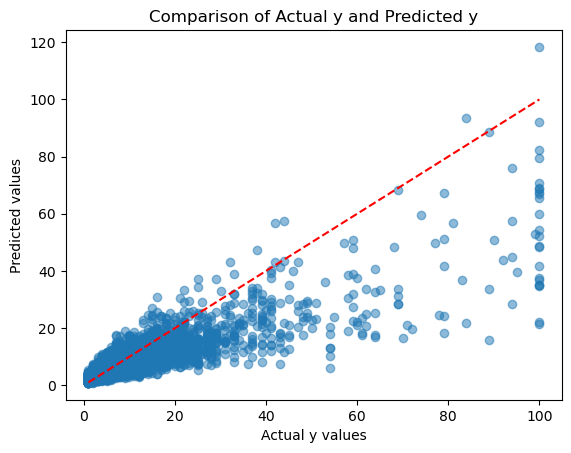

In [89]:
plt.scatter(np.exp(y_train), y_pred, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

In [130]:
X_test_filtered = X_test[imp_features]
pred_cat = cat_model2.predict(X_test_filtered)
pred_cat = np.exp(pred_cat)
pred_cat *= 1.27 #the model underestimates y


In [131]:
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": pred})
output.to_csv("submissions_cat_features_1.89.csv", index=False, header=True)

## Model 2: MARS

In [36]:
bagged_mars = BaggingRegressor(base_estimator=Earth(), 
                               n_estimators=100,
                               n_jobs=-1).fit(X_train_filtered, y_train)


/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannah

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

In [81]:
y_pred2 = bagged_mars.predict(X_train_filtered)
y_pred2 = np.exp(y_pred2)  # Transform y_pred back to the original scale

In [90]:
rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred2))
print(rmse)

9.371084041563375


In [91]:
x = np.array(np.exp(y_train)).reshape(-1, 1)
y = np.array(y_pred2)
lin = LinearRegression()
lin.fit(x, y)

LinearRegression()

In [92]:
1/lin.coef_[0]

3.082424390490194

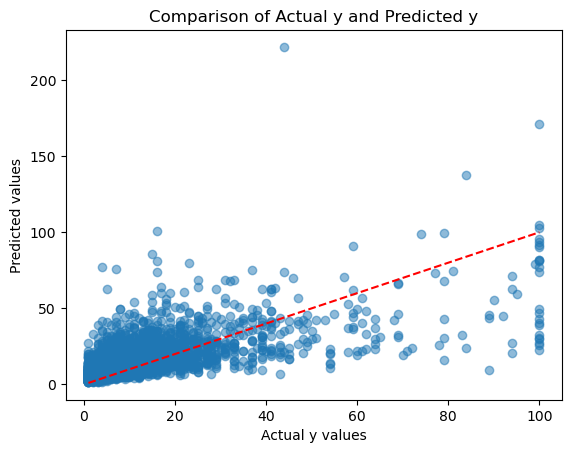

In [96]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred2*2, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

In [103]:
X_test_filtered = X_test[imp_features]
pred_mars = bagged_mars.predict(X_test_filtered)
pred_mars = np.exp(pred_mars)
pred_mars *= 1.25 #the model underestimates y


In [ ]:
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": pred})
output.to_csv("submissions_baggedmars_1.25.csv", index=False, header=True)

## Model 3: Blend of Mars + CatBoost

In [132]:
blend = pred_cat *0.35 + pred_mars*0.65
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": blend})
output.to_csv("submissions_blend.csv", index=False, header=True)

## Model 4: Voting Ensemble (Cat + MARS)

In [116]:
en=VotingRegressor(estimators = [('cat',cat_model2),('bagged mars',bagged_mars)])
en.fit(X_train_filtered,y_train)

Learning rate set to 0.053413
0:	learn: 0.9820409	total: 14.7ms	remaining: 14.7s
1:	learn: 0.9667420	total: 21.9ms	remaining: 10.9s
2:	learn: 0.9532215	total: 27.9ms	remaining: 9.26s
3:	learn: 0.9387539	total: 34.4ms	remaining: 8.57s
4:	learn: 0.9271897	total: 39.7ms	remaining: 7.91s
5:	learn: 0.9153879	total: 46.2ms	remaining: 7.66s
6:	learn: 0.9045132	total: 52.7ms	remaining: 7.48s
7:	learn: 0.8940071	total: 58.1ms	remaining: 7.21s
8:	learn: 0.8842068	total: 63.5ms	remaining: 6.99s
9:	learn: 0.8755379	total: 68.6ms	remaining: 6.79s
10:	learn: 0.8676020	total: 73.8ms	remaining: 6.64s
11:	learn: 0.8595944	total: 79ms	remaining: 6.51s
12:	learn: 0.8519956	total: 84.8ms	remaining: 6.44s
13:	learn: 0.8447170	total: 90.5ms	remaining: 6.37s
14:	learn: 0.8390308	total: 95.7ms	remaining: 6.28s
15:	learn: 0.8330145	total: 101ms	remaining: 6.22s
16:	learn: 0.8275985	total: 107ms	remaining: 6.17s
17:	learn: 0.8223391	total: 112ms	remaining: 6.09s
18:	learn: 0.8181522	total: 117ms	remaining: 6.06

170:	learn: 0.6257529	total: 995ms	remaining: 4.82s
171:	learn: 0.6248990	total: 1000ms	remaining: 4.81s
172:	learn: 0.6243907	total: 1.01s	remaining: 4.82s
173:	learn: 0.6238648	total: 1.01s	remaining: 4.81s
174:	learn: 0.6232229	total: 1.02s	remaining: 4.8s
175:	learn: 0.6227561	total: 1.02s	remaining: 4.79s
176:	learn: 0.6220758	total: 1.03s	remaining: 4.79s
177:	learn: 0.6215888	total: 1.03s	remaining: 4.78s
178:	learn: 0.6210636	total: 1.04s	remaining: 4.77s
179:	learn: 0.6204341	total: 1.05s	remaining: 4.77s
180:	learn: 0.6196226	total: 1.05s	remaining: 4.76s
181:	learn: 0.6190451	total: 1.06s	remaining: 4.76s
182:	learn: 0.6181340	total: 1.06s	remaining: 4.75s
183:	learn: 0.6175681	total: 1.07s	remaining: 4.74s
184:	learn: 0.6166894	total: 1.07s	remaining: 4.73s
185:	learn: 0.6162163	total: 1.08s	remaining: 4.72s
186:	learn: 0.6155870	total: 1.08s	remaining: 4.71s
187:	learn: 0.6151488	total: 1.09s	remaining: 4.7s
188:	learn: 0.6146435	total: 1.09s	remaining: 4.69s
189:	learn: 0

357:	learn: 0.5178199	total: 1.98s	remaining: 3.55s
358:	learn: 0.5173881	total: 1.99s	remaining: 3.55s
359:	learn: 0.5169894	total: 1.99s	remaining: 3.54s
360:	learn: 0.5166337	total: 2s	remaining: 3.54s
361:	learn: 0.5161204	total: 2s	remaining: 3.53s
362:	learn: 0.5157881	total: 2.01s	remaining: 3.52s
363:	learn: 0.5153699	total: 2.01s	remaining: 3.52s
364:	learn: 0.5149643	total: 2.02s	remaining: 3.52s
365:	learn: 0.5145801	total: 2.02s	remaining: 3.51s
366:	learn: 0.5139922	total: 2.03s	remaining: 3.5s
367:	learn: 0.5136337	total: 2.04s	remaining: 3.5s
368:	learn: 0.5130223	total: 2.04s	remaining: 3.49s
369:	learn: 0.5125531	total: 2.05s	remaining: 3.48s
370:	learn: 0.5121410	total: 2.05s	remaining: 3.48s
371:	learn: 0.5117027	total: 2.06s	remaining: 3.47s
372:	learn: 0.5109930	total: 2.06s	remaining: 3.46s
373:	learn: 0.5107347	total: 2.07s	remaining: 3.46s
374:	learn: 0.5103583	total: 2.07s	remaining: 3.45s
375:	learn: 0.5099652	total: 2.08s	remaining: 3.45s
376:	learn: 0.509610

537:	learn: 0.4414089	total: 2.99s	remaining: 2.57s
538:	learn: 0.4410517	total: 3s	remaining: 2.56s
539:	learn: 0.4409046	total: 3s	remaining: 2.56s
540:	learn: 0.4404451	total: 3.01s	remaining: 2.55s
541:	learn: 0.4400209	total: 3.01s	remaining: 2.55s
542:	learn: 0.4395776	total: 3.02s	remaining: 2.54s
543:	learn: 0.4392194	total: 3.02s	remaining: 2.53s
544:	learn: 0.4388342	total: 3.03s	remaining: 2.53s
545:	learn: 0.4384337	total: 3.03s	remaining: 2.52s
546:	learn: 0.4379936	total: 3.04s	remaining: 2.52s
547:	learn: 0.4376365	total: 3.04s	remaining: 2.51s
548:	learn: 0.4371649	total: 3.05s	remaining: 2.5s
549:	learn: 0.4367616	total: 3.05s	remaining: 2.5s
550:	learn: 0.4364324	total: 3.06s	remaining: 2.49s
551:	learn: 0.4363774	total: 3.06s	remaining: 2.49s
552:	learn: 0.4360510	total: 3.07s	remaining: 2.48s
553:	learn: 0.4358717	total: 3.07s	remaining: 2.47s
554:	learn: 0.4355957	total: 3.08s	remaining: 2.47s
555:	learn: 0.4352000	total: 3.08s	remaining: 2.46s
556:	learn: 0.434706

726:	learn: 0.3766049	total: 3.97s	remaining: 1.49s
727:	learn: 0.3764073	total: 3.98s	remaining: 1.49s
728:	learn: 0.3763679	total: 3.98s	remaining: 1.48s
729:	learn: 0.3760226	total: 3.99s	remaining: 1.48s
730:	learn: 0.3756421	total: 4s	remaining: 1.47s
731:	learn: 0.3752438	total: 4s	remaining: 1.46s
732:	learn: 0.3748083	total: 4s	remaining: 1.46s
733:	learn: 0.3744707	total: 4.01s	remaining: 1.45s
734:	learn: 0.3742359	total: 4.01s	remaining: 1.45s
735:	learn: 0.3737859	total: 4.02s	remaining: 1.44s
736:	learn: 0.3734736	total: 4.03s	remaining: 1.44s
737:	learn: 0.3730521	total: 4.03s	remaining: 1.43s
738:	learn: 0.3727177	total: 4.04s	remaining: 1.43s
739:	learn: 0.3723813	total: 4.04s	remaining: 1.42s
740:	learn: 0.3720975	total: 4.04s	remaining: 1.41s
741:	learn: 0.3718341	total: 4.05s	remaining: 1.41s
742:	learn: 0.3714430	total: 4.05s	remaining: 1.4s
743:	learn: 0.3712150	total: 4.06s	remaining: 1.4s
744:	learn: 0.3709118	total: 4.07s	remaining: 1.39s
745:	learn: 0.3706991	t

916:	learn: 0.3231240	total: 4.96s	remaining: 449ms
917:	learn: 0.3228416	total: 4.97s	remaining: 444ms
918:	learn: 0.3225974	total: 4.97s	remaining: 439ms
919:	learn: 0.3223092	total: 4.98s	remaining: 433ms
920:	learn: 0.3220271	total: 4.99s	remaining: 428ms
921:	learn: 0.3217922	total: 4.99s	remaining: 422ms
922:	learn: 0.3213398	total: 5s	remaining: 417ms
923:	learn: 0.3211293	total: 5s	remaining: 411ms
924:	learn: 0.3209210	total: 5.01s	remaining: 406ms
925:	learn: 0.3206861	total: 5.01s	remaining: 400ms
926:	learn: 0.3204699	total: 5.01s	remaining: 395ms
927:	learn: 0.3201643	total: 5.02s	remaining: 390ms
928:	learn: 0.3199662	total: 5.03s	remaining: 384ms
929:	learn: 0.3196802	total: 5.03s	remaining: 379ms
930:	learn: 0.3193187	total: 5.04s	remaining: 373ms
931:	learn: 0.3190463	total: 5.04s	remaining: 368ms
932:	learn: 0.3187392	total: 5.05s	remaining: 362ms
933:	learn: 0.3187263	total: 5.05s	remaining: 357ms
934:	learn: 0.3186798	total: 5.06s	remaining: 352ms
935:	learn: 0.3185

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannah

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

VotingRegressor(estimators=[('cat',
                             <catboost.core.CatBoostRegressor object at 0x7f81211f4850>),
                            ('bagged mars',
                             BaggingRegressor(base_estimator=Earth(),
                                              n_estimators=100, n_jobs=-1))])

In [117]:
y_pred3 = en.predict(X_train_filtered)

In [118]:
y_pred3 = np.exp(y_pred3)  # Transform y_pred back to the original scale

rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred2))

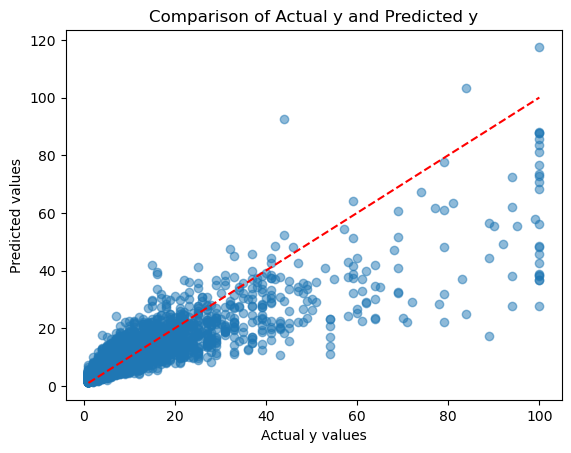

In [122]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred3*1.28, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

In [123]:
pred = en.predict(X_test_filtered)
pred = np.exp(pred)
pred *= 1.27 #the model underestimates y
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": pred})
output.to_csv("submissions_bestparams_mars_voting.csv", index=False, header=True)

## Model 4: Stacking Ensemble (Cat + MARS)

### Model 4.1: Stacking on linear regression

In [134]:
#Stacking using LinearRegression as the meta-model

from sklearn.ensemble import StackingRegressor
enlr=StackingRegressor(estimators = [('cat',cat_model2),('bagged mars',bagged_mars)],
                      final_estimator = LinearRegression(),
                       cv = KFold(n_splits = 5, shuffle = True, random_state = 1))
enlr.fit(X_train_filtered,y_train)

Learning rate set to 0.053413
0:	learn: 0.9820409	total: 13.7ms	remaining: 13.7s
1:	learn: 0.9667420	total: 20ms	remaining: 10s
2:	learn: 0.9532215	total: 26.3ms	remaining: 8.75s
3:	learn: 0.9387539	total: 31.6ms	remaining: 7.87s
4:	learn: 0.9271897	total: 36.8ms	remaining: 7.33s
5:	learn: 0.9153879	total: 42ms	remaining: 6.96s
6:	learn: 0.9045132	total: 47.2ms	remaining: 6.7s
7:	learn: 0.8940071	total: 52.6ms	remaining: 6.52s
8:	learn: 0.8842068	total: 57.4ms	remaining: 6.32s
9:	learn: 0.8755379	total: 62.3ms	remaining: 6.16s
10:	learn: 0.8676020	total: 67.5ms	remaining: 6.07s
11:	learn: 0.8595944	total: 72.5ms	remaining: 5.97s
12:	learn: 0.8519956	total: 77.5ms	remaining: 5.88s
13:	learn: 0.8447170	total: 82.8ms	remaining: 5.83s
14:	learn: 0.8390308	total: 87.8ms	remaining: 5.77s
15:	learn: 0.8330145	total: 92.8ms	remaining: 5.71s
16:	learn: 0.8275985	total: 98.5ms	remaining: 5.7s
17:	learn: 0.8223391	total: 104ms	remaining: 5.68s
18:	learn: 0.8181522	total: 109ms	remaining: 5.63s
19

183:	learn: 0.6175681	total: 988ms	remaining: 4.38s
184:	learn: 0.6166894	total: 997ms	remaining: 4.39s
185:	learn: 0.6162163	total: 1s	remaining: 4.39s
186:	learn: 0.6155870	total: 1.01s	remaining: 4.39s
187:	learn: 0.6151488	total: 1.01s	remaining: 4.38s
188:	learn: 0.6146435	total: 1.02s	remaining: 4.38s
189:	learn: 0.6141505	total: 1.03s	remaining: 4.38s
190:	learn: 0.6134692	total: 1.03s	remaining: 4.38s
191:	learn: 0.6128346	total: 1.04s	remaining: 4.37s
192:	learn: 0.6123325	total: 1.04s	remaining: 4.37s
193:	learn: 0.6116740	total: 1.05s	remaining: 4.36s
194:	learn: 0.6111122	total: 1.05s	remaining: 4.35s
195:	learn: 0.6106496	total: 1.06s	remaining: 4.35s
196:	learn: 0.6100671	total: 1.06s	remaining: 4.34s
197:	learn: 0.6093509	total: 1.07s	remaining: 4.34s
198:	learn: 0.6083029	total: 1.07s	remaining: 4.33s
199:	learn: 0.6076007	total: 1.08s	remaining: 4.33s
200:	learn: 0.6068776	total: 1.09s	remaining: 4.32s
201:	learn: 0.6062113	total: 1.09s	remaining: 4.31s
202:	learn: 0.6

375:	learn: 0.5099652	total: 2.17s	remaining: 3.6s
376:	learn: 0.5096103	total: 2.18s	remaining: 3.6s
377:	learn: 0.5091033	total: 2.18s	remaining: 3.59s
378:	learn: 0.5085110	total: 2.19s	remaining: 3.59s
379:	learn: 0.5079931	total: 2.2s	remaining: 3.58s
380:	learn: 0.5074359	total: 2.2s	remaining: 3.58s
381:	learn: 0.5068778	total: 2.21s	remaining: 3.57s
382:	learn: 0.5065544	total: 2.21s	remaining: 3.57s
383:	learn: 0.5060338	total: 2.22s	remaining: 3.56s
384:	learn: 0.5056290	total: 2.23s	remaining: 3.55s
385:	learn: 0.5051976	total: 2.23s	remaining: 3.55s
386:	learn: 0.5048249	total: 2.24s	remaining: 3.54s
387:	learn: 0.5043566	total: 2.24s	remaining: 3.54s
388:	learn: 0.5039272	total: 2.25s	remaining: 3.53s
389:	learn: 0.5033807	total: 2.25s	remaining: 3.52s
390:	learn: 0.5028027	total: 2.26s	remaining: 3.52s
391:	learn: 0.5023371	total: 2.27s	remaining: 3.51s
392:	learn: 0.5017902	total: 2.27s	remaining: 3.51s
393:	learn: 0.5011878	total: 2.28s	remaining: 3.5s
394:	learn: 0.500

562:	learn: 0.4319304	total: 3.16s	remaining: 2.45s
563:	learn: 0.4314729	total: 3.17s	remaining: 2.45s
564:	learn: 0.4314275	total: 3.17s	remaining: 2.44s
565:	learn: 0.4309837	total: 3.17s	remaining: 2.44s
566:	learn: 0.4307140	total: 3.18s	remaining: 2.43s
567:	learn: 0.4303041	total: 3.19s	remaining: 2.42s
568:	learn: 0.4298889	total: 3.19s	remaining: 2.42s
569:	learn: 0.4295723	total: 3.2s	remaining: 2.41s
570:	learn: 0.4291235	total: 3.2s	remaining: 2.4s
571:	learn: 0.4287406	total: 3.21s	remaining: 2.4s
572:	learn: 0.4284524	total: 3.21s	remaining: 2.39s
573:	learn: 0.4281028	total: 3.22s	remaining: 2.39s
574:	learn: 0.4276709	total: 3.22s	remaining: 2.38s
575:	learn: 0.4272076	total: 3.23s	remaining: 2.38s
576:	learn: 0.4267426	total: 3.23s	remaining: 2.37s
577:	learn: 0.4263543	total: 3.24s	remaining: 2.36s
578:	learn: 0.4260170	total: 3.24s	remaining: 2.36s
579:	learn: 0.4255887	total: 3.25s	remaining: 2.35s
580:	learn: 0.4252074	total: 3.25s	remaining: 2.35s
581:	learn: 0.42

751:	learn: 0.3687509	total: 4.14s	remaining: 1.37s
752:	learn: 0.3683877	total: 4.15s	remaining: 1.36s
753:	learn: 0.3680512	total: 4.16s	remaining: 1.36s
754:	learn: 0.3677620	total: 4.16s	remaining: 1.35s
755:	learn: 0.3674635	total: 4.17s	remaining: 1.34s
756:	learn: 0.3674364	total: 4.17s	remaining: 1.34s
757:	learn: 0.3671552	total: 4.18s	remaining: 1.33s
758:	learn: 0.3667992	total: 4.18s	remaining: 1.33s
759:	learn: 0.3664756	total: 4.19s	remaining: 1.32s
760:	learn: 0.3663201	total: 4.19s	remaining: 1.32s
761:	learn: 0.3660381	total: 4.2s	remaining: 1.31s
762:	learn: 0.3656095	total: 4.2s	remaining: 1.3s
763:	learn: 0.3651627	total: 4.21s	remaining: 1.3s
764:	learn: 0.3647151	total: 4.21s	remaining: 1.29s
765:	learn: 0.3643890	total: 4.22s	remaining: 1.29s
766:	learn: 0.3639949	total: 4.22s	remaining: 1.28s
767:	learn: 0.3636903	total: 4.23s	remaining: 1.28s
768:	learn: 0.3634399	total: 4.23s	remaining: 1.27s
769:	learn: 0.3632971	total: 4.24s	remaining: 1.27s
770:	learn: 0.36

939:	learn: 0.3176041	total: 5.13s	remaining: 327ms
940:	learn: 0.3173192	total: 5.13s	remaining: 322ms
941:	learn: 0.3170119	total: 5.14s	remaining: 316ms
942:	learn: 0.3168426	total: 5.14s	remaining: 311ms
943:	learn: 0.3165444	total: 5.15s	remaining: 305ms
944:	learn: 0.3162093	total: 5.15s	remaining: 300ms
945:	learn: 0.3160066	total: 5.16s	remaining: 294ms
946:	learn: 0.3157642	total: 5.16s	remaining: 289ms
947:	learn: 0.3155969	total: 5.17s	remaining: 283ms
948:	learn: 0.3153110	total: 5.17s	remaining: 278ms
949:	learn: 0.3150749	total: 5.18s	remaining: 273ms
950:	learn: 0.3148082	total: 5.18s	remaining: 267ms
951:	learn: 0.3145988	total: 5.19s	remaining: 262ms
952:	learn: 0.3143169	total: 5.19s	remaining: 256ms
953:	learn: 0.3140599	total: 5.2s	remaining: 251ms
954:	learn: 0.3137692	total: 5.2s	remaining: 245ms
955:	learn: 0.3135719	total: 5.21s	remaining: 240ms
956:	learn: 0.3132903	total: 5.21s	remaining: 234ms
957:	learn: 0.3130567	total: 5.22s	remaining: 229ms
958:	learn: 0.

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, 

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

Learning rate set to 0.051562
0:	learn: 0.9791521	total: 11.6ms	remaining: 11.6s
1:	learn: 0.9644000	total: 16.8ms	remaining: 8.4s
2:	learn: 0.9502207	total: 21.6ms	remaining: 7.2s
3:	learn: 0.9369520	total: 27ms	remaining: 6.72s
4:	learn: 0.9258126	total: 31.9ms	remaining: 6.34s
5:	learn: 0.9144101	total: 37ms	remaining: 6.13s
6:	learn: 0.9042599	total: 41.8ms	remaining: 5.94s
7:	learn: 0.8943928	total: 47.8ms	remaining: 5.93s
8:	learn: 0.8858284	total: 52.9ms	remaining: 5.82s
9:	learn: 0.8768795	total: 59.1ms	remaining: 5.86s
10:	learn: 0.8692752	total: 64ms	remaining: 5.75s
11:	learn: 0.8613165	total: 69.1ms	remaining: 5.69s
12:	learn: 0.8538625	total: 73.9ms	remaining: 5.61s
13:	learn: 0.8464121	total: 78.8ms	remaining: 5.55s
14:	learn: 0.8401378	total: 84.5ms	remaining: 5.54s
15:	learn: 0.8343630	total: 89.8ms	remaining: 5.52s
16:	learn: 0.8284510	total: 94.8ms	remaining: 5.48s
17:	learn: 0.8231826	total: 100ms	remaining: 5.45s
18:	learn: 0.8189884	total: 106ms	remaining: 5.46s
19

183:	learn: 0.6146653	total: 982ms	remaining: 4.36s
184:	learn: 0.6138236	total: 987ms	remaining: 4.35s
185:	learn: 0.6132775	total: 992ms	remaining: 4.34s
186:	learn: 0.6125179	total: 997ms	remaining: 4.33s
187:	learn: 0.6119577	total: 1s	remaining: 4.33s
188:	learn: 0.6111924	total: 1.01s	remaining: 4.32s
189:	learn: 0.6107144	total: 1.01s	remaining: 4.31s
190:	learn: 0.6096200	total: 1.02s	remaining: 4.3s
191:	learn: 0.6090647	total: 1.02s	remaining: 4.3s
192:	learn: 0.6085196	total: 1.03s	remaining: 4.29s
193:	learn: 0.6077024	total: 1.03s	remaining: 4.28s
194:	learn: 0.6072688	total: 1.04s	remaining: 4.28s
195:	learn: 0.6064466	total: 1.04s	remaining: 4.28s
196:	learn: 0.6055394	total: 1.05s	remaining: 4.27s
197:	learn: 0.6045239	total: 1.05s	remaining: 4.27s
198:	learn: 0.6035629	total: 1.06s	remaining: 4.26s
199:	learn: 0.6028617	total: 1.06s	remaining: 4.25s
200:	learn: 0.6021143	total: 1.07s	remaining: 4.25s
201:	learn: 0.6015795	total: 1.07s	remaining: 4.24s
202:	learn: 0.600

357:	learn: 0.5054959	total: 1.98s	remaining: 3.56s
358:	learn: 0.5049299	total: 1.99s	remaining: 3.55s
359:	learn: 0.5043647	total: 2s	remaining: 3.55s
360:	learn: 0.5037100	total: 2s	remaining: 3.54s
361:	learn: 0.5031273	total: 2.01s	remaining: 3.54s
362:	learn: 0.5025883	total: 2.01s	remaining: 3.53s
363:	learn: 0.5020601	total: 2.02s	remaining: 3.53s
364:	learn: 0.5013435	total: 2.02s	remaining: 3.52s
365:	learn: 0.5009955	total: 2.03s	remaining: 3.52s
366:	learn: 0.5002890	total: 2.03s	remaining: 3.51s
367:	learn: 0.4997056	total: 2.04s	remaining: 3.5s
368:	learn: 0.4994069	total: 2.04s	remaining: 3.5s
369:	learn: 0.4988947	total: 2.05s	remaining: 3.49s
370:	learn: 0.4983253	total: 2.05s	remaining: 3.48s
371:	learn: 0.4978873	total: 2.06s	remaining: 3.48s
372:	learn: 0.4972229	total: 2.06s	remaining: 3.47s
373:	learn: 0.4968627	total: 2.07s	remaining: 3.46s
374:	learn: 0.4963349	total: 2.08s	remaining: 3.46s
375:	learn: 0.4958009	total: 2.08s	remaining: 3.45s
376:	learn: 0.495234

547:	learn: 0.4167588	total: 2.97s	remaining: 2.45s
548:	learn: 0.4164247	total: 2.98s	remaining: 2.44s
549:	learn: 0.4157013	total: 2.98s	remaining: 2.44s
550:	learn: 0.4156591	total: 2.98s	remaining: 2.43s
551:	learn: 0.4156143	total: 2.99s	remaining: 2.43s
552:	learn: 0.4151639	total: 3s	remaining: 2.42s
553:	learn: 0.4148926	total: 3s	remaining: 2.42s
554:	learn: 0.4145772	total: 3.01s	remaining: 2.41s
555:	learn: 0.4142267	total: 3.01s	remaining: 2.4s
556:	learn: 0.4140926	total: 3.02s	remaining: 2.4s
557:	learn: 0.4137187	total: 3.02s	remaining: 2.39s
558:	learn: 0.4132797	total: 3.02s	remaining: 2.39s
559:	learn: 0.4125633	total: 3.03s	remaining: 2.38s
560:	learn: 0.4124452	total: 3.04s	remaining: 2.38s
561:	learn: 0.4119336	total: 3.04s	remaining: 2.37s
562:	learn: 0.4115143	total: 3.04s	remaining: 2.36s
563:	learn: 0.4112084	total: 3.05s	remaining: 2.36s
564:	learn: 0.4107354	total: 3.06s	remaining: 2.35s
565:	learn: 0.4106553	total: 3.06s	remaining: 2.35s
566:	learn: 0.410296

738:	learn: 0.3498459	total: 3.95s	remaining: 1.4s
739:	learn: 0.3493636	total: 3.96s	remaining: 1.39s
740:	learn: 0.3489369	total: 3.97s	remaining: 1.39s
741:	learn: 0.3486236	total: 3.97s	remaining: 1.38s
742:	learn: 0.3481633	total: 3.98s	remaining: 1.38s
743:	learn: 0.3478195	total: 3.98s	remaining: 1.37s
744:	learn: 0.3472300	total: 3.99s	remaining: 1.36s
745:	learn: 0.3469833	total: 3.99s	remaining: 1.36s
746:	learn: 0.3466083	total: 4s	remaining: 1.35s
747:	learn: 0.3463275	total: 4s	remaining: 1.35s
748:	learn: 0.3460518	total: 4.01s	remaining: 1.34s
749:	learn: 0.3458121	total: 4.01s	remaining: 1.34s
750:	learn: 0.3454900	total: 4.02s	remaining: 1.33s
751:	learn: 0.3451627	total: 4.02s	remaining: 1.33s
752:	learn: 0.3448497	total: 4.03s	remaining: 1.32s
753:	learn: 0.3442521	total: 4.03s	remaining: 1.31s
754:	learn: 0.3439501	total: 4.04s	remaining: 1.31s
755:	learn: 0.3435964	total: 4.04s	remaining: 1.3s
756:	learn: 0.3433665	total: 4.05s	remaining: 1.3s
757:	learn: 0.3430134

925:	learn: 0.2938007	total: 4.94s	remaining: 395ms
926:	learn: 0.2933646	total: 4.94s	remaining: 389ms
927:	learn: 0.2931145	total: 4.95s	remaining: 384ms
928:	learn: 0.2929197	total: 4.95s	remaining: 379ms
929:	learn: 0.2926244	total: 4.96s	remaining: 373ms
930:	learn: 0.2922124	total: 4.96s	remaining: 368ms
931:	learn: 0.2919452	total: 4.97s	remaining: 363ms
932:	learn: 0.2919336	total: 4.97s	remaining: 357ms
933:	learn: 0.2917485	total: 4.98s	remaining: 352ms
934:	learn: 0.2914391	total: 4.99s	remaining: 347ms
935:	learn: 0.2911078	total: 4.99s	remaining: 341ms
936:	learn: 0.2908645	total: 5s	remaining: 336ms
937:	learn: 0.2905509	total: 5s	remaining: 331ms
938:	learn: 0.2903783	total: 5.01s	remaining: 325ms
939:	learn: 0.2901559	total: 5.01s	remaining: 320ms
940:	learn: 0.2899874	total: 5.02s	remaining: 315ms
941:	learn: 0.2897186	total: 5.02s	remaining: 309ms
942:	learn: 0.2894818	total: 5.03s	remaining: 304ms
943:	learn: 0.2891318	total: 5.03s	remaining: 299ms
944:	learn: 0.2887

104:	learn: 0.6704669	total: 557ms	remaining: 4.74s
105:	learn: 0.6697073	total: 562ms	remaining: 4.74s
106:	learn: 0.6688415	total: 567ms	remaining: 4.73s
107:	learn: 0.6680334	total: 571ms	remaining: 4.72s
108:	learn: 0.6675379	total: 577ms	remaining: 4.71s
109:	learn: 0.6668502	total: 581ms	remaining: 4.7s
110:	learn: 0.6659498	total: 588ms	remaining: 4.71s
111:	learn: 0.6650132	total: 593ms	remaining: 4.7s
112:	learn: 0.6641332	total: 598ms	remaining: 4.69s
113:	learn: 0.6634488	total: 603ms	remaining: 4.68s
114:	learn: 0.6627446	total: 608ms	remaining: 4.68s
115:	learn: 0.6620750	total: 612ms	remaining: 4.67s
116:	learn: 0.6613360	total: 618ms	remaining: 4.66s
117:	learn: 0.6606188	total: 623ms	remaining: 4.66s
118:	learn: 0.6599063	total: 628ms	remaining: 4.65s
119:	learn: 0.6593125	total: 634ms	remaining: 4.65s
120:	learn: 0.6587612	total: 639ms	remaining: 4.64s
121:	learn: 0.6581196	total: 644ms	remaining: 4.64s
122:	learn: 0.6573078	total: 649ms	remaining: 4.63s
123:	learn: 0.

280:	learn: 0.5426572	total: 1.55s	remaining: 3.96s
281:	learn: 0.5420283	total: 1.55s	remaining: 3.95s
282:	learn: 0.5413860	total: 1.56s	remaining: 3.94s
283:	learn: 0.5406293	total: 1.56s	remaining: 3.94s
284:	learn: 0.5397629	total: 1.57s	remaining: 3.93s
285:	learn: 0.5392453	total: 1.57s	remaining: 3.92s
286:	learn: 0.5384218	total: 1.58s	remaining: 3.92s
287:	learn: 0.5378937	total: 1.58s	remaining: 3.91s
288:	learn: 0.5373651	total: 1.59s	remaining: 3.91s
289:	learn: 0.5368469	total: 1.59s	remaining: 3.9s
290:	learn: 0.5362731	total: 1.6s	remaining: 3.9s
291:	learn: 0.5354514	total: 1.6s	remaining: 3.89s
292:	learn: 0.5347713	total: 1.61s	remaining: 3.88s
293:	learn: 0.5340991	total: 1.61s	remaining: 3.87s
294:	learn: 0.5335655	total: 1.62s	remaining: 3.87s
295:	learn: 0.5330840	total: 1.62s	remaining: 3.86s
296:	learn: 0.5325833	total: 1.63s	remaining: 3.86s
297:	learn: 0.5320881	total: 1.63s	remaining: 3.85s
298:	learn: 0.5315954	total: 1.64s	remaining: 3.85s
299:	learn: 0.53

469:	learn: 0.4425401	total: 2.53s	remaining: 2.85s
470:	learn: 0.4420898	total: 2.54s	remaining: 2.85s
471:	learn: 0.4416984	total: 2.54s	remaining: 2.84s
472:	learn: 0.4412778	total: 2.55s	remaining: 2.84s
473:	learn: 0.4407679	total: 2.55s	remaining: 2.83s
474:	learn: 0.4403026	total: 2.56s	remaining: 2.83s
475:	learn: 0.4401039	total: 2.56s	remaining: 2.82s
476:	learn: 0.4397367	total: 2.57s	remaining: 2.81s
477:	learn: 0.4393302	total: 2.57s	remaining: 2.81s
478:	learn: 0.4387449	total: 2.58s	remaining: 2.8s
479:	learn: 0.4383009	total: 2.58s	remaining: 2.8s
480:	learn: 0.4378622	total: 2.59s	remaining: 2.79s
481:	learn: 0.4374207	total: 2.59s	remaining: 2.79s
482:	learn: 0.4369285	total: 2.6s	remaining: 2.78s
483:	learn: 0.4365417	total: 2.6s	remaining: 2.77s
484:	learn: 0.4362275	total: 2.61s	remaining: 2.77s
485:	learn: 0.4358876	total: 2.61s	remaining: 2.77s
486:	learn: 0.4355025	total: 2.62s	remaining: 2.76s
487:	learn: 0.4351897	total: 2.62s	remaining: 2.75s
488:	learn: 0.43

658:	learn: 0.3692483	total: 3.51s	remaining: 1.82s
659:	learn: 0.3688063	total: 3.52s	remaining: 1.81s
660:	learn: 0.3684748	total: 3.53s	remaining: 1.81s
661:	learn: 0.3682324	total: 3.53s	remaining: 1.8s
662:	learn: 0.3679498	total: 3.54s	remaining: 1.8s
663:	learn: 0.3675016	total: 3.54s	remaining: 1.79s
664:	learn: 0.3671729	total: 3.55s	remaining: 1.79s
665:	learn: 0.3668192	total: 3.55s	remaining: 1.78s
666:	learn: 0.3662568	total: 3.56s	remaining: 1.78s
667:	learn: 0.3658903	total: 3.56s	remaining: 1.77s
668:	learn: 0.3655031	total: 3.57s	remaining: 1.76s
669:	learn: 0.3651029	total: 3.57s	remaining: 1.76s
670:	learn: 0.3647506	total: 3.58s	remaining: 1.75s
671:	learn: 0.3644842	total: 3.58s	remaining: 1.75s
672:	learn: 0.3641286	total: 3.59s	remaining: 1.74s
673:	learn: 0.3637608	total: 3.59s	remaining: 1.74s
674:	learn: 0.3632760	total: 3.6s	remaining: 1.73s
675:	learn: 0.3629019	total: 3.6s	remaining: 1.73s
676:	learn: 0.3626803	total: 3.61s	remaining: 1.72s
677:	learn: 0.36

846:	learn: 0.3095469	total: 4.5s	remaining: 813ms
847:	learn: 0.3092748	total: 4.51s	remaining: 808ms
848:	learn: 0.3089617	total: 4.51s	remaining: 803ms
849:	learn: 0.3087752	total: 4.52s	remaining: 797ms
850:	learn: 0.3084877	total: 4.52s	remaining: 792ms
851:	learn: 0.3082366	total: 4.53s	remaining: 786ms
852:	learn: 0.3079340	total: 4.53s	remaining: 781ms
853:	learn: 0.3075228	total: 4.54s	remaining: 776ms
854:	learn: 0.3071662	total: 4.54s	remaining: 770ms
855:	learn: 0.3068537	total: 4.55s	remaining: 765ms
856:	learn: 0.3066119	total: 4.55s	remaining: 760ms
857:	learn: 0.3061630	total: 4.56s	remaining: 754ms
858:	learn: 0.3059078	total: 4.56s	remaining: 749ms
859:	learn: 0.3055303	total: 4.57s	remaining: 744ms
860:	learn: 0.3052552	total: 4.57s	remaining: 738ms
861:	learn: 0.3049731	total: 4.58s	remaining: 733ms
862:	learn: 0.3047146	total: 4.58s	remaining: 728ms
863:	learn: 0.3044476	total: 4.59s	remaining: 722ms
864:	learn: 0.3041648	total: 4.59s	remaining: 717ms
865:	learn: 0

27:	learn: 0.7812977	total: 153ms	remaining: 5.31s
28:	learn: 0.7779828	total: 158ms	remaining: 5.29s
29:	learn: 0.7745183	total: 163ms	remaining: 5.26s
30:	learn: 0.7714828	total: 169ms	remaining: 5.27s
31:	learn: 0.7687911	total: 175ms	remaining: 5.29s
32:	learn: 0.7657435	total: 181ms	remaining: 5.31s
33:	learn: 0.7629179	total: 186ms	remaining: 5.3s
34:	learn: 0.7603560	total: 191ms	remaining: 5.27s
35:	learn: 0.7576060	total: 196ms	remaining: 5.26s
36:	learn: 0.7553291	total: 201ms	remaining: 5.24s
37:	learn: 0.7529180	total: 206ms	remaining: 5.21s
38:	learn: 0.7504196	total: 211ms	remaining: 5.2s
39:	learn: 0.7483136	total: 216ms	remaining: 5.19s
40:	learn: 0.7464311	total: 224ms	remaining: 5.24s
41:	learn: 0.7443977	total: 229ms	remaining: 5.22s
42:	learn: 0.7423838	total: 234ms	remaining: 5.2s
43:	learn: 0.7399392	total: 238ms	remaining: 5.18s
44:	learn: 0.7381032	total: 243ms	remaining: 5.16s
45:	learn: 0.7363765	total: 248ms	remaining: 5.15s
46:	learn: 0.7342585	total: 254ms	

203:	learn: 0.5970424	total: 1.15s	remaining: 4.47s
204:	learn: 0.5963635	total: 1.15s	remaining: 4.46s
205:	learn: 0.5956983	total: 1.16s	remaining: 4.46s
206:	learn: 0.5949371	total: 1.16s	remaining: 4.46s
207:	learn: 0.5941582	total: 1.17s	remaining: 4.45s
208:	learn: 0.5933325	total: 1.17s	remaining: 4.45s
209:	learn: 0.5924221	total: 1.19s	remaining: 4.5s
210:	learn: 0.5916979	total: 1.21s	remaining: 4.53s
211:	learn: 0.5912173	total: 1.22s	remaining: 4.52s
212:	learn: 0.5903896	total: 1.22s	remaining: 4.51s
213:	learn: 0.5895628	total: 1.23s	remaining: 4.5s
214:	learn: 0.5888713	total: 1.23s	remaining: 4.5s
215:	learn: 0.5882864	total: 1.24s	remaining: 4.49s
216:	learn: 0.5875812	total: 1.25s	remaining: 4.49s
217:	learn: 0.5869201	total: 1.25s	remaining: 4.49s
218:	learn: 0.5862112	total: 1.26s	remaining: 4.48s
219:	learn: 0.5854334	total: 1.26s	remaining: 4.47s
220:	learn: 0.5846936	total: 1.27s	remaining: 4.47s
221:	learn: 0.5842026	total: 1.27s	remaining: 4.47s
222:	learn: 0.5

381:	learn: 0.4896896	total: 2.13s	remaining: 3.45s
382:	learn: 0.4891320	total: 2.14s	remaining: 3.44s
383:	learn: 0.4883996	total: 2.14s	remaining: 3.44s
384:	learn: 0.4882943	total: 2.15s	remaining: 3.43s
385:	learn: 0.4879643	total: 2.15s	remaining: 3.43s
386:	learn: 0.4873531	total: 2.16s	remaining: 3.42s
387:	learn: 0.4869159	total: 2.17s	remaining: 3.42s
388:	learn: 0.4863957	total: 2.17s	remaining: 3.41s
389:	learn: 0.4860282	total: 2.18s	remaining: 3.41s
390:	learn: 0.4856707	total: 2.18s	remaining: 3.4s
391:	learn: 0.4853171	total: 2.19s	remaining: 3.39s
392:	learn: 0.4847575	total: 2.19s	remaining: 3.39s
393:	learn: 0.4843621	total: 2.2s	remaining: 3.38s
394:	learn: 0.4839015	total: 2.2s	remaining: 3.37s
395:	learn: 0.4831513	total: 2.21s	remaining: 3.37s
396:	learn: 0.4824109	total: 2.21s	remaining: 3.36s
397:	learn: 0.4819969	total: 2.22s	remaining: 3.36s
398:	learn: 0.4817795	total: 2.23s	remaining: 3.35s
399:	learn: 0.4812833	total: 2.23s	remaining: 3.35s
400:	learn: 0.4

572:	learn: 0.4079005	total: 3.12s	remaining: 2.33s
573:	learn: 0.4074041	total: 3.13s	remaining: 2.32s
574:	learn: 0.4070750	total: 3.13s	remaining: 2.31s
575:	learn: 0.4067196	total: 3.14s	remaining: 2.31s
576:	learn: 0.4062557	total: 3.14s	remaining: 2.3s
577:	learn: 0.4057526	total: 3.15s	remaining: 2.3s
578:	learn: 0.4054253	total: 3.15s	remaining: 2.29s
579:	learn: 0.4049871	total: 3.16s	remaining: 2.29s
580:	learn: 0.4046212	total: 3.16s	remaining: 2.28s
581:	learn: 0.4042085	total: 3.17s	remaining: 2.27s
582:	learn: 0.4036798	total: 3.17s	remaining: 2.27s
583:	learn: 0.4032463	total: 3.18s	remaining: 2.26s
584:	learn: 0.4031933	total: 3.18s	remaining: 2.26s
585:	learn: 0.4027213	total: 3.19s	remaining: 2.25s
586:	learn: 0.4022600	total: 3.19s	remaining: 2.25s
587:	learn: 0.4018350	total: 3.2s	remaining: 2.24s
588:	learn: 0.4013788	total: 3.2s	remaining: 2.23s
589:	learn: 0.4009194	total: 3.21s	remaining: 2.23s
590:	learn: 0.4008515	total: 3.21s	remaining: 2.22s
591:	learn: 0.40

758:	learn: 0.3439549	total: 4.1s	remaining: 1.3s
759:	learn: 0.3437514	total: 4.11s	remaining: 1.3s
760:	learn: 0.3433898	total: 4.11s	remaining: 1.29s
761:	learn: 0.3430285	total: 4.12s	remaining: 1.29s
762:	learn: 0.3426326	total: 4.12s	remaining: 1.28s
763:	learn: 0.3421182	total: 4.13s	remaining: 1.27s
764:	learn: 0.3417611	total: 4.13s	remaining: 1.27s
765:	learn: 0.3414525	total: 4.14s	remaining: 1.26s
766:	learn: 0.3410379	total: 4.14s	remaining: 1.26s
767:	learn: 0.3406452	total: 4.15s	remaining: 1.25s
768:	learn: 0.3402486	total: 4.15s	remaining: 1.25s
769:	learn: 0.3399266	total: 4.16s	remaining: 1.24s
770:	learn: 0.3394983	total: 4.16s	remaining: 1.24s
771:	learn: 0.3391362	total: 4.17s	remaining: 1.23s
772:	learn: 0.3389488	total: 4.17s	remaining: 1.23s
773:	learn: 0.3387491	total: 4.18s	remaining: 1.22s
774:	learn: 0.3384046	total: 4.18s	remaining: 1.21s
775:	learn: 0.3380435	total: 4.19s	remaining: 1.21s
776:	learn: 0.3377178	total: 4.19s	remaining: 1.2s
777:	learn: 0.33

949:	learn: 0.2920369	total: 5.09s	remaining: 268ms
950:	learn: 0.2919171	total: 5.09s	remaining: 262ms
951:	learn: 0.2917326	total: 5.1s	remaining: 257ms
952:	learn: 0.2914883	total: 5.1s	remaining: 252ms
953:	learn: 0.2911463	total: 5.11s	remaining: 246ms
954:	learn: 0.2907989	total: 5.12s	remaining: 241ms
955:	learn: 0.2904137	total: 5.12s	remaining: 236ms
956:	learn: 0.2901027	total: 5.13s	remaining: 230ms
957:	learn: 0.2900078	total: 5.13s	remaining: 225ms
958:	learn: 0.2897142	total: 5.14s	remaining: 220ms
959:	learn: 0.2894591	total: 5.14s	remaining: 214ms
960:	learn: 0.2890880	total: 5.15s	remaining: 209ms
961:	learn: 0.2889217	total: 5.15s	remaining: 204ms
962:	learn: 0.2886097	total: 5.16s	remaining: 198ms
963:	learn: 0.2882944	total: 5.17s	remaining: 193ms
964:	learn: 0.2881296	total: 5.17s	remaining: 188ms
965:	learn: 0.2878880	total: 5.17s	remaining: 182ms
966:	learn: 0.2876482	total: 5.18s	remaining: 177ms
967:	learn: 0.2873708	total: 5.18s	remaining: 171ms
968:	learn: 0.

130:	learn: 0.6508484	total: 691ms	remaining: 4.58s
131:	learn: 0.6501671	total: 695ms	remaining: 4.57s
132:	learn: 0.6493824	total: 703ms	remaining: 4.58s
133:	learn: 0.6485639	total: 709ms	remaining: 4.58s
134:	learn: 0.6477421	total: 713ms	remaining: 4.57s
135:	learn: 0.6467382	total: 718ms	remaining: 4.56s
136:	learn: 0.6459611	total: 723ms	remaining: 4.55s
137:	learn: 0.6454831	total: 728ms	remaining: 4.55s
138:	learn: 0.6449213	total: 733ms	remaining: 4.54s
139:	learn: 0.6442606	total: 738ms	remaining: 4.53s
140:	learn: 0.6436675	total: 744ms	remaining: 4.53s
141:	learn: 0.6429338	total: 748ms	remaining: 4.52s
142:	learn: 0.6424179	total: 753ms	remaining: 4.51s
143:	learn: 0.6414380	total: 758ms	remaining: 4.51s
144:	learn: 0.6408396	total: 763ms	remaining: 4.5s
145:	learn: 0.6400612	total: 768ms	remaining: 4.49s
146:	learn: 0.6392619	total: 773ms	remaining: 4.48s
147:	learn: 0.6389545	total: 778ms	remaining: 4.48s
148:	learn: 0.6380723	total: 784ms	remaining: 4.48s
149:	learn: 0

319:	learn: 0.5228444	total: 1.68s	remaining: 3.58s
320:	learn: 0.5224239	total: 1.69s	remaining: 3.57s
321:	learn: 0.5219972	total: 1.69s	remaining: 3.56s
322:	learn: 0.5213889	total: 1.7s	remaining: 3.56s
323:	learn: 0.5211113	total: 1.7s	remaining: 3.55s
324:	learn: 0.5204227	total: 1.71s	remaining: 3.55s
325:	learn: 0.5198440	total: 1.71s	remaining: 3.54s
326:	learn: 0.5192140	total: 1.72s	remaining: 3.54s
327:	learn: 0.5187032	total: 1.72s	remaining: 3.53s
328:	learn: 0.5180524	total: 1.73s	remaining: 3.52s
329:	learn: 0.5173290	total: 1.73s	remaining: 3.52s
330:	learn: 0.5169000	total: 1.74s	remaining: 3.51s
331:	learn: 0.5165437	total: 1.74s	remaining: 3.51s
332:	learn: 0.5157058	total: 1.75s	remaining: 3.5s
333:	learn: 0.5151725	total: 1.75s	remaining: 3.5s
334:	learn: 0.5145025	total: 1.76s	remaining: 3.49s
335:	learn: 0.5140794	total: 1.76s	remaining: 3.48s
336:	learn: 0.5133699	total: 1.77s	remaining: 3.48s
337:	learn: 0.5126307	total: 1.77s	remaining: 3.47s
338:	learn: 0.51

505:	learn: 0.4341886	total: 2.67s	remaining: 2.6s
506:	learn: 0.4337248	total: 2.67s	remaining: 2.6s
507:	learn: 0.4334532	total: 2.68s	remaining: 2.6s
508:	learn: 0.4330713	total: 2.69s	remaining: 2.59s
509:	learn: 0.4325436	total: 2.69s	remaining: 2.58s
510:	learn: 0.4325181	total: 2.69s	remaining: 2.58s
511:	learn: 0.4324795	total: 2.7s	remaining: 2.57s
512:	learn: 0.4318673	total: 2.71s	remaining: 2.57s
513:	learn: 0.4313186	total: 2.71s	remaining: 2.56s
514:	learn: 0.4308264	total: 2.72s	remaining: 2.56s
515:	learn: 0.4302214	total: 2.72s	remaining: 2.55s
516:	learn: 0.4296905	total: 2.73s	remaining: 2.55s
517:	learn: 0.4289062	total: 2.73s	remaining: 2.54s
518:	learn: 0.4282817	total: 2.74s	remaining: 2.54s
519:	learn: 0.4276215	total: 2.75s	remaining: 2.53s
520:	learn: 0.4269740	total: 2.75s	remaining: 2.53s
521:	learn: 0.4264652	total: 2.76s	remaining: 2.52s
522:	learn: 0.4260335	total: 2.76s	remaining: 2.52s
523:	learn: 0.4256734	total: 2.77s	remaining: 2.51s
524:	learn: 0.42

692:	learn: 0.3618925	total: 3.65s	remaining: 1.62s
693:	learn: 0.3616092	total: 3.66s	remaining: 1.61s
694:	learn: 0.3614023	total: 3.67s	remaining: 1.61s
695:	learn: 0.3611311	total: 3.67s	remaining: 1.6s
696:	learn: 0.3607903	total: 3.67s	remaining: 1.6s
697:	learn: 0.3603496	total: 3.68s	remaining: 1.59s
698:	learn: 0.3599655	total: 3.69s	remaining: 1.59s
699:	learn: 0.3595865	total: 3.69s	remaining: 1.58s
700:	learn: 0.3595606	total: 3.7s	remaining: 1.58s
701:	learn: 0.3595315	total: 3.7s	remaining: 1.57s
702:	learn: 0.3591473	total: 3.71s	remaining: 1.57s
703:	learn: 0.3588948	total: 3.71s	remaining: 1.56s
704:	learn: 0.3584573	total: 3.72s	remaining: 1.55s
705:	learn: 0.3582308	total: 3.72s	remaining: 1.55s
706:	learn: 0.3580489	total: 3.73s	remaining: 1.54s
707:	learn: 0.3577096	total: 3.73s	remaining: 1.54s
708:	learn: 0.3573585	total: 3.74s	remaining: 1.53s
709:	learn: 0.3568672	total: 3.75s	remaining: 1.53s
710:	learn: 0.3564576	total: 3.75s	remaining: 1.52s
711:	learn: 0.35

882:	learn: 0.3002576	total: 4.65s	remaining: 616ms
883:	learn: 0.3000232	total: 4.65s	remaining: 611ms
884:	learn: 0.2997252	total: 4.66s	remaining: 605ms
885:	learn: 0.2993310	total: 4.66s	remaining: 600ms
886:	learn: 0.2989745	total: 4.67s	remaining: 595ms
887:	learn: 0.2987936	total: 4.68s	remaining: 590ms
888:	learn: 0.2983882	total: 4.68s	remaining: 585ms
889:	learn: 0.2980584	total: 4.69s	remaining: 579ms
890:	learn: 0.2978565	total: 4.69s	remaining: 574ms
891:	learn: 0.2976469	total: 4.7s	remaining: 569ms
892:	learn: 0.2971862	total: 4.7s	remaining: 564ms
893:	learn: 0.2969915	total: 4.71s	remaining: 558ms
894:	learn: 0.2965337	total: 4.71s	remaining: 553ms
895:	learn: 0.2961728	total: 4.72s	remaining: 548ms
896:	learn: 0.2958788	total: 4.73s	remaining: 543ms
897:	learn: 0.2956485	total: 4.73s	remaining: 537ms
898:	learn: 0.2952994	total: 4.74s	remaining: 532ms
899:	learn: 0.2951367	total: 4.74s	remaining: 527ms
900:	learn: 0.2948208	total: 4.75s	remaining: 522ms
901:	learn: 0.

62:	learn: 0.7064113	total: 333ms	remaining: 4.95s
63:	learn: 0.7052568	total: 338ms	remaining: 4.94s
64:	learn: 0.7042060	total: 344ms	remaining: 4.95s
65:	learn: 0.7029582	total: 349ms	remaining: 4.94s
66:	learn: 0.7018902	total: 354ms	remaining: 4.93s
67:	learn: 0.7009637	total: 359ms	remaining: 4.92s
68:	learn: 0.7000038	total: 364ms	remaining: 4.91s
69:	learn: 0.6986162	total: 369ms	remaining: 4.9s
70:	learn: 0.6975508	total: 374ms	remaining: 4.9s
71:	learn: 0.6962838	total: 380ms	remaining: 4.9s
72:	learn: 0.6950787	total: 385ms	remaining: 4.89s
73:	learn: 0.6939538	total: 391ms	remaining: 4.89s
74:	learn: 0.6922266	total: 396ms	remaining: 4.88s
75:	learn: 0.6911588	total: 401ms	remaining: 4.87s
76:	learn: 0.6901904	total: 406ms	remaining: 4.87s
77:	learn: 0.6893772	total: 411ms	remaining: 4.86s
78:	learn: 0.6877359	total: 417ms	remaining: 4.86s
79:	learn: 0.6864793	total: 423ms	remaining: 4.86s
80:	learn: 0.6854728	total: 428ms	remaining: 4.86s
81:	learn: 0.6844197	total: 433ms	

252:	learn: 0.5614635	total: 1.32s	remaining: 3.89s
253:	learn: 0.5606131	total: 1.32s	remaining: 3.88s
254:	learn: 0.5600259	total: 1.33s	remaining: 3.88s
255:	learn: 0.5594215	total: 1.33s	remaining: 3.87s
256:	learn: 0.5589584	total: 1.34s	remaining: 3.87s
257:	learn: 0.5583794	total: 1.34s	remaining: 3.86s
258:	learn: 0.5578803	total: 1.35s	remaining: 3.86s
259:	learn: 0.5573327	total: 1.35s	remaining: 3.85s
260:	learn: 0.5566507	total: 1.36s	remaining: 3.85s
261:	learn: 0.5561712	total: 1.36s	remaining: 3.84s
262:	learn: 0.5556865	total: 1.37s	remaining: 3.83s
263:	learn: 0.5551606	total: 1.37s	remaining: 3.83s
264:	learn: 0.5546286	total: 1.38s	remaining: 3.82s
265:	learn: 0.5539054	total: 1.38s	remaining: 3.82s
266:	learn: 0.5532030	total: 1.39s	remaining: 3.81s
267:	learn: 0.5525938	total: 1.39s	remaining: 3.81s
268:	learn: 0.5519711	total: 1.4s	remaining: 3.8s
269:	learn: 0.5513353	total: 1.4s	remaining: 3.8s
270:	learn: 0.5506904	total: 1.41s	remaining: 3.79s
271:	learn: 0.55

443:	learn: 0.4576959	total: 2.31s	remaining: 2.89s
444:	learn: 0.4572846	total: 2.31s	remaining: 2.88s
445:	learn: 0.4566735	total: 2.32s	remaining: 2.88s
446:	learn: 0.4561967	total: 2.32s	remaining: 2.87s
447:	learn: 0.4555563	total: 2.33s	remaining: 2.87s
448:	learn: 0.4551669	total: 2.33s	remaining: 2.86s
449:	learn: 0.4546753	total: 2.34s	remaining: 2.86s
450:	learn: 0.4540272	total: 2.34s	remaining: 2.85s
451:	learn: 0.4536295	total: 2.35s	remaining: 2.85s
452:	learn: 0.4533395	total: 2.35s	remaining: 2.84s
453:	learn: 0.4530635	total: 2.36s	remaining: 2.83s
454:	learn: 0.4524056	total: 2.36s	remaining: 2.83s
455:	learn: 0.4521134	total: 2.37s	remaining: 2.83s
456:	learn: 0.4518574	total: 2.37s	remaining: 2.82s
457:	learn: 0.4514074	total: 2.38s	remaining: 2.81s
458:	learn: 0.4510769	total: 2.38s	remaining: 2.81s
459:	learn: 0.4507488	total: 2.39s	remaining: 2.8s
460:	learn: 0.4503887	total: 2.39s	remaining: 2.8s
461:	learn: 0.4499818	total: 2.4s	remaining: 2.79s
462:	learn: 0.4

631:	learn: 0.3806726	total: 3.3s	remaining: 1.92s
632:	learn: 0.3802517	total: 3.3s	remaining: 1.92s
633:	learn: 0.3797876	total: 3.31s	remaining: 1.91s
634:	learn: 0.3792735	total: 3.31s	remaining: 1.9s
635:	learn: 0.3789268	total: 3.32s	remaining: 1.9s
636:	learn: 0.3785532	total: 3.32s	remaining: 1.89s
637:	learn: 0.3781902	total: 3.33s	remaining: 1.89s
638:	learn: 0.3776398	total: 3.33s	remaining: 1.88s
639:	learn: 0.3774324	total: 3.34s	remaining: 1.88s
640:	learn: 0.3771414	total: 3.34s	remaining: 1.87s
641:	learn: 0.3771155	total: 3.35s	remaining: 1.87s
642:	learn: 0.3767617	total: 3.35s	remaining: 1.86s
643:	learn: 0.3761635	total: 3.36s	remaining: 1.86s
644:	learn: 0.3758401	total: 3.37s	remaining: 1.85s
645:	learn: 0.3755740	total: 3.37s	remaining: 1.85s
646:	learn: 0.3751599	total: 3.38s	remaining: 1.84s
647:	learn: 0.3746954	total: 3.38s	remaining: 1.84s
648:	learn: 0.3742898	total: 3.39s	remaining: 1.83s
649:	learn: 0.3740099	total: 3.39s	remaining: 1.82s
650:	learn: 0.37

820:	learn: 0.3197448	total: 4.29s	remaining: 935ms
821:	learn: 0.3194547	total: 4.29s	remaining: 930ms
822:	learn: 0.3191494	total: 4.3s	remaining: 925ms
823:	learn: 0.3189136	total: 4.3s	remaining: 919ms
824:	learn: 0.3184918	total: 4.31s	remaining: 914ms
825:	learn: 0.3183643	total: 4.31s	remaining: 909ms
826:	learn: 0.3181359	total: 4.32s	remaining: 904ms
827:	learn: 0.3179224	total: 4.32s	remaining: 898ms
828:	learn: 0.3175193	total: 4.33s	remaining: 893ms
829:	learn: 0.3172028	total: 4.33s	remaining: 888ms
830:	learn: 0.3168531	total: 4.34s	remaining: 883ms
831:	learn: 0.3165519	total: 4.34s	remaining: 877ms
832:	learn: 0.3163121	total: 4.35s	remaining: 872ms
833:	learn: 0.3160267	total: 4.36s	remaining: 867ms
834:	learn: 0.3157084	total: 4.36s	remaining: 862ms
835:	learn: 0.3153559	total: 4.37s	remaining: 856ms
836:	learn: 0.3150247	total: 4.37s	remaining: 851ms
837:	learn: 0.3147014	total: 4.38s	remaining: 846ms
838:	learn: 0.3144464	total: 4.38s	remaining: 841ms
839:	learn: 0.

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, 

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

StackingRegressor(cv=KFold(n_splits=5, random_state=1, shuffle=True),
                  estimators=[('cat',
                               <catboost.core.CatBoostRegressor object at 0x7f81211f4850>),
                              ('bagged mars',
                               BaggingRegressor(base_estimator=Earth(),
                                                n_estimators=100, n_jobs=-1))],
                  final_estimator=LinearRegression())

In [135]:
y_pred4 = enlr.predict(X_train_filtered)

In [136]:
y_pred4 = np.exp(y_pred4)  # Transform y_pred back to the original scale

rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred4))

In [137]:
rmse

6.664669695516351

In [138]:
y_pred4

array([ 7.06682299,  1.79022514,  6.73939745, ...,  8.27864321,
       14.57099986, 21.16720167])

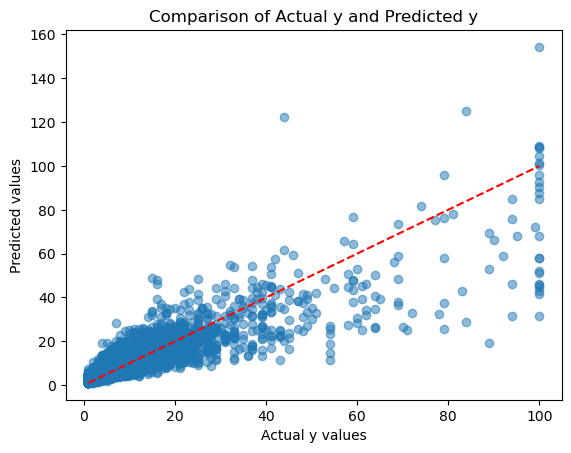

In [140]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred4*1.28, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

### Model 4.2: Stacking on lasso

In [152]:
from sklearn.linear_model import LassoCV

In [153]:
#Stacking using Lasso as the meta-model
enla=StackingRegressor(estimators = [('cat',cat_model2),('bagged mars',bagged_mars)],
                     final_estimator=LassoCV(),                           
                    cv = KFold(n_splits = 5, shuffle = True, random_state=1))
enla.fit(X_train_filtered,y_train)
enla.final_estimator_.coef_

Learning rate set to 0.053413
0:	learn: 0.9820409	total: 17ms	remaining: 17s
1:	learn: 0.9667420	total: 22.2ms	remaining: 11.1s
2:	learn: 0.9532215	total: 27.7ms	remaining: 9.2s
3:	learn: 0.9387539	total: 32.9ms	remaining: 8.2s
4:	learn: 0.9271897	total: 38.3ms	remaining: 7.62s
5:	learn: 0.9153879	total: 43.6ms	remaining: 7.22s
6:	learn: 0.9045132	total: 49.2ms	remaining: 6.98s
7:	learn: 0.8940071	total: 55.3ms	remaining: 6.86s
8:	learn: 0.8842068	total: 60.4ms	remaining: 6.65s
9:	learn: 0.8755379	total: 65.8ms	remaining: 6.52s
10:	learn: 0.8676020	total: 71.2ms	remaining: 6.4s
11:	learn: 0.8595944	total: 76.6ms	remaining: 6.31s
12:	learn: 0.8519956	total: 82.5ms	remaining: 6.27s
13:	learn: 0.8447170	total: 87.6ms	remaining: 6.17s
14:	learn: 0.8390308	total: 93.1ms	remaining: 6.11s
15:	learn: 0.8330145	total: 99.4ms	remaining: 6.11s
16:	learn: 0.8275985	total: 105ms	remaining: 6.1s
17:	learn: 0.8223391	total: 112ms	remaining: 6.11s
18:	learn: 0.8181522	total: 119ms	remaining: 6.13s
19:

172:	learn: 0.6243907	total: 977ms	remaining: 4.67s
173:	learn: 0.6238648	total: 984ms	remaining: 4.67s
174:	learn: 0.6232229	total: 989ms	remaining: 4.66s
175:	learn: 0.6227561	total: 995ms	remaining: 4.66s
176:	learn: 0.6220758	total: 1000ms	remaining: 4.65s
177:	learn: 0.6215888	total: 1s	remaining: 4.64s
178:	learn: 0.6210636	total: 1.01s	remaining: 4.63s
179:	learn: 0.6204341	total: 1.01s	remaining: 4.63s
180:	learn: 0.6196226	total: 1.02s	remaining: 4.62s
181:	learn: 0.6190451	total: 1.03s	remaining: 4.61s
182:	learn: 0.6181340	total: 1.03s	remaining: 4.6s
183:	learn: 0.6175681	total: 1.03s	remaining: 4.59s
184:	learn: 0.6166894	total: 1.04s	remaining: 4.59s
185:	learn: 0.6162163	total: 1.05s	remaining: 4.58s
186:	learn: 0.6155870	total: 1.05s	remaining: 4.58s
187:	learn: 0.6151488	total: 1.06s	remaining: 4.59s
188:	learn: 0.6146435	total: 1.07s	remaining: 4.58s
189:	learn: 0.6141505	total: 1.07s	remaining: 4.57s
190:	learn: 0.6134692	total: 1.08s	remaining: 4.57s
191:	learn: 0.6

357:	learn: 0.5178199	total: 1.98s	remaining: 3.55s
358:	learn: 0.5173881	total: 1.98s	remaining: 3.54s
359:	learn: 0.5169894	total: 1.99s	remaining: 3.54s
360:	learn: 0.5166337	total: 2s	remaining: 3.53s
361:	learn: 0.5161204	total: 2s	remaining: 3.52s
362:	learn: 0.5157881	total: 2s	remaining: 3.52s
363:	learn: 0.5153699	total: 2.01s	remaining: 3.51s
364:	learn: 0.5149643	total: 2.02s	remaining: 3.51s
365:	learn: 0.5145801	total: 2.02s	remaining: 3.5s
366:	learn: 0.5139922	total: 2.02s	remaining: 3.49s
367:	learn: 0.5136337	total: 2.03s	remaining: 3.49s
368:	learn: 0.5130223	total: 2.04s	remaining: 3.48s
369:	learn: 0.5125531	total: 2.04s	remaining: 3.48s
370:	learn: 0.5121410	total: 2.05s	remaining: 3.47s
371:	learn: 0.5117027	total: 2.05s	remaining: 3.46s
372:	learn: 0.5109930	total: 2.06s	remaining: 3.46s
373:	learn: 0.5107347	total: 2.06s	remaining: 3.45s
374:	learn: 0.5103583	total: 2.07s	remaining: 3.44s
375:	learn: 0.5099652	total: 2.07s	remaining: 3.44s
376:	learn: 0.5096103	

543:	learn: 0.4392194	total: 2.96s	remaining: 2.48s
544:	learn: 0.4388342	total: 2.96s	remaining: 2.48s
545:	learn: 0.4384337	total: 2.97s	remaining: 2.47s
546:	learn: 0.4379936	total: 2.98s	remaining: 2.46s
547:	learn: 0.4376365	total: 2.98s	remaining: 2.46s
548:	learn: 0.4371649	total: 2.99s	remaining: 2.45s
549:	learn: 0.4367616	total: 2.99s	remaining: 2.45s
550:	learn: 0.4364324	total: 3s	remaining: 2.44s
551:	learn: 0.4363774	total: 3s	remaining: 2.44s
552:	learn: 0.4360510	total: 3.01s	remaining: 2.43s
553:	learn: 0.4358717	total: 3.01s	remaining: 2.42s
554:	learn: 0.4355957	total: 3.02s	remaining: 2.42s
555:	learn: 0.4352000	total: 3.02s	remaining: 2.41s
556:	learn: 0.4347068	total: 3.03s	remaining: 2.41s
557:	learn: 0.4341794	total: 3.03s	remaining: 2.4s
558:	learn: 0.4336110	total: 3.04s	remaining: 2.4s
559:	learn: 0.4332157	total: 3.04s	remaining: 2.39s
560:	learn: 0.4329004	total: 3.05s	remaining: 2.39s
561:	learn: 0.4324742	total: 3.06s	remaining: 2.38s
562:	learn: 0.431930

733:	learn: 0.3744707	total: 3.95s	remaining: 1.43s
734:	learn: 0.3742359	total: 3.96s	remaining: 1.43s
735:	learn: 0.3737859	total: 3.96s	remaining: 1.42s
736:	learn: 0.3734736	total: 3.97s	remaining: 1.42s
737:	learn: 0.3730521	total: 3.97s	remaining: 1.41s
738:	learn: 0.3727177	total: 3.98s	remaining: 1.4s
739:	learn: 0.3723813	total: 3.98s	remaining: 1.4s
740:	learn: 0.3720975	total: 3.99s	remaining: 1.39s
741:	learn: 0.3718341	total: 3.99s	remaining: 1.39s
742:	learn: 0.3714430	total: 4s	remaining: 1.38s
743:	learn: 0.3712150	total: 4s	remaining: 1.38s
744:	learn: 0.3709118	total: 4.01s	remaining: 1.37s
745:	learn: 0.3706991	total: 4.01s	remaining: 1.37s
746:	learn: 0.3703909	total: 4.02s	remaining: 1.36s
747:	learn: 0.3701987	total: 4.02s	remaining: 1.35s
748:	learn: 0.3698503	total: 4.03s	remaining: 1.35s
749:	learn: 0.3694389	total: 4.03s	remaining: 1.34s
750:	learn: 0.3690727	total: 4.04s	remaining: 1.34s
751:	learn: 0.3687509	total: 4.04s	remaining: 1.33s
752:	learn: 0.368387

921:	learn: 0.3217922	total: 4.94s	remaining: 418ms
922:	learn: 0.3213398	total: 4.95s	remaining: 413ms
923:	learn: 0.3211293	total: 4.95s	remaining: 407ms
924:	learn: 0.3209210	total: 4.96s	remaining: 402ms
925:	learn: 0.3206861	total: 4.96s	remaining: 397ms
926:	learn: 0.3204699	total: 4.97s	remaining: 391ms
927:	learn: 0.3201643	total: 4.97s	remaining: 386ms
928:	learn: 0.3199662	total: 4.98s	remaining: 381ms
929:	learn: 0.3196802	total: 4.99s	remaining: 375ms
930:	learn: 0.3193187	total: 4.99s	remaining: 370ms
931:	learn: 0.3190463	total: 5s	remaining: 365ms
932:	learn: 0.3187392	total: 5s	remaining: 359ms
933:	learn: 0.3187263	total: 5s	remaining: 354ms
934:	learn: 0.3186798	total: 5.01s	remaining: 348ms
935:	learn: 0.3185728	total: 5.01s	remaining: 343ms
936:	learn: 0.3183446	total: 5.02s	remaining: 338ms
937:	learn: 0.3181215	total: 5.03s	remaining: 332ms
938:	learn: 0.3178781	total: 5.03s	remaining: 327ms
939:	learn: 0.3176041	total: 5.04s	remaining: 321ms
940:	learn: 0.3173192

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannah

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

Learning rate set to 0.051562
0:	learn: 0.9791521	total: 13.5ms	remaining: 13.4s
1:	learn: 0.9644000	total: 23.1ms	remaining: 11.5s
2:	learn: 0.9502207	total: 30.6ms	remaining: 10.2s
3:	learn: 0.9369520	total: 37.1ms	remaining: 9.24s
4:	learn: 0.9258126	total: 43.1ms	remaining: 8.57s
5:	learn: 0.9144101	total: 49.7ms	remaining: 8.23s
6:	learn: 0.9042599	total: 55.6ms	remaining: 7.89s
7:	learn: 0.8943928	total: 62.5ms	remaining: 7.75s
8:	learn: 0.8858284	total: 70.1ms	remaining: 7.71s
9:	learn: 0.8768795	total: 77.1ms	remaining: 7.63s
10:	learn: 0.8692752	total: 85.2ms	remaining: 7.66s
11:	learn: 0.8613165	total: 91.3ms	remaining: 7.52s
12:	learn: 0.8538625	total: 98.1ms	remaining: 7.45s
13:	learn: 0.8464121	total: 108ms	remaining: 7.58s
14:	learn: 0.8401378	total: 128ms	remaining: 8.37s
15:	learn: 0.8343630	total: 141ms	remaining: 8.69s
16:	learn: 0.8284510	total: 147ms	remaining: 8.53s
17:	learn: 0.8231826	total: 154ms	remaining: 8.38s
18:	learn: 0.8189884	total: 159ms	remaining: 8.23

163:	learn: 0.6279502	total: 1.19s	remaining: 6.07s
164:	learn: 0.6273127	total: 1.2s	remaining: 6.05s
165:	learn: 0.6265991	total: 1.2s	remaining: 6.03s
166:	learn: 0.6258713	total: 1.21s	remaining: 6.02s
167:	learn: 0.6251433	total: 1.21s	remaining: 6s
168:	learn: 0.6245880	total: 1.22s	remaining: 5.99s
169:	learn: 0.6239321	total: 1.22s	remaining: 5.98s
170:	learn: 0.6232352	total: 1.23s	remaining: 5.96s
171:	learn: 0.6227577	total: 1.24s	remaining: 5.95s
172:	learn: 0.6222301	total: 1.24s	remaining: 5.93s
173:	learn: 0.6218285	total: 1.25s	remaining: 5.92s
174:	learn: 0.6213624	total: 1.25s	remaining: 5.91s
175:	learn: 0.6206646	total: 1.26s	remaining: 5.9s
176:	learn: 0.6199154	total: 1.26s	remaining: 5.88s
177:	learn: 0.6193739	total: 1.27s	remaining: 5.87s
178:	learn: 0.6183244	total: 1.28s	remaining: 5.86s
179:	learn: 0.6176572	total: 1.28s	remaining: 5.85s
180:	learn: 0.6170574	total: 1.29s	remaining: 5.84s
181:	learn: 0.6160961	total: 1.3s	remaining: 5.83s
182:	learn: 0.61547

330:	learn: 0.5199365	total: 2.18s	remaining: 4.41s
331:	learn: 0.5193738	total: 2.19s	remaining: 4.4s
332:	learn: 0.5187549	total: 2.19s	remaining: 4.39s
333:	learn: 0.5180818	total: 2.2s	remaining: 4.38s
334:	learn: 0.5175324	total: 2.2s	remaining: 4.38s
335:	learn: 0.5170935	total: 2.21s	remaining: 4.37s
336:	learn: 0.5163233	total: 2.22s	remaining: 4.36s
337:	learn: 0.5157604	total: 2.22s	remaining: 4.35s
338:	learn: 0.5152588	total: 2.23s	remaining: 4.34s
339:	learn: 0.5145414	total: 2.23s	remaining: 4.33s
340:	learn: 0.5139250	total: 2.24s	remaining: 4.33s
341:	learn: 0.5137204	total: 2.24s	remaining: 4.32s
342:	learn: 0.5130902	total: 2.25s	remaining: 4.31s
343:	learn: 0.5125182	total: 2.25s	remaining: 4.3s
344:	learn: 0.5121057	total: 2.27s	remaining: 4.3s
345:	learn: 0.5115621	total: 2.27s	remaining: 4.29s
346:	learn: 0.5110873	total: 2.28s	remaining: 4.29s
347:	learn: 0.5106254	total: 2.29s	remaining: 4.29s
348:	learn: 0.5099309	total: 2.3s	remaining: 4.29s
349:	learn: 0.5093

523:	learn: 0.4272528	total: 3.37s	remaining: 3.06s
524:	learn: 0.4269077	total: 3.38s	remaining: 3.05s
525:	learn: 0.4265919	total: 3.38s	remaining: 3.05s
526:	learn: 0.4261110	total: 3.39s	remaining: 3.04s
527:	learn: 0.4255735	total: 3.39s	remaining: 3.03s
528:	learn: 0.4249976	total: 3.4s	remaining: 3.03s
529:	learn: 0.4245604	total: 3.4s	remaining: 3.02s
530:	learn: 0.4241148	total: 3.41s	remaining: 3.01s
531:	learn: 0.4235494	total: 3.42s	remaining: 3s
532:	learn: 0.4229100	total: 3.42s	remaining: 3s
533:	learn: 0.4225590	total: 3.43s	remaining: 2.99s
534:	learn: 0.4221019	total: 3.44s	remaining: 2.99s
535:	learn: 0.4220428	total: 3.44s	remaining: 2.98s
536:	learn: 0.4216726	total: 3.45s	remaining: 2.98s
537:	learn: 0.4212424	total: 3.46s	remaining: 2.97s
538:	learn: 0.4208775	total: 3.46s	remaining: 2.96s
539:	learn: 0.4204525	total: 3.47s	remaining: 2.95s
540:	learn: 0.4200703	total: 3.47s	remaining: 2.95s
541:	learn: 0.4197617	total: 3.48s	remaining: 2.94s
542:	learn: 0.419320

690:	learn: 0.3667051	total: 4.36s	remaining: 1.95s
691:	learn: 0.3664227	total: 4.37s	remaining: 1.94s
692:	learn: 0.3661792	total: 4.38s	remaining: 1.94s
693:	learn: 0.3657541	total: 4.38s	remaining: 1.93s
694:	learn: 0.3653735	total: 4.39s	remaining: 1.93s
695:	learn: 0.3648239	total: 4.39s	remaining: 1.92s
696:	learn: 0.3643077	total: 4.4s	remaining: 1.91s
697:	learn: 0.3639439	total: 4.4s	remaining: 1.91s
698:	learn: 0.3635488	total: 4.41s	remaining: 1.9s
699:	learn: 0.3631280	total: 4.42s	remaining: 1.89s
700:	learn: 0.3626673	total: 4.42s	remaining: 1.89s
701:	learn: 0.3623361	total: 4.43s	remaining: 1.88s
702:	learn: 0.3618500	total: 4.43s	remaining: 1.87s
703:	learn: 0.3614239	total: 4.44s	remaining: 1.86s
704:	learn: 0.3610785	total: 4.44s	remaining: 1.86s
705:	learn: 0.3607969	total: 4.45s	remaining: 1.85s
706:	learn: 0.3607112	total: 4.45s	remaining: 1.84s
707:	learn: 0.3603341	total: 4.46s	remaining: 1.84s
708:	learn: 0.3598559	total: 4.46s	remaining: 1.83s
709:	learn: 0.3

860:	learn: 0.3108774	total: 5.35s	remaining: 864ms
861:	learn: 0.3104856	total: 5.36s	remaining: 858ms
862:	learn: 0.3102962	total: 5.36s	remaining: 851ms
863:	learn: 0.3100454	total: 5.37s	remaining: 845ms
864:	learn: 0.3098844	total: 5.38s	remaining: 839ms
865:	learn: 0.3094843	total: 5.38s	remaining: 833ms
866:	learn: 0.3090959	total: 5.39s	remaining: 826ms
867:	learn: 0.3088686	total: 5.39s	remaining: 820ms
868:	learn: 0.3085578	total: 5.4s	remaining: 814ms
869:	learn: 0.3082333	total: 5.4s	remaining: 807ms
870:	learn: 0.3079282	total: 5.41s	remaining: 801ms
871:	learn: 0.3074798	total: 5.41s	remaining: 795ms
872:	learn: 0.3071859	total: 5.42s	remaining: 788ms
873:	learn: 0.3069212	total: 5.42s	remaining: 782ms
874:	learn: 0.3065505	total: 5.43s	remaining: 776ms
875:	learn: 0.3063086	total: 5.44s	remaining: 770ms
876:	learn: 0.3060330	total: 5.44s	remaining: 763ms
877:	learn: 0.3057781	total: 5.45s	remaining: 757ms
878:	learn: 0.3054294	total: 5.45s	remaining: 751ms
879:	learn: 0.

47:	learn: 0.7346922	total: 310ms	remaining: 6.14s
48:	learn: 0.7331649	total: 316ms	remaining: 6.12s
49:	learn: 0.7315478	total: 321ms	remaining: 6.1s
50:	learn: 0.7300236	total: 327ms	remaining: 6.08s
51:	learn: 0.7279821	total: 334ms	remaining: 6.08s
52:	learn: 0.7263133	total: 339ms	remaining: 6.06s
53:	learn: 0.7241948	total: 346ms	remaining: 6.06s
54:	learn: 0.7223650	total: 353ms	remaining: 6.06s
55:	learn: 0.7208251	total: 358ms	remaining: 6.04s
56:	learn: 0.7191708	total: 365ms	remaining: 6.03s
57:	learn: 0.7179063	total: 370ms	remaining: 6.01s
58:	learn: 0.7164505	total: 376ms	remaining: 6s
59:	learn: 0.7150296	total: 382ms	remaining: 5.99s
60:	learn: 0.7136366	total: 388ms	remaining: 5.98s
61:	learn: 0.7121603	total: 394ms	remaining: 5.96s
62:	learn: 0.7107895	total: 400ms	remaining: 5.95s
63:	learn: 0.7095751	total: 406ms	remaining: 5.94s
64:	learn: 0.7082012	total: 412ms	remaining: 5.92s
65:	learn: 0.7070709	total: 417ms	remaining: 5.91s
66:	learn: 0.7055936	total: 423ms	r

212:	learn: 0.5909093	total: 1.31s	remaining: 4.83s
213:	learn: 0.5901892	total: 1.31s	remaining: 4.82s
214:	learn: 0.5894428	total: 1.32s	remaining: 4.81s
215:	learn: 0.5887613	total: 1.32s	remaining: 4.8s
216:	learn: 0.5880863	total: 1.33s	remaining: 4.8s
217:	learn: 0.5873167	total: 1.34s	remaining: 4.79s
218:	learn: 0.5866945	total: 1.34s	remaining: 4.79s
219:	learn: 0.5857210	total: 1.35s	remaining: 4.78s
220:	learn: 0.5851408	total: 1.35s	remaining: 4.77s
221:	learn: 0.5844353	total: 1.36s	remaining: 4.76s
222:	learn: 0.5835899	total: 1.36s	remaining: 4.75s
223:	learn: 0.5826870	total: 1.37s	remaining: 4.75s
224:	learn: 0.5818693	total: 1.38s	remaining: 4.74s
225:	learn: 0.5812226	total: 1.38s	remaining: 4.73s
226:	learn: 0.5801441	total: 1.39s	remaining: 4.72s
227:	learn: 0.5794567	total: 1.39s	remaining: 4.72s
228:	learn: 0.5788440	total: 1.4s	remaining: 4.71s
229:	learn: 0.5781620	total: 1.42s	remaining: 4.77s
230:	learn: 0.5774301	total: 1.43s	remaining: 4.76s
231:	learn: 0.5

383:	learn: 0.4842969	total: 2.3s	remaining: 3.69s
384:	learn: 0.4838451	total: 2.31s	remaining: 3.69s
385:	learn: 0.4833394	total: 2.32s	remaining: 3.69s
386:	learn: 0.4828141	total: 2.33s	remaining: 3.69s
387:	learn: 0.4824021	total: 2.33s	remaining: 3.68s
388:	learn: 0.4818654	total: 2.34s	remaining: 3.68s
389:	learn: 0.4814191	total: 2.37s	remaining: 3.7s
390:	learn: 0.4806898	total: 2.38s	remaining: 3.71s
391:	learn: 0.4801583	total: 2.4s	remaining: 3.73s
392:	learn: 0.4796143	total: 2.42s	remaining: 3.73s
393:	learn: 0.4790398	total: 2.42s	remaining: 3.73s
394:	learn: 0.4785368	total: 2.43s	remaining: 3.72s
395:	learn: 0.4781309	total: 2.43s	remaining: 3.71s
396:	learn: 0.4777053	total: 2.44s	remaining: 3.71s
397:	learn: 0.4770793	total: 2.45s	remaining: 3.7s
398:	learn: 0.4764725	total: 2.45s	remaining: 3.69s
399:	learn: 0.4758318	total: 2.46s	remaining: 3.69s
400:	learn: 0.4753239	total: 2.46s	remaining: 3.68s
401:	learn: 0.4748549	total: 2.47s	remaining: 3.67s
402:	learn: 0.47

551:	learn: 0.4097555	total: 3.47s	remaining: 2.81s
552:	learn: 0.4093453	total: 3.47s	remaining: 2.81s
553:	learn: 0.4089475	total: 3.48s	remaining: 2.8s
554:	learn: 0.4086639	total: 3.48s	remaining: 2.79s
555:	learn: 0.4082672	total: 3.49s	remaining: 2.79s
556:	learn: 0.4078012	total: 3.5s	remaining: 2.78s
557:	learn: 0.4073620	total: 3.5s	remaining: 2.77s
558:	learn: 0.4071457	total: 3.51s	remaining: 2.77s
559:	learn: 0.4067375	total: 3.51s	remaining: 2.76s
560:	learn: 0.4061440	total: 3.52s	remaining: 2.75s
561:	learn: 0.4056148	total: 3.52s	remaining: 2.75s
562:	learn: 0.4050276	total: 3.53s	remaining: 2.74s
563:	learn: 0.4046467	total: 3.54s	remaining: 2.73s
564:	learn: 0.4042474	total: 3.55s	remaining: 2.73s
565:	learn: 0.4039350	total: 3.55s	remaining: 2.73s
566:	learn: 0.4035547	total: 3.56s	remaining: 2.72s
567:	learn: 0.4032496	total: 3.56s	remaining: 2.71s
568:	learn: 0.4026762	total: 3.57s	remaining: 2.71s
569:	learn: 0.4021236	total: 3.58s	remaining: 2.7s
570:	learn: 0.40

733:	learn: 0.3431986	total: 4.46s	remaining: 1.61s
734:	learn: 0.3429182	total: 4.46s	remaining: 1.61s
735:	learn: 0.3425150	total: 4.47s	remaining: 1.6s
736:	learn: 0.3421886	total: 4.47s	remaining: 1.6s
737:	learn: 0.3418421	total: 4.48s	remaining: 1.59s
738:	learn: 0.3414315	total: 4.48s	remaining: 1.58s
739:	learn: 0.3412056	total: 4.49s	remaining: 1.58s
740:	learn: 0.3409706	total: 4.49s	remaining: 1.57s
741:	learn: 0.3407231	total: 4.5s	remaining: 1.56s
742:	learn: 0.3404534	total: 4.51s	remaining: 1.56s
743:	learn: 0.3401375	total: 4.51s	remaining: 1.55s
744:	learn: 0.3398421	total: 4.52s	remaining: 1.55s
745:	learn: 0.3395065	total: 4.52s	remaining: 1.54s
746:	learn: 0.3391082	total: 4.53s	remaining: 1.53s
747:	learn: 0.3387544	total: 4.53s	remaining: 1.53s
748:	learn: 0.3384050	total: 4.54s	remaining: 1.52s
749:	learn: 0.3379838	total: 4.55s	remaining: 1.51s
750:	learn: 0.3377327	total: 4.55s	remaining: 1.51s
751:	learn: 0.3373091	total: 4.56s	remaining: 1.5s
752:	learn: 0.33

917:	learn: 0.2883528	total: 5.44s	remaining: 486ms
918:	learn: 0.2880713	total: 5.45s	remaining: 480ms
919:	learn: 0.2877350	total: 5.45s	remaining: 474ms
920:	learn: 0.2875028	total: 5.46s	remaining: 468ms
921:	learn: 0.2871652	total: 5.46s	remaining: 462ms
922:	learn: 0.2870088	total: 5.47s	remaining: 456ms
923:	learn: 0.2867102	total: 5.47s	remaining: 450ms
924:	learn: 0.2864231	total: 5.48s	remaining: 444ms
925:	learn: 0.2860200	total: 5.48s	remaining: 438ms
926:	learn: 0.2858207	total: 5.49s	remaining: 432ms
927:	learn: 0.2857967	total: 5.49s	remaining: 426ms
928:	learn: 0.2854734	total: 5.5s	remaining: 420ms
929:	learn: 0.2853539	total: 5.5s	remaining: 414ms
930:	learn: 0.2851598	total: 5.51s	remaining: 408ms
931:	learn: 0.2849329	total: 5.51s	remaining: 402ms
932:	learn: 0.2847275	total: 5.52s	remaining: 396ms
933:	learn: 0.2844592	total: 5.52s	remaining: 390ms
934:	learn: 0.2843805	total: 5.53s	remaining: 384ms
935:	learn: 0.2840347	total: 5.53s	remaining: 378ms
936:	learn: 0.

98:	learn: 0.6733261	total: 521ms	remaining: 4.74s
99:	learn: 0.6728627	total: 526ms	remaining: 4.73s
100:	learn: 0.6723401	total: 531ms	remaining: 4.72s
101:	learn: 0.6712624	total: 536ms	remaining: 4.72s
102:	learn: 0.6703197	total: 540ms	remaining: 4.71s
103:	learn: 0.6695614	total: 547ms	remaining: 4.71s
104:	learn: 0.6686088	total: 552ms	remaining: 4.71s
105:	learn: 0.6677731	total: 557ms	remaining: 4.7s
106:	learn: 0.6672596	total: 562ms	remaining: 4.69s
107:	learn: 0.6666931	total: 567ms	remaining: 4.68s
108:	learn: 0.6657677	total: 572ms	remaining: 4.67s
109:	learn: 0.6649964	total: 576ms	remaining: 4.66s
110:	learn: 0.6640856	total: 582ms	remaining: 4.66s
111:	learn: 0.6628873	total: 587ms	remaining: 4.65s
112:	learn: 0.6623796	total: 591ms	remaining: 4.64s
113:	learn: 0.6618198	total: 596ms	remaining: 4.63s
114:	learn: 0.6610324	total: 601ms	remaining: 4.62s
115:	learn: 0.6604725	total: 605ms	remaining: 4.61s
116:	learn: 0.6597813	total: 610ms	remaining: 4.6s
117:	learn: 0.65

280:	learn: 0.5465330	total: 1.51s	remaining: 3.87s
281:	learn: 0.5460991	total: 1.52s	remaining: 3.86s
282:	learn: 0.5452661	total: 1.52s	remaining: 3.85s
283:	learn: 0.5446447	total: 1.53s	remaining: 3.85s
284:	learn: 0.5440621	total: 1.53s	remaining: 3.85s
285:	learn: 0.5433128	total: 1.54s	remaining: 3.84s
286:	learn: 0.5427530	total: 1.54s	remaining: 3.84s
287:	learn: 0.5420670	total: 1.55s	remaining: 3.83s
288:	learn: 0.5415388	total: 1.55s	remaining: 3.83s
289:	learn: 0.5407613	total: 1.56s	remaining: 3.82s
290:	learn: 0.5404337	total: 1.57s	remaining: 3.82s
291:	learn: 0.5399175	total: 1.57s	remaining: 3.81s
292:	learn: 0.5392927	total: 1.57s	remaining: 3.8s
293:	learn: 0.5387296	total: 1.58s	remaining: 3.79s
294:	learn: 0.5382424	total: 1.58s	remaining: 3.79s
295:	learn: 0.5375711	total: 1.59s	remaining: 3.78s
296:	learn: 0.5371287	total: 1.59s	remaining: 3.77s
297:	learn: 0.5365982	total: 1.6s	remaining: 3.77s
298:	learn: 0.5357721	total: 1.6s	remaining: 3.76s
299:	learn: 0.5

477:	learn: 0.4459326	total: 2.5s	remaining: 2.73s
478:	learn: 0.4455829	total: 2.51s	remaining: 2.73s
479:	learn: 0.4450050	total: 2.51s	remaining: 2.72s
480:	learn: 0.4444398	total: 2.52s	remaining: 2.72s
481:	learn: 0.4438924	total: 2.52s	remaining: 2.71s
482:	learn: 0.4432933	total: 2.53s	remaining: 2.71s
483:	learn: 0.4429050	total: 2.53s	remaining: 2.7s
484:	learn: 0.4425815	total: 2.54s	remaining: 2.69s
485:	learn: 0.4422507	total: 2.54s	remaining: 2.69s
486:	learn: 0.4417553	total: 2.55s	remaining: 2.68s
487:	learn: 0.4413504	total: 2.55s	remaining: 2.68s
488:	learn: 0.4410966	total: 2.56s	remaining: 2.67s
489:	learn: 0.4409411	total: 2.56s	remaining: 2.67s
490:	learn: 0.4405717	total: 2.57s	remaining: 2.66s
491:	learn: 0.4401115	total: 2.57s	remaining: 2.65s
492:	learn: 0.4396266	total: 2.58s	remaining: 2.65s
493:	learn: 0.4393679	total: 2.58s	remaining: 2.64s
494:	learn: 0.4393187	total: 2.59s	remaining: 2.64s
495:	learn: 0.4388614	total: 2.6s	remaining: 2.64s
496:	learn: 0.4

662:	learn: 0.3750909	total: 3.49s	remaining: 1.77s
663:	learn: 0.3747580	total: 3.5s	remaining: 1.77s
664:	learn: 0.3745123	total: 3.5s	remaining: 1.76s
665:	learn: 0.3740121	total: 3.51s	remaining: 1.76s
666:	learn: 0.3737022	total: 3.51s	remaining: 1.75s
667:	learn: 0.3734374	total: 3.52s	remaining: 1.75s
668:	learn: 0.3729687	total: 3.52s	remaining: 1.74s
669:	learn: 0.3728534	total: 3.53s	remaining: 1.74s
670:	learn: 0.3725432	total: 3.54s	remaining: 1.73s
671:	learn: 0.3721054	total: 3.54s	remaining: 1.73s
672:	learn: 0.3715314	total: 3.55s	remaining: 1.72s
673:	learn: 0.3712640	total: 3.55s	remaining: 1.72s
674:	learn: 0.3708791	total: 3.56s	remaining: 1.71s
675:	learn: 0.3705522	total: 3.56s	remaining: 1.71s
676:	learn: 0.3702650	total: 3.57s	remaining: 1.7s
677:	learn: 0.3700162	total: 3.58s	remaining: 1.7s
678:	learn: 0.3694647	total: 3.58s	remaining: 1.69s
679:	learn: 0.3692025	total: 3.59s	remaining: 1.69s
680:	learn: 0.3688236	total: 3.59s	remaining: 1.68s
681:	learn: 0.36

837:	learn: 0.3207482	total: 4.48s	remaining: 867ms
838:	learn: 0.3204515	total: 4.49s	remaining: 862ms
839:	learn: 0.3200703	total: 4.49s	remaining: 856ms
840:	learn: 0.3197644	total: 4.5s	remaining: 851ms
841:	learn: 0.3195525	total: 4.51s	remaining: 846ms
842:	learn: 0.3192992	total: 4.51s	remaining: 840ms
843:	learn: 0.3190013	total: 4.52s	remaining: 835ms
844:	learn: 0.3188037	total: 4.52s	remaining: 830ms
845:	learn: 0.3185550	total: 4.53s	remaining: 825ms
846:	learn: 0.3182389	total: 4.53s	remaining: 819ms
847:	learn: 0.3178336	total: 4.54s	remaining: 814ms
848:	learn: 0.3175577	total: 4.54s	remaining: 808ms
849:	learn: 0.3172810	total: 4.55s	remaining: 803ms
850:	learn: 0.3170446	total: 4.55s	remaining: 798ms
851:	learn: 0.3167144	total: 4.56s	remaining: 792ms
852:	learn: 0.3165993	total: 4.57s	remaining: 787ms
853:	learn: 0.3163355	total: 4.57s	remaining: 782ms
854:	learn: 0.3161605	total: 4.58s	remaining: 776ms
855:	learn: 0.3157901	total: 4.58s	remaining: 771ms
856:	learn: 0

11:	learn: 0.8694559	total: 71.9ms	remaining: 5.92s
12:	learn: 0.8621457	total: 77.4ms	remaining: 5.88s
13:	learn: 0.8551086	total: 82.6ms	remaining: 5.82s
14:	learn: 0.8487559	total: 87.8ms	remaining: 5.76s
15:	learn: 0.8423787	total: 92.4ms	remaining: 5.68s
16:	learn: 0.8368214	total: 97.1ms	remaining: 5.61s
17:	learn: 0.8314196	total: 104ms	remaining: 5.65s
18:	learn: 0.8265352	total: 108ms	remaining: 5.6s
19:	learn: 0.8216989	total: 114ms	remaining: 5.56s
20:	learn: 0.8159926	total: 119ms	remaining: 5.55s
21:	learn: 0.8114715	total: 124ms	remaining: 5.52s
22:	learn: 0.8072379	total: 129ms	remaining: 5.47s
23:	learn: 0.8029699	total: 136ms	remaining: 5.53s
24:	learn: 0.7993982	total: 141ms	remaining: 5.5s
25:	learn: 0.7953919	total: 146ms	remaining: 5.47s
26:	learn: 0.7918773	total: 152ms	remaining: 5.47s
27:	learn: 0.7884138	total: 157ms	remaining: 5.45s
28:	learn: 0.7848468	total: 162ms	remaining: 5.43s
29:	learn: 0.7810830	total: 167ms	remaining: 5.4s
30:	learn: 0.7780958	total: 

199:	learn: 0.6016170	total: 1.06s	remaining: 4.25s
200:	learn: 0.6009542	total: 1.07s	remaining: 4.25s
201:	learn: 0.6000443	total: 1.07s	remaining: 4.24s
202:	learn: 0.5992498	total: 1.08s	remaining: 4.24s
203:	learn: 0.5984762	total: 1.09s	remaining: 4.24s
204:	learn: 0.5980367	total: 1.09s	remaining: 4.24s
205:	learn: 0.5972031	total: 1.1s	remaining: 4.23s
206:	learn: 0.5963157	total: 1.1s	remaining: 4.23s
207:	learn: 0.5956570	total: 1.11s	remaining: 4.22s
208:	learn: 0.5947733	total: 1.11s	remaining: 4.22s
209:	learn: 0.5940524	total: 1.12s	remaining: 4.21s
210:	learn: 0.5929429	total: 1.13s	remaining: 4.21s
211:	learn: 0.5922572	total: 1.13s	remaining: 4.21s
212:	learn: 0.5916795	total: 1.14s	remaining: 4.2s
213:	learn: 0.5909869	total: 1.14s	remaining: 4.2s
214:	learn: 0.5903349	total: 1.15s	remaining: 4.19s
215:	learn: 0.5896606	total: 1.15s	remaining: 4.19s
216:	learn: 0.5891023	total: 1.16s	remaining: 4.18s
217:	learn: 0.5885236	total: 1.16s	remaining: 4.17s
218:	learn: 0.58

395:	learn: 0.4817637	total: 2.05s	remaining: 3.13s
396:	learn: 0.4813304	total: 2.05s	remaining: 3.12s
397:	learn: 0.4808903	total: 2.06s	remaining: 3.12s
398:	learn: 0.4803794	total: 2.06s	remaining: 3.11s
399:	learn: 0.4798357	total: 2.07s	remaining: 3.1s
400:	learn: 0.4793554	total: 2.07s	remaining: 3.1s
401:	learn: 0.4787603	total: 2.08s	remaining: 3.09s
402:	learn: 0.4782091	total: 2.08s	remaining: 3.09s
403:	learn: 0.4777525	total: 2.09s	remaining: 3.08s
404:	learn: 0.4771282	total: 2.09s	remaining: 3.08s
405:	learn: 0.4767262	total: 2.1s	remaining: 3.07s
406:	learn: 0.4762635	total: 2.1s	remaining: 3.06s
407:	learn: 0.4757877	total: 2.11s	remaining: 3.06s
408:	learn: 0.4752832	total: 2.11s	remaining: 3.05s
409:	learn: 0.4747664	total: 2.12s	remaining: 3.05s
410:	learn: 0.4742504	total: 2.12s	remaining: 3.04s
411:	learn: 0.4736897	total: 2.13s	remaining: 3.04s
412:	learn: 0.4733392	total: 2.13s	remaining: 3.03s
413:	learn: 0.4728685	total: 2.14s	remaining: 3.03s
414:	learn: 0.47

557:	learn: 0.4107058	total: 2.84s	remaining: 2.25s
558:	learn: 0.4101946	total: 2.85s	remaining: 2.25s
559:	learn: 0.4098127	total: 2.85s	remaining: 2.24s
560:	learn: 0.4094726	total: 2.85s	remaining: 2.23s
561:	learn: 0.4089175	total: 2.86s	remaining: 2.23s
562:	learn: 0.4083517	total: 2.87s	remaining: 2.22s
563:	learn: 0.4078096	total: 2.87s	remaining: 2.22s
564:	learn: 0.4073433	total: 2.88s	remaining: 2.21s
565:	learn: 0.4069217	total: 2.88s	remaining: 2.21s
566:	learn: 0.4068824	total: 2.88s	remaining: 2.2s
567:	learn: 0.4064668	total: 2.89s	remaining: 2.2s
568:	learn: 0.4060613	total: 2.89s	remaining: 2.19s
569:	learn: 0.4060195	total: 2.9s	remaining: 2.19s
570:	learn: 0.4055197	total: 2.9s	remaining: 2.18s
571:	learn: 0.4049453	total: 2.91s	remaining: 2.18s
572:	learn: 0.4044786	total: 2.91s	remaining: 2.17s
573:	learn: 0.4040645	total: 2.92s	remaining: 2.17s
574:	learn: 0.4037276	total: 2.92s	remaining: 2.16s
575:	learn: 0.4034116	total: 2.93s	remaining: 2.16s
576:	learn: 0.40

717:	learn: 0.3538195	total: 3.63s	remaining: 1.42s
718:	learn: 0.3536505	total: 3.63s	remaining: 1.42s
719:	learn: 0.3533543	total: 3.64s	remaining: 1.41s
720:	learn: 0.3529520	total: 3.64s	remaining: 1.41s
721:	learn: 0.3527588	total: 3.65s	remaining: 1.4s
722:	learn: 0.3523910	total: 3.65s	remaining: 1.4s
723:	learn: 0.3520248	total: 3.65s	remaining: 1.39s
724:	learn: 0.3515507	total: 3.66s	remaining: 1.39s
725:	learn: 0.3512330	total: 3.67s	remaining: 1.38s
726:	learn: 0.3508126	total: 3.67s	remaining: 1.38s
727:	learn: 0.3504764	total: 3.67s	remaining: 1.37s
728:	learn: 0.3501798	total: 3.68s	remaining: 1.37s
729:	learn: 0.3498248	total: 3.68s	remaining: 1.36s
730:	learn: 0.3492796	total: 3.69s	remaining: 1.36s
731:	learn: 0.3489800	total: 3.69s	remaining: 1.35s
732:	learn: 0.3485876	total: 3.7s	remaining: 1.35s
733:	learn: 0.3481533	total: 3.7s	remaining: 1.34s
734:	learn: 0.3477557	total: 3.71s	remaining: 1.34s
735:	learn: 0.3475347	total: 3.71s	remaining: 1.33s
736:	learn: 0.34

878:	learn: 0.3013784	total: 4.42s	remaining: 608ms
879:	learn: 0.3011078	total: 4.42s	remaining: 603ms
880:	learn: 0.3008522	total: 4.43s	remaining: 598ms
881:	learn: 0.3004662	total: 4.43s	remaining: 593ms
882:	learn: 0.3002576	total: 4.44s	remaining: 588ms
883:	learn: 0.3000232	total: 4.44s	remaining: 583ms
884:	learn: 0.2997252	total: 4.45s	remaining: 578ms
885:	learn: 0.2993310	total: 4.45s	remaining: 573ms
886:	learn: 0.2989745	total: 4.46s	remaining: 568ms
887:	learn: 0.2987936	total: 4.46s	remaining: 563ms
888:	learn: 0.2983882	total: 4.47s	remaining: 558ms
889:	learn: 0.2980584	total: 4.47s	remaining: 553ms
890:	learn: 0.2978565	total: 4.48s	remaining: 548ms
891:	learn: 0.2976469	total: 4.48s	remaining: 543ms
892:	learn: 0.2971862	total: 4.49s	remaining: 538ms
893:	learn: 0.2969915	total: 4.49s	remaining: 533ms
894:	learn: 0.2965337	total: 4.5s	remaining: 527ms
895:	learn: 0.2961728	total: 4.5s	remaining: 522ms
896:	learn: 0.2958788	total: 4.5s	remaining: 517ms
897:	learn: 0.2

71:	learn: 0.6962838	total: 359ms	remaining: 4.63s
72:	learn: 0.6950787	total: 364ms	remaining: 4.62s
73:	learn: 0.6939538	total: 368ms	remaining: 4.61s
74:	learn: 0.6922266	total: 374ms	remaining: 4.61s
75:	learn: 0.6911588	total: 379ms	remaining: 4.61s
76:	learn: 0.6901904	total: 384ms	remaining: 4.6s
77:	learn: 0.6893772	total: 389ms	remaining: 4.59s
78:	learn: 0.6877359	total: 393ms	remaining: 4.59s
79:	learn: 0.6864793	total: 398ms	remaining: 4.58s
80:	learn: 0.6854728	total: 403ms	remaining: 4.57s
81:	learn: 0.6844197	total: 408ms	remaining: 4.57s
82:	learn: 0.6836736	total: 413ms	remaining: 4.56s
83:	learn: 0.6829715	total: 418ms	remaining: 4.55s
84:	learn: 0.6821999	total: 422ms	remaining: 4.54s
85:	learn: 0.6809757	total: 427ms	remaining: 4.54s
86:	learn: 0.6798609	total: 432ms	remaining: 4.53s
87:	learn: 0.6789172	total: 437ms	remaining: 4.53s
88:	learn: 0.6781145	total: 442ms	remaining: 4.52s
89:	learn: 0.6771789	total: 447ms	remaining: 4.52s
90:	learn: 0.6764383	total: 452m

232:	learn: 0.5745972	total: 1.14s	remaining: 3.77s
233:	learn: 0.5737865	total: 1.15s	remaining: 3.76s
234:	learn: 0.5731604	total: 1.15s	remaining: 3.76s
235:	learn: 0.5724529	total: 1.16s	remaining: 3.75s
236:	learn: 0.5720961	total: 1.16s	remaining: 3.75s
237:	learn: 0.5712888	total: 1.17s	remaining: 3.74s
238:	learn: 0.5705778	total: 1.17s	remaining: 3.74s
239:	learn: 0.5698641	total: 1.18s	remaining: 3.73s
240:	learn: 0.5692263	total: 1.18s	remaining: 3.73s
241:	learn: 0.5688231	total: 1.19s	remaining: 3.72s
242:	learn: 0.5682555	total: 1.19s	remaining: 3.71s
243:	learn: 0.5673822	total: 1.2s	remaining: 3.71s
244:	learn: 0.5667236	total: 1.2s	remaining: 3.71s
245:	learn: 0.5659801	total: 1.21s	remaining: 3.7s
246:	learn: 0.5651011	total: 1.21s	remaining: 3.69s
247:	learn: 0.5643438	total: 1.22s	remaining: 3.69s
248:	learn: 0.5639362	total: 1.22s	remaining: 3.68s
249:	learn: 0.5633457	total: 1.23s	remaining: 3.68s
250:	learn: 0.5627840	total: 1.23s	remaining: 3.67s
251:	learn: 0.5

392:	learn: 0.4815366	total: 1.93s	remaining: 2.98s
393:	learn: 0.4811821	total: 1.94s	remaining: 2.98s
394:	learn: 0.4808421	total: 1.94s	remaining: 2.97s
395:	learn: 0.4802594	total: 1.95s	remaining: 2.97s
396:	learn: 0.4799399	total: 1.95s	remaining: 2.96s
397:	learn: 0.4794559	total: 1.96s	remaining: 2.96s
398:	learn: 0.4787700	total: 1.96s	remaining: 2.96s
399:	learn: 0.4779233	total: 1.97s	remaining: 2.95s
400:	learn: 0.4772879	total: 1.97s	remaining: 2.94s
401:	learn: 0.4771517	total: 1.98s	remaining: 2.94s
402:	learn: 0.4766939	total: 1.98s	remaining: 2.94s
403:	learn: 0.4763086	total: 1.99s	remaining: 2.93s
404:	learn: 0.4758395	total: 1.99s	remaining: 2.92s
405:	learn: 0.4754425	total: 2s	remaining: 2.92s
406:	learn: 0.4747501	total: 2s	remaining: 2.92s
407:	learn: 0.4740966	total: 2s	remaining: 2.91s
408:	learn: 0.4736534	total: 2.01s	remaining: 2.9s
409:	learn: 0.4734655	total: 2.01s	remaining: 2.9s
410:	learn: 0.4730225	total: 2.02s	remaining: 2.89s
411:	learn: 0.4724267	t

553:	learn: 0.4119842	total: 2.72s	remaining: 2.19s
554:	learn: 0.4114390	total: 2.73s	remaining: 2.19s
555:	learn: 0.4111276	total: 2.73s	remaining: 2.18s
556:	learn: 0.4108678	total: 2.74s	remaining: 2.18s
557:	learn: 0.4103480	total: 2.74s	remaining: 2.17s
558:	learn: 0.4100538	total: 2.75s	remaining: 2.17s
559:	learn: 0.4097125	total: 2.75s	remaining: 2.16s
560:	learn: 0.4092922	total: 2.76s	remaining: 2.16s
561:	learn: 0.4088343	total: 2.76s	remaining: 2.15s
562:	learn: 0.4082927	total: 2.77s	remaining: 2.15s
563:	learn: 0.4079080	total: 2.77s	remaining: 2.14s
564:	learn: 0.4074768	total: 2.78s	remaining: 2.14s
565:	learn: 0.4069706	total: 2.78s	remaining: 2.13s
566:	learn: 0.4064122	total: 2.79s	remaining: 2.13s
567:	learn: 0.4060621	total: 2.79s	remaining: 2.12s
568:	learn: 0.4055535	total: 2.79s	remaining: 2.12s
569:	learn: 0.4050126	total: 2.8s	remaining: 2.11s
570:	learn: 0.4046351	total: 2.8s	remaining: 2.11s
571:	learn: 0.4043025	total: 2.81s	remaining: 2.1s
572:	learn: 0.4

715:	learn: 0.3519835	total: 3.51s	remaining: 1.39s
716:	learn: 0.3516883	total: 3.52s	remaining: 1.39s
717:	learn: 0.3513274	total: 3.52s	remaining: 1.38s
718:	learn: 0.3510714	total: 3.53s	remaining: 1.38s
719:	learn: 0.3506052	total: 3.53s	remaining: 1.37s
720:	learn: 0.3505391	total: 3.54s	remaining: 1.37s
721:	learn: 0.3502064	total: 3.54s	remaining: 1.36s
722:	learn: 0.3499954	total: 3.55s	remaining: 1.36s
723:	learn: 0.3496863	total: 3.55s	remaining: 1.35s
724:	learn: 0.3491869	total: 3.56s	remaining: 1.35s
725:	learn: 0.3490477	total: 3.56s	remaining: 1.34s
726:	learn: 0.3486559	total: 3.56s	remaining: 1.34s
727:	learn: 0.3483781	total: 3.57s	remaining: 1.33s
728:	learn: 0.3479620	total: 3.58s	remaining: 1.33s
729:	learn: 0.3475038	total: 3.58s	remaining: 1.32s
730:	learn: 0.3470279	total: 3.58s	remaining: 1.32s
731:	learn: 0.3466619	total: 3.59s	remaining: 1.31s
732:	learn: 0.3463689	total: 3.6s	remaining: 1.31s
733:	learn: 0.3459068	total: 3.6s	remaining: 1.3s
734:	learn: 0.3

874:	learn: 0.3045578	total: 4.3s	remaining: 615ms
875:	learn: 0.3044201	total: 4.31s	remaining: 610ms
876:	learn: 0.3041979	total: 4.31s	remaining: 605ms
877:	learn: 0.3037336	total: 4.32s	remaining: 600ms
878:	learn: 0.3035162	total: 4.32s	remaining: 595ms
879:	learn: 0.3031529	total: 4.33s	remaining: 590ms
880:	learn: 0.3029228	total: 4.33s	remaining: 585ms
881:	learn: 0.3026302	total: 4.34s	remaining: 580ms
882:	learn: 0.3023794	total: 4.34s	remaining: 575ms
883:	learn: 0.3022082	total: 4.35s	remaining: 571ms
884:	learn: 0.3019831	total: 4.35s	remaining: 566ms
885:	learn: 0.3018836	total: 4.36s	remaining: 561ms
886:	learn: 0.3016362	total: 4.36s	remaining: 556ms
887:	learn: 0.3014950	total: 4.37s	remaining: 551ms
888:	learn: 0.3012726	total: 4.37s	remaining: 546ms
889:	learn: 0.3010854	total: 4.38s	remaining: 541ms
890:	learn: 0.3008112	total: 4.38s	remaining: 536ms
891:	learn: 0.3006540	total: 4.39s	remaining: 531ms
892:	learn: 0.3003534	total: 4.39s	remaining: 526ms
893:	learn: 0

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, 

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` i

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

array([0.5537127 , 0.52306584])

In [156]:
y_pred = enla.predict(X_train_filtered)
y_pred = np.exp(y_pred)  # Transform y_pred back to the original scale

rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred))

In [157]:
rmse

6.712410161140164

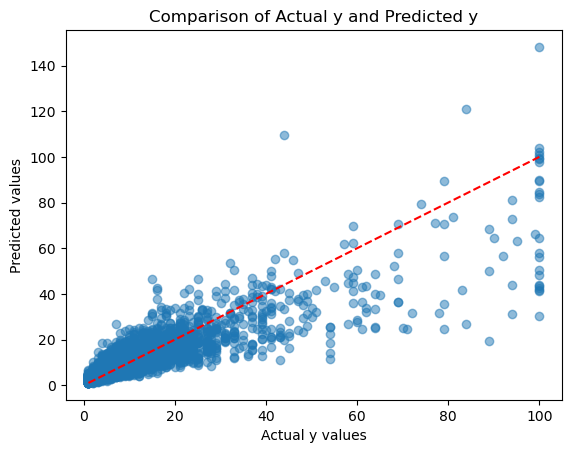

In [159]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred*1.25, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

In [173]:
pred = enla.predict(X_test_filtered)
pred = np.exp(pred)
pred *= 1.25 #the model underestimates y
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": pred})
output.to_csv("submissions_stacking_lasso.csv", index=False, header=True)

### Model 4.2: Stacking on MARS 
lasso doesn't seem to improve

In [165]:
#Stacking using mars as the meta-model
enma=StackingRegressor(estimators = [('cat',cat_model2),('bagged mars',bagged_mars)],
                     final_estimator=Earth(max_degree=1),                           
                    cv = KFold(n_splits = 5, shuffle = True, random_state=1))
enma.fit(X_train_filtered,y_train)
enma.final_estimator_.coef_

Learning rate set to 0.053413
0:	learn: 0.9820409	total: 14.6ms	remaining: 14.5s
1:	learn: 0.9667420	total: 19.5ms	remaining: 9.75s
2:	learn: 0.9532215	total: 25.4ms	remaining: 8.43s
3:	learn: 0.9387539	total: 30.9ms	remaining: 7.7s
4:	learn: 0.9271897	total: 36.5ms	remaining: 7.26s
5:	learn: 0.9153879	total: 42.4ms	remaining: 7.03s
6:	learn: 0.9045132	total: 47.2ms	remaining: 6.7s
7:	learn: 0.8940071	total: 52.2ms	remaining: 6.47s
8:	learn: 0.8842068	total: 57.4ms	remaining: 6.32s
9:	learn: 0.8755379	total: 62.2ms	remaining: 6.16s
10:	learn: 0.8676020	total: 67.5ms	remaining: 6.07s
11:	learn: 0.8595944	total: 72.7ms	remaining: 5.99s
12:	learn: 0.8519956	total: 77.5ms	remaining: 5.88s
13:	learn: 0.8447170	total: 82.8ms	remaining: 5.83s
14:	learn: 0.8390308	total: 88.1ms	remaining: 5.78s
15:	learn: 0.8330145	total: 94.1ms	remaining: 5.79s
16:	learn: 0.8275985	total: 99.4ms	remaining: 5.75s
17:	learn: 0.8223391	total: 104ms	remaining: 5.7s
18:	learn: 0.8181522	total: 109ms	remaining: 5.6

173:	learn: 0.6238648	total: 987ms	remaining: 4.68s
174:	learn: 0.6232229	total: 992ms	remaining: 4.68s
175:	learn: 0.6227561	total: 999ms	remaining: 4.68s
176:	learn: 0.6220758	total: 1s	remaining: 4.67s
177:	learn: 0.6215888	total: 1.01s	remaining: 4.67s
178:	learn: 0.6210636	total: 1.01s	remaining: 4.66s
179:	learn: 0.6204341	total: 1.02s	remaining: 4.65s
180:	learn: 0.6196226	total: 1.03s	remaining: 4.65s
181:	learn: 0.6190451	total: 1.03s	remaining: 4.64s
182:	learn: 0.6181340	total: 1.04s	remaining: 4.63s
183:	learn: 0.6175681	total: 1.04s	remaining: 4.63s
184:	learn: 0.6166894	total: 1.05s	remaining: 4.62s
185:	learn: 0.6162163	total: 1.05s	remaining: 4.61s
186:	learn: 0.6155870	total: 1.06s	remaining: 4.6s
187:	learn: 0.6151488	total: 1.06s	remaining: 4.6s
188:	learn: 0.6146435	total: 1.07s	remaining: 4.59s
189:	learn: 0.6141505	total: 1.07s	remaining: 4.58s
190:	learn: 0.6134692	total: 1.08s	remaining: 4.58s
191:	learn: 0.6128346	total: 1.09s	remaining: 4.58s
192:	learn: 0.612

342:	learn: 0.5258718	total: 1.97s	remaining: 3.78s
343:	learn: 0.5252725	total: 1.98s	remaining: 3.77s
344:	learn: 0.5246556	total: 1.98s	remaining: 3.77s
345:	learn: 0.5240470	total: 1.99s	remaining: 3.76s
346:	learn: 0.5234934	total: 1.99s	remaining: 3.75s
347:	learn: 0.5230045	total: 2s	remaining: 3.74s
348:	learn: 0.5225912	total: 2s	remaining: 3.74s
349:	learn: 0.5220490	total: 2.01s	remaining: 3.73s
350:	learn: 0.5216008	total: 2.01s	remaining: 3.72s
351:	learn: 0.5209683	total: 2.02s	remaining: 3.72s
352:	learn: 0.5204696	total: 2.02s	remaining: 3.71s
353:	learn: 0.5199993	total: 2.03s	remaining: 3.7s
354:	learn: 0.5193634	total: 2.03s	remaining: 3.69s
355:	learn: 0.5188824	total: 2.06s	remaining: 3.72s
356:	learn: 0.5182748	total: 2.06s	remaining: 3.72s
357:	learn: 0.5178199	total: 2.07s	remaining: 3.71s
358:	learn: 0.5173881	total: 2.08s	remaining: 3.71s
359:	learn: 0.5169894	total: 2.08s	remaining: 3.7s
360:	learn: 0.5166337	total: 2.09s	remaining: 3.69s
361:	learn: 0.516120

504:	learn: 0.4539698	total: 2.96s	remaining: 2.9s
505:	learn: 0.4535437	total: 2.96s	remaining: 2.89s
506:	learn: 0.4531239	total: 2.97s	remaining: 2.89s
507:	learn: 0.4527456	total: 2.97s	remaining: 2.88s
508:	learn: 0.4523437	total: 2.98s	remaining: 2.88s
509:	learn: 0.4520542	total: 2.98s	remaining: 2.87s
510:	learn: 0.4516976	total: 2.99s	remaining: 2.86s
511:	learn: 0.4514472	total: 3s	remaining: 2.85s
512:	learn: 0.4510802	total: 3s	remaining: 2.85s
513:	learn: 0.4506102	total: 3.01s	remaining: 2.85s
514:	learn: 0.4502536	total: 3.02s	remaining: 2.85s
515:	learn: 0.4498900	total: 3.03s	remaining: 2.84s
516:	learn: 0.4495174	total: 3.03s	remaining: 2.83s
517:	learn: 0.4490393	total: 3.04s	remaining: 2.83s
518:	learn: 0.4484549	total: 3.04s	remaining: 2.82s
519:	learn: 0.4479895	total: 3.05s	remaining: 2.82s
520:	learn: 0.4476103	total: 3.06s	remaining: 2.81s
521:	learn: 0.4472698	total: 3.06s	remaining: 2.8s
522:	learn: 0.4472197	total: 3.07s	remaining: 2.8s
523:	learn: 0.4469389

676:	learn: 0.3927774	total: 3.94s	remaining: 1.88s
677:	learn: 0.3924578	total: 3.95s	remaining: 1.87s
678:	learn: 0.3921518	total: 3.95s	remaining: 1.87s
679:	learn: 0.3917871	total: 3.96s	remaining: 1.86s
680:	learn: 0.3917400	total: 3.97s	remaining: 1.86s
681:	learn: 0.3914053	total: 3.97s	remaining: 1.85s
682:	learn: 0.3912304	total: 3.98s	remaining: 1.85s
683:	learn: 0.3908038	total: 3.98s	remaining: 1.84s
684:	learn: 0.3905792	total: 3.99s	remaining: 1.83s
685:	learn: 0.3903805	total: 4s	remaining: 1.83s
686:	learn: 0.3899430	total: 4s	remaining: 1.82s
687:	learn: 0.3895954	total: 4.01s	remaining: 1.82s
688:	learn: 0.3891693	total: 4.01s	remaining: 1.81s
689:	learn: 0.3889170	total: 4.02s	remaining: 1.81s
690:	learn: 0.3887082	total: 4.03s	remaining: 1.8s
691:	learn: 0.3884586	total: 4.03s	remaining: 1.79s
692:	learn: 0.3880764	total: 4.04s	remaining: 1.79s
693:	learn: 0.3877383	total: 4.04s	remaining: 1.78s
694:	learn: 0.3873798	total: 4.05s	remaining: 1.78s
695:	learn: 0.38705

837:	learn: 0.3445827	total: 4.92s	remaining: 952ms
838:	learn: 0.3441601	total: 4.93s	remaining: 946ms
839:	learn: 0.3437187	total: 4.94s	remaining: 940ms
840:	learn: 0.3433393	total: 4.94s	remaining: 934ms
841:	learn: 0.3431412	total: 4.95s	remaining: 928ms
842:	learn: 0.3429253	total: 4.95s	remaining: 922ms
843:	learn: 0.3425814	total: 4.96s	remaining: 916ms
844:	learn: 0.3422312	total: 4.96s	remaining: 910ms
845:	learn: 0.3419300	total: 4.97s	remaining: 904ms
846:	learn: 0.3417546	total: 4.97s	remaining: 899ms
847:	learn: 0.3414326	total: 4.98s	remaining: 893ms
848:	learn: 0.3411883	total: 4.99s	remaining: 887ms
849:	learn: 0.3411640	total: 4.99s	remaining: 881ms
850:	learn: 0.3408419	total: 5s	remaining: 875ms
851:	learn: 0.3404215	total: 5s	remaining: 869ms
852:	learn: 0.3401535	total: 5.01s	remaining: 863ms
853:	learn: 0.3400860	total: 5.01s	remaining: 857ms
854:	learn: 0.3398383	total: 5.02s	remaining: 851ms
855:	learn: 0.3394943	total: 5.03s	remaining: 845ms
856:	learn: 0.3392

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannah

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

Learning rate set to 0.051562
0:	learn: 0.9791521	total: 11.9ms	remaining: 11.9s
1:	learn: 0.9644000	total: 17.4ms	remaining: 8.7s
2:	learn: 0.9502207	total: 22.5ms	remaining: 7.46s
3:	learn: 0.9369520	total: 27.2ms	remaining: 6.76s
4:	learn: 0.9258126	total: 31.9ms	remaining: 6.35s
5:	learn: 0.9144101	total: 36.9ms	remaining: 6.12s
6:	learn: 0.9042599	total: 41.7ms	remaining: 5.91s
7:	learn: 0.8943928	total: 46.6ms	remaining: 5.78s
8:	learn: 0.8858284	total: 52.2ms	remaining: 5.75s
9:	learn: 0.8768795	total: 57.1ms	remaining: 5.65s
10:	learn: 0.8692752	total: 61.8ms	remaining: 5.56s
11:	learn: 0.8613165	total: 66.4ms	remaining: 5.46s
12:	learn: 0.8538625	total: 71.4ms	remaining: 5.42s
13:	learn: 0.8464121	total: 76.2ms	remaining: 5.37s
14:	learn: 0.8401378	total: 80.8ms	remaining: 5.31s
15:	learn: 0.8343630	total: 85.5ms	remaining: 5.26s
16:	learn: 0.8284510	total: 90.7ms	remaining: 5.24s
17:	learn: 0.8231826	total: 95.6ms	remaining: 5.21s
18:	learn: 0.8189884	total: 101ms	remaining: 

197:	learn: 0.6045239	total: 987ms	remaining: 4s
198:	learn: 0.6035629	total: 993ms	remaining: 4s
199:	learn: 0.6028617	total: 997ms	remaining: 3.99s
200:	learn: 0.6021143	total: 1s	remaining: 3.98s
201:	learn: 0.6015795	total: 1.01s	remaining: 3.98s
202:	learn: 0.6007767	total: 1.01s	remaining: 3.97s
203:	learn: 0.5998750	total: 1.02s	remaining: 3.97s
204:	learn: 0.5990584	total: 1.02s	remaining: 3.96s
205:	learn: 0.5982897	total: 1.03s	remaining: 3.96s
206:	learn: 0.5975734	total: 1.03s	remaining: 3.95s
207:	learn: 0.5968692	total: 1.04s	remaining: 3.94s
208:	learn: 0.5964253	total: 1.04s	remaining: 3.94s
209:	learn: 0.5957633	total: 1.04s	remaining: 3.93s
210:	learn: 0.5952929	total: 1.05s	remaining: 3.93s
211:	learn: 0.5944423	total: 1.05s	remaining: 3.92s
212:	learn: 0.5940509	total: 1.06s	remaining: 3.92s
213:	learn: 0.5931236	total: 1.06s	remaining: 3.91s
214:	learn: 0.5926240	total: 1.07s	remaining: 3.9s
215:	learn: 0.5917763	total: 1.07s	remaining: 3.9s
216:	learn: 0.5908149	t

382:	learn: 0.4919668	total: 1.98s	remaining: 3.2s
383:	learn: 0.4915649	total: 1.99s	remaining: 3.19s
384:	learn: 0.4910979	total: 1.99s	remaining: 3.19s
385:	learn: 0.4907082	total: 2s	remaining: 3.18s
386:	learn: 0.4900685	total: 2s	remaining: 3.17s
387:	learn: 0.4892061	total: 2.01s	remaining: 3.17s
388:	learn: 0.4886927	total: 2.01s	remaining: 3.16s
389:	learn: 0.4878858	total: 2.02s	remaining: 3.16s
390:	learn: 0.4873905	total: 2.02s	remaining: 3.15s
391:	learn: 0.4869261	total: 2.03s	remaining: 3.15s
392:	learn: 0.4862960	total: 2.03s	remaining: 3.14s
393:	learn: 0.4856392	total: 2.04s	remaining: 3.13s
394:	learn: 0.4849255	total: 2.04s	remaining: 3.13s
395:	learn: 0.4844685	total: 2.05s	remaining: 3.12s
396:	learn: 0.4839576	total: 2.05s	remaining: 3.12s
397:	learn: 0.4834807	total: 2.06s	remaining: 3.11s
398:	learn: 0.4831437	total: 2.06s	remaining: 3.1s
399:	learn: 0.4825407	total: 2.07s	remaining: 3.1s
400:	learn: 0.4821165	total: 2.07s	remaining: 3.1s
401:	learn: 0.4816265	

564:	learn: 0.4107354	total: 2.97s	remaining: 2.29s
565:	learn: 0.4106553	total: 2.98s	remaining: 2.28s
566:	learn: 0.4102960	total: 2.98s	remaining: 2.28s
567:	learn: 0.4099481	total: 2.99s	remaining: 2.27s
568:	learn: 0.4094930	total: 3s	remaining: 2.27s
569:	learn: 0.4093097	total: 3s	remaining: 2.26s
570:	learn: 0.4089173	total: 3s	remaining: 2.26s
571:	learn: 0.4086272	total: 3.01s	remaining: 2.25s
572:	learn: 0.4082588	total: 3.02s	remaining: 2.25s
573:	learn: 0.4078126	total: 3.02s	remaining: 2.24s
574:	learn: 0.4074315	total: 3.02s	remaining: 2.23s
575:	learn: 0.4070560	total: 3.03s	remaining: 2.23s
576:	learn: 0.4069704	total: 3.03s	remaining: 2.22s
577:	learn: 0.4063848	total: 3.04s	remaining: 2.22s
578:	learn: 0.4060551	total: 3.04s	remaining: 2.21s
579:	learn: 0.4058554	total: 3.05s	remaining: 2.21s
580:	learn: 0.4056194	total: 3.06s	remaining: 2.2s
581:	learn: 0.4053604	total: 3.06s	remaining: 2.2s
582:	learn: 0.4051621	total: 3.07s	remaining: 2.19s
583:	learn: 0.4048769	t

723:	learn: 0.3551204	total: 3.76s	remaining: 1.43s
724:	learn: 0.3547855	total: 3.77s	remaining: 1.43s
725:	learn: 0.3544113	total: 3.77s	remaining: 1.42s
726:	learn: 0.3540572	total: 3.78s	remaining: 1.42s
727:	learn: 0.3539755	total: 3.78s	remaining: 1.41s
728:	learn: 0.3537065	total: 3.79s	remaining: 1.41s
729:	learn: 0.3535489	total: 3.79s	remaining: 1.4s
730:	learn: 0.3533091	total: 3.8s	remaining: 1.4s
731:	learn: 0.3528446	total: 3.8s	remaining: 1.39s
732:	learn: 0.3524363	total: 3.81s	remaining: 1.39s
733:	learn: 0.3518722	total: 3.81s	remaining: 1.38s
734:	learn: 0.3514043	total: 3.82s	remaining: 1.38s
735:	learn: 0.3510614	total: 3.82s	remaining: 1.37s
736:	learn: 0.3506839	total: 3.83s	remaining: 1.37s
737:	learn: 0.3502528	total: 3.83s	remaining: 1.36s
738:	learn: 0.3498459	total: 3.84s	remaining: 1.36s
739:	learn: 0.3493636	total: 3.84s	remaining: 1.35s
740:	learn: 0.3489369	total: 3.85s	remaining: 1.34s
741:	learn: 0.3486236	total: 3.85s	remaining: 1.34s
742:	learn: 0.34

882:	learn: 0.3044226	total: 4.55s	remaining: 603ms
883:	learn: 0.3042365	total: 4.55s	remaining: 598ms
884:	learn: 0.3038915	total: 4.56s	remaining: 593ms
885:	learn: 0.3036278	total: 4.56s	remaining: 587ms
886:	learn: 0.3033081	total: 4.57s	remaining: 582ms
887:	learn: 0.3030047	total: 4.57s	remaining: 577ms
888:	learn: 0.3026520	total: 4.58s	remaining: 572ms
889:	learn: 0.3026218	total: 4.58s	remaining: 566ms
890:	learn: 0.3023656	total: 4.59s	remaining: 561ms
891:	learn: 0.3020513	total: 4.59s	remaining: 556ms
892:	learn: 0.3017118	total: 4.6s	remaining: 551ms
893:	learn: 0.3014706	total: 4.6s	remaining: 546ms
894:	learn: 0.3013095	total: 4.61s	remaining: 541ms
895:	learn: 0.3010507	total: 4.61s	remaining: 535ms
896:	learn: 0.3007888	total: 4.62s	remaining: 530ms
897:	learn: 0.3004361	total: 4.62s	remaining: 525ms
898:	learn: 0.3002434	total: 4.63s	remaining: 520ms
899:	learn: 0.3000138	total: 4.63s	remaining: 515ms
900:	learn: 0.2996846	total: 4.64s	remaining: 510ms
901:	learn: 0.

78:	learn: 0.6933394	total: 396ms	remaining: 4.62s
79:	learn: 0.6920971	total: 401ms	remaining: 4.62s
80:	learn: 0.6912802	total: 406ms	remaining: 4.61s
81:	learn: 0.6903807	total: 411ms	remaining: 4.6s
82:	learn: 0.6893077	total: 415ms	remaining: 4.59s
83:	learn: 0.6883637	total: 420ms	remaining: 4.58s
84:	learn: 0.6877706	total: 425ms	remaining: 4.57s
85:	learn: 0.6865506	total: 430ms	remaining: 4.57s
86:	learn: 0.6855725	total: 435ms	remaining: 4.56s
87:	learn: 0.6847432	total: 440ms	remaining: 4.56s
88:	learn: 0.6839400	total: 445ms	remaining: 4.55s
89:	learn: 0.6826794	total: 450ms	remaining: 4.55s
90:	learn: 0.6817906	total: 455ms	remaining: 4.54s
91:	learn: 0.6806638	total: 460ms	remaining: 4.54s
92:	learn: 0.6799662	total: 465ms	remaining: 4.53s
93:	learn: 0.6792469	total: 470ms	remaining: 4.53s
94:	learn: 0.6784512	total: 475ms	remaining: 4.52s
95:	learn: 0.6774879	total: 480ms	remaining: 4.52s
96:	learn: 0.6766652	total: 485ms	remaining: 4.51s
97:	learn: 0.6758048	total: 491m

277:	learn: 0.5447770	total: 1.39s	remaining: 3.61s
278:	learn: 0.5440170	total: 1.39s	remaining: 3.6s
279:	learn: 0.5433442	total: 1.4s	remaining: 3.6s
280:	learn: 0.5426572	total: 1.4s	remaining: 3.59s
281:	learn: 0.5420283	total: 1.41s	remaining: 3.59s
282:	learn: 0.5413860	total: 1.41s	remaining: 3.58s
283:	learn: 0.5406293	total: 1.42s	remaining: 3.58s
284:	learn: 0.5397629	total: 1.43s	remaining: 3.58s
285:	learn: 0.5392453	total: 1.43s	remaining: 3.57s
286:	learn: 0.5384218	total: 1.44s	remaining: 3.56s
287:	learn: 0.5378937	total: 1.44s	remaining: 3.56s
288:	learn: 0.5373651	total: 1.44s	remaining: 3.55s
289:	learn: 0.5368469	total: 1.45s	remaining: 3.55s
290:	learn: 0.5362731	total: 1.46s	remaining: 3.55s
291:	learn: 0.5354514	total: 1.46s	remaining: 3.54s
292:	learn: 0.5347713	total: 1.47s	remaining: 3.54s
293:	learn: 0.5340991	total: 1.47s	remaining: 3.53s
294:	learn: 0.5335655	total: 1.48s	remaining: 3.52s
295:	learn: 0.5330840	total: 1.48s	remaining: 3.52s
296:	learn: 0.53

437:	learn: 0.4573462	total: 2.19s	remaining: 2.81s
438:	learn: 0.4569355	total: 2.19s	remaining: 2.8s
439:	learn: 0.4566184	total: 2.2s	remaining: 2.8s
440:	learn: 0.4561912	total: 2.2s	remaining: 2.79s
441:	learn: 0.4556442	total: 2.21s	remaining: 2.79s
442:	learn: 0.4551334	total: 2.21s	remaining: 2.78s
443:	learn: 0.4546668	total: 2.22s	remaining: 2.78s
444:	learn: 0.4543205	total: 2.22s	remaining: 2.77s
445:	learn: 0.4538173	total: 2.23s	remaining: 2.77s
446:	learn: 0.4533282	total: 2.23s	remaining: 2.76s
447:	learn: 0.4529493	total: 2.24s	remaining: 2.76s
448:	learn: 0.4525836	total: 2.24s	remaining: 2.75s
449:	learn: 0.4520395	total: 2.25s	remaining: 2.75s
450:	learn: 0.4516627	total: 2.25s	remaining: 2.74s
451:	learn: 0.4512110	total: 2.26s	remaining: 2.73s
452:	learn: 0.4505732	total: 2.26s	remaining: 2.73s
453:	learn: 0.4500794	total: 2.27s	remaining: 2.73s
454:	learn: 0.4493857	total: 2.27s	remaining: 2.72s
455:	learn: 0.4489656	total: 2.27s	remaining: 2.71s
456:	learn: 0.44

598:	learn: 0.3909469	total: 2.98s	remaining: 2s
599:	learn: 0.3908048	total: 2.99s	remaining: 1.99s
600:	learn: 0.3904853	total: 2.99s	remaining: 1.99s
601:	learn: 0.3900828	total: 3s	remaining: 1.98s
602:	learn: 0.3896959	total: 3s	remaining: 1.98s
603:	learn: 0.3893675	total: 3.01s	remaining: 1.97s
604:	learn: 0.3890595	total: 3.01s	remaining: 1.97s
605:	learn: 0.3886261	total: 3.02s	remaining: 1.96s
606:	learn: 0.3882159	total: 3.02s	remaining: 1.96s
607:	learn: 0.3879700	total: 3.03s	remaining: 1.95s
608:	learn: 0.3874573	total: 3.03s	remaining: 1.95s
609:	learn: 0.3871733	total: 3.04s	remaining: 1.94s
610:	learn: 0.3868688	total: 3.04s	remaining: 1.94s
611:	learn: 0.3863760	total: 3.05s	remaining: 1.93s
612:	learn: 0.3861182	total: 3.05s	remaining: 1.93s
613:	learn: 0.3857373	total: 3.06s	remaining: 1.92s
614:	learn: 0.3853442	total: 3.06s	remaining: 1.92s
615:	learn: 0.3849594	total: 3.07s	remaining: 1.91s
616:	learn: 0.3846315	total: 3.07s	remaining: 1.91s
617:	learn: 0.3842901

759:	learn: 0.3348877	total: 3.77s	remaining: 1.19s
760:	learn: 0.3344533	total: 3.78s	remaining: 1.19s
761:	learn: 0.3341646	total: 3.78s	remaining: 1.18s
762:	learn: 0.3338705	total: 3.79s	remaining: 1.18s
763:	learn: 0.3335700	total: 3.79s	remaining: 1.17s
764:	learn: 0.3335355	total: 3.8s	remaining: 1.17s
765:	learn: 0.3332154	total: 3.8s	remaining: 1.16s
766:	learn: 0.3329684	total: 3.81s	remaining: 1.16s
767:	learn: 0.3326624	total: 3.81s	remaining: 1.15s
768:	learn: 0.3323806	total: 3.82s	remaining: 1.15s
769:	learn: 0.3321075	total: 3.82s	remaining: 1.14s
770:	learn: 0.3317881	total: 3.83s	remaining: 1.14s
771:	learn: 0.3315191	total: 3.83s	remaining: 1.13s
772:	learn: 0.3312144	total: 3.84s	remaining: 1.13s
773:	learn: 0.3308920	total: 3.84s	remaining: 1.12s
774:	learn: 0.3306770	total: 3.85s	remaining: 1.12s
775:	learn: 0.3304457	total: 3.85s	remaining: 1.11s
776:	learn: 0.3301525	total: 3.86s	remaining: 1.11s
777:	learn: 0.3298783	total: 3.86s	remaining: 1.1s
778:	learn: 0.3

919:	learn: 0.2877350	total: 4.57s	remaining: 397ms
920:	learn: 0.2875028	total: 4.57s	remaining: 392ms
921:	learn: 0.2871652	total: 4.58s	remaining: 387ms
922:	learn: 0.2870088	total: 4.58s	remaining: 382ms
923:	learn: 0.2867102	total: 4.58s	remaining: 377ms
924:	learn: 0.2864231	total: 4.59s	remaining: 372ms
925:	learn: 0.2860200	total: 4.6s	remaining: 367ms
926:	learn: 0.2858207	total: 4.6s	remaining: 362ms
927:	learn: 0.2857967	total: 4.61s	remaining: 357ms
928:	learn: 0.2854734	total: 4.61s	remaining: 352ms
929:	learn: 0.2853539	total: 4.62s	remaining: 347ms
930:	learn: 0.2851598	total: 4.62s	remaining: 342ms
931:	learn: 0.2849329	total: 4.63s	remaining: 338ms
932:	learn: 0.2847275	total: 4.63s	remaining: 333ms
933:	learn: 0.2844592	total: 4.63s	remaining: 328ms
934:	learn: 0.2843805	total: 4.64s	remaining: 323ms
935:	learn: 0.2840347	total: 4.64s	remaining: 318ms
936:	learn: 0.2837151	total: 4.65s	remaining: 313ms
937:	learn: 0.2835203	total: 4.66s	remaining: 308ms
938:	learn: 0.

111:	learn: 0.6628873	total: 558ms	remaining: 4.42s
112:	learn: 0.6623796	total: 563ms	remaining: 4.42s
113:	learn: 0.6618198	total: 568ms	remaining: 4.41s
114:	learn: 0.6610324	total: 572ms	remaining: 4.41s
115:	learn: 0.6604725	total: 577ms	remaining: 4.4s
116:	learn: 0.6597813	total: 582ms	remaining: 4.39s
117:	learn: 0.6592534	total: 586ms	remaining: 4.38s
118:	learn: 0.6580384	total: 591ms	remaining: 4.38s
119:	learn: 0.6572276	total: 596ms	remaining: 4.37s
120:	learn: 0.6568237	total: 602ms	remaining: 4.38s
121:	learn: 0.6560800	total: 607ms	remaining: 4.37s
122:	learn: 0.6551779	total: 612ms	remaining: 4.36s
123:	learn: 0.6542969	total: 617ms	remaining: 4.36s
124:	learn: 0.6532677	total: 622ms	remaining: 4.35s
125:	learn: 0.6527952	total: 627ms	remaining: 4.35s
126:	learn: 0.6521022	total: 632ms	remaining: 4.35s
127:	learn: 0.6514632	total: 638ms	remaining: 4.34s
128:	learn: 0.6510222	total: 642ms	remaining: 4.34s
129:	learn: 0.6503532	total: 647ms	remaining: 4.33s
130:	learn: 0

271:	learn: 0.5520644	total: 1.35s	remaining: 3.61s
272:	learn: 0.5515394	total: 1.35s	remaining: 3.61s
273:	learn: 0.5508194	total: 1.36s	remaining: 3.6s
274:	learn: 0.5500017	total: 1.36s	remaining: 3.6s
275:	learn: 0.5495432	total: 1.37s	remaining: 3.59s
276:	learn: 0.5489041	total: 1.37s	remaining: 3.58s
277:	learn: 0.5482759	total: 1.38s	remaining: 3.58s
278:	learn: 0.5478145	total: 1.38s	remaining: 3.58s
279:	learn: 0.5472025	total: 1.39s	remaining: 3.57s
280:	learn: 0.5465330	total: 1.39s	remaining: 3.56s
281:	learn: 0.5460991	total: 1.4s	remaining: 3.56s
282:	learn: 0.5452661	total: 1.4s	remaining: 3.56s
283:	learn: 0.5446447	total: 1.41s	remaining: 3.55s
284:	learn: 0.5440621	total: 1.41s	remaining: 3.54s
285:	learn: 0.5433128	total: 1.42s	remaining: 3.54s
286:	learn: 0.5427530	total: 1.42s	remaining: 3.53s
287:	learn: 0.5420670	total: 1.43s	remaining: 3.53s
288:	learn: 0.5415388	total: 1.43s	remaining: 3.52s
289:	learn: 0.5407613	total: 1.44s	remaining: 3.52s
290:	learn: 0.54

432:	learn: 0.4637700	total: 2.14s	remaining: 2.8s
433:	learn: 0.4632884	total: 2.15s	remaining: 2.8s
434:	learn: 0.4629679	total: 2.15s	remaining: 2.79s
435:	learn: 0.4626137	total: 2.15s	remaining: 2.79s
436:	learn: 0.4622906	total: 2.16s	remaining: 2.78s
437:	learn: 0.4619011	total: 2.16s	remaining: 2.78s
438:	learn: 0.4615117	total: 2.17s	remaining: 2.77s
439:	learn: 0.4609441	total: 2.17s	remaining: 2.77s
440:	learn: 0.4606768	total: 2.18s	remaining: 2.76s
441:	learn: 0.4601904	total: 2.18s	remaining: 2.76s
442:	learn: 0.4597776	total: 2.19s	remaining: 2.75s
443:	learn: 0.4596953	total: 2.19s	remaining: 2.75s
444:	learn: 0.4589484	total: 2.2s	remaining: 2.74s
445:	learn: 0.4585230	total: 2.2s	remaining: 2.74s
446:	learn: 0.4580581	total: 2.21s	remaining: 2.73s
447:	learn: 0.4576573	total: 2.21s	remaining: 2.73s
448:	learn: 0.4572928	total: 2.22s	remaining: 2.72s
449:	learn: 0.4569527	total: 2.22s	remaining: 2.71s
450:	learn: 0.4564971	total: 2.23s	remaining: 2.71s
451:	learn: 0.45

592:	learn: 0.4004594	total: 2.93s	remaining: 2.01s
593:	learn: 0.4001363	total: 2.93s	remaining: 2s
594:	learn: 0.3995878	total: 2.94s	remaining: 2s
595:	learn: 0.3991635	total: 2.94s	remaining: 1.99s
596:	learn: 0.3988182	total: 2.95s	remaining: 1.99s
597:	learn: 0.3983019	total: 2.95s	remaining: 1.98s
598:	learn: 0.3979557	total: 2.96s	remaining: 1.98s
599:	learn: 0.3975219	total: 2.96s	remaining: 1.97s
600:	learn: 0.3970436	total: 2.97s	remaining: 1.97s
601:	learn: 0.3965952	total: 2.97s	remaining: 1.96s
602:	learn: 0.3959624	total: 2.98s	remaining: 1.96s
603:	learn: 0.3956362	total: 2.98s	remaining: 1.95s
604:	learn: 0.3952800	total: 2.99s	remaining: 1.95s
605:	learn: 0.3948902	total: 2.99s	remaining: 1.95s
606:	learn: 0.3944793	total: 3s	remaining: 1.94s
607:	learn: 0.3939728	total: 3s	remaining: 1.94s
608:	learn: 0.3935137	total: 3.01s	remaining: 1.93s
609:	learn: 0.3931105	total: 3.01s	remaining: 1.93s
610:	learn: 0.3927399	total: 3.02s	remaining: 1.92s
611:	learn: 0.3922304	to

753:	learn: 0.3454329	total: 3.72s	remaining: 1.21s
754:	learn: 0.3450155	total: 3.72s	remaining: 1.21s
755:	learn: 0.3448695	total: 3.73s	remaining: 1.2s
756:	learn: 0.3444440	total: 3.73s	remaining: 1.2s
757:	learn: 0.3442459	total: 3.74s	remaining: 1.19s
758:	learn: 0.3439549	total: 3.74s	remaining: 1.19s
759:	learn: 0.3437514	total: 3.75s	remaining: 1.18s
760:	learn: 0.3433898	total: 3.75s	remaining: 1.18s
761:	learn: 0.3430285	total: 3.76s	remaining: 1.17s
762:	learn: 0.3426326	total: 3.76s	remaining: 1.17s
763:	learn: 0.3421182	total: 3.77s	remaining: 1.16s
764:	learn: 0.3417611	total: 3.77s	remaining: 1.16s
765:	learn: 0.3414525	total: 3.78s	remaining: 1.15s
766:	learn: 0.3410379	total: 3.78s	remaining: 1.15s
767:	learn: 0.3406452	total: 3.79s	remaining: 1.14s
768:	learn: 0.3402486	total: 3.79s	remaining: 1.14s
769:	learn: 0.3399266	total: 3.8s	remaining: 1.13s
770:	learn: 0.3394983	total: 3.8s	remaining: 1.13s
771:	learn: 0.3391362	total: 3.81s	remaining: 1.12s
772:	learn: 0.33

912:	learn: 0.3013180	total: 4.51s	remaining: 430ms
913:	learn: 0.3009941	total: 4.51s	remaining: 425ms
914:	learn: 0.3006251	total: 4.52s	remaining: 420ms
915:	learn: 0.3003884	total: 4.53s	remaining: 415ms
916:	learn: 0.3001461	total: 4.53s	remaining: 410ms
917:	learn: 0.2998415	total: 4.54s	remaining: 405ms
918:	learn: 0.2994710	total: 4.54s	remaining: 400ms
919:	learn: 0.2992417	total: 4.54s	remaining: 395ms
920:	learn: 0.2989560	total: 4.55s	remaining: 390ms
921:	learn: 0.2986629	total: 4.55s	remaining: 385ms
922:	learn: 0.2983582	total: 4.56s	remaining: 380ms
923:	learn: 0.2980824	total: 4.56s	remaining: 375ms
924:	learn: 0.2978793	total: 4.57s	remaining: 370ms
925:	learn: 0.2976748	total: 4.57s	remaining: 366ms
926:	learn: 0.2976554	total: 4.58s	remaining: 361ms
927:	learn: 0.2975278	total: 4.58s	remaining: 356ms
928:	learn: 0.2972381	total: 4.59s	remaining: 351ms
929:	learn: 0.2971044	total: 4.59s	remaining: 346ms
930:	learn: 0.2967863	total: 4.6s	remaining: 341ms
931:	learn: 0

105:	learn: 0.6696860	total: 529ms	remaining: 4.46s
106:	learn: 0.6686843	total: 533ms	remaining: 4.45s
107:	learn: 0.6679473	total: 538ms	remaining: 4.44s
108:	learn: 0.6668599	total: 544ms	remaining: 4.45s
109:	learn: 0.6661439	total: 548ms	remaining: 4.44s
110:	learn: 0.6654045	total: 553ms	remaining: 4.43s
111:	learn: 0.6647725	total: 558ms	remaining: 4.43s
112:	learn: 0.6642103	total: 563ms	remaining: 4.42s
113:	learn: 0.6634164	total: 568ms	remaining: 4.41s
114:	learn: 0.6623541	total: 573ms	remaining: 4.41s
115:	learn: 0.6615601	total: 578ms	remaining: 4.4s
116:	learn: 0.6610647	total: 582ms	remaining: 4.39s
117:	learn: 0.6603208	total: 587ms	remaining: 4.39s
118:	learn: 0.6596819	total: 592ms	remaining: 4.38s
119:	learn: 0.6591649	total: 597ms	remaining: 4.38s
120:	learn: 0.6586681	total: 602ms	remaining: 4.37s
121:	learn: 0.6578539	total: 607ms	remaining: 4.37s
122:	learn: 0.6567807	total: 611ms	remaining: 4.36s
123:	learn: 0.6561454	total: 616ms	remaining: 4.35s
124:	learn: 0

266:	learn: 0.5550133	total: 1.32s	remaining: 3.62s
267:	learn: 0.5543753	total: 1.32s	remaining: 3.61s
268:	learn: 0.5539827	total: 1.33s	remaining: 3.61s
269:	learn: 0.5532311	total: 1.33s	remaining: 3.6s
270:	learn: 0.5525843	total: 1.34s	remaining: 3.6s
271:	learn: 0.5520960	total: 1.34s	remaining: 3.6s
272:	learn: 0.5513592	total: 1.35s	remaining: 3.59s
273:	learn: 0.5510268	total: 1.35s	remaining: 3.59s
274:	learn: 0.5504034	total: 1.36s	remaining: 3.58s
275:	learn: 0.5497960	total: 1.36s	remaining: 3.57s
276:	learn: 0.5490971	total: 1.37s	remaining: 3.57s
277:	learn: 0.5482921	total: 1.37s	remaining: 3.56s
278:	learn: 0.5477329	total: 1.38s	remaining: 3.56s
279:	learn: 0.5472609	total: 1.38s	remaining: 3.55s
280:	learn: 0.5468526	total: 1.39s	remaining: 3.55s
281:	learn: 0.5462271	total: 1.39s	remaining: 3.54s
282:	learn: 0.5456425	total: 1.4s	remaining: 3.54s
283:	learn: 0.5447768	total: 1.4s	remaining: 3.53s
284:	learn: 0.5442606	total: 1.41s	remaining: 3.53s
285:	learn: 0.543

427:	learn: 0.4669364	total: 2.11s	remaining: 2.82s
428:	learn: 0.4664659	total: 2.12s	remaining: 2.81s
429:	learn: 0.4664078	total: 2.12s	remaining: 2.81s
430:	learn: 0.4657747	total: 2.12s	remaining: 2.8s
431:	learn: 0.4653405	total: 2.13s	remaining: 2.8s
432:	learn: 0.4648764	total: 2.13s	remaining: 2.79s
433:	learn: 0.4645198	total: 2.14s	remaining: 2.79s
434:	learn: 0.4643545	total: 2.14s	remaining: 2.78s
435:	learn: 0.4637399	total: 2.15s	remaining: 2.78s
436:	learn: 0.4633188	total: 2.15s	remaining: 2.77s
437:	learn: 0.4628630	total: 2.16s	remaining: 2.77s
438:	learn: 0.4622402	total: 2.16s	remaining: 2.76s
439:	learn: 0.4617257	total: 2.17s	remaining: 2.76s
440:	learn: 0.4612585	total: 2.17s	remaining: 2.75s
441:	learn: 0.4606453	total: 2.18s	remaining: 2.75s
442:	learn: 0.4603801	total: 2.18s	remaining: 2.74s
443:	learn: 0.4599785	total: 2.19s	remaining: 2.74s
444:	learn: 0.4594172	total: 2.19s	remaining: 2.73s
445:	learn: 0.4588691	total: 2.2s	remaining: 2.73s
446:	learn: 0.4

617:	learn: 0.3888851	total: 3.11s	remaining: 1.92s
618:	learn: 0.3882623	total: 3.11s	remaining: 1.92s
619:	learn: 0.3877682	total: 3.12s	remaining: 1.91s
620:	learn: 0.3873275	total: 3.12s	remaining: 1.91s
621:	learn: 0.3870605	total: 3.13s	remaining: 1.9s
622:	learn: 0.3866919	total: 3.13s	remaining: 1.9s
623:	learn: 0.3861420	total: 3.14s	remaining: 1.89s
624:	learn: 0.3856425	total: 3.15s	remaining: 1.89s
625:	learn: 0.3853718	total: 3.15s	remaining: 1.88s
626:	learn: 0.3849072	total: 3.16s	remaining: 1.88s
627:	learn: 0.3848874	total: 3.16s	remaining: 1.87s
628:	learn: 0.3845861	total: 3.17s	remaining: 1.87s
629:	learn: 0.3841458	total: 3.17s	remaining: 1.86s
630:	learn: 0.3838824	total: 3.18s	remaining: 1.86s
631:	learn: 0.3836458	total: 3.18s	remaining: 1.85s
632:	learn: 0.3833121	total: 3.19s	remaining: 1.85s
633:	learn: 0.3829992	total: 3.19s	remaining: 1.84s
634:	learn: 0.3828046	total: 3.2s	remaining: 1.84s
635:	learn: 0.3824489	total: 3.21s	remaining: 1.83s
636:	learn: 0.3

810:	learn: 0.3218812	total: 4.1s	remaining: 955ms
811:	learn: 0.3215345	total: 4.1s	remaining: 950ms
812:	learn: 0.3211581	total: 4.11s	remaining: 945ms
813:	learn: 0.3209300	total: 4.11s	remaining: 940ms
814:	learn: 0.3205355	total: 4.12s	remaining: 935ms
815:	learn: 0.3201960	total: 4.12s	remaining: 930ms
816:	learn: 0.3197558	total: 4.13s	remaining: 925ms
817:	learn: 0.3192643	total: 4.13s	remaining: 920ms
818:	learn: 0.3190197	total: 4.14s	remaining: 915ms
819:	learn: 0.3187178	total: 4.14s	remaining: 910ms
820:	learn: 0.3184068	total: 4.15s	remaining: 905ms
821:	learn: 0.3180566	total: 4.15s	remaining: 900ms
822:	learn: 0.3177734	total: 4.16s	remaining: 894ms
823:	learn: 0.3173932	total: 4.16s	remaining: 889ms
824:	learn: 0.3170225	total: 4.17s	remaining: 884ms
825:	learn: 0.3166934	total: 4.17s	remaining: 879ms
826:	learn: 0.3164685	total: 4.18s	remaining: 874ms
827:	learn: 0.3161926	total: 4.18s	remaining: 869ms
828:	learn: 0.3159535	total: 4.19s	remaining: 864ms
829:	learn: 0.

970:	learn: 0.2767113	total: 4.89s	remaining: 146ms
971:	learn: 0.2764894	total: 4.9s	remaining: 141ms
972:	learn: 0.2763208	total: 4.9s	remaining: 136ms
973:	learn: 0.2760381	total: 4.91s	remaining: 131ms
974:	learn: 0.2758049	total: 4.91s	remaining: 126ms
975:	learn: 0.2755314	total: 4.92s	remaining: 121ms
976:	learn: 0.2752652	total: 4.92s	remaining: 116ms
977:	learn: 0.2750005	total: 4.93s	remaining: 111ms
978:	learn: 0.2746839	total: 4.93s	remaining: 106ms
979:	learn: 0.2744579	total: 4.94s	remaining: 101ms
980:	learn: 0.2740906	total: 4.94s	remaining: 95.7ms
981:	learn: 0.2739564	total: 4.95s	remaining: 90.7ms
982:	learn: 0.2735104	total: 4.95s	remaining: 85.6ms
983:	learn: 0.2732995	total: 4.96s	remaining: 80.6ms
984:	learn: 0.2730688	total: 4.96s	remaining: 75.5ms
985:	learn: 0.2728178	total: 4.97s	remaining: 70.5ms
986:	learn: 0.2726749	total: 4.97s	remaining: 65.5ms
987:	learn: 0.2724915	total: 4.98s	remaining: 60.4ms
988:	learn: 0.2723203	total: 4.98s	remaining: 55.4ms
989:	

163:	learn: 0.6224184	total: 812ms	remaining: 4.14s
164:	learn: 0.6217280	total: 817ms	remaining: 4.13s
165:	learn: 0.6209313	total: 822ms	remaining: 4.13s
166:	learn: 0.6202105	total: 827ms	remaining: 4.12s
167:	learn: 0.6194496	total: 832ms	remaining: 4.12s
168:	learn: 0.6185911	total: 837ms	remaining: 4.11s
169:	learn: 0.6175314	total: 841ms	remaining: 4.11s
170:	learn: 0.6170133	total: 846ms	remaining: 4.1s
171:	learn: 0.6161443	total: 851ms	remaining: 4.09s
172:	learn: 0.6153975	total: 856ms	remaining: 4.09s
173:	learn: 0.6144488	total: 860ms	remaining: 4.08s
174:	learn: 0.6139278	total: 865ms	remaining: 4.08s
175:	learn: 0.6132855	total: 870ms	remaining: 4.07s
176:	learn: 0.6127886	total: 875ms	remaining: 4.07s
177:	learn: 0.6118964	total: 880ms	remaining: 4.06s
178:	learn: 0.6110665	total: 885ms	remaining: 4.06s
179:	learn: 0.6102182	total: 890ms	remaining: 4.05s
180:	learn: 0.6095151	total: 895ms	remaining: 4.05s
181:	learn: 0.6088022	total: 900ms	remaining: 4.04s
182:	learn: 0

326:	learn: 0.5170595	total: 1.61s	remaining: 3.32s
327:	learn: 0.5162648	total: 1.62s	remaining: 3.31s
328:	learn: 0.5157202	total: 1.62s	remaining: 3.31s
329:	learn: 0.5151691	total: 1.63s	remaining: 3.3s
330:	learn: 0.5146109	total: 1.63s	remaining: 3.3s
331:	learn: 0.5139274	total: 1.64s	remaining: 3.29s
332:	learn: 0.5133870	total: 1.64s	remaining: 3.29s
333:	learn: 0.5127689	total: 1.65s	remaining: 3.28s
334:	learn: 0.5121061	total: 1.65s	remaining: 3.28s
335:	learn: 0.5114348	total: 1.66s	remaining: 3.27s
336:	learn: 0.5111099	total: 1.66s	remaining: 3.27s
337:	learn: 0.5104101	total: 1.67s	remaining: 3.26s
338:	learn: 0.5097972	total: 1.67s	remaining: 3.26s
339:	learn: 0.5092207	total: 1.68s	remaining: 3.25s
340:	learn: 0.5084142	total: 1.68s	remaining: 3.25s
341:	learn: 0.5076012	total: 1.69s	remaining: 3.24s
342:	learn: 0.5069220	total: 1.69s	remaining: 3.24s
343:	learn: 0.5060538	total: 1.7s	remaining: 3.23s
344:	learn: 0.5053411	total: 1.7s	remaining: 3.23s
345:	learn: 0.50

487:	learn: 0.4393575	total: 2.41s	remaining: 2.52s
488:	learn: 0.4386642	total: 2.41s	remaining: 2.52s
489:	learn: 0.4382897	total: 2.42s	remaining: 2.52s
490:	learn: 0.4381680	total: 2.42s	remaining: 2.51s
491:	learn: 0.4378111	total: 2.43s	remaining: 2.5s
492:	learn: 0.4372538	total: 2.43s	remaining: 2.5s
493:	learn: 0.4369691	total: 2.44s	remaining: 2.5s
494:	learn: 0.4363593	total: 2.44s	remaining: 2.49s
495:	learn: 0.4360332	total: 2.45s	remaining: 2.48s
496:	learn: 0.4358060	total: 2.45s	remaining: 2.48s
497:	learn: 0.4354298	total: 2.46s	remaining: 2.48s
498:	learn: 0.4349741	total: 2.46s	remaining: 2.47s
499:	learn: 0.4346962	total: 2.46s	remaining: 2.46s
500:	learn: 0.4343328	total: 2.47s	remaining: 2.46s
501:	learn: 0.4340721	total: 2.47s	remaining: 2.46s
502:	learn: 0.4335764	total: 2.48s	remaining: 2.45s
503:	learn: 0.4330300	total: 2.49s	remaining: 2.45s
504:	learn: 0.4325030	total: 2.49s	remaining: 2.44s
505:	learn: 0.4321278	total: 2.5s	remaining: 2.44s
506:	learn: 0.43

647:	learn: 0.3746954	total: 3.2s	remaining: 1.74s
648:	learn: 0.3742898	total: 3.21s	remaining: 1.73s
649:	learn: 0.3740099	total: 3.21s	remaining: 1.73s
650:	learn: 0.3737783	total: 3.21s	remaining: 1.72s
651:	learn: 0.3734079	total: 3.22s	remaining: 1.72s
652:	learn: 0.3732765	total: 3.22s	remaining: 1.71s
653:	learn: 0.3730242	total: 3.23s	remaining: 1.71s
654:	learn: 0.3726344	total: 3.23s	remaining: 1.7s
655:	learn: 0.3722129	total: 3.24s	remaining: 1.7s
656:	learn: 0.3718853	total: 3.25s	remaining: 1.69s
657:	learn: 0.3715501	total: 3.25s	remaining: 1.69s
658:	learn: 0.3712292	total: 3.26s	remaining: 1.69s
659:	learn: 0.3708236	total: 3.26s	remaining: 1.68s
660:	learn: 0.3704507	total: 3.27s	remaining: 1.68s
661:	learn: 0.3702545	total: 3.27s	remaining: 1.67s
662:	learn: 0.3698948	total: 3.28s	remaining: 1.67s
663:	learn: 0.3694470	total: 3.29s	remaining: 1.66s
664:	learn: 0.3690468	total: 3.29s	remaining: 1.66s
665:	learn: 0.3689326	total: 3.3s	remaining: 1.65s
666:	learn: 0.36

806:	learn: 0.3239285	total: 3.99s	remaining: 955ms
807:	learn: 0.3235398	total: 4s	remaining: 950ms
808:	learn: 0.3231919	total: 4.01s	remaining: 946ms
809:	learn: 0.3230146	total: 4.01s	remaining: 941ms
810:	learn: 0.3227102	total: 4.01s	remaining: 936ms
811:	learn: 0.3223613	total: 4.02s	remaining: 931ms
812:	learn: 0.3220233	total: 4.03s	remaining: 926ms
813:	learn: 0.3217294	total: 4.03s	remaining: 921ms
814:	learn: 0.3214190	total: 4.04s	remaining: 916ms
815:	learn: 0.3211382	total: 4.04s	remaining: 911ms
816:	learn: 0.3209042	total: 4.04s	remaining: 906ms
817:	learn: 0.3207200	total: 4.05s	remaining: 901ms
818:	learn: 0.3203849	total: 4.05s	remaining: 896ms
819:	learn: 0.3200830	total: 4.06s	remaining: 891ms
820:	learn: 0.3197448	total: 4.06s	remaining: 886ms
821:	learn: 0.3194547	total: 4.07s	remaining: 881ms
822:	learn: 0.3191494	total: 4.07s	remaining: 876ms
823:	learn: 0.3189136	total: 4.08s	remaining: 871ms
824:	learn: 0.3184918	total: 4.08s	remaining: 866ms
825:	learn: 0.3

967:	learn: 0.2812075	total: 4.78s	remaining: 158ms
968:	learn: 0.2809698	total: 4.79s	remaining: 153ms
969:	learn: 0.2807155	total: 4.79s	remaining: 148ms
970:	learn: 0.2805447	total: 4.8s	remaining: 143ms
971:	learn: 0.2803444	total: 4.8s	remaining: 138ms
972:	learn: 0.2801275	total: 4.81s	remaining: 133ms
973:	learn: 0.2799165	total: 4.81s	remaining: 129ms
974:	learn: 0.2796671	total: 4.82s	remaining: 124ms
975:	learn: 0.2792697	total: 4.82s	remaining: 119ms
976:	learn: 0.2789799	total: 4.83s	remaining: 114ms
977:	learn: 0.2785077	total: 4.83s	remaining: 109ms
978:	learn: 0.2782322	total: 4.84s	remaining: 104ms
979:	learn: 0.2780258	total: 4.84s	remaining: 98.8ms
980:	learn: 0.2779679	total: 4.85s	remaining: 93.9ms
981:	learn: 0.2777130	total: 4.85s	remaining: 89ms
982:	learn: 0.2773955	total: 4.86s	remaining: 84ms
983:	learn: 0.2771636	total: 4.86s	remaining: 79.1ms
984:	learn: 0.2769303	total: 4.87s	remaining: 74.1ms
985:	learn: 0.2766519	total: 4.87s	remaining: 69.2ms
986:	learn:

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/sklearn/ensemble/_base.py:166: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.2 and will be removed in 1.4.
  warnings.warn(
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannah

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dime

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimen

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` wher

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machin

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machi

/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:813: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]
/Users/hannahzhang/opt/anaconda3/lib/python3.9/site-packages/pyearth/earth.py:1066: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` whe

array([[0.1355812 , 0.54652545, 0.55699476, 1.19446707]])

In [166]:
y_pred = enma.predict(X_train_filtered)
y_pred = np.exp(y_pred)  # Transform y_pred back to the original scale

rmse = np.sqrt(mean_squared_error(np.exp(y_train), y_pred))

In [168]:
rmse

6.6041188321382105

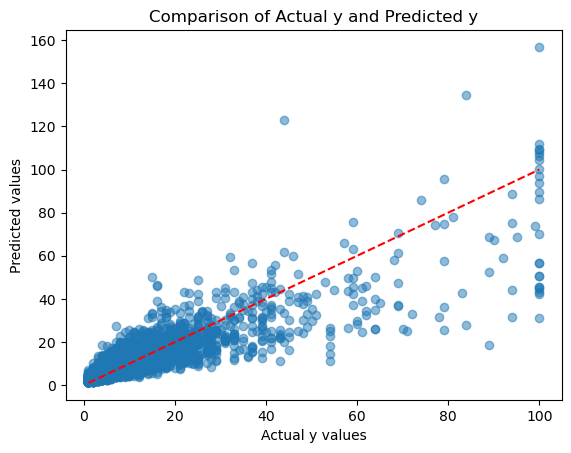

In [169]:
# Visualize predicted results
plt.scatter(np.exp(y_train), y_pred*1.25, alpha=0.5)
plt.xlabel('Actual y values')
plt.ylabel('Predicted values')
plt.title('Comparison of Actual y and Predicted y')
plt.plot([np.min(np.exp(y_train)), np.max(np.exp(y_train))], [np.min(np.exp(y_train)), np.max(np.exp(y_train))], color='red', linestyle='--')
plt.show()

In [187]:
pred_lin = enlr.predict(X_test_filtered)
pred_lin = np.exp(pred_lin)
pred_lin *= 1.28 #the model underestimates y

pred_voting = en.predict(X_test_filtered)
pred_voting = np.exp(pred_voting)
pred_voting *= 1.28 #the model underestimates y

pred_lasso = enla.predict(X_test_filtered)
pred_lasso = np.exp(pred_lasso)
pred_lasso *= 1.25 #the model underestimates y

pred_mars = enma.predict(X_test_filtered)
pred_mars = np.exp(pred_mars)
pred_mars *= 1.28 #the model underestimates y

### Final Blend: This is the combo that achieved the lowest rmse

In [188]:
blend = 0.55*pred_voting + 0.45*pred_stacking


In [186]:
X_test['id'] = X_test['id'].astype('Int32')
output = pd.DataFrame({"id": X_test["id"], "y": blend})
output.to_csv("submissions.csv", index=False, header=True)


# A.5) Discussion

One of the first challenges was preprocessing using PCA.  We felt the urgency to reduce dimensionality given the large feature space, but it turned out it helps with reducing dimensionality but not improving the quality of the data.  Therefore, we had to selectively reduce unimportant features instead.

As for models, we had an issue with linear models since not only the residuals are skewed and far from normal, but also the variance of residual across predicted values is far from constant.

Moreover, we had difficulty with neural networks, as tuning the parameters was not as straight forward as using cross validation.  It was not until late that we also realized the train/validation rmse varies a lot depending on random state, so we had to run the same architecture multiple times with different randomness to evaluate the true performane.

## A.6) Conclusion

We feel we gained valueable experience through building models.  We not only became familiar with the supervised and unsupervised learning tools covered in STAT 362, but we also strengthened critical thinking abilities and think outside the box to come up with differentiated (and better-performing) solutions.  For example, we took a look at how our predicted values compare with actual values through visualizations and tweaked the predictions accordingly to further fine-tune the outcome.

We liked the unlabled features and the large feature space as it allowed for extensive practicing with denoising data and extracting signal from a statstical point of view, as we had no context to follow.